In [7]:
import numpy as np
import matplotlib.pyplot as plt
import time
import math
import gym
import torch
import random
import torch.nn as nn

In [8]:
class Env():
    def __init__(self):
        self.env = gym.make('CarRacing-v0')
        self.reward_threshold = self.env.spec.reward_threshold

    def reset(self):
        self.counter = 0
        self.av_r = self.reward_memory()
        self.die = False
        img_rgb = self.env.reset()
        img_gray = self.rgb2gray(img_rgb)
        self.stack = [img_gray] * 4
        return np.array(self.stack)

    def step(self, action):
        total_reward = 0
        for i in range(8):
            img_rgb, reward, die, _ = self.env.step(action)
            # don't penalize "die state"
            if die:
                reward += 100
            # green penalty
            if np.mean(img_rgb[:, :, 1]) > 185.0:
                reward -= 0.05
            total_reward += reward
            # if no reward recently, end the episode
            done = True if self.av_r(reward) <= -0.1 else False
            if done or die:
                break
        img_gray = self.rgb2gray(img_rgb)
        self.stack.pop(0)
        self.stack.append(img_gray)
        assert len(self.stack) == 4
        return np.array(self.stack), total_reward, done, die

    def render(self):
        self.env.render()
        
    def close(self):
        self.env.close()

    @staticmethod
    def rgb2gray(rgb, norm=True):
        gray = np.dot(rgb[..., :], [0.299, 0.587, 0.114])
        if norm:
            # normalize
            gray = gray / 128. - 1.
        return gray

    @staticmethod
    def reward_memory():
        count = 0
        length = 100
        history = np.zeros(length)

        def memory(reward):
            nonlocal count
            history[count] = reward
            count = (count + 1) % length
            return np.mean(history)

        return memory
        
class Classifier(nn.Module):
    def __init__(self,ch=2):
        super(Classifier,self).__init__()
        self.layer1 = torch.nn.Sequential(
            torch.nn.Conv2d(in_channels=4,out_channels=ch*8,kernel_size=7),
            torch.nn.ReLU(),
            torch.nn.Conv2d(in_channels=ch*8,out_channels=ch*16,kernel_size=5,stride=2),
            torch.nn.ReLU(),
            torch.nn.Conv2d(in_channels=ch*16,out_channels=ch*32,kernel_size=3,stride=2),
            torch.nn.ReLU(),
            torch.nn.Conv2d(in_channels=ch*32,out_channels=ch*32,kernel_size=3,stride=2),
            torch.nn.ReLU(),
            torch.nn.Conv2d(in_channels=ch*32,out_channels=ch*64,kernel_size=3,stride=2),
            torch.nn.ReLU(),
            torch.nn.Conv2d(in_channels=ch*64,out_channels=ch*64,kernel_size=3,stride=2),
            torch.nn.ReLU()
        )
        self.v = torch.nn.Sequential(
            torch.nn.Linear(64*ch*1*1,256),
            torch.nn.ReLU()
        )
        self.fc = torch.nn.Linear(256,3)
        self.ch = ch
        
    def forward(self,x):
        x = self.layer1(x)
        x = x.view(x.size(0),-1)
        x = self.v(x)
        x = self.fc(x)
        
        x[:,0] = torch.tanh(x[:,0])
        x[:,1] = torch.sigmoid(x[:,1])
        x[:,2] = torch.sigmoid(x[:,2])
        return x

Track generation: 1131..1418 -> 287-tiles track
Epoch: 1
Policy Aggregation	mean: 656.83	variance: 0.00


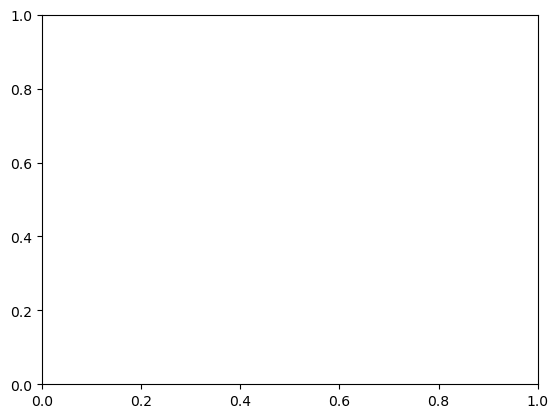

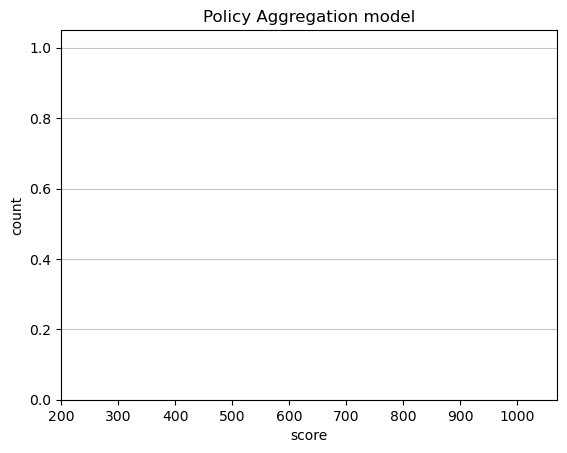

Track generation: 1179..1478 -> 299-tiles track
Epoch: 2
Policy Aggregation	mean: 779.83	variance: 123.00


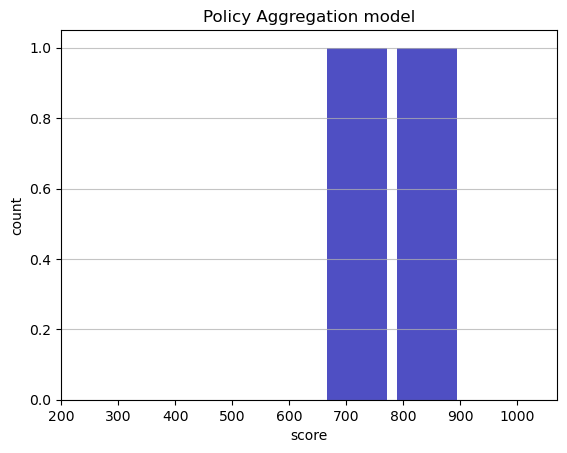

Track generation: 1220..1529 -> 309-tiles track
Epoch: 3
Policy Aggregation	mean: 809.42	variance: 108.80


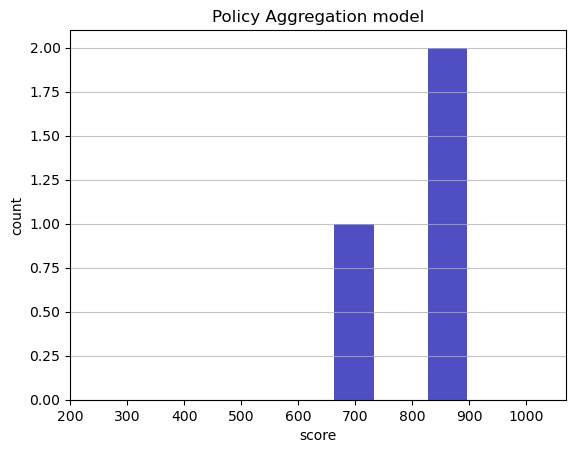

Track generation: 1068..1339 -> 271-tiles track
Epoch: 4
Policy Aggregation	mean: 864.01	variance: 133.49


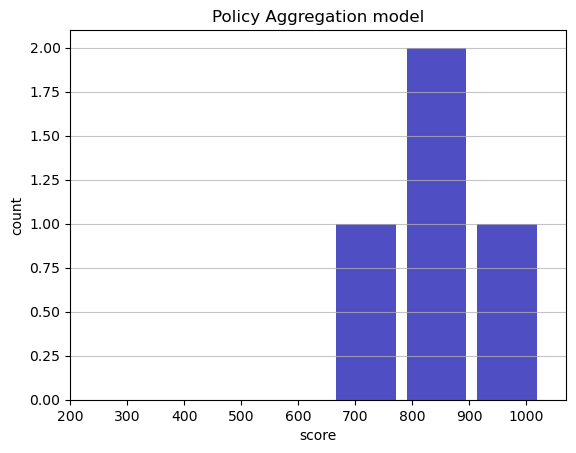

Track generation: 1011..1277 -> 266-tiles track
Epoch: 5
Policy Aggregation	mean: 872.43	variance: 120.58


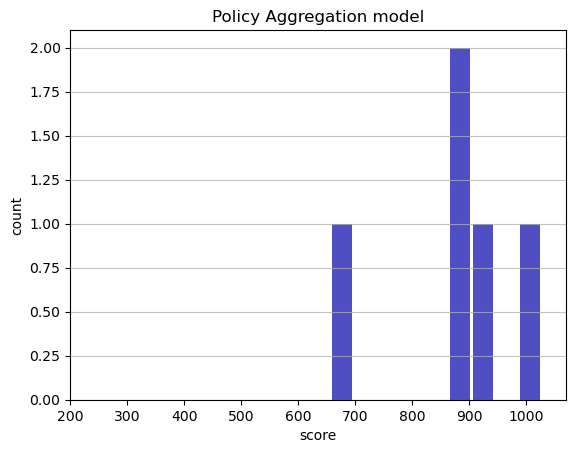

Track generation: 1092..1369 -> 277-tiles track
Epoch: 6
Policy Aggregation	mean: 877.51	variance: 110.66


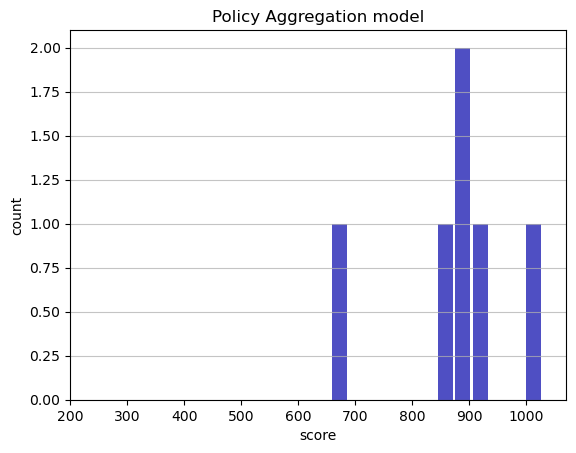

Track generation: 1192..1494 -> 302-tiles track
Epoch: 7
Policy Aggregation	mean: 897.58	variance: 113.63


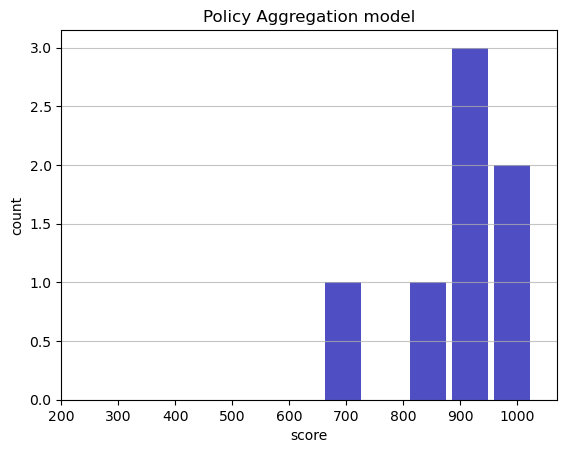

Track generation: 1124..1409 -> 285-tiles track
Epoch: 8
Policy Aggregation	mean: 893.91	variance: 106.74


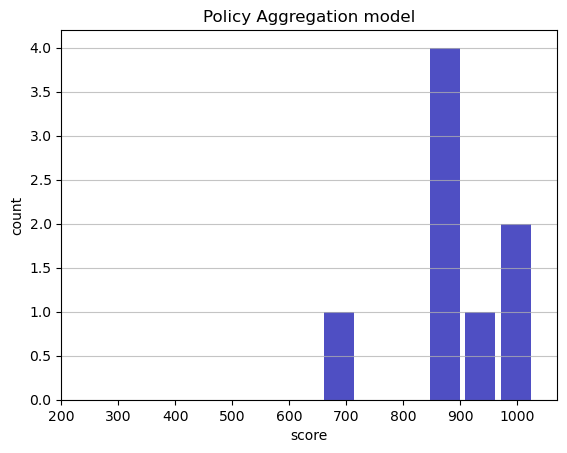

Track generation: 1248..1564 -> 316-tiles track
Epoch: 9
Policy Aggregation	mean: 889.44	variance: 101.42


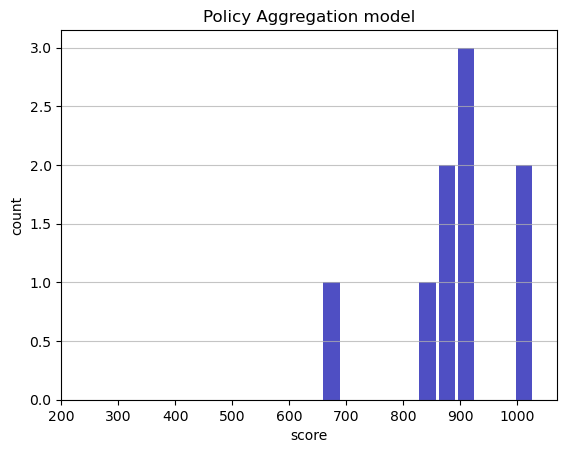

Track generation: 1159..1458 -> 299-tiles track
Epoch: 10
Policy Aggregation	mean: 879.74	variance: 100.53


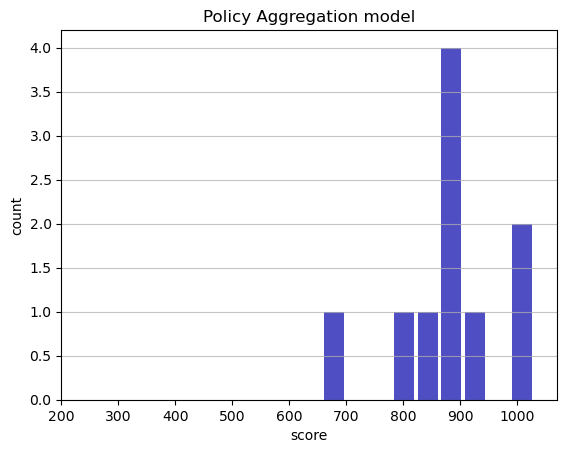

Track generation: 1129..1419 -> 290-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 959..1207 -> 248-tiles track
Epoch: 11
Policy Aggregation	mean: 881.86	variance: 96.08


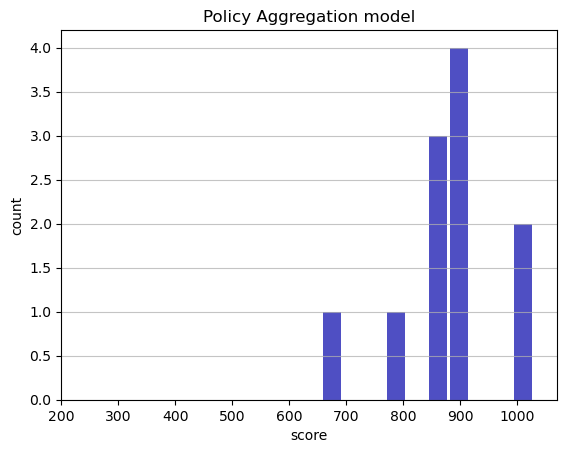

Track generation: 1340..1679 -> 339-tiles track
Epoch: 12
Policy Aggregation	mean: 888.25	variance: 94.40


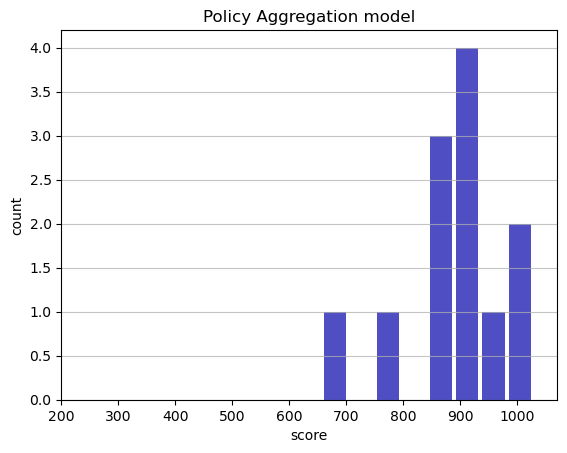

Track generation: 1155..1452 -> 297-tiles track
Epoch: 13
Policy Aggregation	mean: 860.95	variance: 131.03


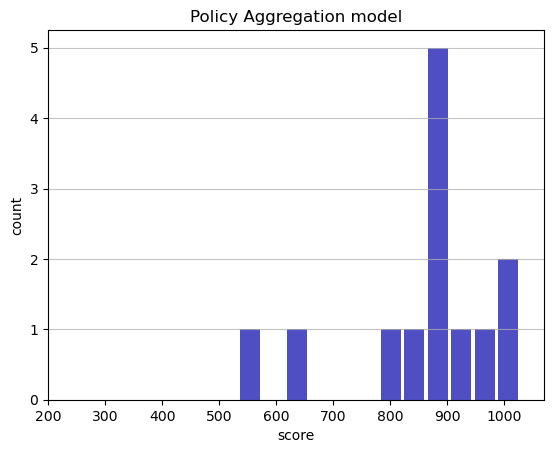

Track generation: 1199..1503 -> 304-tiles track
Epoch: 14
Policy Aggregation	mean: 861.98	variance: 126.32


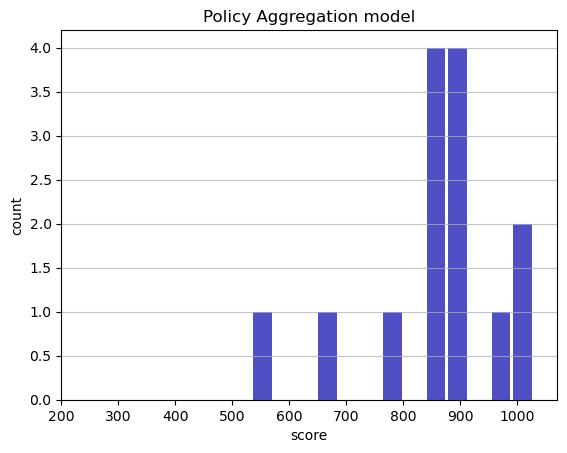

Track generation: 1275..1607 -> 332-tiles track
Epoch: 15
Policy Aggregation	mean: 865.55	variance: 122.76


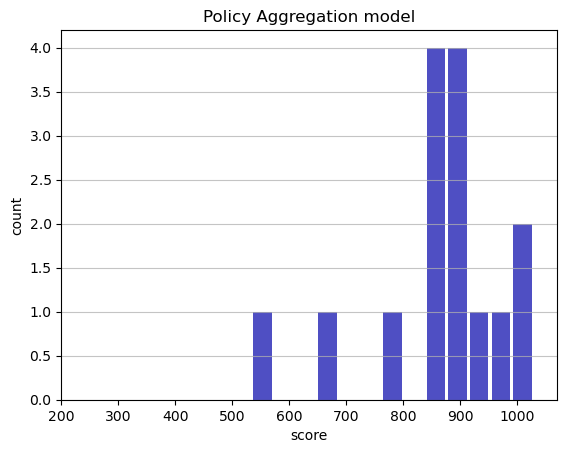

Track generation: 1313..1646 -> 333-tiles track
Epoch: 16
Policy Aggregation	mean: 865.85	variance: 118.87


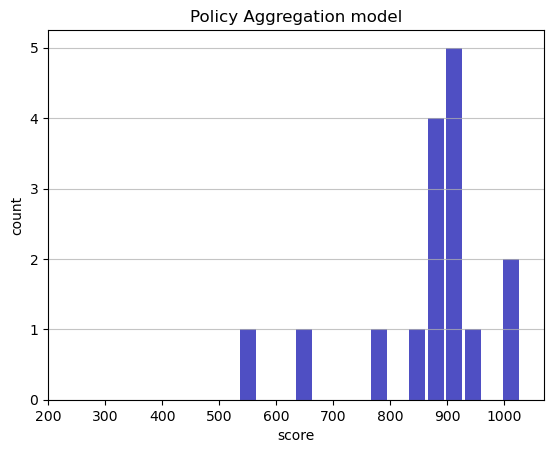

Track generation: 1164..1459 -> 295-tiles track
Epoch: 17
Policy Aggregation	mean: 863.57	variance: 115.68


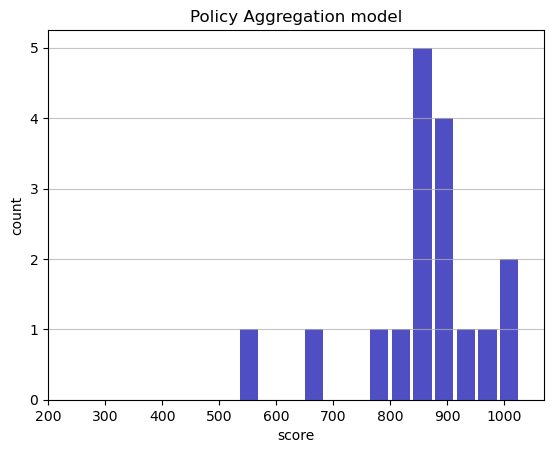

Track generation: 1253..1570 -> 317-tiles track
Epoch: 18
Policy Aggregation	mean: 872.17	variance: 117.89


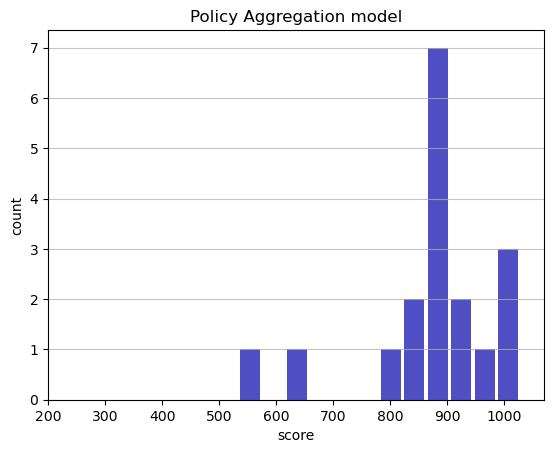

Track generation: 1260..1579 -> 319-tiles track
Epoch: 19
Policy Aggregation	mean: 871.00	variance: 114.85


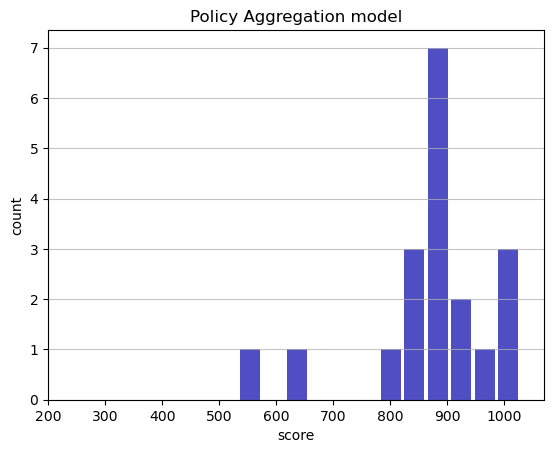

Track generation: 1180..1479 -> 299-tiles track
Epoch: 20
Policy Aggregation	mean: 858.31	variance: 124.85


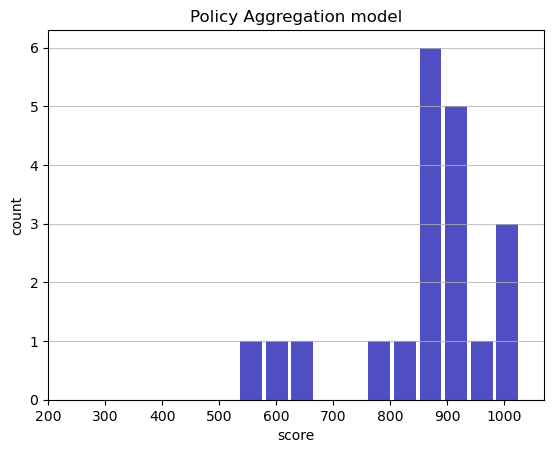

Track generation: 1192..1492 -> 300-tiles track
Epoch: 21
Policy Aggregation	mean: 849.37	variance: 128.23


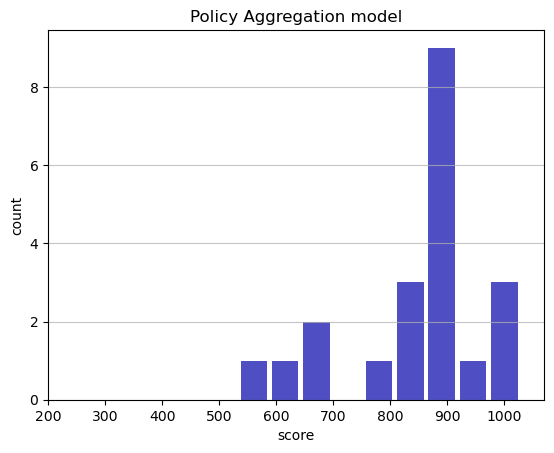

Track generation: 1170..1476 -> 306-tiles track
Epoch: 22
Policy Aggregation	mean: 856.75	variance: 129.76


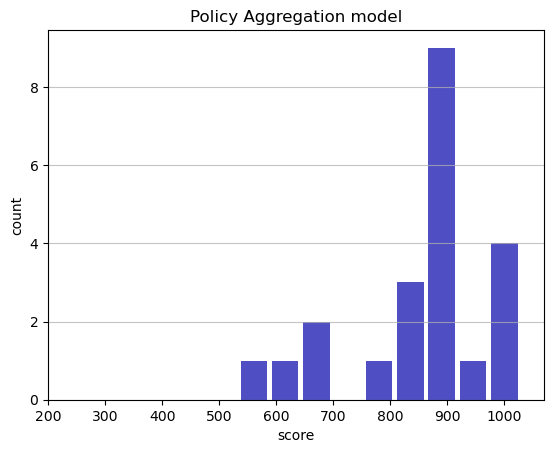

Track generation: 1112..1394 -> 282-tiles track
Epoch: 23
Policy Aggregation	mean: 858.99	variance: 127.35


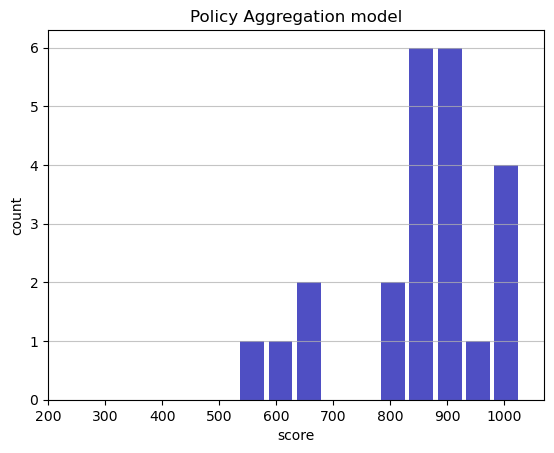

Track generation: 1073..1350 -> 277-tiles track
Epoch: 24
Policy Aggregation	mean: 851.21	variance: 130.13


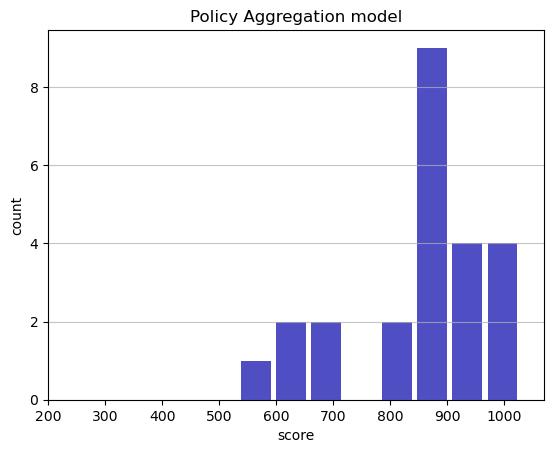

Track generation: 1084..1359 -> 275-tiles track
Epoch: 25
Policy Aggregation	mean: 858.29	variance: 132.13


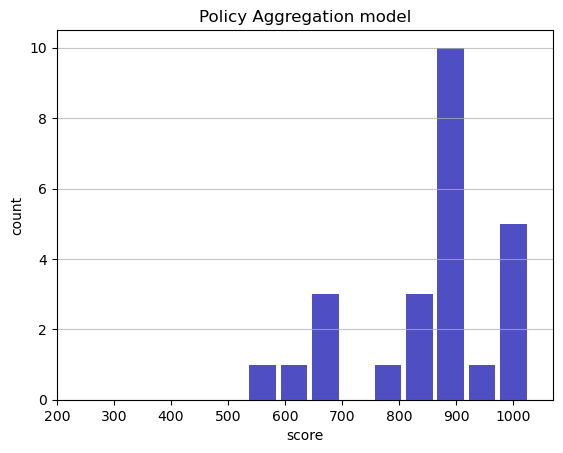

Track generation: 1195..1498 -> 303-tiles track
Epoch: 26
Policy Aggregation	mean: 859.79	variance: 129.78


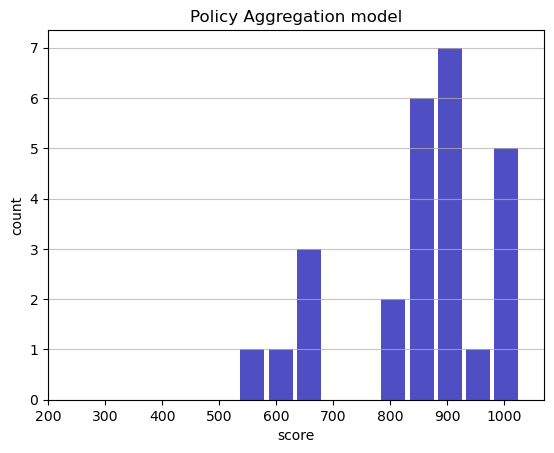

Track generation: 1248..1564 -> 316-tiles track
Epoch: 27
Policy Aggregation	mean: 860.38	variance: 127.39


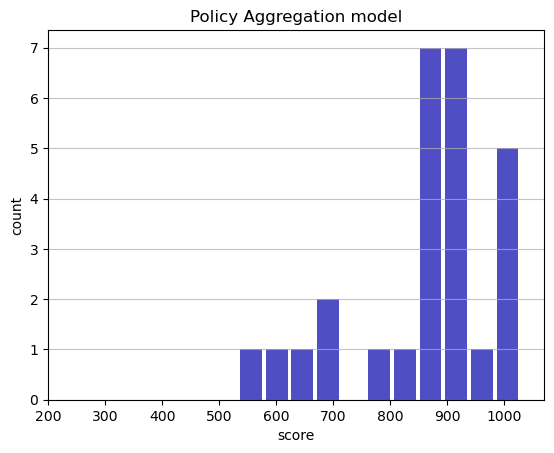

Track generation: 1045..1310 -> 265-tiles track
Epoch: 28
Policy Aggregation	mean: 860.75	variance: 125.11


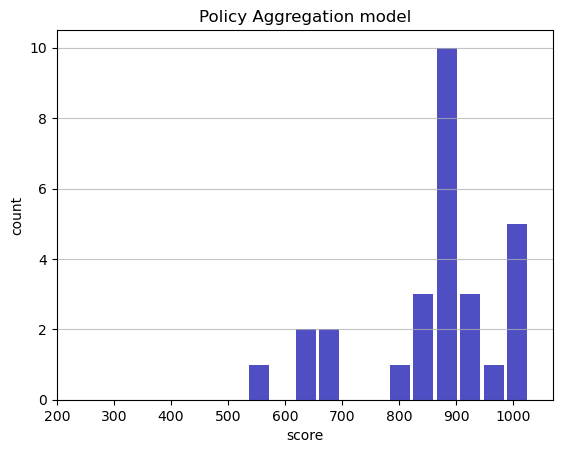

Track generation: 1051..1318 -> 267-tiles track
Epoch: 29
Policy Aggregation	mean: 860.76	variance: 122.94


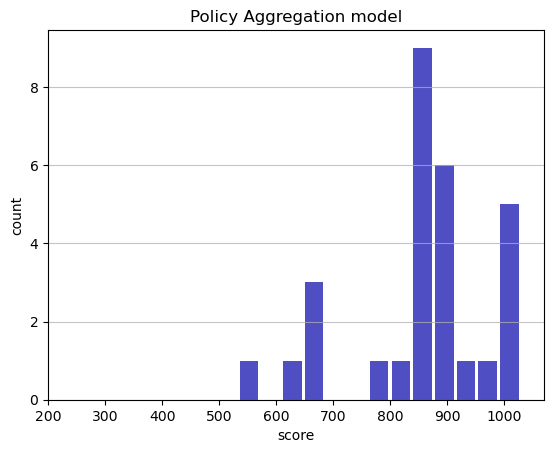

Track generation: 1203..1508 -> 305-tiles track
Epoch: 30
Policy Aggregation	mean: 861.79	variance: 121.00


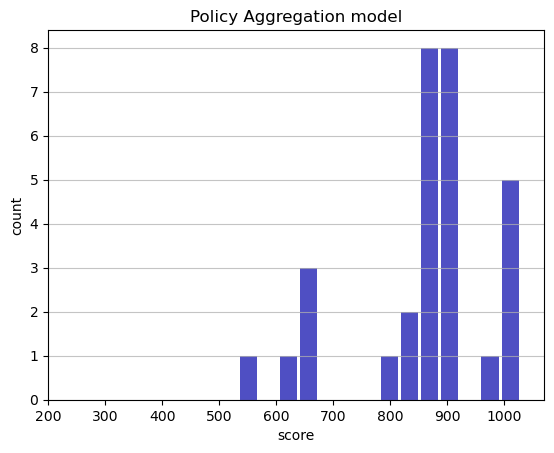

Track generation: 1168..1464 -> 296-tiles track
Epoch: 31
Policy Aggregation	mean: 867.26	variance: 122.75


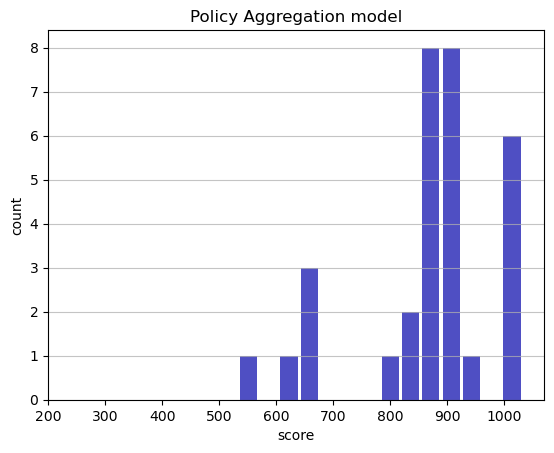

Track generation: 1057..1331 -> 274-tiles track
Epoch: 32
Policy Aggregation	mean: 872.44	variance: 124.20


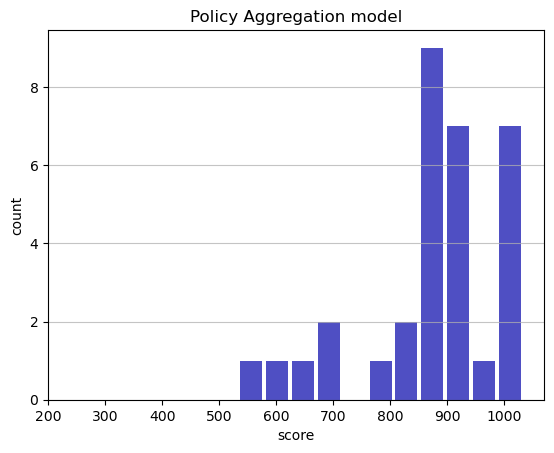

Track generation: 1252..1569 -> 317-tiles track
Epoch: 33
Policy Aggregation	mean: 876.88	variance: 124.85


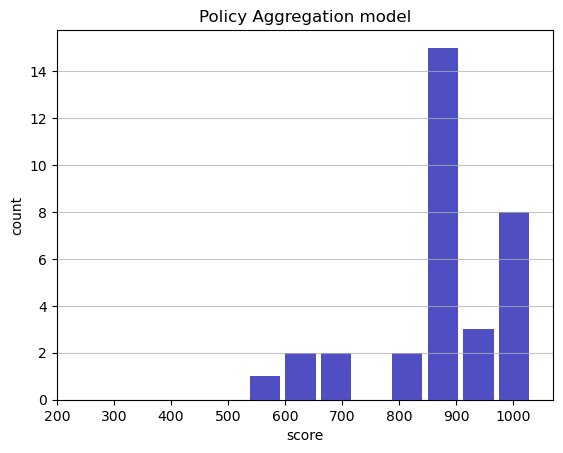

Track generation: 1101..1389 -> 288-tiles track
Epoch: 34
Policy Aggregation	mean: 881.20	variance: 125.49


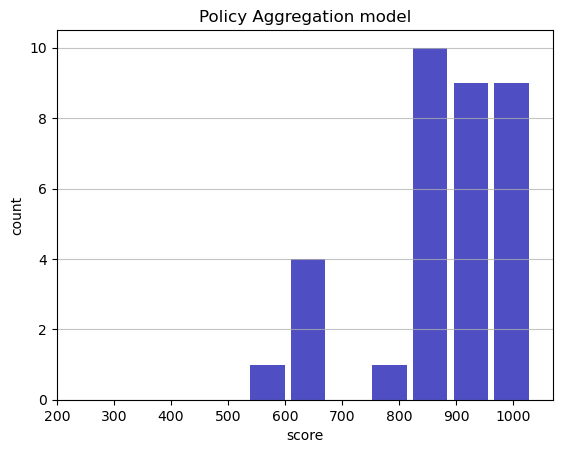

Track generation: 1183..1483 -> 300-tiles track
Epoch: 35
Policy Aggregation	mean: 880.63	variance: 123.72


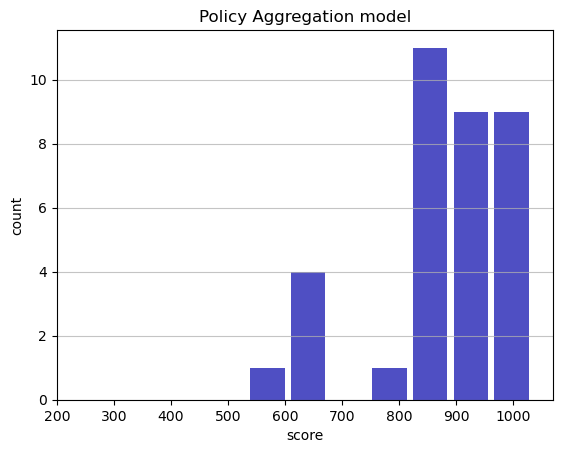

Track generation: 1185..1486 -> 301-tiles track
Epoch: 36
Policy Aggregation	mean: 865.49	variance: 151.36


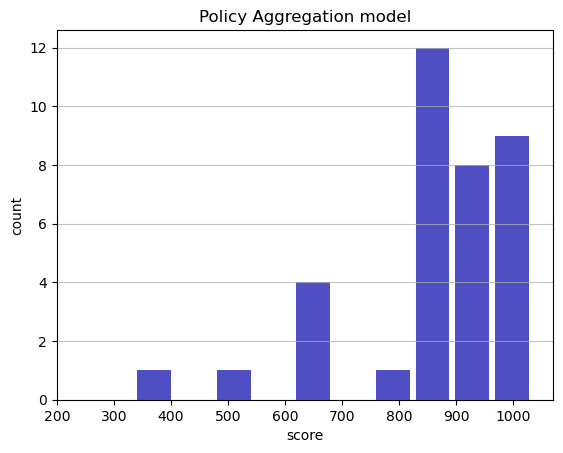

Track generation: 1378..1732 -> 354-tiles track
Epoch: 37
Policy Aggregation	mean: 867.59	variance: 149.83


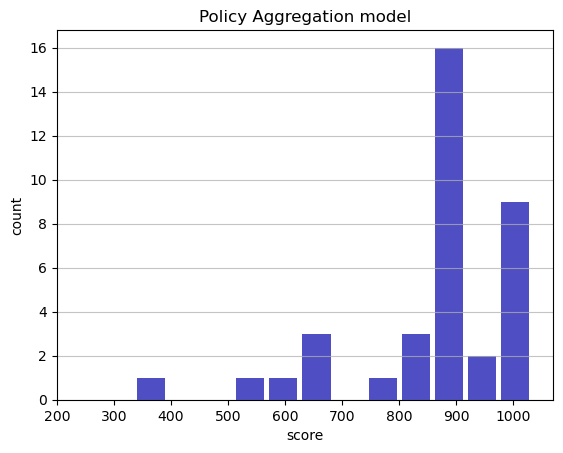

Track generation: 1038..1301 -> 263-tiles track
Epoch: 38
Policy Aggregation	mean: 867.50	variance: 147.85


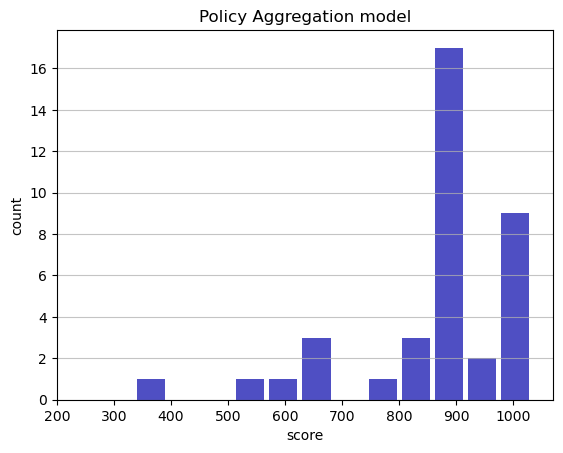

Track generation: 993..1245 -> 252-tiles track
Epoch: 39
Policy Aggregation	mean: 868.35	variance: 146.04


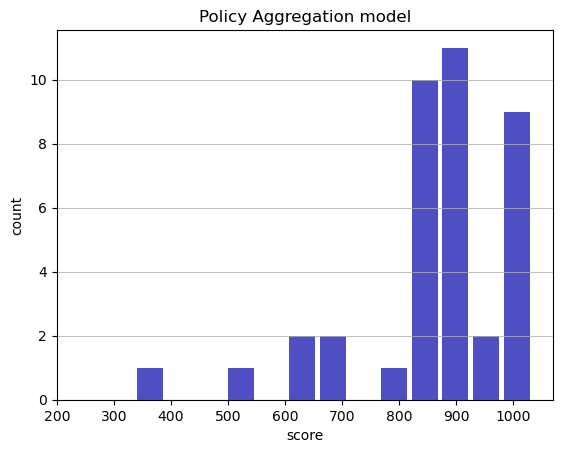

Track generation: 1275..1598 -> 323-tiles track
Epoch: 40
Policy Aggregation	mean: 871.97	variance: 145.97


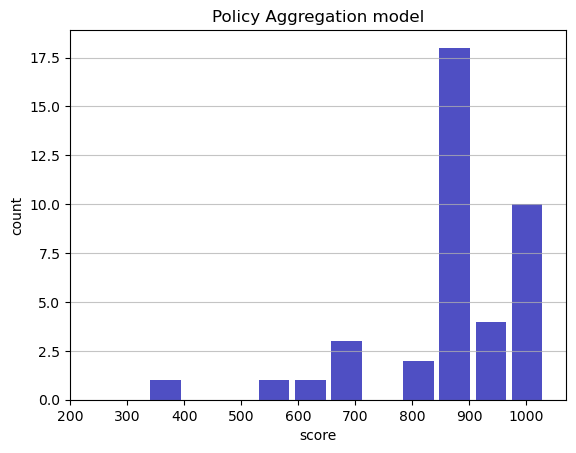

Track generation: 1154..1446 -> 292-tiles track
Epoch: 41
Policy Aggregation	mean: 861.04	variance: 159.91


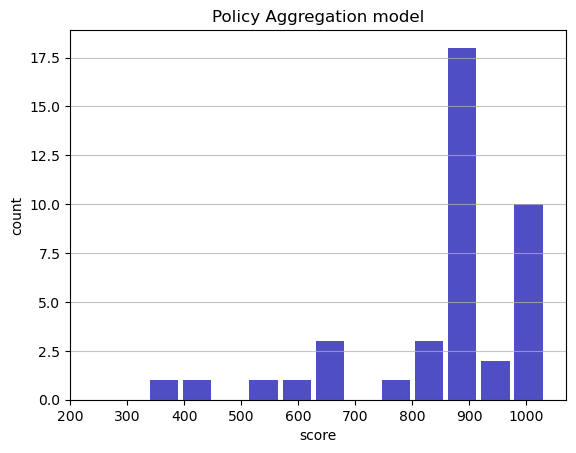

Track generation: 1118..1401 -> 283-tiles track
Epoch: 42
Policy Aggregation	mean: 861.68	variance: 158.05


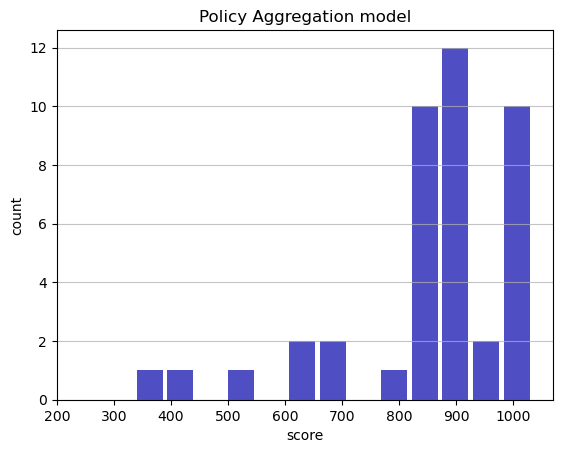

Track generation: 1076..1349 -> 273-tiles track
Epoch: 43
Policy Aggregation	mean: 865.72	variance: 158.37


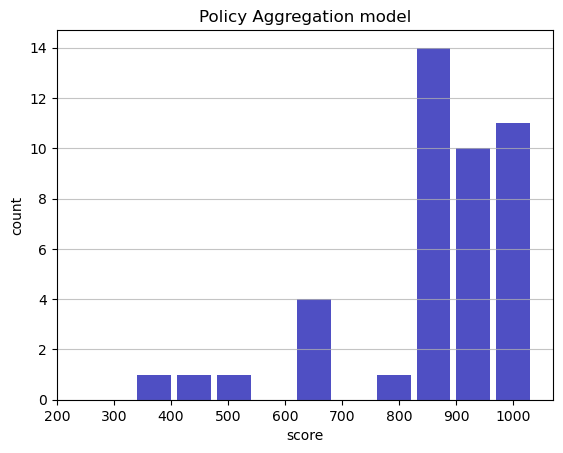

Track generation: 1180..1479 -> 299-tiles track
Epoch: 44
Policy Aggregation	mean: 865.58	variance: 156.57


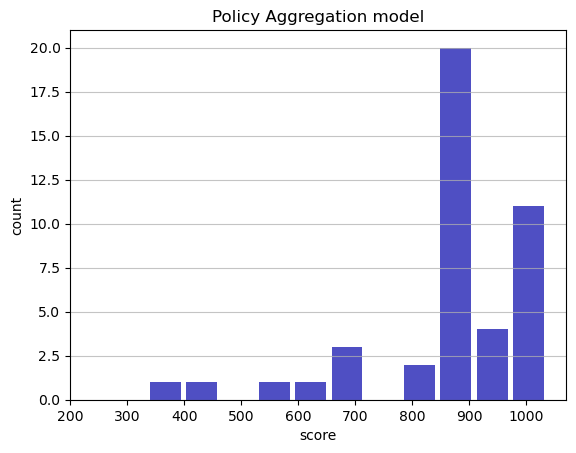

Track generation: 1026..1295 -> 269-tiles track
Epoch: 45
Policy Aggregation	mean: 859.26	variance: 160.39


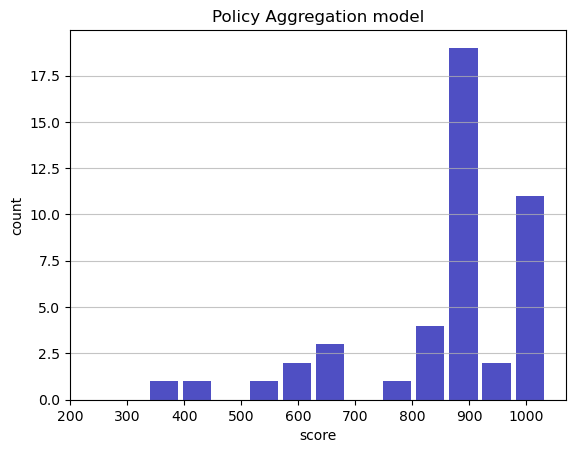

Track generation: 1292..1619 -> 327-tiles track
Epoch: 46
Policy Aggregation	mean: 846.14	variance: 181.43


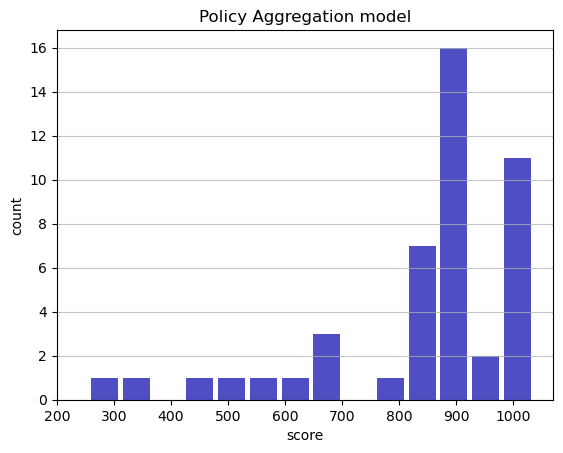

Track generation: 1169..1465 -> 296-tiles track
Epoch: 47
Policy Aggregation	mean: 847.42	variance: 179.70


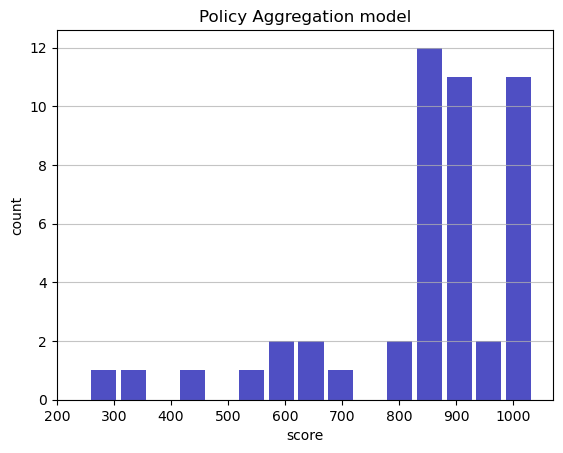

Track generation: 1218..1527 -> 309-tiles track
Epoch: 48
Policy Aggregation	mean: 837.43	variance: 190.55


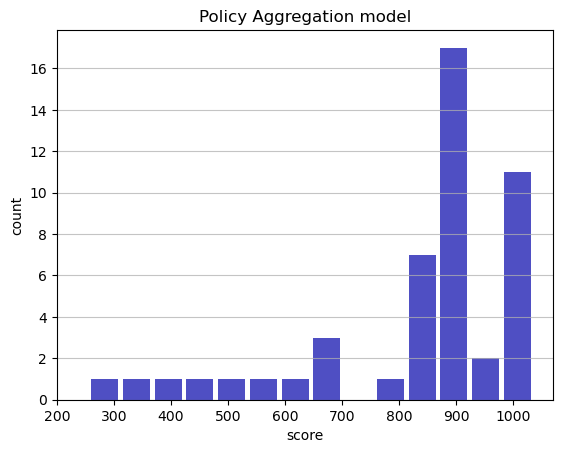

Track generation: 1211..1518 -> 307-tiles track
Epoch: 49
Policy Aggregation	mean: 838.22	variance: 188.68


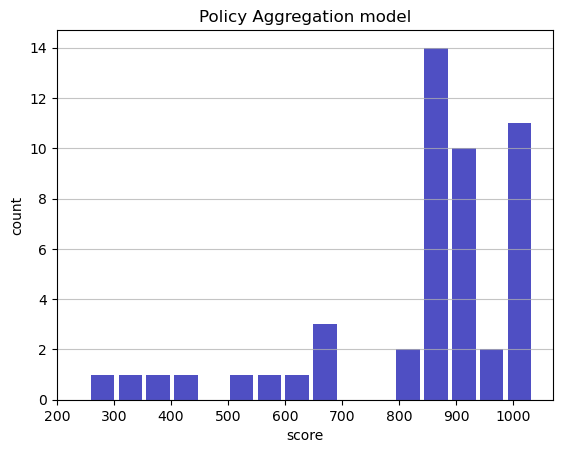

Track generation: 1165..1460 -> 295-tiles track
Epoch: 50
Policy Aggregation	mean: 839.37	variance: 186.96


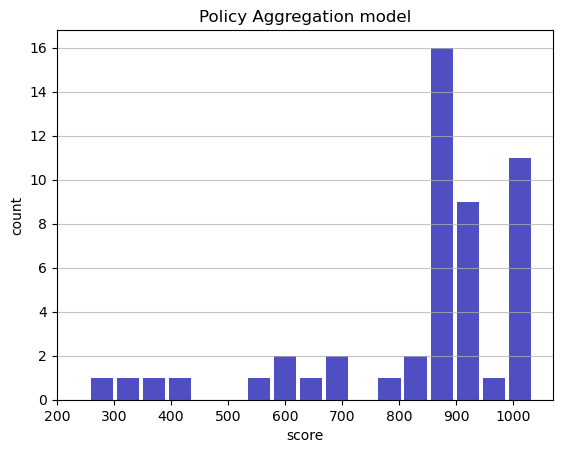

Track generation: 1071..1343 -> 272-tiles track
Epoch: 51
Policy Aggregation	mean: 840.83	variance: 185.40


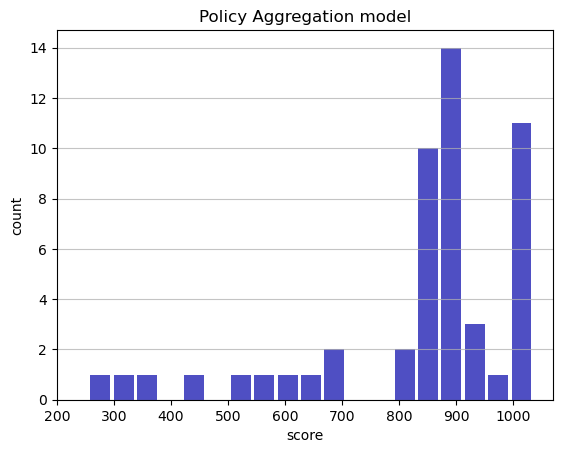

Track generation: 1111..1393 -> 282-tiles track
Epoch: 52
Policy Aggregation	mean: 841.72	variance: 183.72


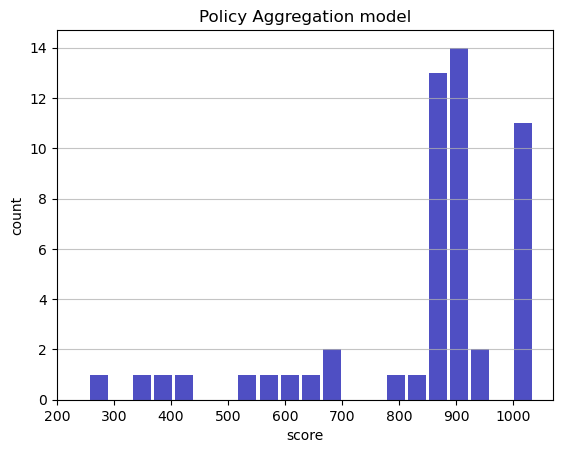

Track generation: 1223..1533 -> 310-tiles track
Epoch: 53
Policy Aggregation	mean: 842.06	variance: 182.00


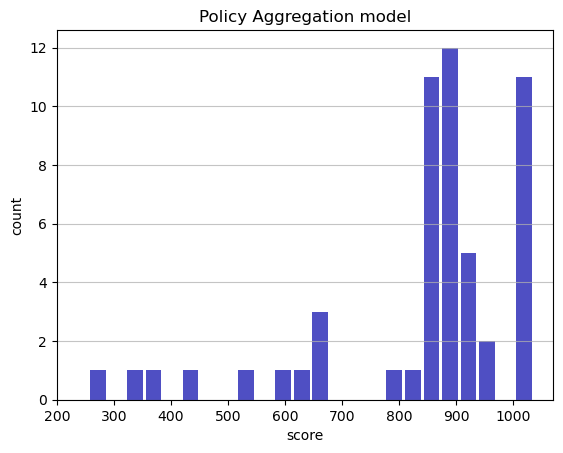

Track generation: 974..1221 -> 247-tiles track
Epoch: 54
Policy Aggregation	mean: 843.05	variance: 180.45


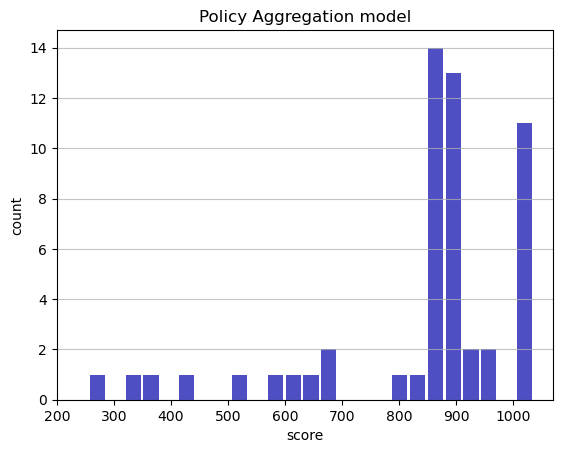

Track generation: 1199..1503 -> 304-tiles track
Epoch: 55
Policy Aggregation	mean: 846.33	variance: 180.41


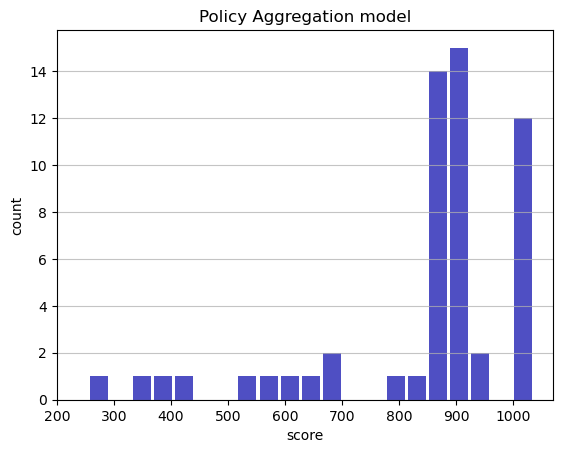

Track generation: 1006..1262 -> 256-tiles track
Epoch: 56
Policy Aggregation	mean: 840.56	variance: 183.84


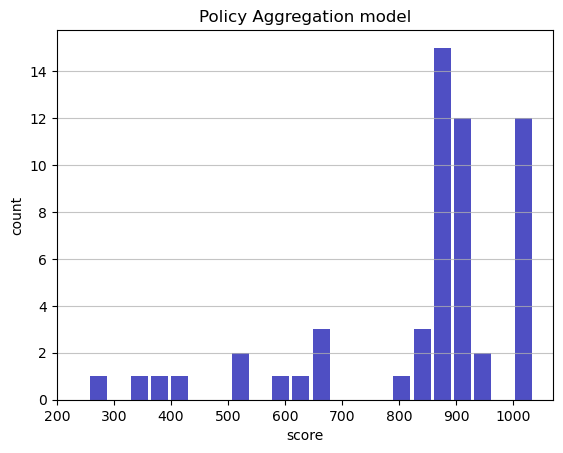

Track generation: 1031..1293 -> 262-tiles track
Epoch: 57
Policy Aggregation	mean: 841.78	variance: 182.45


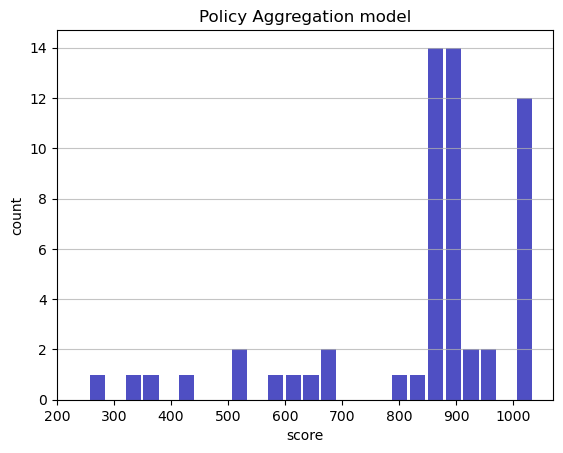

Track generation: 1020..1279 -> 259-tiles track
Epoch: 58
Policy Aggregation	mean: 842.94	variance: 181.08


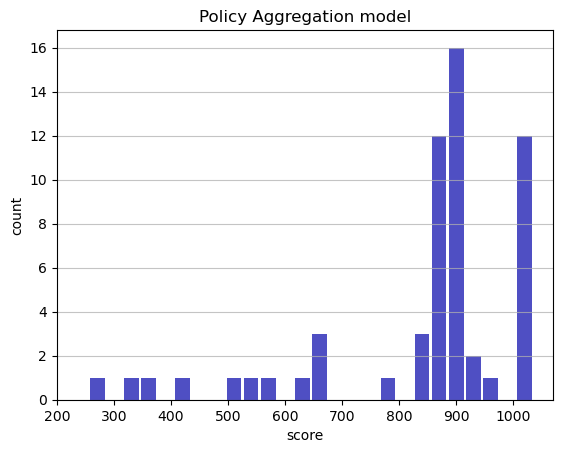

Track generation: 1024..1284 -> 260-tiles track
Epoch: 59
Policy Aggregation	mean: 843.65	variance: 179.62


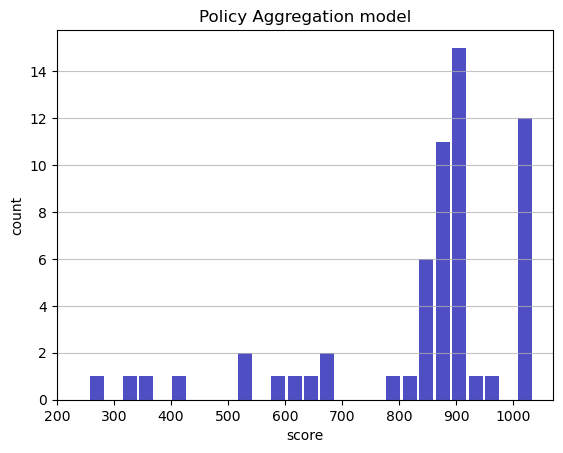

Track generation: 1228..1539 -> 311-tiles track
Epoch: 60
Policy Aggregation	mean: 843.89	variance: 178.13


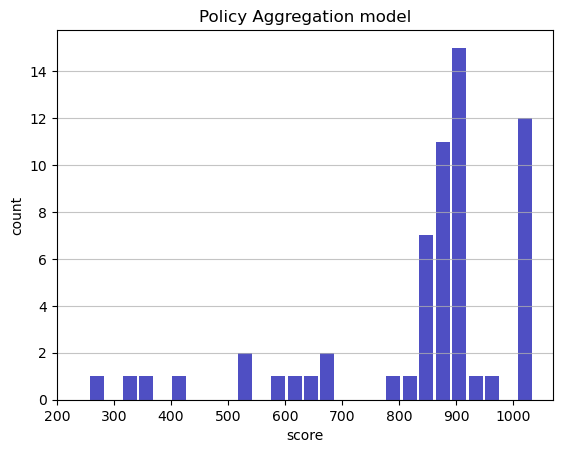

Track generation: 1175..1473 -> 298-tiles track
Epoch: 61
Policy Aggregation	mean: 846.87	variance: 178.17


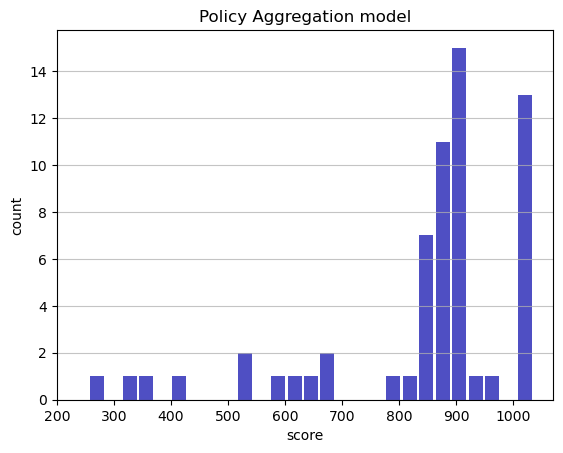

Track generation: 1072..1344 -> 272-tiles track
Epoch: 62
Policy Aggregation	mean: 847.23	variance: 176.75


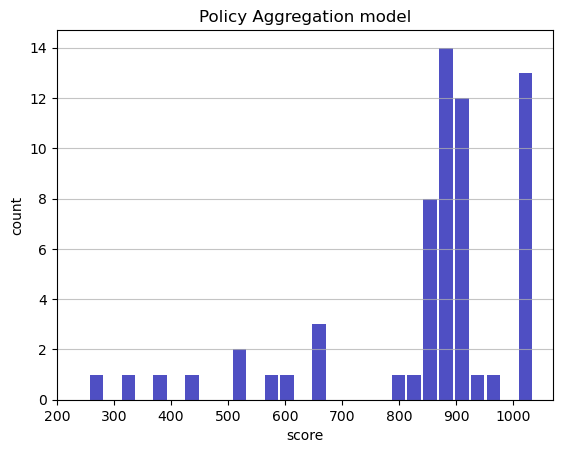

Track generation: 1172..1469 -> 297-tiles track
Epoch: 63
Policy Aggregation	mean: 846.69	variance: 175.39


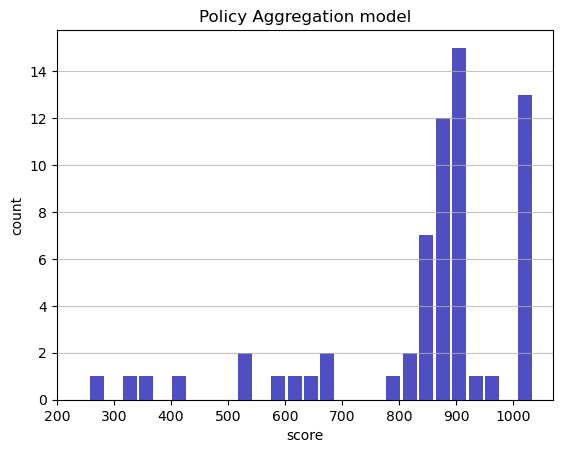

Track generation: 1251..1578 -> 327-tiles track
Epoch: 64
Policy Aggregation	mean: 849.26	variance: 175.21


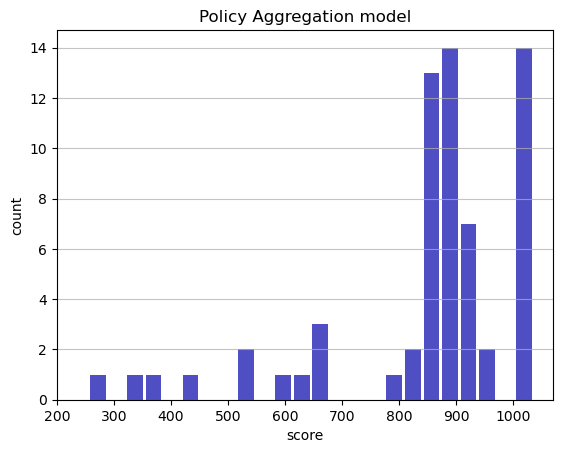

Track generation: 1100..1378 -> 278-tiles track
Epoch: 65
Policy Aggregation	mean: 849.87	variance: 173.92


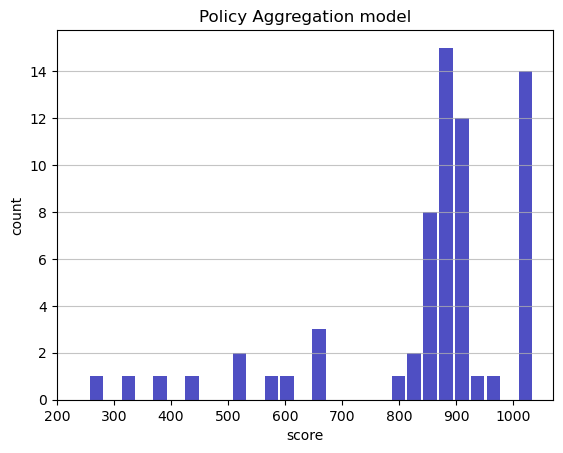

Track generation: 1236..1549 -> 313-tiles track
Epoch: 66
Policy Aggregation	mean: 852.41	variance: 173.81


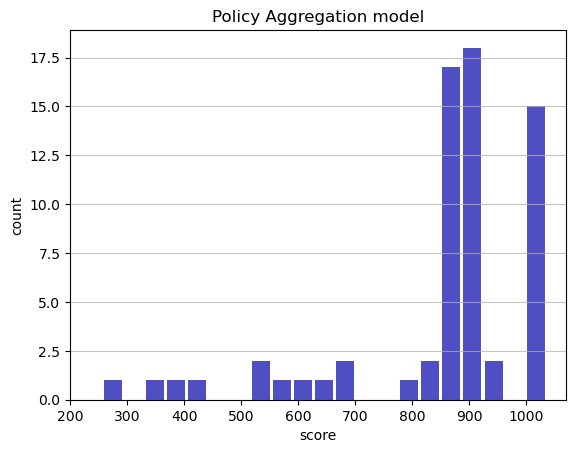

Track generation: 1076..1349 -> 273-tiles track
Epoch: 67
Policy Aggregation	mean: 855.06	variance: 173.85


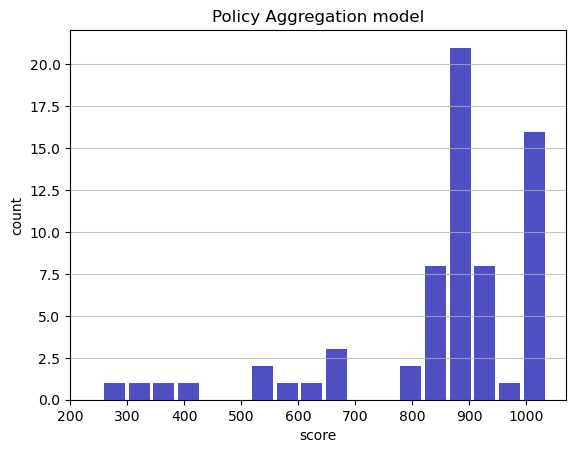

Track generation: 1164..1459 -> 295-tiles track
Epoch: 68
Policy Aggregation	mean: 855.36	variance: 172.58


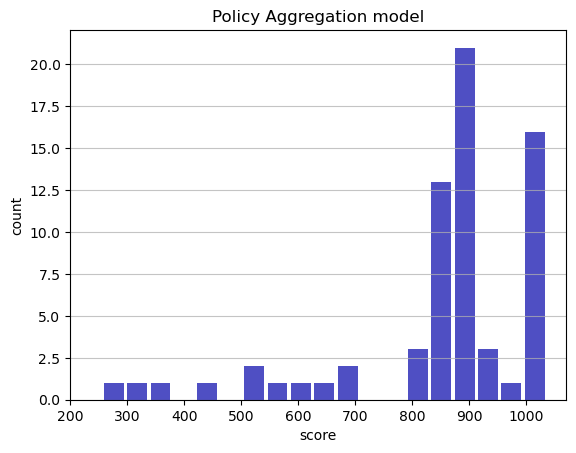

Track generation: 1128..1414 -> 286-tiles track
Epoch: 69
Policy Aggregation	mean: 855.89	variance: 171.38


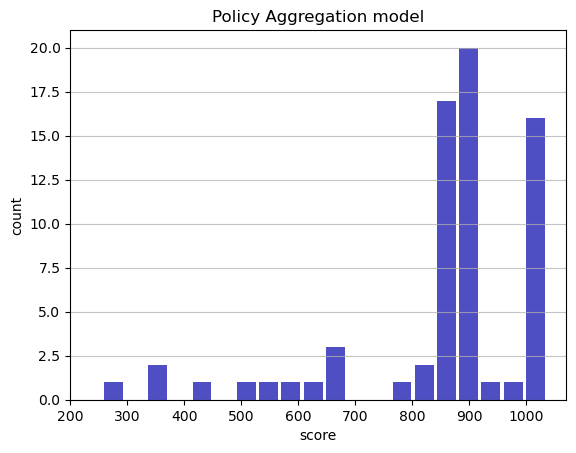

Track generation: 1279..1603 -> 324-tiles track
Epoch: 70
Policy Aggregation	mean: 856.41	variance: 170.21


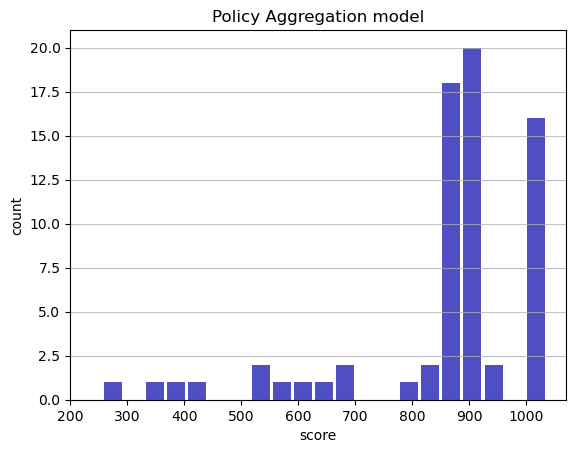

Track generation: 1066..1337 -> 271-tiles track
Epoch: 71
Policy Aggregation	mean: 858.79	variance: 170.18


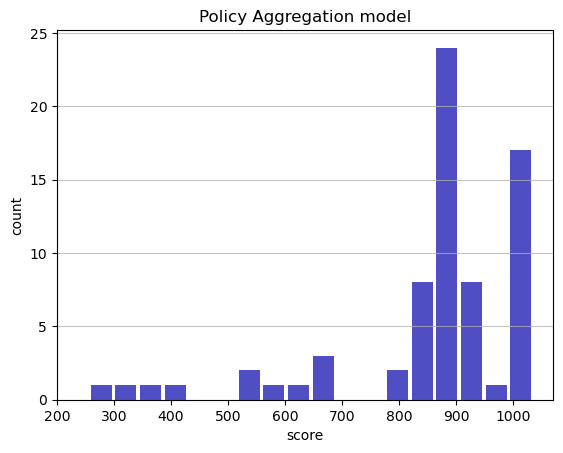

Track generation: 1075..1348 -> 273-tiles track
Epoch: 72
Policy Aggregation	mean: 859.18	variance: 169.02


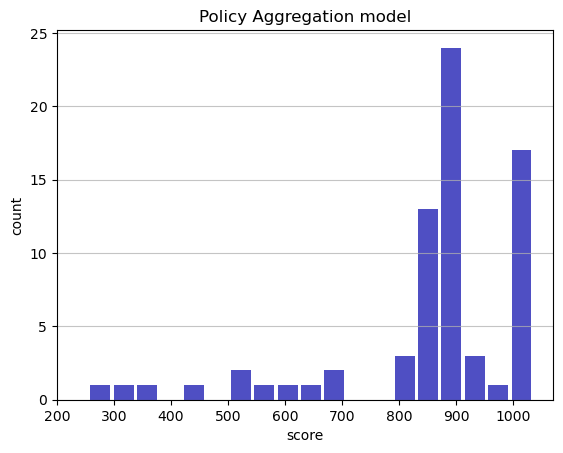

Track generation: 1051..1318 -> 267-tiles track
Epoch: 73
Policy Aggregation	mean: 861.52	variance: 169.03


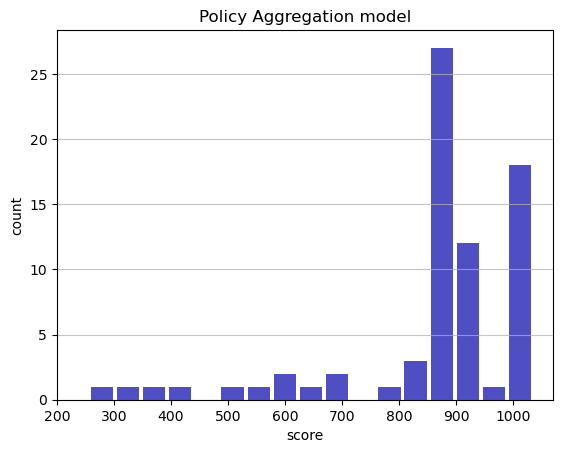

Track generation: 1081..1355 -> 274-tiles track
Epoch: 74
Policy Aggregation	mean: 861.44	variance: 167.89


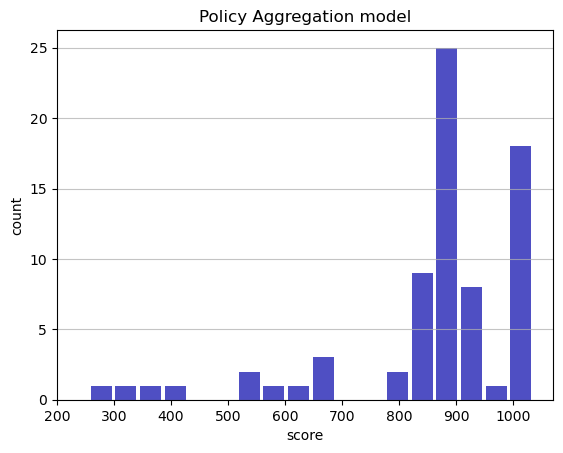

Track generation: 1154..1449 -> 295-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1127..1413 -> 286-tiles track
Epoch: 75
Policy Aggregation	mean: 861.73	variance: 166.78


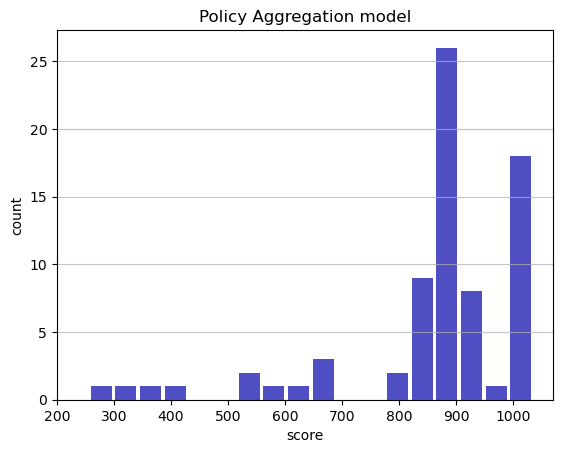

Track generation: 1195..1499 -> 304-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1140..1429 -> 289-tiles track
Epoch: 76
Policy Aggregation	mean: 862.09	variance: 165.71


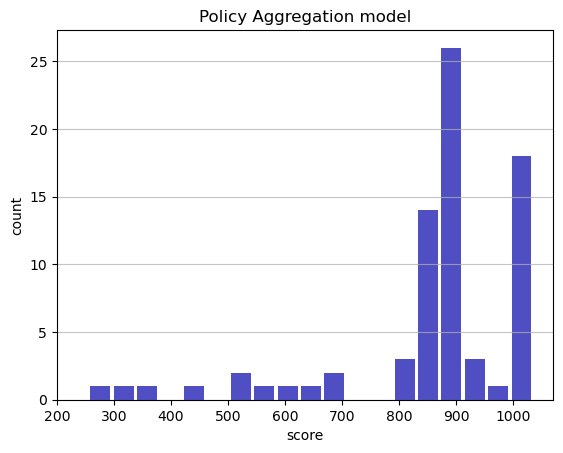

Track generation: 1024..1284 -> 260-tiles track
Epoch: 77
Policy Aggregation	mean: 862.65	variance: 164.70


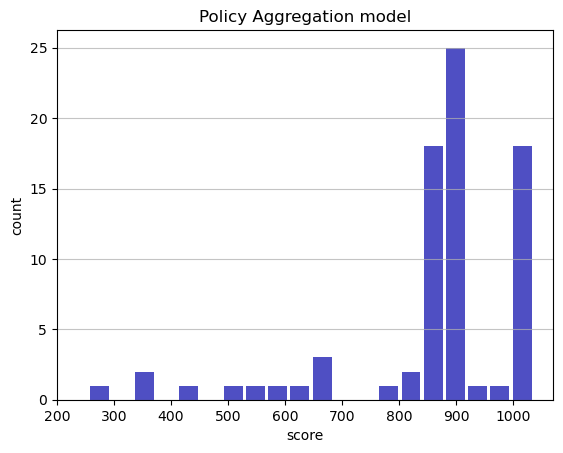

Track generation: 1164..1459 -> 295-tiles track
Epoch: 78
Policy Aggregation	mean: 862.46	variance: 163.65


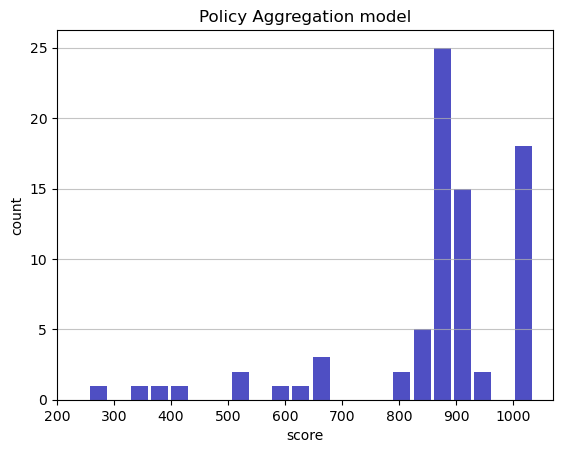

Track generation: 1012..1276 -> 264-tiles track
Epoch: 79
Policy Aggregation	mean: 855.99	variance: 172.37


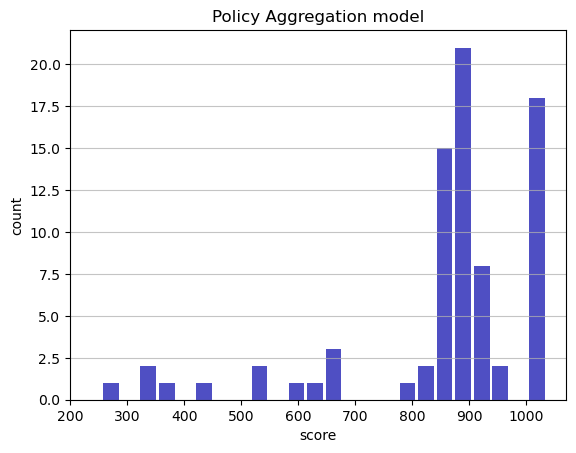

Track generation: 979..1228 -> 249-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1062..1339 -> 277-tiles track
Epoch: 80
Policy Aggregation	mean: 858.13	variance: 172.35


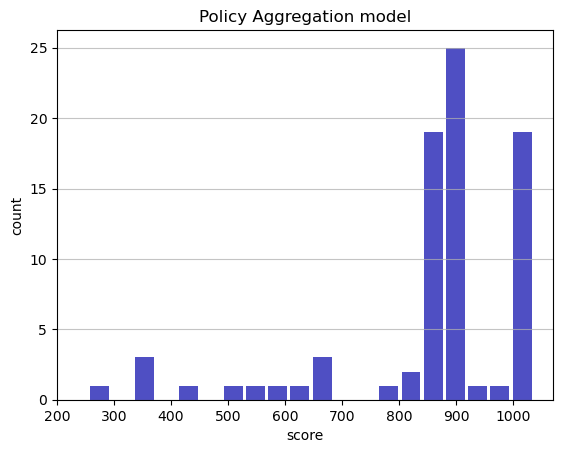

Track generation: 1036..1299 -> 263-tiles track
Epoch: 81
Policy Aggregation	mean: 858.63	variance: 171.34


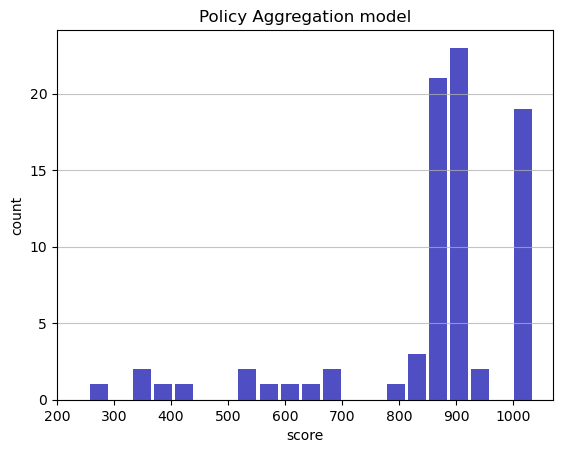

Track generation: 1141..1430 -> 289-tiles track
Epoch: 82
Policy Aggregation	mean: 860.57	variance: 171.18


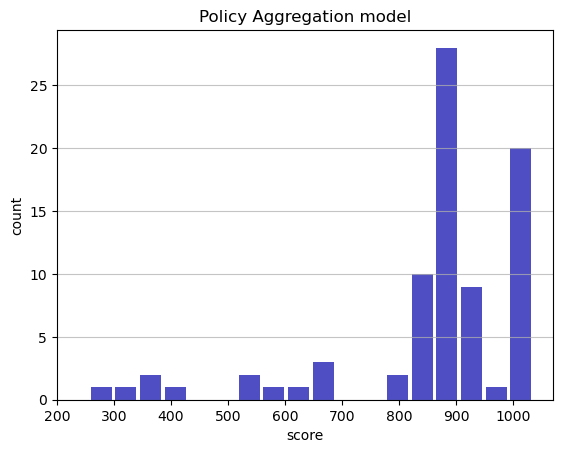

Track generation: 1200..1505 -> 305-tiles track
Epoch: 83
Policy Aggregation	mean: 859.12	variance: 170.65


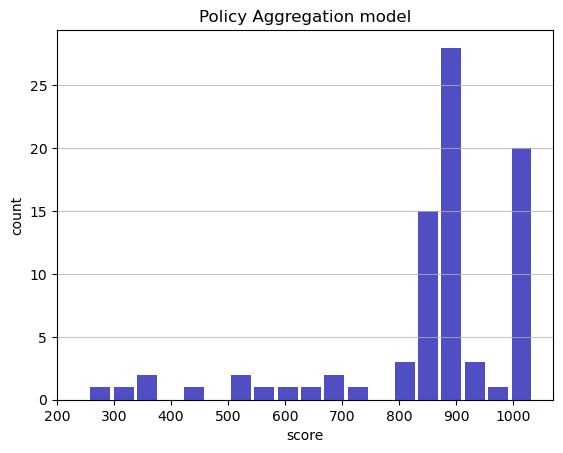

Track generation: 1024..1284 -> 260-tiles track
Epoch: 84
Policy Aggregation	mean: 859.03	variance: 169.64


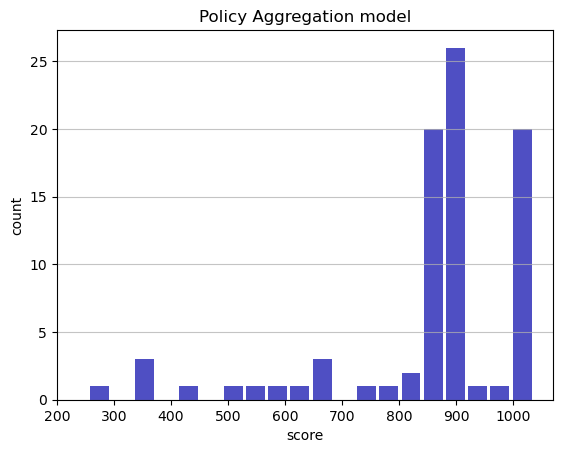

Track generation: 1037..1302 -> 265-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1271..1593 -> 322-tiles track
Epoch: 85
Policy Aggregation	mean: 860.84	variance: 169.45


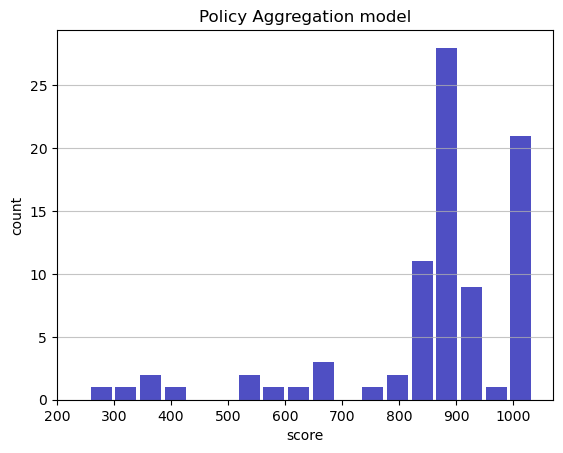

Track generation: 1195..1498 -> 303-tiles track
Epoch: 86
Policy Aggregation	mean: 861.15	variance: 168.49


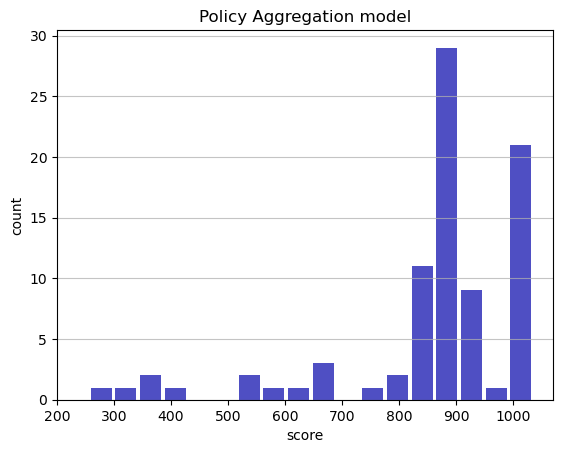

Track generation: 1152..1445 -> 293-tiles track
Epoch: 87
Policy Aggregation	mean: 856.08	variance: 174.00


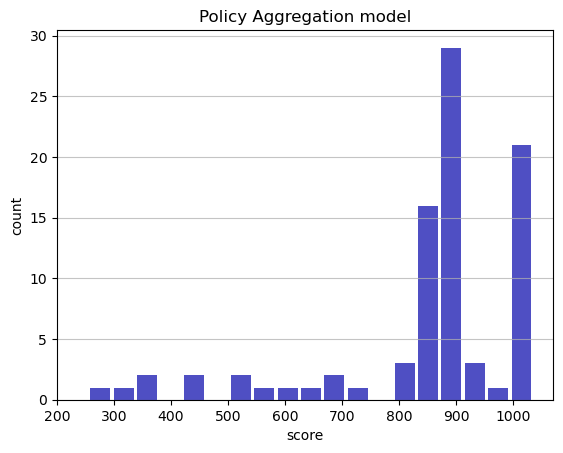

Track generation: 1163..1458 -> 295-tiles track
Epoch: 88
Policy Aggregation	mean: 856.52	variance: 173.05


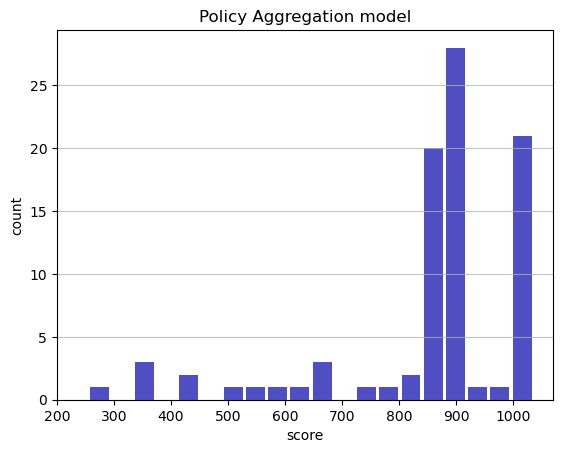

Track generation: 957..1203 -> 246-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1082..1362 -> 280-tiles track
Epoch: 89
Policy Aggregation	mean: 853.32	variance: 174.68


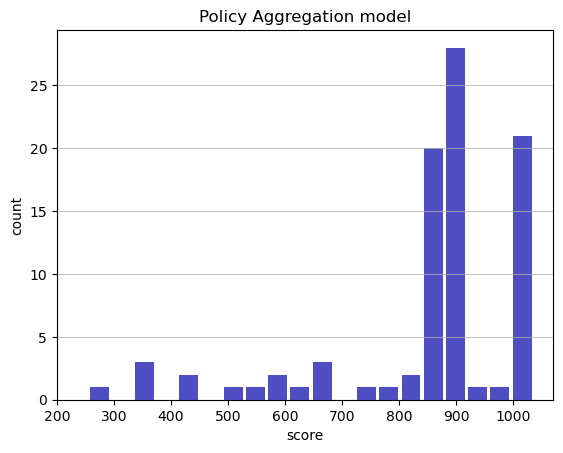

Track generation: 1147..1438 -> 291-tiles track
Epoch: 90
Policy Aggregation	mean: 853.82	variance: 173.77


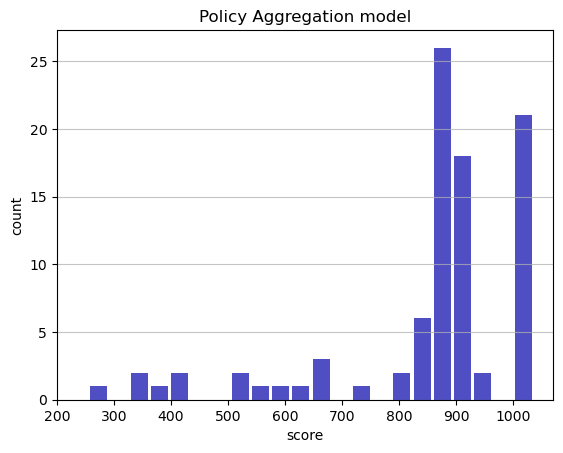

Track generation: 1200..1504 -> 304-tiles track
Epoch: 91
Policy Aggregation	mean: 854.28	variance: 172.87


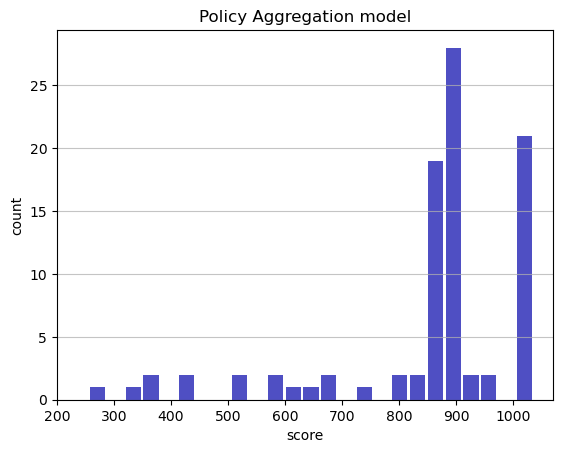

Track generation: 1076..1349 -> 273-tiles track
Epoch: 92
Policy Aggregation	mean: 854.81	variance: 172.00


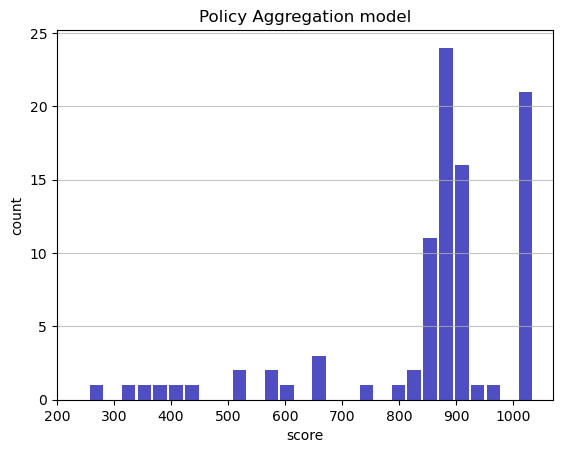

Track generation: 1099..1378 -> 279-tiles track
Epoch: 93
Policy Aggregation	mean: 850.40	variance: 176.23


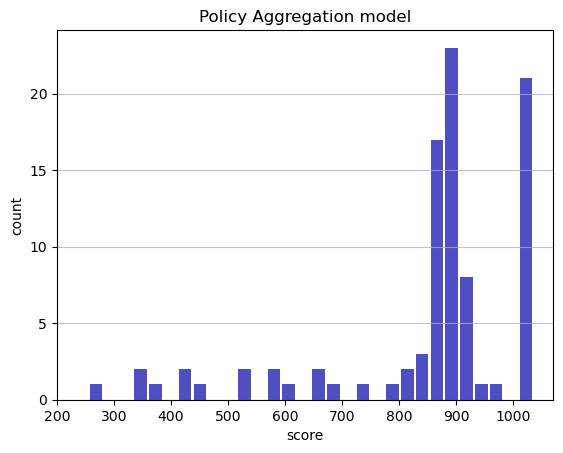

Track generation: 1083..1358 -> 275-tiles track
Epoch: 94
Policy Aggregation	mean: 850.78	variance: 175.33


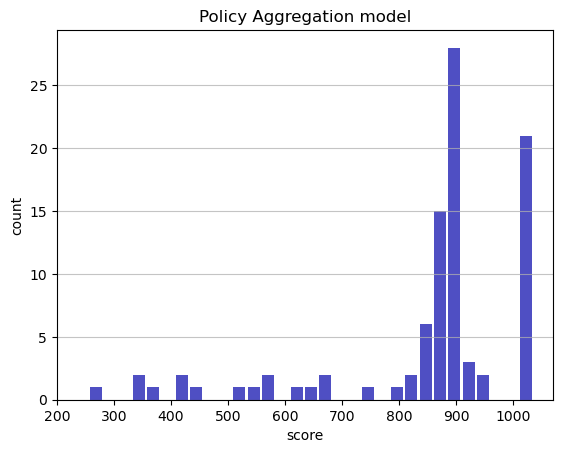

Track generation: 1272..1594 -> 322-tiles track
Epoch: 95
Policy Aggregation	mean: 851.13	variance: 174.44


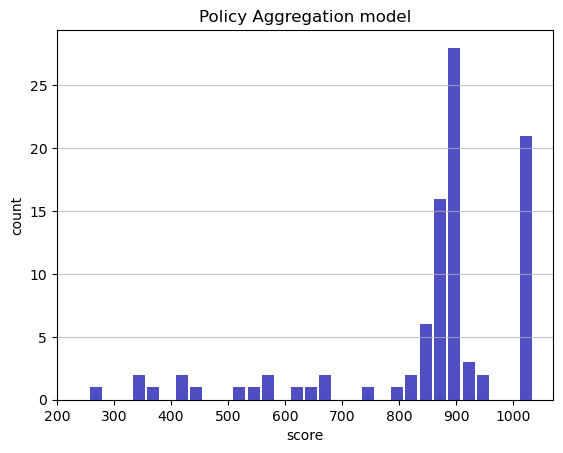

Track generation: 1249..1565 -> 316-tiles track
Epoch: 96
Policy Aggregation	mean: 852.84	variance: 174.33


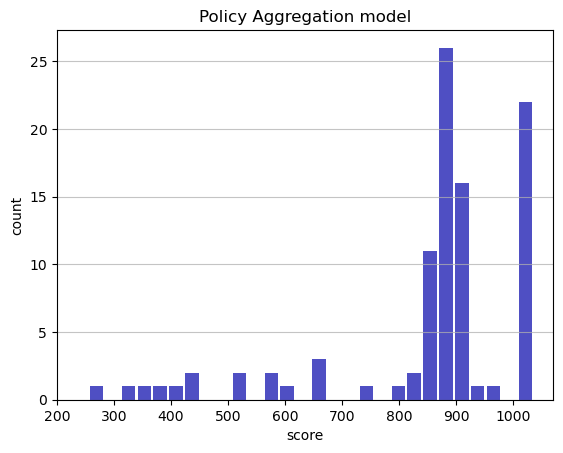

Track generation: 1227..1538 -> 311-tiles track
Epoch: 97
Policy Aggregation	mean: 853.16	variance: 173.45


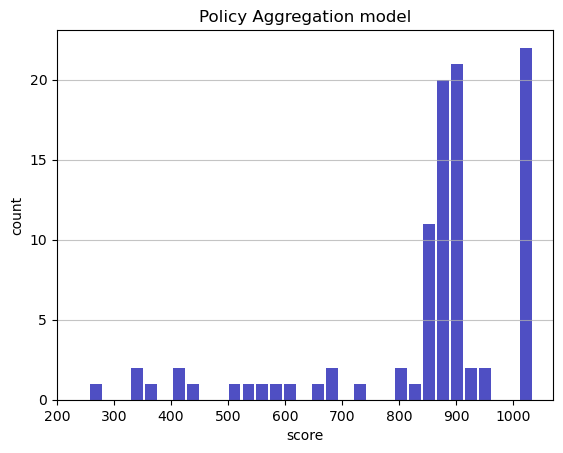

Track generation: 1224..1534 -> 310-tiles track
Epoch: 98
Policy Aggregation	mean: 854.85	variance: 173.36


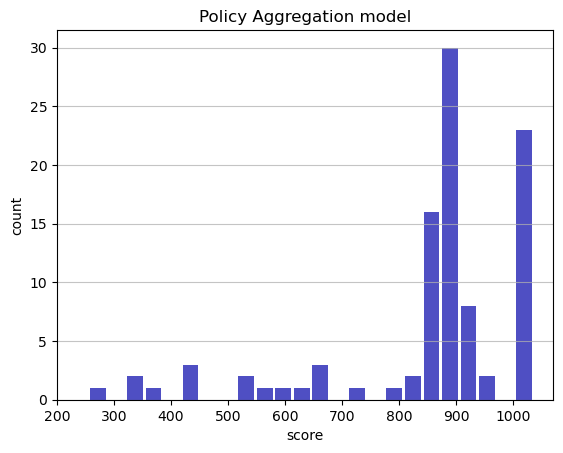

Track generation: 1049..1324 -> 275-tiles track
Epoch: 99
Policy Aggregation	mean: 855.37	variance: 172.56


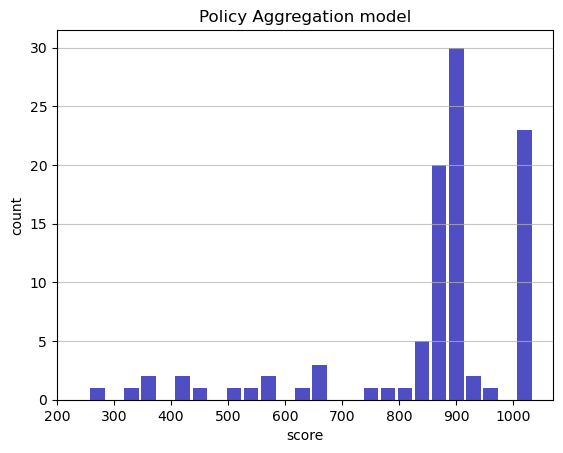

Track generation: 1092..1373 -> 281-tiles track
Epoch: 100
Policy Aggregation	mean: 857.15	variance: 172.61


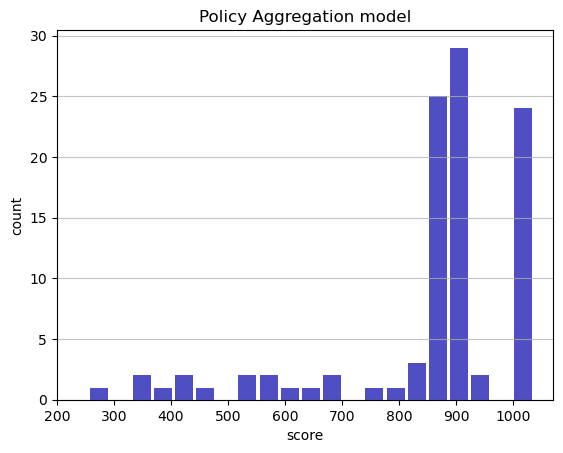

Track generation: 1092..1369 -> 277-tiles track
Epoch: 101
Policy Aggregation	mean: 857.29	variance: 171.76


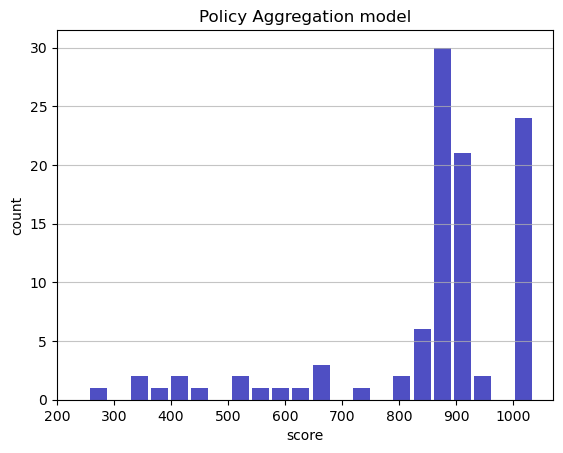

Track generation: 1299..1628 -> 329-tiles track
Epoch: 102
Policy Aggregation	mean: 858.83	variance: 171.61


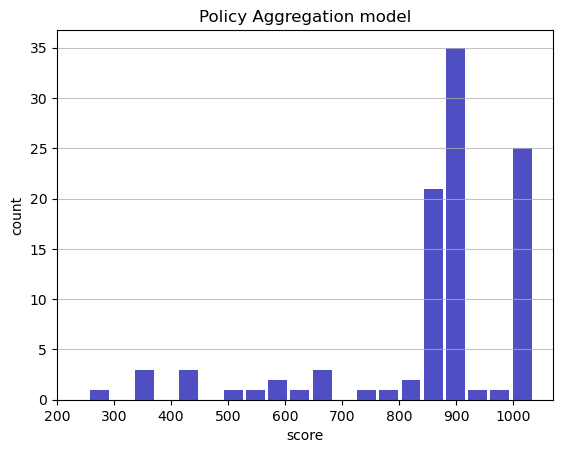

Track generation: 1151..1451 -> 300-tiles track
Epoch: 103
Policy Aggregation	mean: 860.38	variance: 171.50


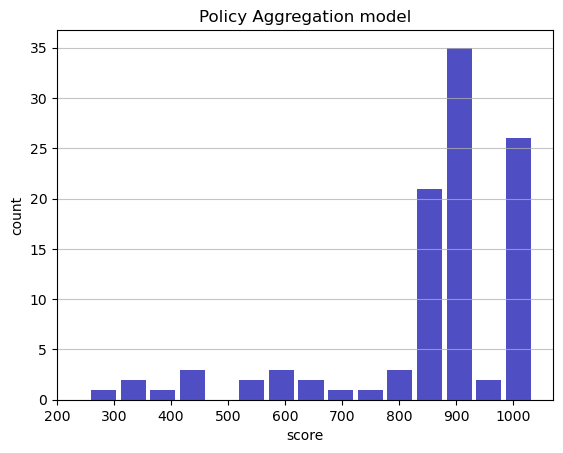

Track generation: 1304..1634 -> 330-tiles track
Epoch: 104
Policy Aggregation	mean: 860.73	variance: 170.71


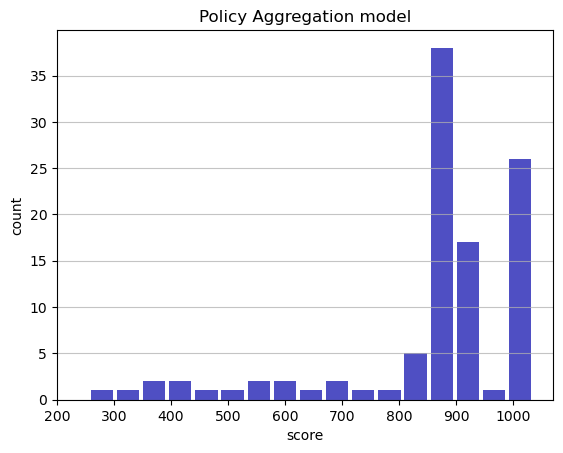

Track generation: 1100..1379 -> 279-tiles track
Epoch: 105
Policy Aggregation	mean: 861.13	variance: 169.94


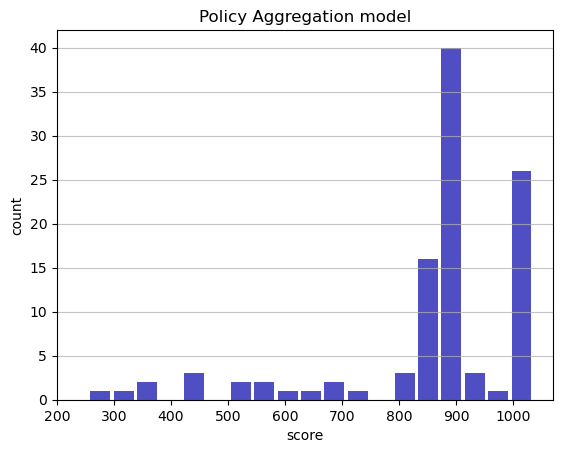

Track generation: 1042..1315 -> 273-tiles track
Epoch: 106
Policy Aggregation	mean: 862.70	variance: 169.91


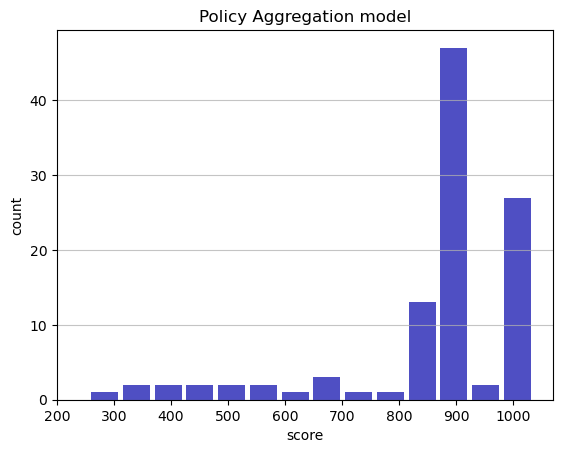

Track generation: 1285..1611 -> 326-tiles track
Epoch: 107
Policy Aggregation	mean: 863.44	variance: 169.28


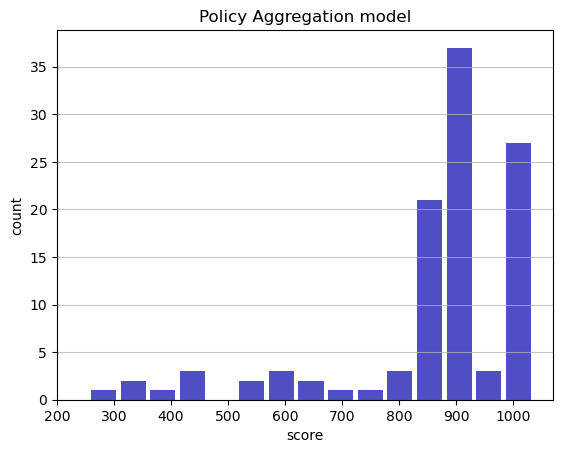

Track generation: 1158..1451 -> 293-tiles track
Epoch: 108
Policy Aggregation	mean: 864.33	variance: 168.75


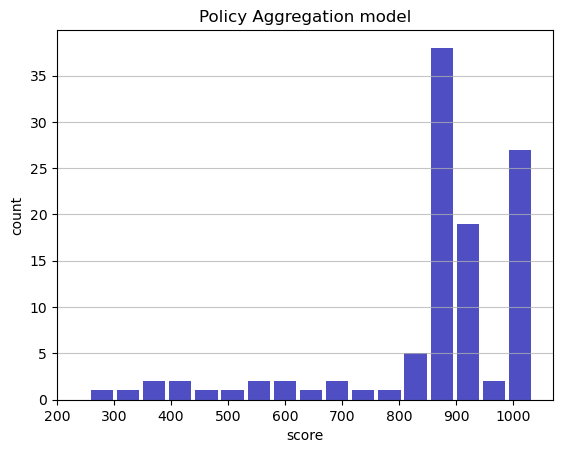

Track generation: 1109..1390 -> 281-tiles track
Epoch: 109
Policy Aggregation	mean: 865.84	variance: 168.70


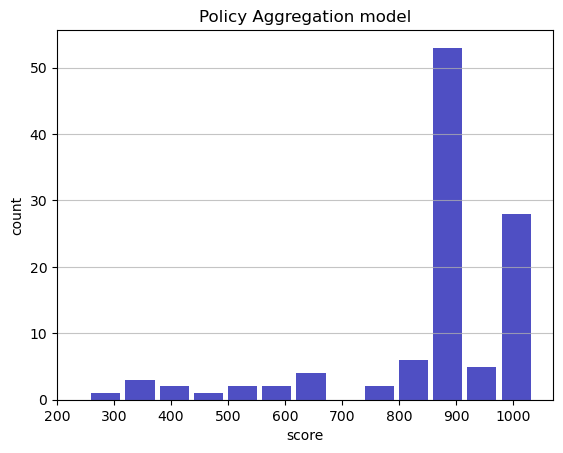

Track generation: 1112..1402 -> 290-tiles track
Epoch: 110
Policy Aggregation	mean: 867.26	variance: 168.59


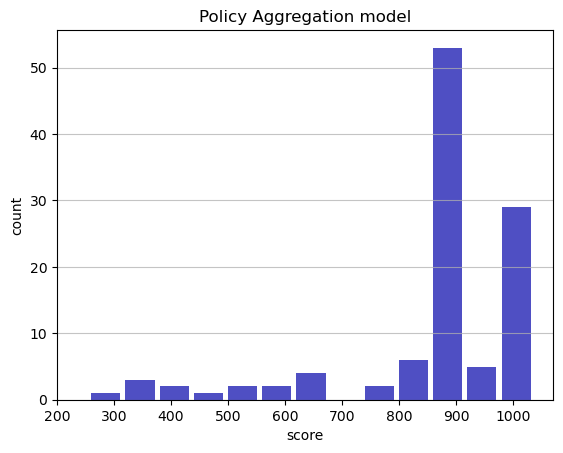

Track generation: 1212..1519 -> 307-tiles track
Epoch: 111
Policy Aggregation	mean: 867.32	variance: 167.83


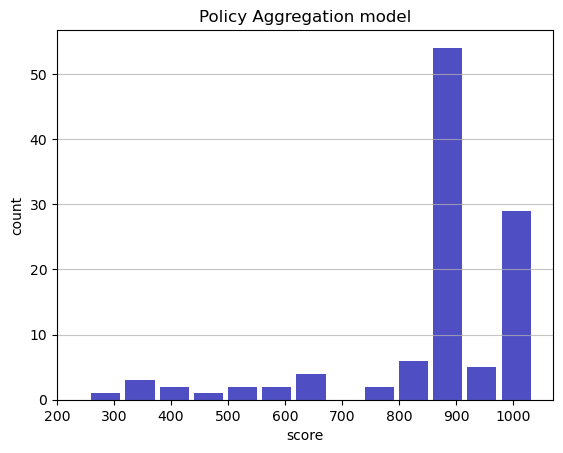

Track generation: 1395..1748 -> 353-tiles track
Epoch: 112
Policy Aggregation	mean: 865.75	variance: 167.89


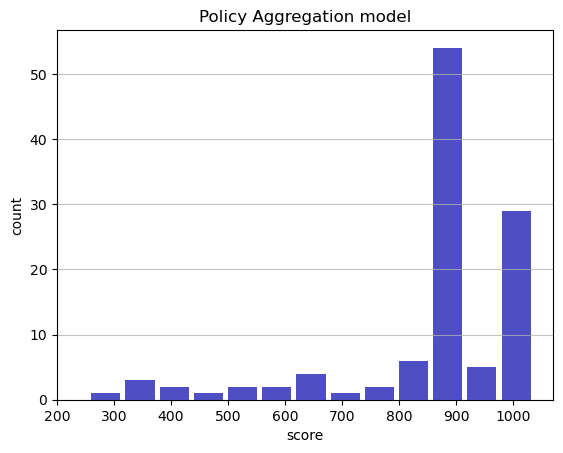

Track generation: 1179..1478 -> 299-tiles track
Epoch: 113
Policy Aggregation	mean: 865.89	variance: 167.15


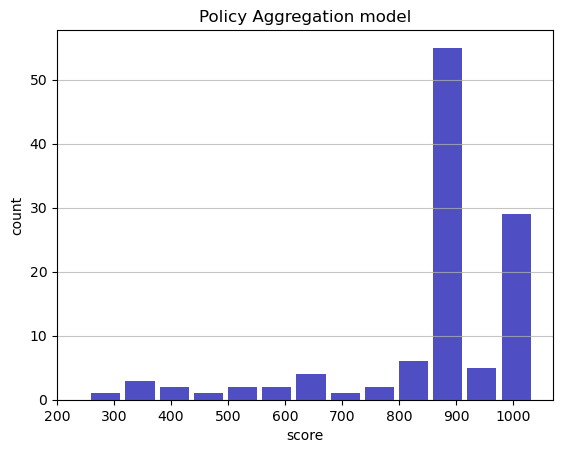

Track generation: 1203..1508 -> 305-tiles track
Epoch: 114
Policy Aggregation	mean: 866.05	variance: 166.43


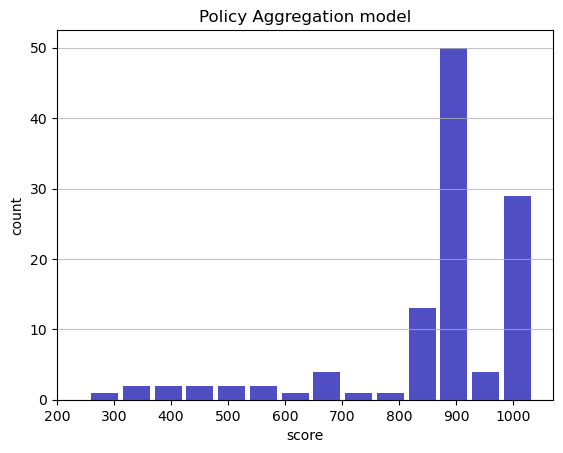

Track generation: 968..1222 -> 254-tiles track
Epoch: 115
Policy Aggregation	mean: 866.21	variance: 165.71


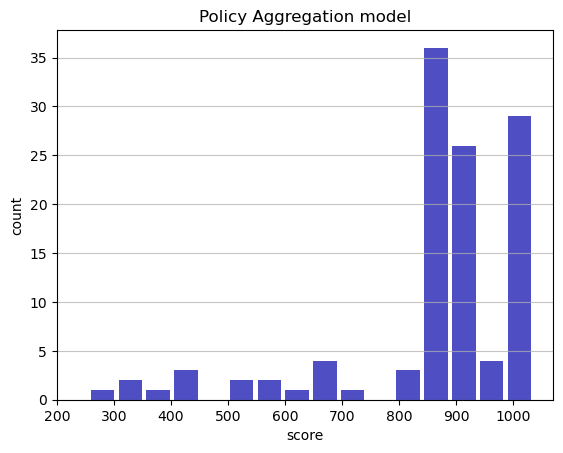

Track generation: 1201..1505 -> 304-tiles track
Epoch: 116
Policy Aggregation	mean: 866.18	variance: 164.99


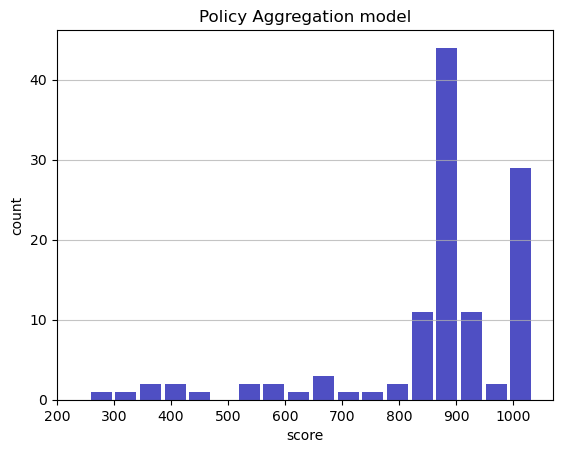

Track generation: 1124..1409 -> 285-tiles track
Epoch: 117
Policy Aggregation	mean: 866.21	variance: 164.29


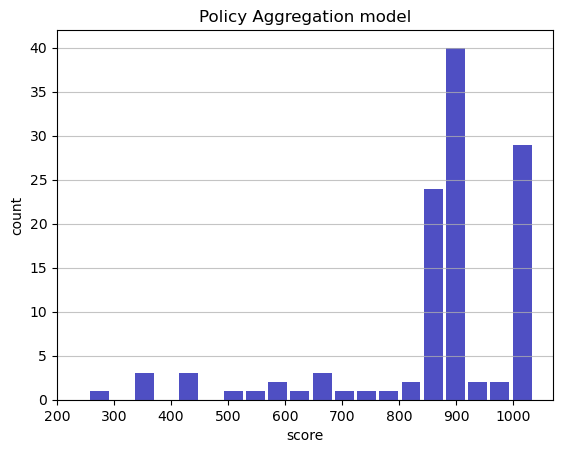

Track generation: 1125..1419 -> 294-tiles track
Epoch: 118
Policy Aggregation	mean: 866.26	variance: 163.59


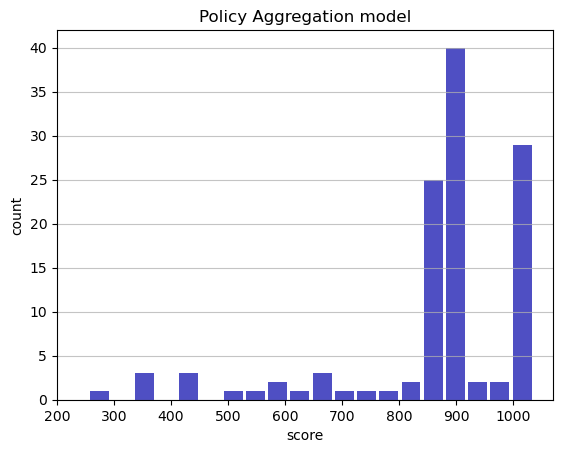

Track generation: 1040..1304 -> 264-tiles track
Epoch: 119
Policy Aggregation	mean: 867.66	variance: 163.60


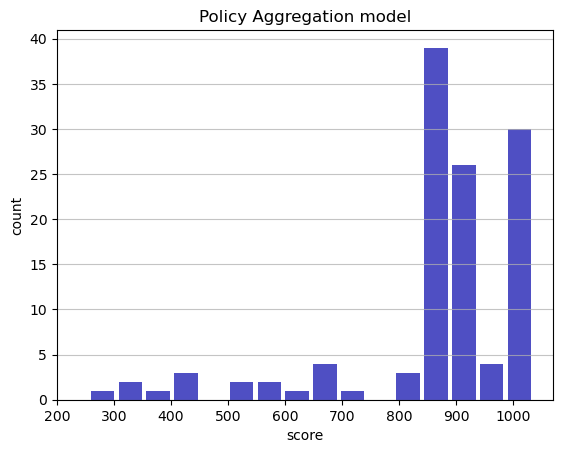

Track generation: 1020..1285 -> 265-tiles track
Epoch: 120
Policy Aggregation	mean: 863.88	variance: 168.05


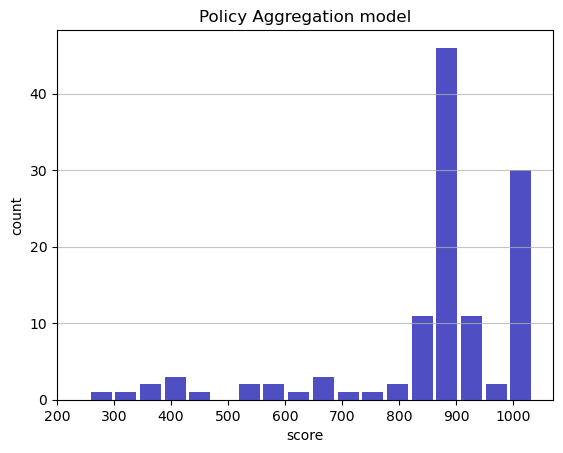

Track generation: 1229..1548 -> 319-tiles track
Epoch: 121
Policy Aggregation	mean: 864.17	variance: 167.38


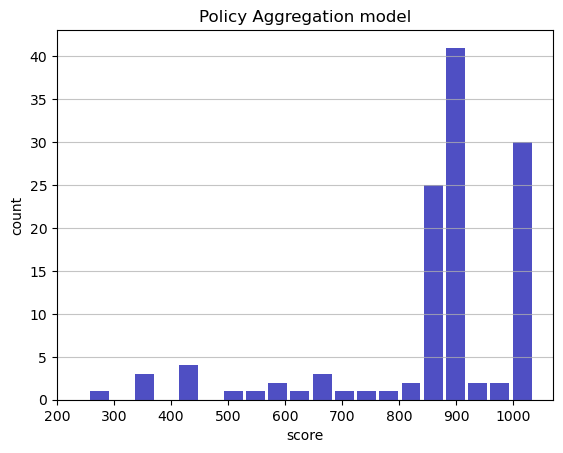

Track generation: 1028..1289 -> 261-tiles track
Epoch: 122
Policy Aggregation	mean: 864.21	variance: 166.70


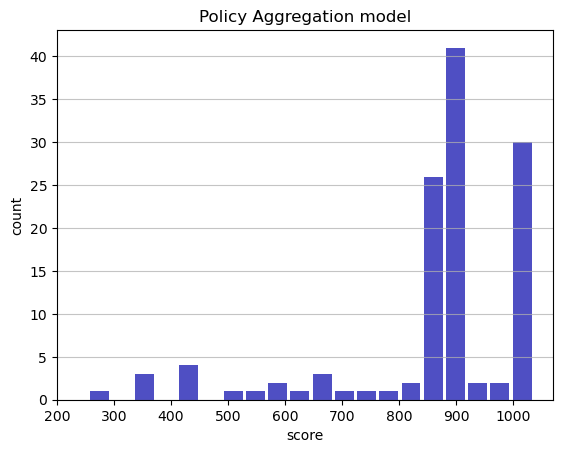

Track generation: 1184..1484 -> 300-tiles track
Epoch: 123
Policy Aggregation	mean: 865.49	variance: 166.62


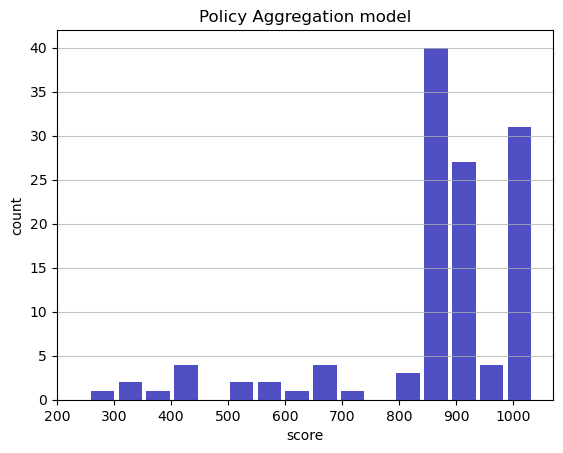

Track generation: 1192..1498 -> 306-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 957..1209 -> 252-tiles track
Epoch: 124
Policy Aggregation	mean: 866.80	variance: 166.58


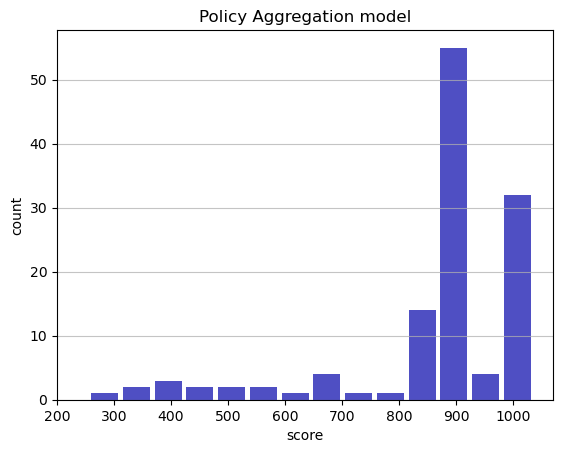

Track generation: 996..1249 -> 253-tiles track
Epoch: 125
Policy Aggregation	mean: 867.17	variance: 165.96


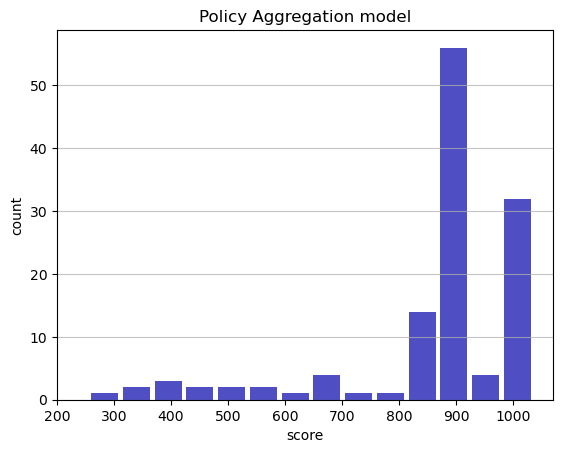

Track generation: 1083..1358 -> 275-tiles track
Epoch: 126
Policy Aggregation	mean: 867.24	variance: 165.30


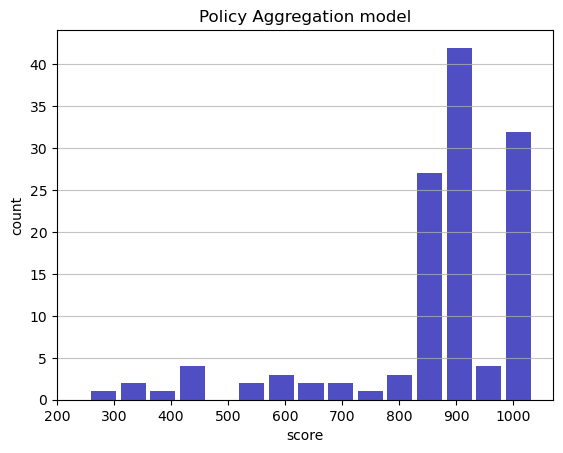

Track generation: 1215..1523 -> 308-tiles track
Epoch: 127
Policy Aggregation	mean: 867.25	variance: 164.65


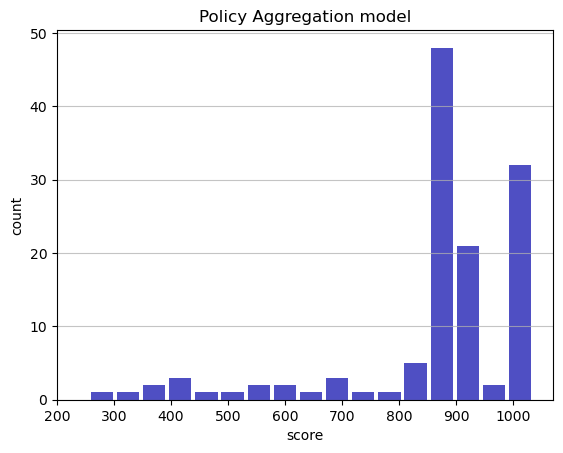

Track generation: 1219..1527 -> 308-tiles track
Epoch: 128
Policy Aggregation	mean: 867.48	variance: 164.02


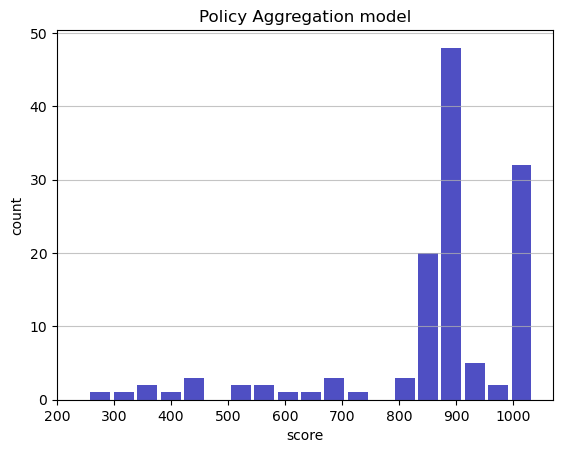

Track generation: 1010..1273 -> 263-tiles track
Epoch: 129
Policy Aggregation	mean: 868.77	variance: 164.04


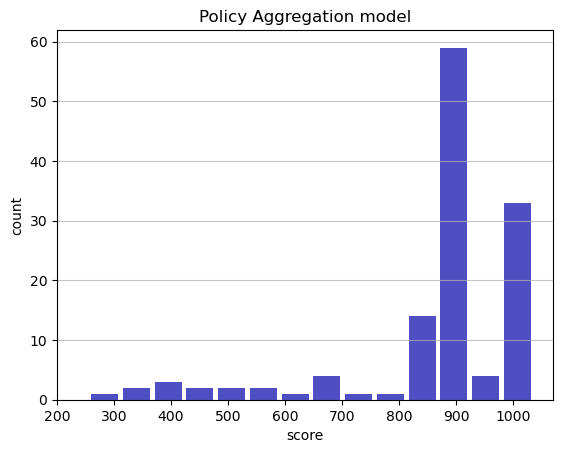

Track generation: 1083..1358 -> 275-tiles track
Epoch: 130
Policy Aggregation	mean: 869.02	variance: 163.43


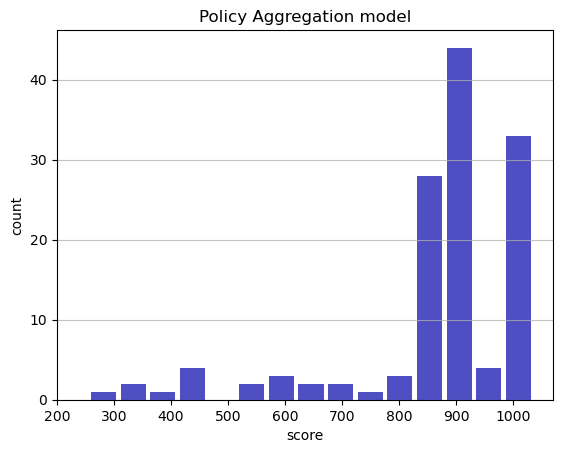

Track generation: 1115..1398 -> 283-tiles track
Epoch: 131
Policy Aggregation	mean: 865.40	variance: 167.95


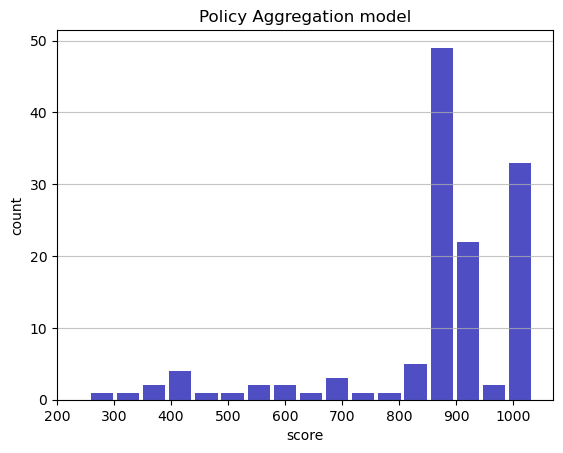

Track generation: 1248..1554 -> 306-tiles track
Epoch: 132
Policy Aggregation	mean: 864.65	variance: 167.53


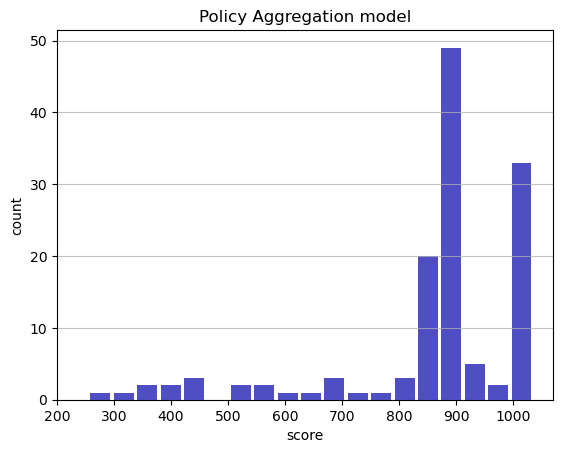

Track generation: 982..1232 -> 250-tiles track
Epoch: 133
Policy Aggregation	mean: 864.89	variance: 166.93


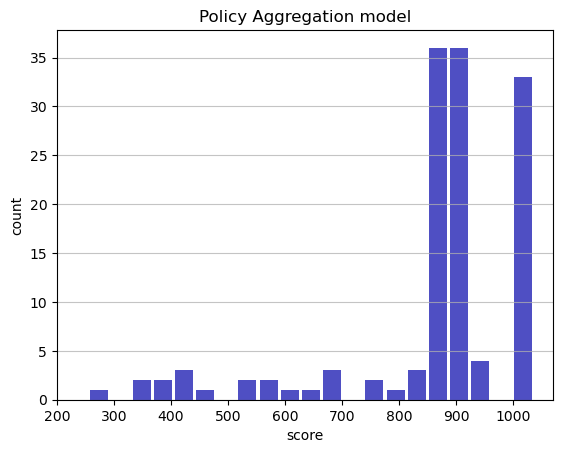

Track generation: 1008..1264 -> 256-tiles track
Epoch: 134
Policy Aggregation	mean: 865.33	variance: 166.38


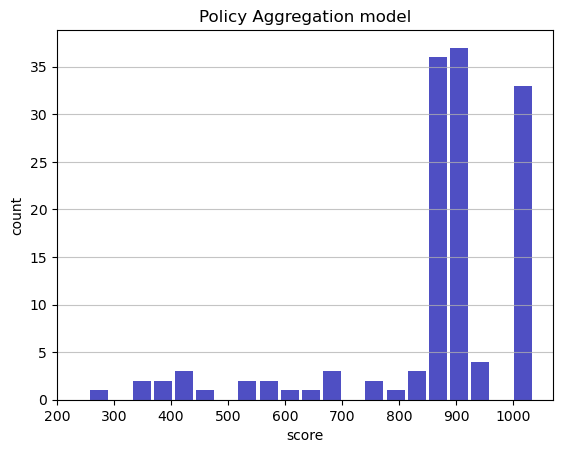

Track generation: 1038..1309 -> 271-tiles track
Epoch: 135
Policy Aggregation	mean: 866.53	variance: 166.35


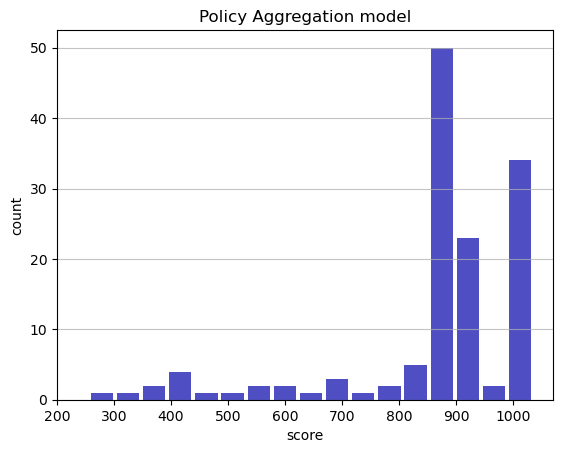

Track generation: 1121..1405 -> 284-tiles track
Epoch: 136
Policy Aggregation	mean: 866.77	variance: 165.76


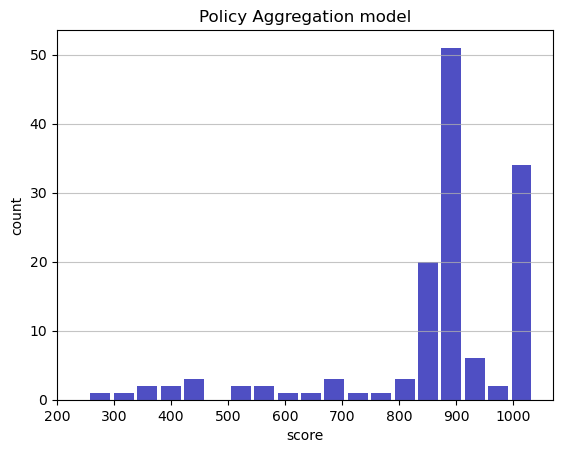

Track generation: 1071..1343 -> 272-tiles track
Epoch: 137
Policy Aggregation	mean: 866.96	variance: 165.17


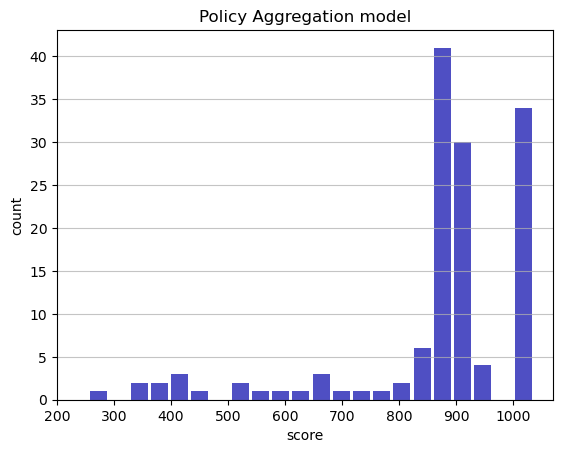

Track generation: 1084..1359 -> 275-tiles track
Epoch: 138
Policy Aggregation	mean: 867.13	variance: 164.58


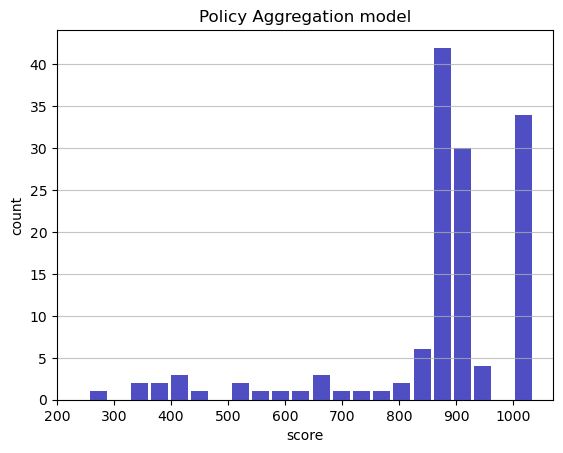

Track generation: 1040..1310 -> 270-tiles track
Epoch: 139
Policy Aggregation	mean: 867.35	variance: 164.01


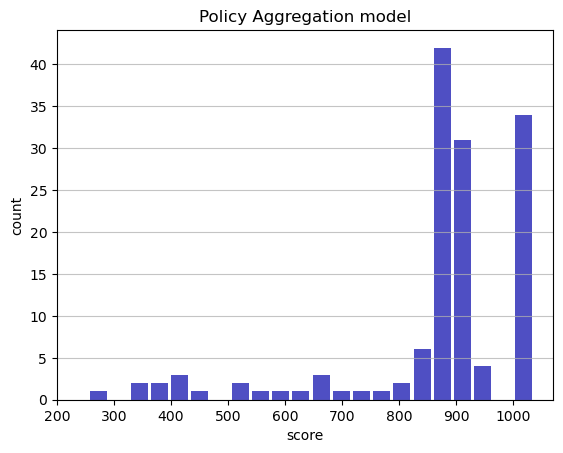

Track generation: 1245..1560 -> 315-tiles track
Epoch: 140
Policy Aggregation	mean: 867.44	variance: 163.42


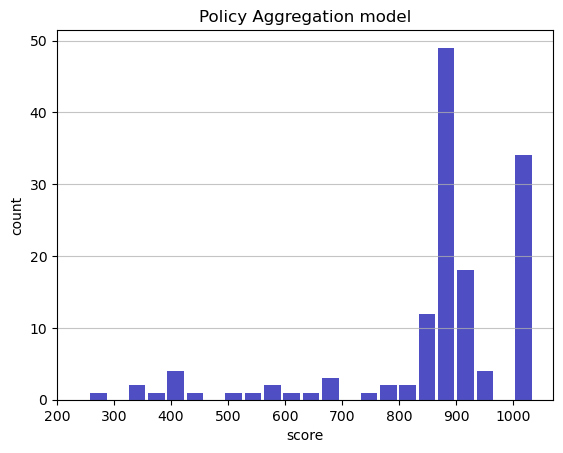

Track generation: 1080..1354 -> 274-tiles track
Epoch: 141
Policy Aggregation	mean: 867.54	variance: 162.85


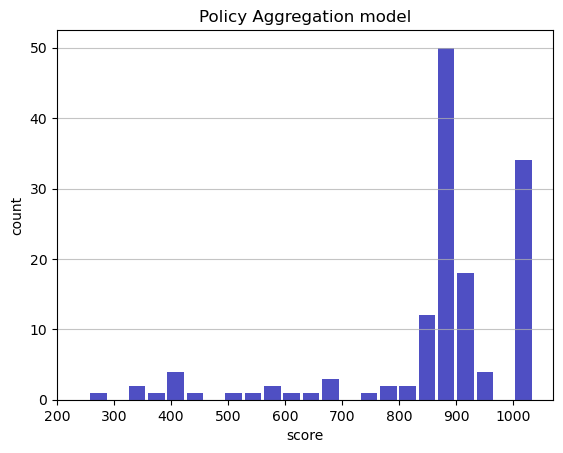

Track generation: 1095..1373 -> 278-tiles track
Epoch: 142
Policy Aggregation	mean: 867.81	variance: 162.30


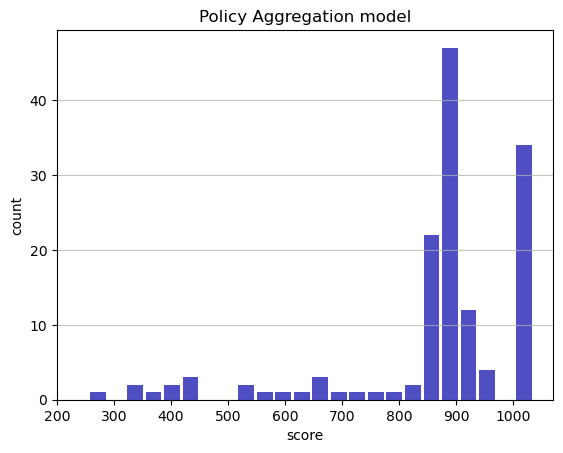

Track generation: 1187..1488 -> 301-tiles track
Epoch: 143
Policy Aggregation	mean: 864.10	variance: 167.68


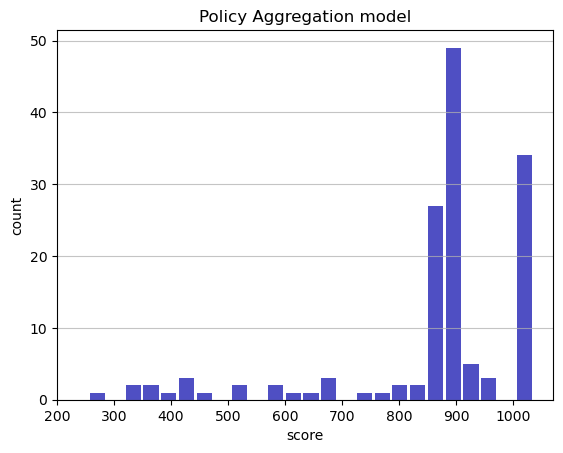

Track generation: 1247..1563 -> 316-tiles track
Epoch: 144
Policy Aggregation	mean: 864.73	variance: 167.27


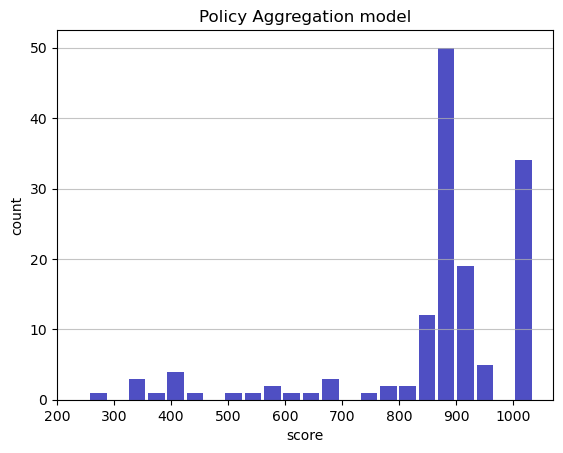

Track generation: 968..1214 -> 246-tiles track
Epoch: 145
Policy Aggregation	mean: 864.82	variance: 166.70


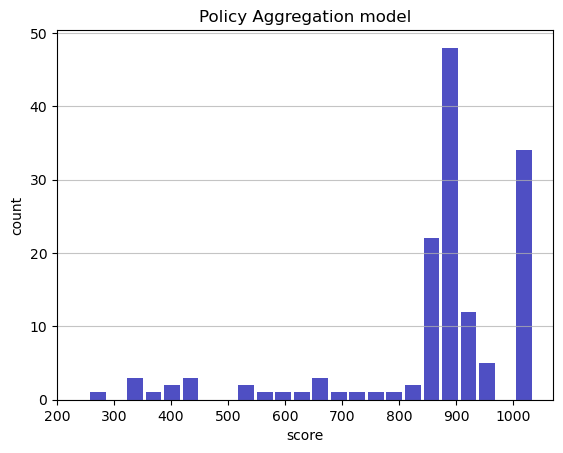

Track generation: 1148..1439 -> 291-tiles track
Epoch: 146
Policy Aggregation	mean: 865.06	variance: 166.15


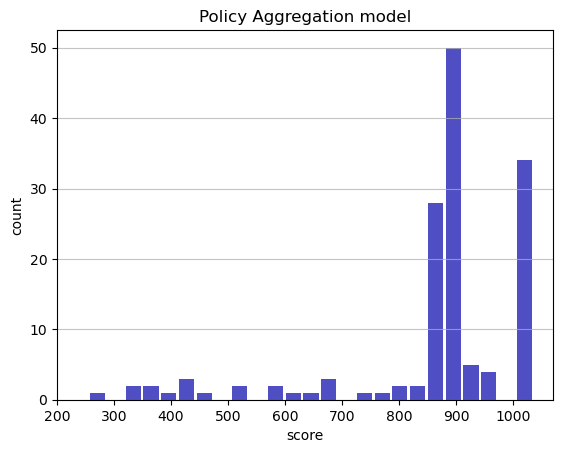

Track generation: 1196..1500 -> 304-tiles track
Epoch: 147
Policy Aggregation	mean: 865.36	variance: 165.62


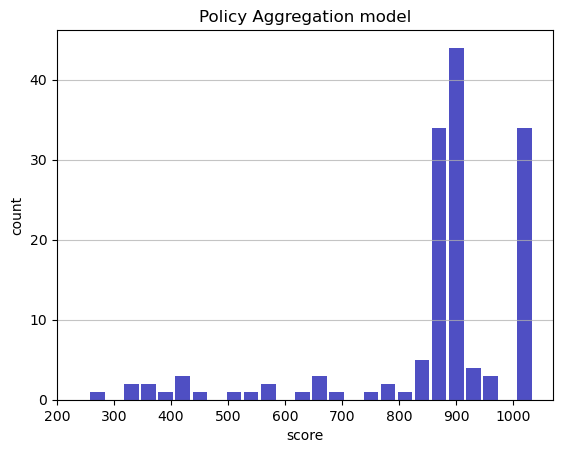

Track generation: 1136..1424 -> 288-tiles track
Epoch: 148
Policy Aggregation	mean: 865.35	variance: 165.06


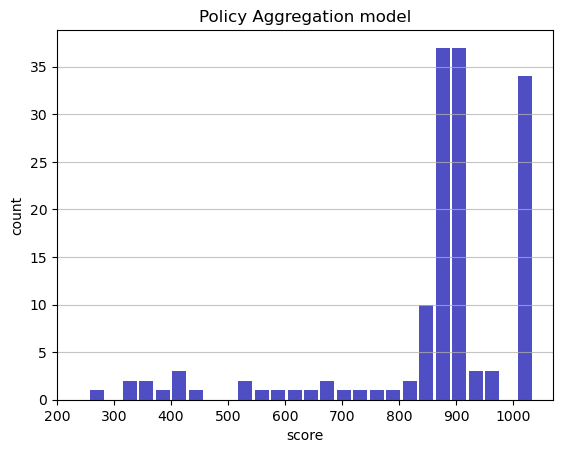

Track generation: 1000..1254 -> 254-tiles track
Epoch: 149
Policy Aggregation	mean: 863.18	variance: 166.61


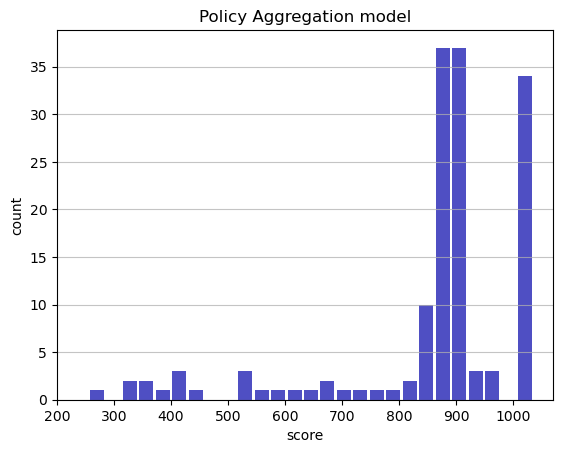

Track generation: 1184..1484 -> 300-tiles track
Epoch: 150
Policy Aggregation	mean: 863.16	variance: 166.06


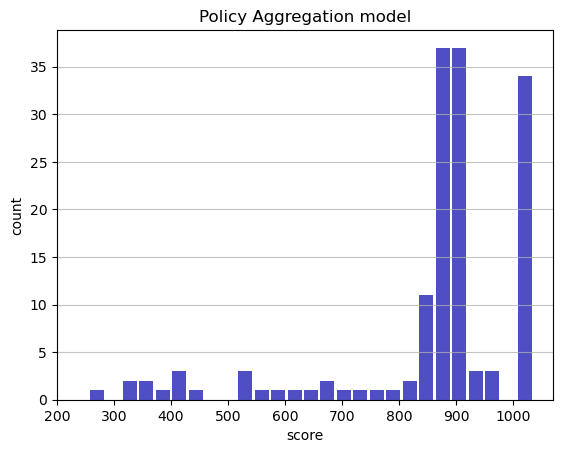

Track generation: 1103..1383 -> 280-tiles track
Epoch: 151
Policy Aggregation	mean: 864.24	variance: 166.03


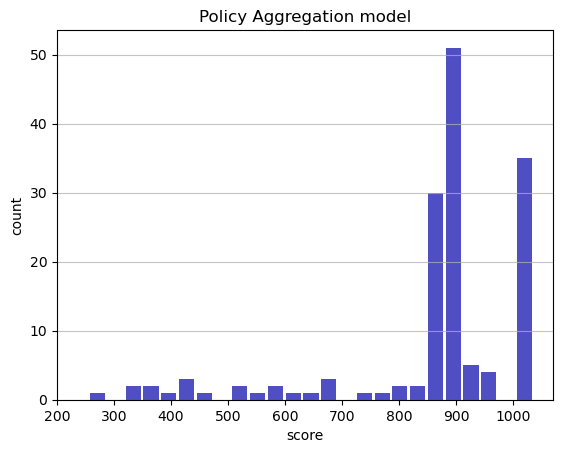

Track generation: 1180..1479 -> 299-tiles track
Epoch: 152
Policy Aggregation	mean: 865.31	variance: 166.00


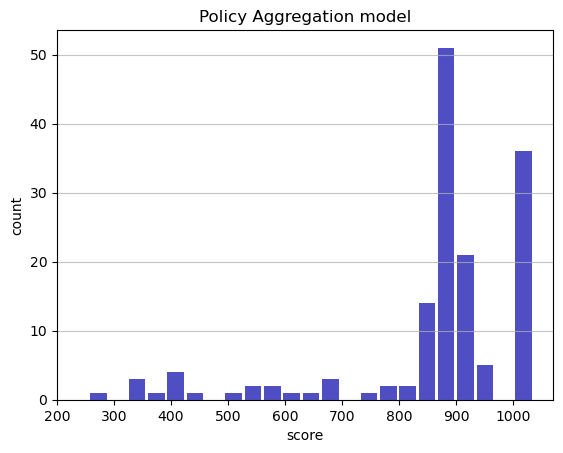

Track generation: 1048..1322 -> 274-tiles track
Epoch: 153
Policy Aggregation	mean: 865.47	variance: 165.47


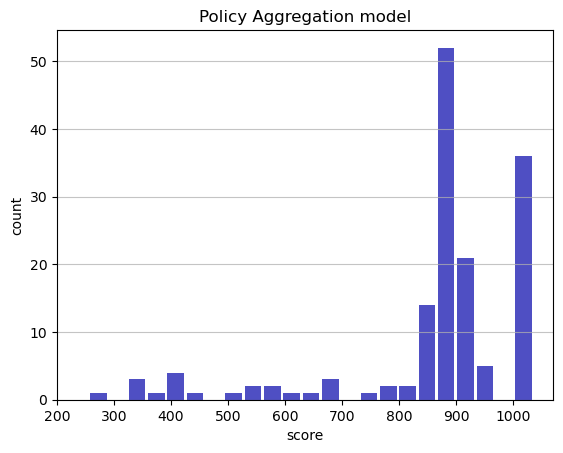

Track generation: 1051..1318 -> 267-tiles track
Epoch: 154
Policy Aggregation	mean: 866.55	variance: 165.48


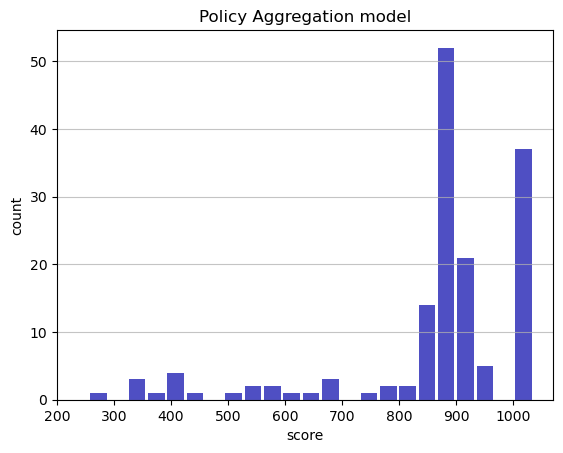

Track generation: 1162..1456 -> 294-tiles track
Epoch: 155
Policy Aggregation	mean: 862.73	variance: 171.63


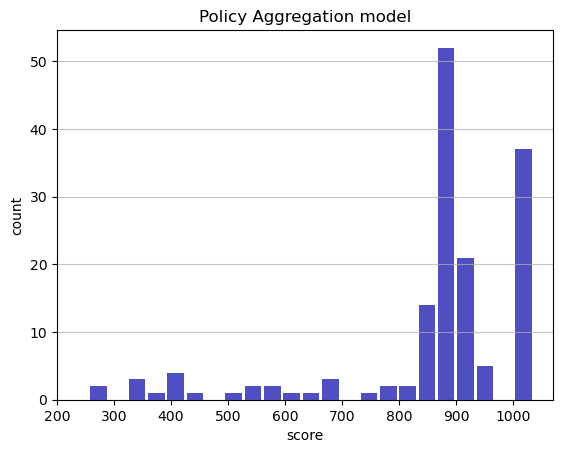

Track generation: 1127..1418 -> 291-tiles track
Epoch: 156
Policy Aggregation	mean: 863.74	variance: 171.54


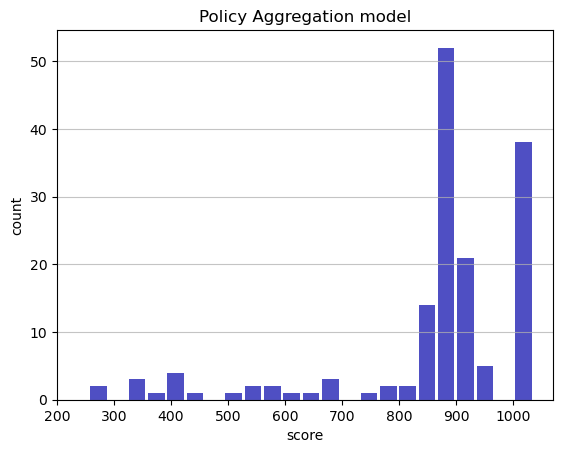

Track generation: 1168..1469 -> 301-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1198..1501 -> 303-tiles track
Epoch: 157
Policy Aggregation	mean: 863.88	variance: 171.00


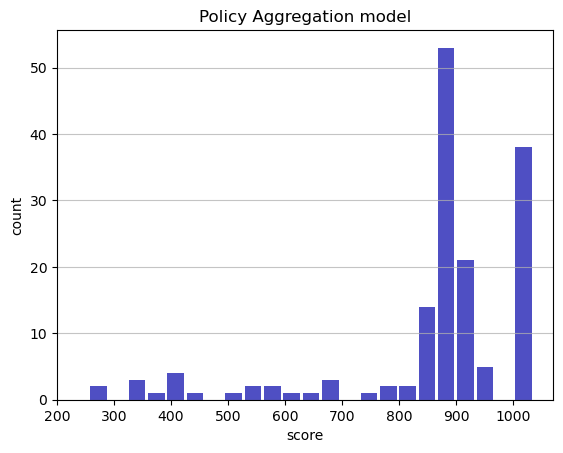

Track generation: 1194..1497 -> 303-tiles track
Epoch: 158
Policy Aggregation	mean: 864.89	variance: 170.93


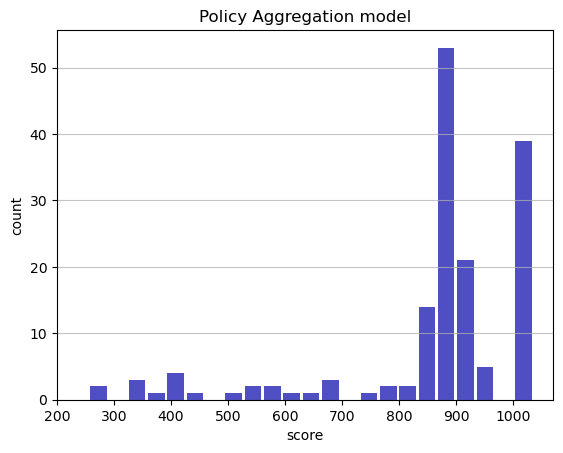

Track generation: 1114..1396 -> 282-tiles track
Epoch: 159
Policy Aggregation	mean: 865.10	variance: 170.41


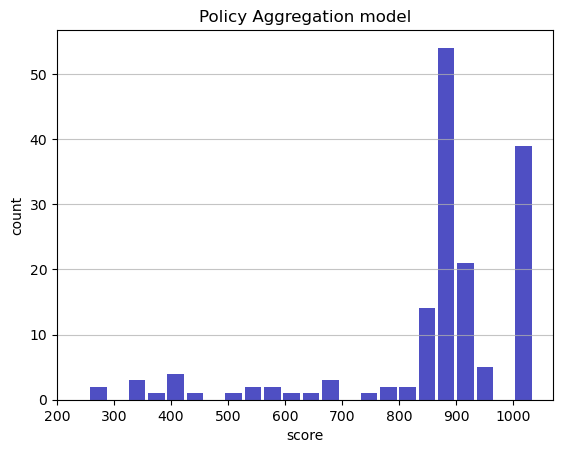

Track generation: 1112..1394 -> 282-tiles track
Epoch: 160
Policy Aggregation	mean: 865.36	variance: 169.91


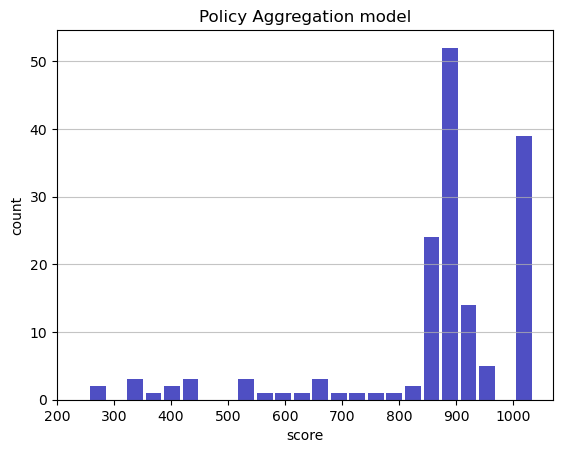

Track generation: 1108..1388 -> 280-tiles track
Epoch: 161
Policy Aggregation	mean: 865.63	variance: 169.41


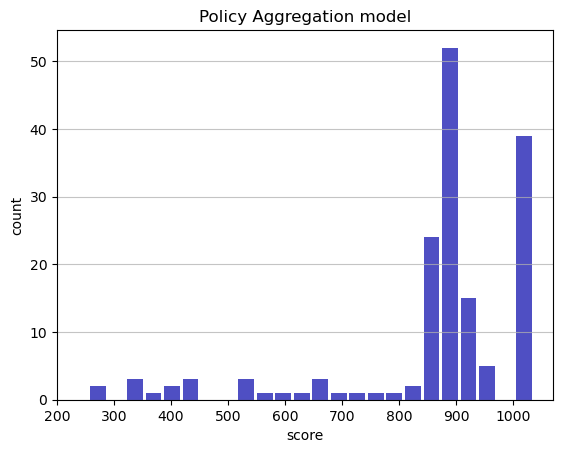

Track generation: 1116..1399 -> 283-tiles track
Epoch: 162
Policy Aggregation	mean: 865.81	variance: 168.90


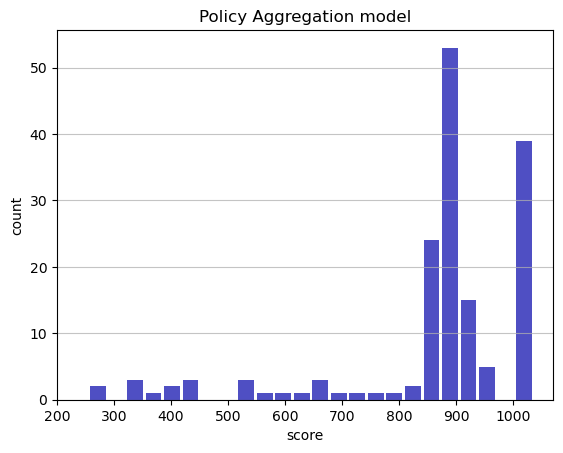

Track generation: 1199..1503 -> 304-tiles track
Epoch: 163
Policy Aggregation	mean: 866.77	variance: 168.83


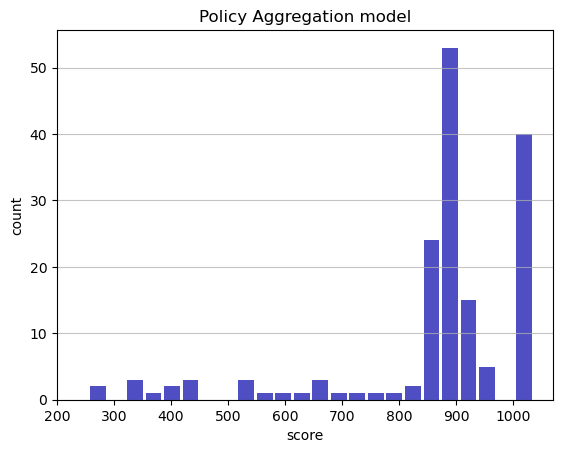

Track generation: 1059..1336 -> 277-tiles track
Epoch: 164
Policy Aggregation	mean: 866.86	variance: 168.32


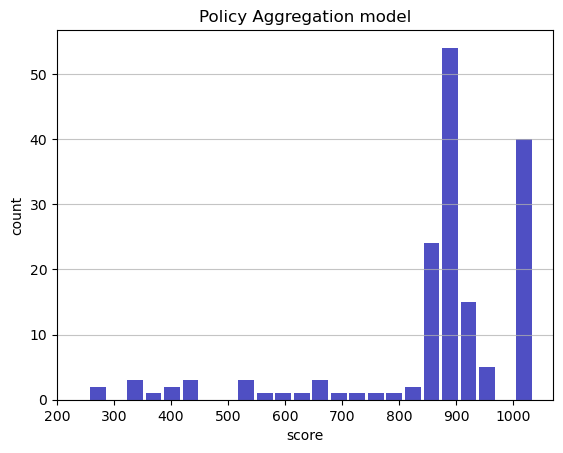

Track generation: 1178..1477 -> 299-tiles track
Epoch: 165
Policy Aggregation	mean: 863.67	variance: 172.72


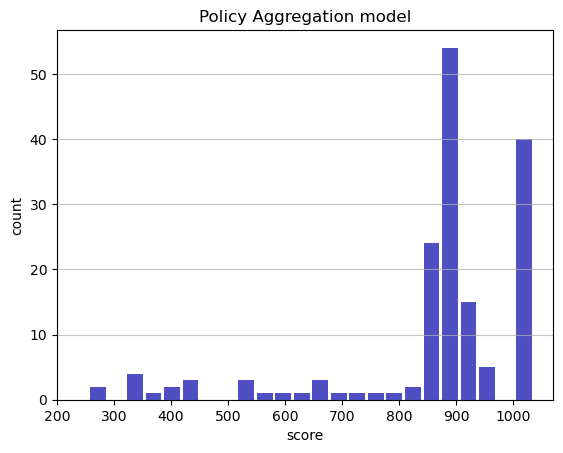

Track generation: 1181..1482 -> 301-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1180..1479 -> 299-tiles track
Epoch: 166
Policy Aggregation	mean: 863.60	variance: 172.20


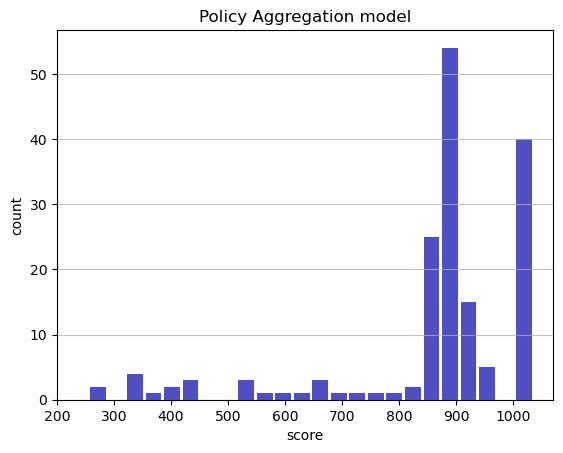

Track generation: 1006..1265 -> 259-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1051..1325 -> 274-tiles track
Epoch: 167
Policy Aggregation	mean: 863.74	variance: 171.69


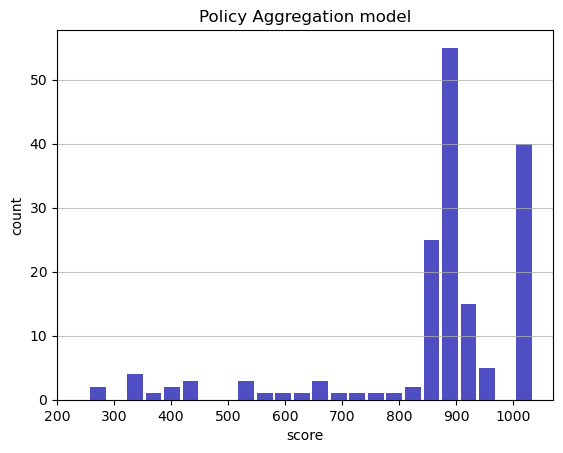

Track generation: 1067..1338 -> 271-tiles track
Epoch: 168
Policy Aggregation	mean: 864.05	variance: 171.23


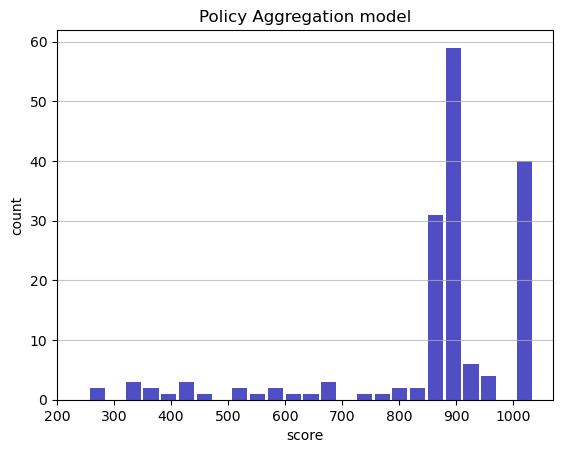

Track generation: 945..1191 -> 246-tiles track
Epoch: 169
Policy Aggregation	mean: 862.89	variance: 171.38


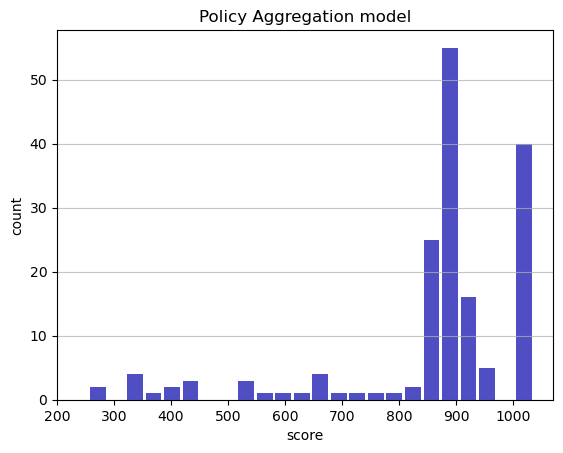

Track generation: 1228..1545 -> 317-tiles track
Epoch: 170
Policy Aggregation	mean: 862.73	variance: 170.89


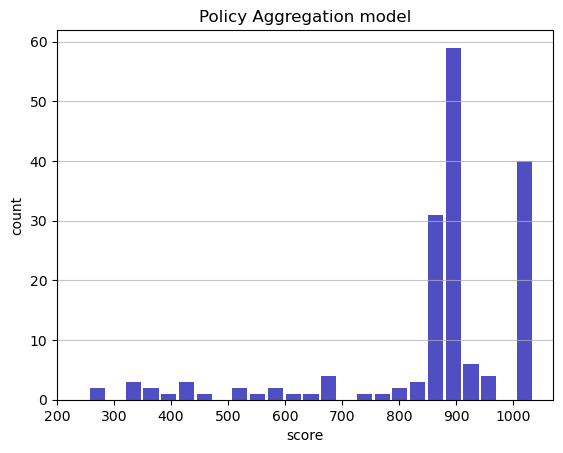

Track generation: 1158..1454 -> 296-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1167..1463 -> 296-tiles track
Epoch: 171
Policy Aggregation	mean: 863.66	variance: 170.81


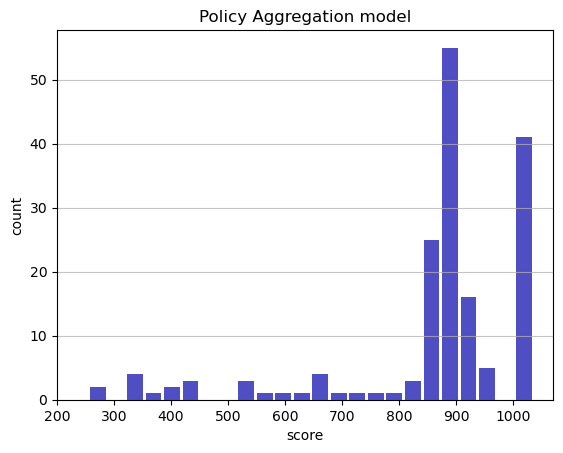

Track generation: 1281..1605 -> 324-tiles track
Epoch: 172
Policy Aggregation	mean: 863.72	variance: 170.32


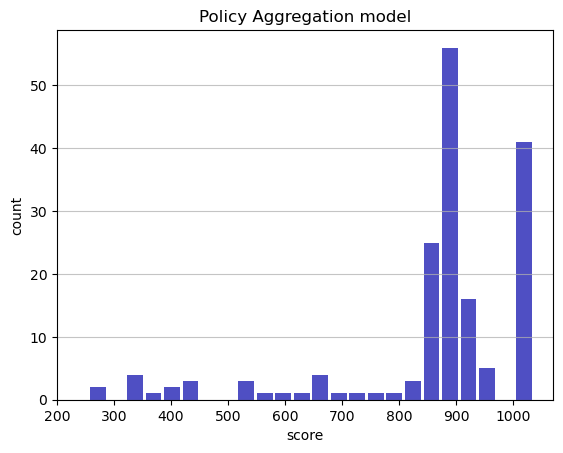

Track generation: 886..1120 -> 234-tiles track
Epoch: 173
Policy Aggregation	mean: 863.61	variance: 169.83


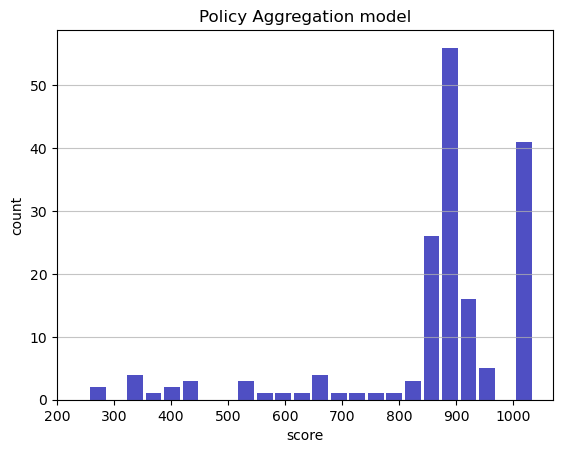

Track generation: 1057..1325 -> 268-tiles track
Epoch: 174
Policy Aggregation	mean: 863.86	variance: 169.37


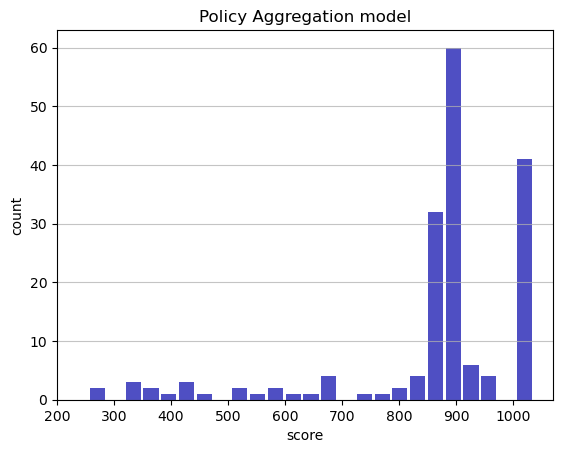

Track generation: 1043..1308 -> 265-tiles track
Epoch: 175
Policy Aggregation	mean: 863.81	variance: 168.89


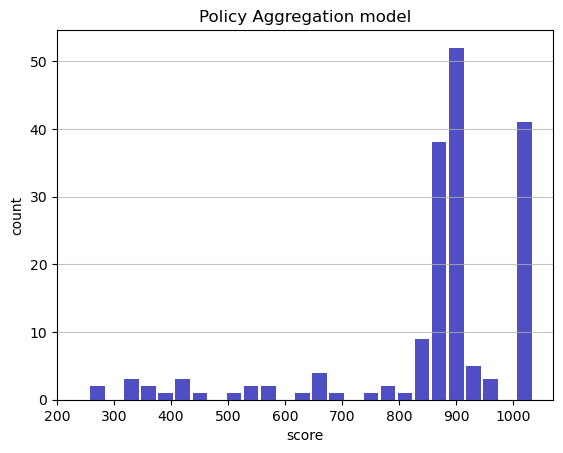

Track generation: 1152..1444 -> 292-tiles track
Epoch: 176
Policy Aggregation	mean: 860.65	variance: 173.52


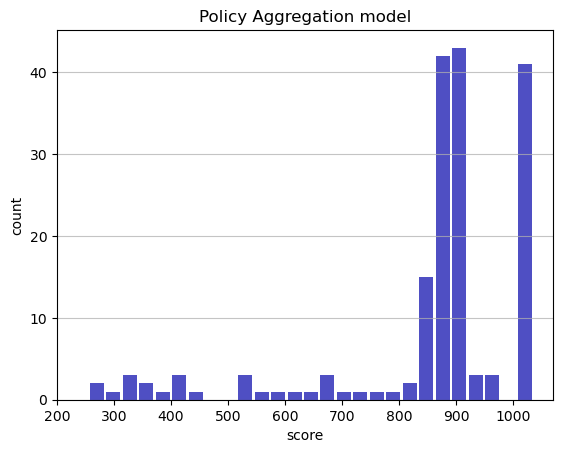

Track generation: 1244..1559 -> 315-tiles track
Epoch: 177
Policy Aggregation	mean: 860.66	variance: 173.03


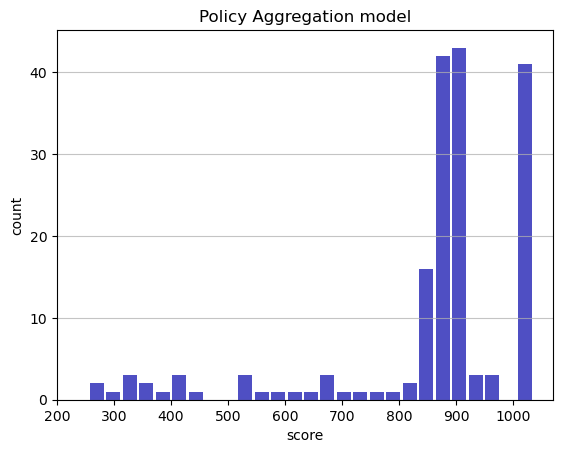

Track generation: 1034..1297 -> 263-tiles track
Epoch: 178
Policy Aggregation	mean: 861.64	variance: 173.03


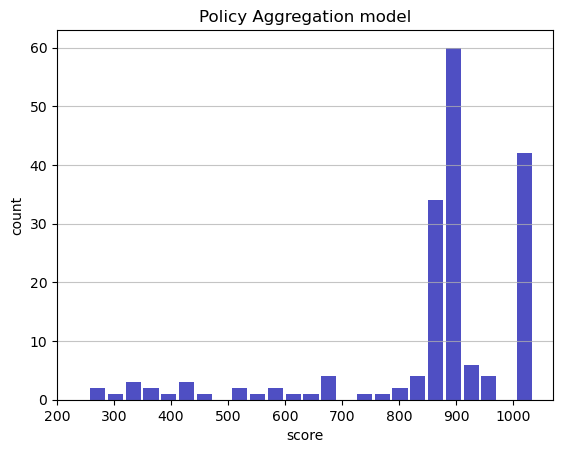

Track generation: 1220..1529 -> 309-tiles track
Epoch: 179
Policy Aggregation	mean: 861.62	variance: 172.55


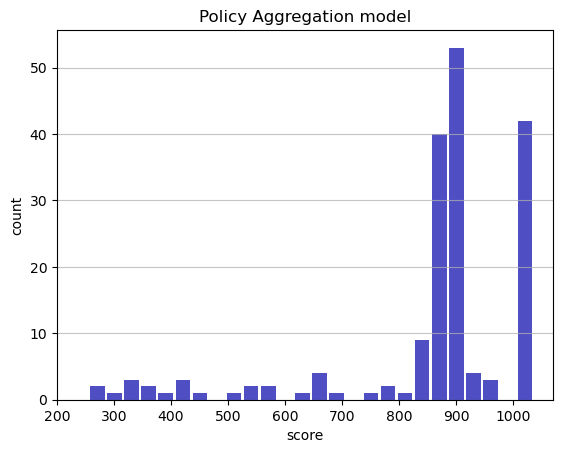

Track generation: 1075..1358 -> 283-tiles track
Epoch: 180
Policy Aggregation	mean: 861.86	variance: 172.10


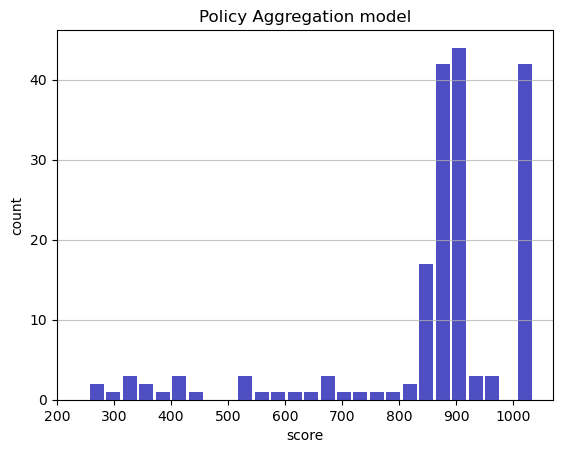

Track generation: 1113..1399 -> 286-tiles track
Epoch: 181
Policy Aggregation	mean: 860.91	variance: 172.09


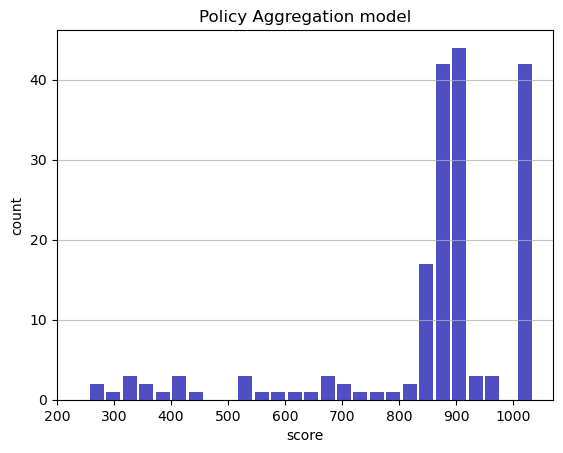

Track generation: 1060..1337 -> 277-tiles track
Epoch: 182
Policy Aggregation	mean: 860.79	variance: 171.63


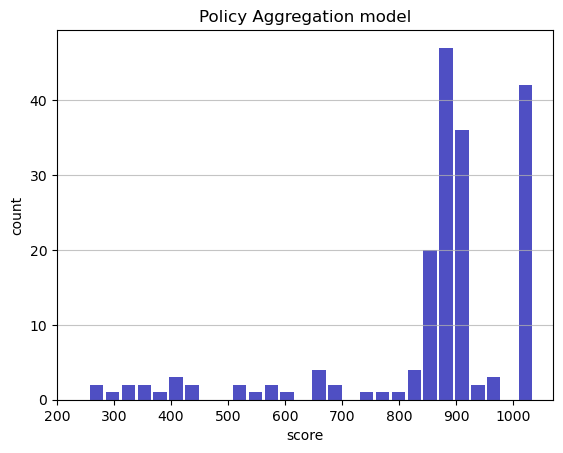

Track generation: 1202..1506 -> 304-tiles track
Epoch: 183
Policy Aggregation	mean: 861.03	variance: 171.19


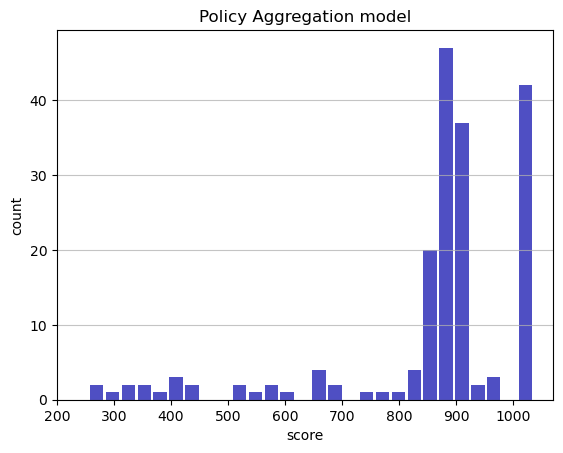

Track generation: 1160..1459 -> 299-tiles track
Epoch: 184
Policy Aggregation	mean: 861.90	variance: 171.13


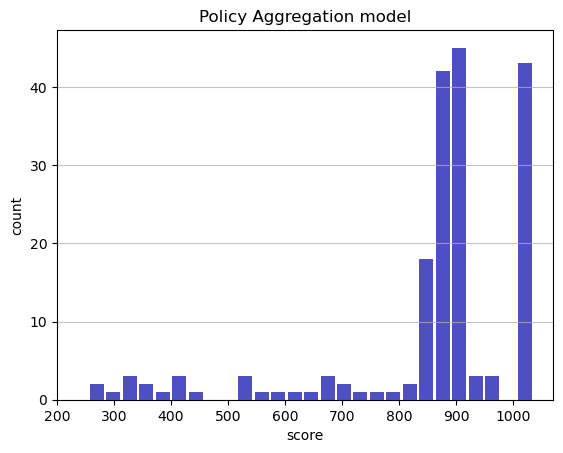

Track generation: 1140..1435 -> 295-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1194..1497 -> 303-tiles track
Epoch: 185
Policy Aggregation	mean: 862.77	variance: 171.07


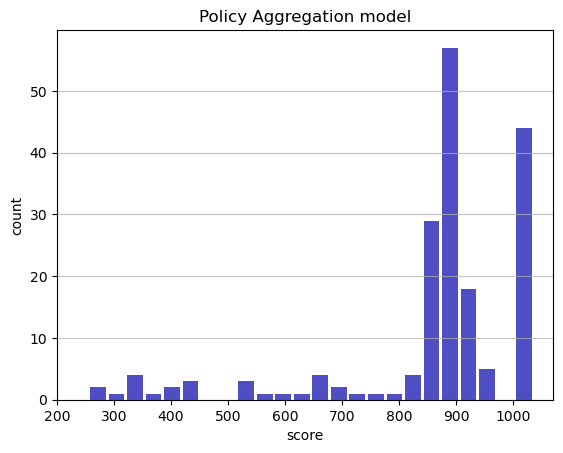

Track generation: 1052..1319 -> 267-tiles track
Epoch: 186
Policy Aggregation	mean: 862.21	variance: 170.78


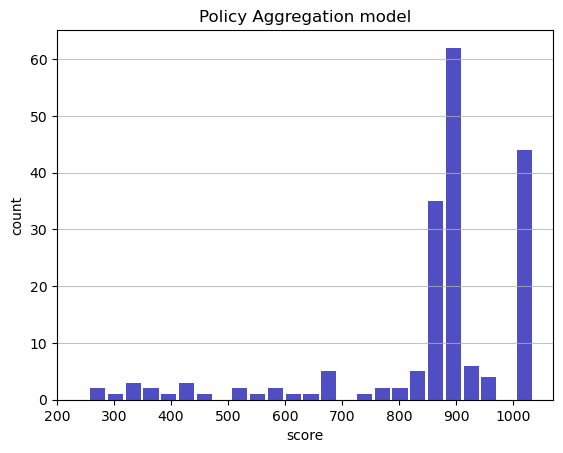

Track generation: 1292..1619 -> 327-tiles track
Epoch: 187
Policy Aggregation	mean: 862.33	variance: 170.34


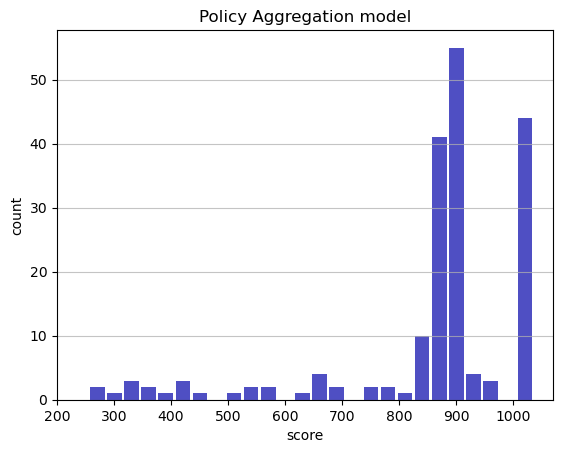

Track generation: 1315..1648 -> 333-tiles track
Epoch: 188
Policy Aggregation	mean: 863.11	variance: 170.22


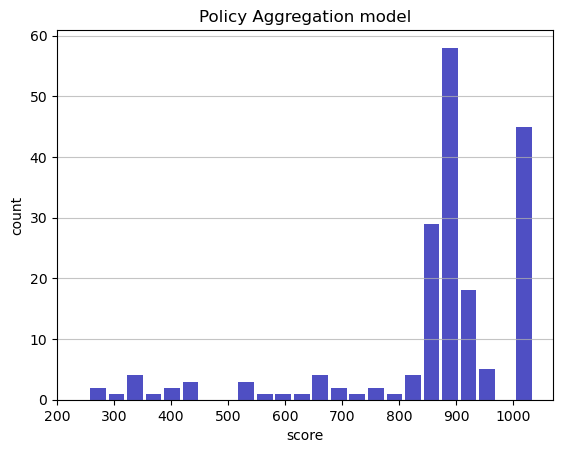

Track generation: 1175..1473 -> 298-tiles track
Epoch: 189
Policy Aggregation	mean: 863.96	variance: 170.17


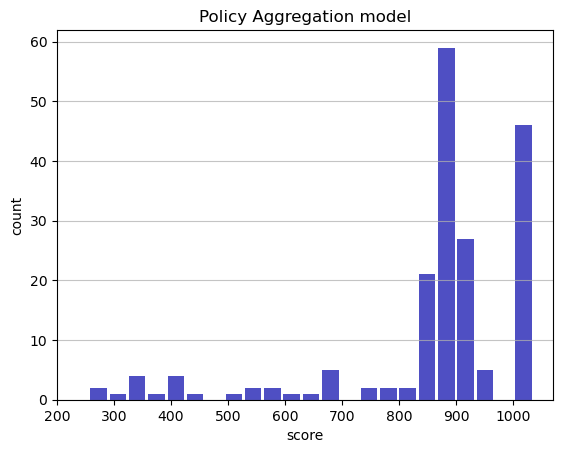

Track generation: 1060..1332 -> 272-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1051..1318 -> 267-tiles track
Epoch: 190
Policy Aggregation	mean: 864.20	variance: 169.75


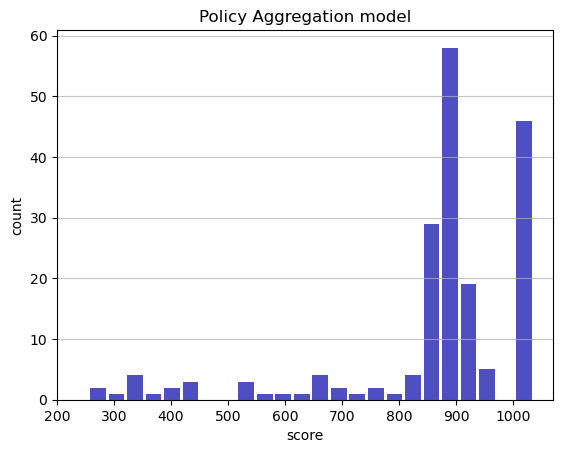

Track generation: 1176..1474 -> 298-tiles track
Epoch: 191
Policy Aggregation	mean: 865.02	variance: 169.68


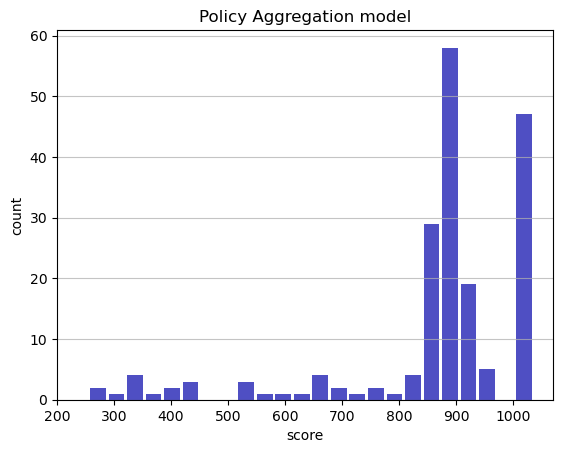

Track generation: 1364..1709 -> 345-tiles track
Epoch: 192
Policy Aggregation	mean: 862.14	variance: 173.86


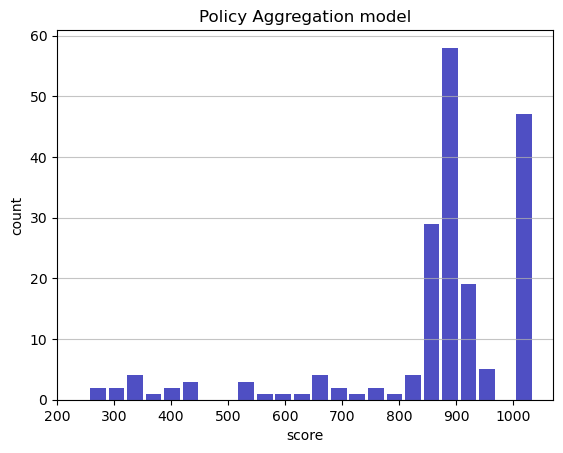

Track generation: 1169..1465 -> 296-tiles track
Epoch: 193
Policy Aggregation	mean: 859.55	variance: 177.09


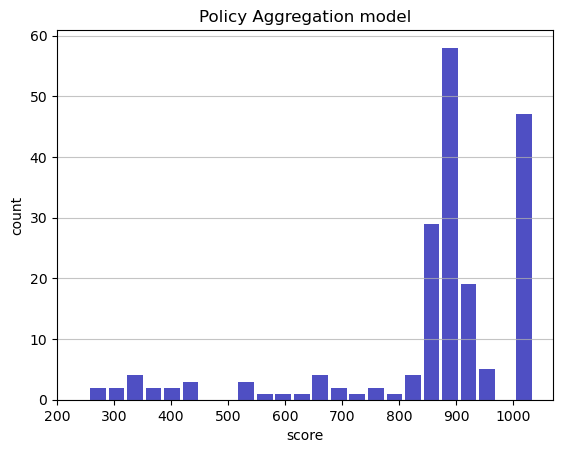

Track generation: 1244..1559 -> 315-tiles track
Epoch: 194
Policy Aggregation	mean: 856.71	variance: 180.96


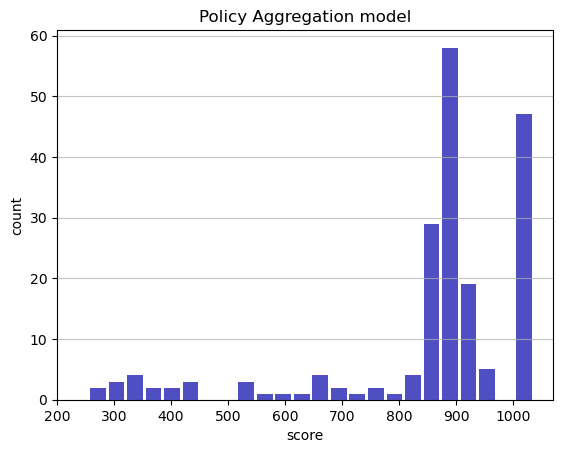

Track generation: 1164..1459 -> 295-tiles track
Epoch: 195
Policy Aggregation	mean: 854.80	variance: 182.45


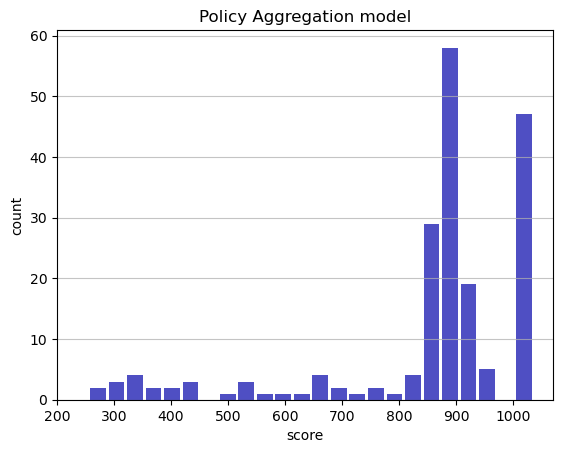

Track generation: 1096..1374 -> 278-tiles track
Epoch: 196
Policy Aggregation	mean: 854.89	variance: 181.98


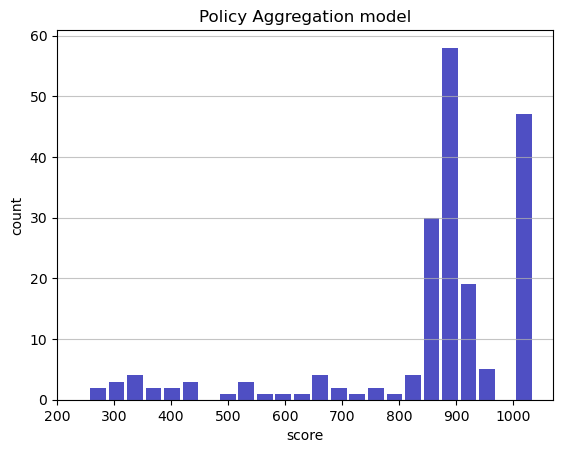

Track generation: 1152..1444 -> 292-tiles track
Epoch: 197
Policy Aggregation	mean: 855.07	variance: 181.54


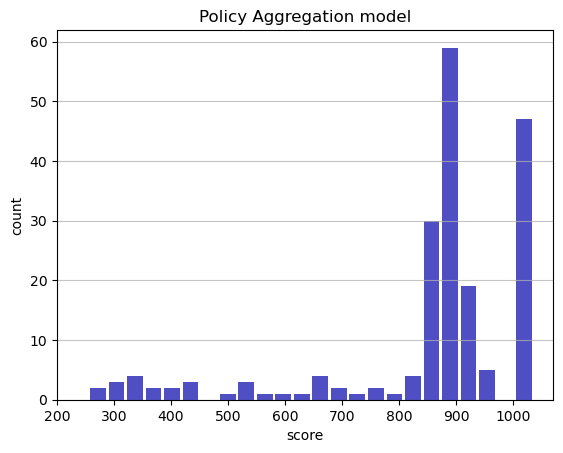

Track generation: 1264..1584 -> 320-tiles track
Epoch: 198
Policy Aggregation	mean: 852.02	variance: 186.08


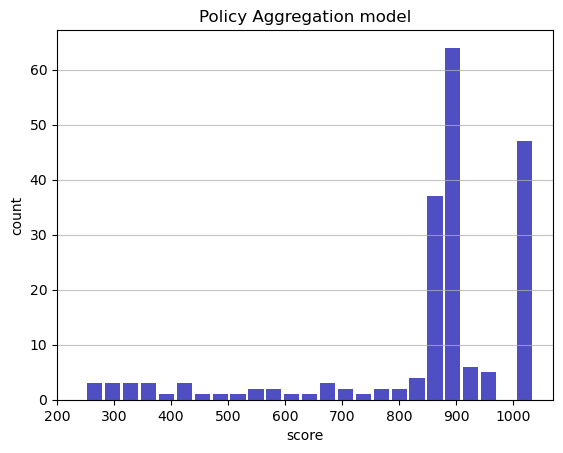

Track generation: 1316..1649 -> 333-tiles track
Epoch: 199
Policy Aggregation	mean: 852.15	variance: 185.62


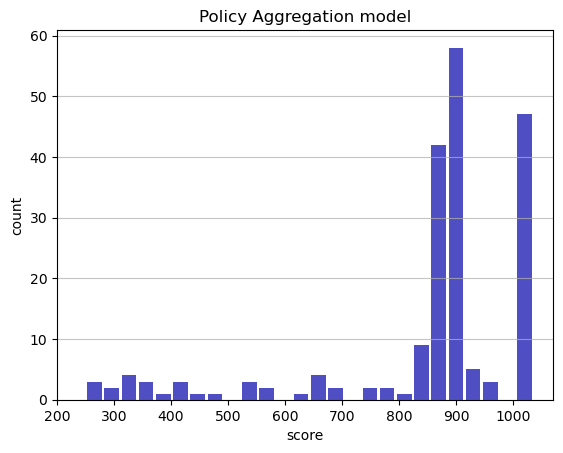

Track generation: 1078..1357 -> 279-tiles track
Epoch: 200
Policy Aggregation	mean: 853.01	variance: 185.55


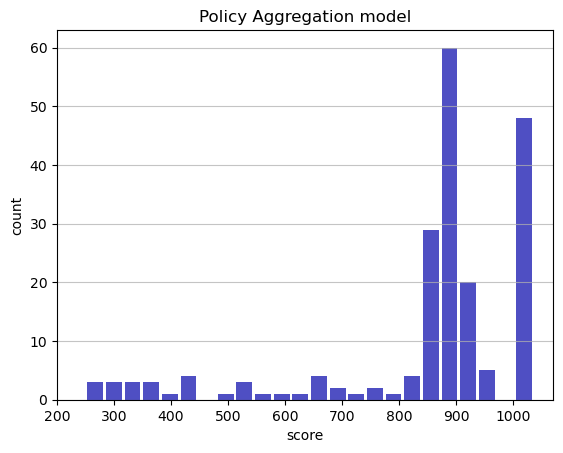

Track generation: 1036..1299 -> 263-tiles track
Epoch: 201
Policy Aggregation	mean: 853.25	variance: 185.12


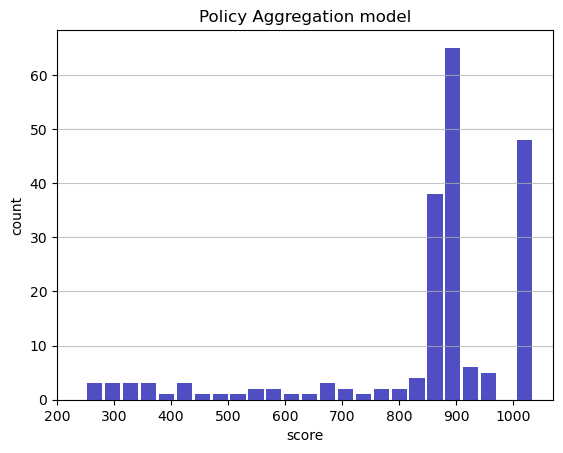

Track generation: 1167..1467 -> 300-tiles track
Epoch: 202
Policy Aggregation	mean: 854.08	variance: 185.04


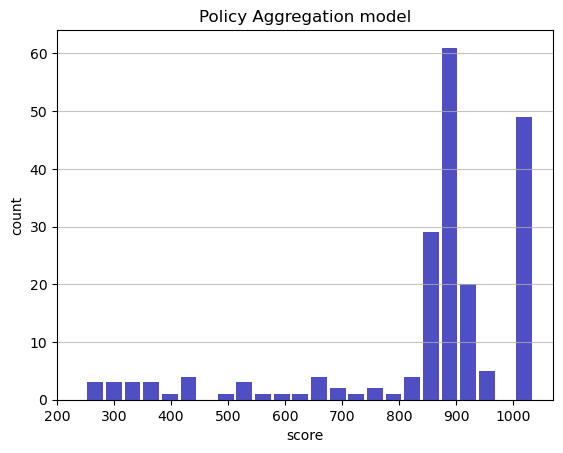

Track generation: 1180..1479 -> 299-tiles track
Epoch: 203
Policy Aggregation	mean: 851.23	variance: 188.97


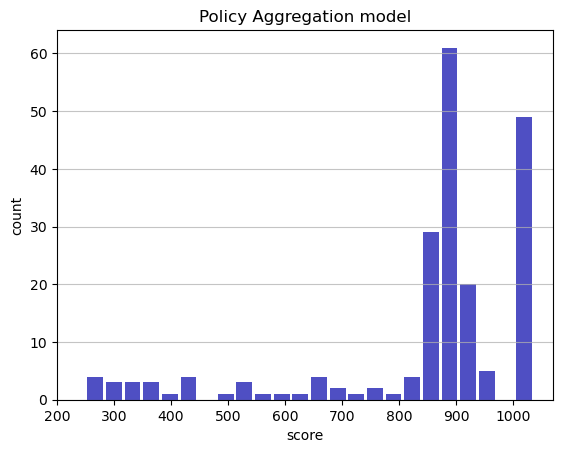

Track generation: 1193..1503 -> 310-tiles track
Epoch: 204
Policy Aggregation	mean: 851.49	variance: 188.54


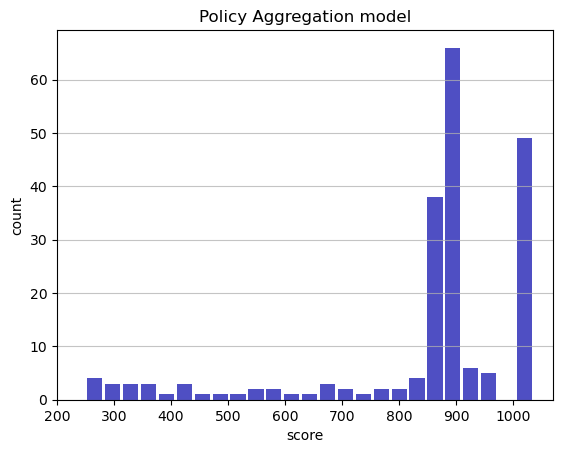

Track generation: 954..1200 -> 246-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1079..1353 -> 274-tiles track
Epoch: 205
Policy Aggregation	mean: 851.67	variance: 188.10


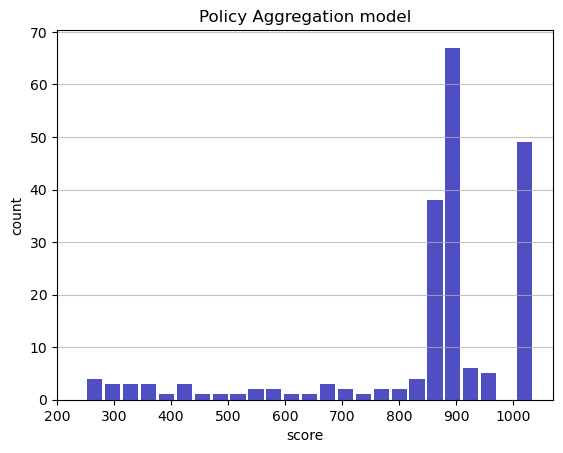

Track generation: 1293..1620 -> 327-tiles track
Epoch: 206
Policy Aggregation	mean: 852.46	variance: 187.98


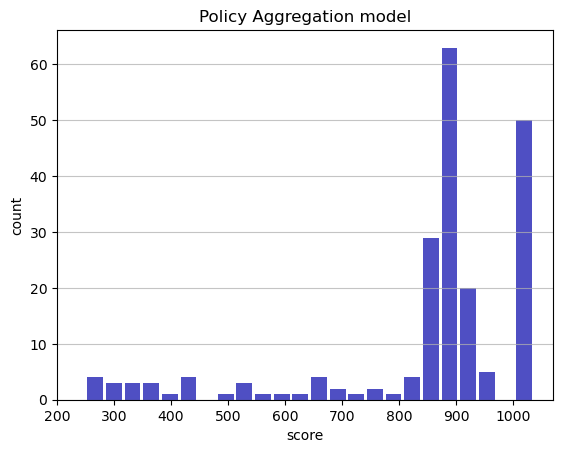

Track generation: 1036..1299 -> 263-tiles track
Epoch: 207
Policy Aggregation	mean: 853.31	variance: 187.92


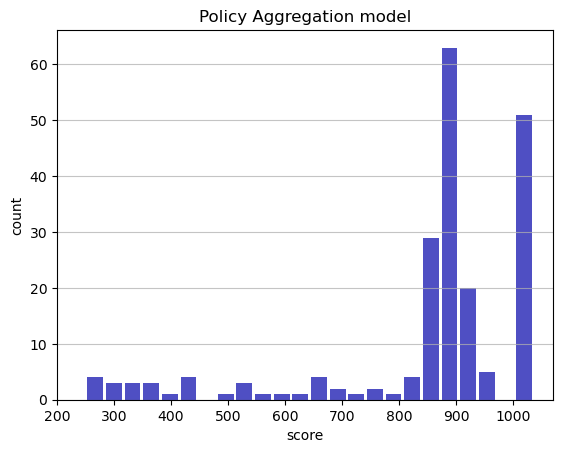

Track generation: 1139..1428 -> 289-tiles track
Epoch: 208
Policy Aggregation	mean: 853.34	variance: 187.47


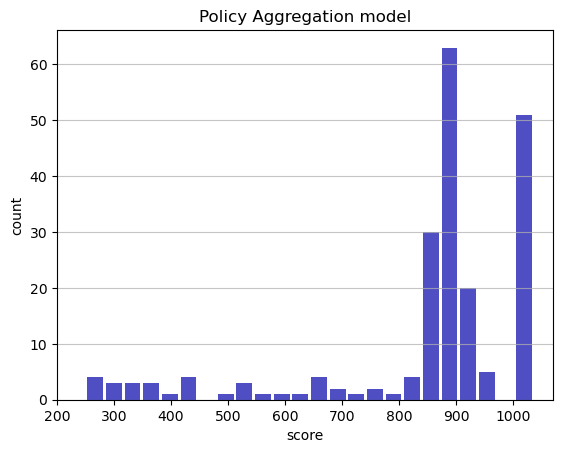

Track generation: 1051..1322 -> 271-tiles track
Epoch: 209
Policy Aggregation	mean: 851.32	variance: 189.27


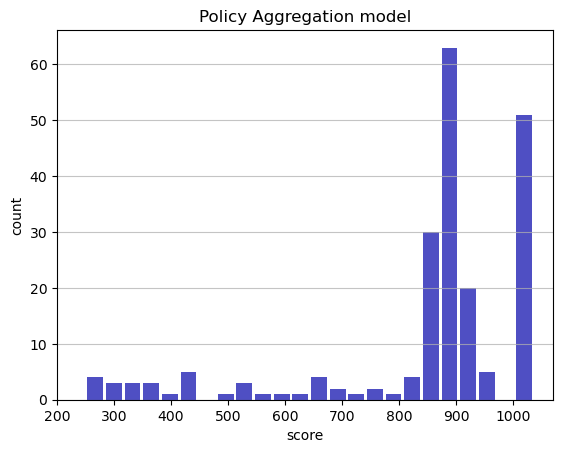

Track generation: 1182..1482 -> 300-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1331..1668 -> 337-tiles track
Epoch: 210
Policy Aggregation	mean: 851.43	variance: 188.83


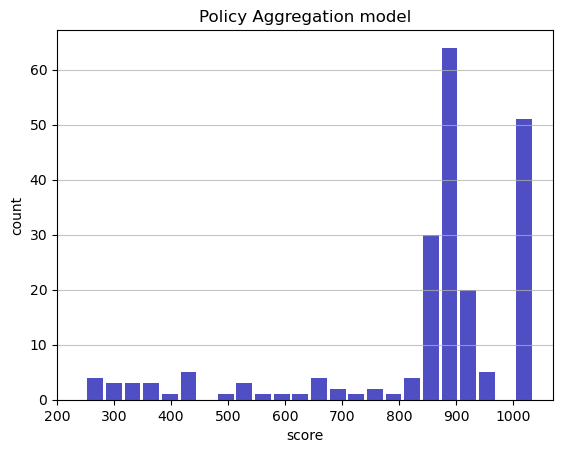

Track generation: 1187..1488 -> 301-tiles track
Epoch: 211
Policy Aggregation	mean: 852.24	variance: 188.75


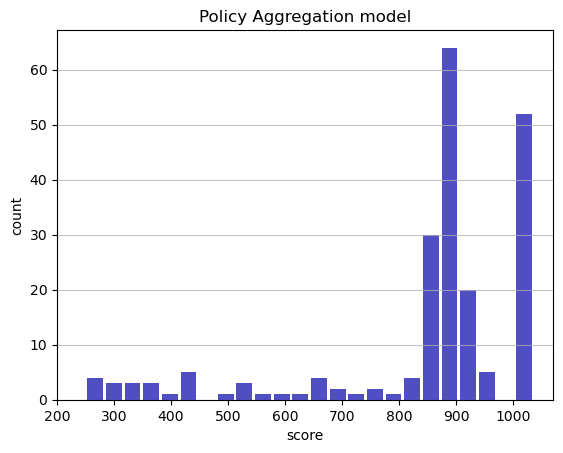

Track generation: 1053..1320 -> 267-tiles track
Epoch: 212
Policy Aggregation	mean: 852.43	variance: 188.32


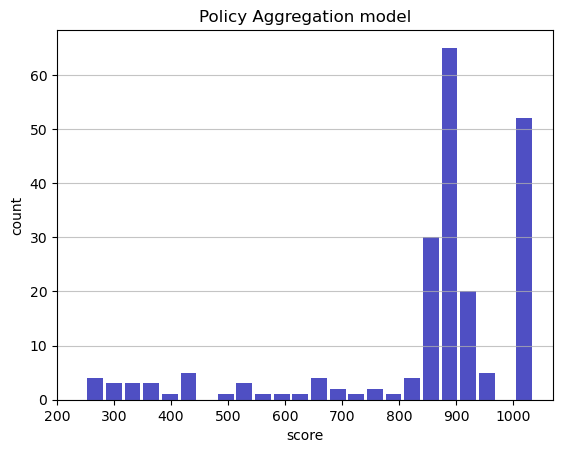

Track generation: 1049..1319 -> 270-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1208..1514 -> 306-tiles track
Epoch: 213
Policy Aggregation	mean: 853.20	variance: 188.21


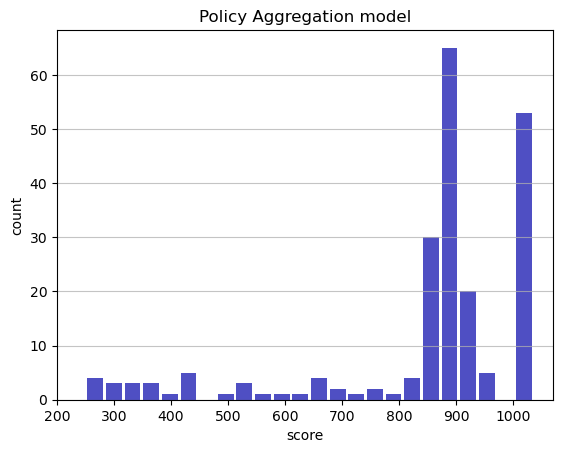

Track generation: 1172..1469 -> 297-tiles track
Epoch: 214
Policy Aggregation	mean: 853.92	variance: 188.07


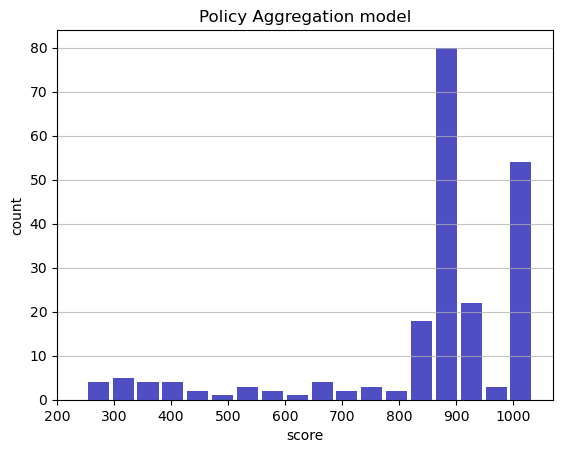

Track generation: 1114..1397 -> 283-tiles track
Epoch: 215
Policy Aggregation	mean: 854.12	variance: 187.65


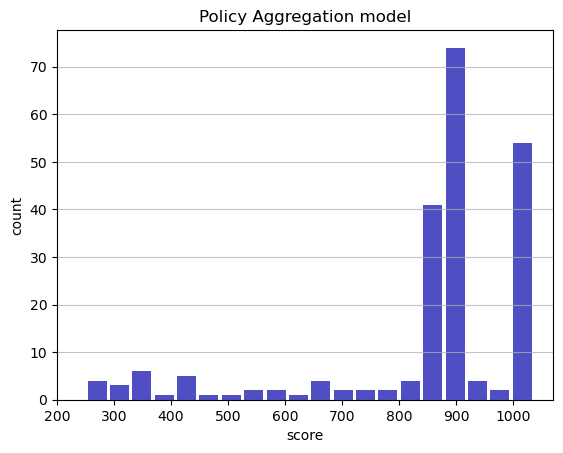

Track generation: 1346..1694 -> 348-tiles track
Epoch: 216
Policy Aggregation	mean: 852.07	variance: 189.61


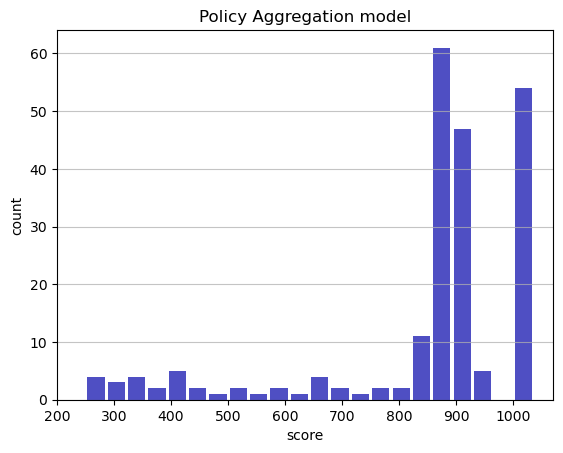

Track generation: 1096..1374 -> 278-tiles track
Epoch: 217
Policy Aggregation	mean: 852.18	variance: 189.18


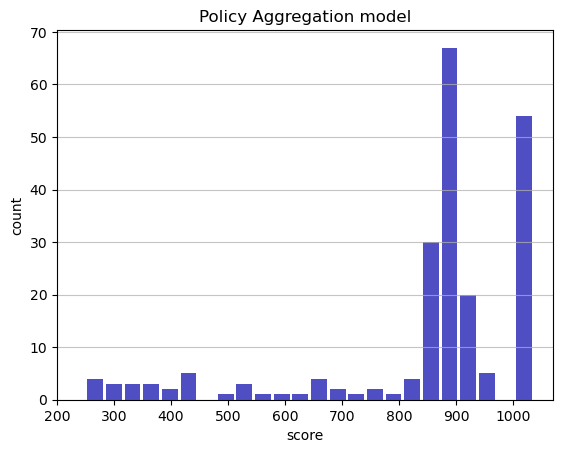

Track generation: 1263..1583 -> 320-tiles track
Epoch: 218
Policy Aggregation	mean: 852.95	variance: 189.08


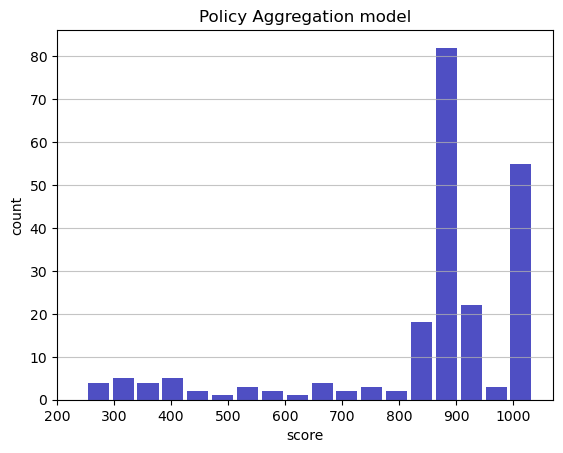

Track generation: 1380..1729 -> 349-tiles track
Epoch: 219
Policy Aggregation	mean: 853.43	variance: 188.79


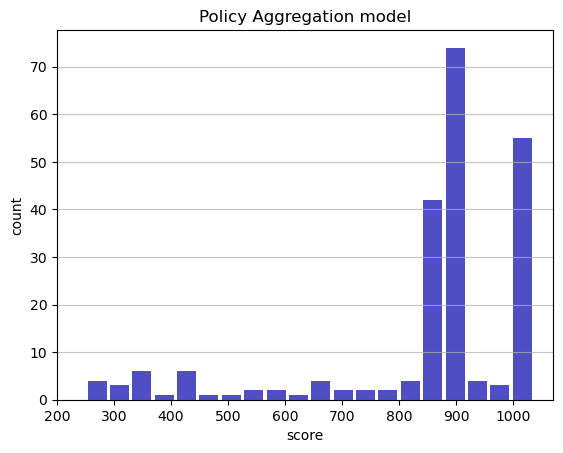

Track generation: 1131..1418 -> 287-tiles track
Epoch: 220
Policy Aggregation	mean: 853.64	variance: 188.38


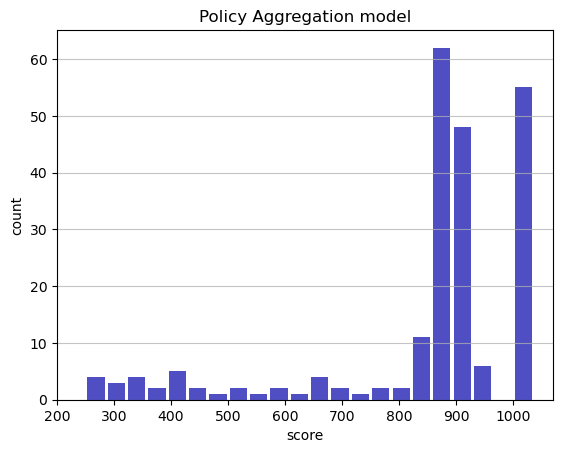

Track generation: 1140..1429 -> 289-tiles track
Epoch: 221
Policy Aggregation	mean: 851.51	variance: 190.60


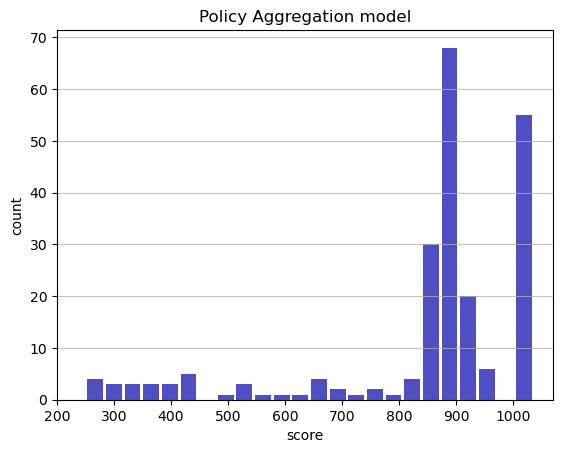

Track generation: 971..1219 -> 248-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1068..1339 -> 271-tiles track
Epoch: 222
Policy Aggregation	mean: 851.71	variance: 190.19


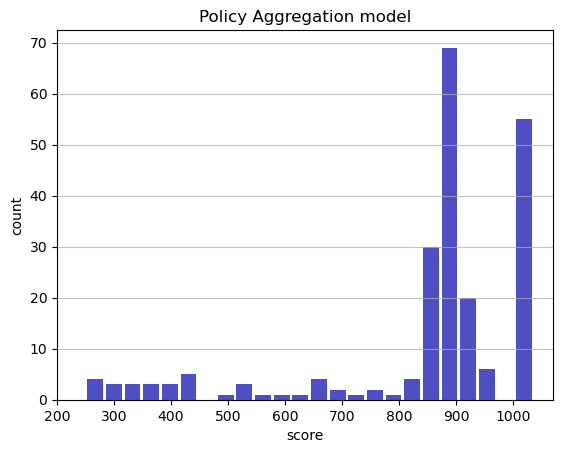

Track generation: 1144..1434 -> 290-tiles track
Epoch: 223
Policy Aggregation	mean: 852.00	variance: 189.81


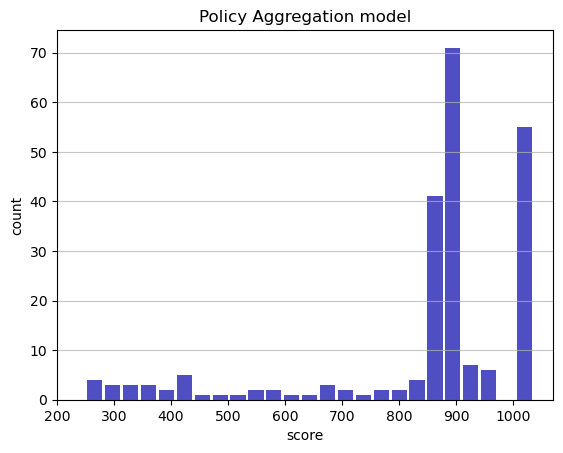

Track generation: 1143..1433 -> 290-tiles track
Epoch: 224
Policy Aggregation	mean: 852.13	variance: 189.40


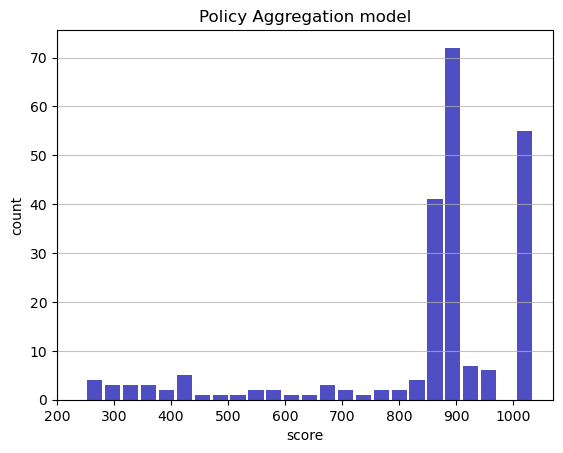

Track generation: 1096..1384 -> 288-tiles track
Epoch: 225
Policy Aggregation	mean: 852.91	variance: 189.33


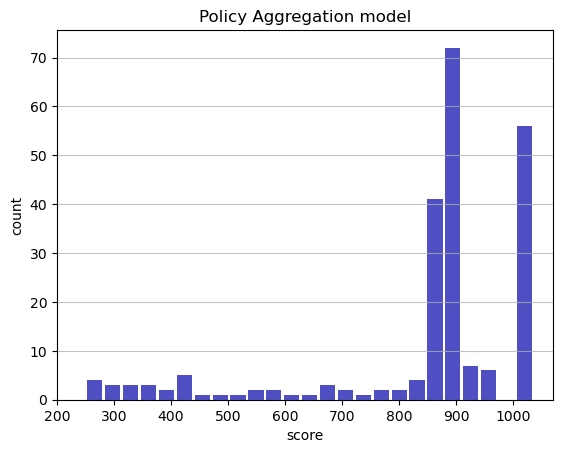

Track generation: 1013..1279 -> 266-tiles track
Epoch: 226
Policy Aggregation	mean: 853.09	variance: 188.93


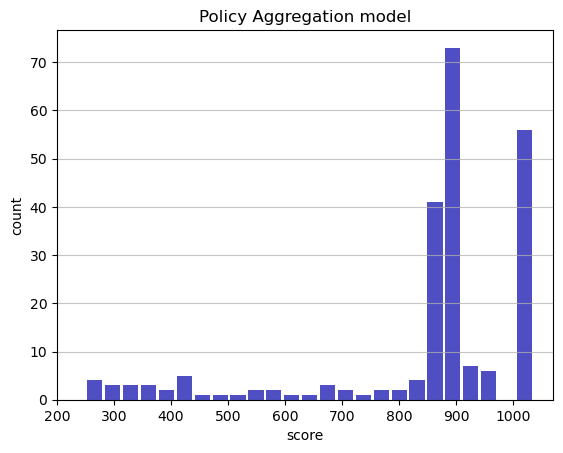

Track generation: 1015..1273 -> 258-tiles track
Epoch: 227
Policy Aggregation	mean: 853.29	variance: 188.54


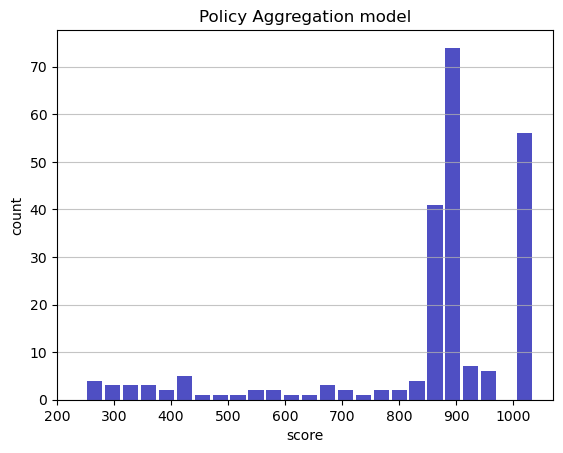

Track generation: 1091..1368 -> 277-tiles track
Epoch: 228
Policy Aggregation	mean: 853.47	variance: 188.15


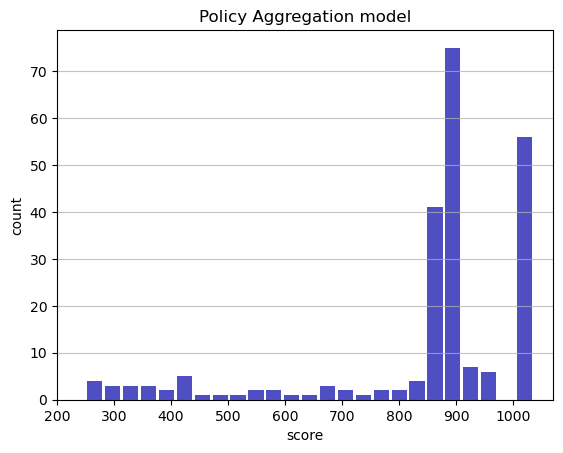

Track generation: 1197..1500 -> 303-tiles track
Epoch: 229
Policy Aggregation	mean: 854.21	variance: 188.06


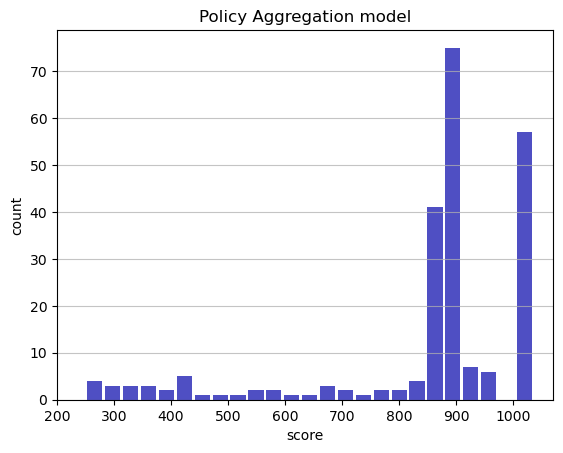

Track generation: 1119..1403 -> 284-tiles track
Epoch: 230
Policy Aggregation	mean: 854.33	variance: 187.66


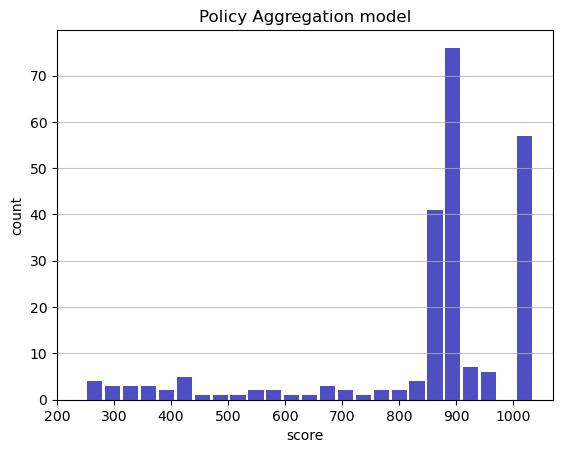

Track generation: 1051..1318 -> 267-tiles track
Epoch: 231
Policy Aggregation	mean: 854.44	variance: 187.26


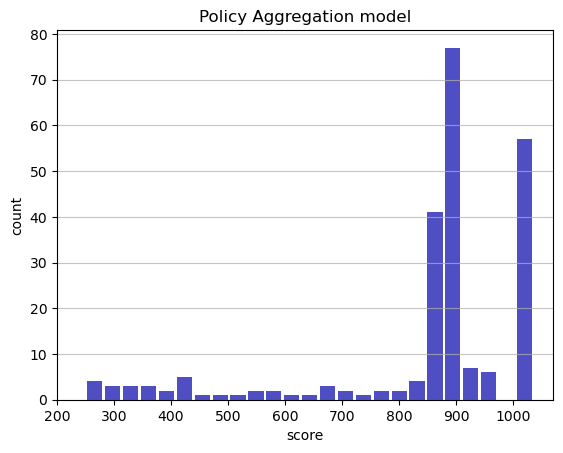

Track generation: 1116..1399 -> 283-tiles track
Epoch: 232
Policy Aggregation	mean: 854.52	variance: 186.86


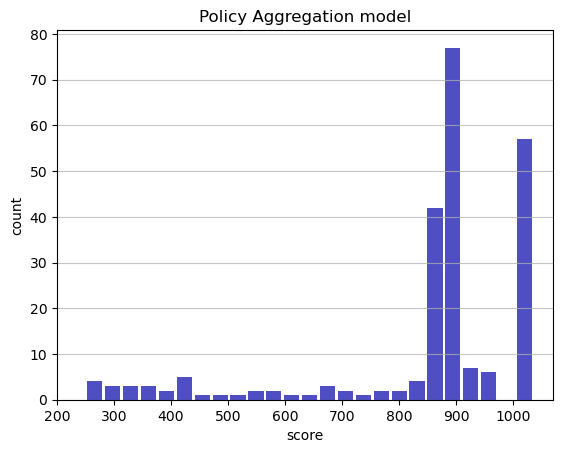

Track generation: 1159..1453 -> 294-tiles track
Epoch: 233
Policy Aggregation	mean: 854.59	variance: 186.46


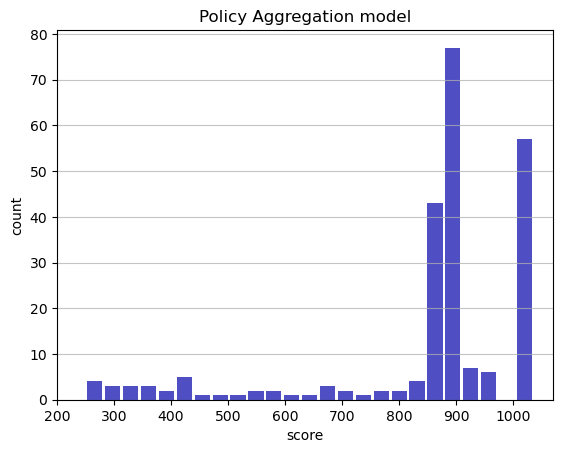

Track generation: 1009..1273 -> 264-tiles track
Epoch: 234
Policy Aggregation	mean: 855.34	variance: 186.42


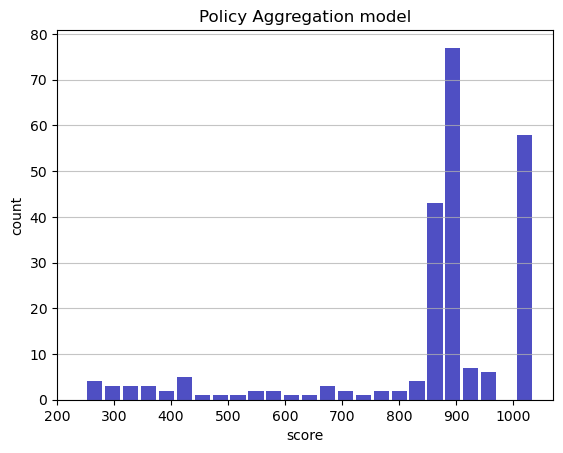

Track generation: 1259..1578 -> 319-tiles track
Epoch: 235
Policy Aggregation	mean: 855.41	variance: 186.02


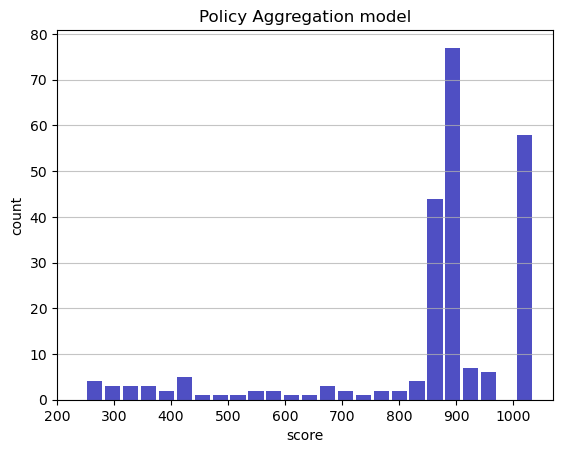

Track generation: 1278..1602 -> 324-tiles track
Epoch: 236
Policy Aggregation	mean: 855.51	variance: 185.64


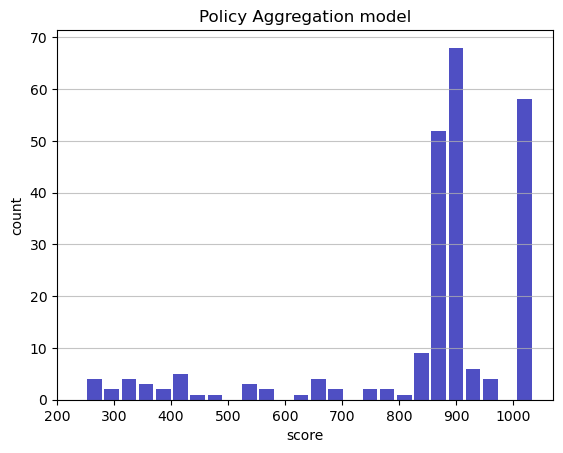

Track generation: 1059..1328 -> 269-tiles track
Epoch: 237
Policy Aggregation	mean: 853.73	variance: 187.26


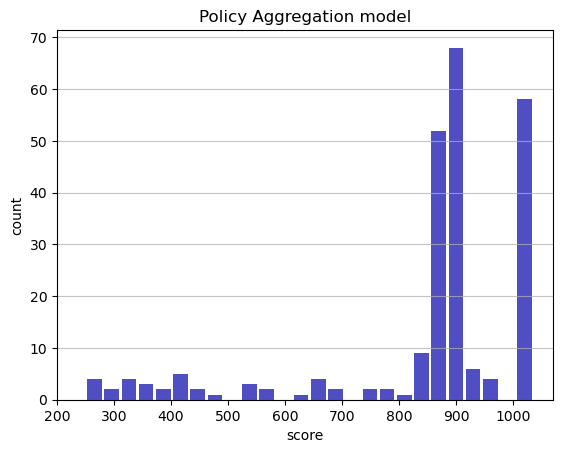

Track generation: 1139..1428 -> 289-tiles track
Epoch: 238
Policy Aggregation	mean: 853.75	variance: 186.86


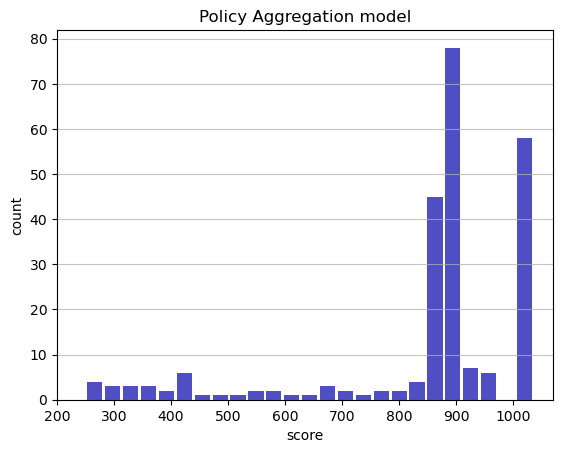

Track generation: 1063..1333 -> 270-tiles track
Epoch: 239
Policy Aggregation	mean: 853.77	variance: 186.47


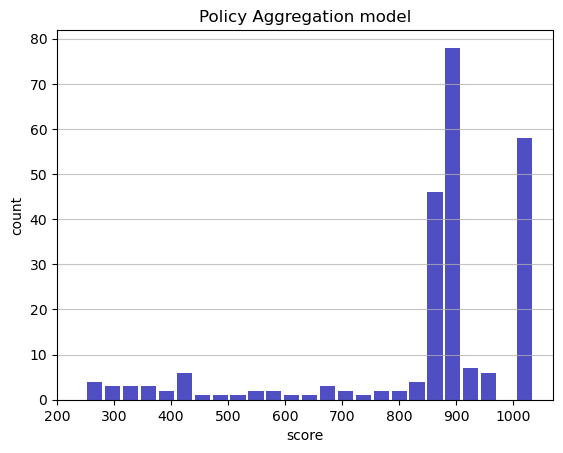

Track generation: 1206..1521 -> 315-tiles track
Epoch: 240
Policy Aggregation	mean: 853.47	variance: 186.14


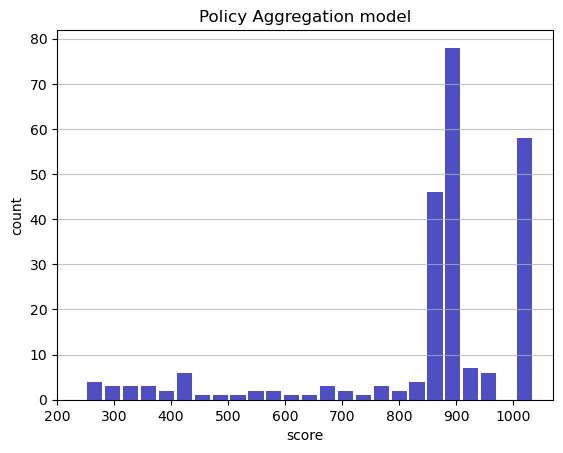

Track generation: 1023..1283 -> 260-tiles track
Epoch: 241
Policy Aggregation	mean: 852.28	variance: 186.67


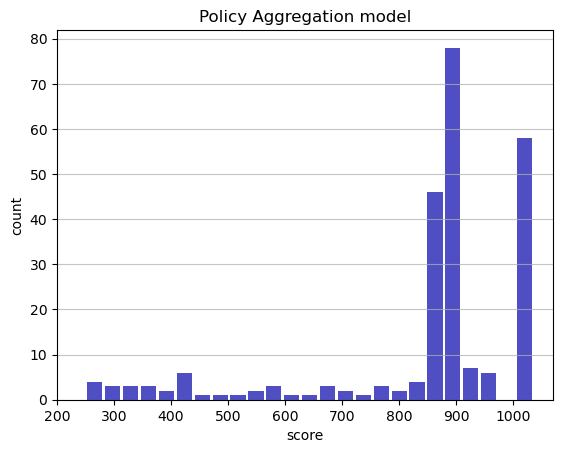

Track generation: 1081..1355 -> 274-tiles track
Epoch: 242
Policy Aggregation	mean: 852.36	variance: 186.28


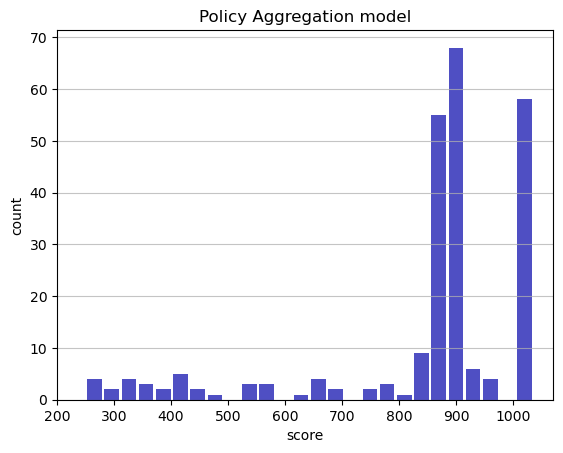

Track generation: 1074..1345 -> 271-tiles track
Epoch: 243
Policy Aggregation	mean: 852.44	variance: 185.90


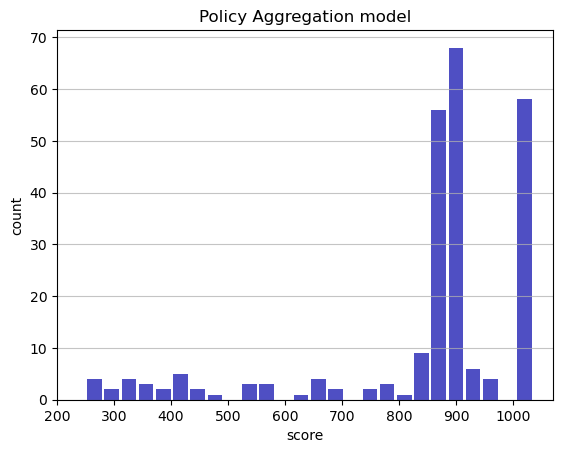

Track generation: 1095..1373 -> 278-tiles track
Epoch: 244
Policy Aggregation	mean: 851.30	variance: 186.38


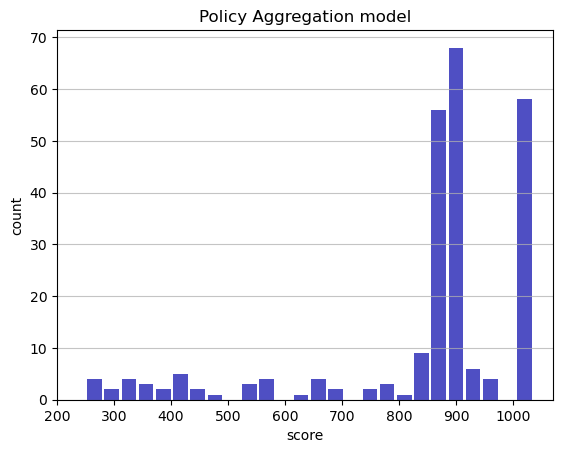

Track generation: 1152..1451 -> 299-tiles track
Epoch: 245
Policy Aggregation	mean: 851.49	variance: 186.02


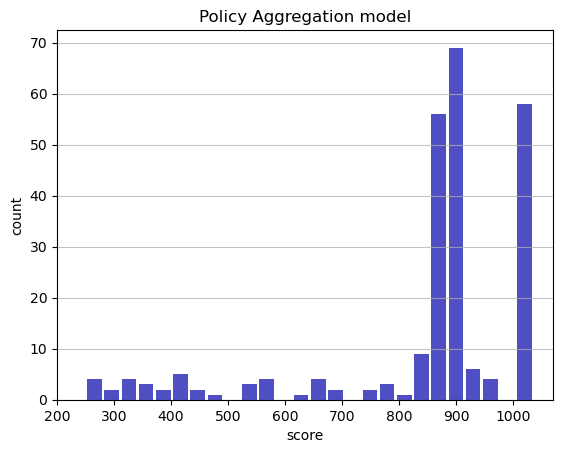

Track generation: 1209..1518 -> 309-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1054..1327 -> 273-tiles track
Epoch: 246
Policy Aggregation	mean: 852.21	variance: 185.98


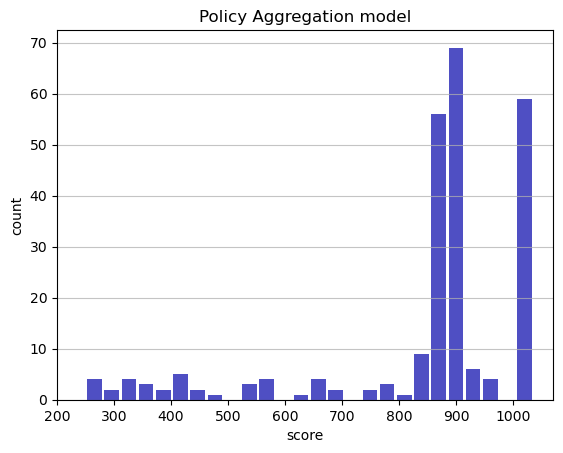

Track generation: 1115..1398 -> 283-tiles track
Epoch: 247
Policy Aggregation	mean: 852.07	variance: 185.62


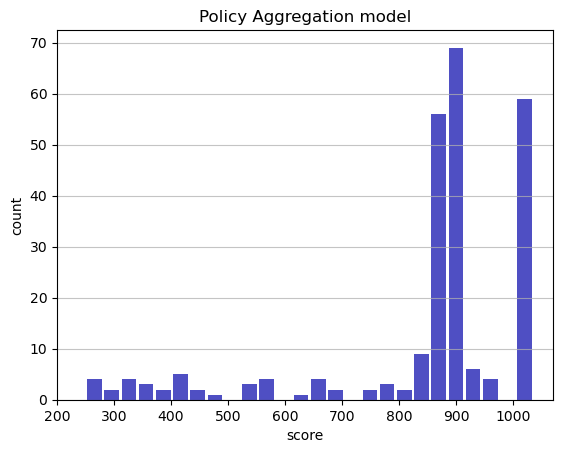

Track generation: 1059..1328 -> 269-tiles track
Epoch: 248
Policy Aggregation	mean: 852.80	variance: 185.59


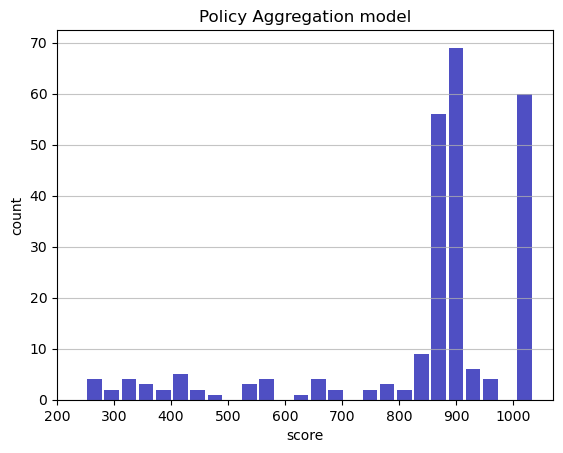

Track generation: 1022..1289 -> 267-tiles track
Epoch: 249
Policy Aggregation	mean: 852.90	variance: 185.22


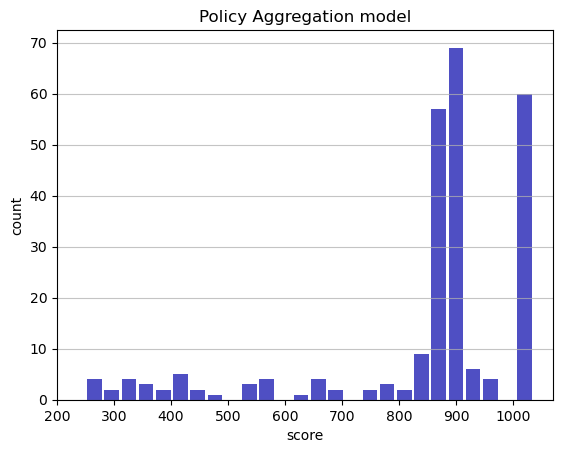

Track generation: 1390..1742 -> 352-tiles track
Epoch: 250
Policy Aggregation	mean: 853.26	variance: 184.94


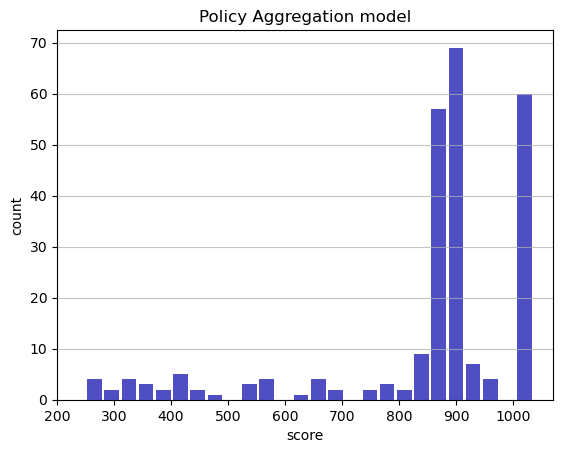

Track generation: 1196..1499 -> 303-tiles track
Epoch: 251
Policy Aggregation	mean: 851.05	variance: 187.84


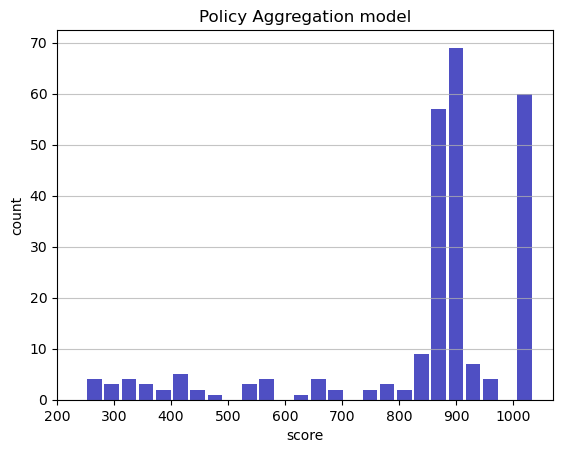

Track generation: 1379..1728 -> 349-tiles track
Epoch: 252
Policy Aggregation	mean: 849.49	variance: 189.10


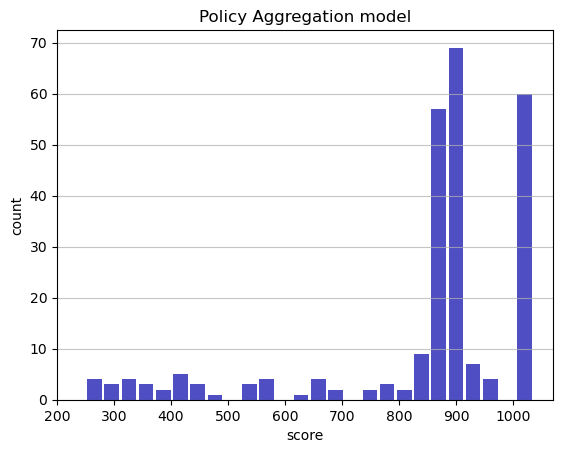

Track generation: 943..1183 -> 240-tiles track
Epoch: 253
Policy Aggregation	mean: 850.24	variance: 189.11


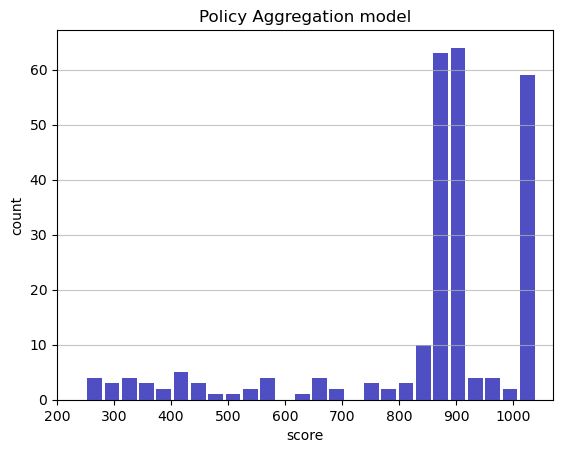

Track generation: 1057..1325 -> 268-tiles track
Epoch: 254
Policy Aggregation	mean: 850.37	variance: 188.75


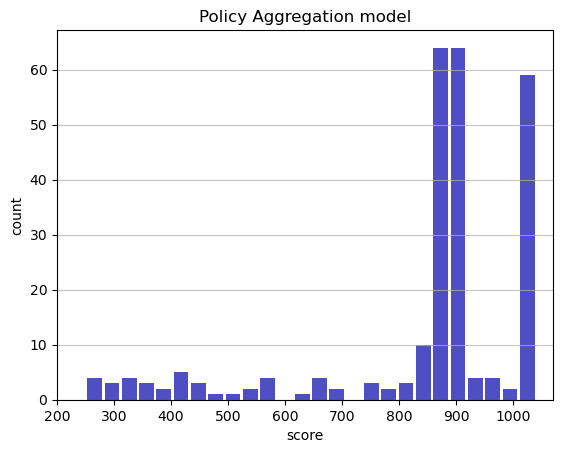

Track generation: 1196..1499 -> 303-tiles track
Epoch: 255
Policy Aggregation	mean: 850.50	variance: 188.39


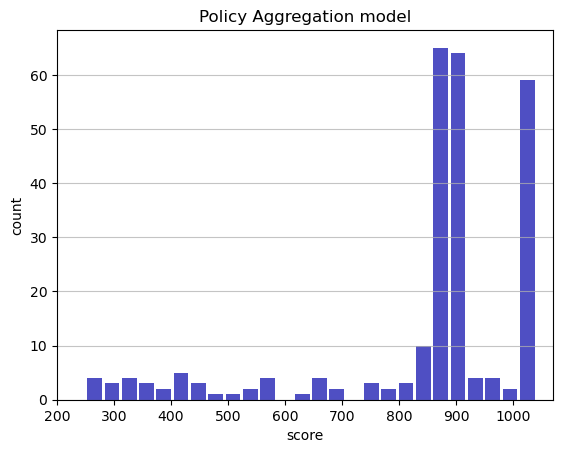

Track generation: 1079..1353 -> 274-tiles track
Epoch: 256
Policy Aggregation	mean: 850.68	variance: 188.04


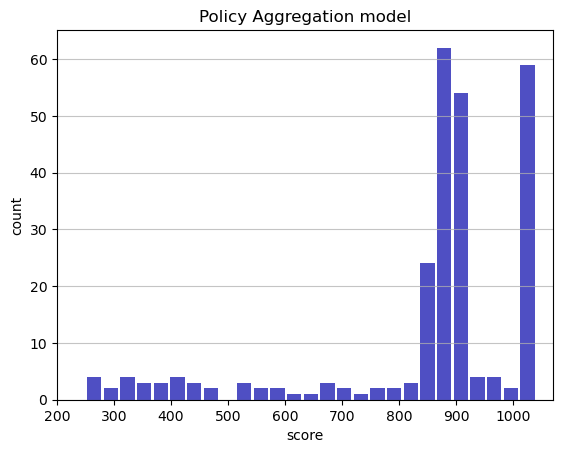

Track generation: 1140..1434 -> 294-tiles track
Epoch: 257
Policy Aggregation	mean: 851.35	variance: 187.98


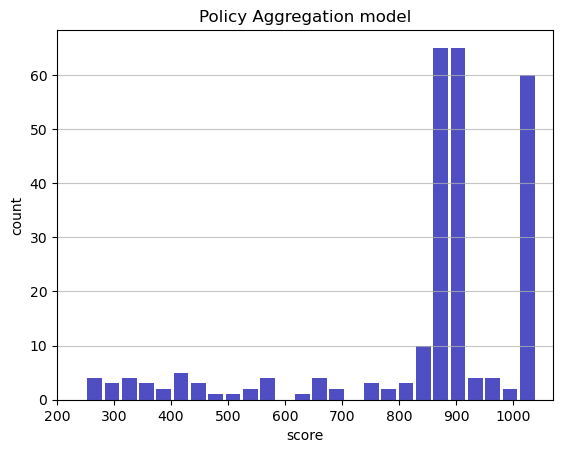

Track generation: 1092..1370 -> 278-tiles track
Epoch: 258
Policy Aggregation	mean: 851.53	variance: 187.64


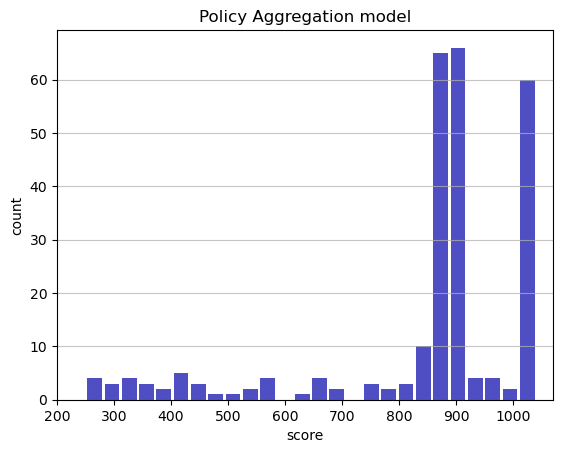

Track generation: 1087..1369 -> 282-tiles track
Epoch: 259
Policy Aggregation	mean: 849.39	variance: 190.40


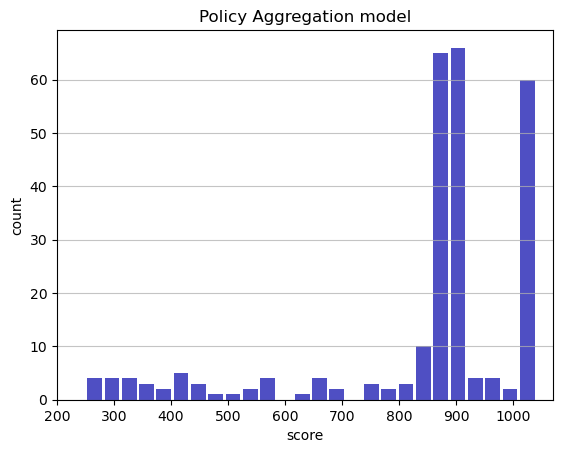

Track generation: 998..1256 -> 258-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1115..1402 -> 287-tiles track
Epoch: 260
Policy Aggregation	mean: 850.08	variance: 190.36


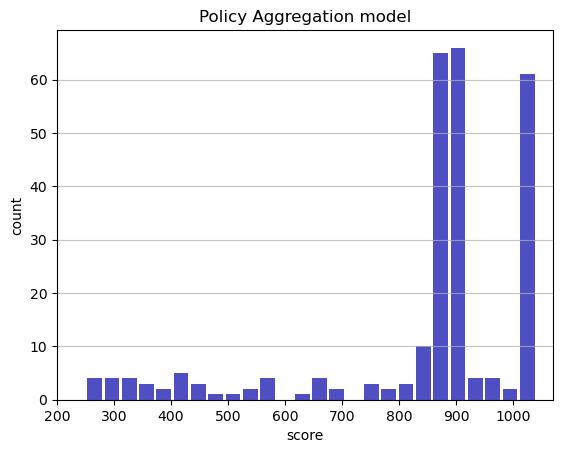

Track generation: 1119..1403 -> 284-tiles track
Epoch: 261
Policy Aggregation	mean: 850.20	variance: 190.01


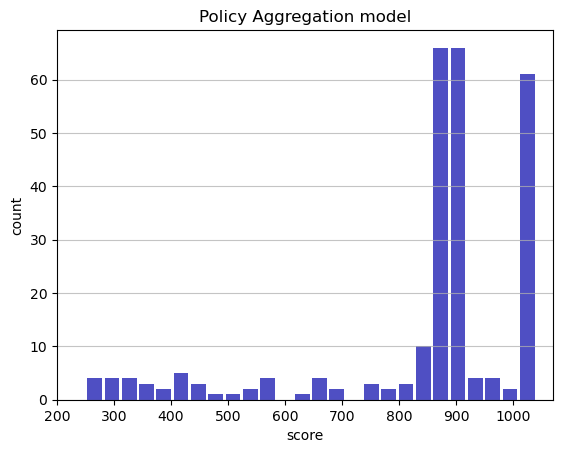

Track generation: 1264..1584 -> 320-tiles track
Epoch: 262
Policy Aggregation	mean: 850.29	variance: 189.65


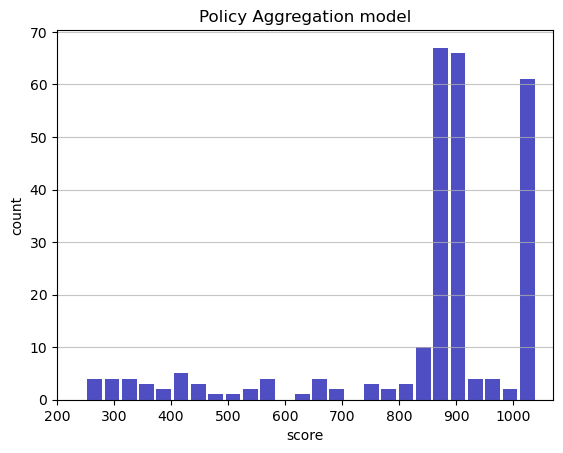

Track generation: 1259..1578 -> 319-tiles track
Epoch: 263
Policy Aggregation	mean: 850.40	variance: 189.30


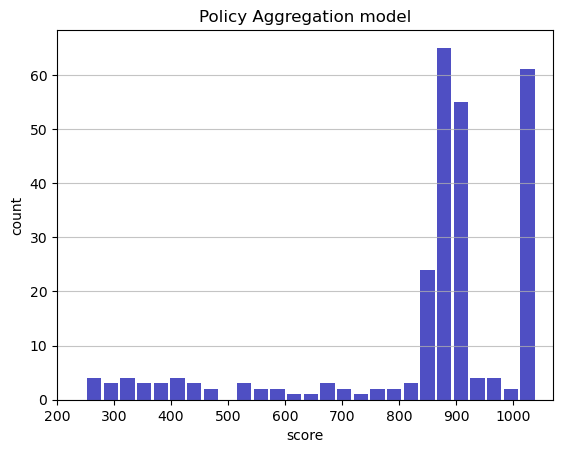

Track generation: 1043..1308 -> 265-tiles track
Epoch: 264
Policy Aggregation	mean: 850.63	variance: 188.97


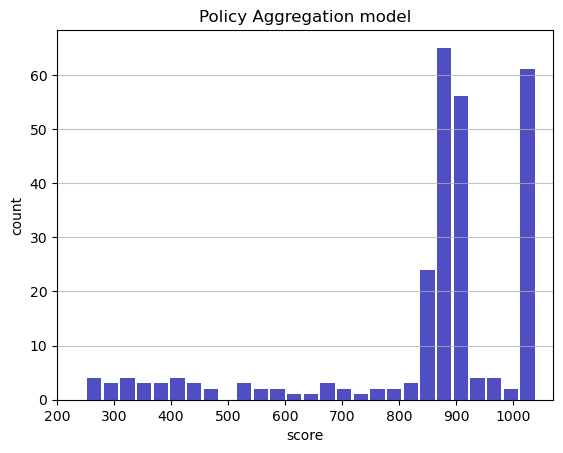

Track generation: 1176..1474 -> 298-tiles track
Epoch: 265
Policy Aggregation	mean: 851.29	variance: 188.92


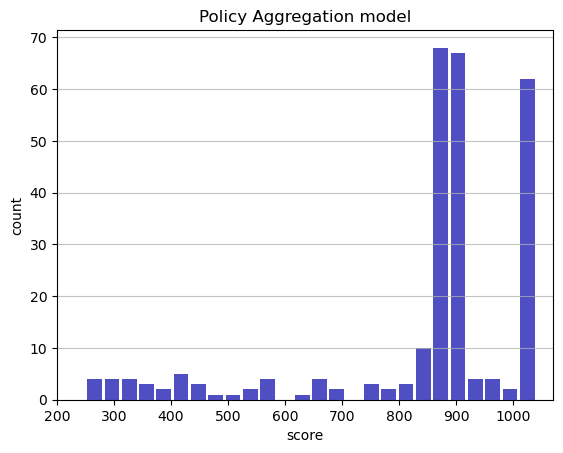

Track generation: 1080..1362 -> 282-tiles track
Epoch: 266
Policy Aggregation	mean: 851.50	variance: 188.60


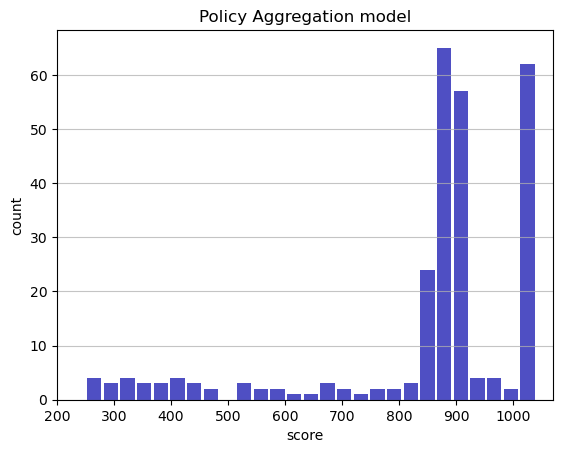

Track generation: 1137..1425 -> 288-tiles track
Epoch: 267
Policy Aggregation	mean: 852.16	variance: 188.55


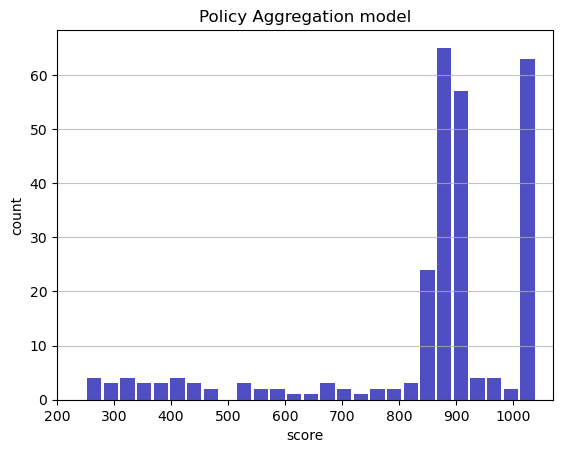

Track generation: 1200..1511 -> 311-tiles track
Epoch: 268
Policy Aggregation	mean: 852.78	variance: 188.47


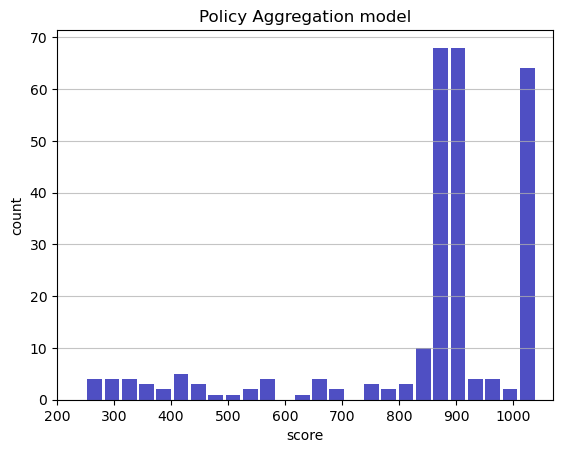

Track generation: 1020..1285 -> 265-tiles track
Epoch: 269
Policy Aggregation	mean: 853.01	variance: 188.16


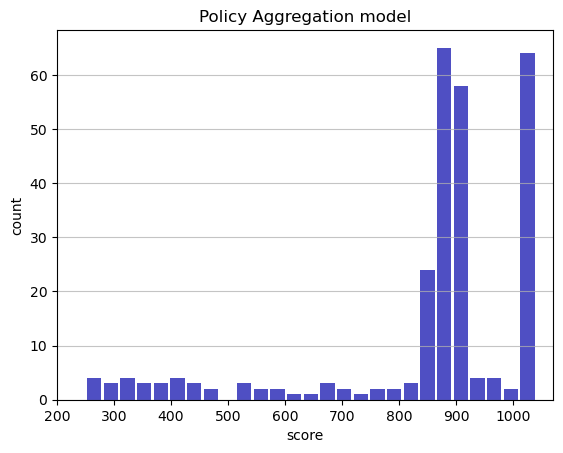

Track generation: 1168..1472 -> 304-tiles track
Epoch: 270
Policy Aggregation	mean: 853.10	variance: 187.81


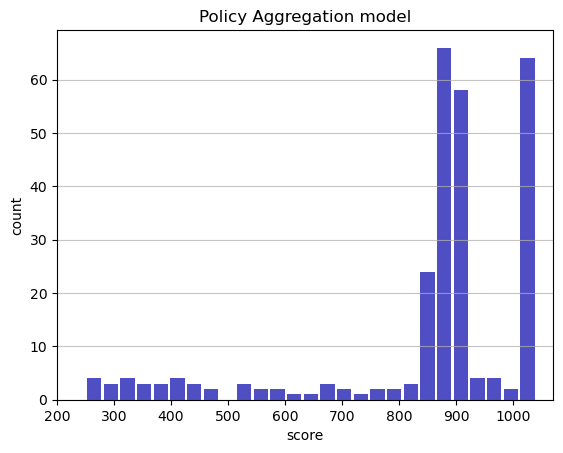

Track generation: 1252..1569 -> 317-tiles track
Epoch: 271
Policy Aggregation	mean: 853.62	variance: 187.66


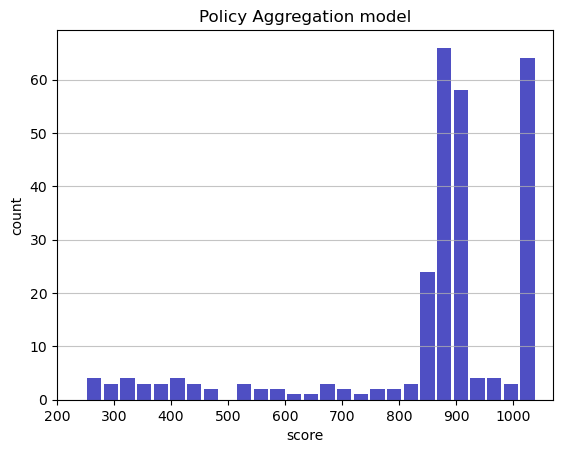

Track generation: 1241..1555 -> 314-tiles track
Epoch: 272
Policy Aggregation	mean: 853.72	variance: 187.32


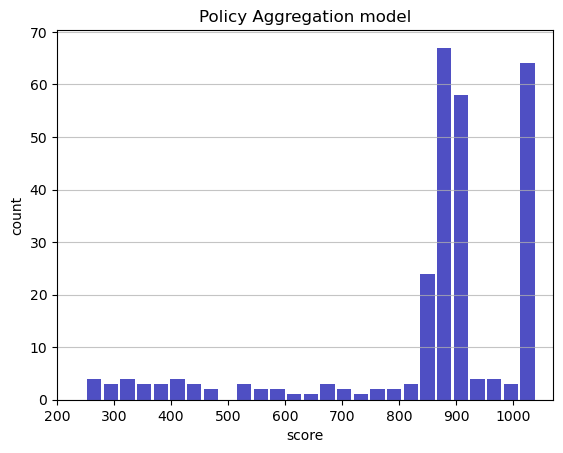

Track generation: 1084..1362 -> 278-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1157..1450 -> 293-tiles track
Epoch: 273
Policy Aggregation	mean: 854.32	variance: 187.25


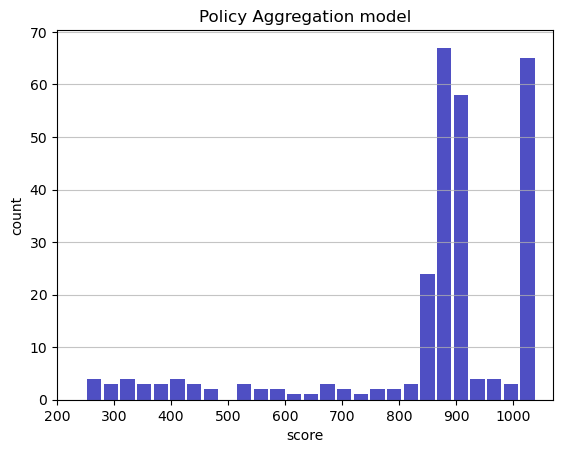

Track generation: 1132..1419 -> 287-tiles track
Epoch: 274
Policy Aggregation	mean: 854.33	variance: 186.90


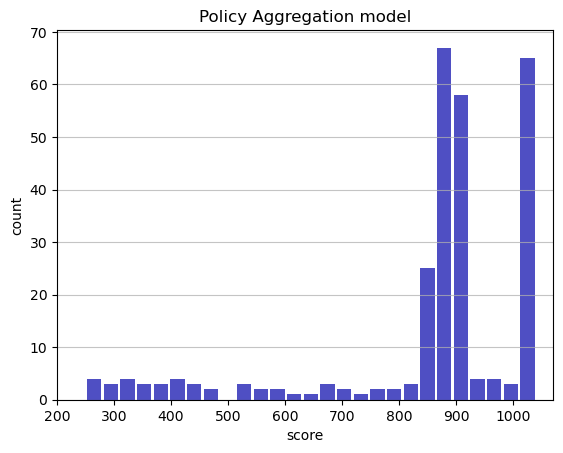

Track generation: 1074..1350 -> 276-tiles track
Epoch: 275
Policy Aggregation	mean: 853.70	variance: 186.86


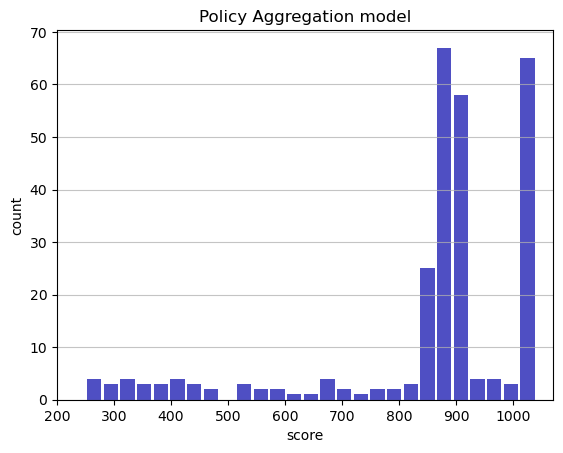

Track generation: 1082..1359 -> 277-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1292..1619 -> 327-tiles track
Epoch: 276
Policy Aggregation	mean: 853.85	variance: 186.53


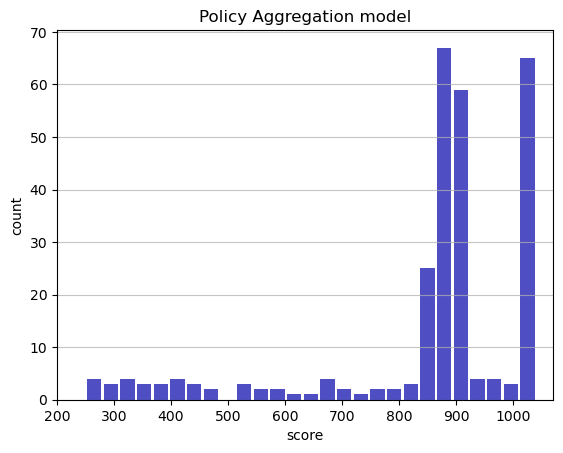

Track generation: 1080..1355 -> 275-tiles track
Epoch: 277
Policy Aggregation	mean: 853.95	variance: 186.20


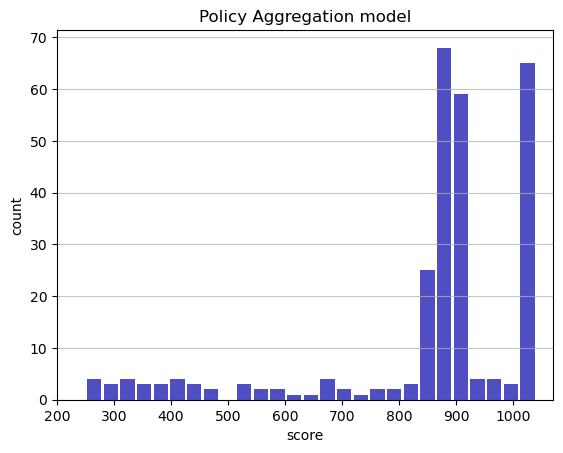

Track generation: 1277..1600 -> 323-tiles track
Epoch: 278
Policy Aggregation	mean: 852.55	variance: 187.33


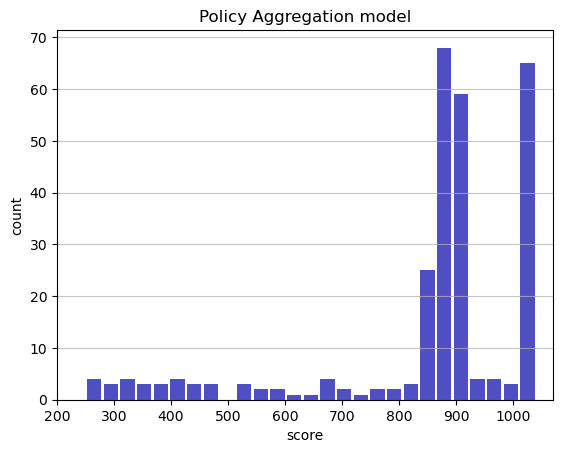

Track generation: 1241..1556 -> 315-tiles track
Epoch: 279
Policy Aggregation	mean: 852.59	variance: 187.00


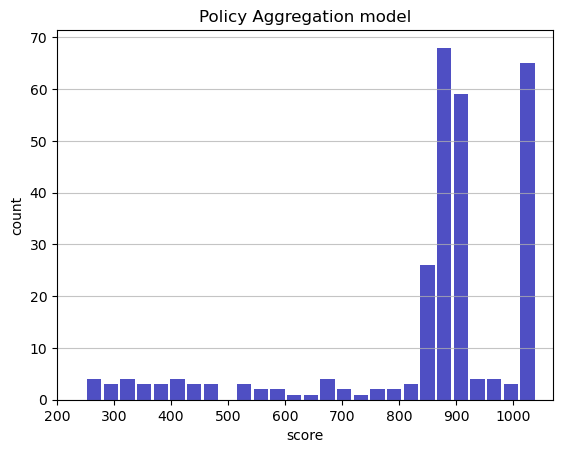

Track generation: 1113..1364 -> 251-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1032..1294 -> 262-tiles track
Epoch: 280
Policy Aggregation	mean: 852.73	variance: 186.68


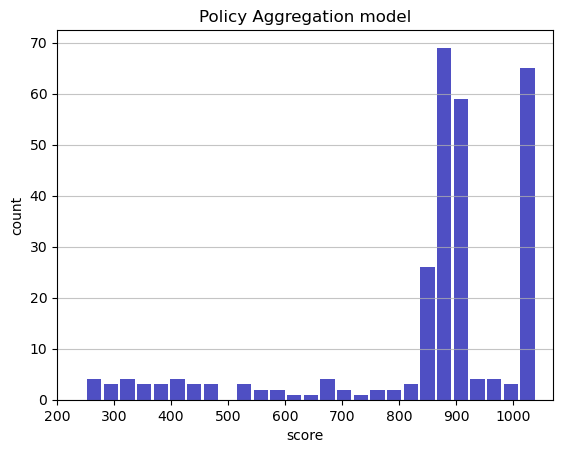

Track generation: 1135..1423 -> 288-tiles track
Epoch: 281
Policy Aggregation	mean: 851.04	variance: 188.47


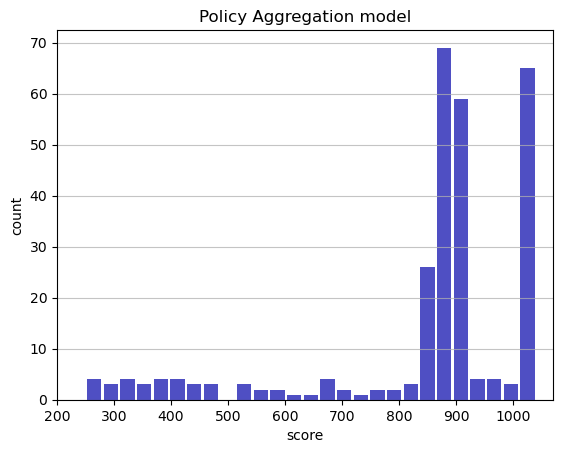

Track generation: 1147..1438 -> 291-tiles track
Epoch: 282
Policy Aggregation	mean: 851.07	variance: 188.13


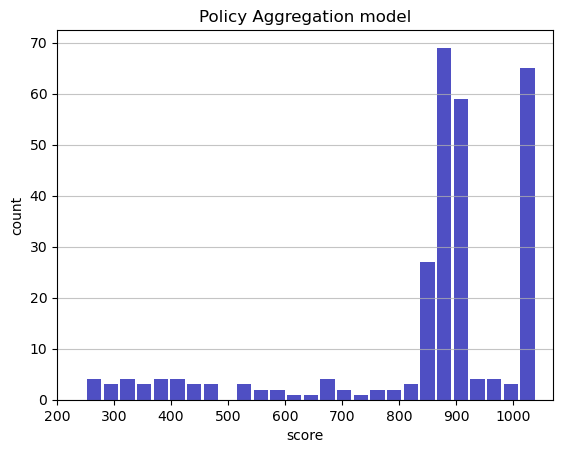

Track generation: 1147..1438 -> 291-tiles track
Epoch: 283
Policy Aggregation	mean: 851.09	variance: 187.80


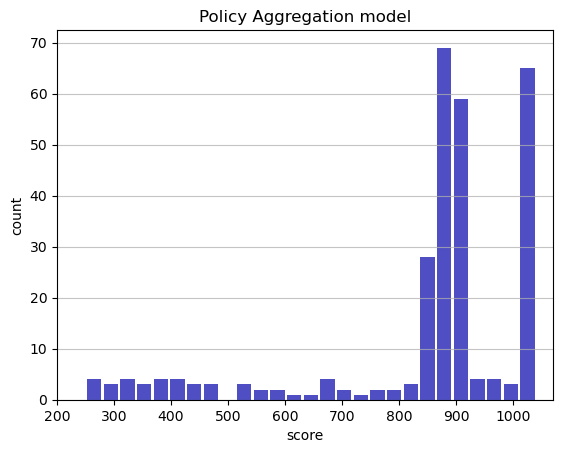

Track generation: 1091..1370 -> 279-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 997..1257 -> 260-tiles track
Epoch: 284
Policy Aggregation	mean: 851.23	variance: 187.49


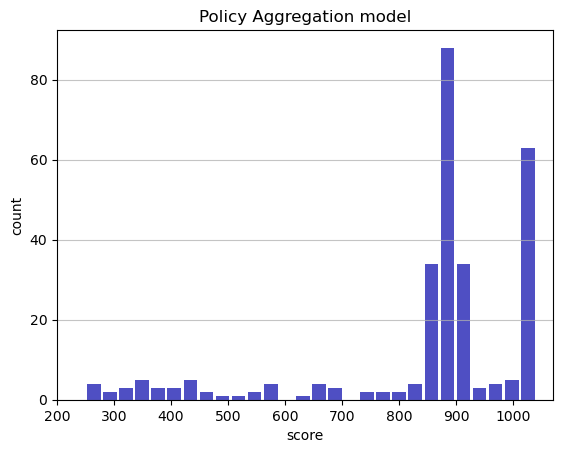

Track generation: 1136..1424 -> 288-tiles track
Epoch: 285
Policy Aggregation	mean: 851.84	variance: 187.44


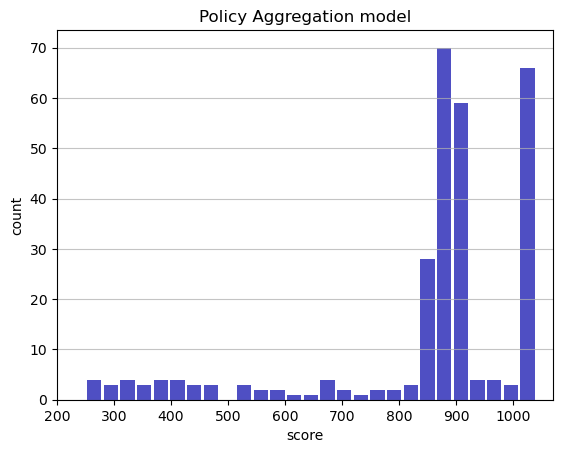

Track generation: 1491..1868 -> 377-tiles track
Epoch: 286
Policy Aggregation	mean: 851.79	variance: 187.11


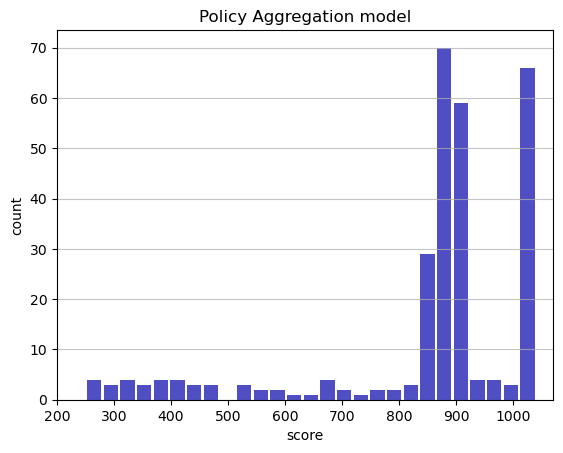

Track generation: 1152..1444 -> 292-tiles track
Epoch: 287
Policy Aggregation	mean: 851.88	variance: 186.79


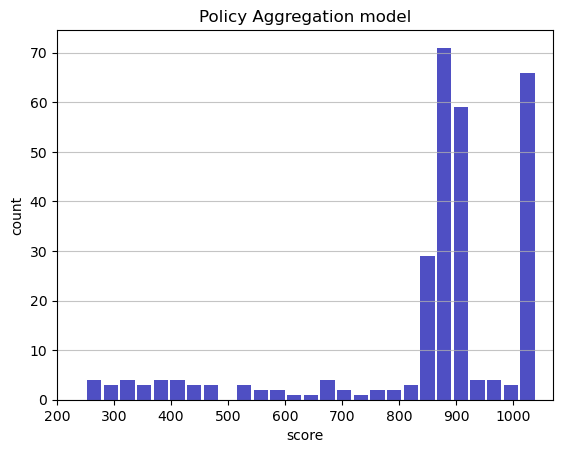

Track generation: 1305..1635 -> 330-tiles track
Epoch: 288
Policy Aggregation	mean: 850.35	variance: 188.24


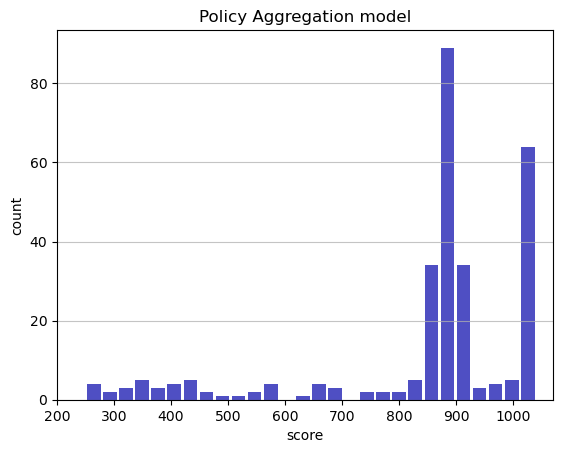

Track generation: 1139..1428 -> 289-tiles track
Epoch: 289
Policy Aggregation	mean: 850.51	variance: 187.94


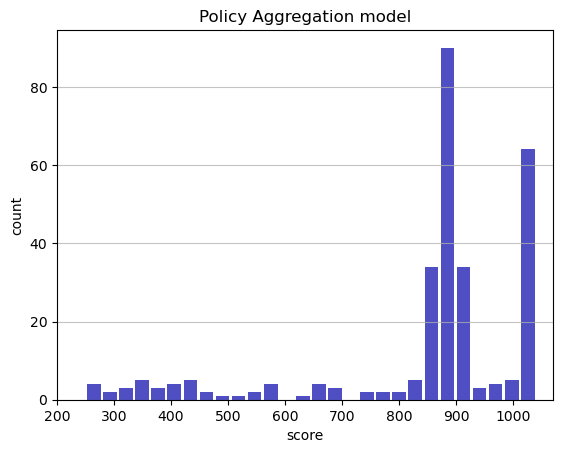

Track generation: 1047..1313 -> 266-tiles track
Epoch: 290
Policy Aggregation	mean: 850.60	variance: 187.62


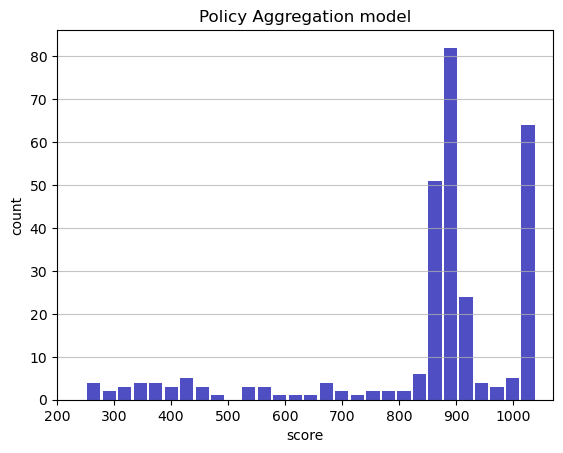

Track generation: 1077..1356 -> 279-tiles track
Epoch: 291
Policy Aggregation	mean: 850.79	variance: 187.32


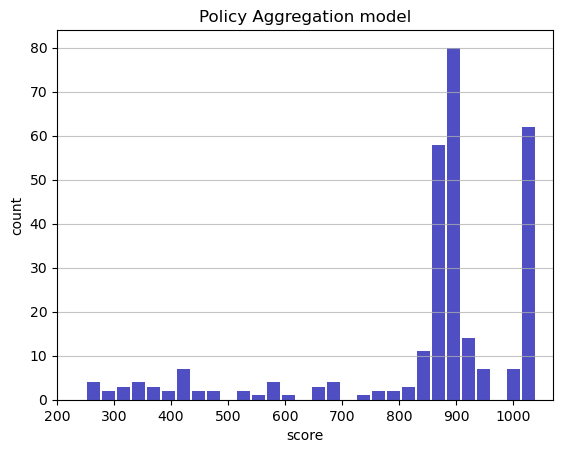

Track generation: 1235..1548 -> 313-tiles track
Epoch: 292
Policy Aggregation	mean: 850.98	variance: 187.03


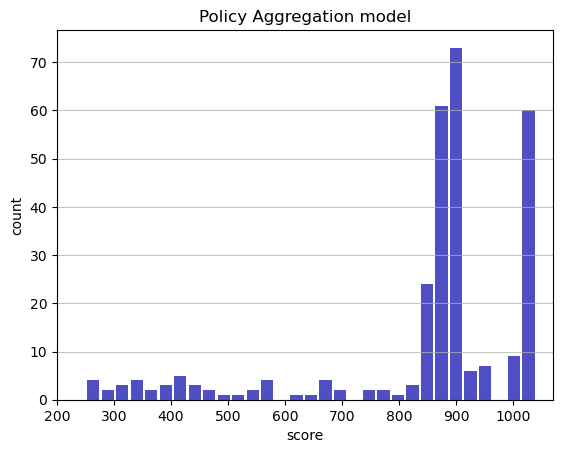

Track generation: 1320..1660 -> 340-tiles track
Epoch: 293
Policy Aggregation	mean: 851.50	variance: 186.92


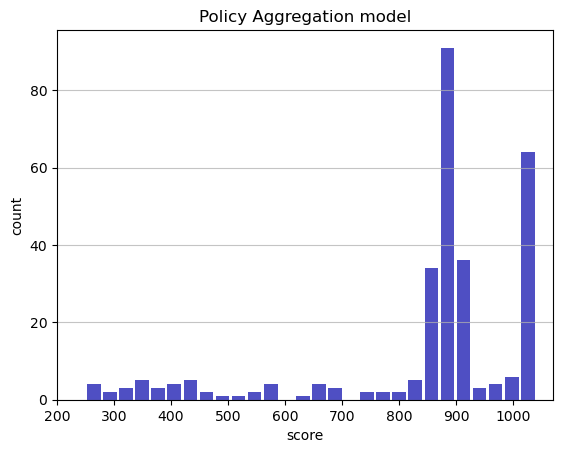

Track generation: 1143..1433 -> 290-tiles track
Epoch: 294
Policy Aggregation	mean: 851.57	variance: 186.61


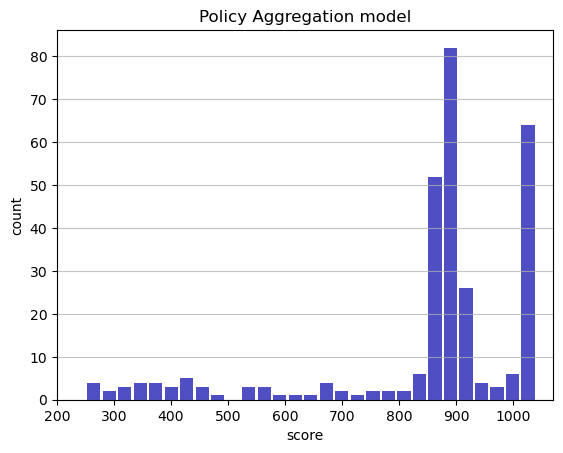

Track generation: 1128..1414 -> 286-tiles track
Epoch: 295
Policy Aggregation	mean: 851.69	variance: 186.30


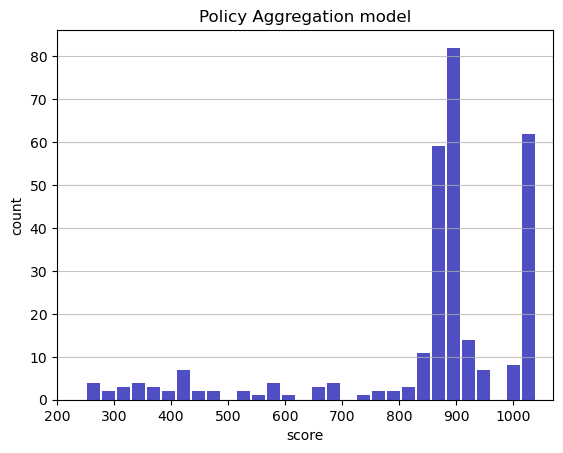

Track generation: 1101..1381 -> 280-tiles track
Epoch: 296
Policy Aggregation	mean: 851.90	variance: 186.02


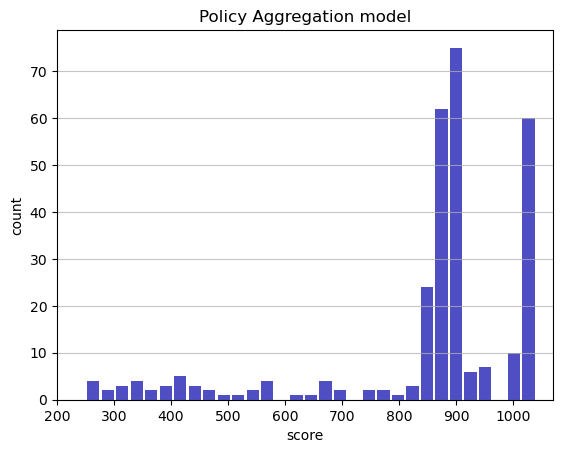

Track generation: 1173..1470 -> 297-tiles track
Epoch: 297
Policy Aggregation	mean: 852.05	variance: 185.73


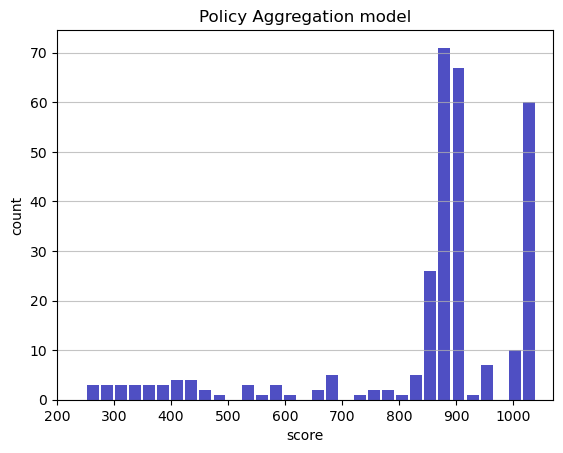

Track generation: 1035..1305 -> 270-tiles track
Epoch: 298
Policy Aggregation	mean: 852.23	variance: 185.44


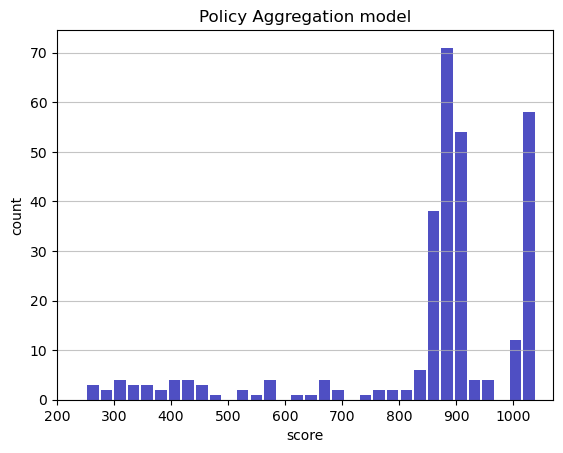

Track generation: 1177..1475 -> 298-tiles track
Epoch: 299
Policy Aggregation	mean: 852.39	variance: 185.15


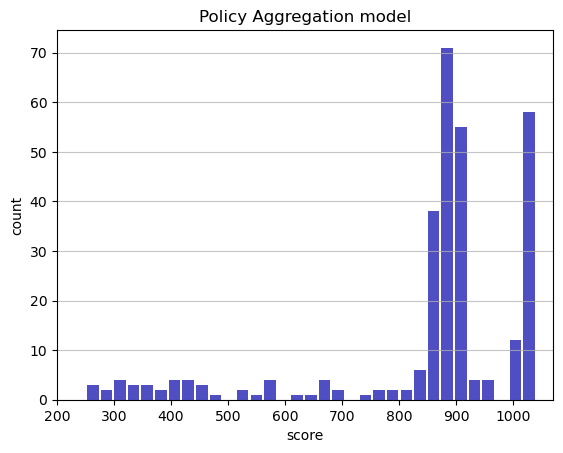

Track generation: 1164..1459 -> 295-tiles track
Epoch: 300
Policy Aggregation	mean: 850.85	variance: 186.74


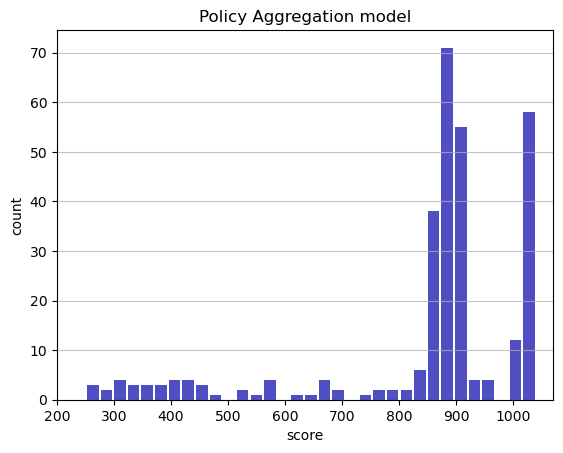

Track generation: 1071..1343 -> 272-tiles track
Epoch: 301
Policy Aggregation	mean: 851.00	variance: 186.45


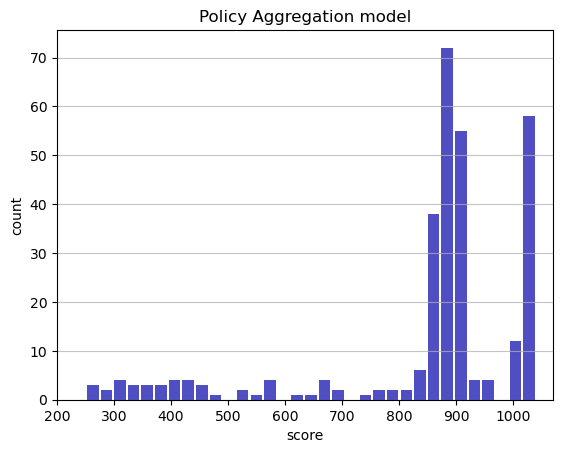

Track generation: 1239..1553 -> 314-tiles track
Epoch: 302
Policy Aggregation	mean: 851.16	variance: 186.16


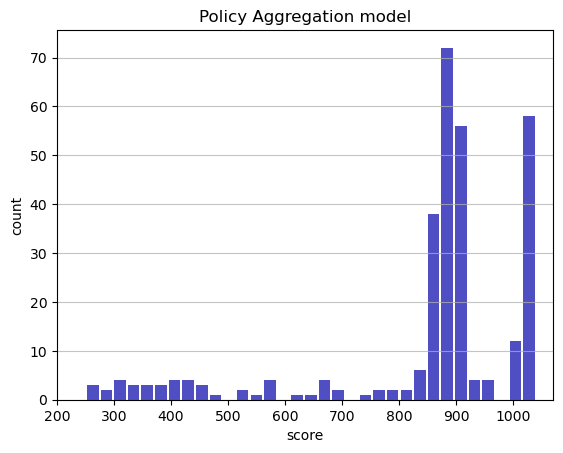

Track generation: 1353..1696 -> 343-tiles track
Epoch: 303
Policy Aggregation	mean: 851.58	variance: 186.00


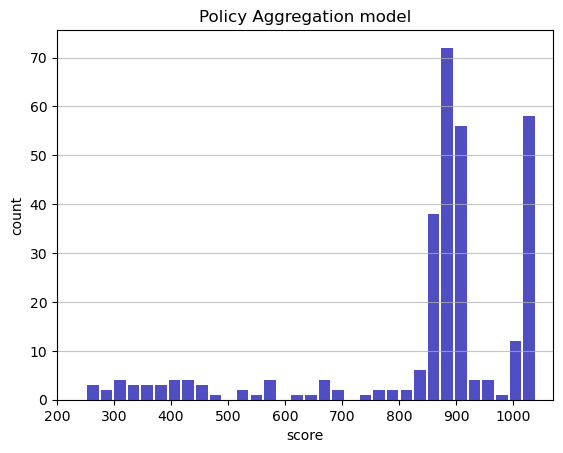

Track generation: 1254..1572 -> 318-tiles track
Epoch: 304
Policy Aggregation	mean: 851.71	variance: 185.70


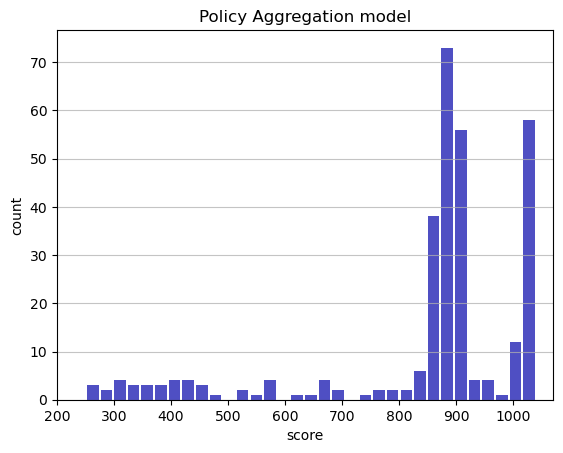

Track generation: 970..1225 -> 255-tiles track
Epoch: 305
Policy Aggregation	mean: 852.31	variance: 185.70


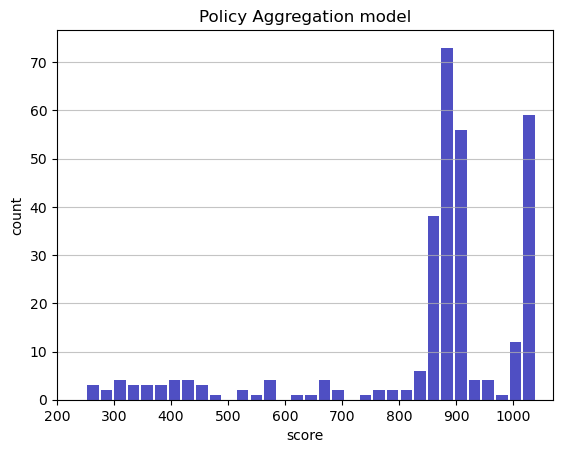

Track generation: 987..1240 -> 253-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1250..1567 -> 317-tiles track
Epoch: 306
Policy Aggregation	mean: 852.44	variance: 185.41


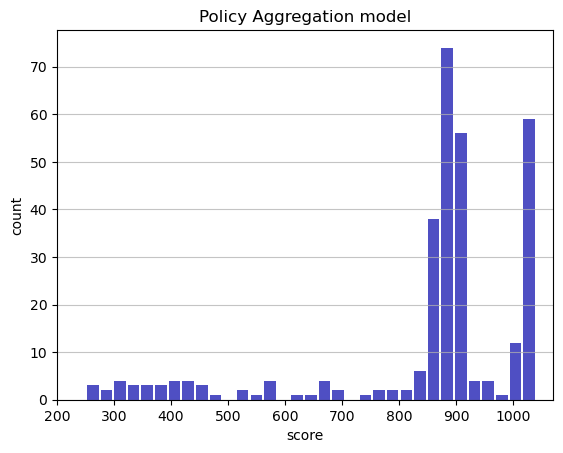

Track generation: 1135..1423 -> 288-tiles track
Epoch: 307
Policy Aggregation	mean: 852.54	variance: 185.12


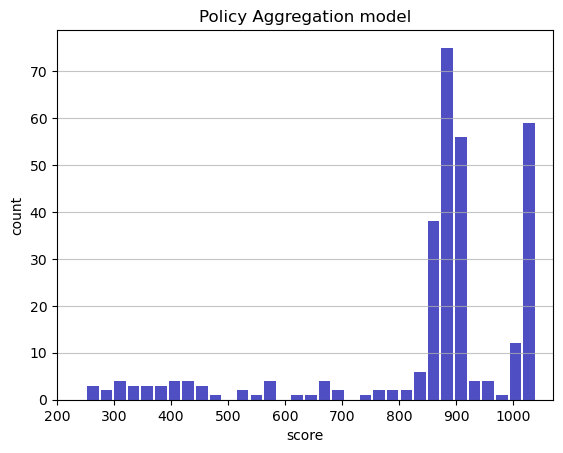

Track generation: 1255..1573 -> 318-tiles track
Epoch: 308
Policy Aggregation	mean: 852.68	variance: 184.83


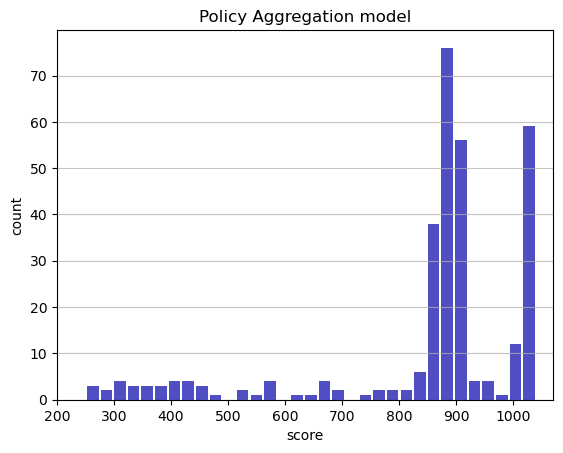

Track generation: 1192..1495 -> 303-tiles track
Epoch: 309
Policy Aggregation	mean: 852.77	variance: 184.54


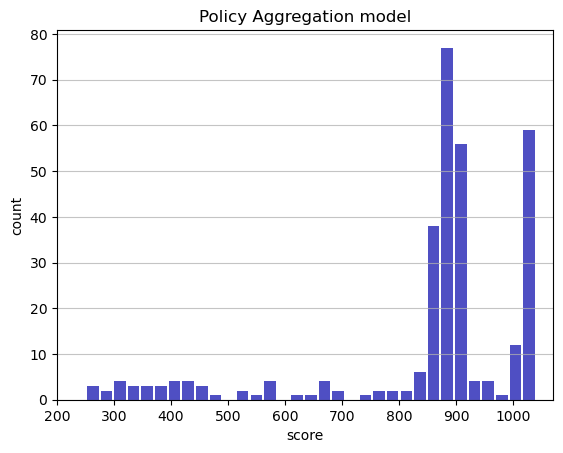

Track generation: 1020..1279 -> 259-tiles track
Epoch: 310
Policy Aggregation	mean: 852.77	variance: 184.24


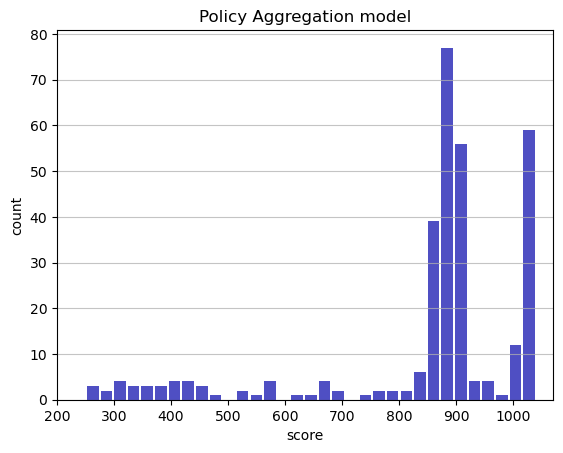

Track generation: 1043..1315 -> 272-tiles track
Epoch: 311
Policy Aggregation	mean: 852.84	variance: 183.95


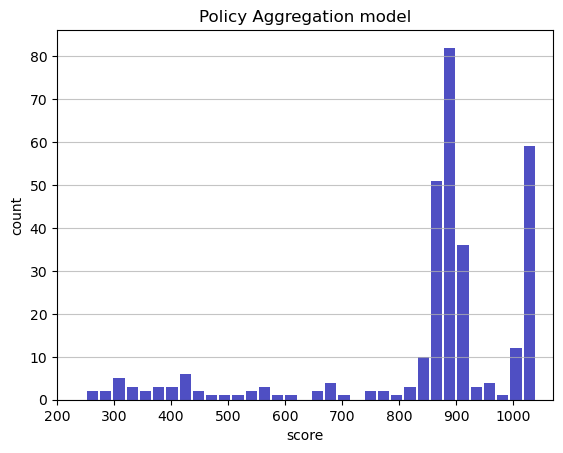

Track generation: 1129..1415 -> 286-tiles track
Epoch: 312
Policy Aggregation	mean: 852.89	variance: 183.66


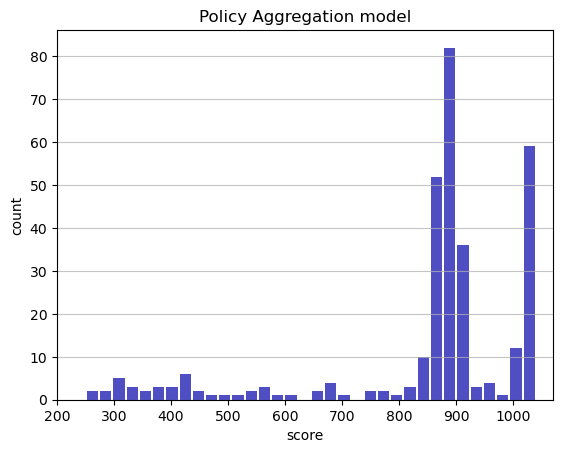

Track generation: 1227..1538 -> 311-tiles track
Epoch: 313
Policy Aggregation	mean: 852.96	variance: 183.36


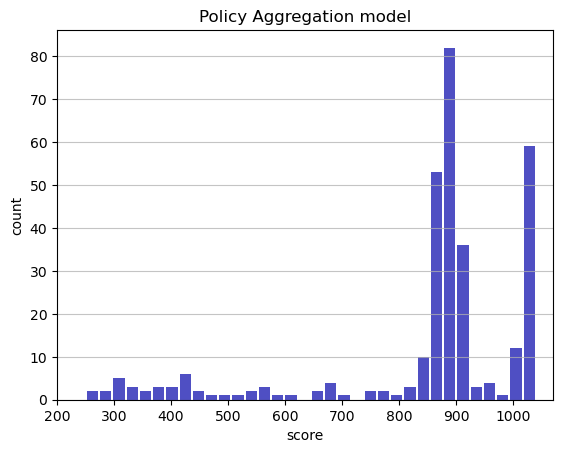

Track generation: 1260..1579 -> 319-tiles track
Epoch: 314
Policy Aggregation	mean: 853.08	variance: 183.09


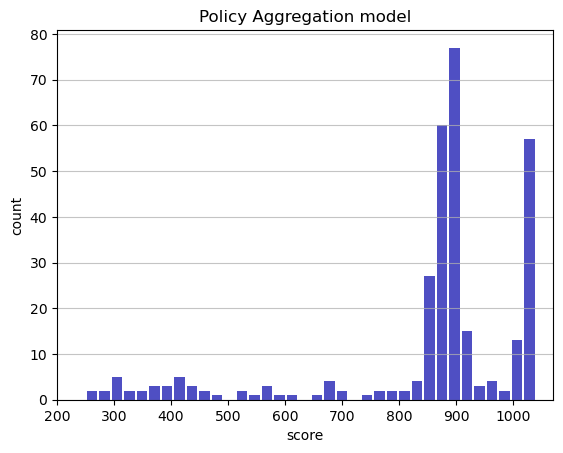

Track generation: 987..1238 -> 251-tiles track
Epoch: 315
Policy Aggregation	mean: 853.28	variance: 182.83


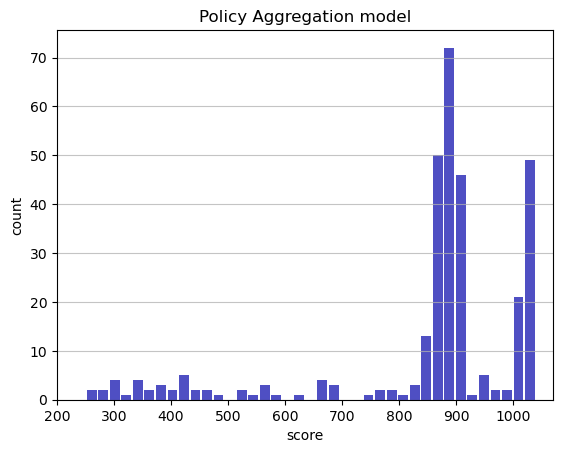

Track generation: 1132..1419 -> 287-tiles track
Epoch: 316
Policy Aggregation	mean: 852.22	variance: 183.49


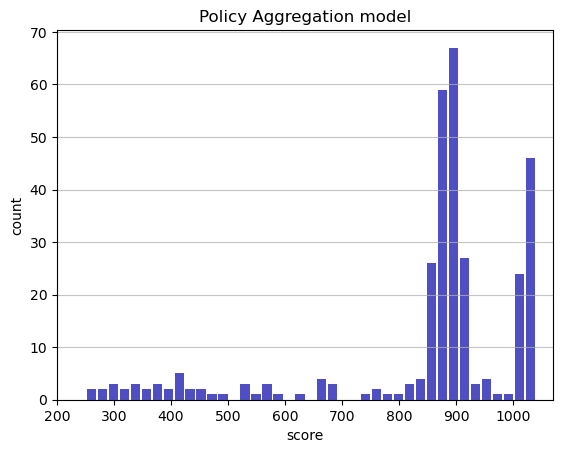

Track generation: 1309..1640 -> 331-tiles track
Epoch: 317
Policy Aggregation	mean: 852.66	variance: 183.37


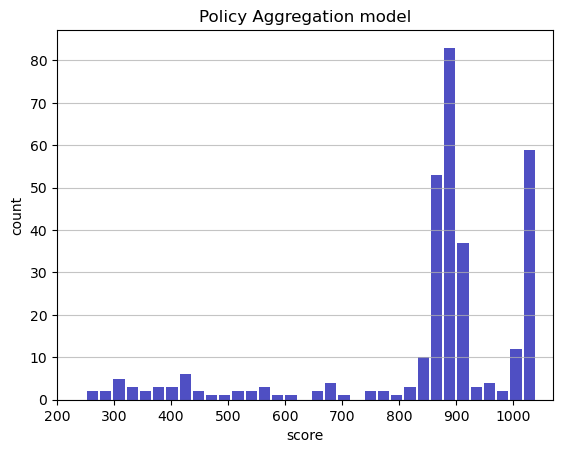

Track generation: 1086..1362 -> 276-tiles track
Epoch: 318
Policy Aggregation	mean: 852.81	variance: 183.10


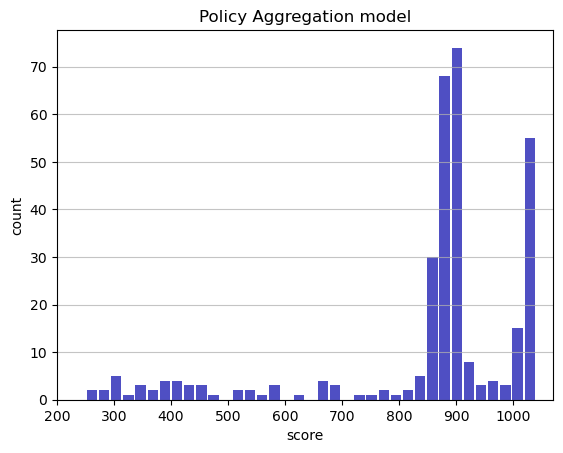

Track generation: 1284..1609 -> 325-tiles track
Epoch: 319
Policy Aggregation	mean: 851.59	variance: 184.10


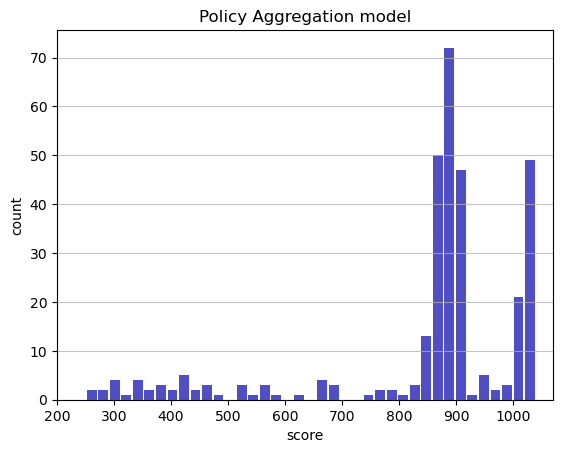

Track generation: 1103..1390 -> 287-tiles track
Epoch: 320
Policy Aggregation	mean: 852.10	variance: 184.04


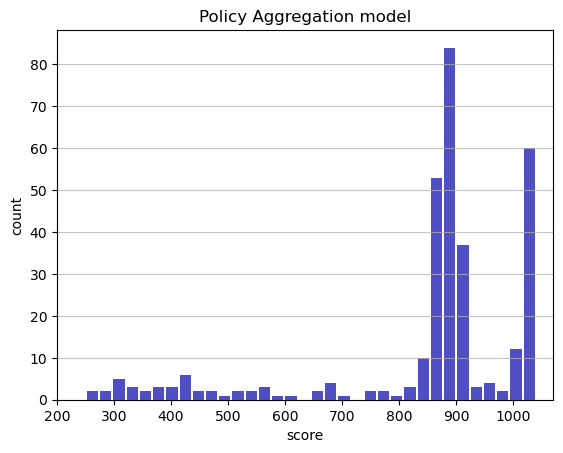

Track generation: 993..1251 -> 258-tiles track
Epoch: 321
Policy Aggregation	mean: 852.67	variance: 184.04


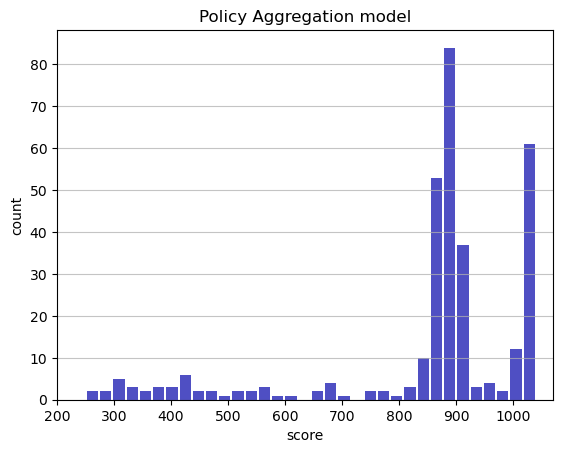

Track generation: 1215..1523 -> 308-tiles track
Epoch: 322
Policy Aggregation	mean: 852.75	variance: 183.76


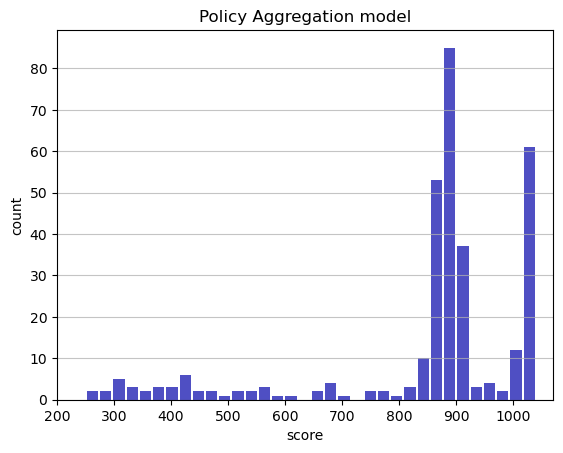

Track generation: 1234..1547 -> 313-tiles track
Epoch: 323
Policy Aggregation	mean: 853.26	variance: 183.70


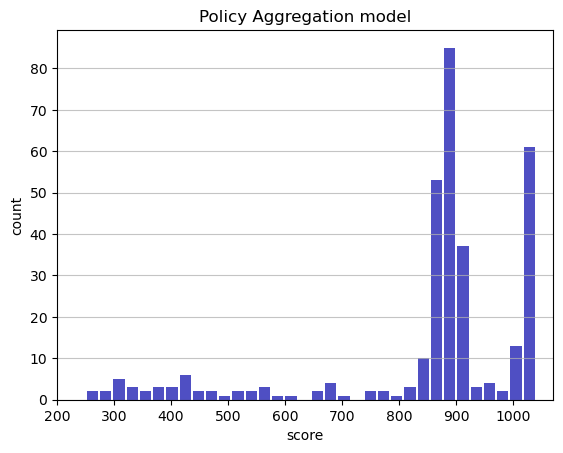

Track generation: 1159..1453 -> 294-tiles track
Epoch: 324
Policy Aggregation	mean: 853.39	variance: 183.43


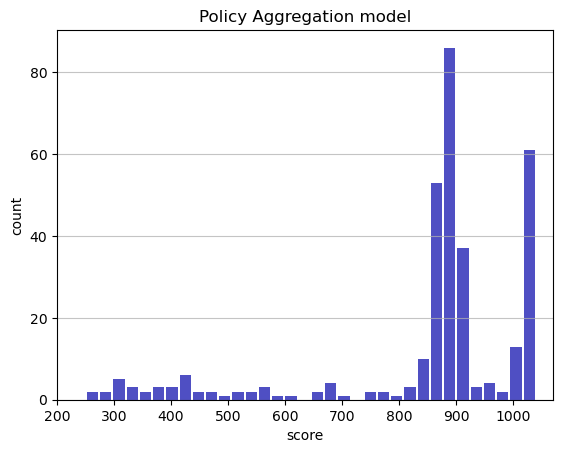

Track generation: 1211..1518 -> 307-tiles track
Epoch: 325
Policy Aggregation	mean: 852.54	variance: 183.78


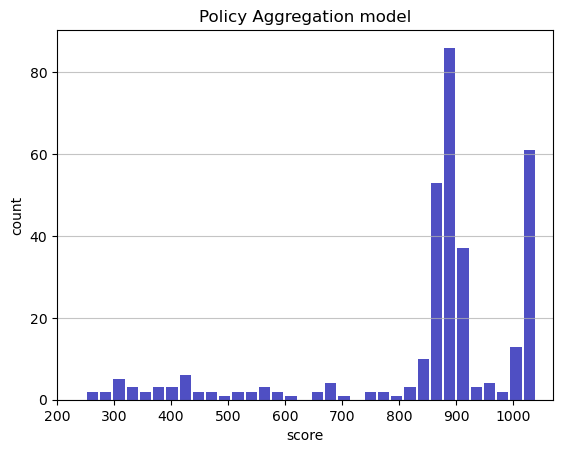

Track generation: 1132..1419 -> 287-tiles track
Epoch: 326
Policy Aggregation	mean: 852.55	variance: 183.50


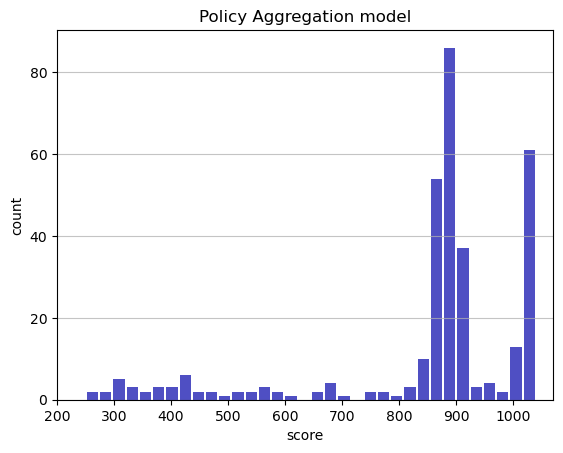

Track generation: 968..1221 -> 253-tiles track
Epoch: 327
Policy Aggregation	mean: 853.11	variance: 183.50


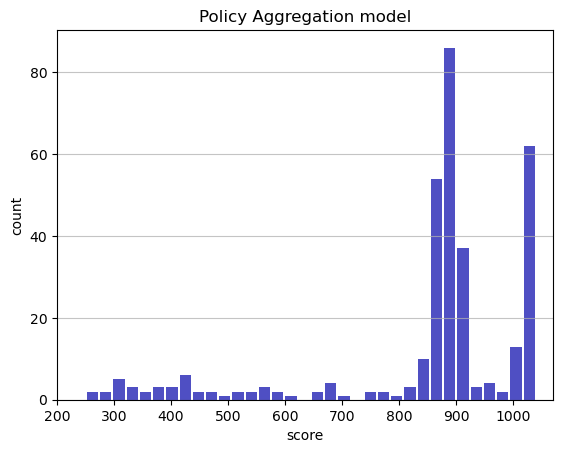

Track generation: 1176..1474 -> 298-tiles track
Epoch: 328
Policy Aggregation	mean: 852.13	variance: 184.08


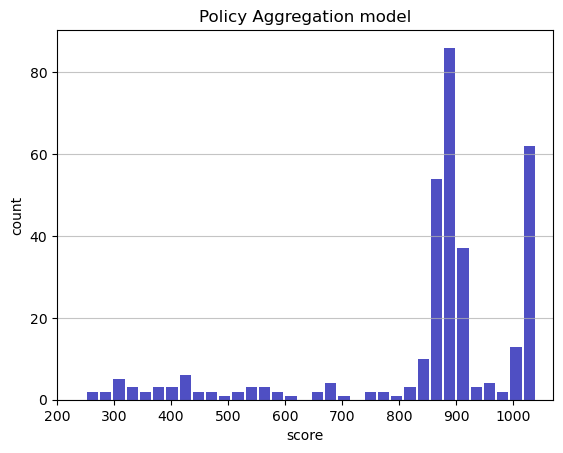

Track generation: 1197..1501 -> 304-tiles track
Epoch: 329
Policy Aggregation	mean: 852.21	variance: 183.81


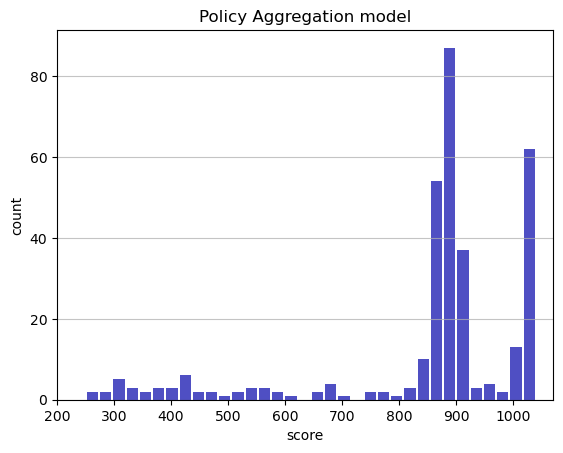

Track generation: 1177..1475 -> 298-tiles track
Epoch: 330
Policy Aggregation	mean: 852.30	variance: 183.54


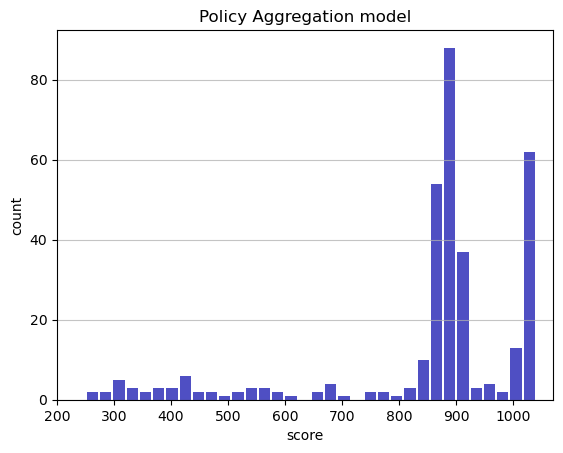

Track generation: 990..1244 -> 254-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1254..1578 -> 324-tiles track
Epoch: 331
Policy Aggregation	mean: 852.78	variance: 183.47


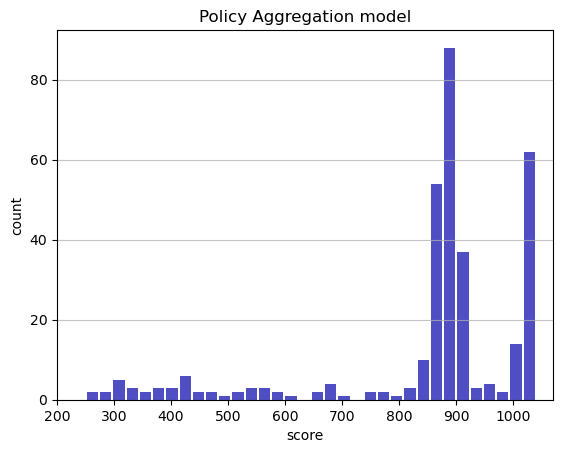

Track generation: 1169..1471 -> 302-tiles track
Epoch: 332
Policy Aggregation	mean: 852.94	variance: 183.22


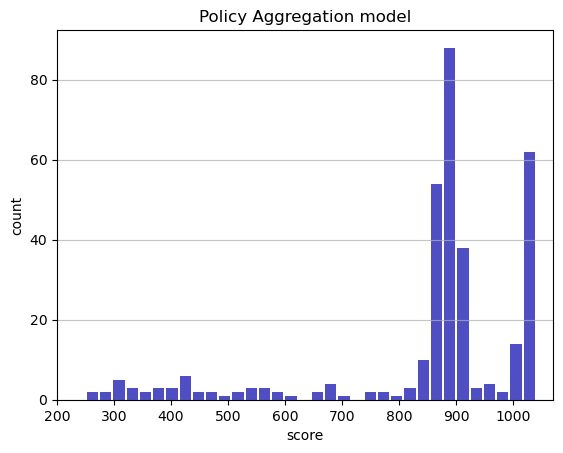

Track generation: 1086..1369 -> 283-tiles track
Epoch: 333
Policy Aggregation	mean: 853.07	variance: 182.95


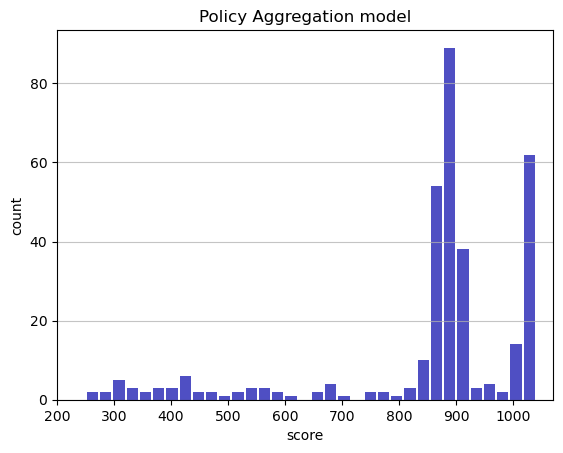

Track generation: 1080..1360 -> 280-tiles track
Epoch: 334
Policy Aggregation	mean: 853.25	variance: 182.71


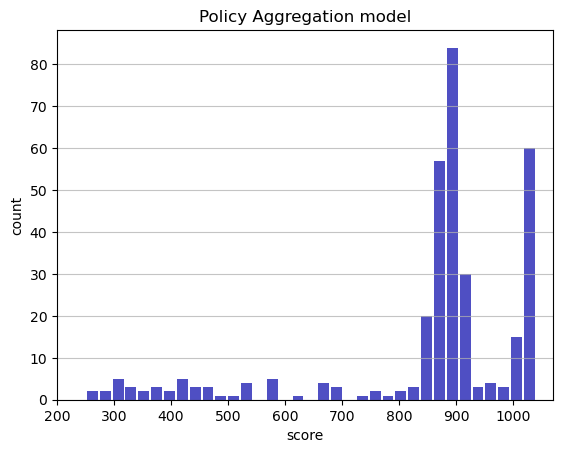

Track generation: 1379..1728 -> 349-tiles track
Epoch: 335
Policy Aggregation	mean: 852.57	variance: 182.85


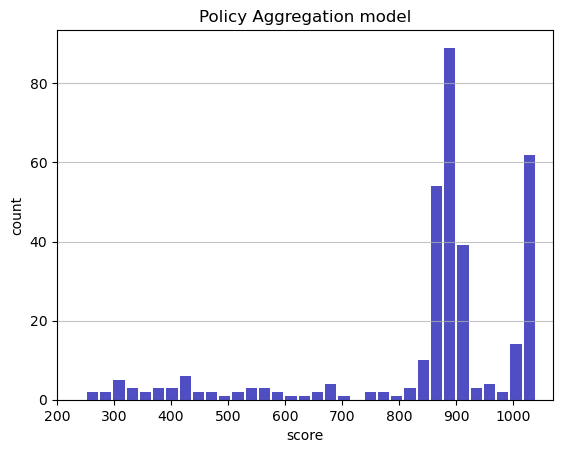

Track generation: 1037..1307 -> 270-tiles track
Epoch: 336
Policy Aggregation	mean: 852.57	variance: 182.58


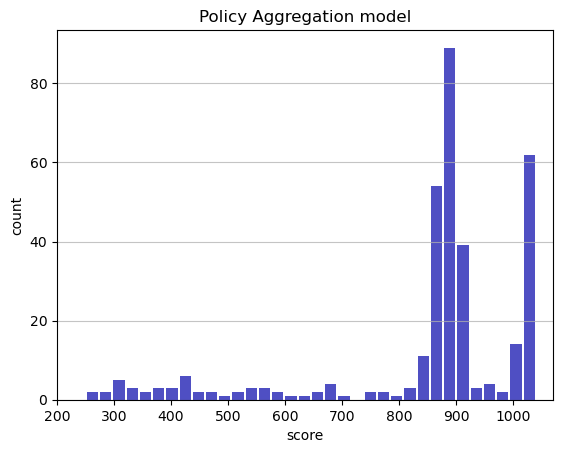

Track generation: 1221..1531 -> 310-tiles track
Epoch: 337
Policy Aggregation	mean: 852.62	variance: 182.31


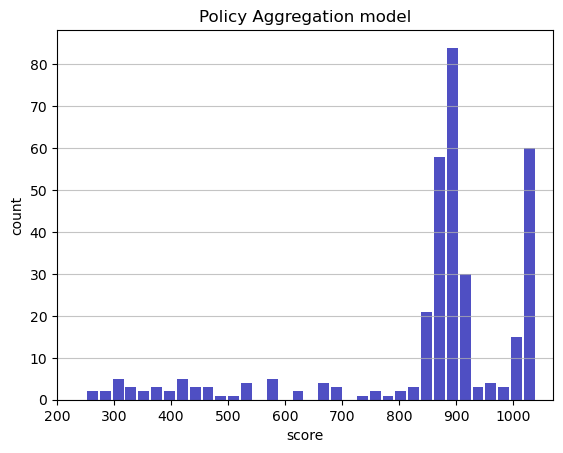

Track generation: 957..1210 -> 253-tiles track
Epoch: 338
Policy Aggregation	mean: 852.66	variance: 182.04


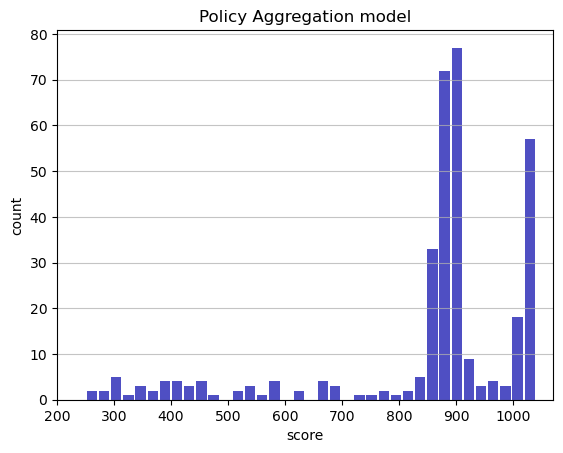

Track generation: 1211..1518 -> 307-tiles track
Epoch: 339
Policy Aggregation	mean: 852.74	variance: 181.78


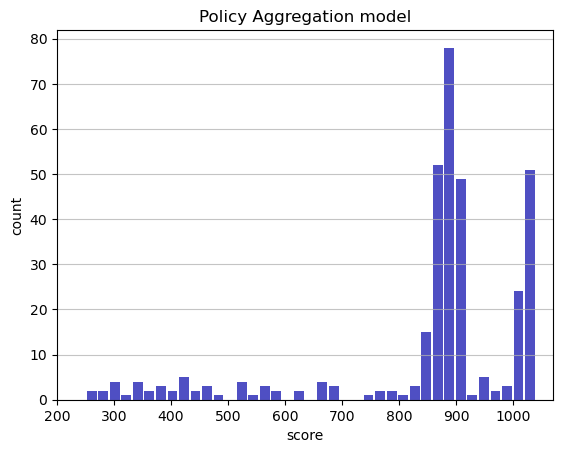

Track generation: 1116..1399 -> 283-tiles track
Epoch: 340
Policy Aggregation	mean: 852.88	variance: 181.53


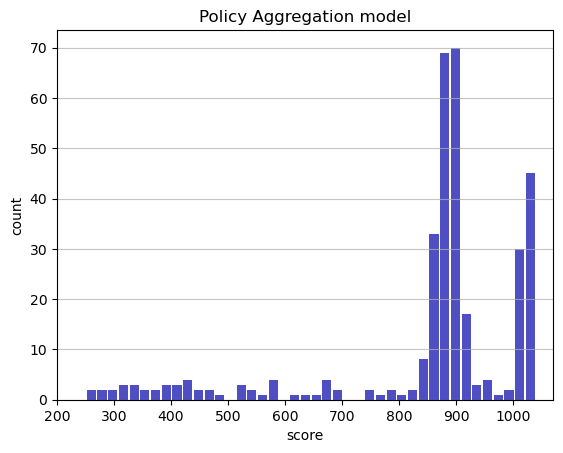

Track generation: 1127..1413 -> 286-tiles track
Epoch: 341
Policy Aggregation	mean: 851.89	variance: 182.17


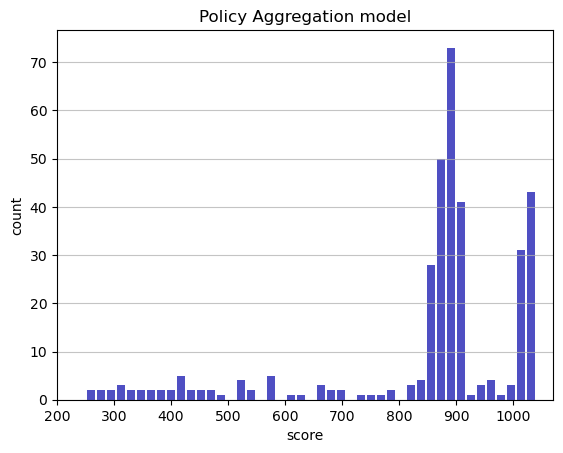

Track generation: 1058..1334 -> 276-tiles track
Epoch: 342
Policy Aggregation	mean: 852.01	variance: 181.91


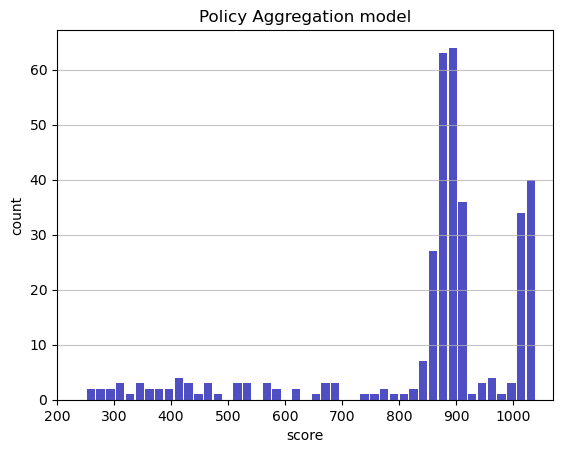

Track generation: 1152..1453 -> 301-tiles track
Epoch: 343
Policy Aggregation	mean: 852.08	variance: 181.65


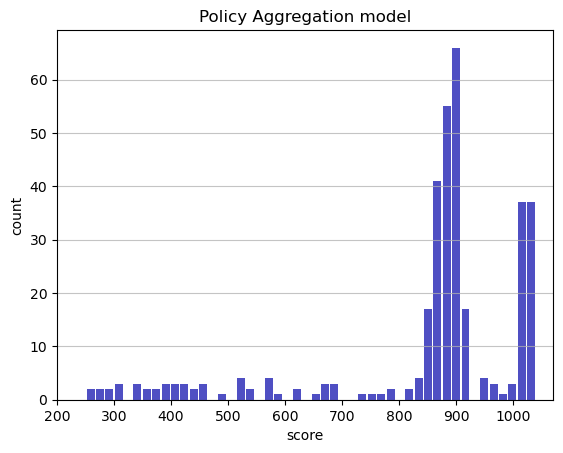

Track generation: 962..1214 -> 252-tiles track
Epoch: 344
Policy Aggregation	mean: 852.23	variance: 181.41


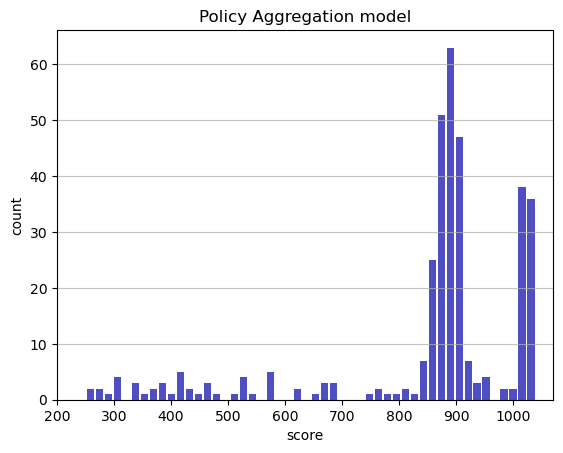

Track generation: 1059..1328 -> 269-tiles track
Epoch: 345
Policy Aggregation	mean: 852.35	variance: 181.16


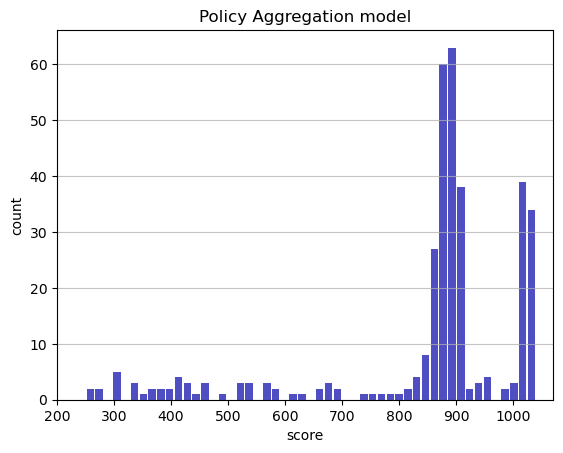

Track generation: 1180..1479 -> 299-tiles track
Epoch: 346
Policy Aggregation	mean: 852.85	variance: 181.13


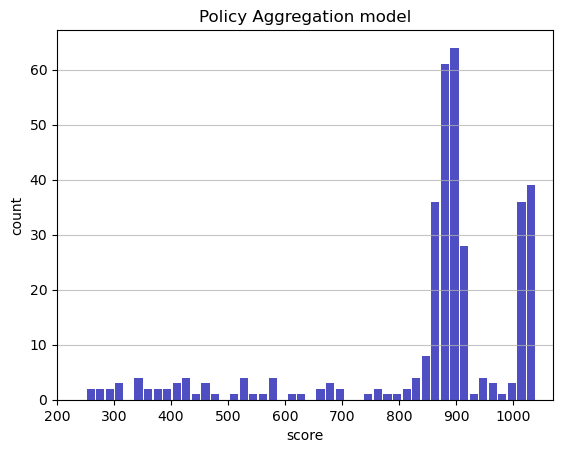

Track generation: 1073..1349 -> 276-tiles track
Epoch: 347
Policy Aggregation	mean: 853.35	variance: 181.11


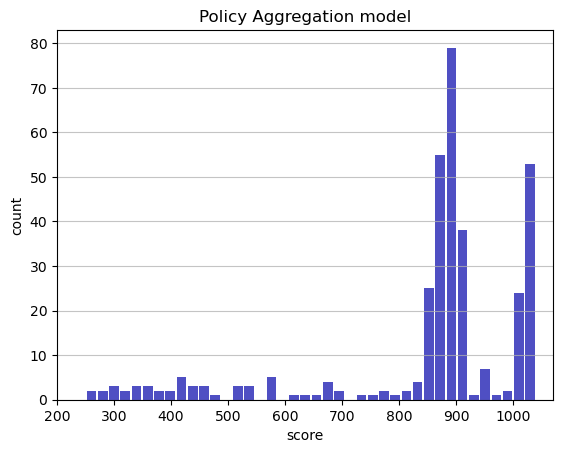

Track generation: 1243..1558 -> 315-tiles track
Epoch: 348
Policy Aggregation	mean: 853.43	variance: 180.86


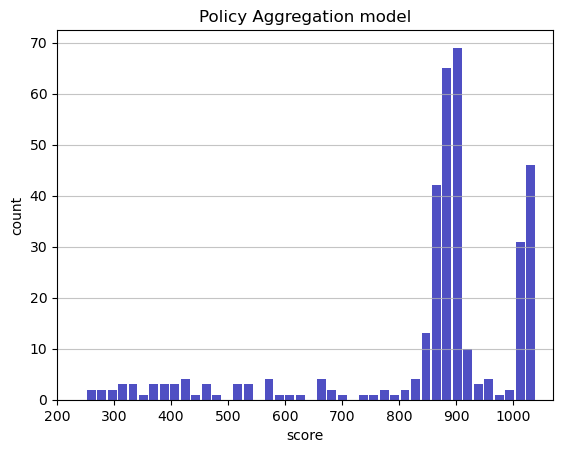

Track generation: 1015..1273 -> 258-tiles track
Epoch: 349
Policy Aggregation	mean: 853.57	variance: 180.62


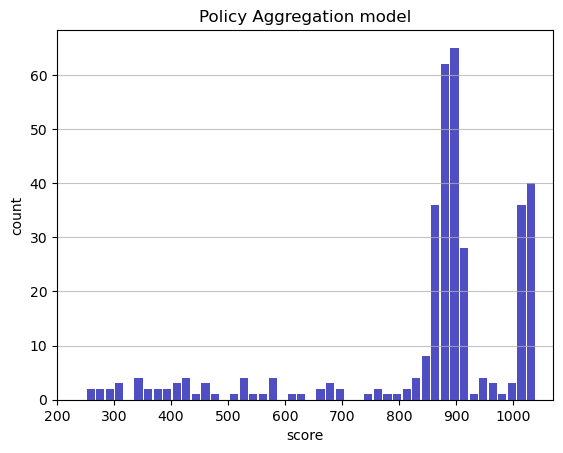

Track generation: 1059..1328 -> 269-tiles track
Epoch: 350
Policy Aggregation	mean: 853.57	variance: 180.36


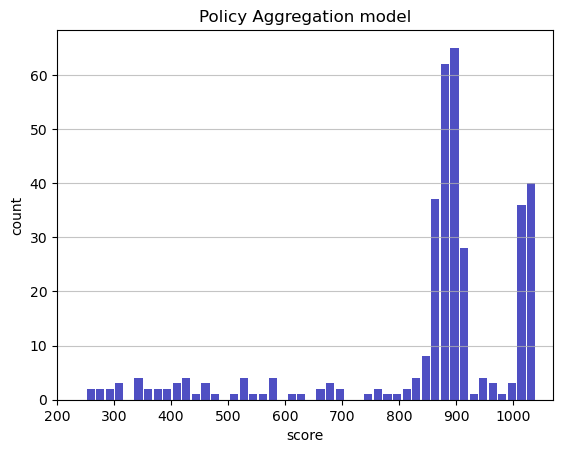

Track generation: 1135..1423 -> 288-tiles track
Epoch: 351
Policy Aggregation	mean: 854.05	variance: 180.32


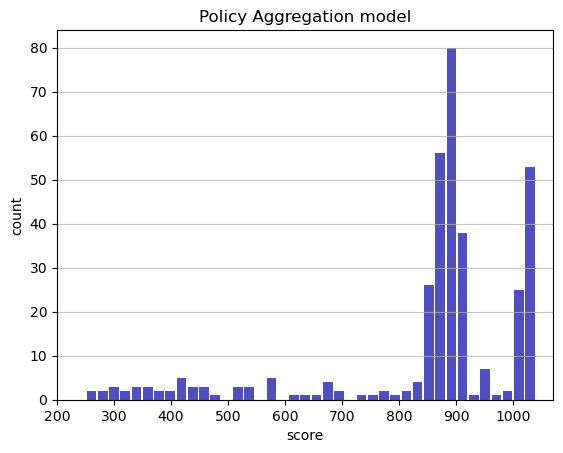

Track generation: 1261..1580 -> 319-tiles track
Epoch: 352
Policy Aggregation	mean: 852.51	variance: 182.34


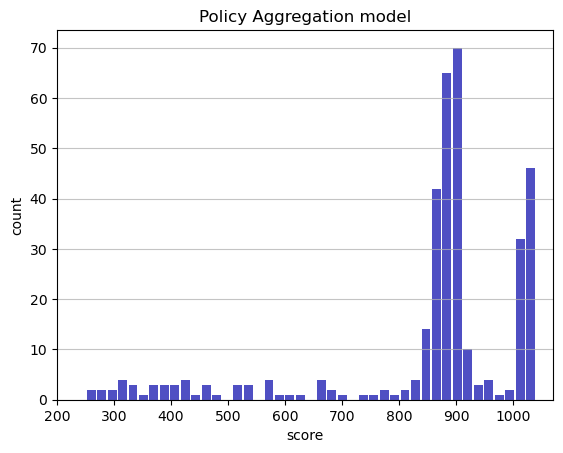

Track generation: 1233..1546 -> 313-tiles track
Epoch: 353
Policy Aggregation	mean: 852.60	variance: 182.09


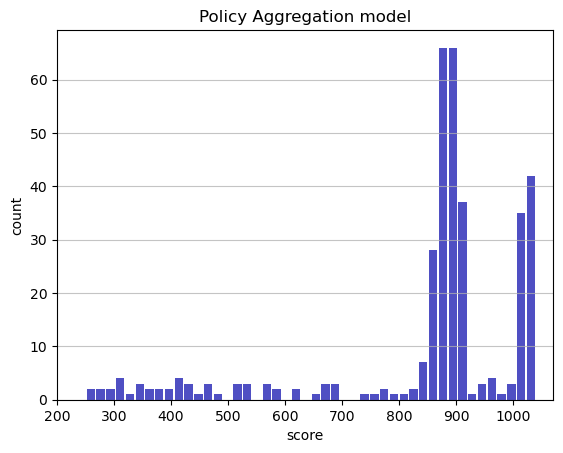

Track generation: 1193..1495 -> 302-tiles track
Epoch: 354
Policy Aggregation	mean: 852.71	variance: 181.85


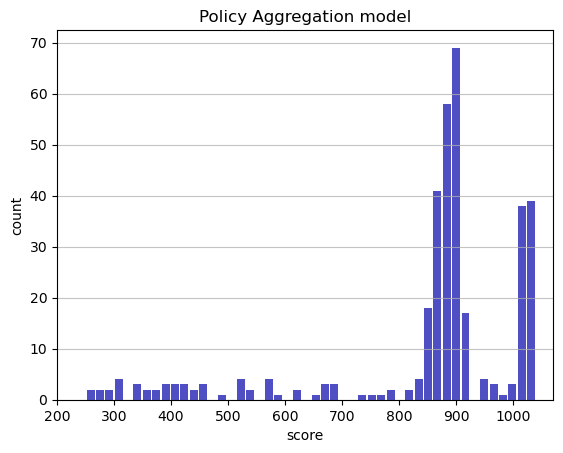

Track generation: 1175..1473 -> 298-tiles track
Epoch: 355
Policy Aggregation	mean: 853.18	variance: 181.81


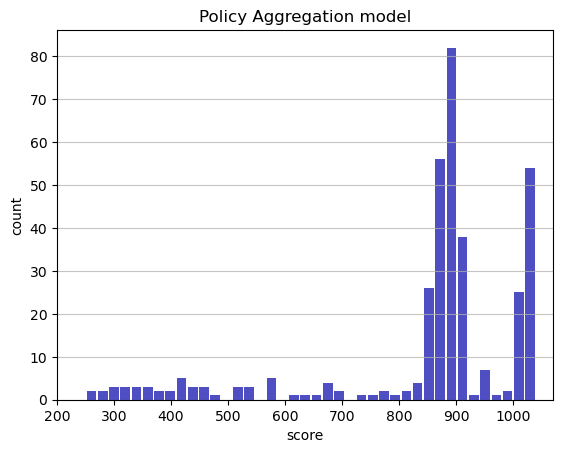

Track generation: 1159..1453 -> 294-tiles track
Epoch: 356
Policy Aggregation	mean: 853.33	variance: 181.58


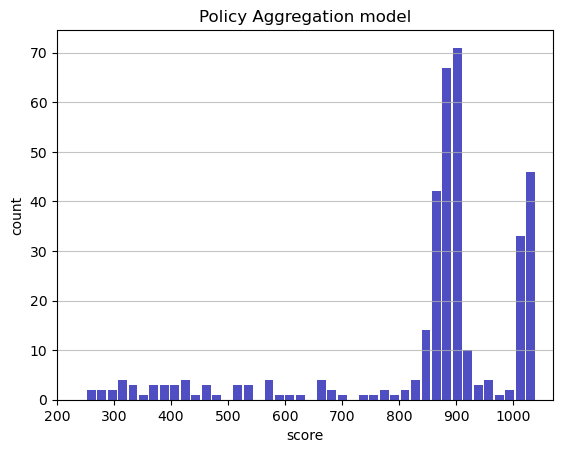

Track generation: 1243..1557 -> 314-tiles track
Epoch: 357
Policy Aggregation	mean: 853.45	variance: 181.34


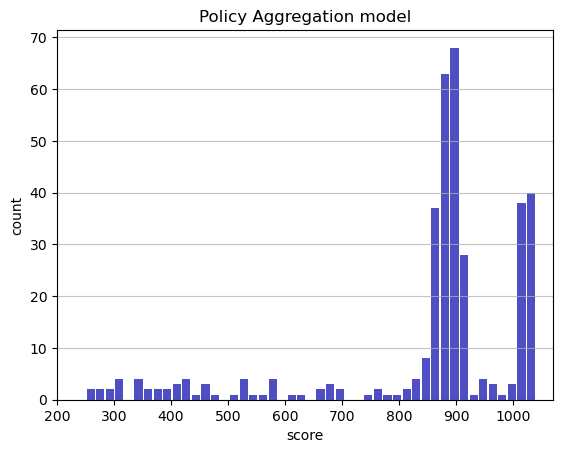

Track generation: 800..1011 -> 211-tiles track
Epoch: 358
Policy Aggregation	mean: 852.80	variance: 181.51


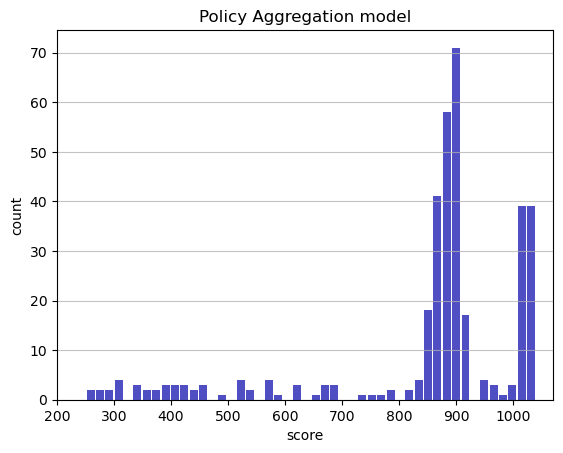

Track generation: 1205..1511 -> 306-tiles track
Epoch: 359
Policy Aggregation	mean: 851.27	variance: 183.54


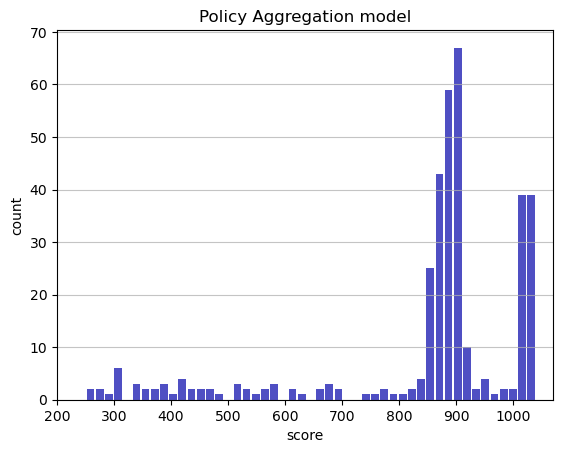

Track generation: 1196..1499 -> 303-tiles track
Epoch: 360
Policy Aggregation	mean: 851.74	variance: 183.50


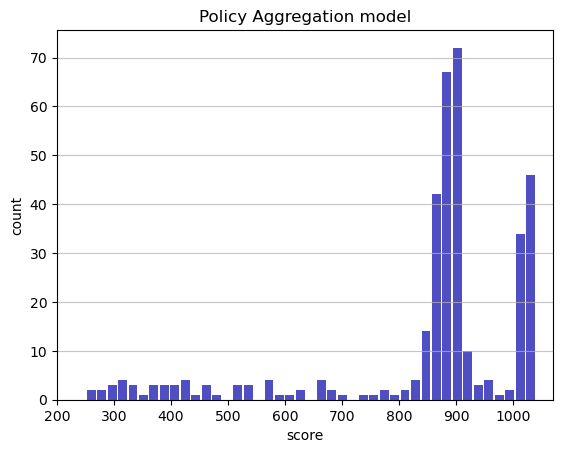

Track generation: 1062..1331 -> 269-tiles track
Epoch: 361
Policy Aggregation	mean: 851.84	variance: 183.25


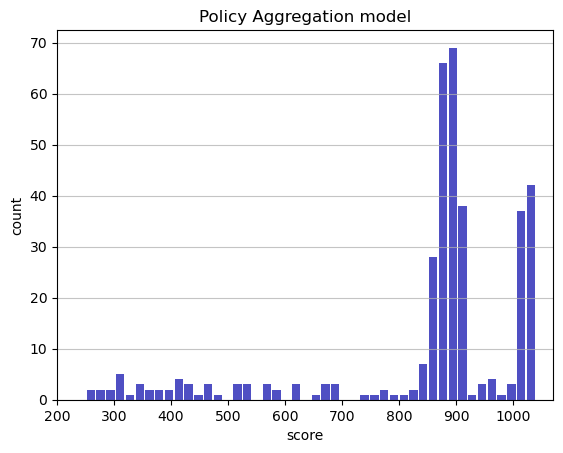

Track generation: 1176..1474 -> 298-tiles track
Epoch: 362
Policy Aggregation	mean: 850.40	variance: 185.02


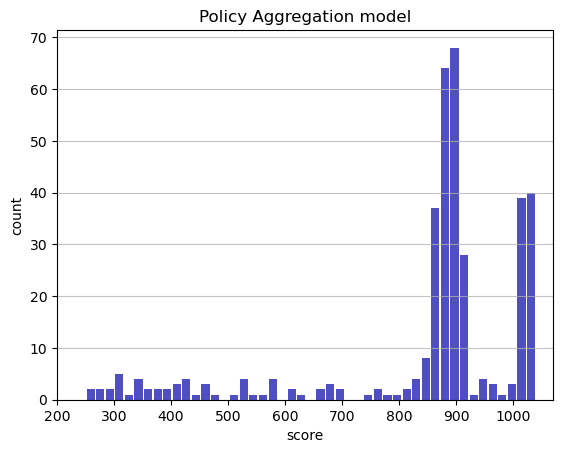

Track generation: 1236..1558 -> 322-tiles track
Epoch: 363
Policy Aggregation	mean: 850.85	variance: 184.96


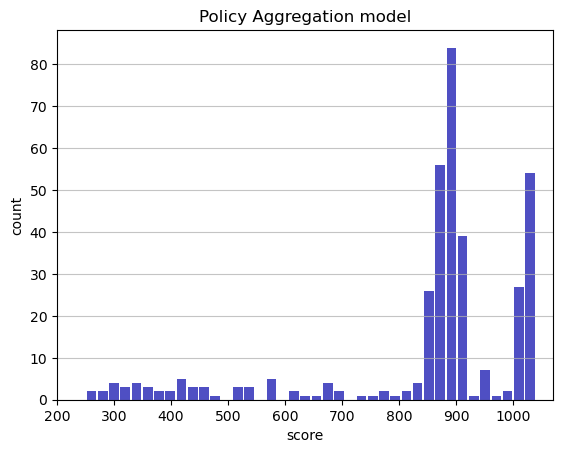

Track generation: 1004..1259 -> 255-tiles track
Epoch: 364
Policy Aggregation	mean: 849.65	variance: 186.12


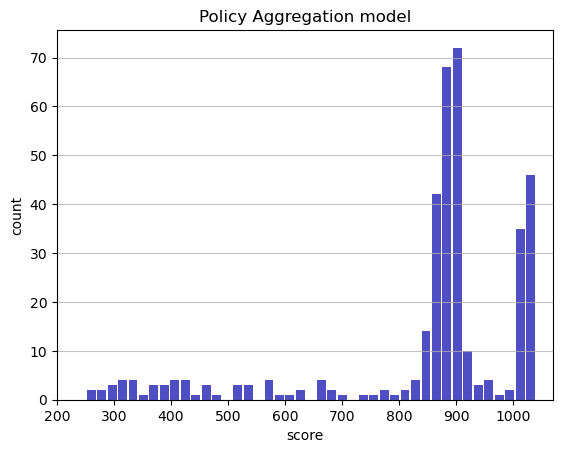

Track generation: 1114..1395 -> 281-tiles track
Epoch: 365
Policy Aggregation	mean: 849.67	variance: 185.87


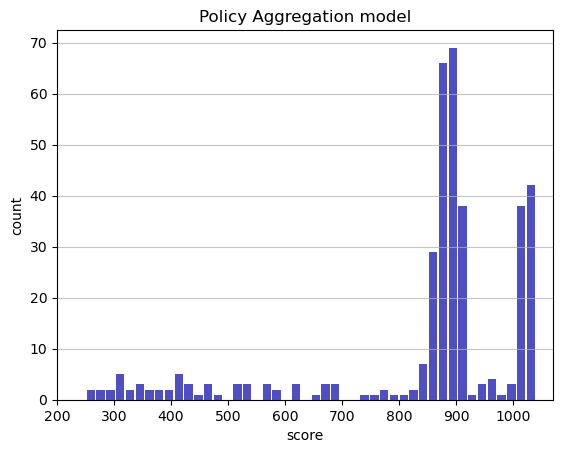

Track generation: 1035..1298 -> 263-tiles track
Epoch: 366
Policy Aggregation	mean: 849.83	variance: 185.63


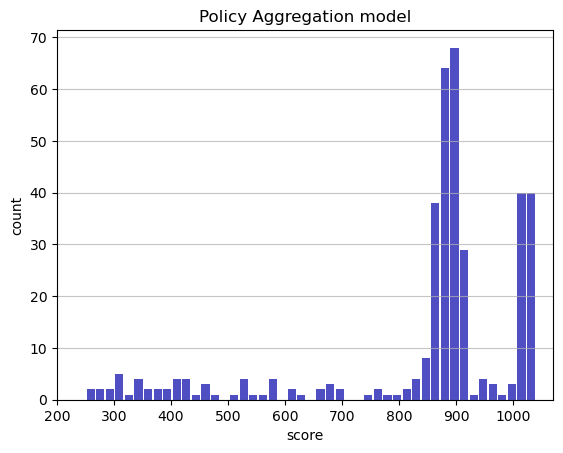

Track generation: 1177..1475 -> 298-tiles track
Epoch: 367
Policy Aggregation	mean: 849.92	variance: 185.39


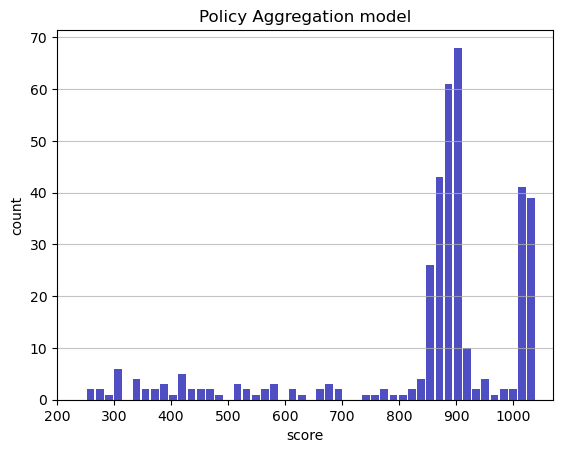

Track generation: 1183..1483 -> 300-tiles track
Epoch: 368
Policy Aggregation	mean: 848.48	variance: 187.18


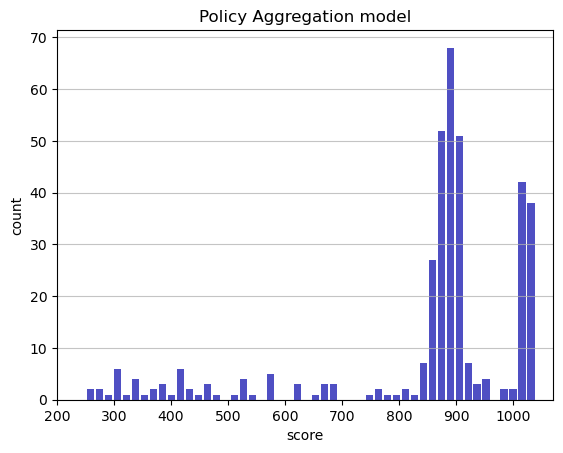

Track generation: 1059..1332 -> 273-tiles track
Epoch: 369
Policy Aggregation	mean: 848.96	variance: 187.15


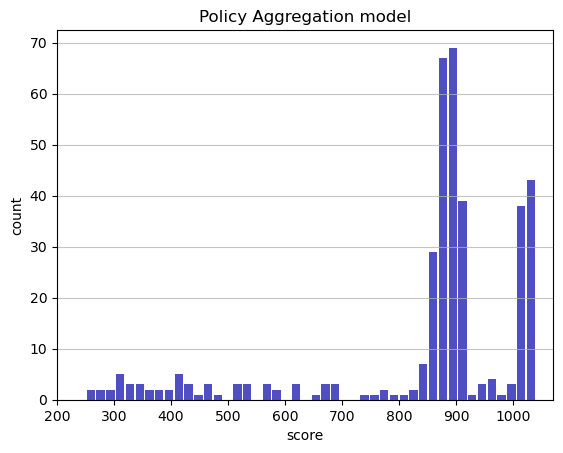

Track generation: 1182..1482 -> 300-tiles track
Epoch: 370
Policy Aggregation	mean: 849.44	variance: 187.12


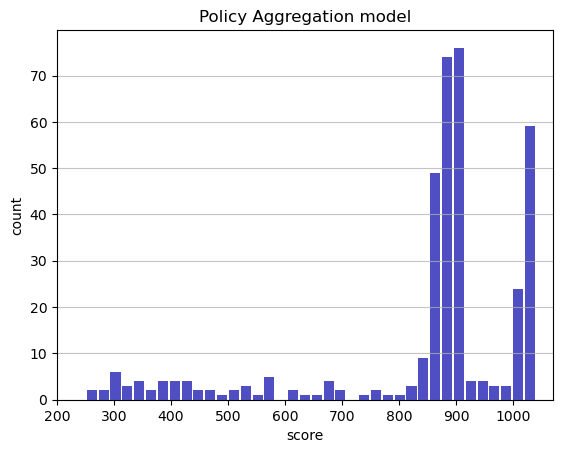

Track generation: 1115..1398 -> 283-tiles track
Epoch: 371
Policy Aggregation	mean: 849.93	variance: 187.11


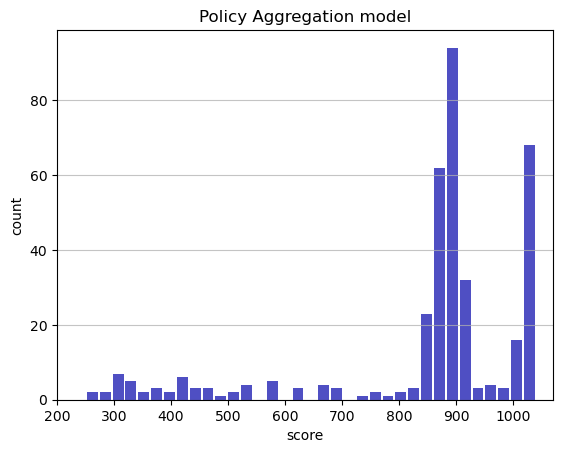

Track generation: 1228..1539 -> 311-tiles track
Epoch: 372
Policy Aggregation	mean: 850.37	variance: 187.05


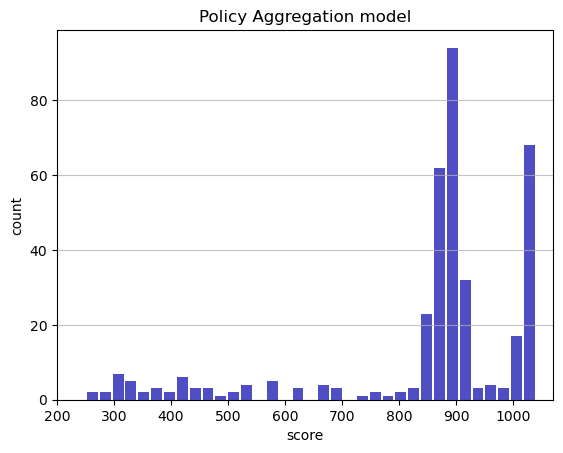

Track generation: 1071..1343 -> 272-tiles track
Epoch: 373
Policy Aggregation	mean: 850.84	variance: 187.02


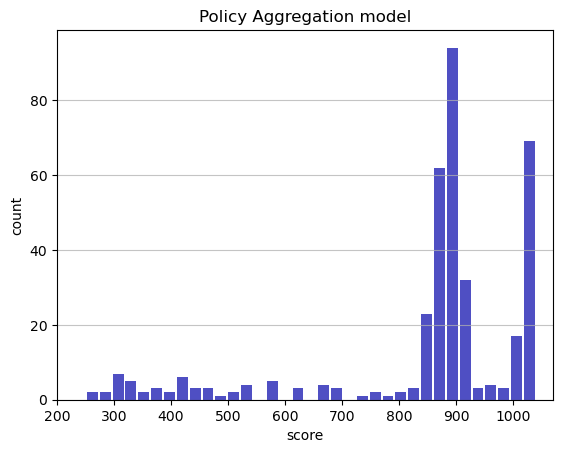

Track generation: 1008..1272 -> 264-tiles track
Epoch: 374
Policy Aggregation	mean: 851.32	variance: 187.00


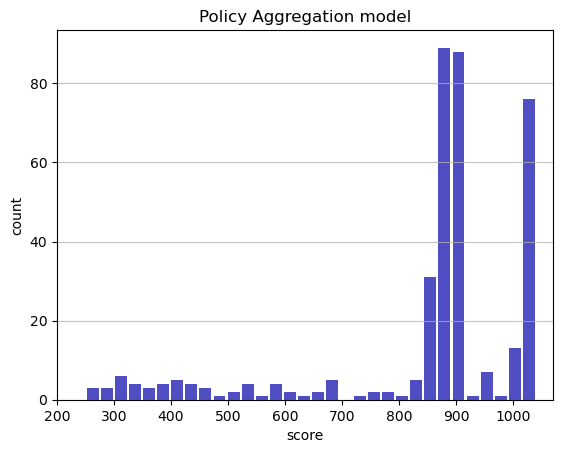

Track generation: 1056..1333 -> 277-tiles track
Epoch: 375
Policy Aggregation	mean: 851.46	variance: 186.77


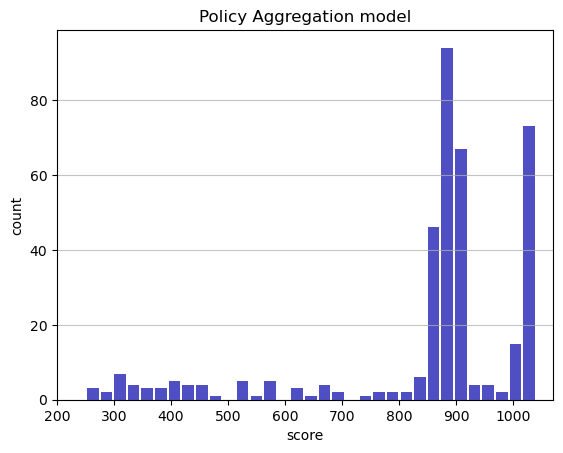

Track generation: 1069..1342 -> 273-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1214..1524 -> 310-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1103..1383 -> 280-tiles track
Epoch: 376
Policy Aggregation	mean: 851.49	variance: 186.52


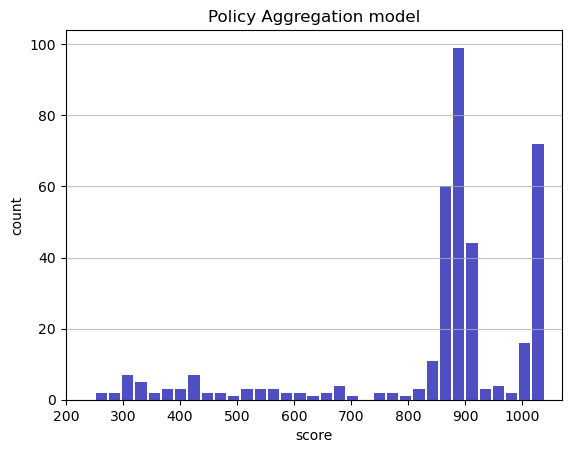

Track generation: 1104..1384 -> 280-tiles track
Epoch: 377
Policy Aggregation	mean: 851.63	variance: 186.29


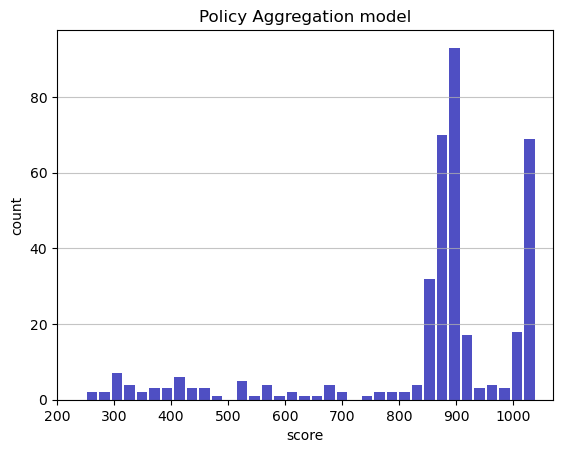

Track generation: 1159..1453 -> 294-tiles track
Epoch: 378
Policy Aggregation	mean: 851.70	variance: 186.05


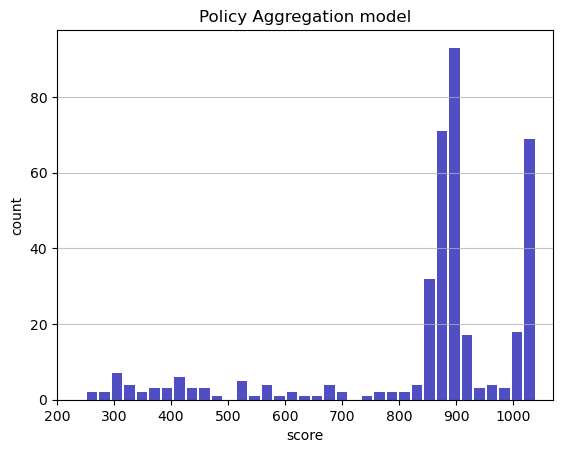

Track generation: 1150..1454 -> 304-tiles track
Epoch: 379
Policy Aggregation	mean: 851.78	variance: 185.81


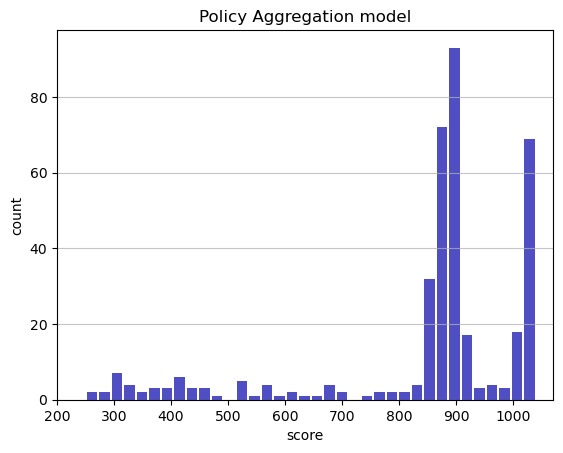

Track generation: 1188..1489 -> 301-tiles track
Epoch: 380
Policy Aggregation	mean: 851.89	variance: 185.58


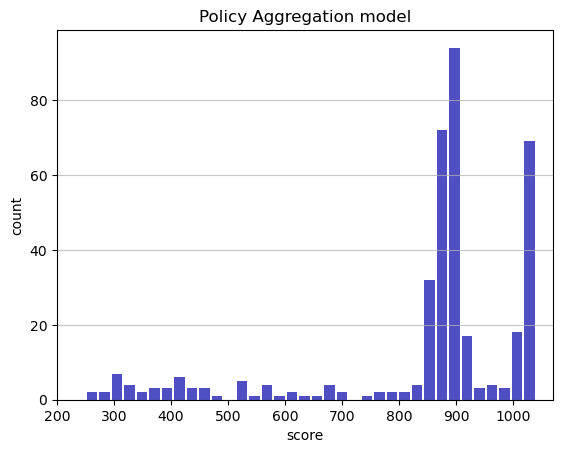

Track generation: 1143..1442 -> 299-tiles track
Epoch: 381
Policy Aggregation	mean: 851.33	variance: 185.66


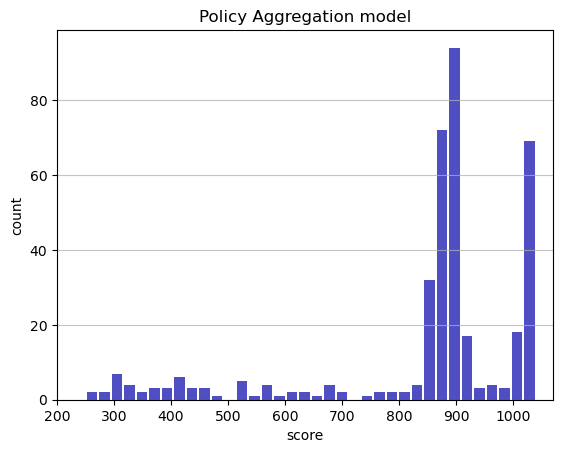

Track generation: 1132..1441 -> 309-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1278..1602 -> 324-tiles track
Epoch: 382
Policy Aggregation	mean: 851.40	variance: 185.42


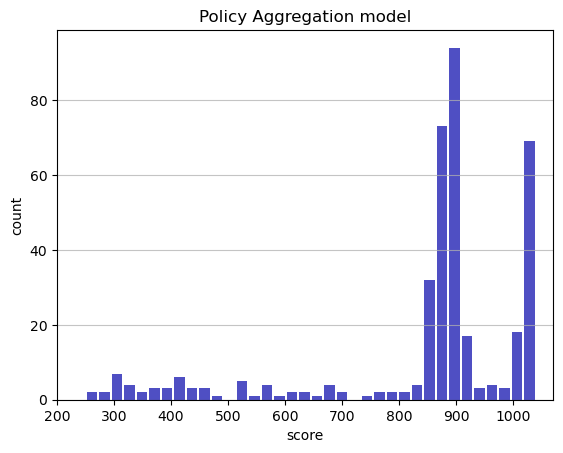

Track generation: 1147..1438 -> 291-tiles track
Epoch: 383
Policy Aggregation	mean: 851.84	variance: 185.39


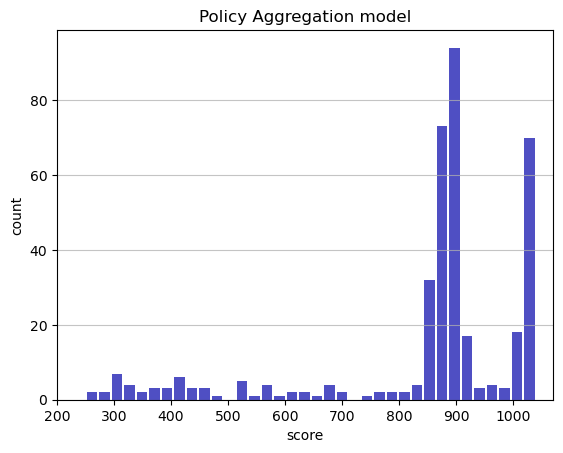

Track generation: 1138..1427 -> 289-tiles track
Epoch: 384
Policy Aggregation	mean: 850.63	variance: 186.66


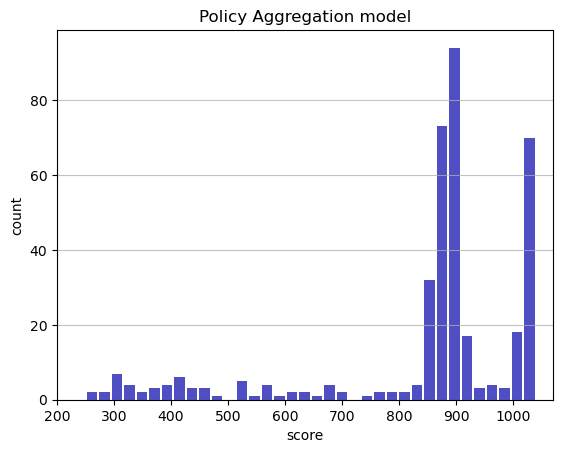

Track generation: 1095..1373 -> 278-tiles track
Epoch: 385
Policy Aggregation	mean: 850.62	variance: 186.42


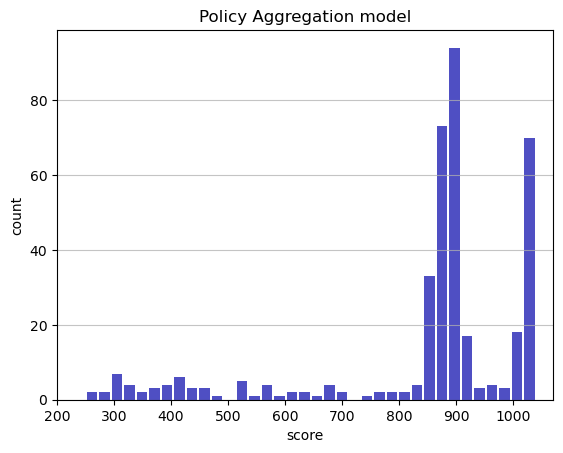

Track generation: 960..1209 -> 249-tiles track
Epoch: 386
Policy Aggregation	mean: 850.72	variance: 186.19


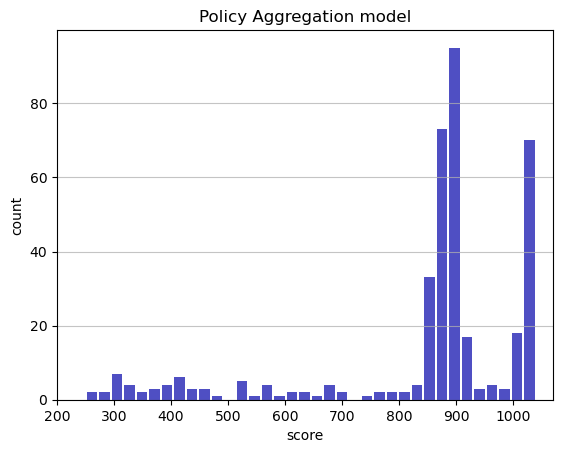

Track generation: 1054..1322 -> 268-tiles track
Epoch: 387
Policy Aggregation	mean: 850.16	variance: 186.27


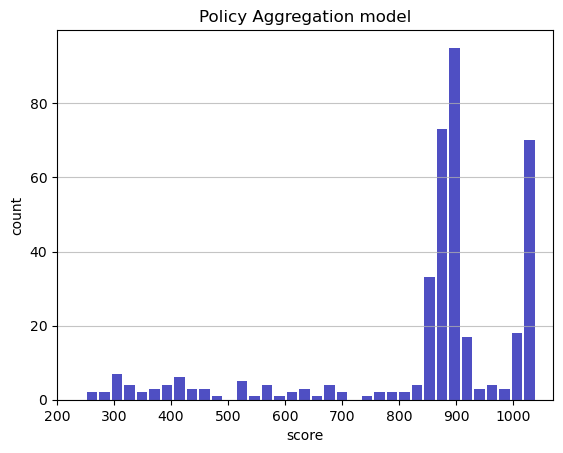

Track generation: 1304..1634 -> 330-tiles track
Epoch: 388
Policy Aggregation	mean: 850.52	variance: 186.16


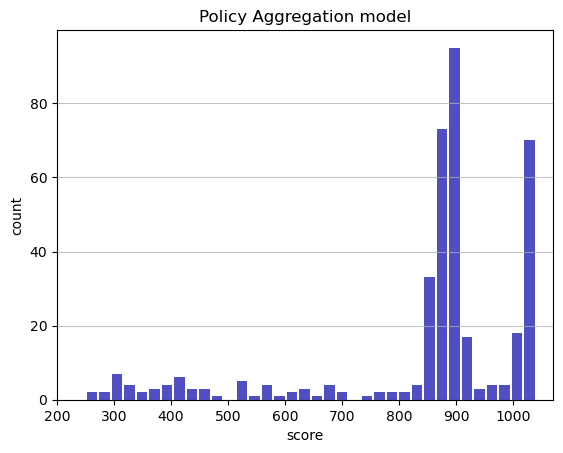

Track generation: 1180..1479 -> 299-tiles track
Epoch: 389
Policy Aggregation	mean: 850.62	variance: 185.93


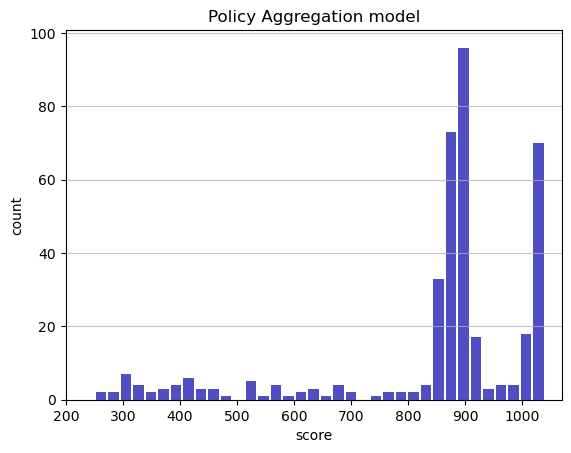

Track generation: 1286..1611 -> 325-tiles track
Epoch: 390
Policy Aggregation	mean: 851.04	variance: 185.88


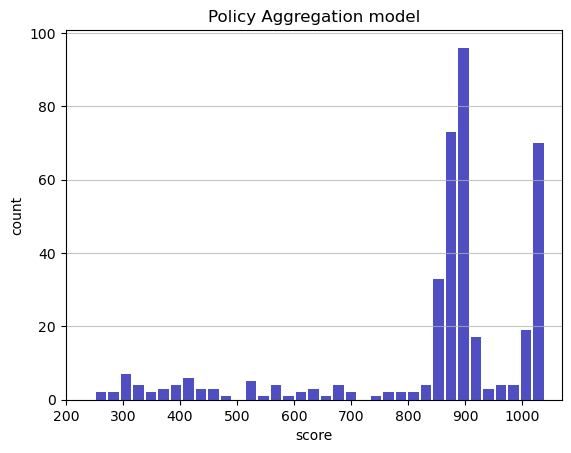

Track generation: 1107..1388 -> 281-tiles track
Epoch: 391
Policy Aggregation	mean: 851.50	variance: 185.86


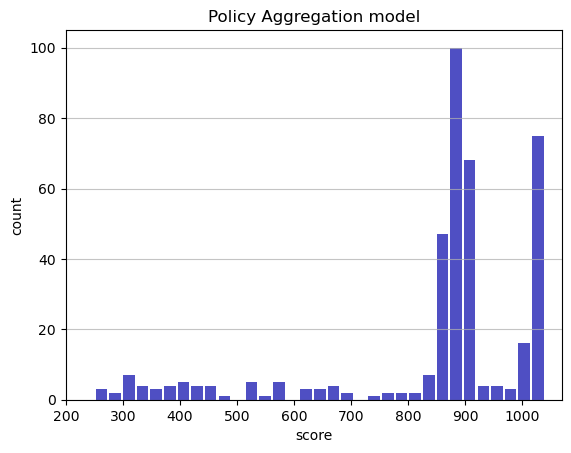

Track generation: 1080..1354 -> 274-tiles track
Epoch: 392
Policy Aggregation	mean: 851.56	variance: 185.63


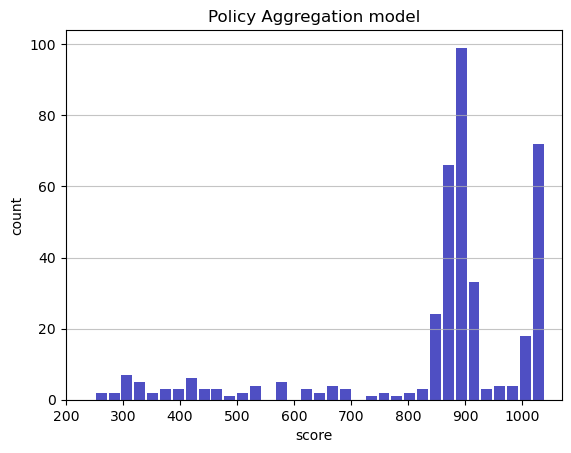

Track generation: 1048..1350 -> 302-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1120..1404 -> 284-tiles track
Epoch: 393
Policy Aggregation	mean: 852.01	variance: 185.60


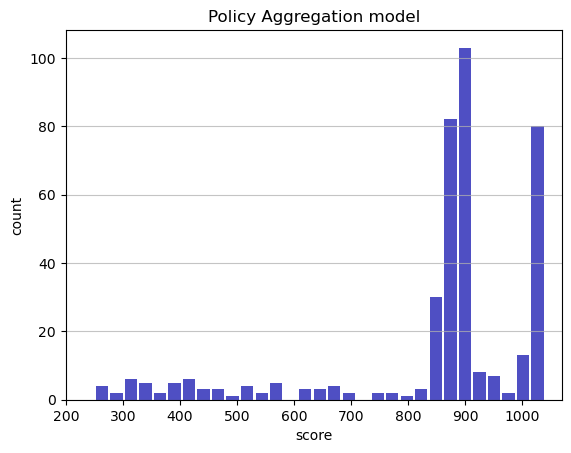

Track generation: 1071..1343 -> 272-tiles track
Epoch: 394
Policy Aggregation	mean: 852.46	variance: 185.59


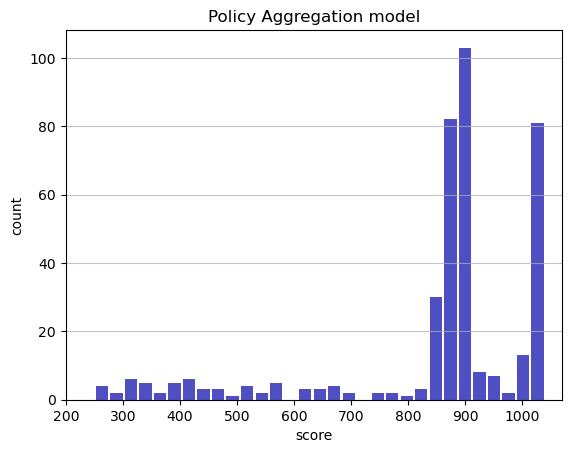

Track generation: 1003..1264 -> 261-tiles track
Epoch: 395
Policy Aggregation	mean: 852.92	variance: 185.57


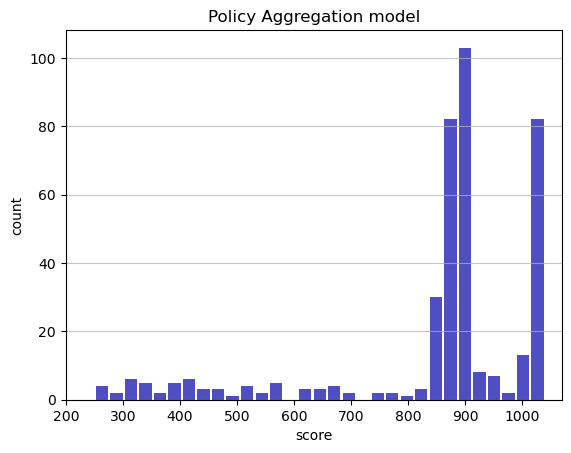

Track generation: 1057..1328 -> 271-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1204..1509 -> 305-tiles track
Epoch: 396
Policy Aggregation	mean: 852.95	variance: 185.34


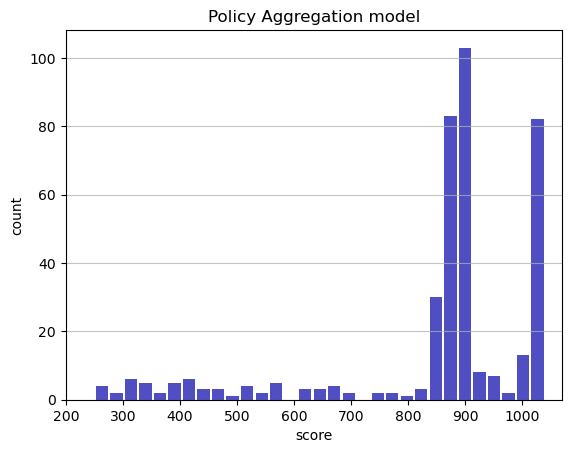

Track generation: 969..1221 -> 252-tiles track
Epoch: 397
Policy Aggregation	mean: 853.40	variance: 185.32


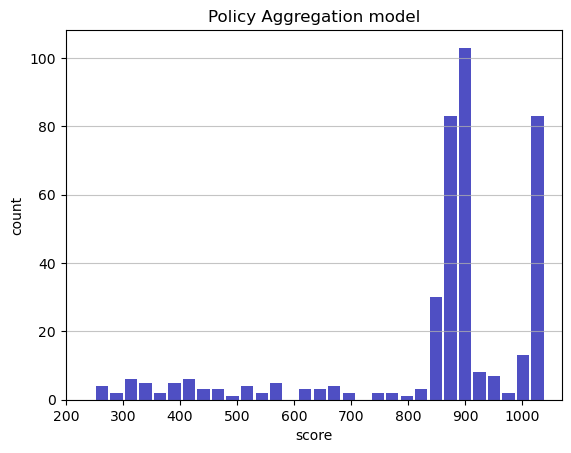

Track generation: 1090..1367 -> 277-tiles track
Epoch: 398
Policy Aggregation	mean: 853.53	variance: 185.11


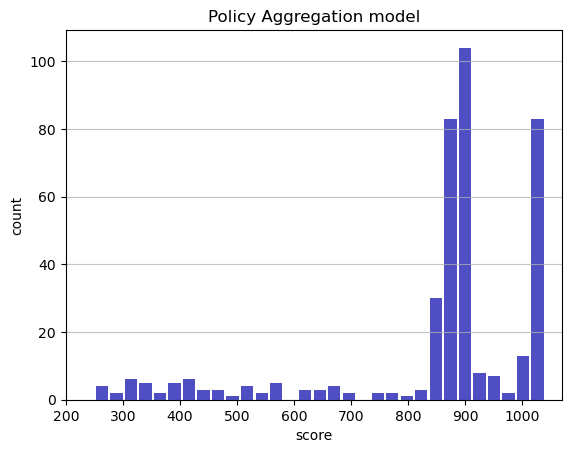

Track generation: 1104..1384 -> 280-tiles track
Epoch: 399
Policy Aggregation	mean: 853.63	variance: 184.89


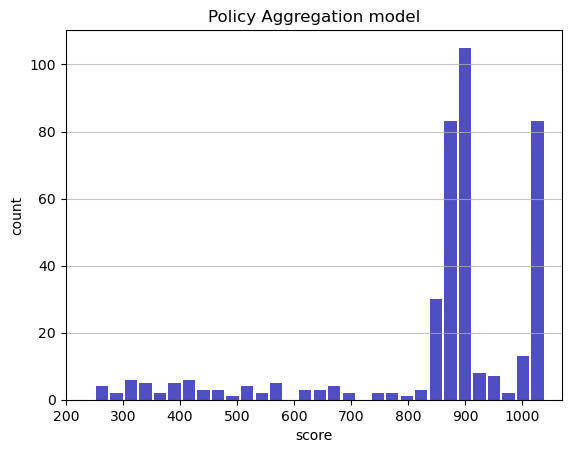

Track generation: 1012..1269 -> 257-tiles track
Epoch: 400
Policy Aggregation	mean: 854.09	variance: 184.88


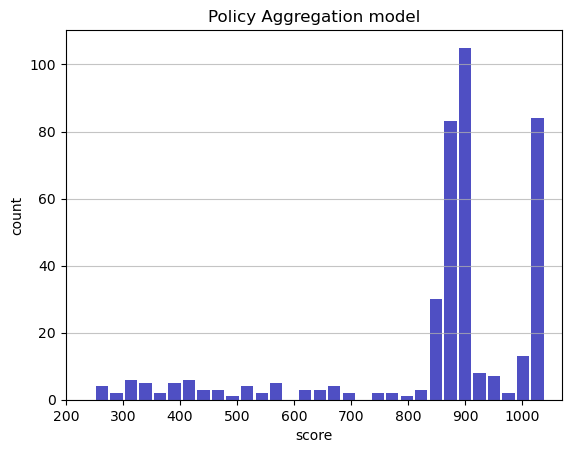

Track generation: 1134..1429 -> 295-tiles track
Epoch: 401
Policy Aggregation	mean: 854.51	variance: 184.84


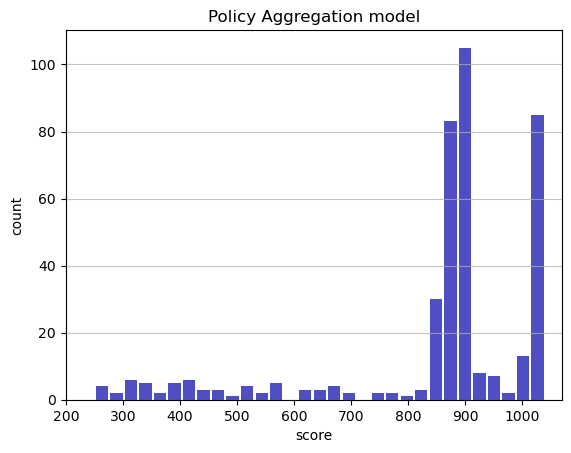

Track generation: 1030..1292 -> 262-tiles track
Epoch: 402
Policy Aggregation	mean: 854.62	variance: 184.62


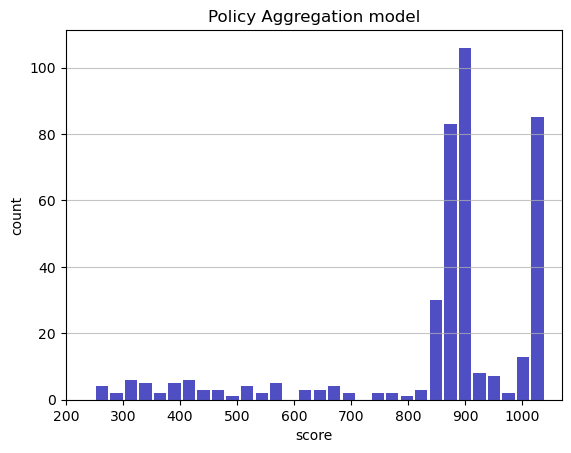

Track generation: 1271..1593 -> 322-tiles track
Epoch: 403
Policy Aggregation	mean: 855.01	variance: 184.56


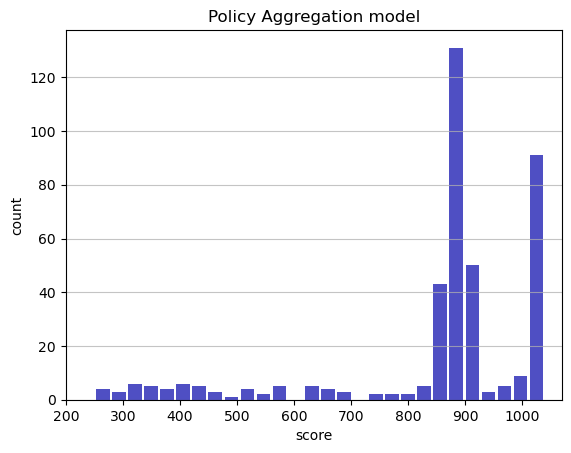

Track generation: 1151..1443 -> 292-tiles track
Epoch: 404
Policy Aggregation	mean: 855.12	variance: 184.35


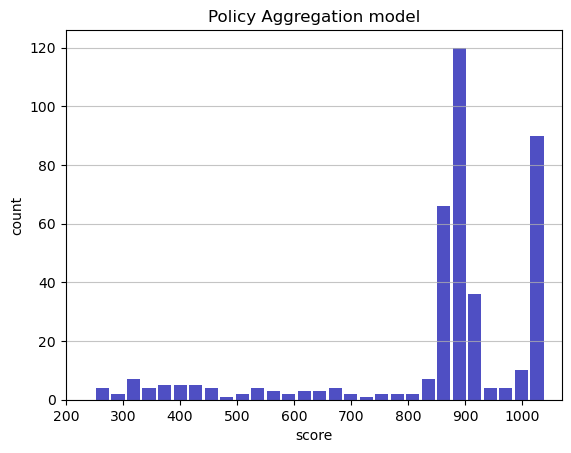

Track generation: 1209..1515 -> 306-tiles track
Epoch: 405
Policy Aggregation	mean: 853.86	variance: 185.86


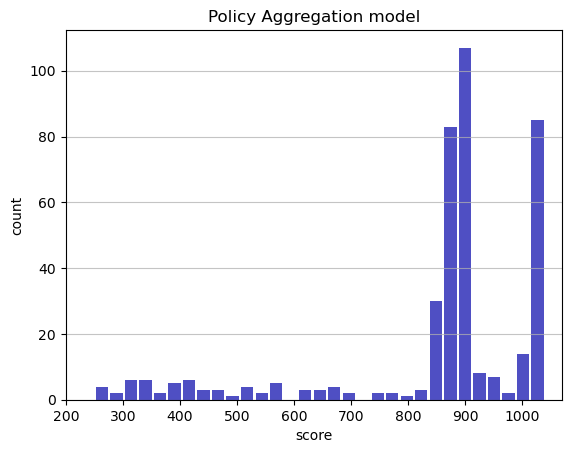

Track generation: 1081..1355 -> 274-tiles track
Epoch: 406
Policy Aggregation	mean: 853.97	variance: 185.65


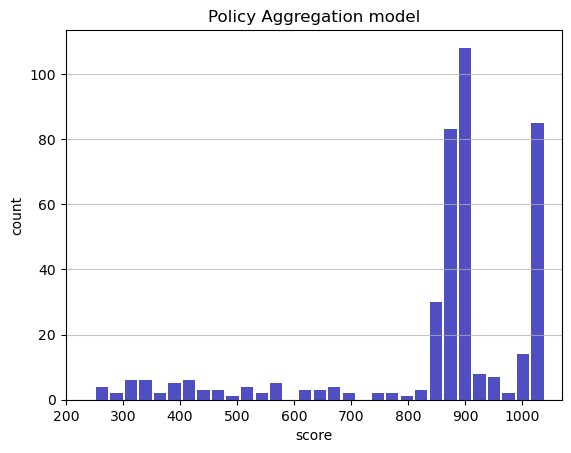

Track generation: 1251..1568 -> 317-tiles track
Epoch: 407
Policy Aggregation	mean: 854.09	variance: 185.43


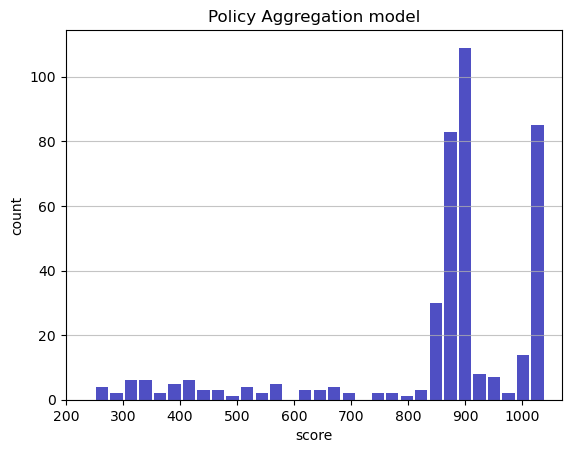

Track generation: 1213..1520 -> 307-tiles track
Epoch: 408
Policy Aggregation	mean: 854.51	variance: 185.40


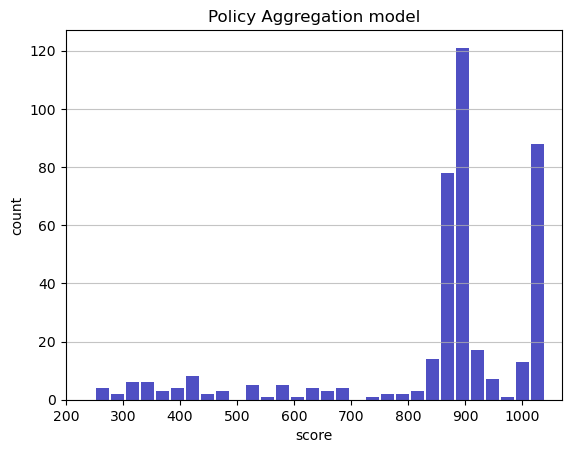

Track generation: 1125..1410 -> 285-tiles track
Epoch: 409
Policy Aggregation	mean: 853.96	variance: 185.51


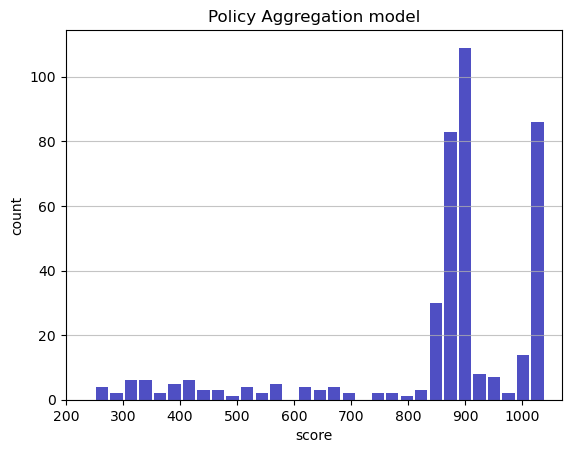

Track generation: 1170..1467 -> 297-tiles track
Epoch: 410
Policy Aggregation	mean: 854.06	variance: 185.29


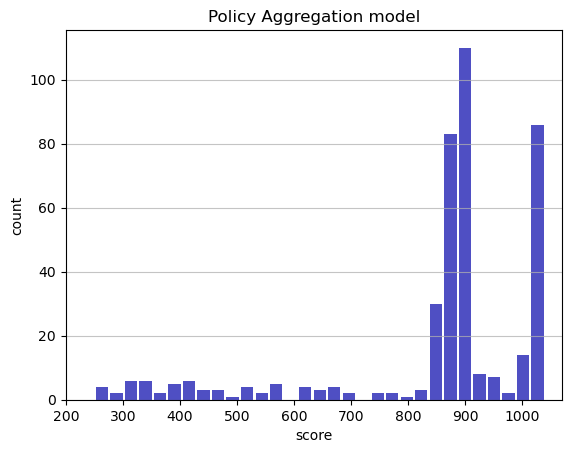

Track generation: 1134..1421 -> 287-tiles track
Epoch: 411
Policy Aggregation	mean: 854.19	variance: 185.08


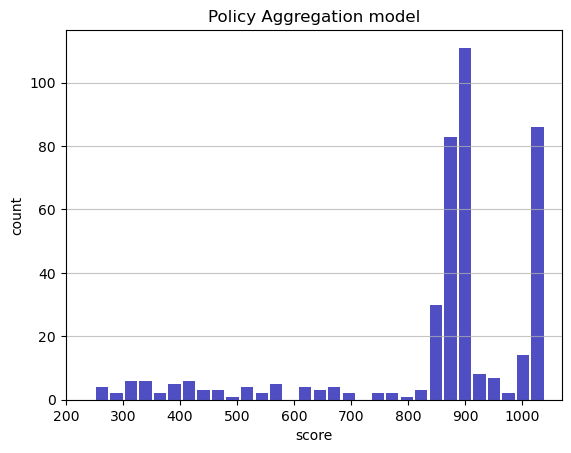

Track generation: 1060..1329 -> 269-tiles track
Epoch: 412
Policy Aggregation	mean: 854.27	variance: 184.87


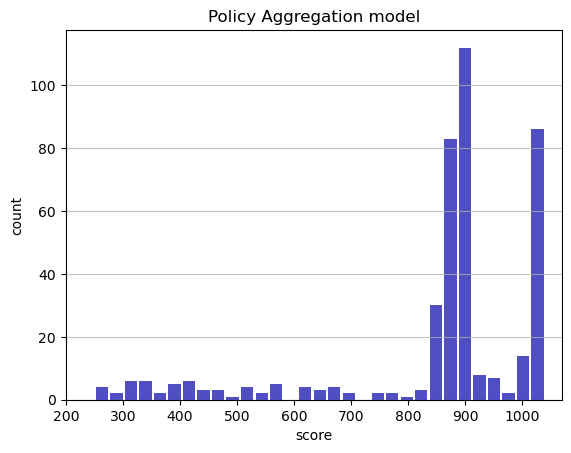

Track generation: 1037..1307 -> 270-tiles track
Epoch: 413
Policy Aggregation	mean: 854.34	variance: 184.65


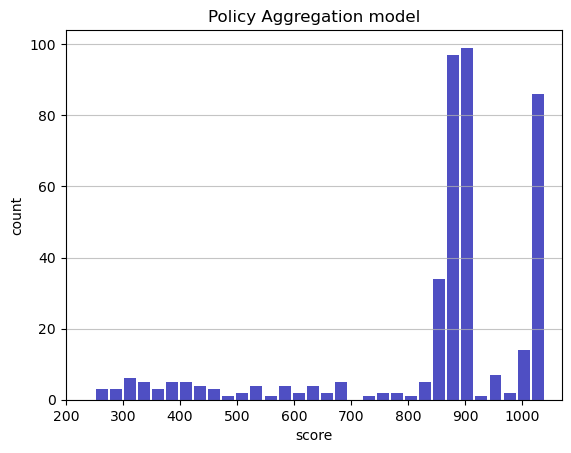

Track generation: 1156..1449 -> 293-tiles track
Epoch: 414
Policy Aggregation	mean: 854.76	variance: 184.63


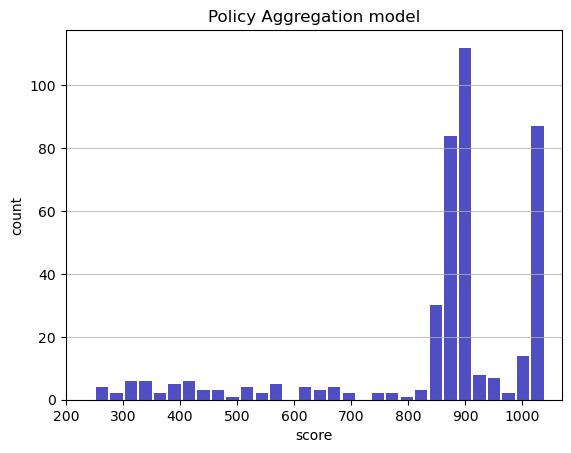

Track generation: 1140..1431 -> 291-tiles track
Epoch: 415
Policy Aggregation	mean: 853.40	variance: 186.48


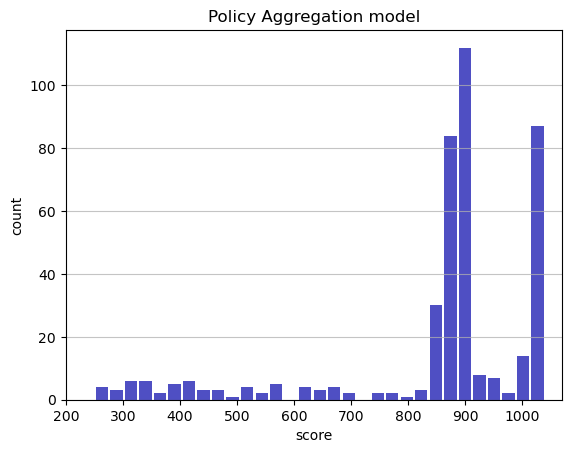

Track generation: 1156..1449 -> 293-tiles track
Epoch: 416
Policy Aggregation	mean: 853.53	variance: 186.27


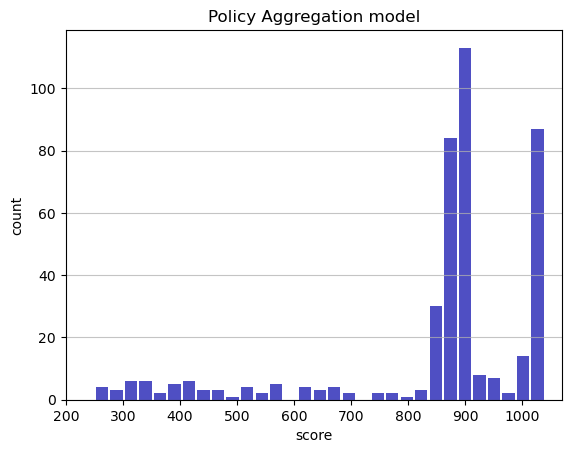

Track generation: 1127..1413 -> 286-tiles track
Epoch: 417
Policy Aggregation	mean: 853.60	variance: 186.05


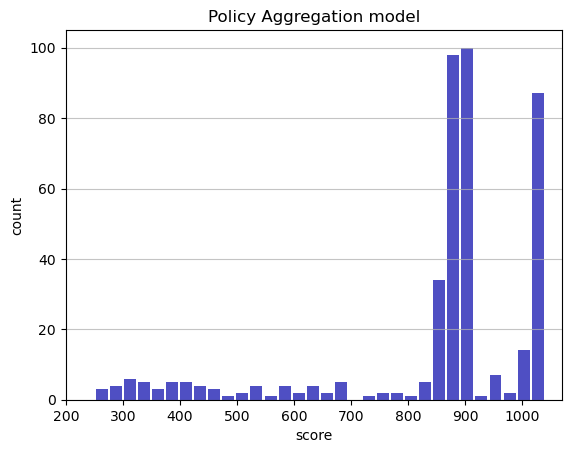

Track generation: 1010..1271 -> 261-tiles track
Epoch: 418
Policy Aggregation	mean: 853.73	variance: 185.85


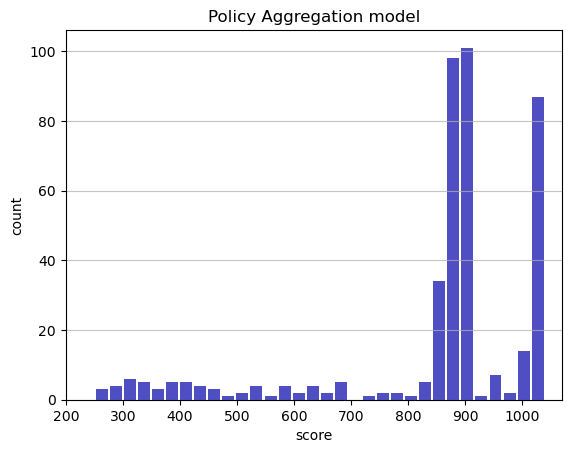

Track generation: 1204..1509 -> 305-tiles track
Epoch: 419
Policy Aggregation	mean: 853.85	variance: 185.64


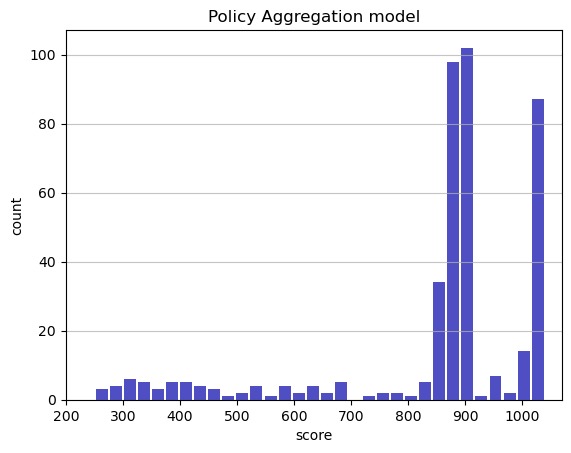

Track generation: 1152..1444 -> 292-tiles track
Epoch: 420
Policy Aggregation	mean: 853.84	variance: 185.42


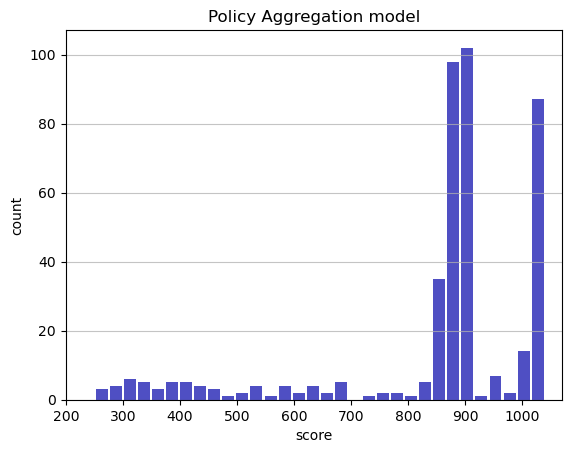

Track generation: 1050..1324 -> 274-tiles track
Epoch: 421
Policy Aggregation	mean: 854.25	variance: 185.39


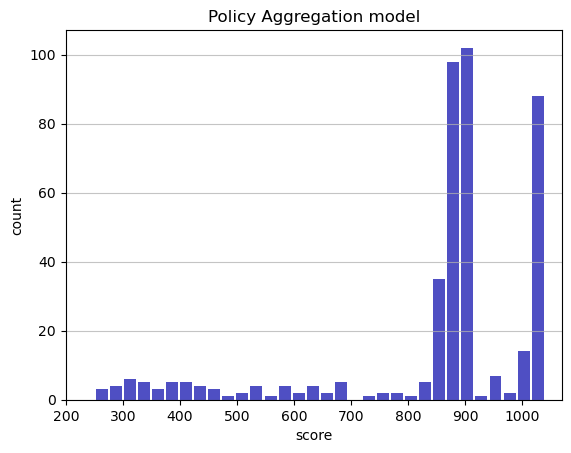

Track generation: 1039..1303 -> 264-tiles track
Epoch: 422
Policy Aggregation	mean: 854.33	variance: 185.18


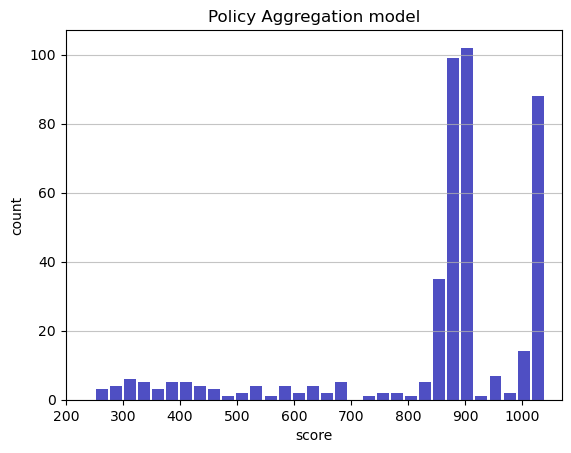

Track generation: 1221..1530 -> 309-tiles track
Epoch: 423
Policy Aggregation	mean: 854.41	variance: 184.97


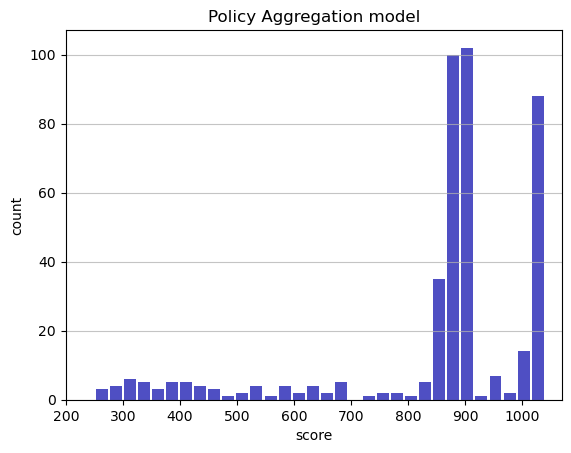

Track generation: 1046..1312 -> 266-tiles track
Epoch: 424
Policy Aggregation	mean: 853.43	variance: 185.83


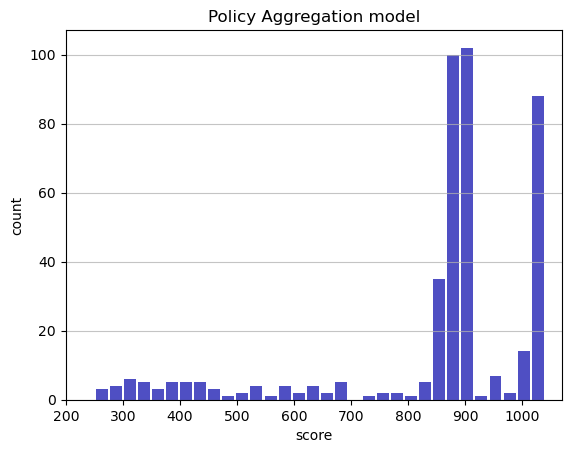

Track generation: 1127..1413 -> 286-tiles track
Epoch: 425
Policy Aggregation	mean: 853.57	variance: 185.63


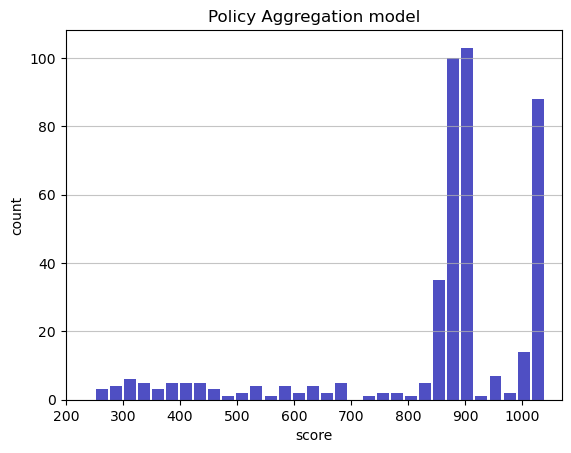

Track generation: 1187..1488 -> 301-tiles track
Epoch: 426
Policy Aggregation	mean: 853.67	variance: 185.43


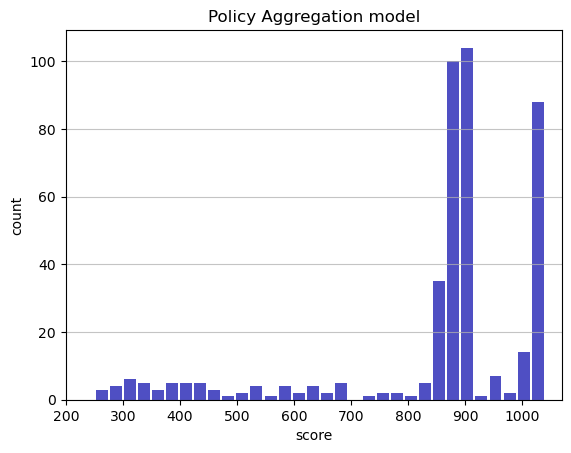

Track generation: 1123..1408 -> 285-tiles track
Epoch: 427
Policy Aggregation	mean: 853.81	variance: 185.23


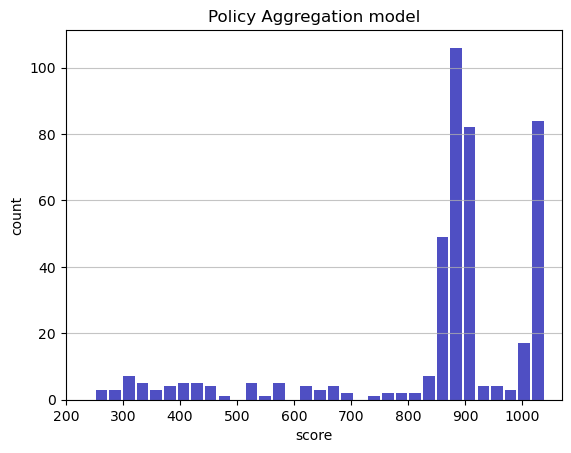

Track generation: 1064..1334 -> 270-tiles track
Epoch: 428
Policy Aggregation	mean: 854.23	variance: 185.22


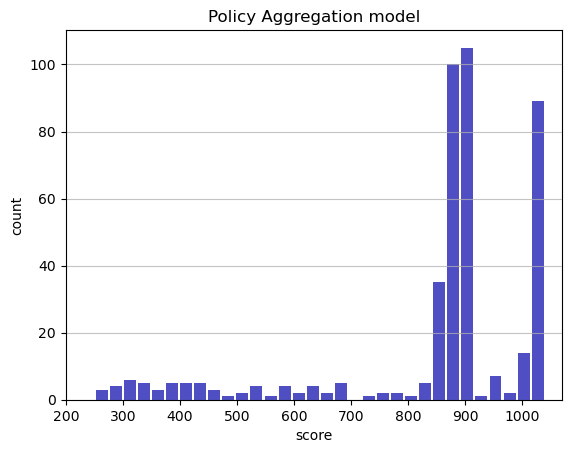

Track generation: 1187..1488 -> 301-tiles track
Epoch: 429
Policy Aggregation	mean: 854.33	variance: 185.01


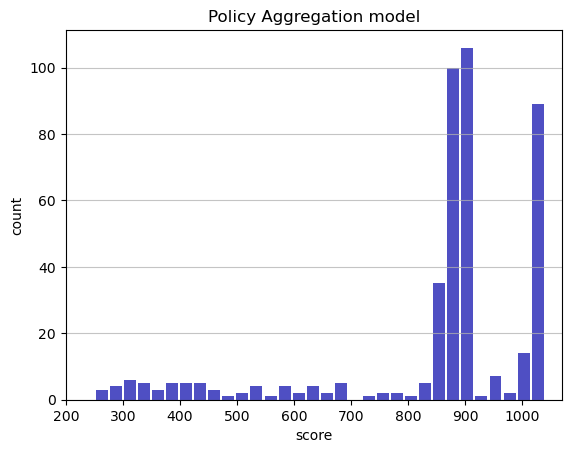

Track generation: 1373..1720 -> 347-tiles track
Epoch: 430
Policy Aggregation	mean: 854.54	variance: 184.85


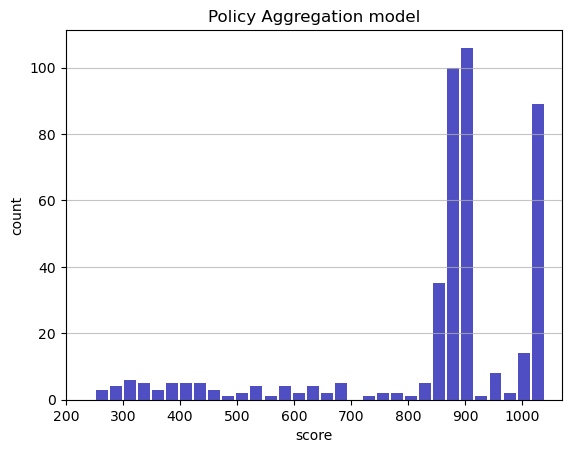

Track generation: 1243..1558 -> 315-tiles track
Epoch: 431
Policy Aggregation	mean: 854.92	variance: 184.80


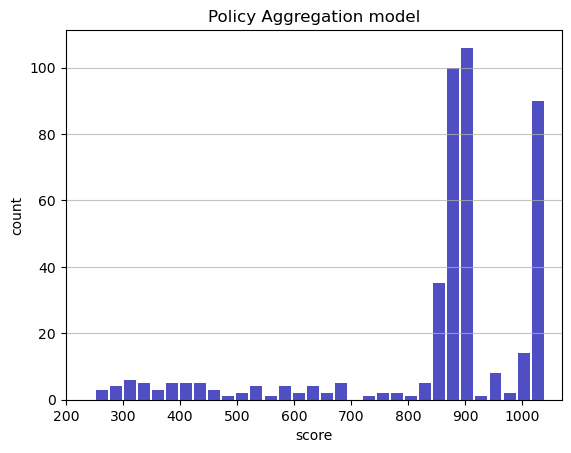

Track generation: 1210..1525 -> 315-tiles track
Epoch: 432
Policy Aggregation	mean: 854.97	variance: 184.59


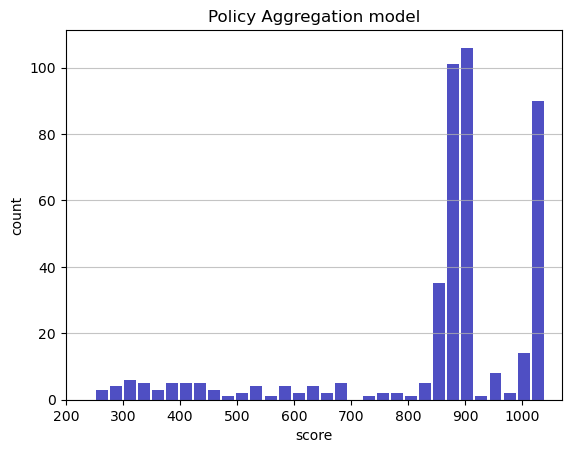

Track generation: 1103..1389 -> 286-tiles track
Epoch: 433
Policy Aggregation	mean: 854.22	variance: 185.03


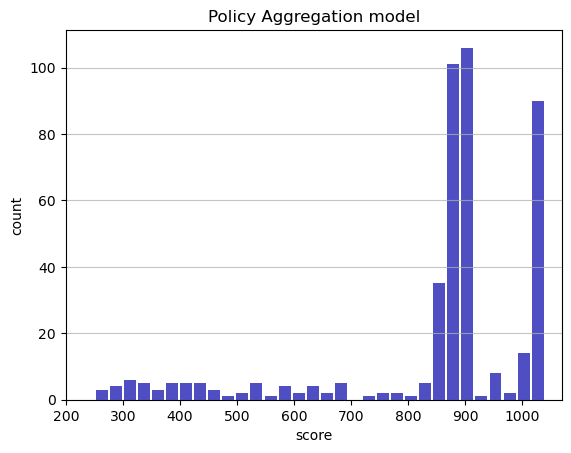

Track generation: 1040..1304 -> 264-tiles track
Epoch: 434
Policy Aggregation	mean: 854.27	variance: 184.82


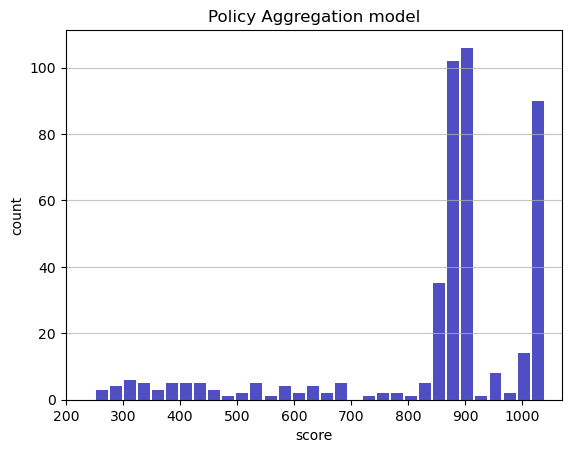

Track generation: 1046..1315 -> 269-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1176..1474 -> 298-tiles track
Epoch: 435
Policy Aggregation	mean: 854.36	variance: 184.62


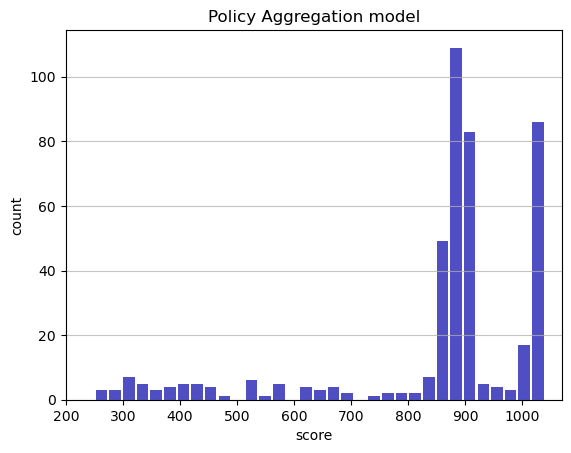

Track generation: 1015..1273 -> 258-tiles track
Epoch: 436
Policy Aggregation	mean: 854.43	variance: 184.41


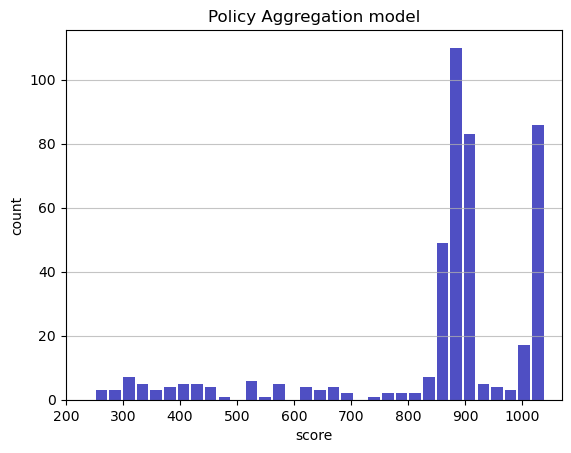

Track generation: 997..1250 -> 253-tiles track
Epoch: 437
Policy Aggregation	mean: 854.55	variance: 184.22


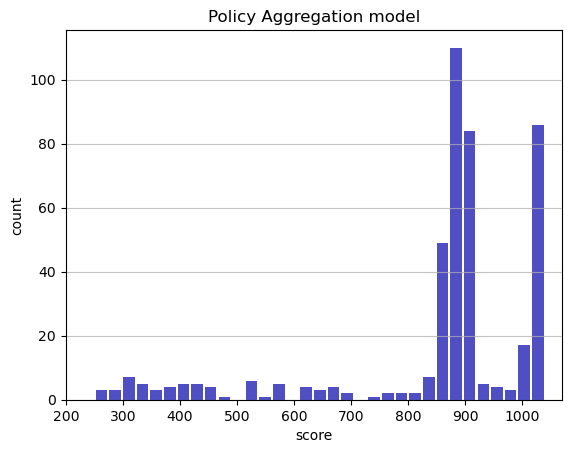

Track generation: 1379..1727 -> 348-tiles track
Epoch: 438
Policy Aggregation	mean: 854.90	variance: 184.15


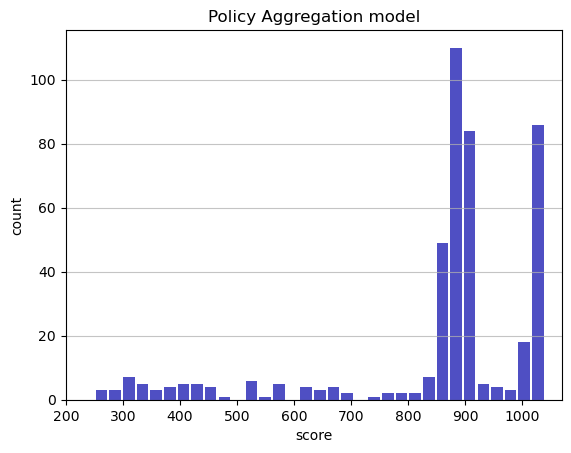

Track generation: 1122..1407 -> 285-tiles track
Epoch: 439
Policy Aggregation	mean: 855.29	variance: 184.13


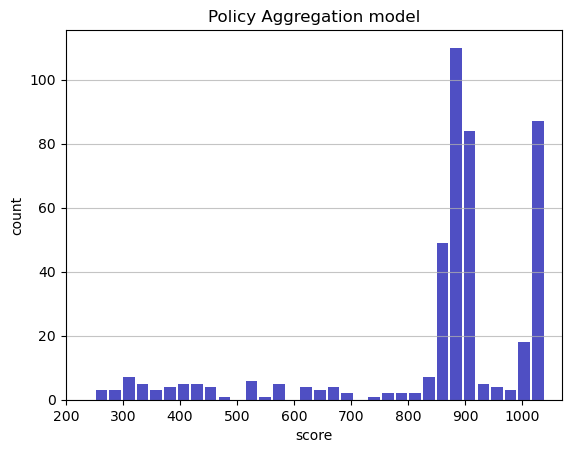

Track generation: 1284..1609 -> 325-tiles track
Epoch: 440
Policy Aggregation	mean: 855.32	variance: 183.92


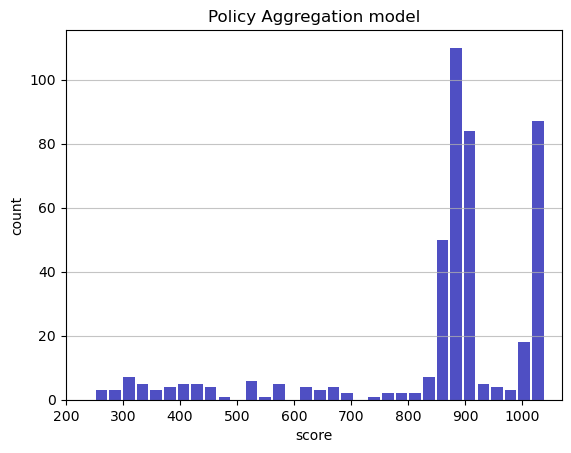

Track generation: 996..1256 -> 260-tiles track
Epoch: 441
Policy Aggregation	mean: 855.37	variance: 183.71


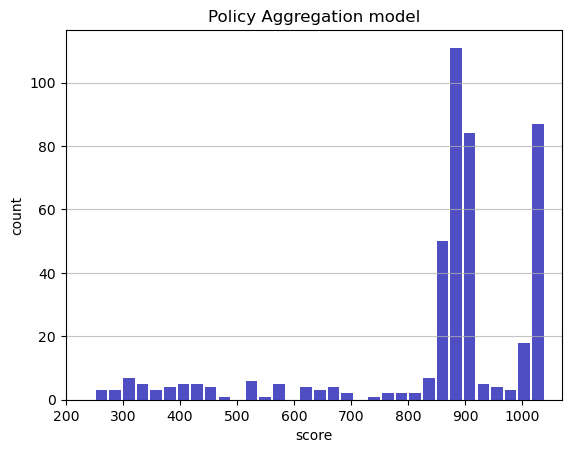

Track generation: 1194..1496 -> 302-tiles track
Epoch: 442
Policy Aggregation	mean: 855.37	variance: 183.50


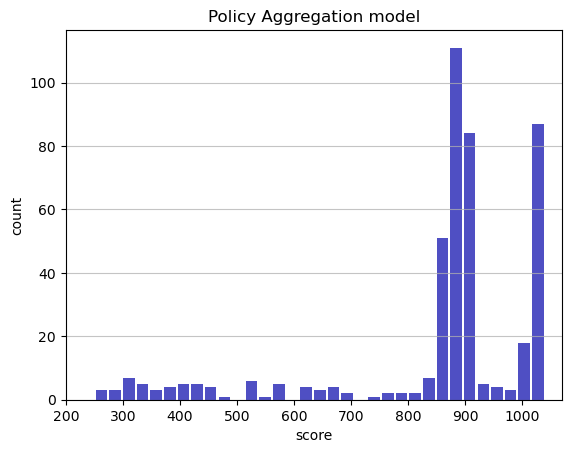

Track generation: 987..1243 -> 256-tiles track
Epoch: 443
Policy Aggregation	mean: 855.48	variance: 183.31


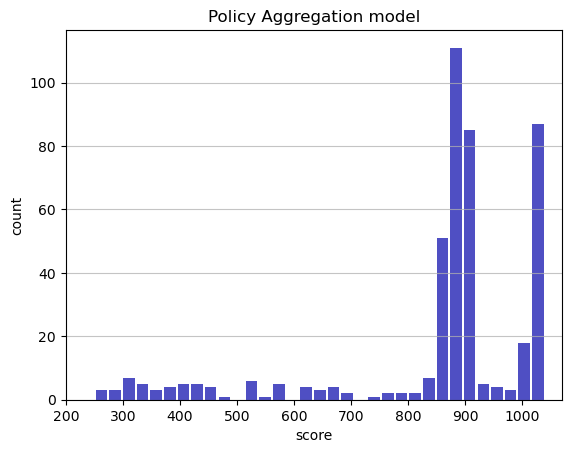

Track generation: 1083..1358 -> 275-tiles track
Epoch: 444
Policy Aggregation	mean: 855.57	variance: 183.12


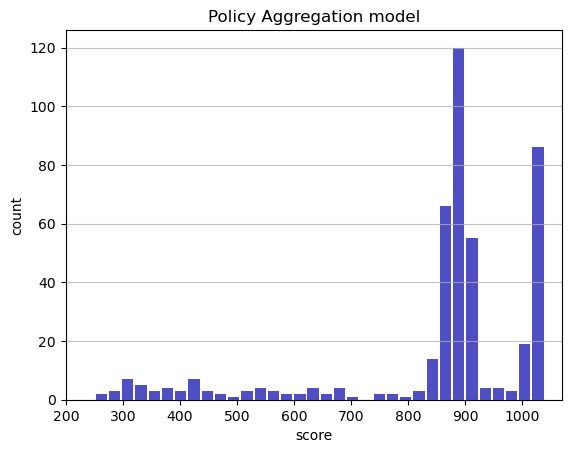

Track generation: 976..1224 -> 248-tiles track
Epoch: 445
Policy Aggregation	mean: 855.68	variance: 182.92


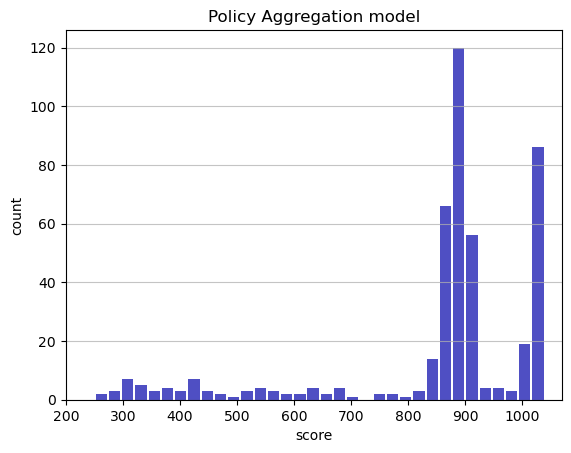

Track generation: 1055..1330 -> 275-tiles track
Epoch: 446
Policy Aggregation	mean: 855.76	variance: 182.73


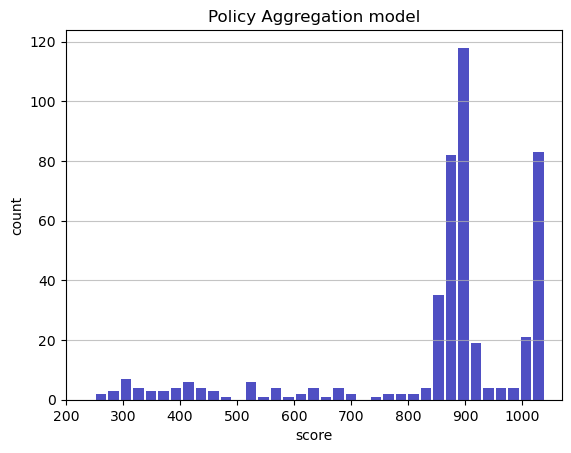

Track generation: 1089..1373 -> 284-tiles track
Epoch: 447
Policy Aggregation	mean: 855.79	variance: 182.52


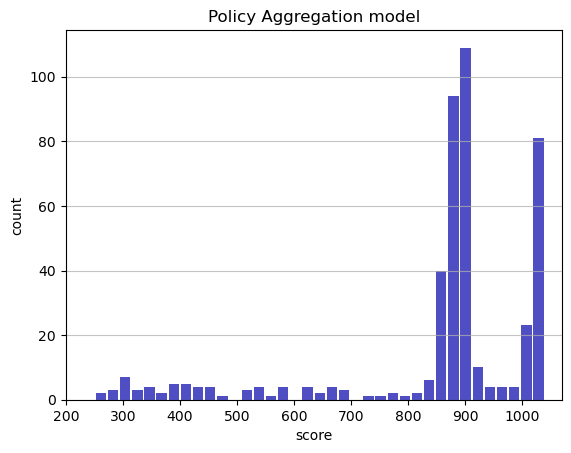

Track generation: 1083..1358 -> 275-tiles track
Epoch: 448
Policy Aggregation	mean: 855.86	variance: 182.33


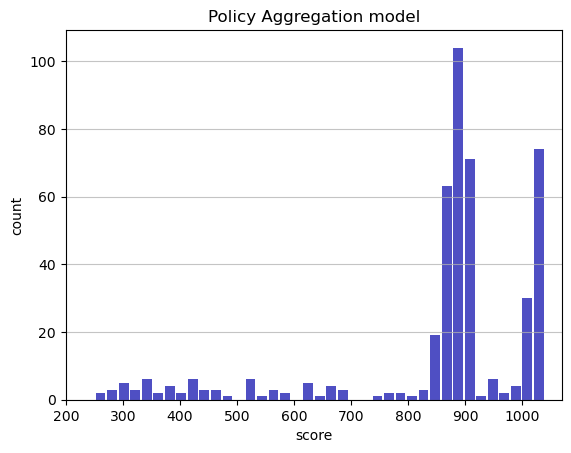

Track generation: 1112..1394 -> 282-tiles track
Epoch: 449
Policy Aggregation	mean: 854.64	variance: 183.94


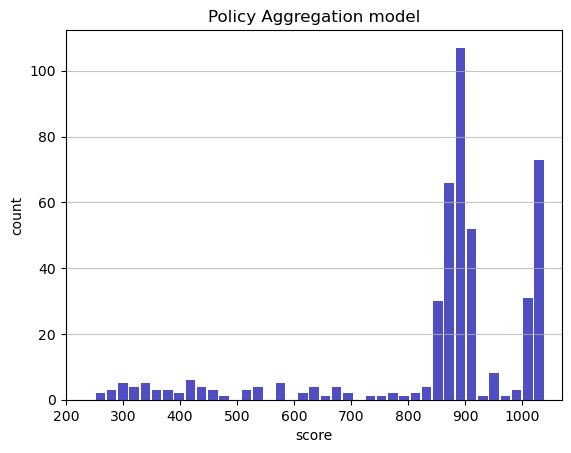

Track generation: 1140..1429 -> 289-tiles track
Epoch: 450
Policy Aggregation	mean: 854.23	variance: 183.94


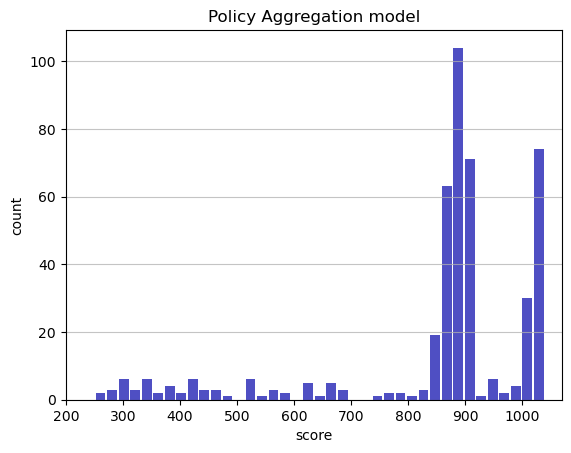

Track generation: 1195..1498 -> 303-tiles track
Epoch: 451
Policy Aggregation	mean: 853.92	variance: 183.85


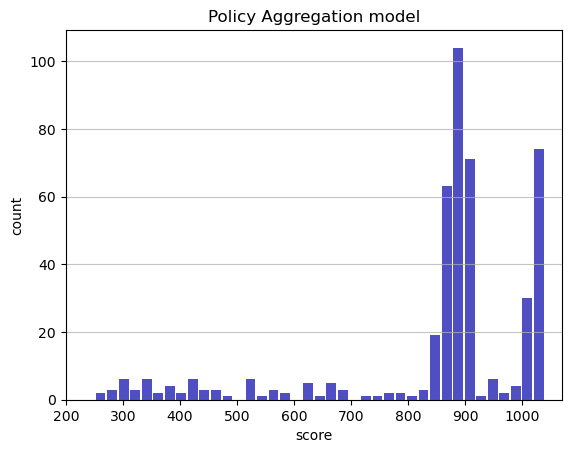

Track generation: 1160..1454 -> 294-tiles track
Epoch: 452
Policy Aggregation	mean: 853.99	variance: 183.66


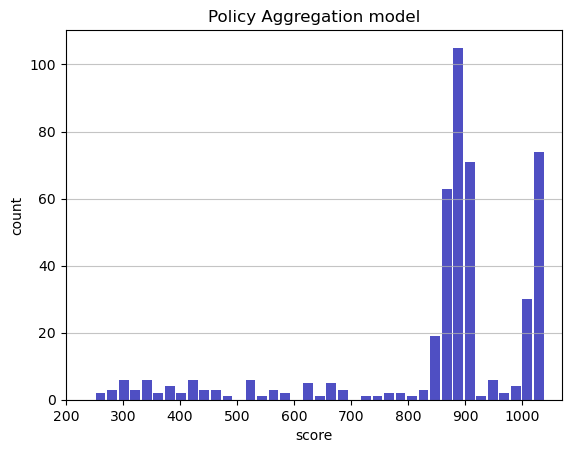

Track generation: 1164..1459 -> 295-tiles track
Epoch: 453
Policy Aggregation	mean: 853.59	variance: 183.65


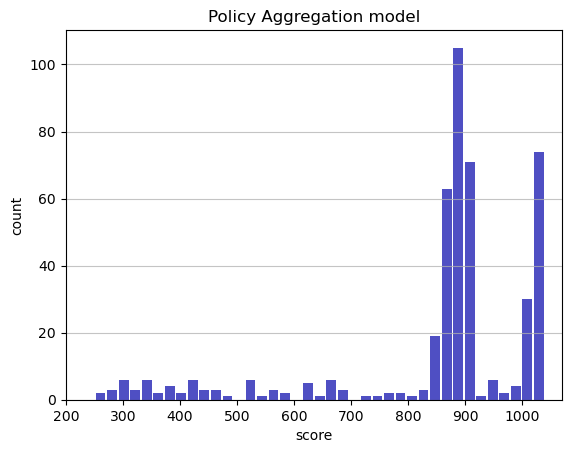

Track generation: 1092..1369 -> 277-tiles track
Epoch: 454
Policy Aggregation	mean: 852.62	variance: 184.61


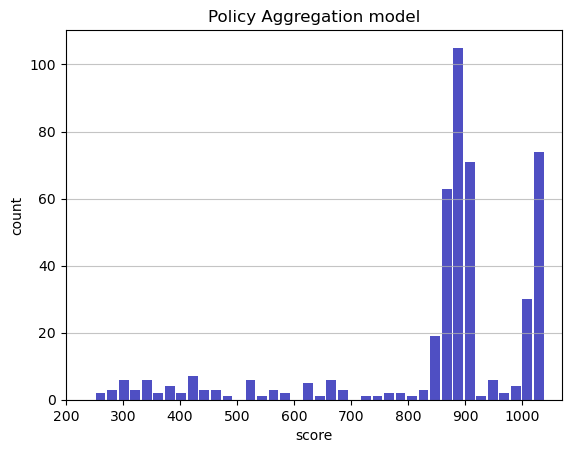

Track generation: 1185..1486 -> 301-tiles track
Epoch: 455
Policy Aggregation	mean: 852.69	variance: 184.41


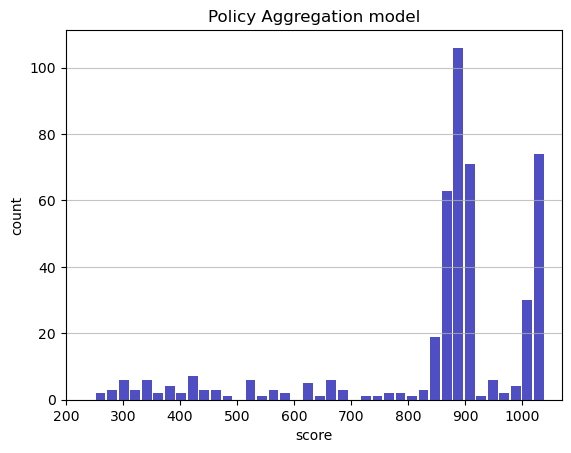

Track generation: 1141..1435 -> 294-tiles track
Epoch: 456
Policy Aggregation	mean: 852.75	variance: 184.21


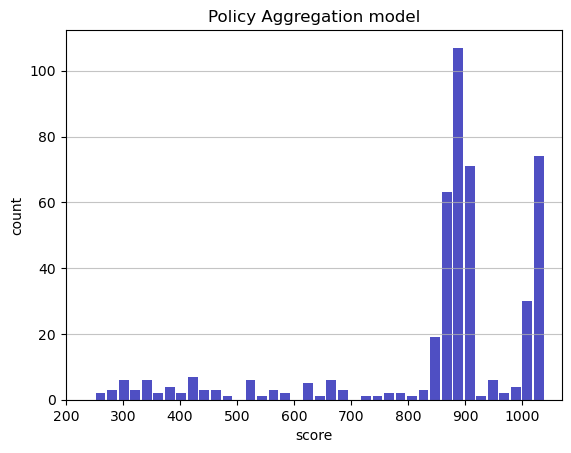

Track generation: 1261..1587 -> 326-tiles track
Epoch: 457
Policy Aggregation	mean: 853.01	variance: 184.09


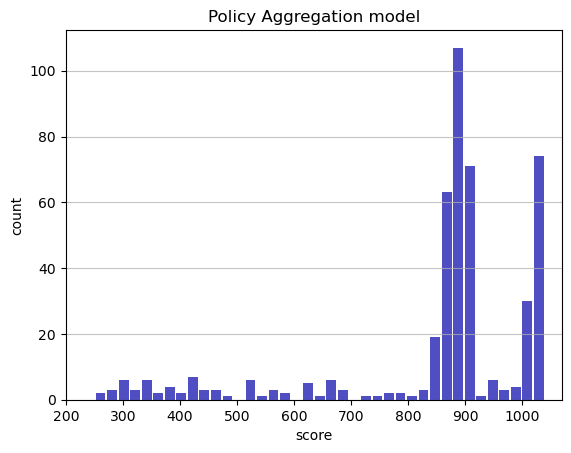

Track generation: 1048..1324 -> 276-tiles track
Epoch: 458
Policy Aggregation	mean: 853.38	variance: 184.07


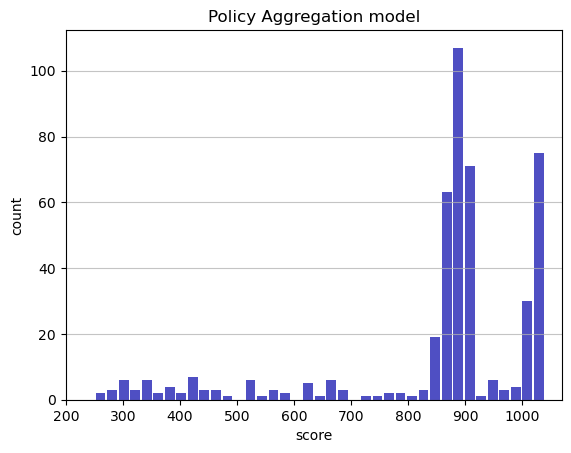

Track generation: 1008..1264 -> 256-tiles track
Epoch: 459
Policy Aggregation	mean: 852.34	variance: 185.23


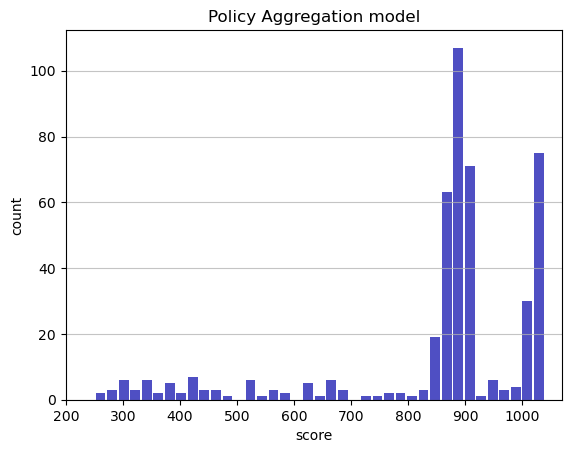

Track generation: 1118..1401 -> 283-tiles track
Epoch: 460
Policy Aggregation	mean: 852.46	variance: 185.05


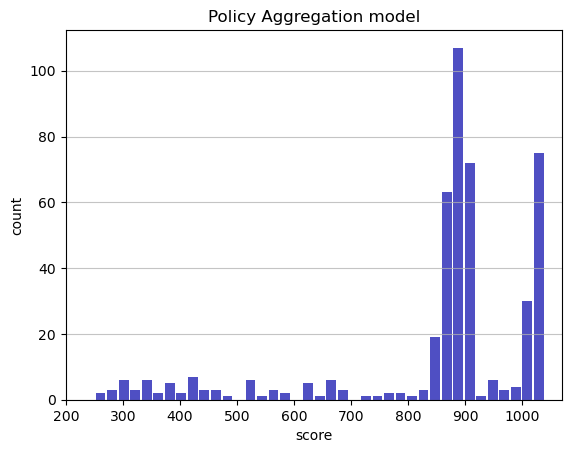

Track generation: 1388..1739 -> 351-tiles track
Epoch: 461
Policy Aggregation	mean: 852.78	variance: 184.98


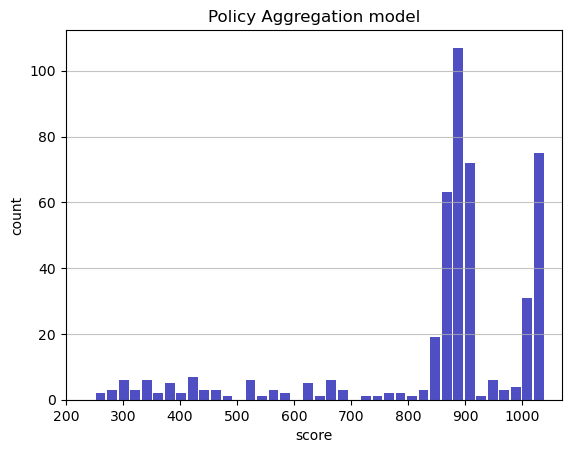

Track generation: 1179..1478 -> 299-tiles track
Epoch: 462
Policy Aggregation	mean: 852.89	variance: 184.79


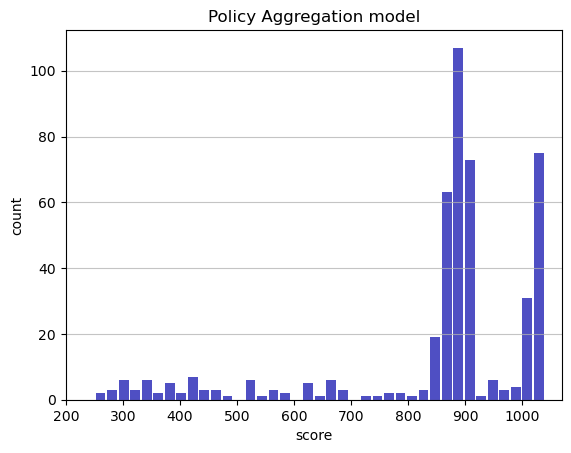

Track generation: 1067..1338 -> 271-tiles track
Epoch: 463
Policy Aggregation	mean: 853.27	variance: 184.77


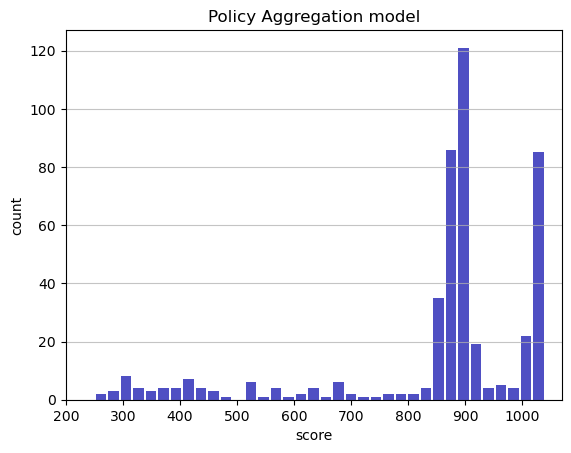

Track generation: 1208..1514 -> 306-tiles track
Epoch: 464
Policy Aggregation	mean: 853.63	variance: 184.74


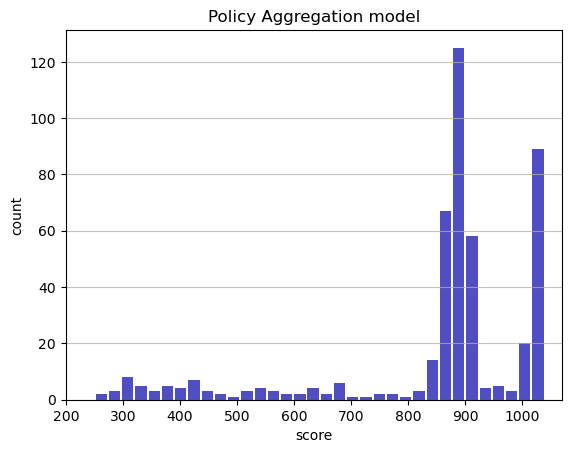

Track generation: 1042..1307 -> 265-tiles track
Epoch: 465
Policy Aggregation	mean: 853.74	variance: 184.55


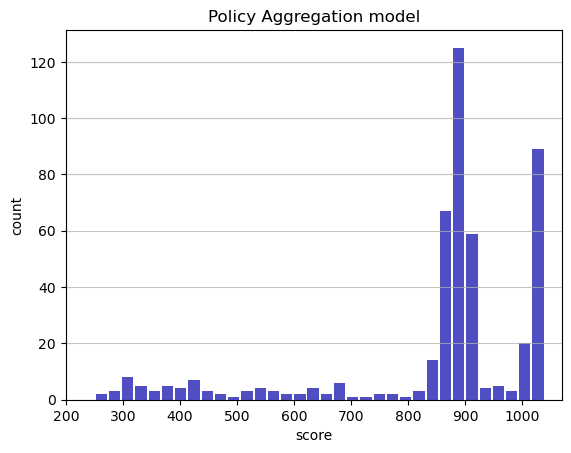

Track generation: 1316..1649 -> 333-tiles track
Epoch: 466
Policy Aggregation	mean: 853.84	variance: 184.37


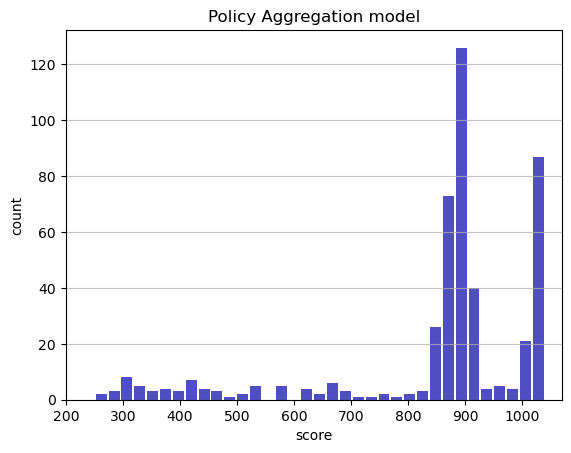

Track generation: 1352..1694 -> 342-tiles track
Epoch: 467
Policy Aggregation	mean: 854.08	variance: 184.25


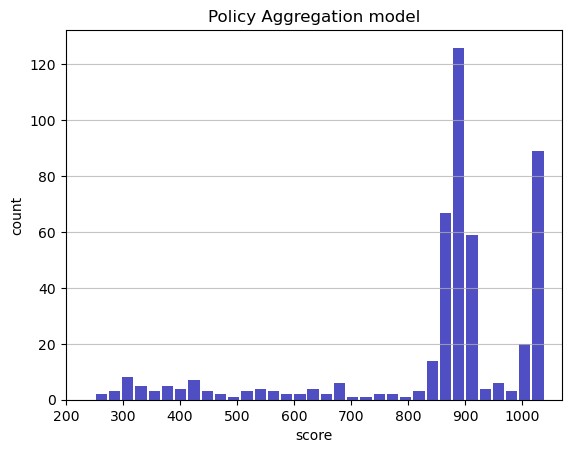

Track generation: 1090..1367 -> 277-tiles track
Epoch: 468
Policy Aggregation	mean: 854.45	variance: 184.22


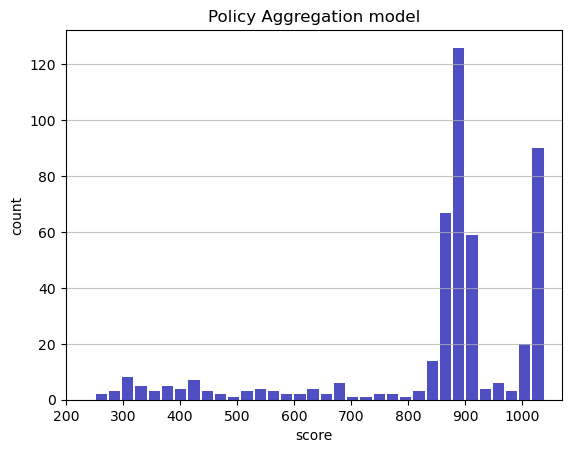

Track generation: 1204..1509 -> 305-tiles track
Epoch: 469
Policy Aggregation	mean: 854.53	variance: 184.03


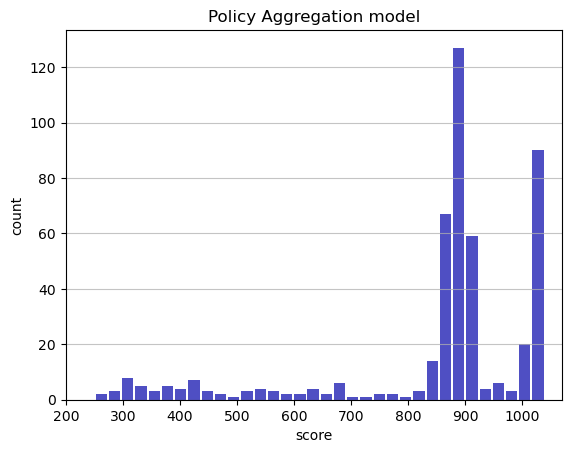

Track generation: 959..1210 -> 251-tiles track
Epoch: 470
Policy Aggregation	mean: 854.62	variance: 183.84


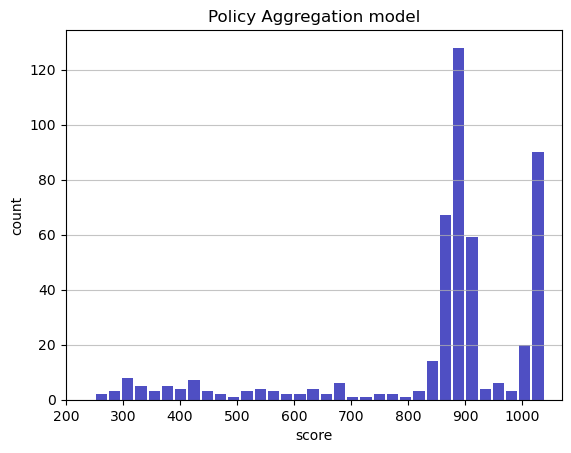

Track generation: 1084..1359 -> 275-tiles track
Epoch: 471
Policy Aggregation	mean: 854.66	variance: 183.65


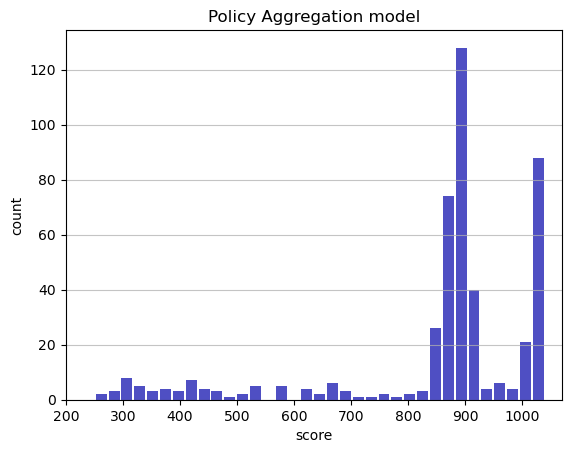

Track generation: 1061..1338 -> 277-tiles track
Epoch: 472
Policy Aggregation	mean: 854.76	variance: 183.47


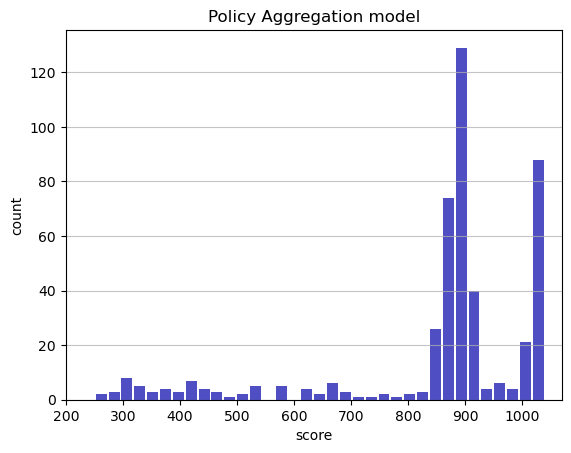

Track generation: 1120..1404 -> 284-tiles track
Epoch: 473
Policy Aggregation	mean: 854.83	variance: 183.28


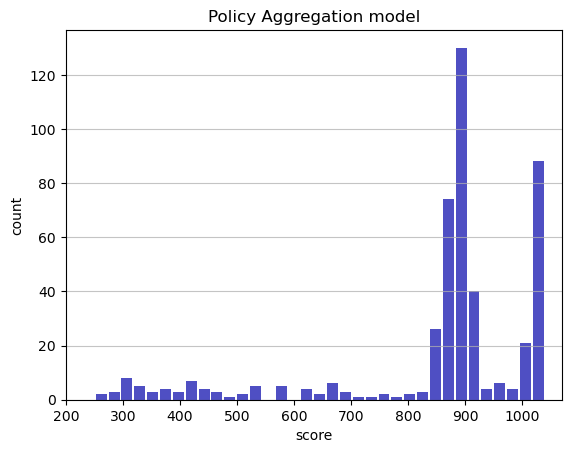

Track generation: 1065..1335 -> 270-tiles track
Epoch: 474
Policy Aggregation	mean: 854.92	variance: 183.10


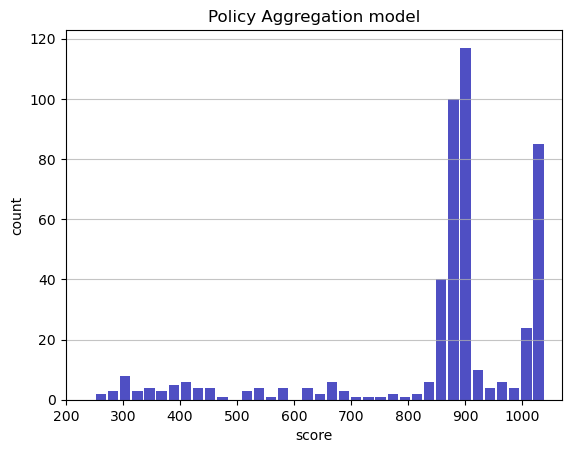

Track generation: 1064..1334 -> 270-tiles track
Epoch: 475
Policy Aggregation	mean: 854.99	variance: 182.91


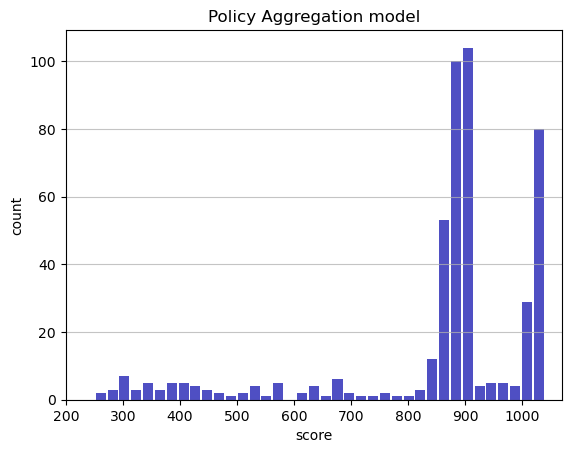

Track generation: 1109..1391 -> 282-tiles track
Epoch: 476
Policy Aggregation	mean: 855.06	variance: 182.73


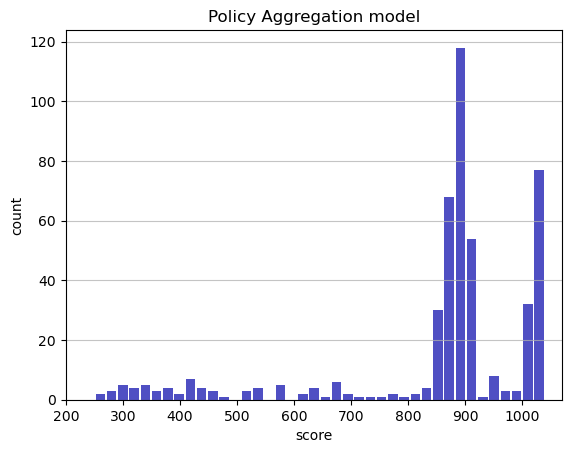

Track generation: 1084..1363 -> 279-tiles track
Epoch: 477
Policy Aggregation	mean: 855.42	variance: 182.70


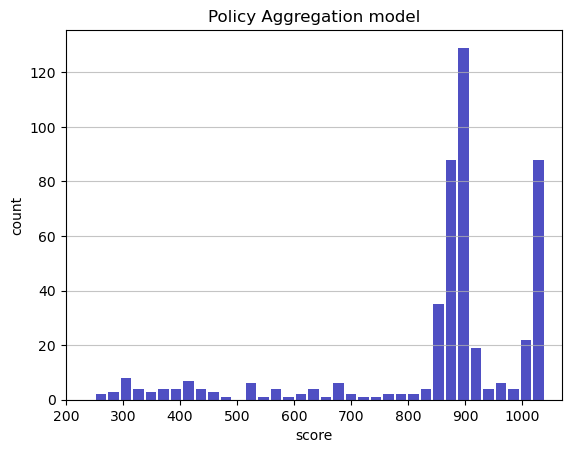

Track generation: 1181..1480 -> 299-tiles track
Epoch: 478
Policy Aggregation	mean: 855.48	variance: 182.52


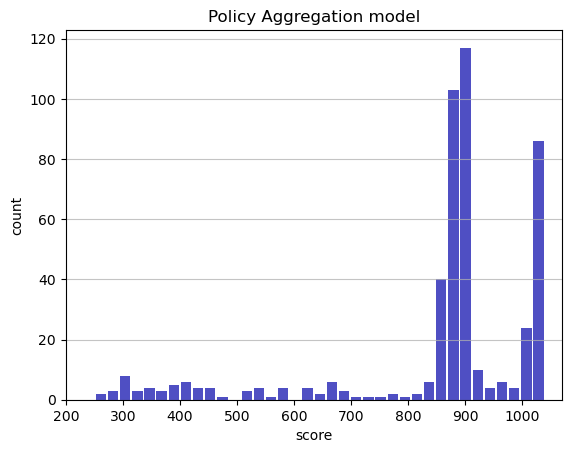

Track generation: 1072..1344 -> 272-tiles track
Epoch: 479
Policy Aggregation	mean: 855.84	variance: 182.50


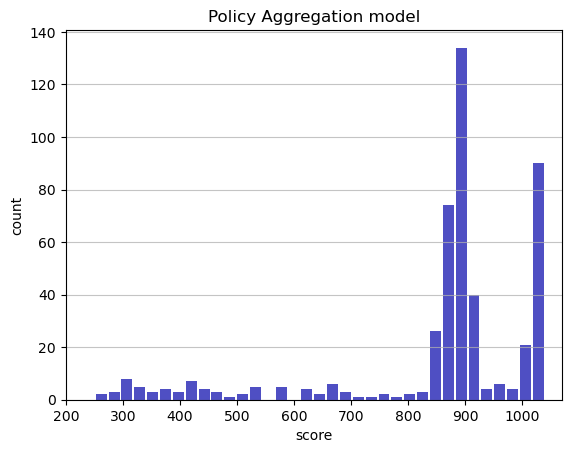

Track generation: 1299..1626 -> 327-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1252..1569 -> 317-tiles track
Epoch: 480
Policy Aggregation	mean: 854.77	variance: 183.82


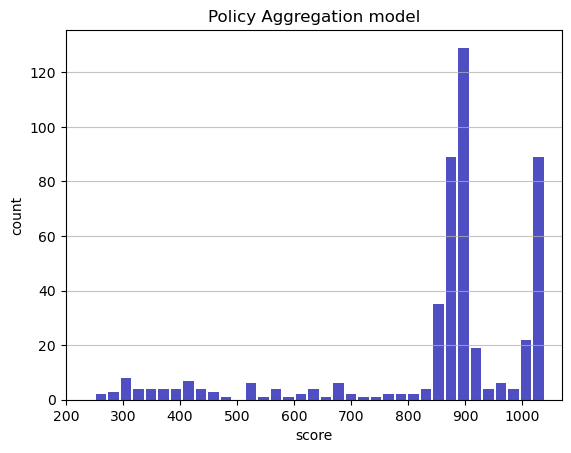

Track generation: 979..1235 -> 256-tiles track
Epoch: 481
Policy Aggregation	mean: 855.14	variance: 183.81


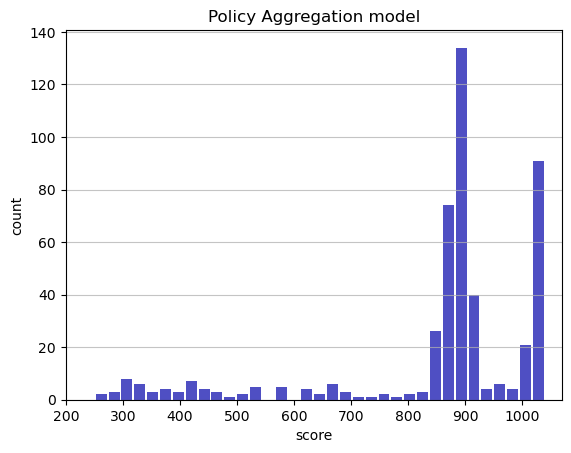

Track generation: 1044..1314 -> 270-tiles track
Epoch: 482
Policy Aggregation	mean: 855.50	variance: 183.79


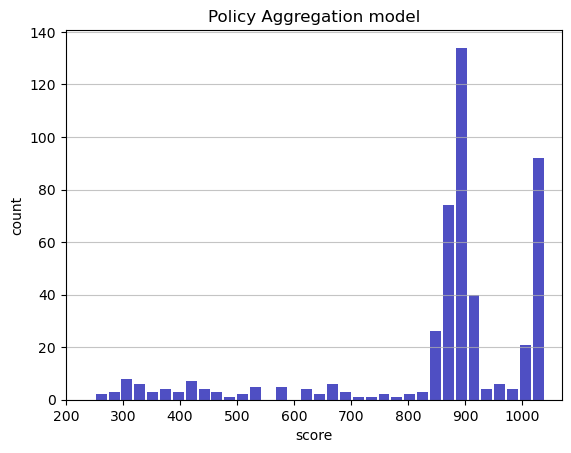

Track generation: 1063..1337 -> 274-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1137..1432 -> 295-tiles track
Epoch: 483
Policy Aggregation	mean: 855.80	variance: 183.72


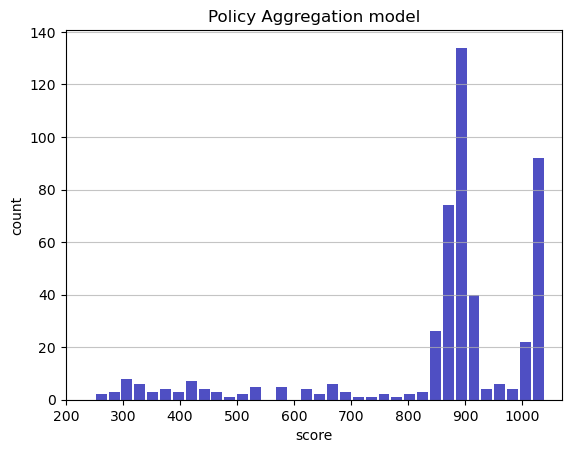

Track generation: 1224..1534 -> 310-tiles track
Epoch: 484
Policy Aggregation	mean: 855.89	variance: 183.54


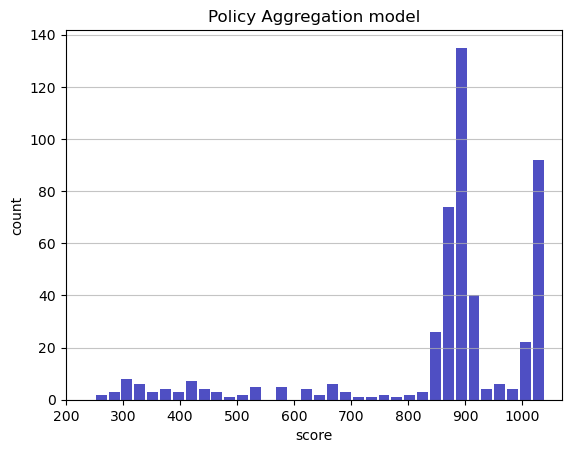

Track generation: 1180..1481 -> 301-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1100..1382 -> 282-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1104..1384 -> 280-tiles track
Epoch: 485
Policy Aggregation	mean: 855.92	variance: 183.35


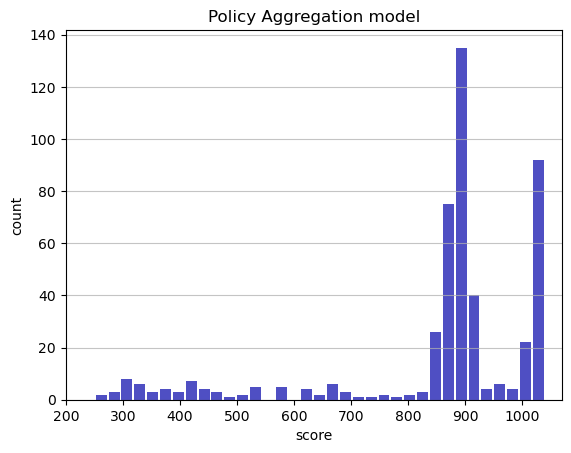

Track generation: 1075..1348 -> 273-tiles track
Epoch: 486
Policy Aggregation	mean: 854.86	variance: 184.63


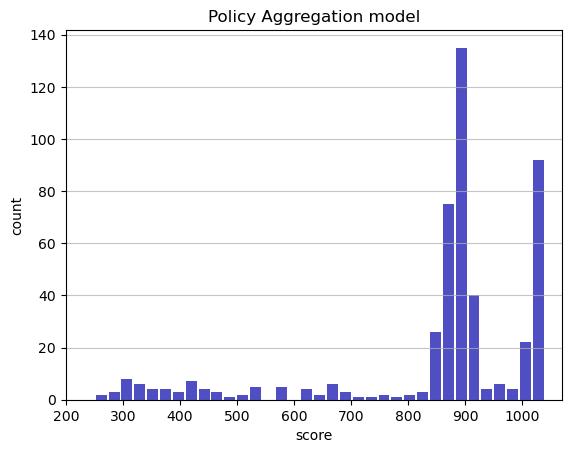

Track generation: 1018..1283 -> 265-tiles track
Epoch: 487
Policy Aggregation	mean: 854.83	variance: 184.44


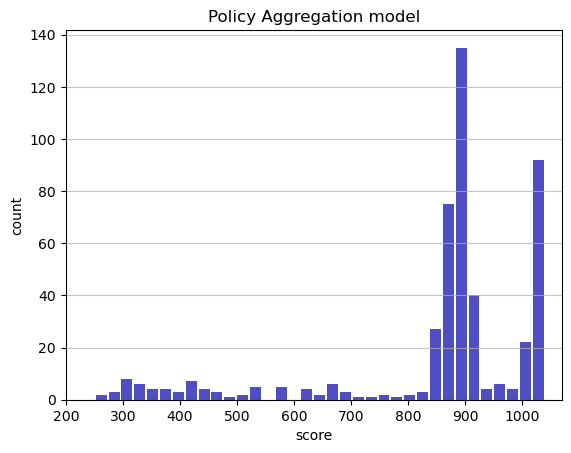

Track generation: 1231..1543 -> 312-tiles track
Epoch: 488
Policy Aggregation	mean: 854.91	variance: 184.26


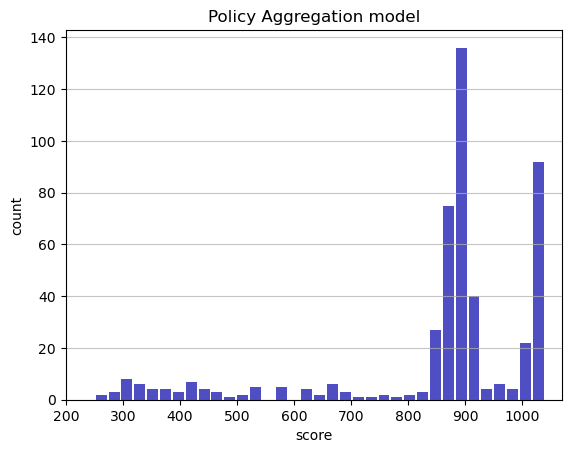

Track generation: 1198..1502 -> 304-tiles track
Epoch: 489
Policy Aggregation	mean: 855.00	variance: 184.08


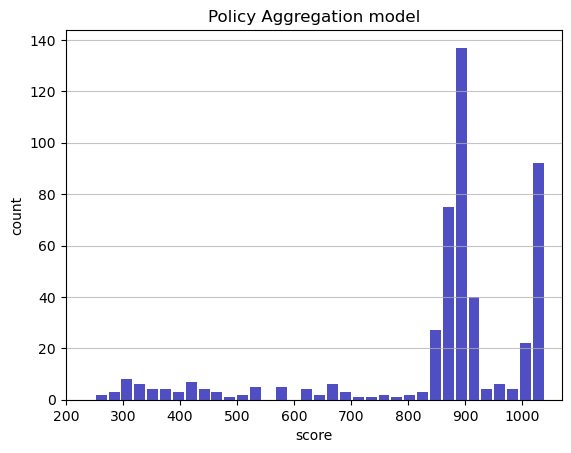

Track generation: 1115..1398 -> 283-tiles track
Epoch: 490
Policy Aggregation	mean: 855.08	variance: 183.90


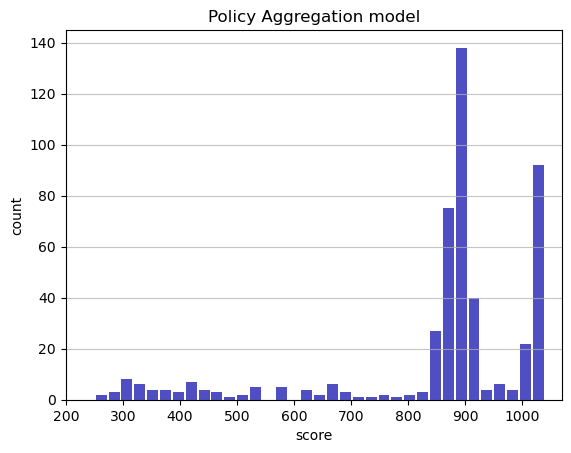

Track generation: 1083..1358 -> 275-tiles track
Epoch: 491
Policy Aggregation	mean: 855.15	variance: 183.72


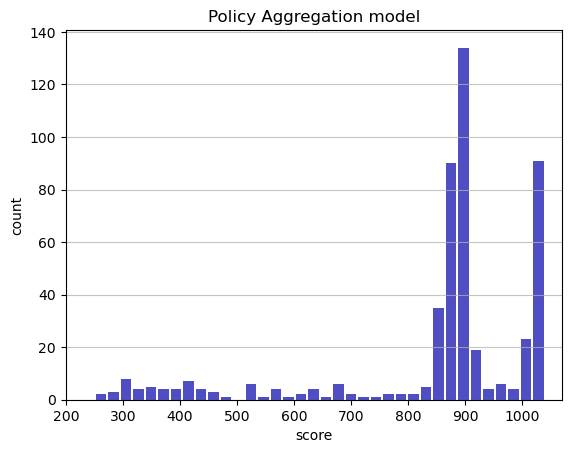

Track generation: 1092..1369 -> 277-tiles track
Epoch: 492
Policy Aggregation	mean: 855.13	variance: 183.54


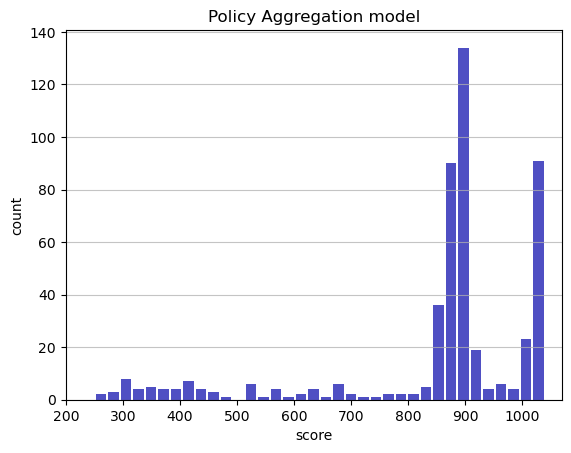

Track generation: 1095..1373 -> 278-tiles track
Epoch: 493
Policy Aggregation	mean: 854.45	variance: 183.97


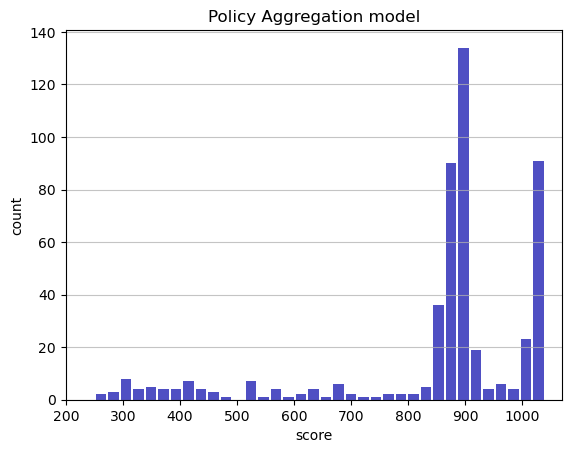

Track generation: 1005..1264 -> 259-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1131..1418 -> 287-tiles track
Epoch: 494
Policy Aggregation	mean: 854.51	variance: 183.79


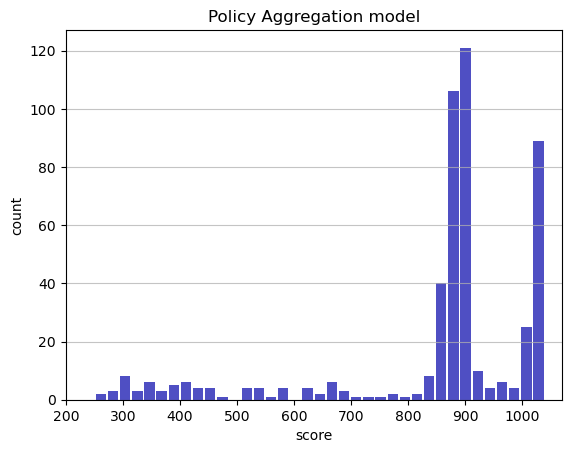

Track generation: 1087..1363 -> 276-tiles track
Epoch: 495
Policy Aggregation	mean: 854.56	variance: 183.61


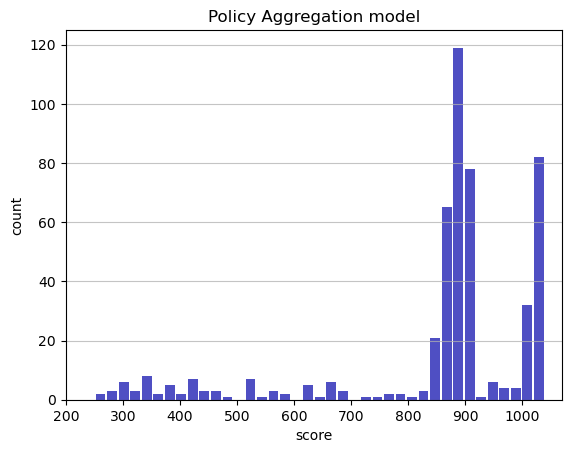

Track generation: 1188..1489 -> 301-tiles track
Epoch: 496
Policy Aggregation	mean: 854.61	variance: 183.43


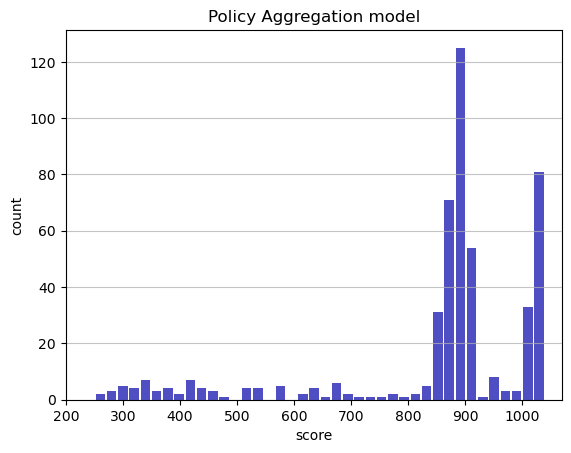

Track generation: 1254..1572 -> 318-tiles track
Epoch: 497
Policy Aggregation	mean: 854.88	variance: 183.34


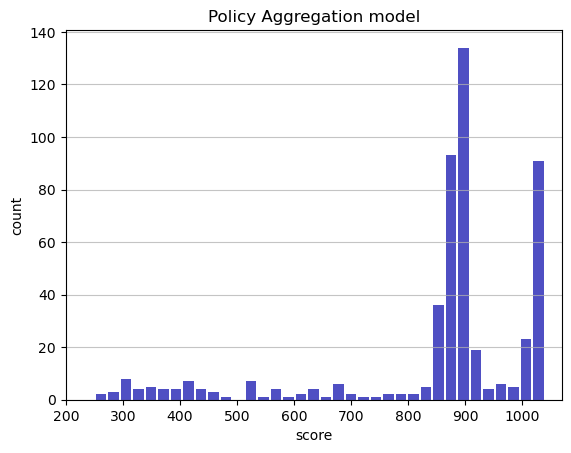

Track generation: 1011..1274 -> 263-tiles track
Epoch: 498
Policy Aggregation	mean: 855.23	variance: 183.32


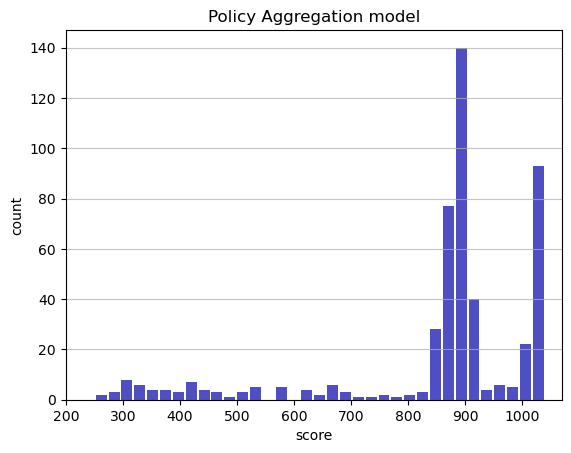

Track generation: 1184..1484 -> 300-tiles track
Epoch: 499
Policy Aggregation	mean: 854.62	variance: 183.64


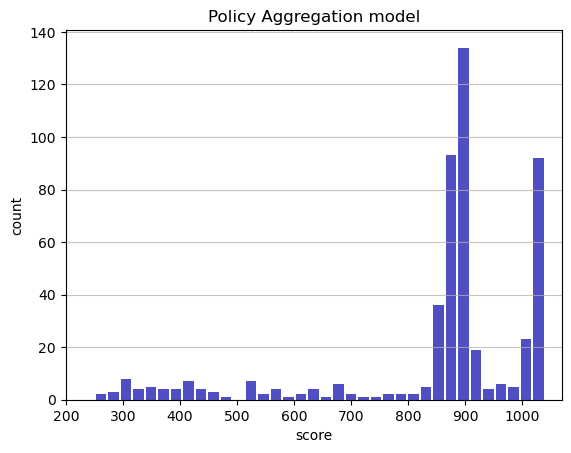

Track generation: 1087..1373 -> 286-tiles track
Epoch: 500
Policy Aggregation	mean: 854.69	variance: 183.47


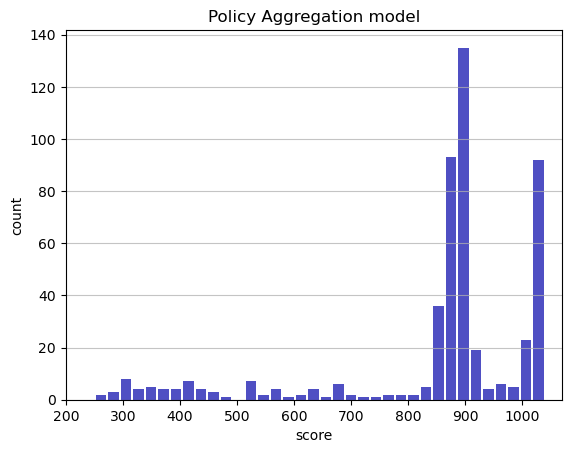

Track generation: 1200..1504 -> 304-tiles track
Epoch: 501
Policy Aggregation	mean: 854.77	variance: 183.29


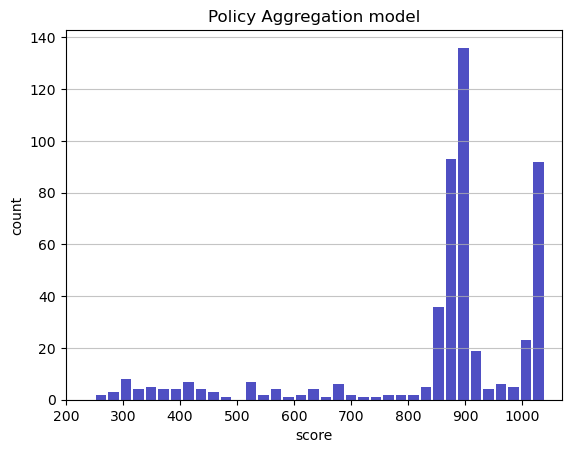

Track generation: 1135..1423 -> 288-tiles track
Epoch: 502
Policy Aggregation	mean: 854.86	variance: 183.12


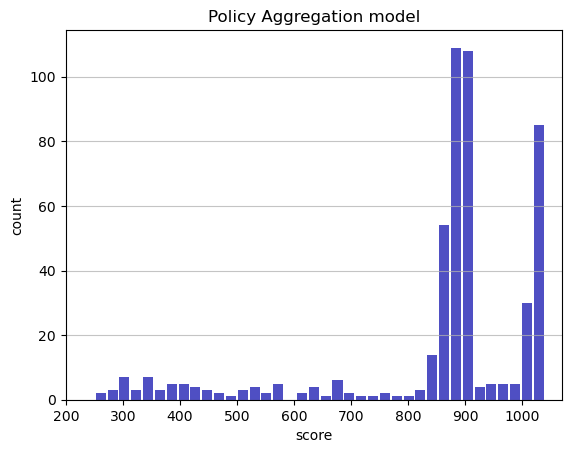

Track generation: 1143..1433 -> 290-tiles track
Epoch: 503
Policy Aggregation	mean: 855.21	variance: 183.10


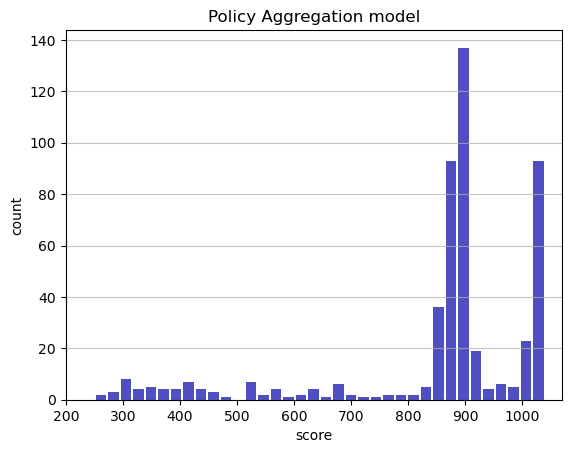

Track generation: 1140..1429 -> 289-tiles track
Epoch: 504
Policy Aggregation	mean: 854.91	variance: 183.04


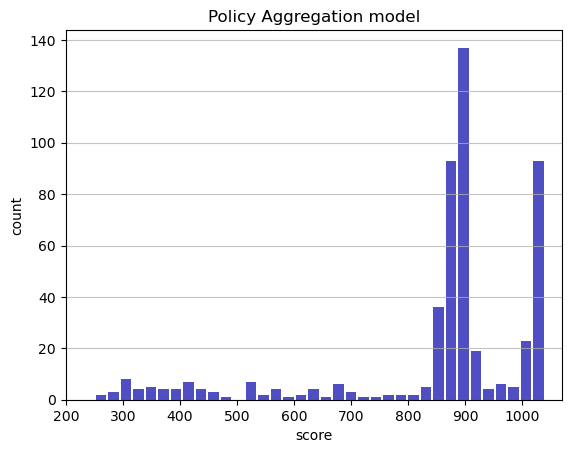

Track generation: 1036..1299 -> 263-tiles track
Epoch: 505
Policy Aggregation	mean: 853.99	variance: 184.01


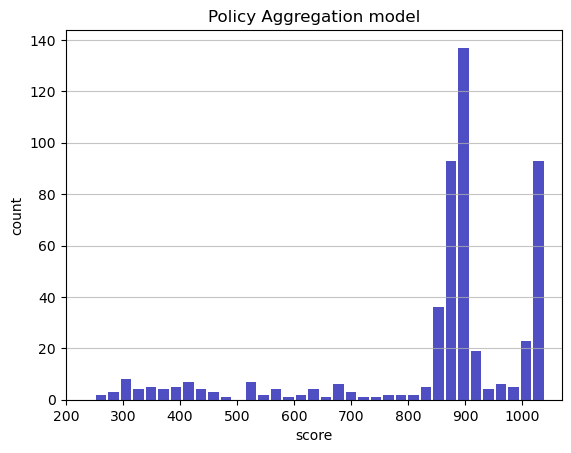

Track generation: 1291..1618 -> 327-tiles track
Epoch: 506
Policy Aggregation	mean: 854.08	variance: 183.83


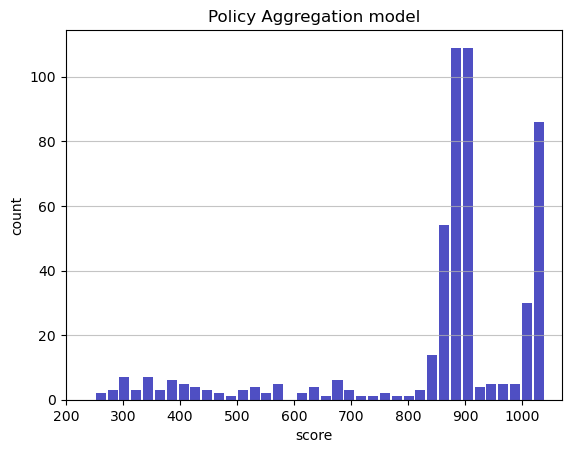

Track generation: 1135..1423 -> 288-tiles track
Epoch: 507
Policy Aggregation	mean: 854.42	variance: 183.82


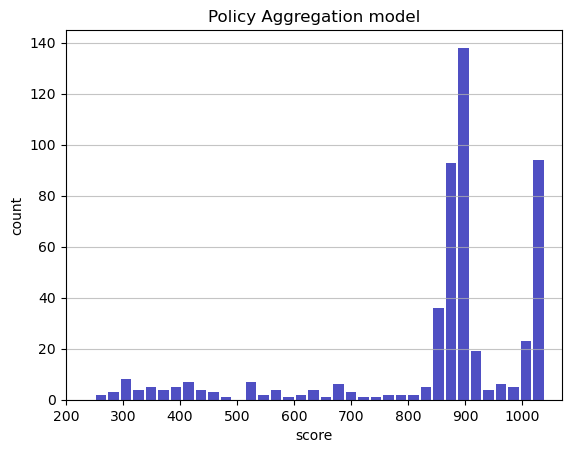

Track generation: 1184..1484 -> 300-tiles track
Epoch: 508
Policy Aggregation	mean: 854.75	variance: 183.78


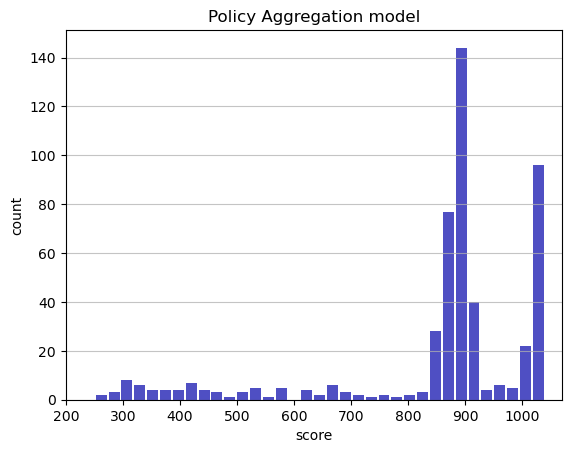

Track generation: 1163..1458 -> 295-tiles track
Epoch: 509
Policy Aggregation	mean: 854.81	variance: 183.61


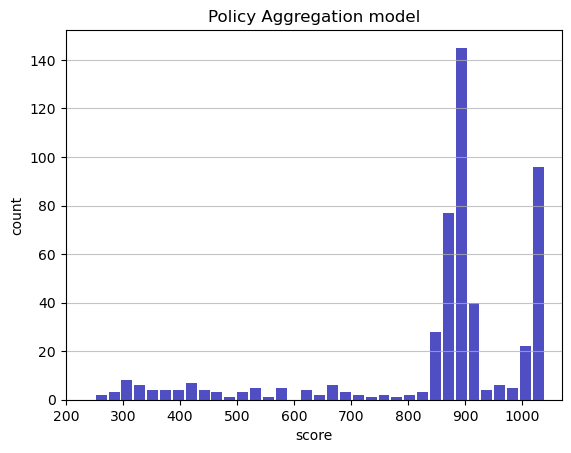

Track generation: 1171..1468 -> 297-tiles track
Epoch: 510
Policy Aggregation	mean: 855.15	variance: 183.59


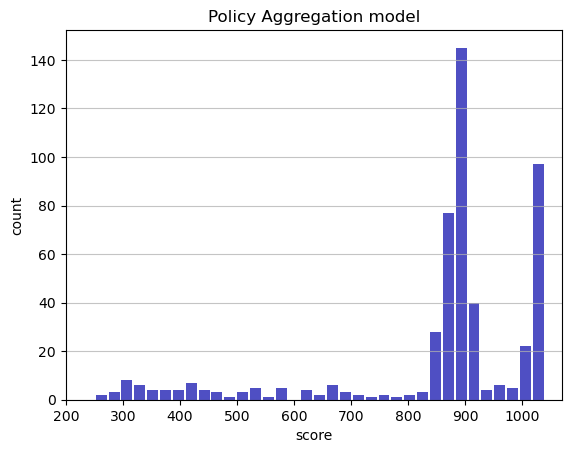

Track generation: 1108..1389 -> 281-tiles track
Epoch: 511
Policy Aggregation	mean: 855.13	variance: 183.41


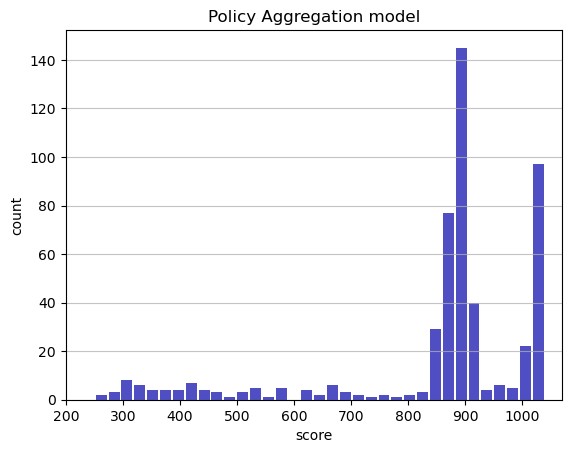

Track generation: 1113..1395 -> 282-tiles track
Epoch: 512
Policy Aggregation	mean: 855.15	variance: 183.23


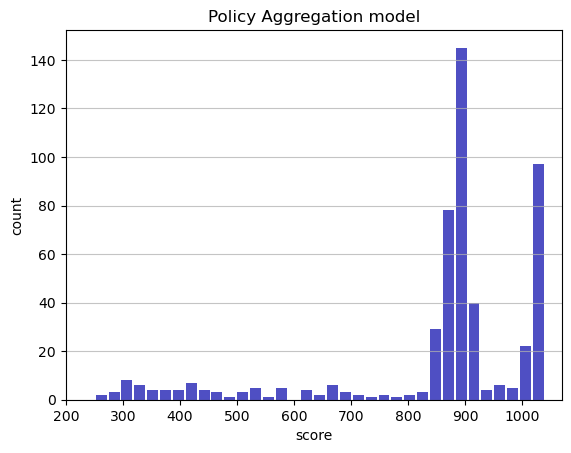

Track generation: 1034..1307 -> 273-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1127..1413 -> 286-tiles track
Epoch: 513
Policy Aggregation	mean: 855.23	variance: 183.06


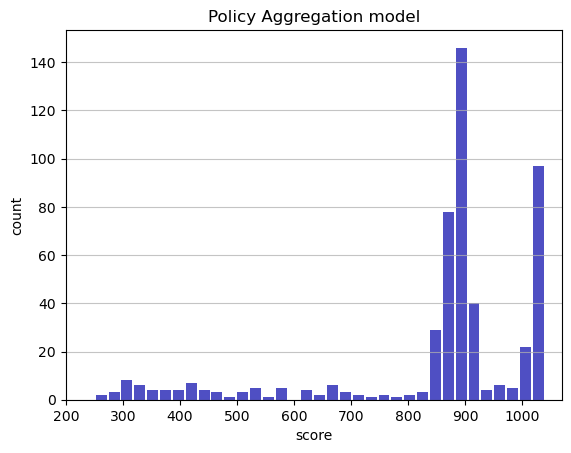

Track generation: 1219..1528 -> 309-tiles track
Epoch: 514
Policy Aggregation	mean: 855.30	variance: 182.89


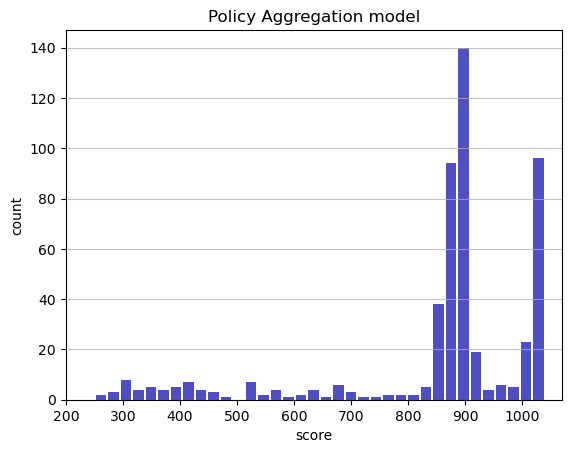

Track generation: 1212..1519 -> 307-tiles track
Epoch: 515
Policy Aggregation	mean: 854.93	variance: 182.90


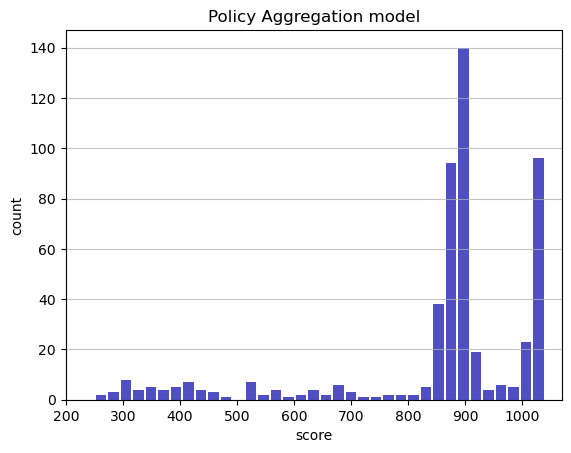

Track generation: 1127..1412 -> 285-tiles track
Epoch: 516
Policy Aggregation	mean: 855.26	variance: 182.88


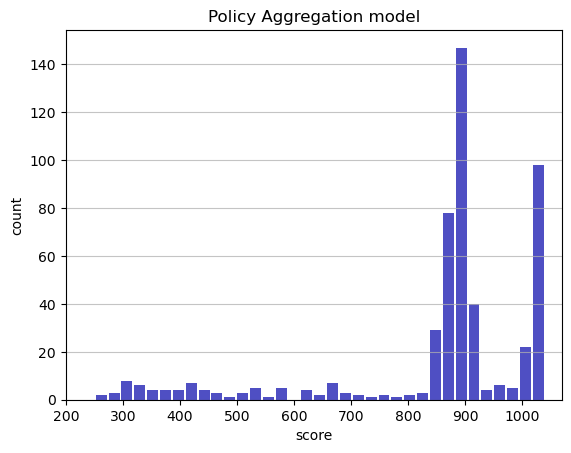

Track generation: 1195..1498 -> 303-tiles track
Epoch: 517
Policy Aggregation	mean: 855.36	variance: 182.72


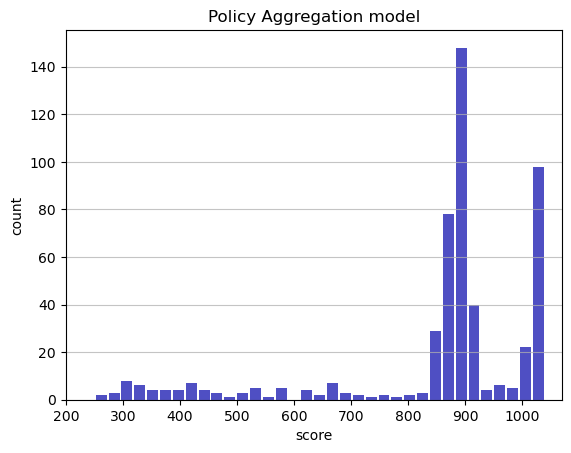

Track generation: 884..1116 -> 232-tiles track
Epoch: 518
Policy Aggregation	mean: 855.45	variance: 182.55


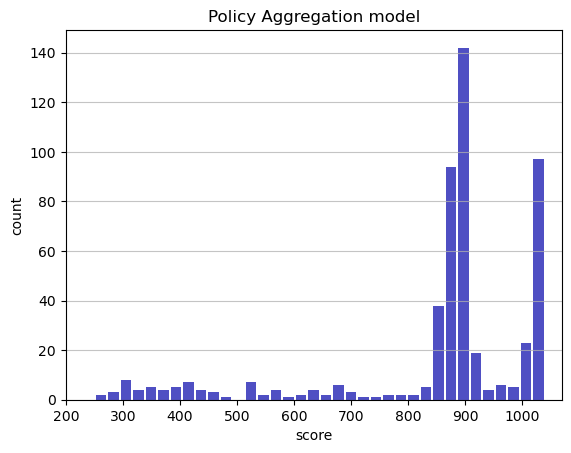

Track generation: 1115..1407 -> 292-tiles track
Epoch: 519
Policy Aggregation	mean: 855.54	variance: 182.39


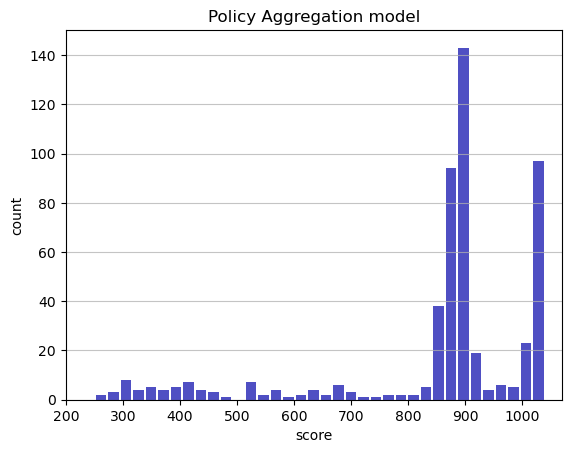

Track generation: 1048..1319 -> 271-tiles track
Epoch: 520
Policy Aggregation	mean: 855.88	variance: 182.37


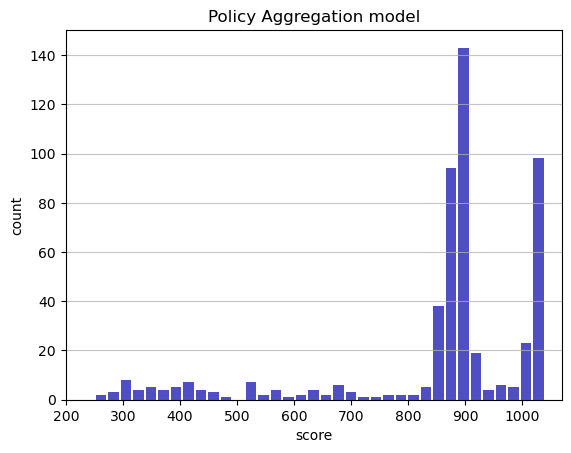

Track generation: 1185..1485 -> 300-tiles track
Epoch: 521
Policy Aggregation	mean: 855.94	variance: 182.20


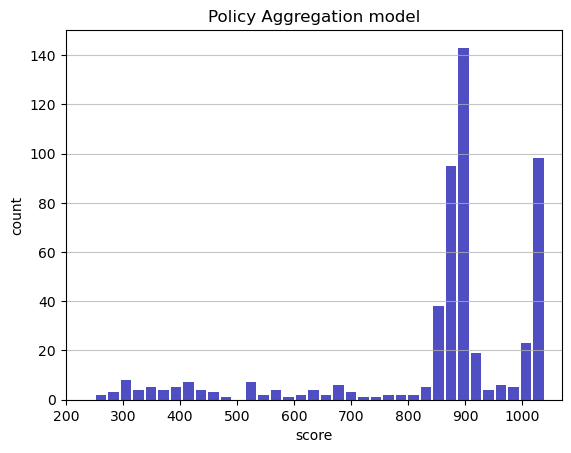

Track generation: 1253..1570 -> 317-tiles track
Epoch: 522
Policy Aggregation	mean: 856.10	variance: 182.07


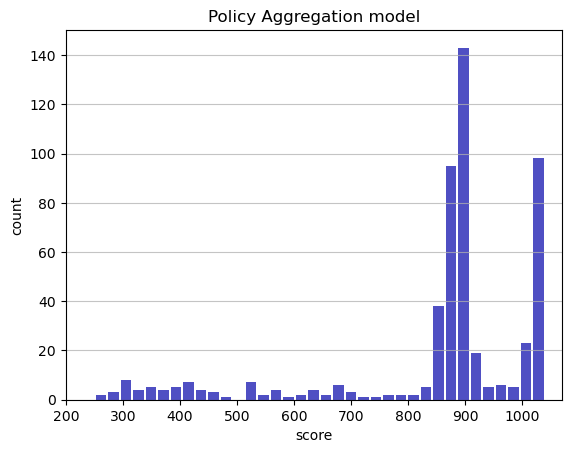

Track generation: 1092..1369 -> 277-tiles track
Epoch: 523
Policy Aggregation	mean: 856.44	variance: 182.05


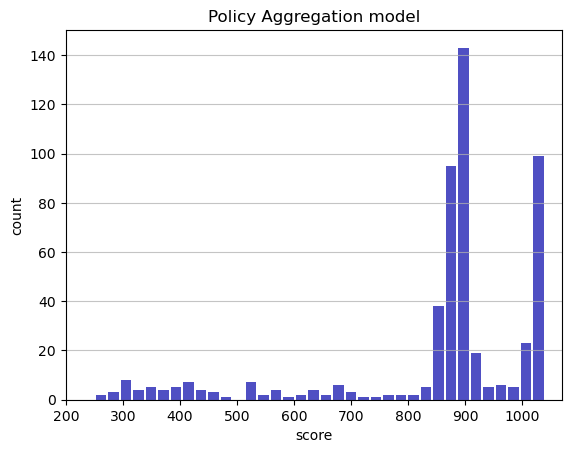

Track generation: 1150..1449 -> 299-tiles track
Epoch: 524
Policy Aggregation	mean: 856.50	variance: 181.89


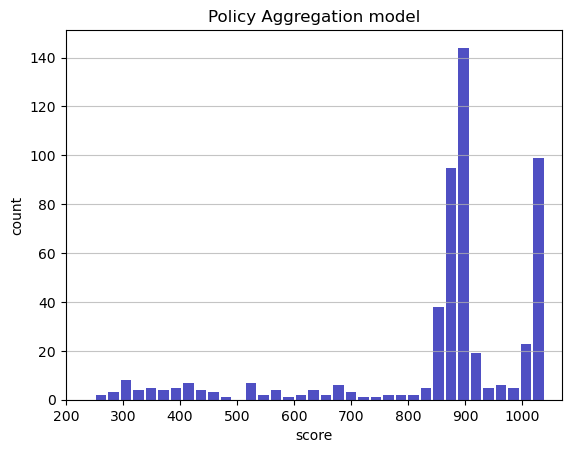

Track generation: 1057..1325 -> 268-tiles track
Epoch: 525
Policy Aggregation	mean: 855.67	variance: 182.72


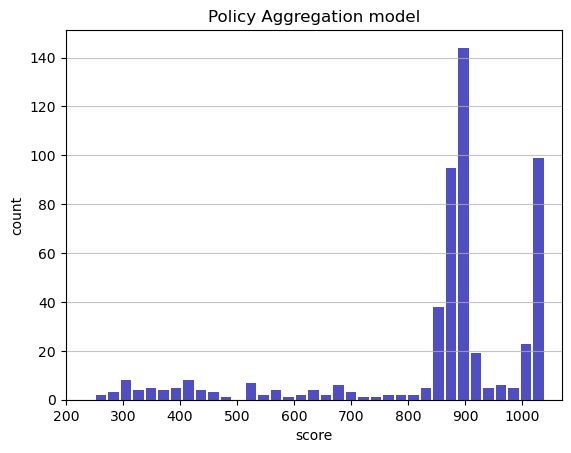

Track generation: 1178..1482 -> 304-tiles track
Epoch: 526
Policy Aggregation	mean: 854.68	variance: 183.93


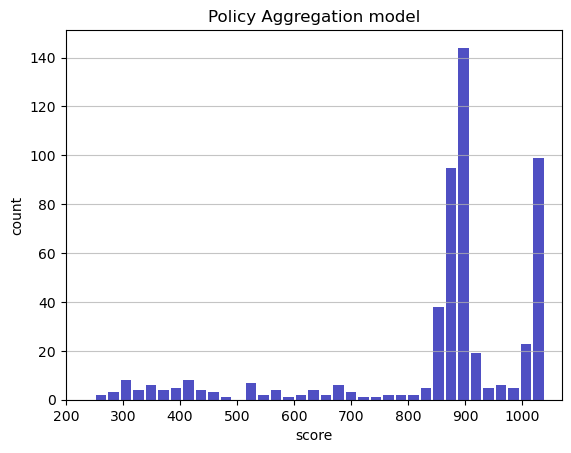

Track generation: 1153..1454 -> 301-tiles track
Epoch: 527
Policy Aggregation	mean: 854.99	variance: 183.90


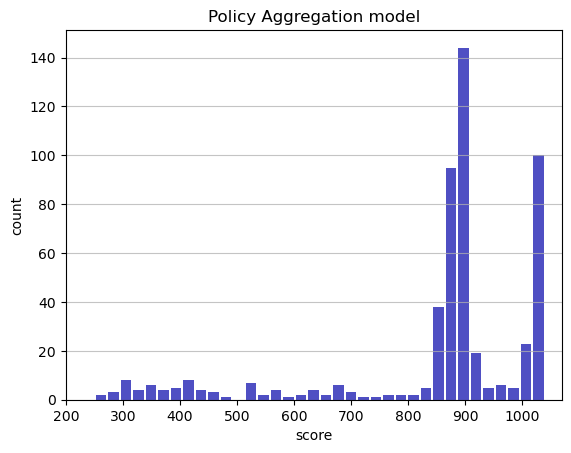

Track generation: 975..1223 -> 248-tiles track
Epoch: 528
Policy Aggregation	mean: 855.34	variance: 183.90


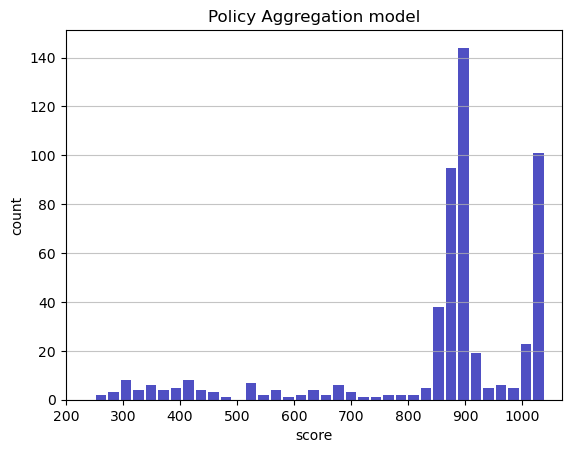

Track generation: 1007..1263 -> 256-tiles track
Epoch: 529
Policy Aggregation	mean: 854.50	variance: 184.73


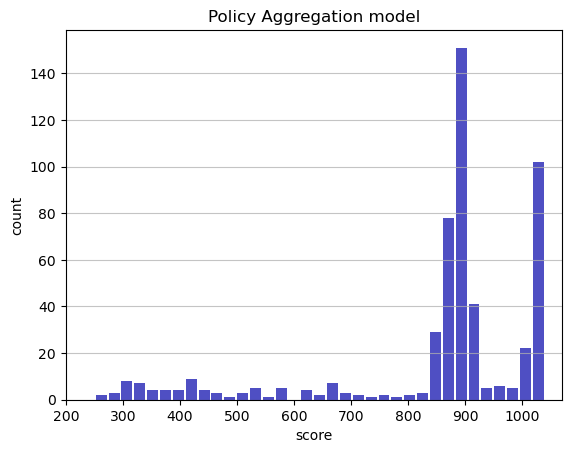

Track generation: 1036..1301 -> 265-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1121..1413 -> 292-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1312..1644 -> 332-tiles track
Epoch: 530
Policy Aggregation	mean: 854.57	variance: 184.56


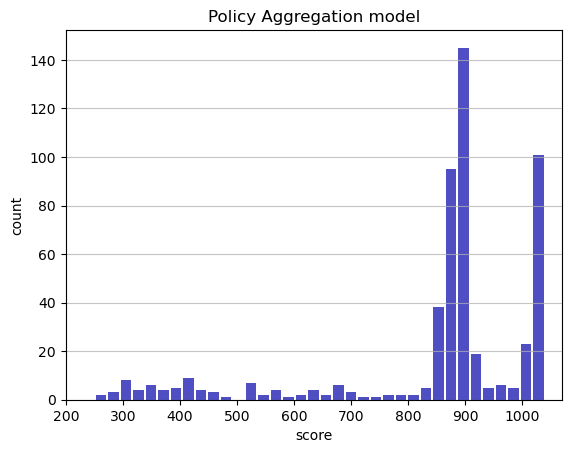

Track generation: 1027..1288 -> 261-tiles track
Epoch: 531
Policy Aggregation	mean: 854.90	variance: 184.54


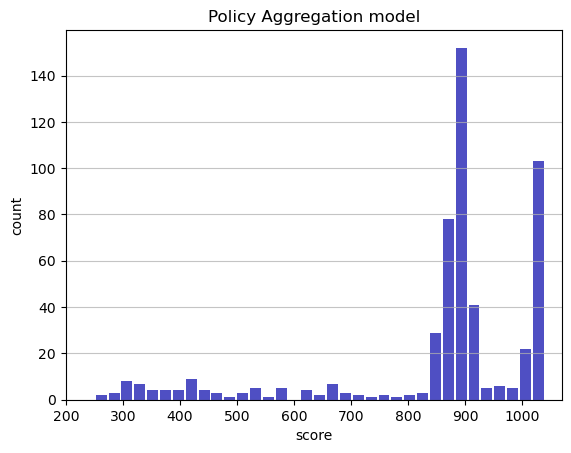

Track generation: 1133..1420 -> 287-tiles track
Epoch: 532
Policy Aggregation	mean: 854.94	variance: 184.37


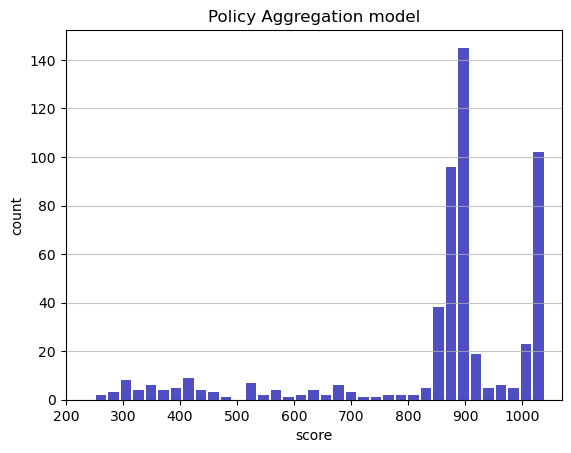

Track generation: 1213..1521 -> 308-tiles track
Epoch: 533
Policy Aggregation	mean: 855.23	variance: 184.32


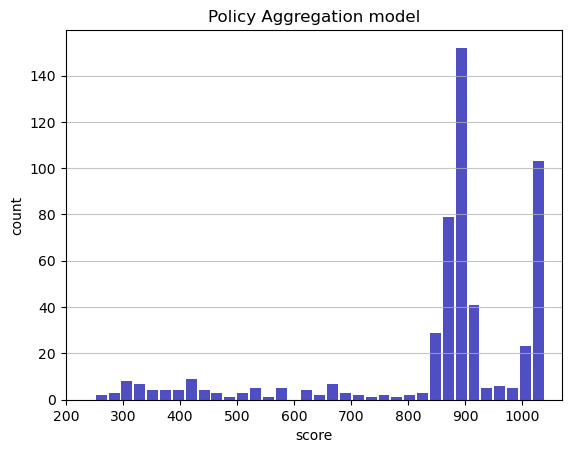

Track generation: 1225..1535 -> 310-tiles track
Epoch: 534
Policy Aggregation	mean: 855.54	variance: 184.29


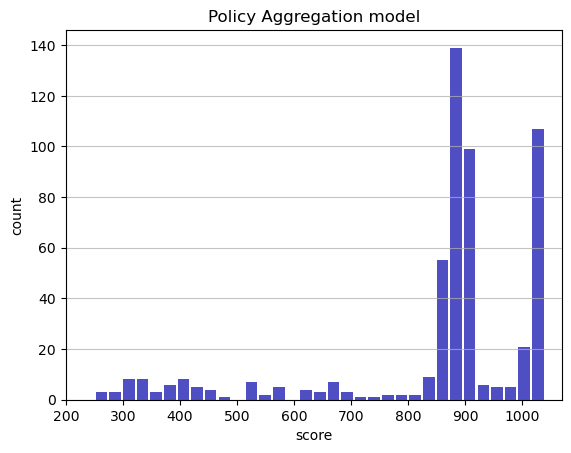

Track generation: 1116..1399 -> 283-tiles track
Epoch: 535
Policy Aggregation	mean: 855.54	variance: 184.12


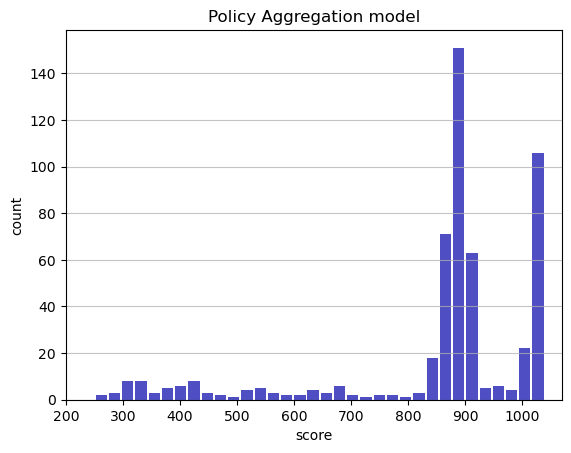

Track generation: 1174..1472 -> 298-tiles track
Epoch: 536
Policy Aggregation	mean: 855.84	variance: 184.08


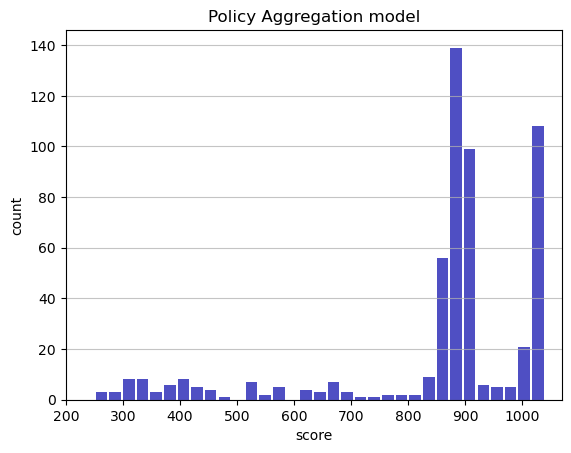

Track generation: 1033..1302 -> 269-tiles track
Epoch: 537
Policy Aggregation	mean: 856.07	variance: 183.98


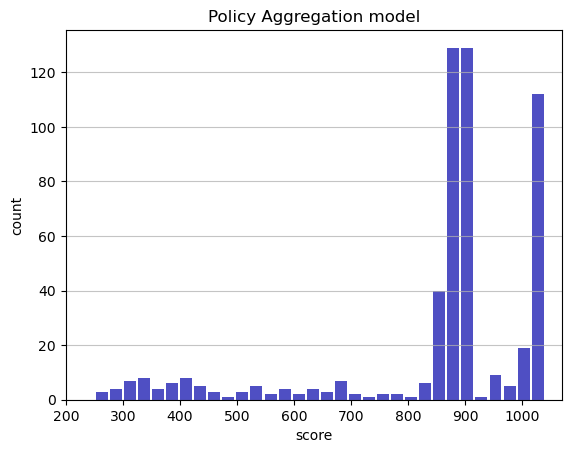

Track generation: 1003..1262 -> 259-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1021..1288 -> 267-tiles track
Epoch: 538
Policy Aggregation	mean: 856.14	variance: 183.82


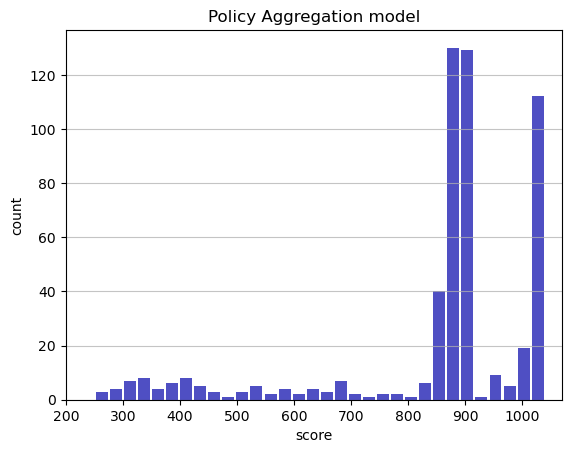

Track generation: 1095..1373 -> 278-tiles track
Epoch: 539
Policy Aggregation	mean: 856.45	variance: 183.80


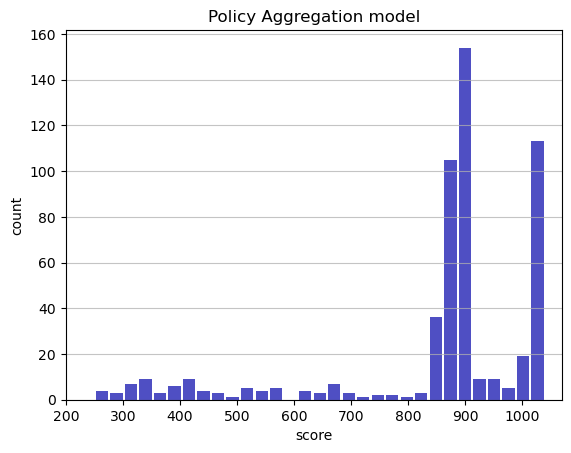

Track generation: 1272..1594 -> 322-tiles track
Epoch: 540
Policy Aggregation	mean: 856.75	variance: 183.75


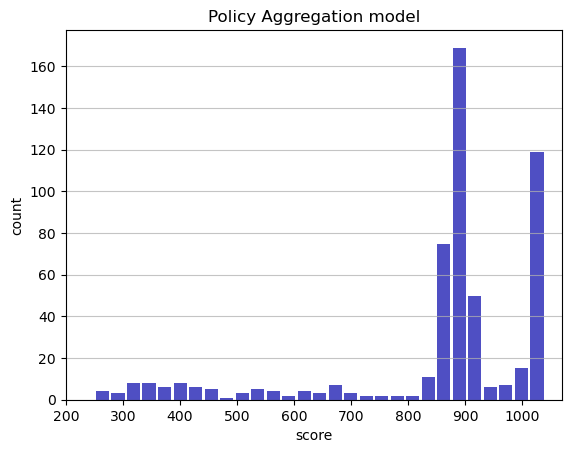

Track generation: 1180..1483 -> 303-tiles track
Epoch: 541
Policy Aggregation	mean: 857.06	variance: 183.72


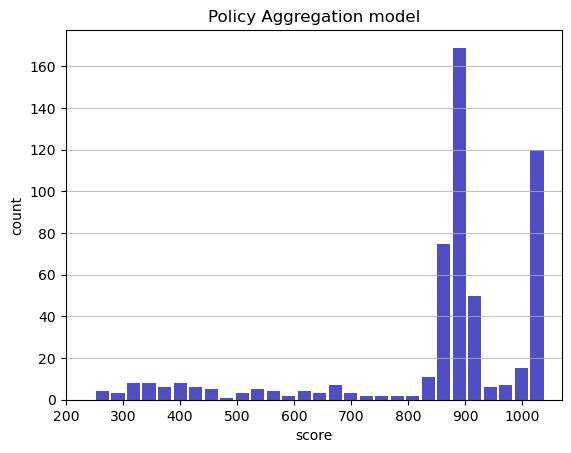

Track generation: 1031..1300 -> 269-tiles track
Epoch: 542
Policy Aggregation	mean: 856.33	variance: 184.33


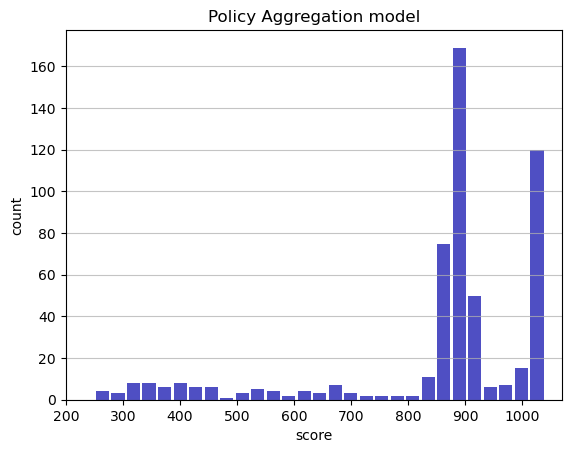

Track generation: 1070..1346 -> 276-tiles track
Epoch: 543
Policy Aggregation	mean: 856.29	variance: 184.16


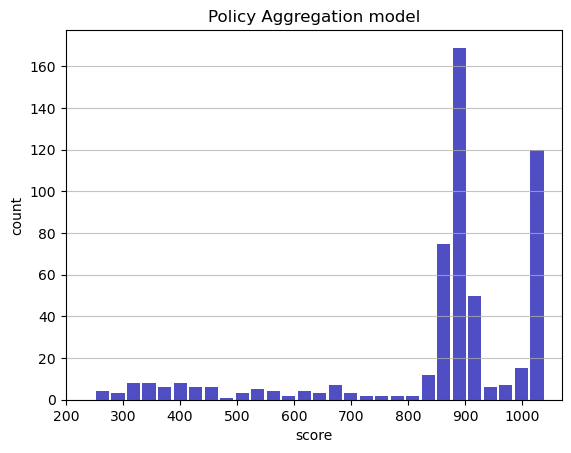

Track generation: 1115..1398 -> 283-tiles track
Epoch: 544
Policy Aggregation	mean: 856.61	variance: 184.14


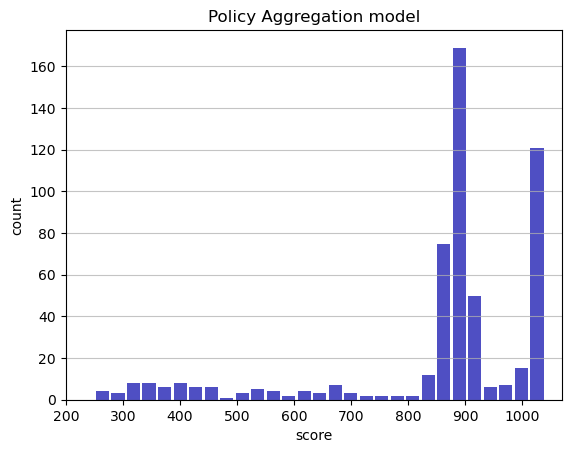

Track generation: 1246..1561 -> 315-tiles track
Epoch: 545
Policy Aggregation	mean: 856.66	variance: 183.98


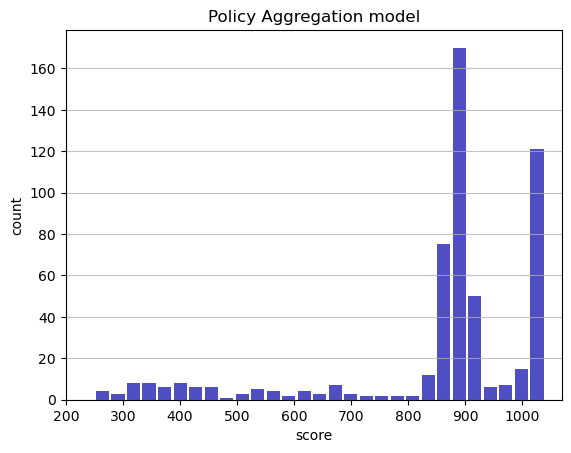

Track generation: 1131..1419 -> 288-tiles track
Epoch: 546
Policy Aggregation	mean: 856.97	variance: 183.94


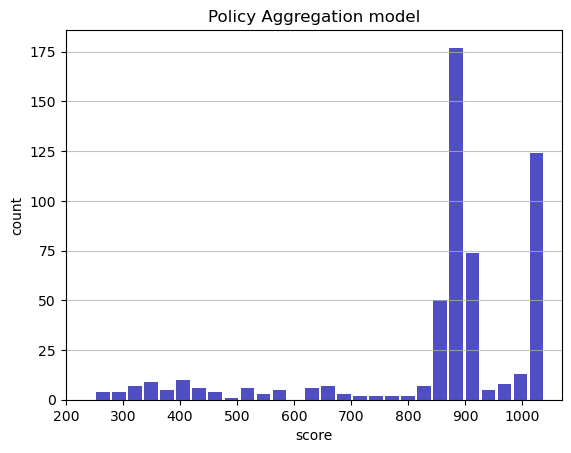

Track generation: 1122..1407 -> 285-tiles track
Epoch: 547
Policy Aggregation	mean: 857.07	variance: 183.79


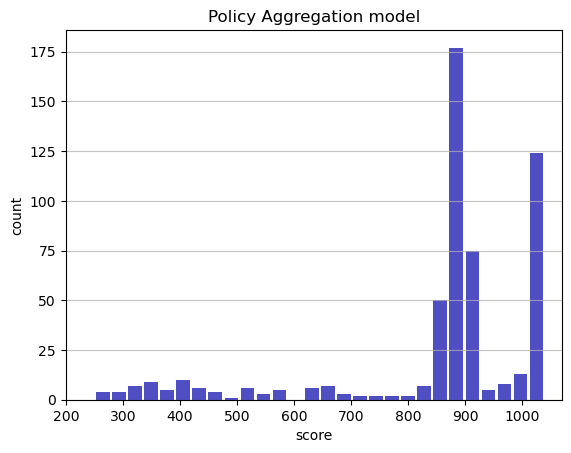

Track generation: 1296..1624 -> 328-tiles track
Epoch: 548
Policy Aggregation	mean: 856.83	variance: 183.71


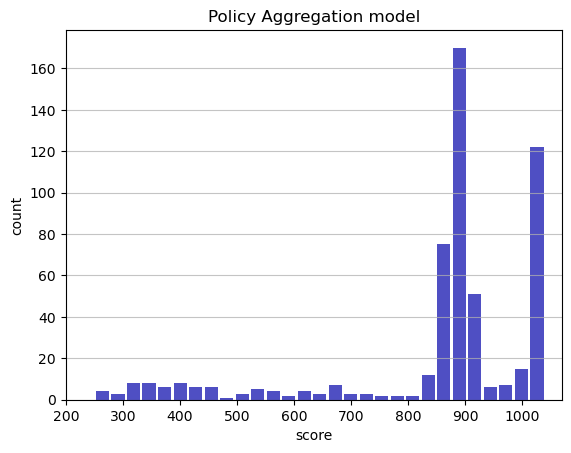

Track generation: 1240..1554 -> 314-tiles track
Epoch: 549
Policy Aggregation	mean: 857.13	variance: 183.67


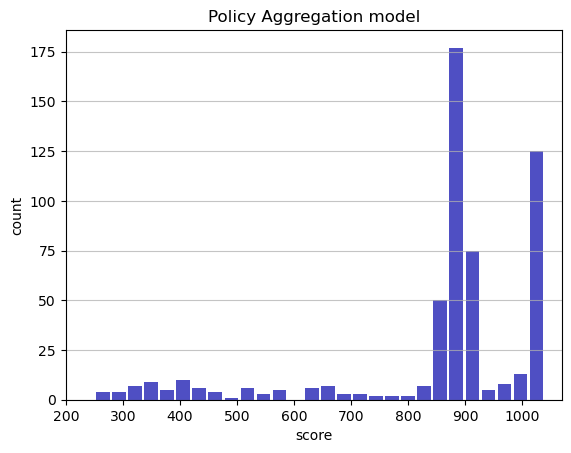

Track generation: 1195..1498 -> 303-tiles track
Epoch: 550
Policy Aggregation	mean: 857.43	variance: 183.64


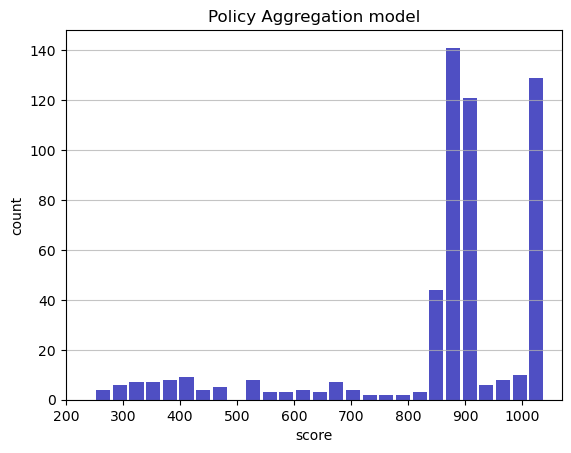

Track generation: 1142..1432 -> 290-tiles track
Epoch: 551
Policy Aggregation	mean: 856.94	variance: 183.85


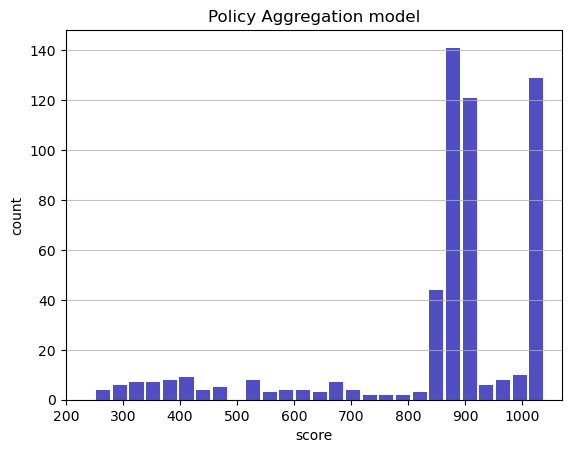

Track generation: 1096..1374 -> 278-tiles track
Epoch: 552
Policy Aggregation	mean: 857.00	variance: 183.69


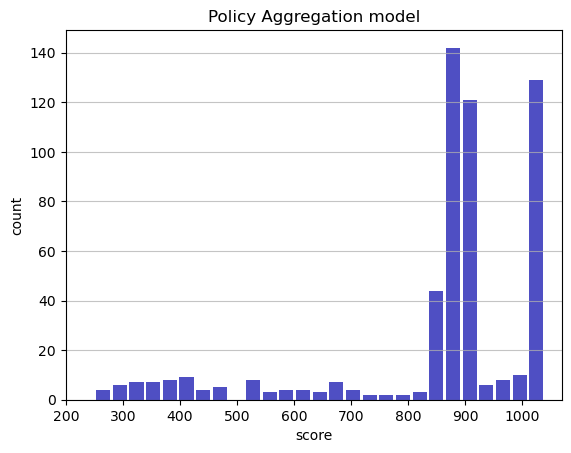

Track generation: 1080..1354 -> 274-tiles track
Epoch: 553
Policy Aggregation	mean: 857.06	variance: 183.53


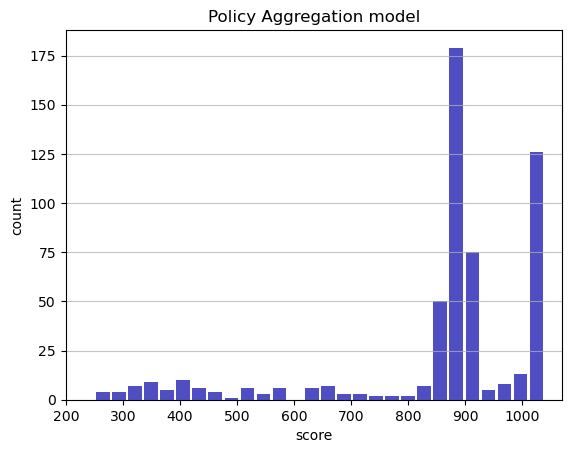

Track generation: 1229..1549 -> 320-tiles track
Epoch: 554
Policy Aggregation	mean: 857.10	variance: 183.36


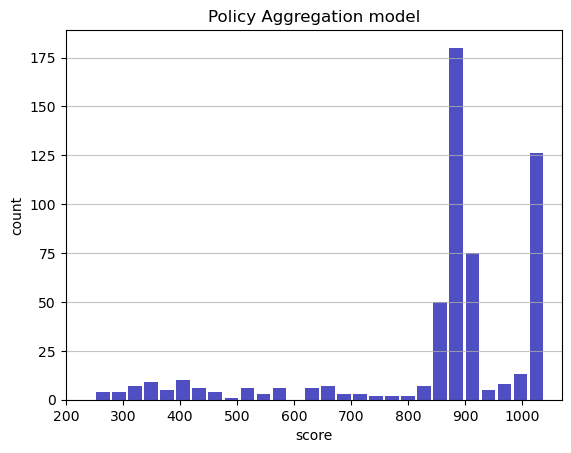

Track generation: 1267..1592 -> 325-tiles track
Epoch: 555
Policy Aggregation	mean: 857.27	variance: 183.24


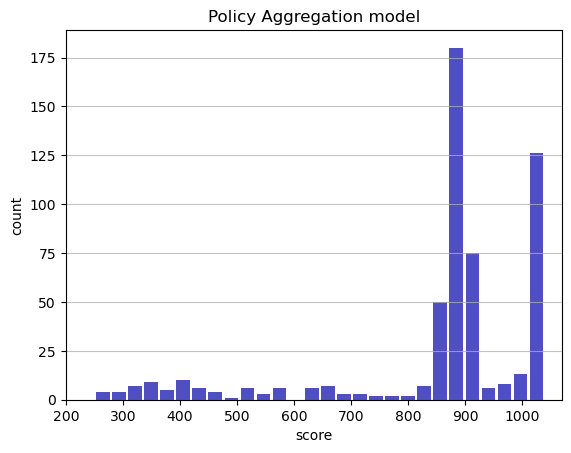

Track generation: 1182..1482 -> 300-tiles track
Epoch: 556
Policy Aggregation	mean: 857.34	variance: 183.08


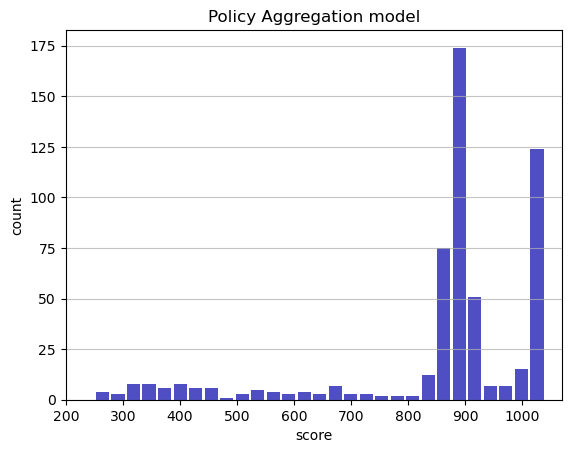

Track generation: 1019..1278 -> 259-tiles track
Epoch: 557
Policy Aggregation	mean: 857.39	variance: 182.92


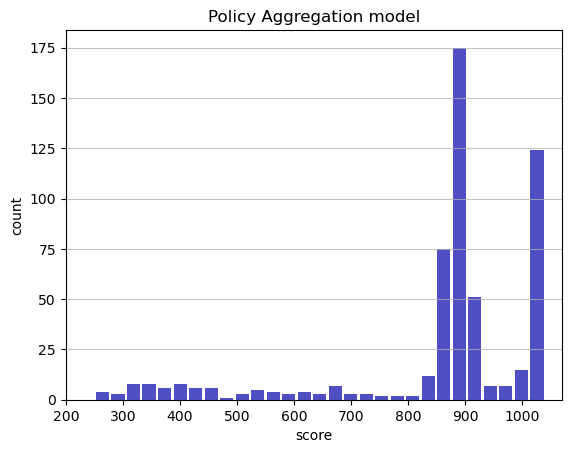

Track generation: 1116..1399 -> 283-tiles track
Epoch: 558
Policy Aggregation	mean: 857.70	variance: 182.90


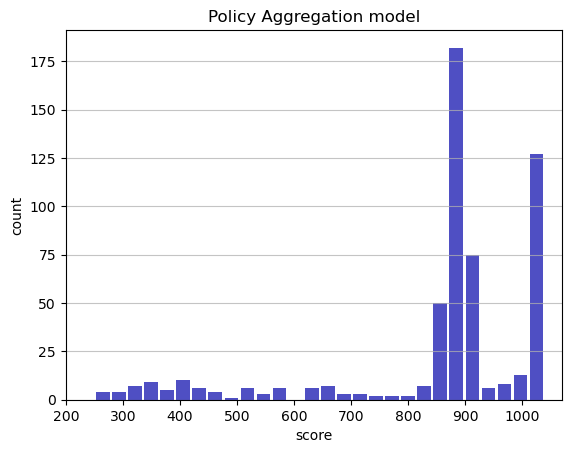

Track generation: 1083..1365 -> 282-tiles track
Epoch: 559
Policy Aggregation	mean: 856.95	variance: 183.58


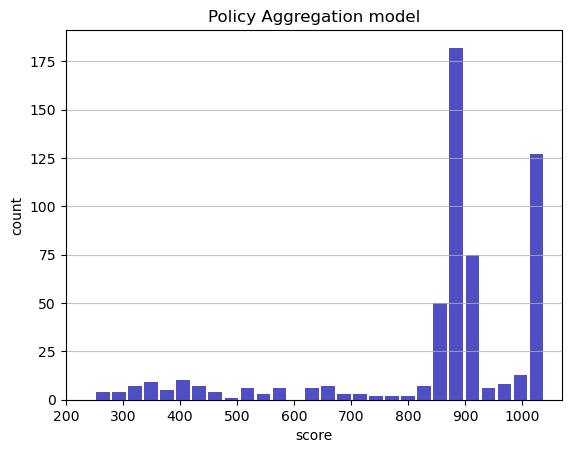

Track generation: 1160..1454 -> 294-tiles track
Epoch: 560
Policy Aggregation	mean: 856.95	variance: 183.42


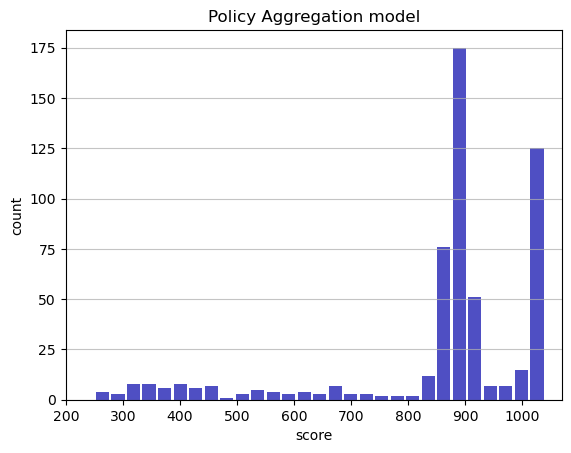

Track generation: 1123..1408 -> 285-tiles track
Epoch: 561
Policy Aggregation	mean: 857.26	variance: 183.40


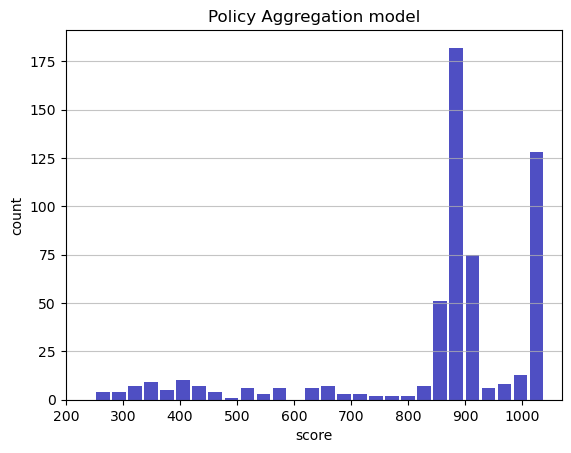

Track generation: 1112..1402 -> 290-tiles track
Epoch: 562
Policy Aggregation	mean: 857.33	variance: 183.24


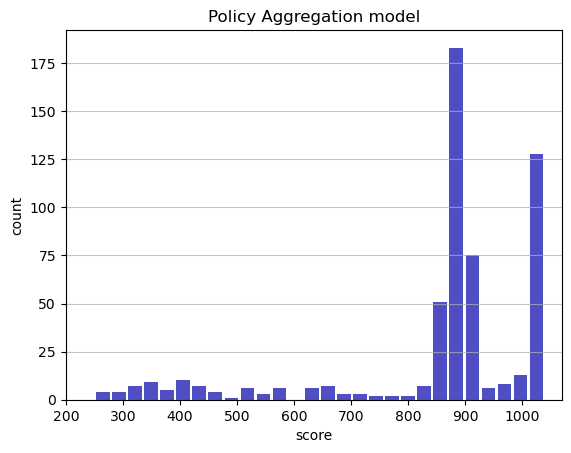

Track generation: 1196..1499 -> 303-tiles track
Epoch: 563
Policy Aggregation	mean: 857.41	variance: 183.09


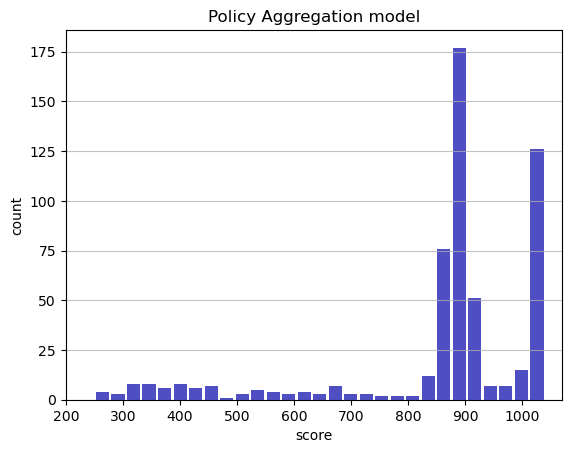

Track generation: 1156..1449 -> 293-tiles track
Epoch: 564
Policy Aggregation	mean: 857.49	variance: 182.94


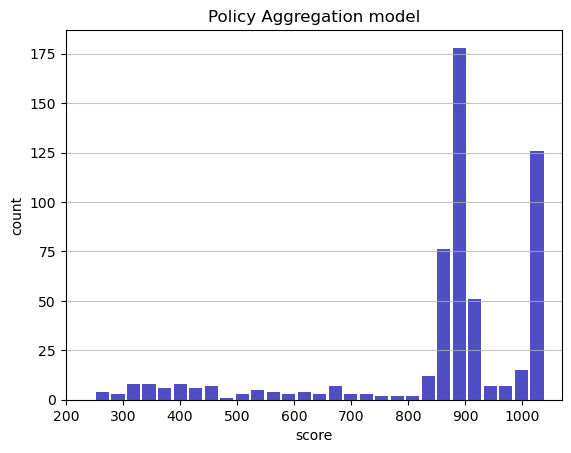

Track generation: 1251..1568 -> 317-tiles track
Epoch: 565
Policy Aggregation	mean: 857.56	variance: 182.78


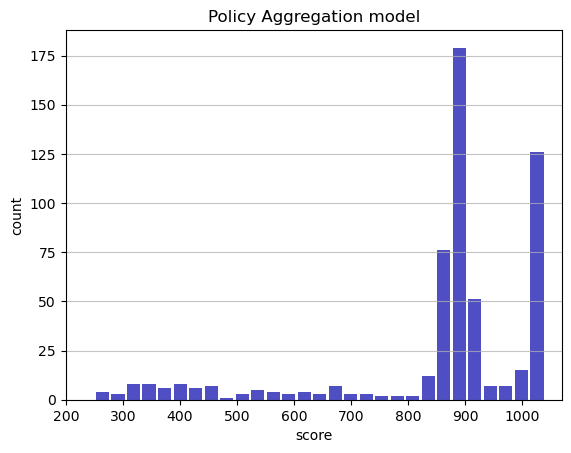

Track generation: 1432..1794 -> 362-tiles track
Epoch: 566
Policy Aggregation	mean: 857.61	variance: 182.62


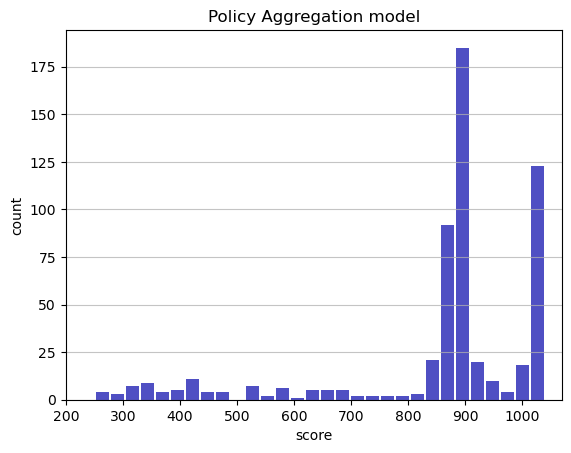

Track generation: 1172..1469 -> 297-tiles track
Epoch: 567
Policy Aggregation	mean: 857.70	variance: 182.48


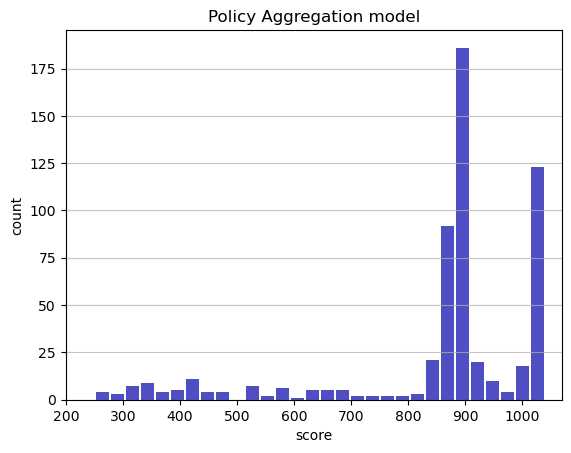

Track generation: 1199..1503 -> 304-tiles track
Epoch: 568
Policy Aggregation	mean: 857.46	variance: 182.40


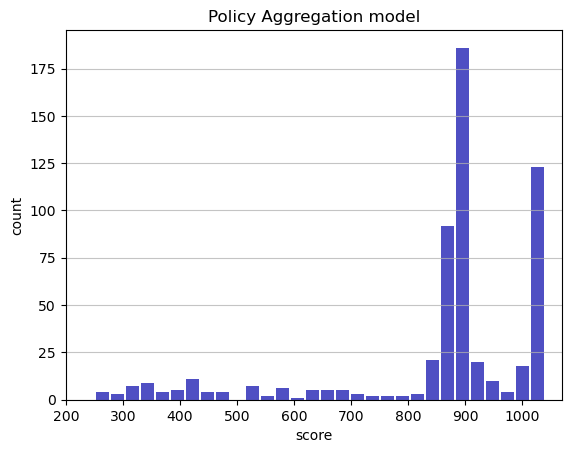

Track generation: 1193..1495 -> 302-tiles track
Epoch: 569
Policy Aggregation	mean: 857.54	variance: 182.25


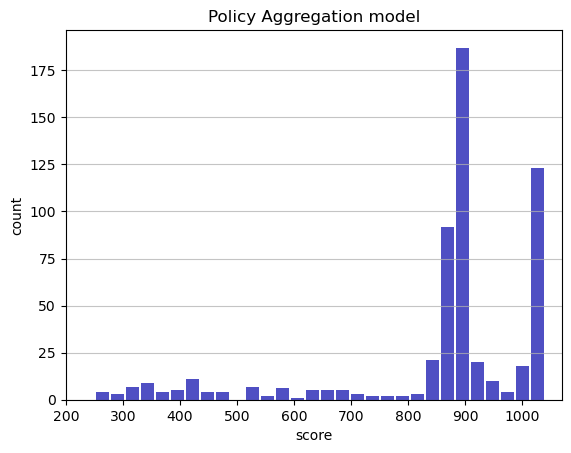

Track generation: 1236..1549 -> 313-tiles track
Epoch: 570
Policy Aggregation	mean: 857.59	variance: 182.10


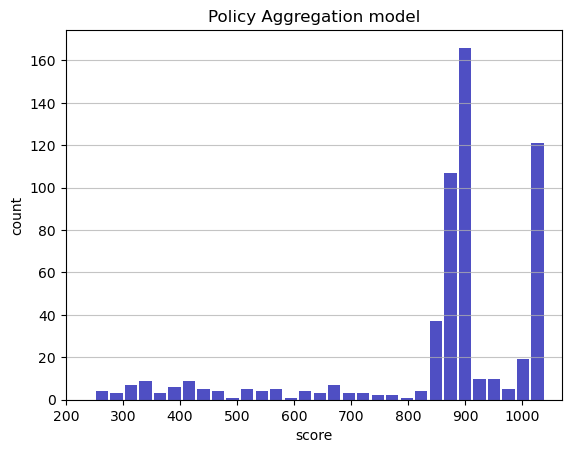

Track generation: 1141..1435 -> 294-tiles track
Epoch: 571
Policy Aggregation	mean: 856.87	variance: 182.76


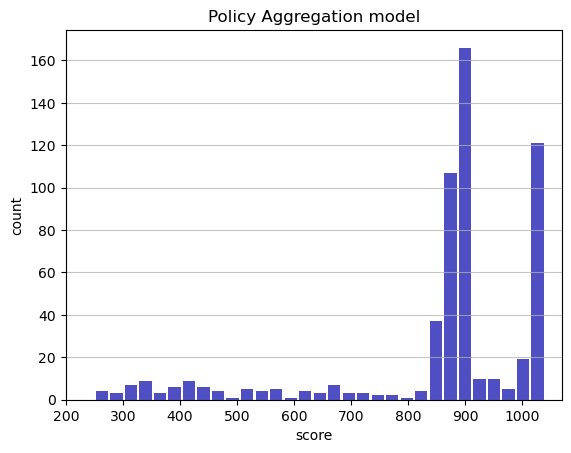

Track generation: 1291..1618 -> 327-tiles track
Epoch: 572
Policy Aggregation	mean: 857.15	variance: 182.72


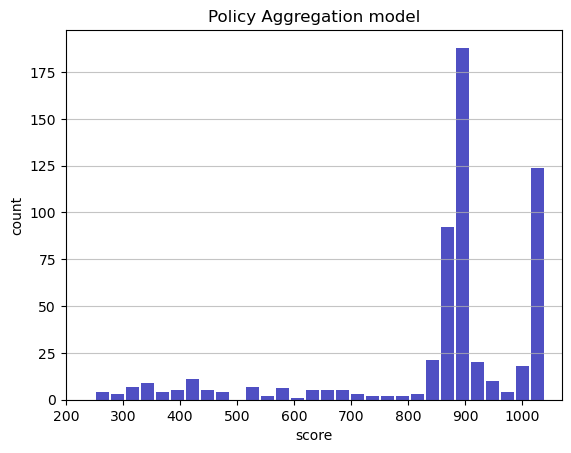

Track generation: 1071..1342 -> 271-tiles track
Epoch: 573
Policy Aggregation	mean: 857.22	variance: 182.57


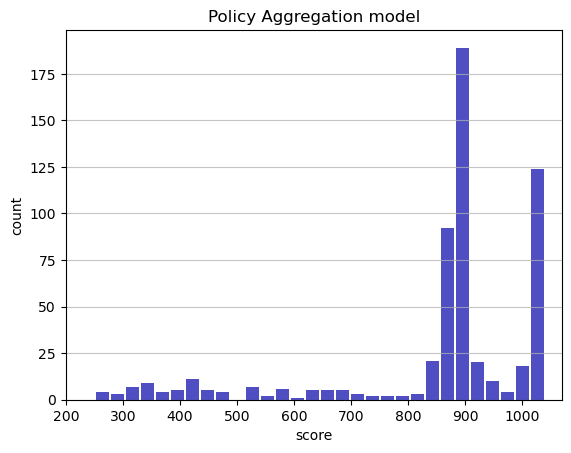

Track generation: 1234..1547 -> 313-tiles track
Epoch: 574
Policy Aggregation	mean: 856.25	variance: 183.88


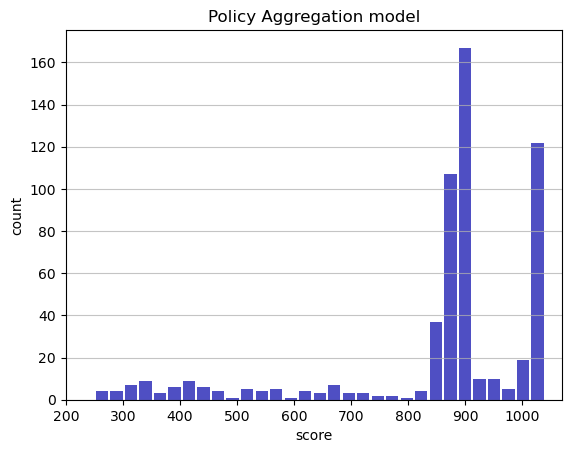

Track generation: 1127..1413 -> 286-tiles track
Epoch: 575
Policy Aggregation	mean: 856.27	variance: 183.72


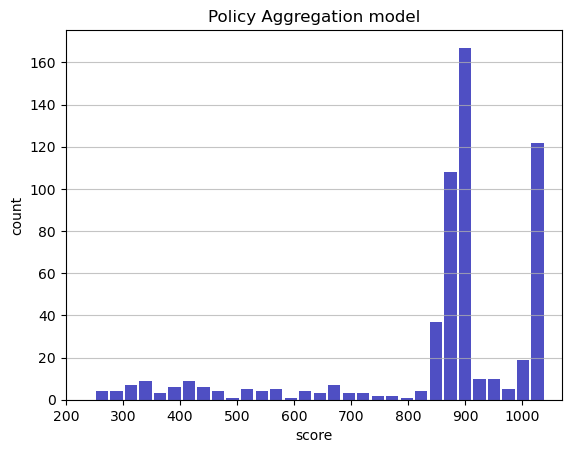

Track generation: 1025..1285 -> 260-tiles track
Epoch: 576
Policy Aggregation	mean: 856.38	variance: 183.58


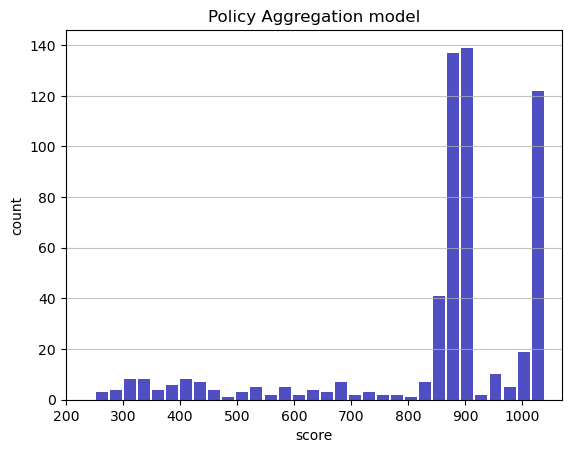

Track generation: 1316..1649 -> 333-tiles track
Epoch: 577
Policy Aggregation	mean: 855.44	variance: 184.78


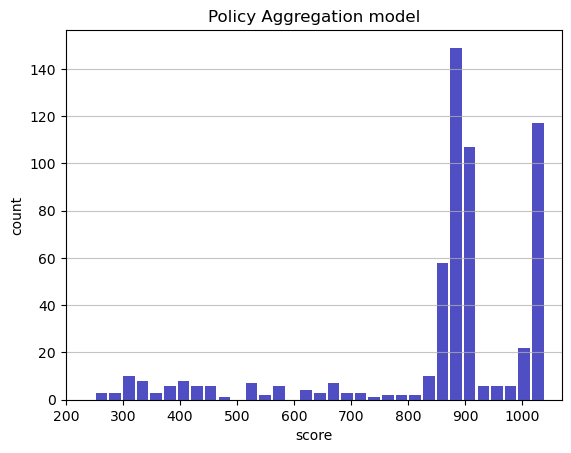

Track generation: 1159..1453 -> 294-tiles track
Epoch: 578
Policy Aggregation	mean: 855.27	variance: 184.67


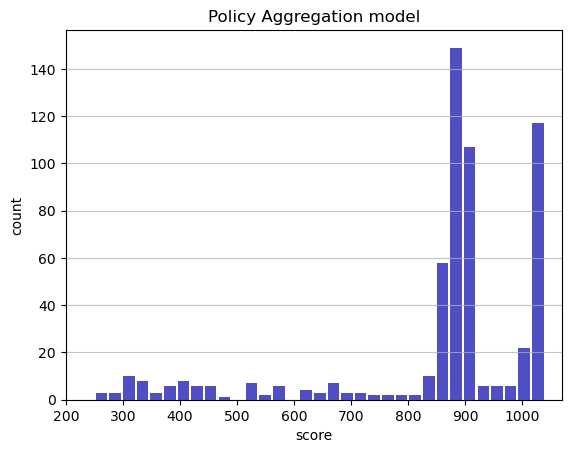

Track generation: 1203..1508 -> 305-tiles track
Epoch: 579
Policy Aggregation	mean: 855.32	variance: 184.52


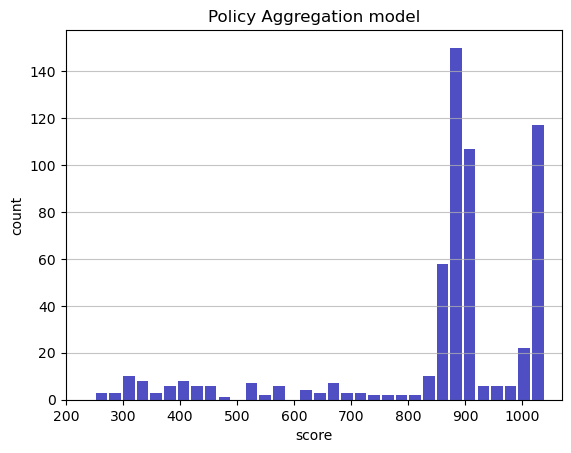

Track generation: 1316..1658 -> 342-tiles track
Epoch: 580
Policy Aggregation	mean: 855.33	variance: 184.36


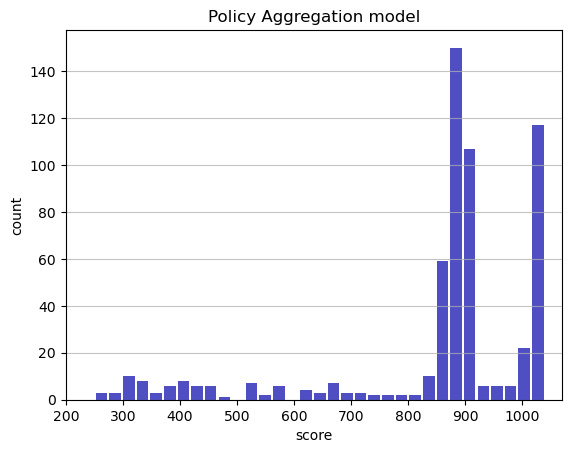

Track generation: 972..1220 -> 248-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1425..1786 -> 361-tiles track
Epoch: 581
Policy Aggregation	mean: 855.28	variance: 184.20


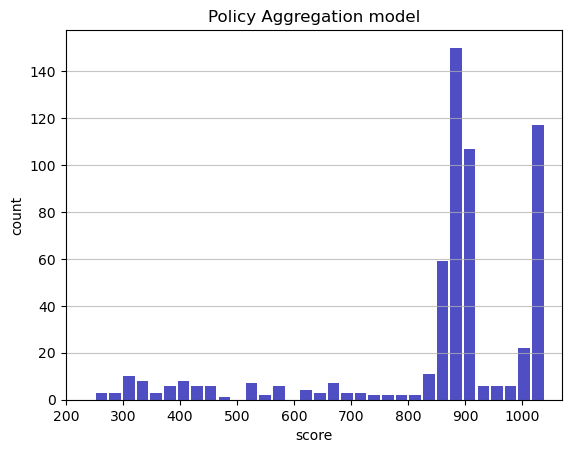

Track generation: 1230..1542 -> 312-tiles track
Epoch: 582
Policy Aggregation	mean: 855.33	variance: 184.05


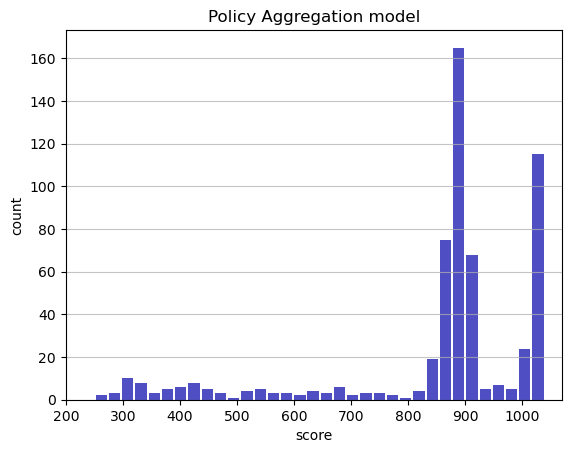

Track generation: 1267..1588 -> 321-tiles track
Epoch: 583
Policy Aggregation	mean: 855.61	variance: 184.01


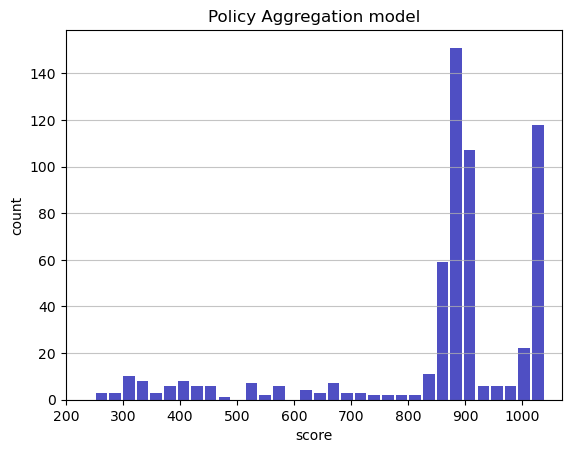

Track generation: 1115..1398 -> 283-tiles track
Epoch: 584
Policy Aggregation	mean: 855.66	variance: 183.86


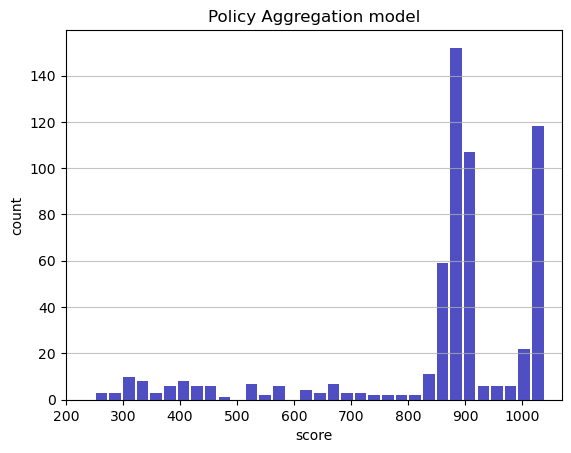

Track generation: 1180..1486 -> 306-tiles track
Epoch: 585
Policy Aggregation	mean: 855.85	variance: 183.76


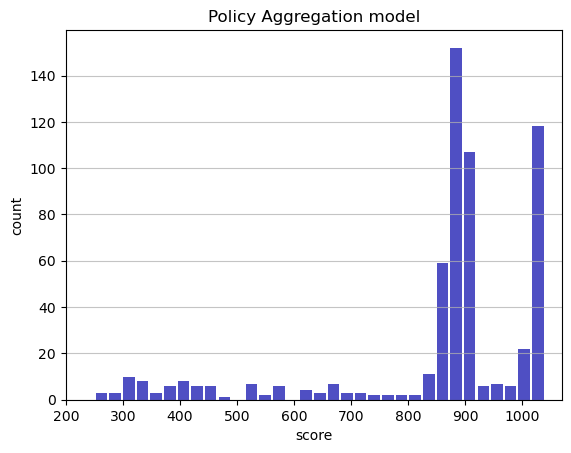

Track generation: 1135..1428 -> 293-tiles track
Epoch: 586
Policy Aggregation	mean: 856.13	variance: 183.73


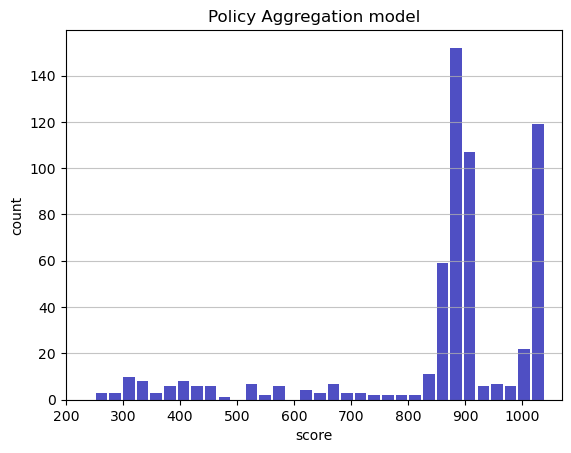

Track generation: 1035..1298 -> 263-tiles track
Epoch: 587
Policy Aggregation	mean: 856.19	variance: 183.58


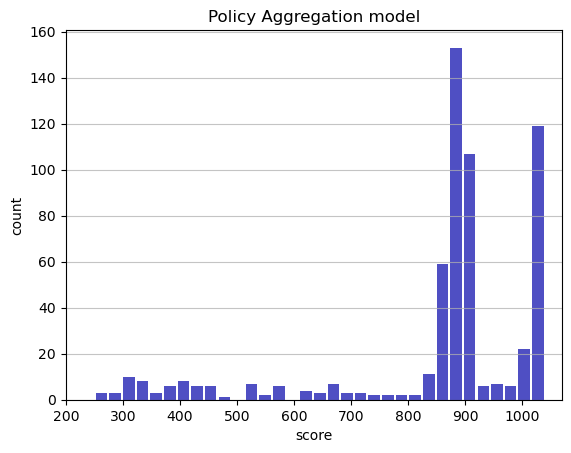

Track generation: 1358..1711 -> 353-tiles track
Epoch: 588
Policy Aggregation	mean: 855.51	variance: 184.15


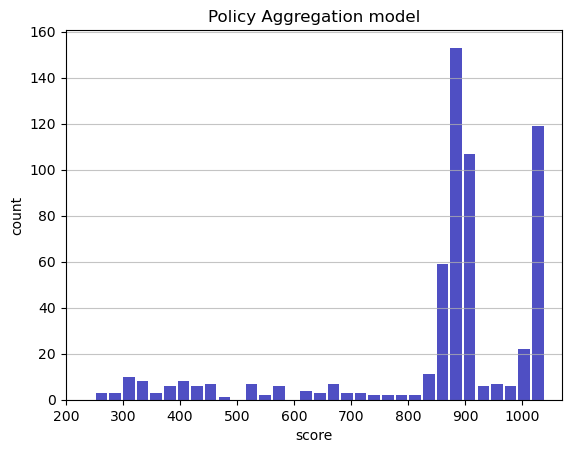

Track generation: 1125..1410 -> 285-tiles track
Epoch: 589
Policy Aggregation	mean: 854.69	variance: 185.07


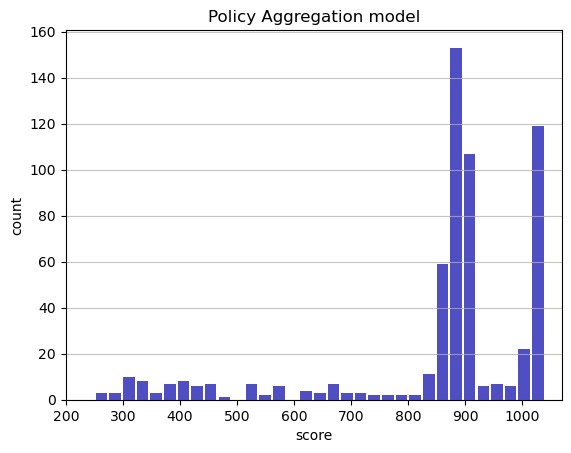

Track generation: 1042..1312 -> 270-tiles track
Epoch: 590
Policy Aggregation	mean: 854.79	variance: 184.93


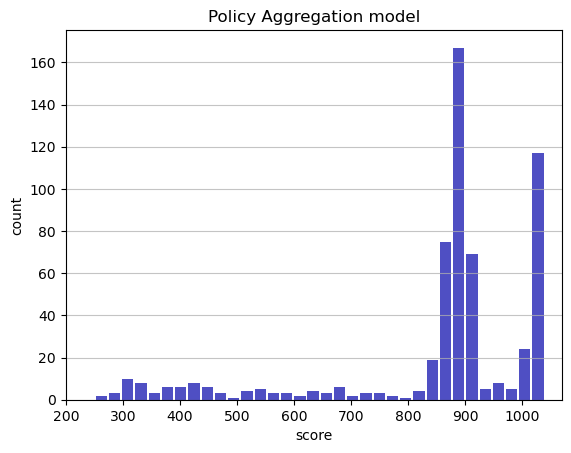

Track generation: 1171..1468 -> 297-tiles track
Epoch: 591
Policy Aggregation	mean: 854.89	variance: 184.78


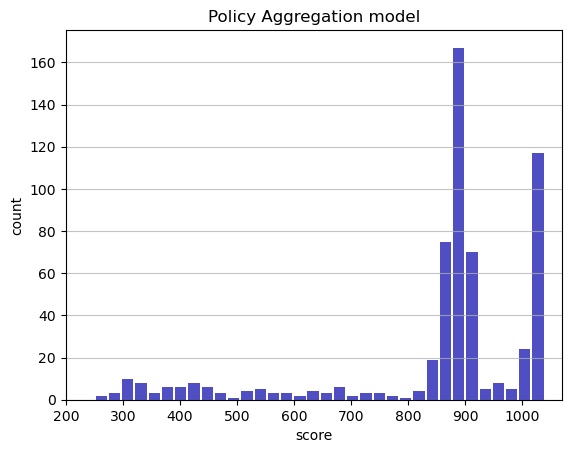

Track generation: 1088..1374 -> 286-tiles track
Epoch: 592
Policy Aggregation	mean: 854.97	variance: 184.64


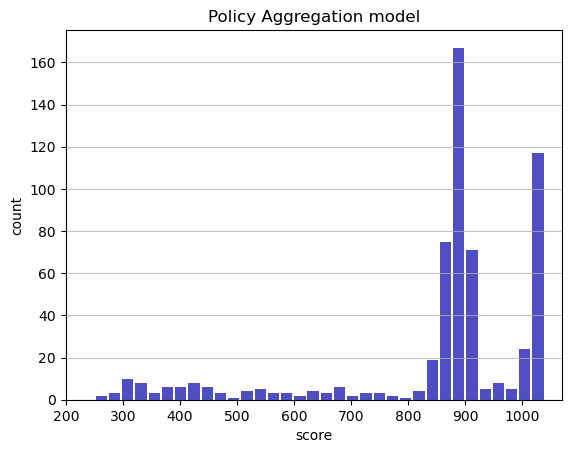

Track generation: 1248..1564 -> 316-tiles track
Epoch: 593
Policy Aggregation	mean: 855.25	variance: 184.61


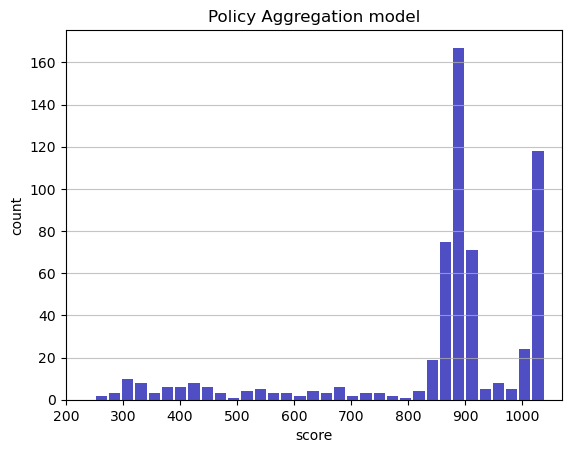

Track generation: 1228..1535 -> 307-tiles track
Epoch: 594
Policy Aggregation	mean: 855.28	variance: 184.45


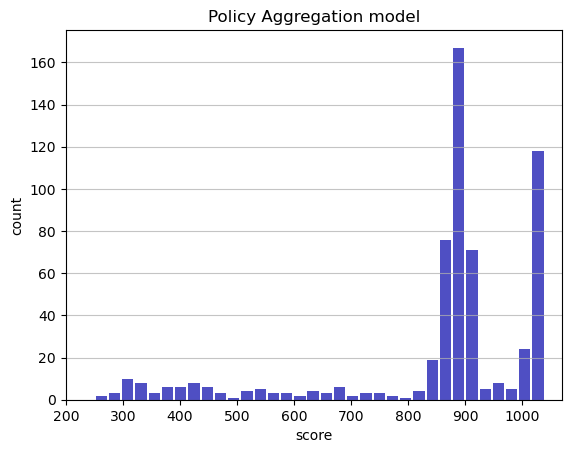

Track generation: 1069..1348 -> 279-tiles track
Epoch: 595
Policy Aggregation	mean: 855.56	variance: 184.43


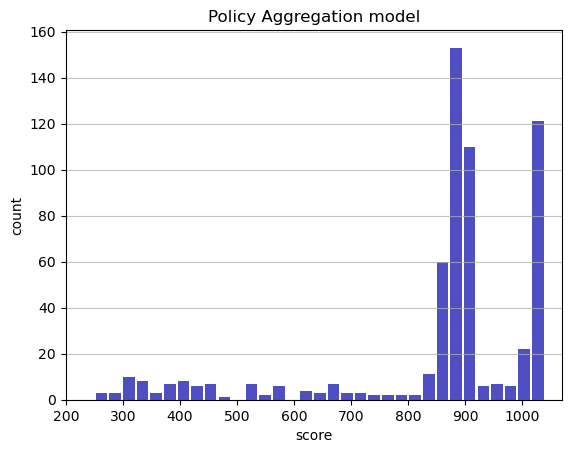

Track generation: 1149..1440 -> 291-tiles track
Epoch: 596
Policy Aggregation	mean: 855.63	variance: 184.28


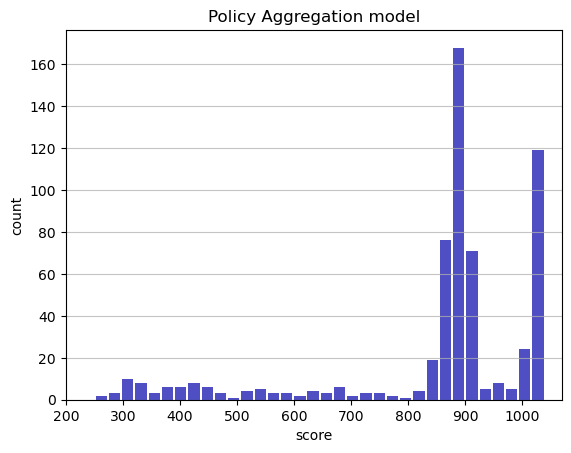

Track generation: 1100..1379 -> 279-tiles track
Epoch: 597
Policy Aggregation	mean: 855.69	variance: 184.13


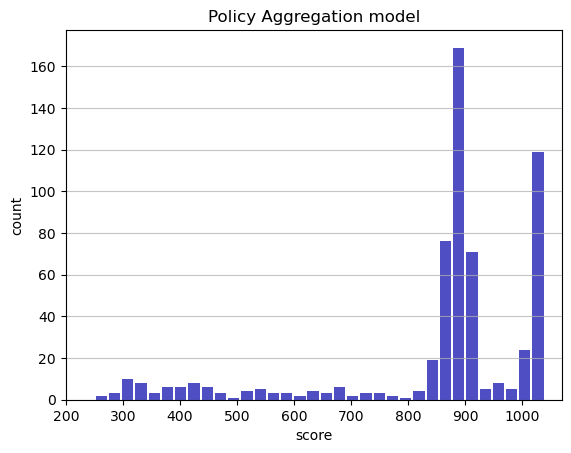

Track generation: 1032..1294 -> 262-tiles track
Epoch: 598
Policy Aggregation	mean: 855.99	variance: 184.12


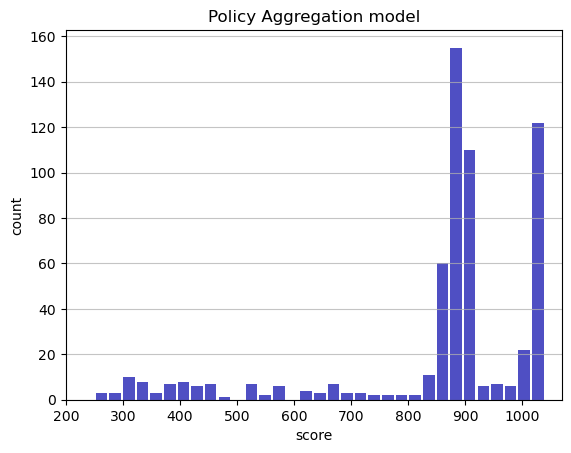

Track generation: 1182..1485 -> 303-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1086..1362 -> 276-tiles track
Epoch: 599
Policy Aggregation	mean: 856.04	variance: 183.97


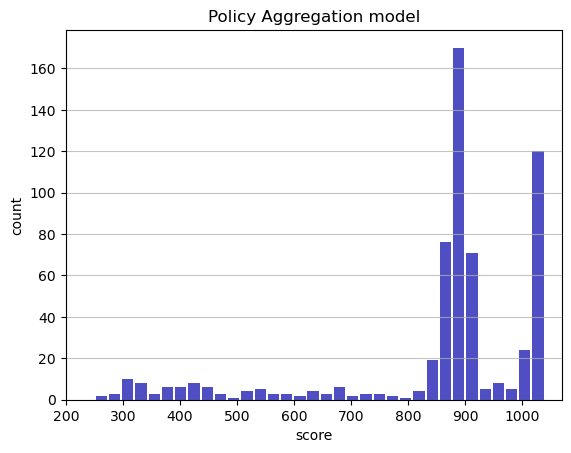

Track generation: 1060..1329 -> 269-tiles track
Epoch: 600
Policy Aggregation	mean: 856.11	variance: 183.83


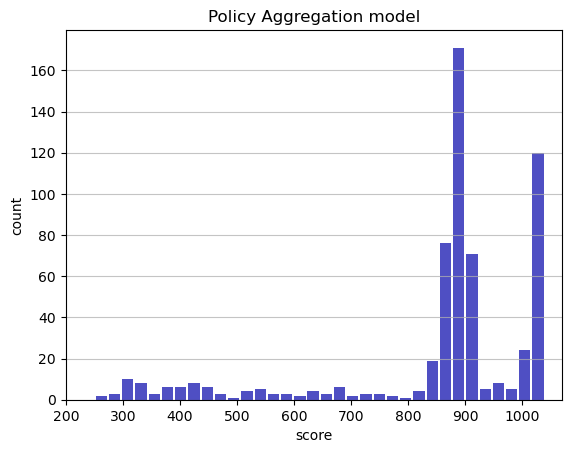

Track generation: 1106..1388 -> 282-tiles track
Epoch: 601
Policy Aggregation	mean: 855.81	variance: 183.82


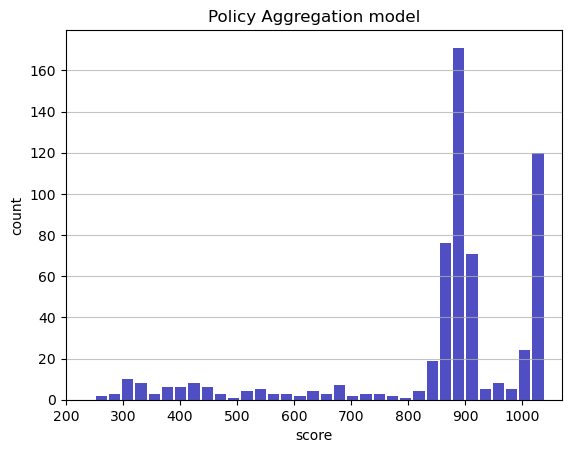

Track generation: 1156..1449 -> 293-tiles track
Epoch: 602
Policy Aggregation	mean: 856.09	variance: 183.80


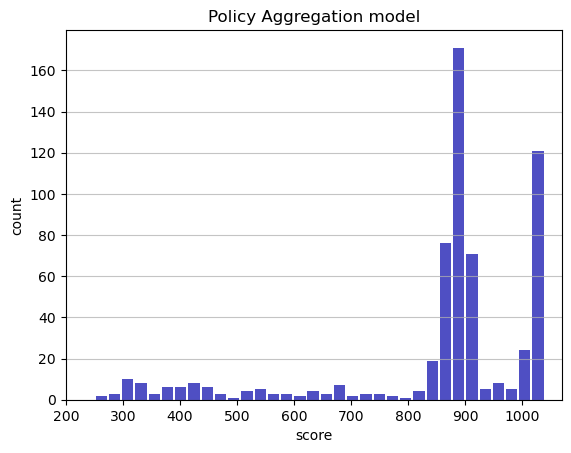

Track generation: 983..1239 -> 256-tiles track
Epoch: 603
Policy Aggregation	mean: 856.38	variance: 183.79


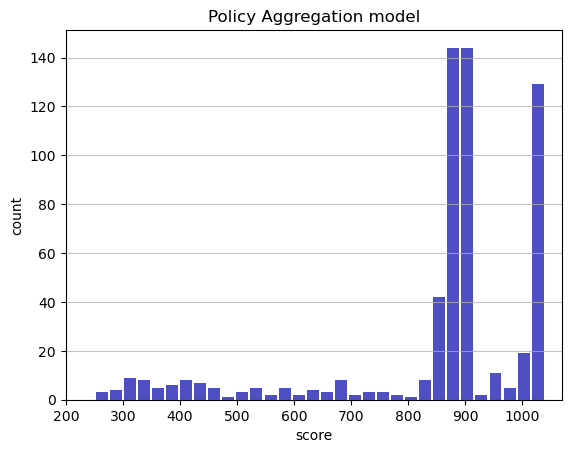

Track generation: 1081..1355 -> 274-tiles track
Epoch: 604
Policy Aggregation	mean: 856.67	variance: 183.77


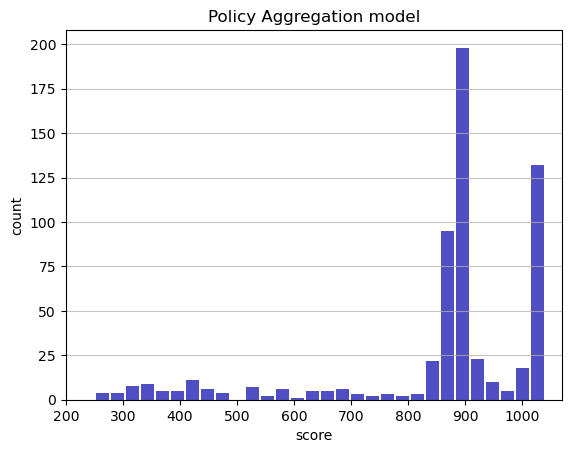

Track generation: 1251..1576 -> 325-tiles track
Epoch: 605
Policy Aggregation	mean: 856.73	variance: 183.63


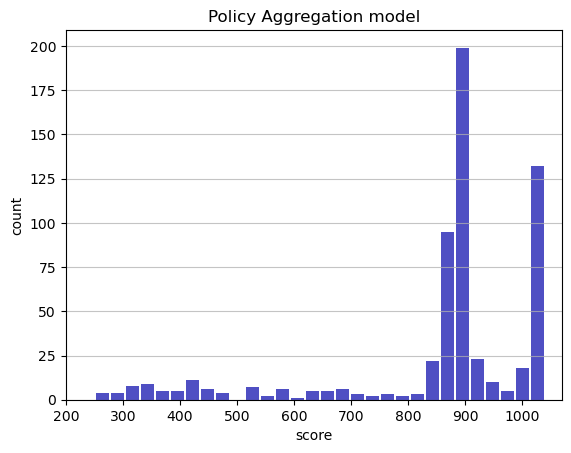

Track generation: 1156..1449 -> 293-tiles track
Epoch: 606
Policy Aggregation	mean: 855.88	variance: 184.68


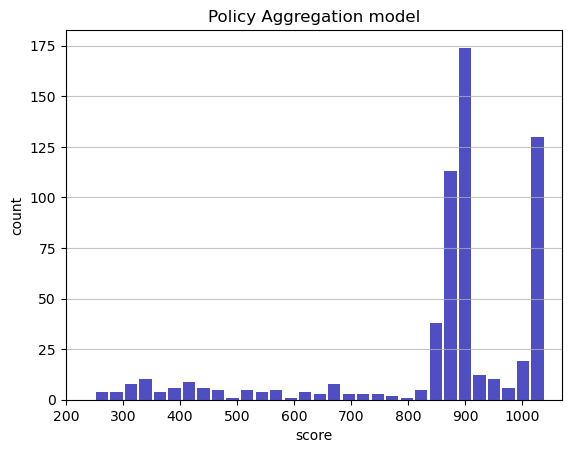

Track generation: 1079..1355 -> 276-tiles track
Epoch: 607
Policy Aggregation	mean: 855.96	variance: 184.54


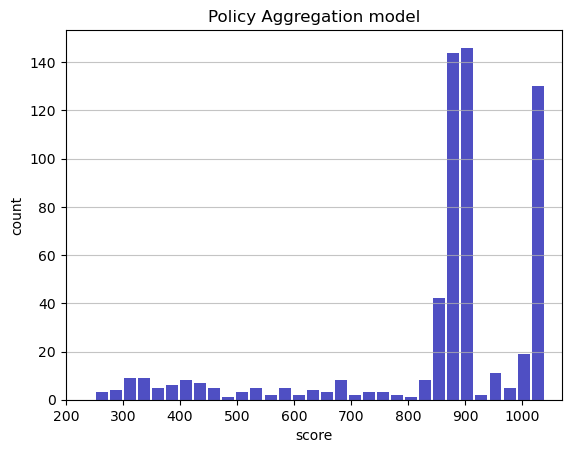

Track generation: 1285..1611 -> 326-tiles track
Epoch: 608
Policy Aggregation	mean: 856.22	variance: 184.50


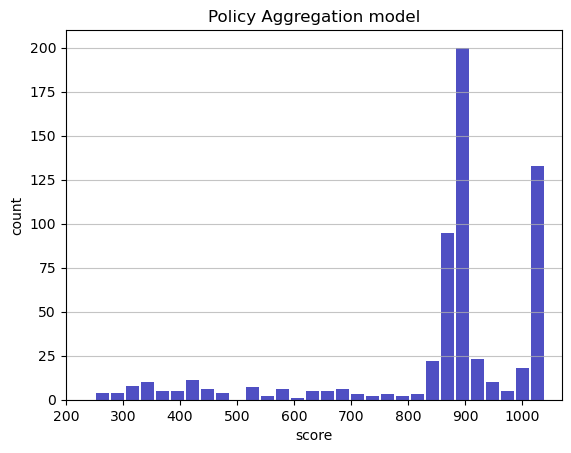

Track generation: 1184..1484 -> 300-tiles track
Epoch: 609
Policy Aggregation	mean: 856.49	variance: 184.47


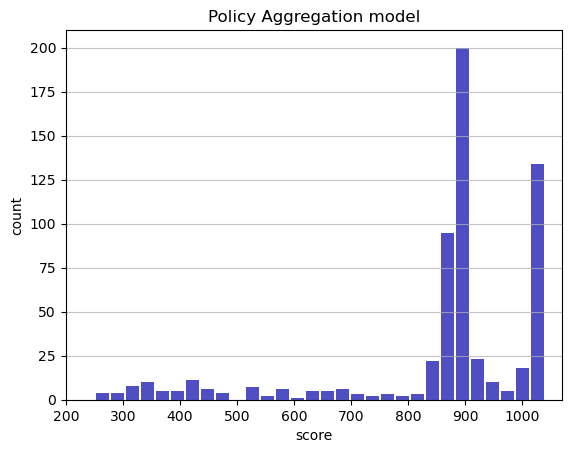

Track generation: 1079..1361 -> 282-tiles track
Epoch: 610
Policy Aggregation	mean: 856.49	variance: 184.32


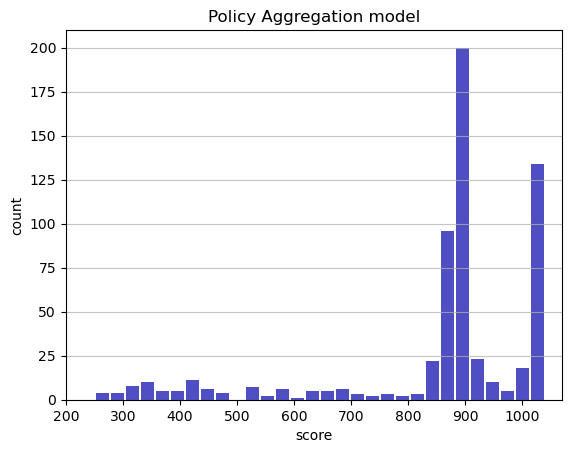

Track generation: 1227..1538 -> 311-tiles track
Epoch: 611
Policy Aggregation	mean: 856.57	variance: 184.17


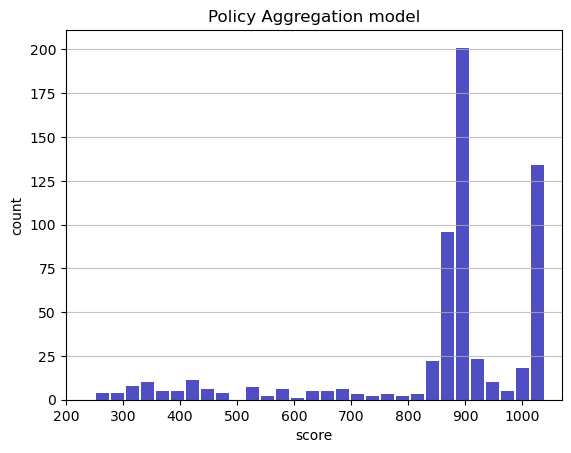

Track generation: 1155..1448 -> 293-tiles track
Epoch: 612
Policy Aggregation	mean: 856.62	variance: 184.03


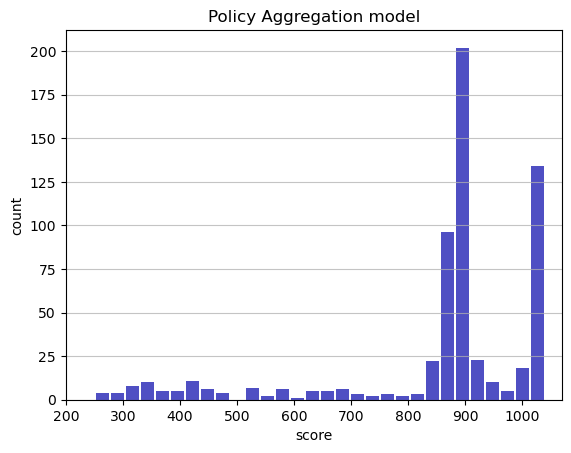

Track generation: 1149..1440 -> 291-tiles track
Epoch: 613
Policy Aggregation	mean: 856.57	variance: 183.88


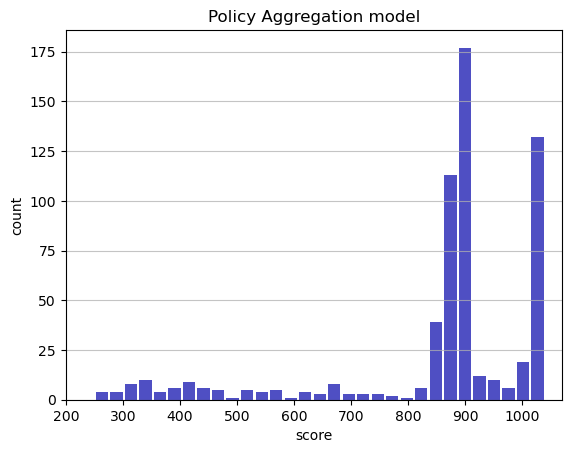

Track generation: 1169..1465 -> 296-tiles track
Epoch: 614
Policy Aggregation	mean: 856.84	variance: 183.85


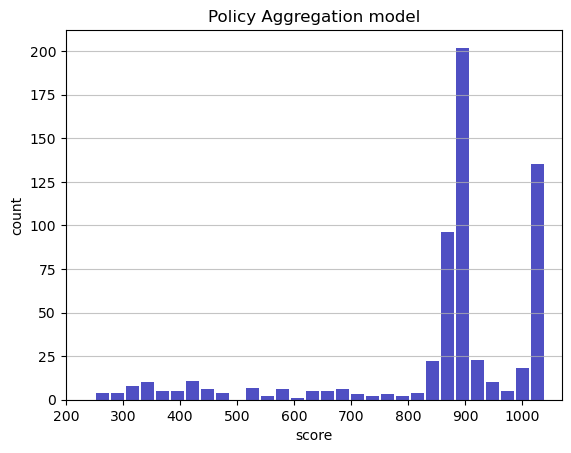

Track generation: 1271..1593 -> 322-tiles track
Epoch: 615
Policy Aggregation	mean: 856.88	variance: 183.71


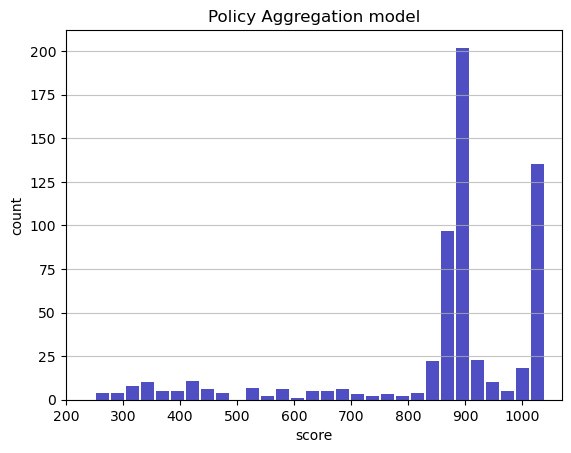

Track generation: 1155..1448 -> 293-tiles track
Epoch: 616
Policy Aggregation	mean: 856.86	variance: 183.56


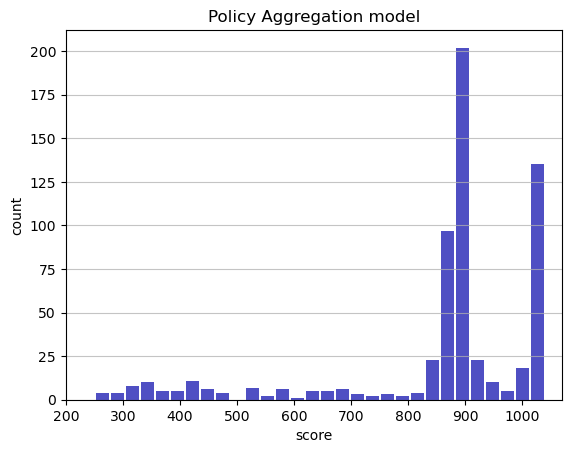

Track generation: 1081..1356 -> 275-tiles track
Epoch: 617
Policy Aggregation	mean: 856.94	variance: 183.42


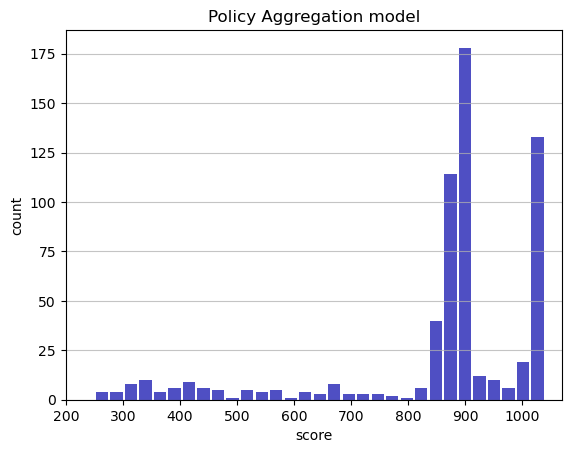

Track generation: 1068..1339 -> 271-tiles track
Epoch: 618
Policy Aggregation	mean: 857.23	variance: 183.41


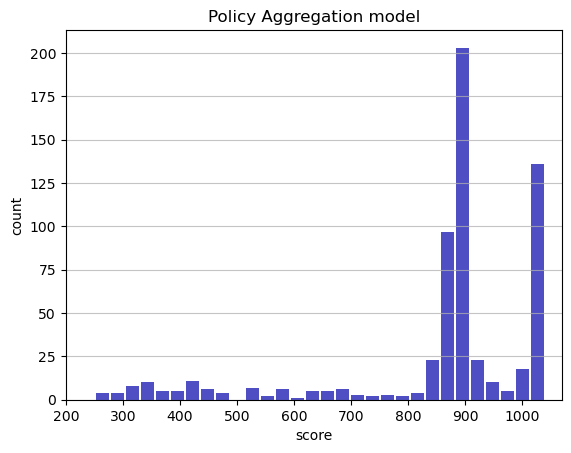

Track generation: 1140..1429 -> 289-tiles track
Epoch: 619
Policy Aggregation	mean: 857.31	variance: 183.27


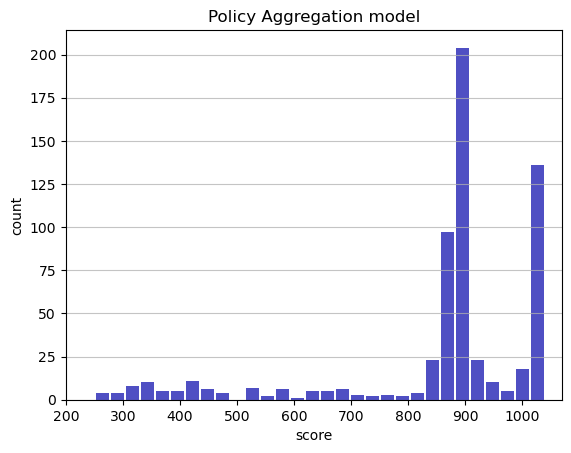

Track generation: 946..1191 -> 245-tiles track
Epoch: 620
Policy Aggregation	mean: 857.59	variance: 183.26


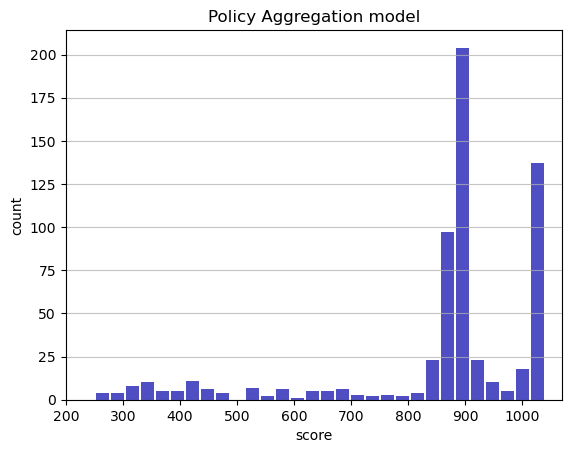

Track generation: 1204..1509 -> 305-tiles track
Epoch: 621
Policy Aggregation	mean: 857.85	variance: 183.22


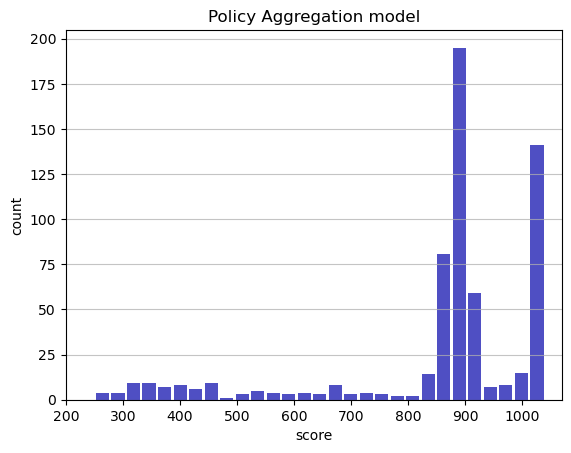

Track generation: 1148..1439 -> 291-tiles track
Epoch: 622
Policy Aggregation	mean: 857.87	variance: 183.08


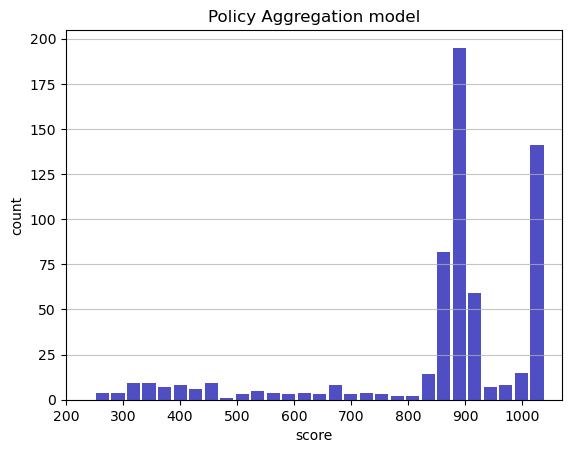

Track generation: 1127..1413 -> 286-tiles track
Epoch: 623
Policy Aggregation	mean: 857.95	variance: 182.94


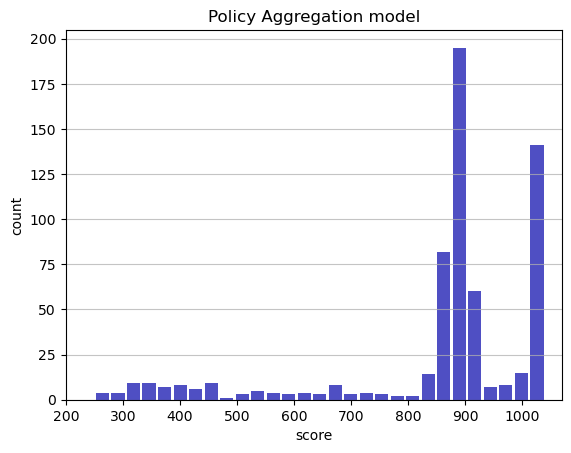

Track generation: 975..1225 -> 250-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1215..1523 -> 308-tiles track
Epoch: 624
Policy Aggregation	mean: 857.99	variance: 182.80


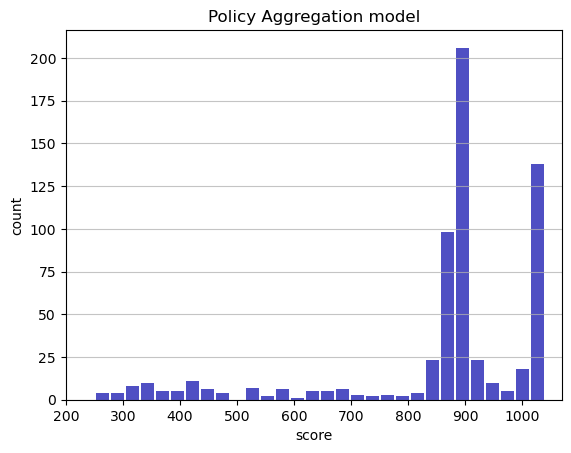

Track generation: 1245..1560 -> 315-tiles track
Epoch: 625
Policy Aggregation	mean: 858.24	variance: 182.76


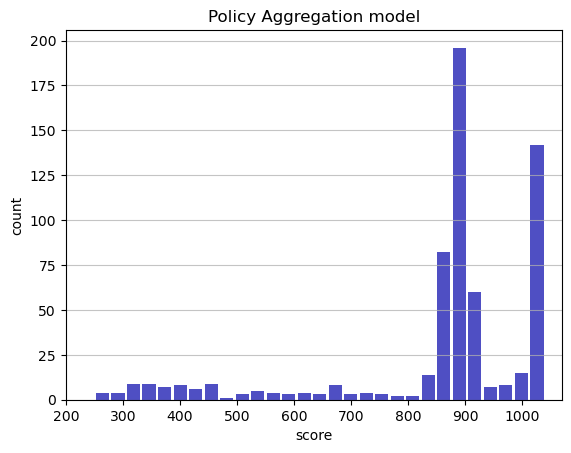

Track generation: 1172..1471 -> 299-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 983..1233 -> 250-tiles track
Epoch: 626
Policy Aggregation	mean: 858.32	variance: 182.62


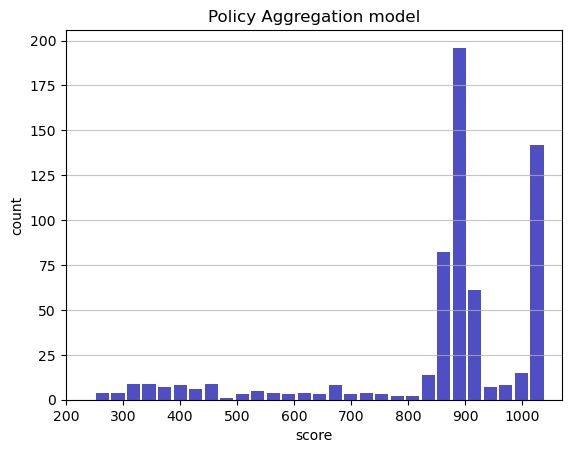

Track generation: 1152..1444 -> 292-tiles track
Epoch: 627
Policy Aggregation	mean: 858.58	variance: 182.59


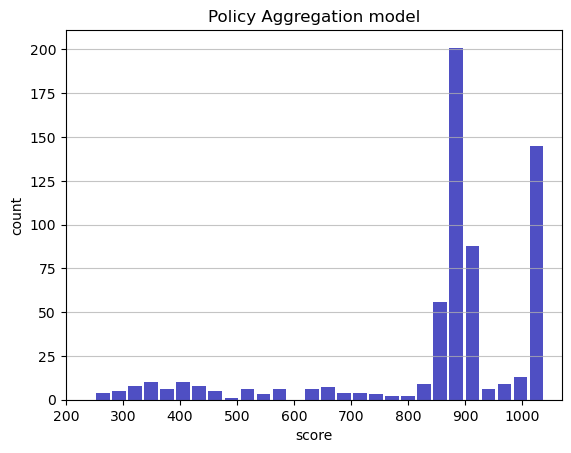

Track generation: 1081..1363 -> 282-tiles track
Epoch: 628
Policy Aggregation	mean: 858.62	variance: 182.45


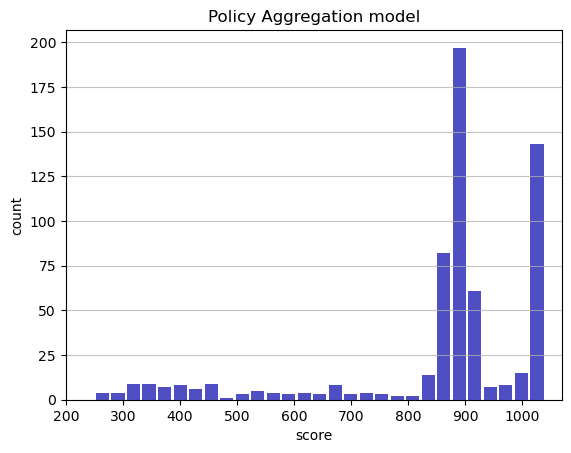

Track generation: 1015..1280 -> 265-tiles track
Epoch: 629
Policy Aggregation	mean: 858.62	variance: 182.31


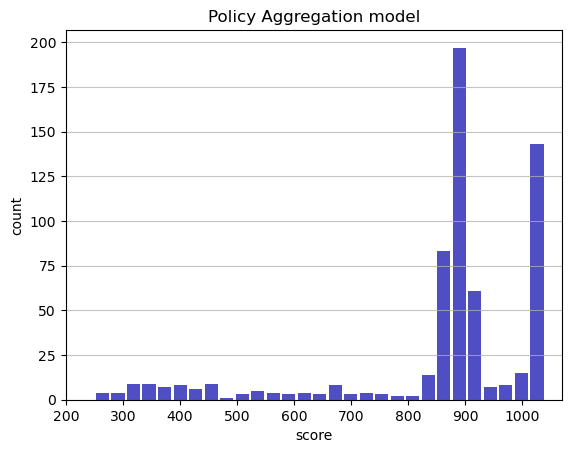

Track generation: 1168..1464 -> 296-tiles track
Epoch: 630
Policy Aggregation	mean: 858.67	variance: 182.17


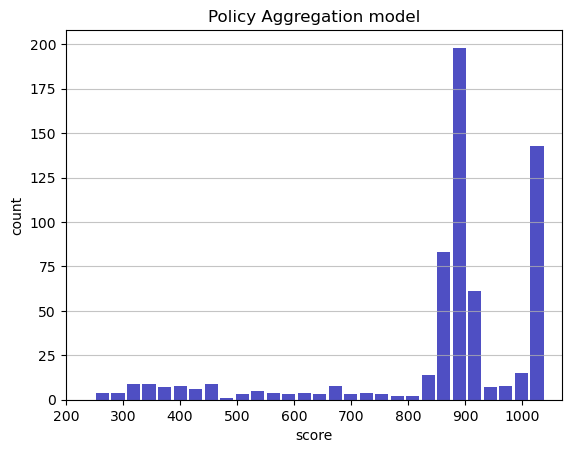

Track generation: 1452..1819 -> 367-tiles track
Epoch: 631
Policy Aggregation	mean: 858.71	variance: 182.02


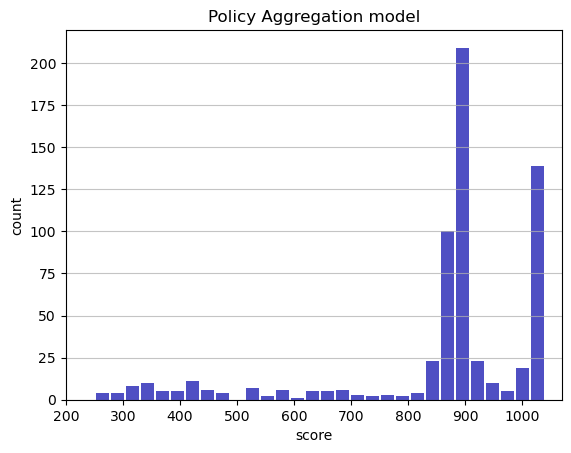

Track generation: 997..1250 -> 253-tiles track
Epoch: 632
Policy Aggregation	mean: 857.95	variance: 182.88


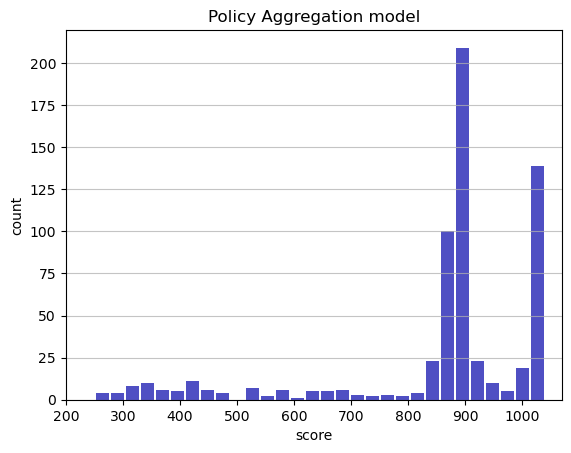

Track generation: 1027..1288 -> 261-tiles track
Epoch: 633
Policy Aggregation	mean: 858.02	variance: 182.74


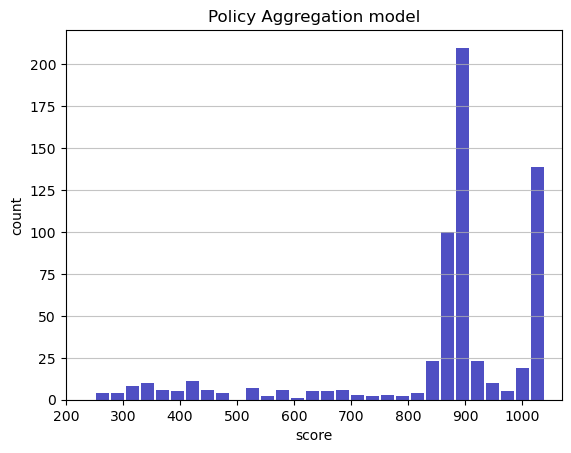

Track generation: 1178..1477 -> 299-tiles track
Epoch: 634
Policy Aggregation	mean: 858.10	variance: 182.61


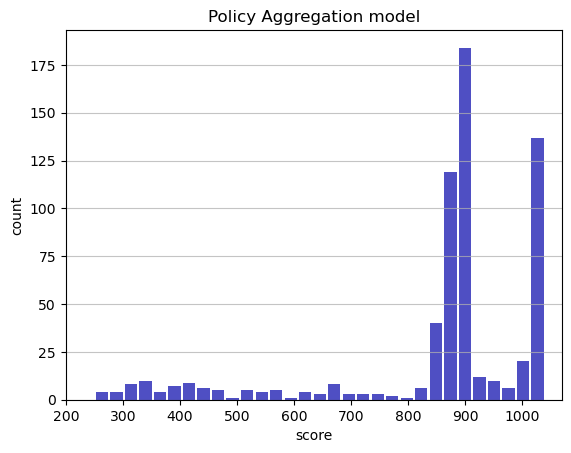

Track generation: 1128..1414 -> 286-tiles track
Epoch: 635
Policy Aggregation	mean: 858.11	variance: 182.47


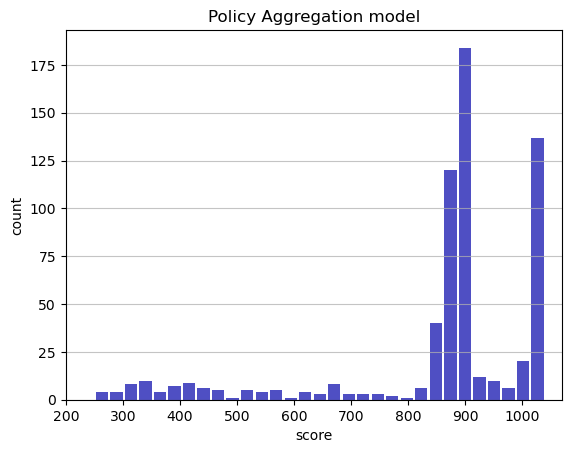

Track generation: 1121..1415 -> 294-tiles track
Epoch: 636
Policy Aggregation	mean: 858.14	variance: 182.33


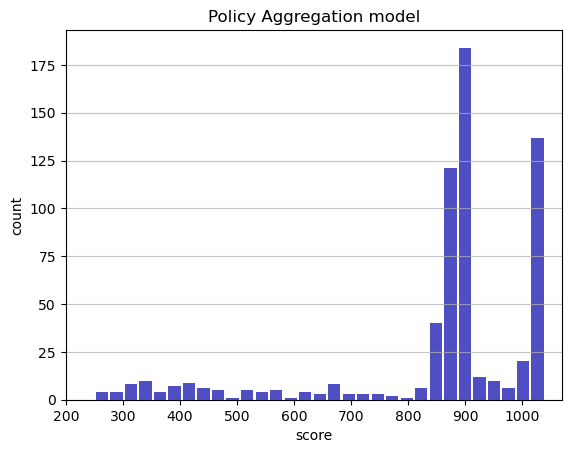

Track generation: 1014..1278 -> 264-tiles track
Epoch: 637
Policy Aggregation	mean: 858.13	variance: 182.18


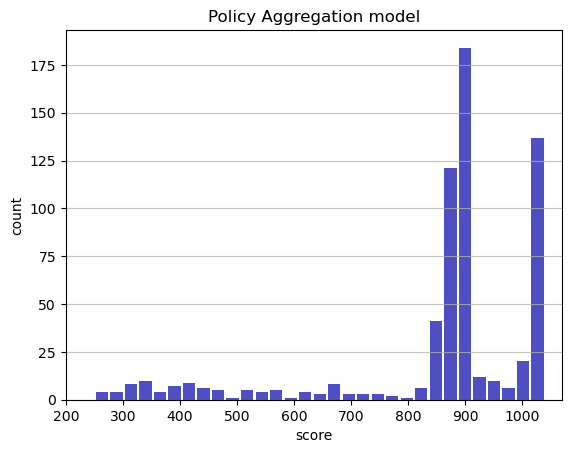

Track generation: 1056..1331 -> 275-tiles track
Epoch: 638
Policy Aggregation	mean: 858.13	variance: 182.04


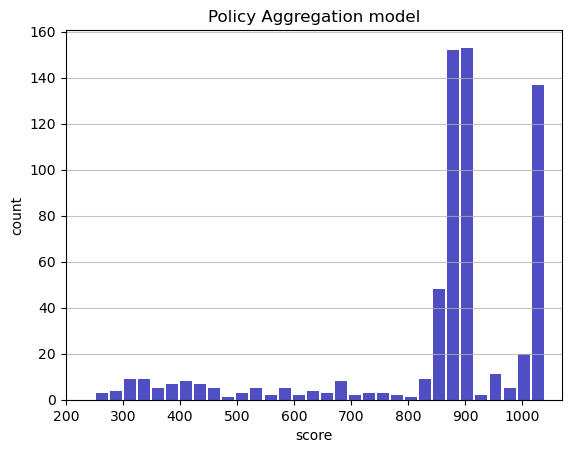

Track generation: 1103..1383 -> 280-tiles track
Epoch: 639
Policy Aggregation	mean: 858.39	variance: 182.02


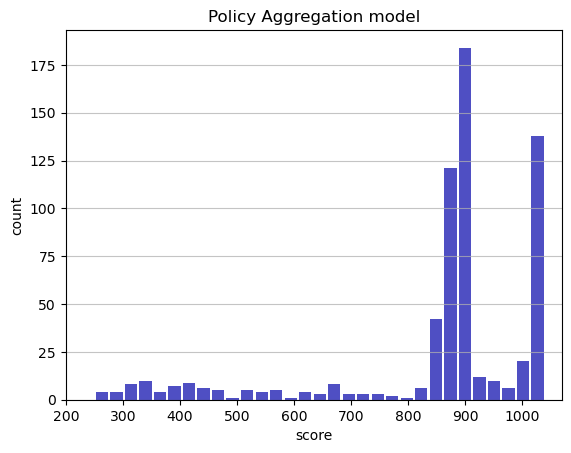

Track generation: 1186..1486 -> 300-tiles track
Epoch: 640
Policy Aggregation	mean: 858.44	variance: 181.88


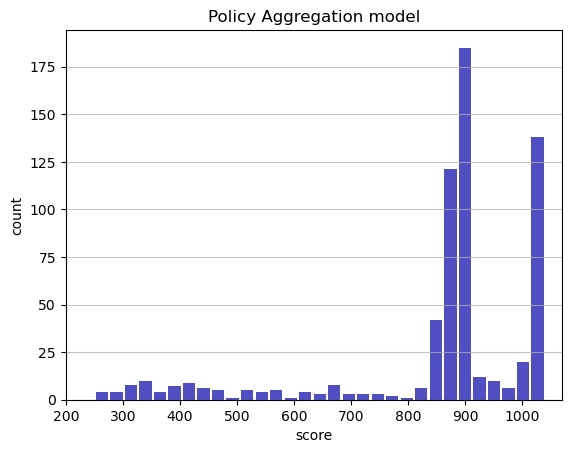

Track generation: 1101..1385 -> 284-tiles track
Epoch: 641
Policy Aggregation	mean: 858.50	variance: 181.74


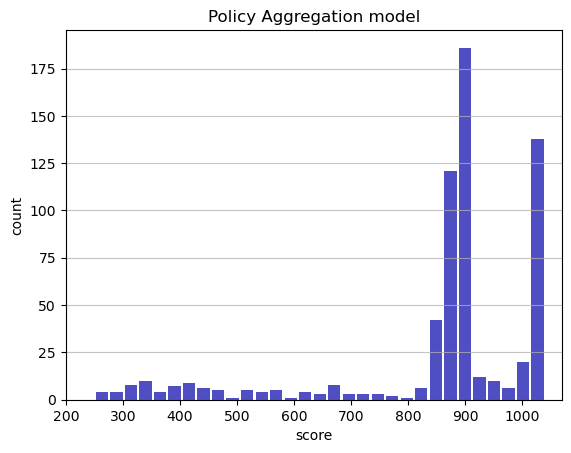

Track generation: 1047..1320 -> 273-tiles track
Epoch: 642
Policy Aggregation	mean: 858.57	variance: 181.61


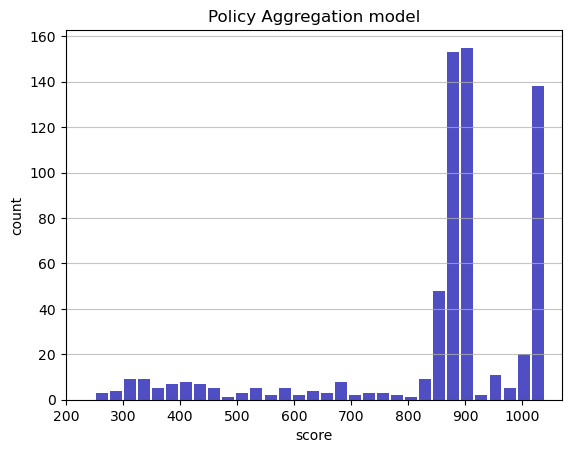

Track generation: 944..1189 -> 245-tiles track
Epoch: 643
Policy Aggregation	mean: 858.64	variance: 181.48


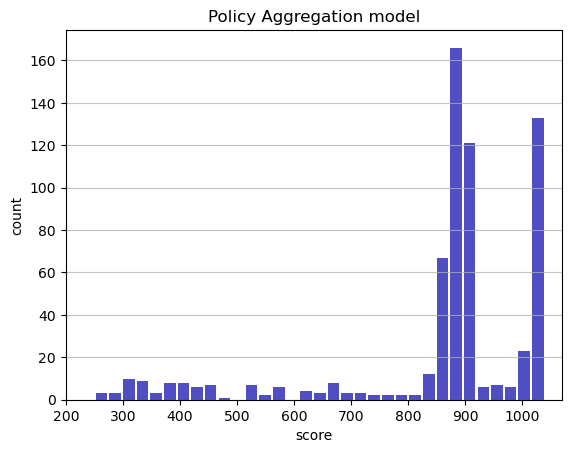

Track generation: 1114..1397 -> 283-tiles track
Epoch: 644
Policy Aggregation	mean: 858.69	variance: 181.34


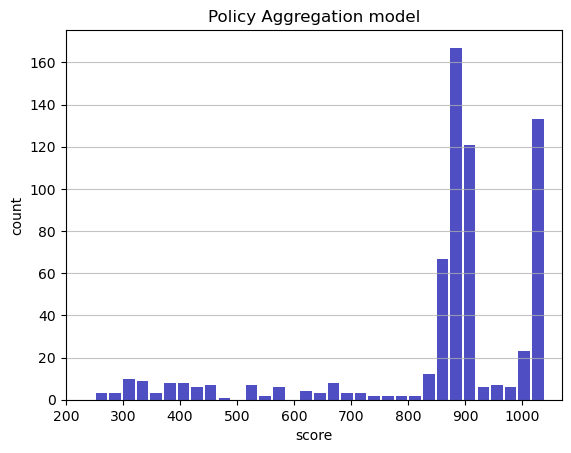

Track generation: 1162..1456 -> 294-tiles track
Epoch: 645
Policy Aggregation	mean: 858.69	variance: 181.20


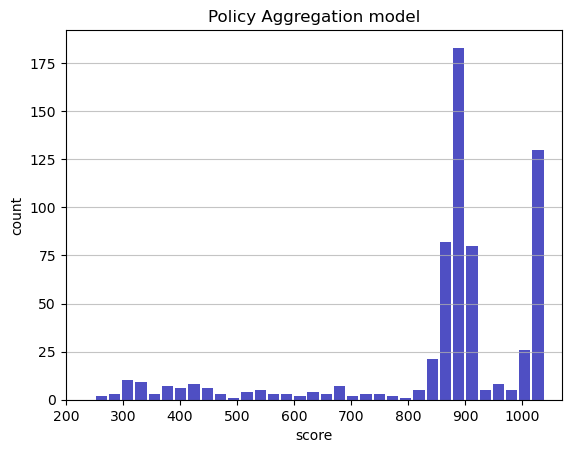

Track generation: 1024..1284 -> 260-tiles track
Epoch: 646
Policy Aggregation	mean: 858.74	variance: 181.07


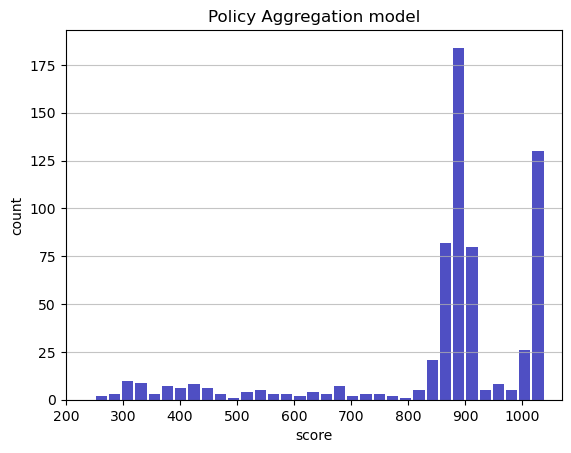

Track generation: 1104..1389 -> 285-tiles track
Epoch: 647
Policy Aggregation	mean: 858.80	variance: 180.93


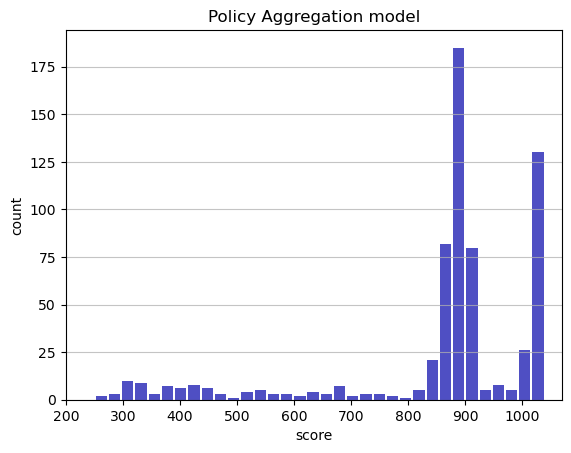

Track generation: 1032..1294 -> 262-tiles track
Epoch: 648
Policy Aggregation	mean: 858.84	variance: 180.80


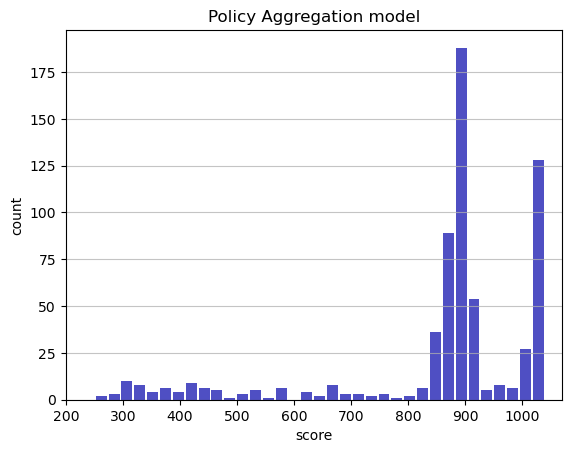

Track generation: 1173..1472 -> 299-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1123..1408 -> 285-tiles track
Epoch: 649
Policy Aggregation	mean: 858.88	variance: 180.66


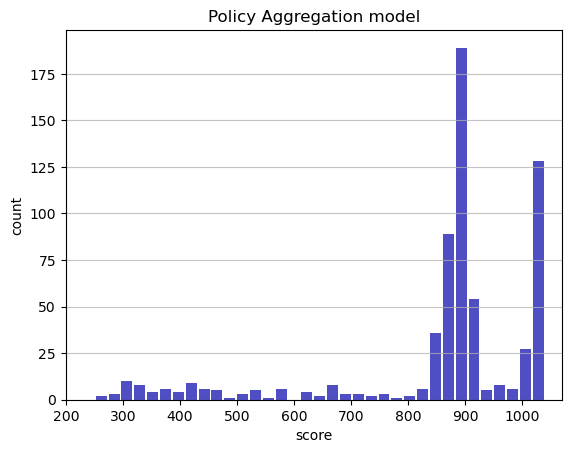

Track generation: 1299..1628 -> 329-tiles track
Epoch: 650
Policy Aggregation	mean: 858.90	variance: 180.52


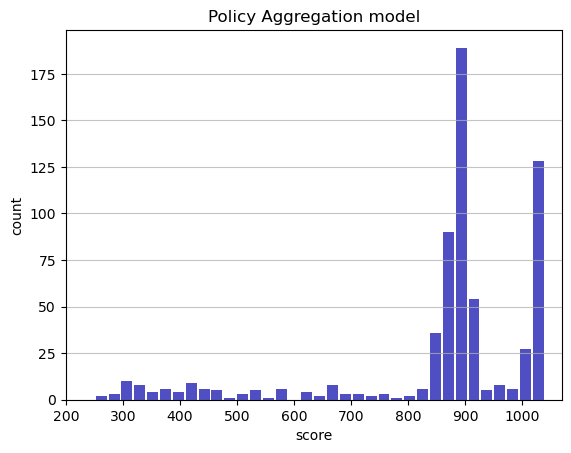

Track generation: 1117..1403 -> 286-tiles track
Epoch: 651
Policy Aggregation	mean: 858.96	variance: 180.39


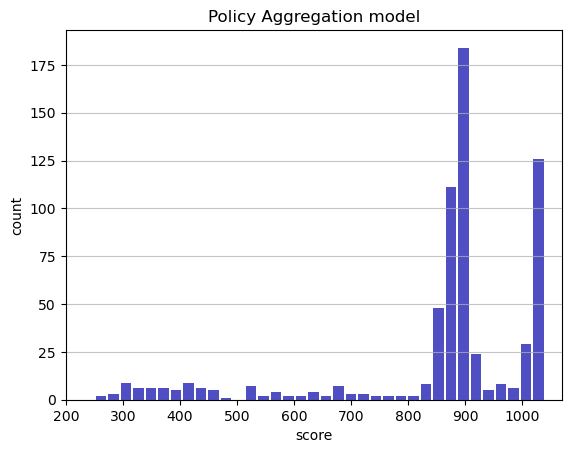

Track generation: 1465..1836 -> 371-tiles track
Epoch: 652
Policy Aggregation	mean: 859.13	variance: 180.30


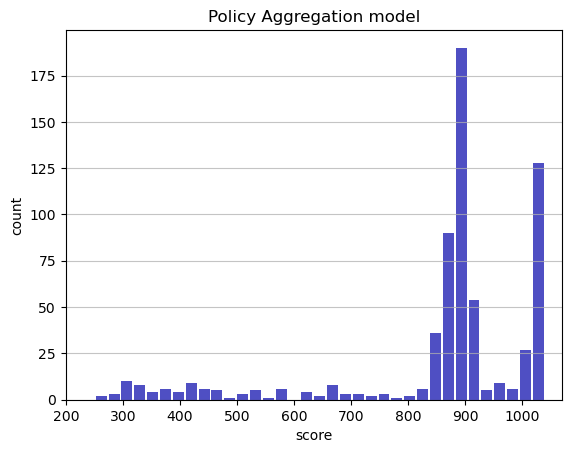

Track generation: 1129..1415 -> 286-tiles track
Epoch: 653
Policy Aggregation	mean: 859.21	variance: 180.17


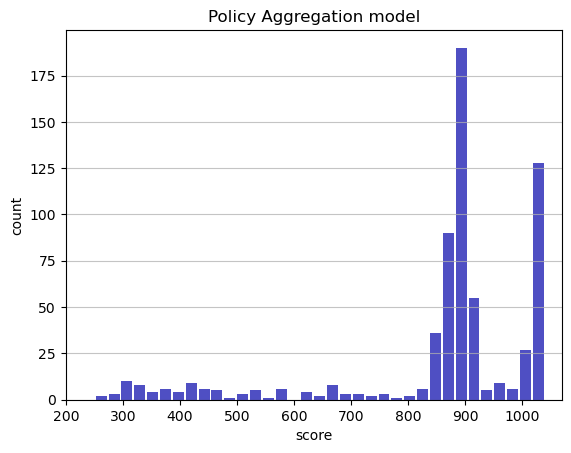

Track generation: 1076..1358 -> 282-tiles track
Epoch: 654
Policy Aggregation	mean: 859.26	variance: 180.04


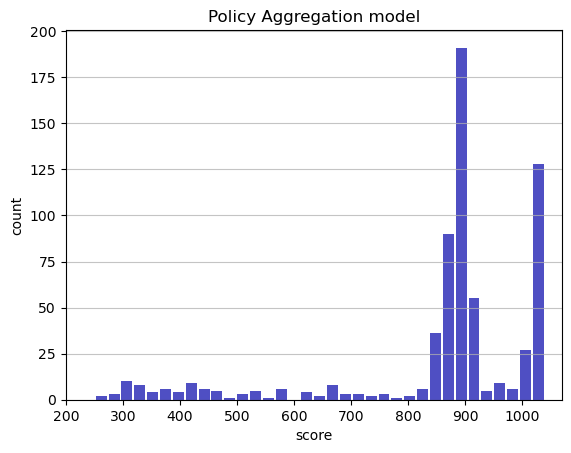

Track generation: 1124..1409 -> 285-tiles track
Epoch: 655
Policy Aggregation	mean: 859.26	variance: 179.91


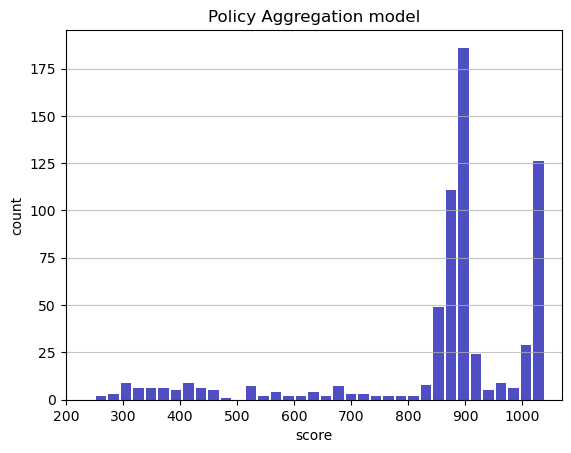

Track generation: 1128..1414 -> 286-tiles track
Epoch: 656
Policy Aggregation	mean: 859.26	variance: 179.77


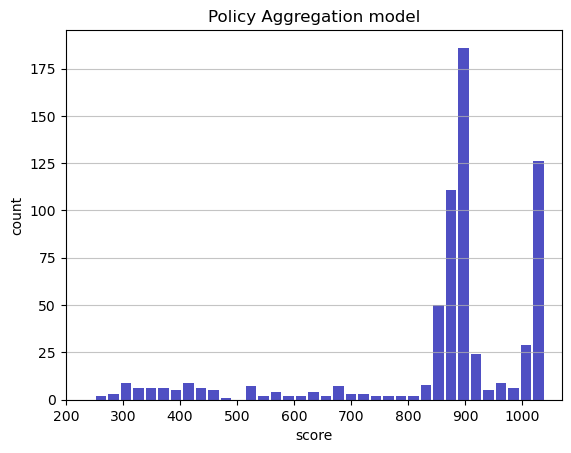

Track generation: 1014..1274 -> 260-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1164..1459 -> 295-tiles track
Epoch: 657
Policy Aggregation	mean: 859.27	variance: 179.63


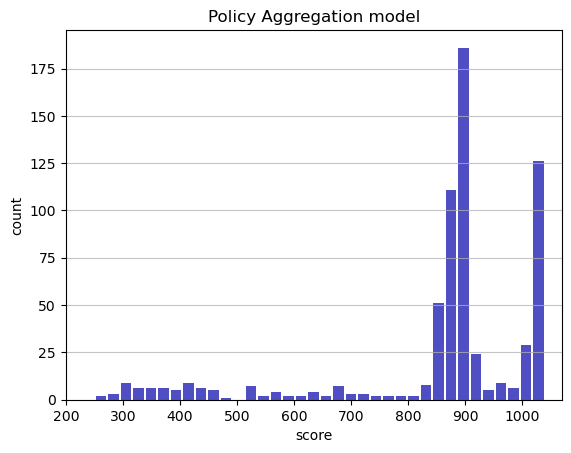

Track generation: 1019..1282 -> 263-tiles track
Epoch: 658
Policy Aggregation	mean: 859.37	variance: 179.51


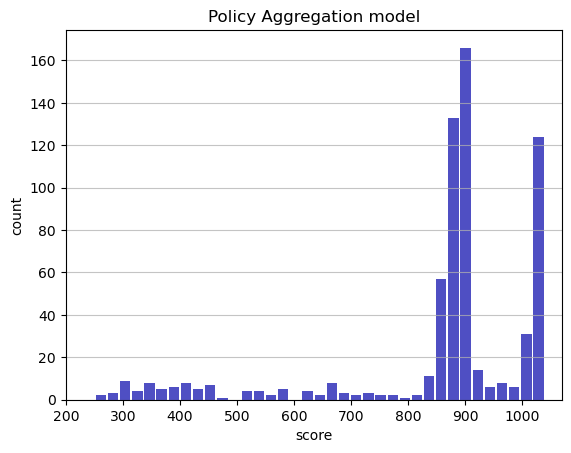

Track generation: 1150..1449 -> 299-tiles track
Epoch: 659
Policy Aggregation	mean: 859.39	variance: 179.38


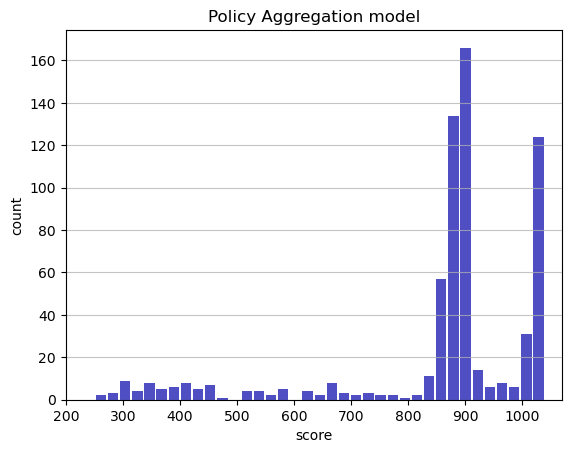

Track generation: 1123..1408 -> 285-tiles track
Epoch: 660
Policy Aggregation	mean: 859.65	variance: 179.36


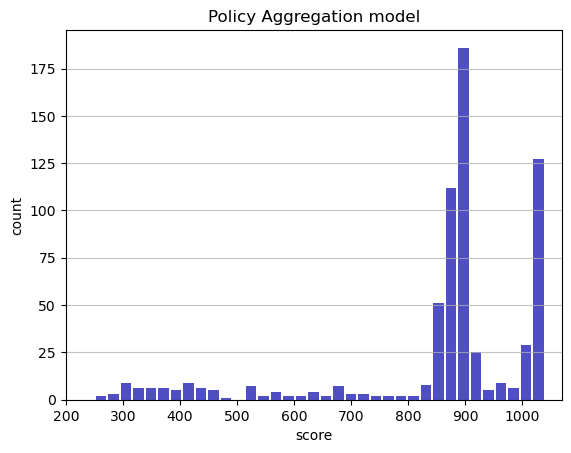

Track generation: 1172..1469 -> 297-tiles track
Epoch: 661
Policy Aggregation	mean: 859.70	variance: 179.23


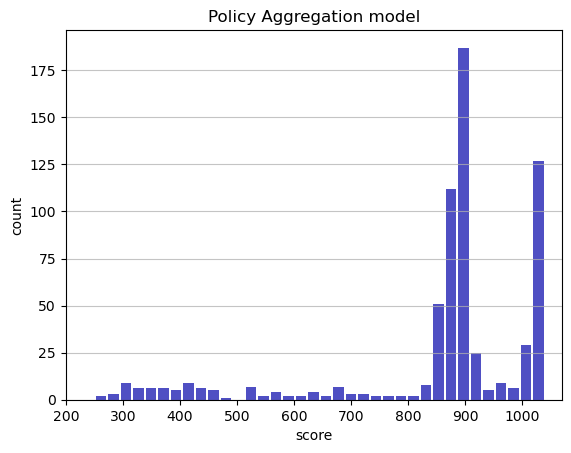

Track generation: 1368..1714 -> 346-tiles track
Epoch: 662
Policy Aggregation	mean: 859.92	variance: 179.18


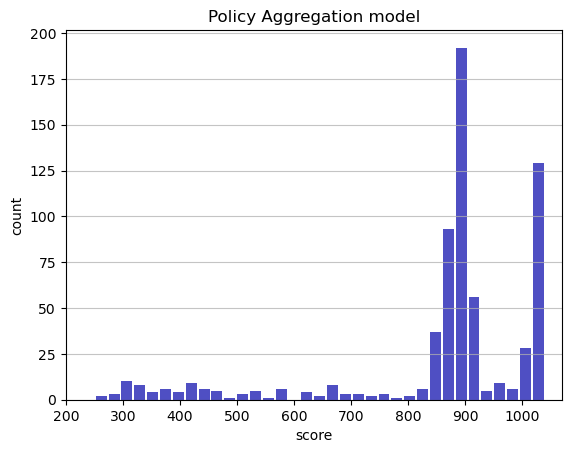

Track generation: 1147..1443 -> 296-tiles track
Epoch: 663
Policy Aggregation	mean: 860.16	variance: 179.15


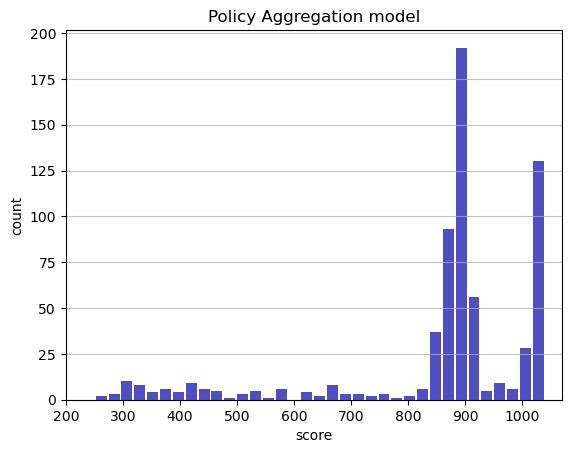

Track generation: 1111..1393 -> 282-tiles track
Epoch: 664
Policy Aggregation	mean: 860.18	variance: 179.02


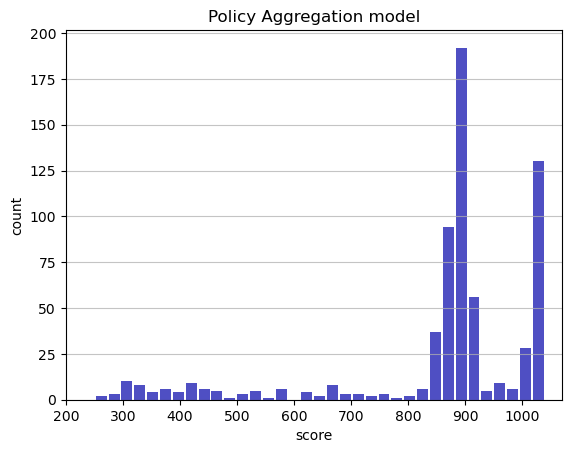

Track generation: 1346..1687 -> 341-tiles track
Epoch: 665
Policy Aggregation	mean: 860.38	variance: 178.96


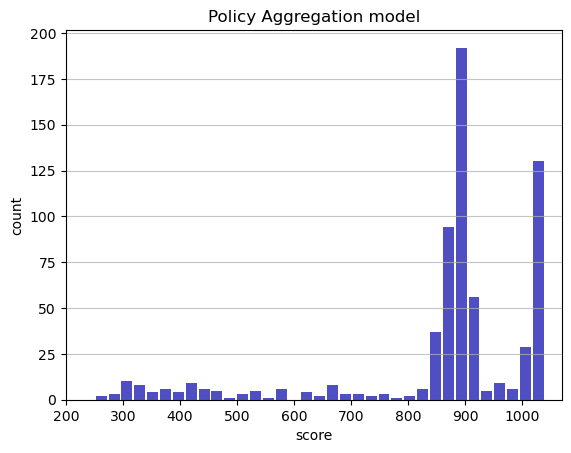

Track generation: 1119..1403 -> 284-tiles track
Epoch: 666
Policy Aggregation	mean: 860.64	variance: 178.95


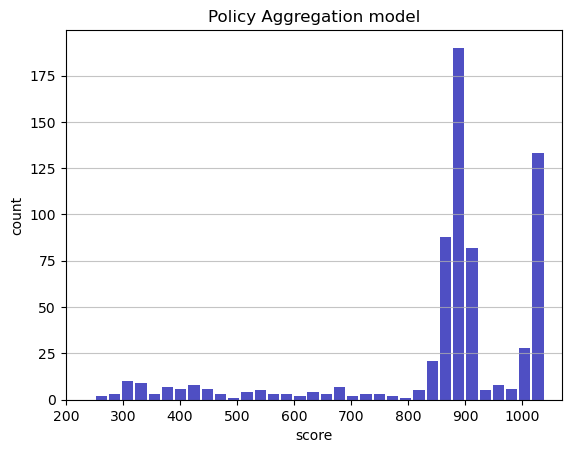

Track generation: 1191..1493 -> 302-tiles track
Epoch: 667
Policy Aggregation	mean: 860.88	variance: 178.92


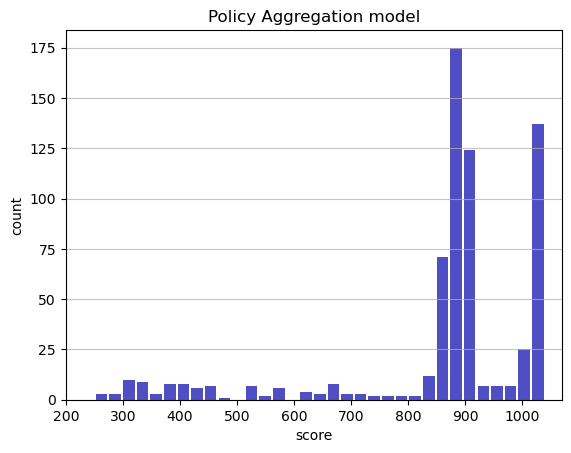

Track generation: 1124..1418 -> 294-tiles track
Epoch: 668
Policy Aggregation	mean: 860.91	variance: 178.79


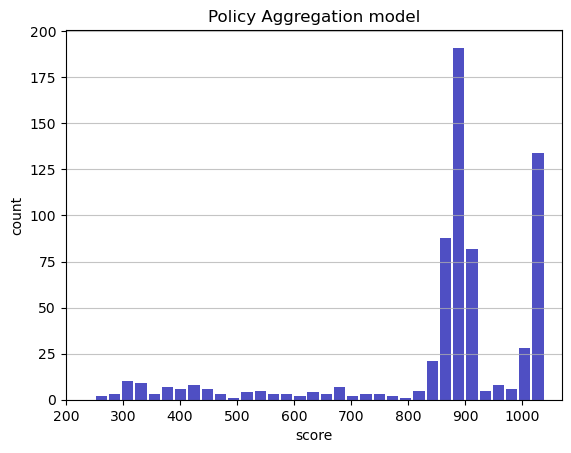

Track generation: 1128..1422 -> 294-tiles track
Epoch: 669
Policy Aggregation	mean: 860.96	variance: 178.66


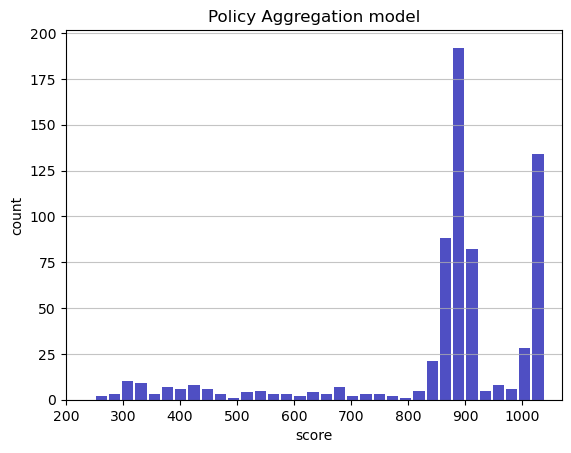

Track generation: 1147..1438 -> 291-tiles track
Epoch: 670
Policy Aggregation	mean: 861.00	variance: 178.53


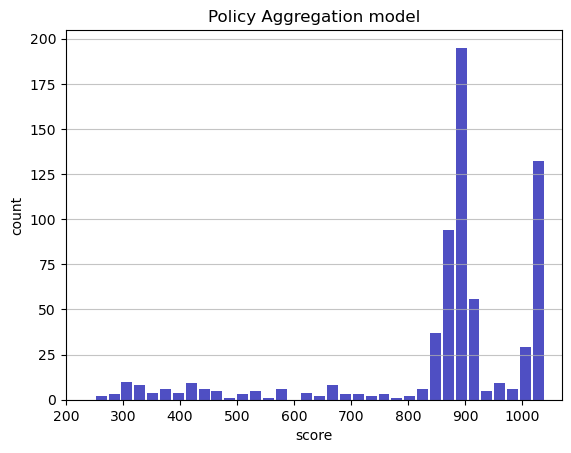

Track generation: 1149..1440 -> 291-tiles track
Epoch: 671
Policy Aggregation	mean: 861.03	variance: 178.40


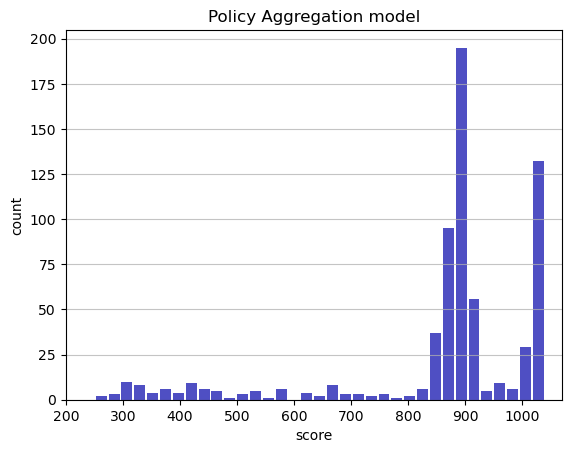

Track generation: 1408..1764 -> 356-tiles track
Epoch: 672
Policy Aggregation	mean: 861.15	variance: 178.29


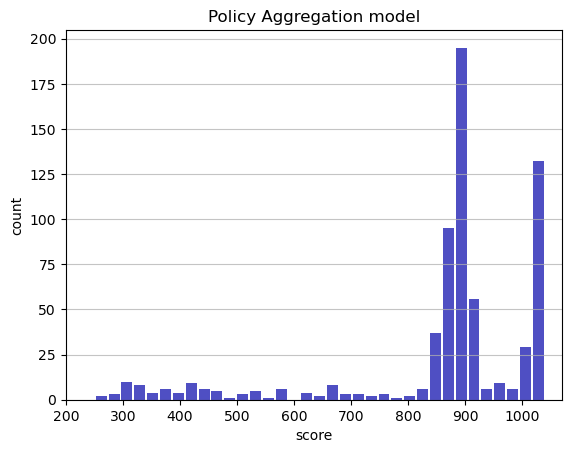

Track generation: 1232..1544 -> 312-tiles track
Epoch: 673
Policy Aggregation	mean: 860.20	variance: 179.87


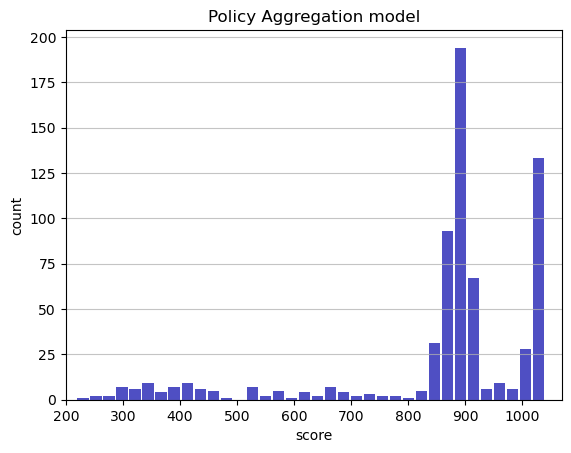

Track generation: 1224..1534 -> 310-tiles track
Epoch: 674
Policy Aggregation	mean: 859.29	variance: 181.27


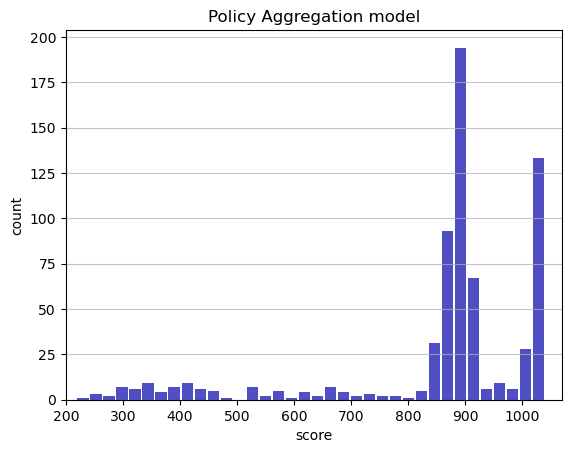

Track generation: 1100..1379 -> 279-tiles track
Epoch: 675
Policy Aggregation	mean: 859.36	variance: 181.15


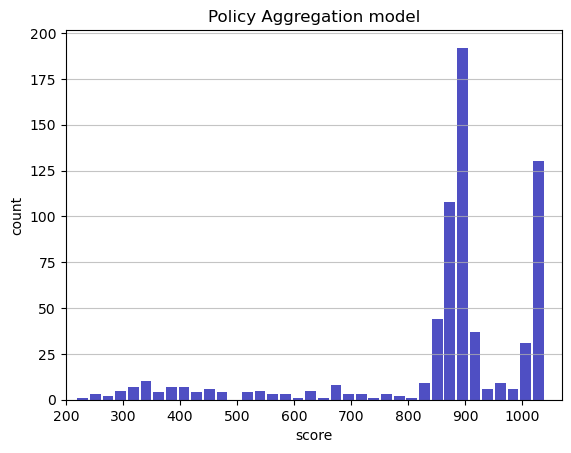

Track generation: 1134..1421 -> 287-tiles track
Epoch: 676
Policy Aggregation	mean: 859.61	variance: 181.13


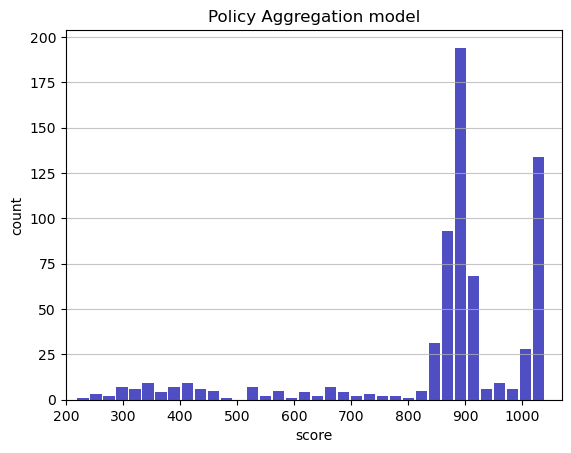

Track generation: 1048..1316 -> 268-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1357..1701 -> 344-tiles track
Epoch: 677
Policy Aggregation	mean: 859.79	variance: 181.06


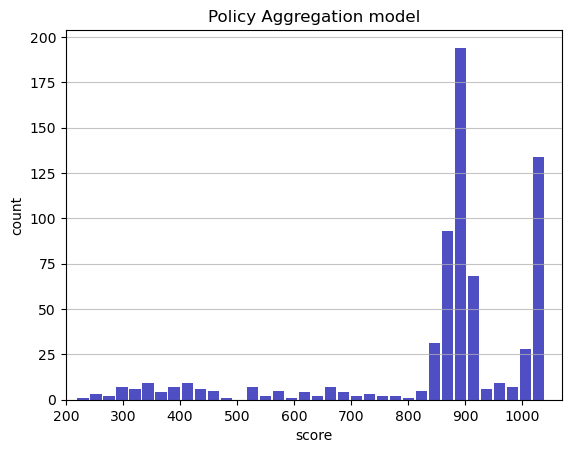

Track generation: 1170..1474 -> 304-tiles track
Epoch: 678
Policy Aggregation	mean: 860.03	variance: 181.03


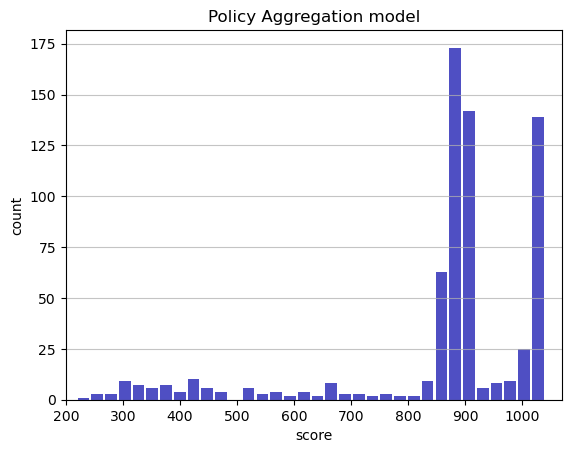

Track generation: 1177..1476 -> 299-tiles track
Epoch: 679
Policy Aggregation	mean: 859.84	variance: 180.96


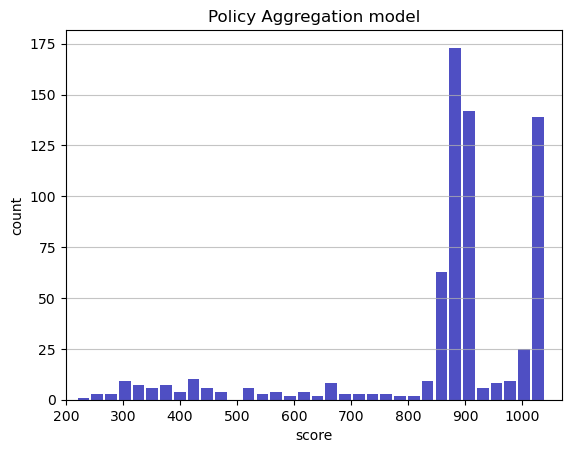

Track generation: 1184..1492 -> 308-tiles track
Epoch: 680
Policy Aggregation	mean: 859.17	variance: 181.66


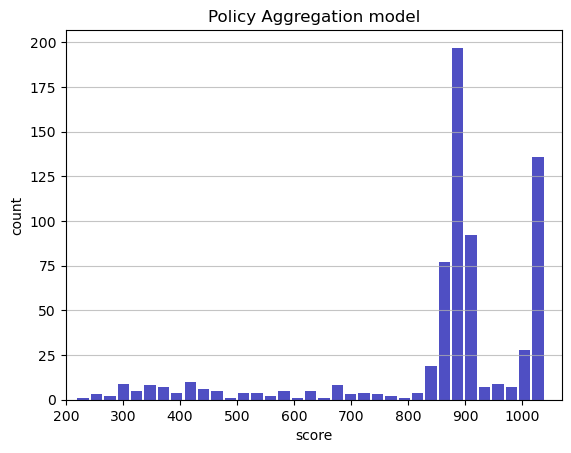

Track generation: 1270..1592 -> 322-tiles track
Epoch: 681
Policy Aggregation	mean: 858.39	variance: 182.65


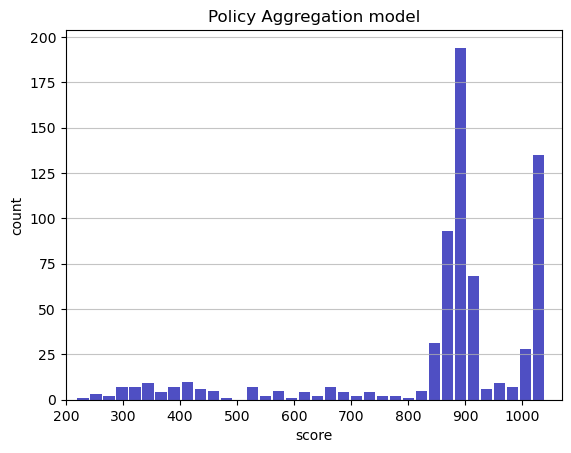

Track generation: 1064..1334 -> 270-tiles track
Epoch: 682
Policy Aggregation	mean: 858.42	variance: 182.52


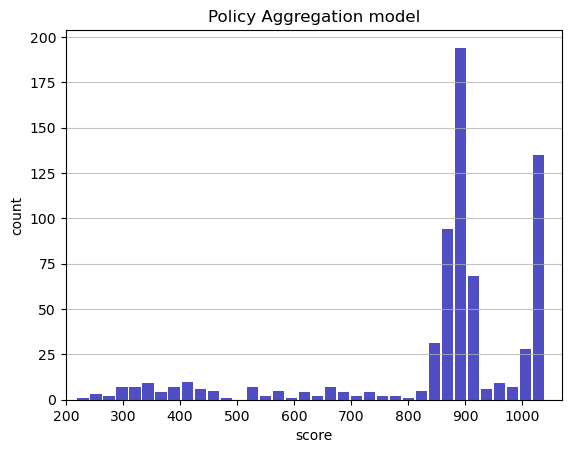

Track generation: 1168..1464 -> 296-tiles track
Epoch: 683
Policy Aggregation	mean: 858.46	variance: 182.39


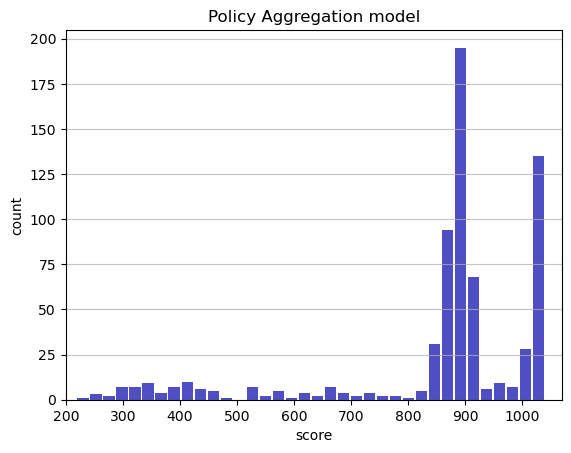

Track generation: 1068..1339 -> 271-tiles track
Epoch: 684
Policy Aggregation	mean: 858.49	variance: 182.26


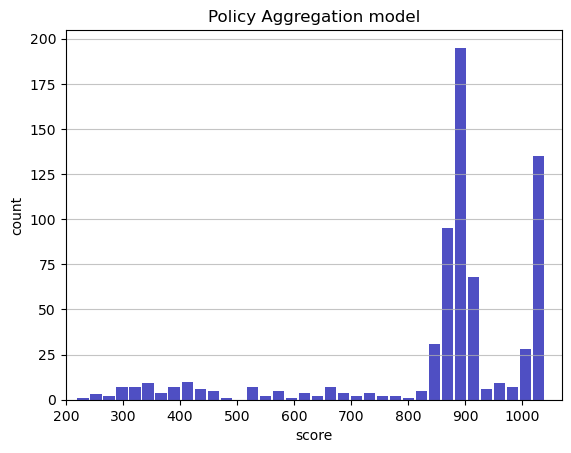

Track generation: 1099..1385 -> 286-tiles track
Epoch: 685
Policy Aggregation	mean: 858.02	variance: 182.54


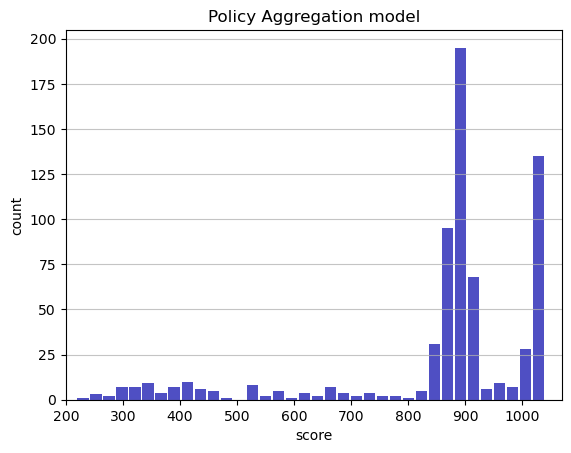

Track generation: 1339..1678 -> 339-tiles track
Epoch: 686
Policy Aggregation	mean: 858.21	variance: 182.48


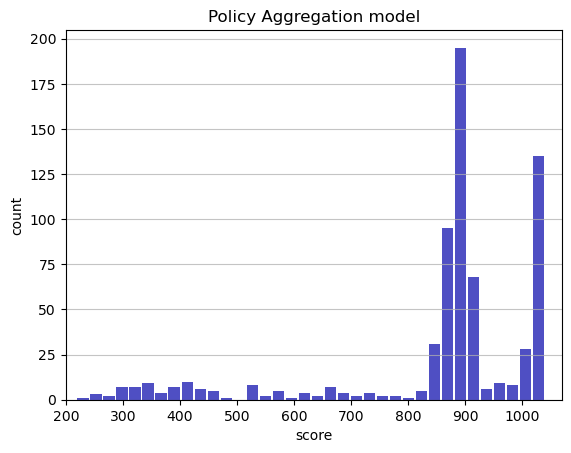

Track generation: 1283..1608 -> 325-tiles track
Epoch: 687
Policy Aggregation	mean: 858.27	variance: 182.35


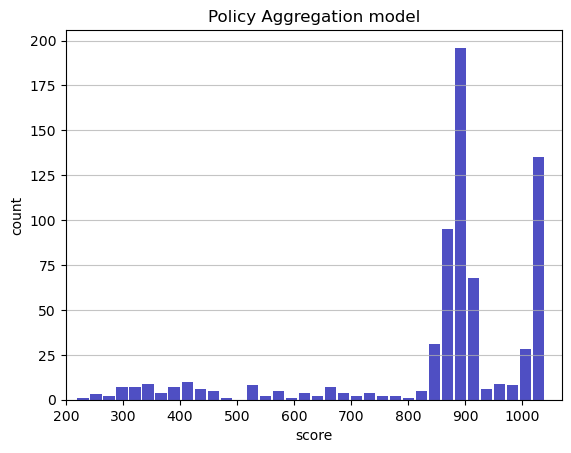

Track generation: 1155..1448 -> 293-tiles track
Epoch: 688
Policy Aggregation	mean: 858.35	variance: 182.23


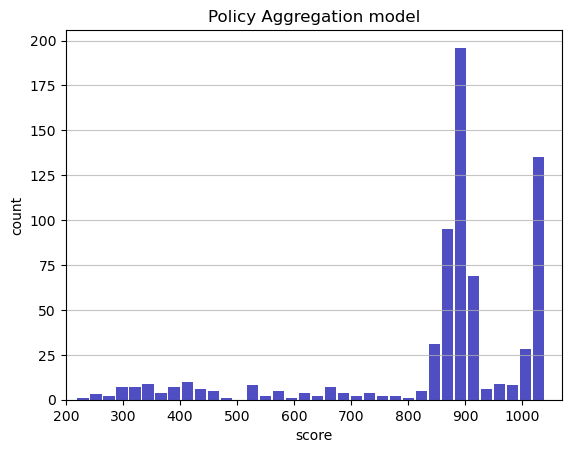

Track generation: 1200..1513 -> 313-tiles track
Epoch: 689
Policy Aggregation	mean: 858.40	variance: 182.10


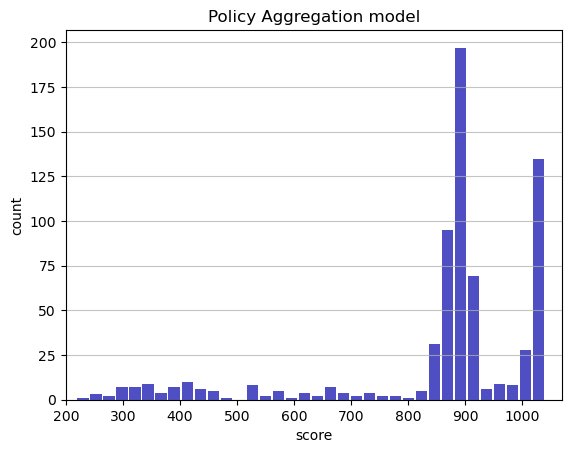

Track generation: 1143..1431 -> 288-tiles track
Epoch: 690
Policy Aggregation	mean: 858.39	variance: 181.97


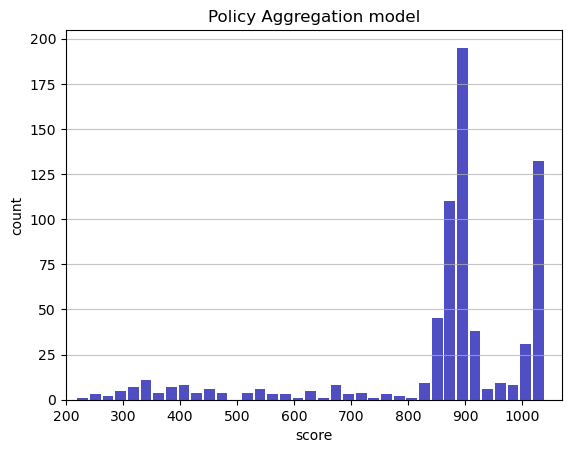

Track generation: 1251..1568 -> 317-tiles track
Epoch: 691
Policy Aggregation	mean: 858.61	variance: 181.93


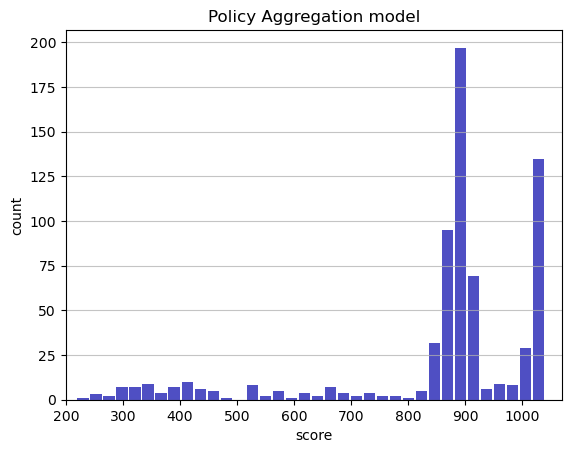

Track generation: 1113..1396 -> 283-tiles track
Epoch: 692
Policy Aggregation	mean: 857.82	variance: 182.98


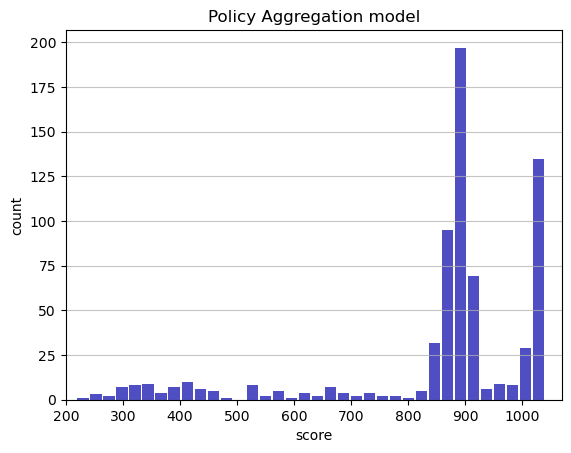

Track generation: 1054..1326 -> 272-tiles track
Epoch: 693
Policy Aggregation	mean: 857.26	variance: 183.43


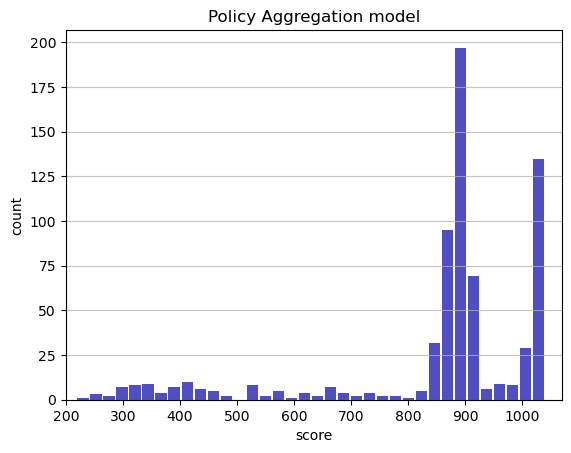

Track generation: 1023..1286 -> 263-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1188..1495 -> 307-tiles track
Epoch: 694
Policy Aggregation	mean: 857.45	variance: 183.36


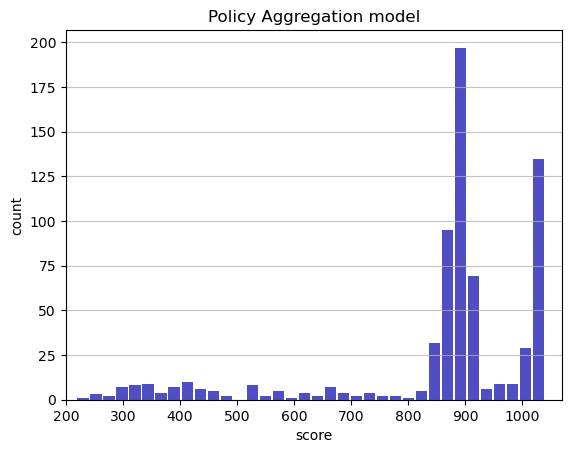

Track generation: 1012..1269 -> 257-tiles track
Epoch: 695
Policy Aggregation	mean: 856.97	variance: 183.66


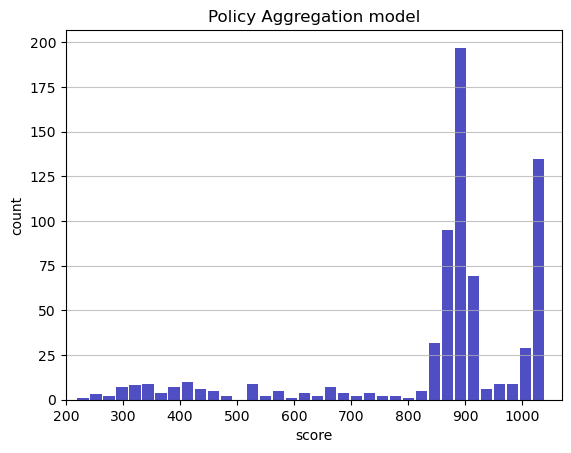

Track generation: 903..1137 -> 234-tiles track
Epoch: 696
Policy Aggregation	mean: 857.23	variance: 183.66


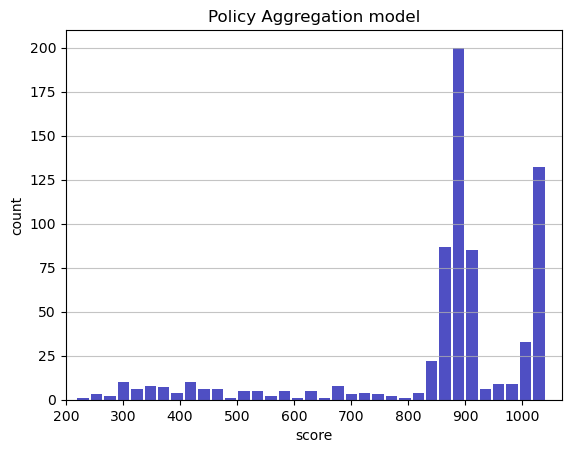

Track generation: 1140..1437 -> 297-tiles track
Epoch: 697
Policy Aggregation	mean: 857.22	variance: 183.53


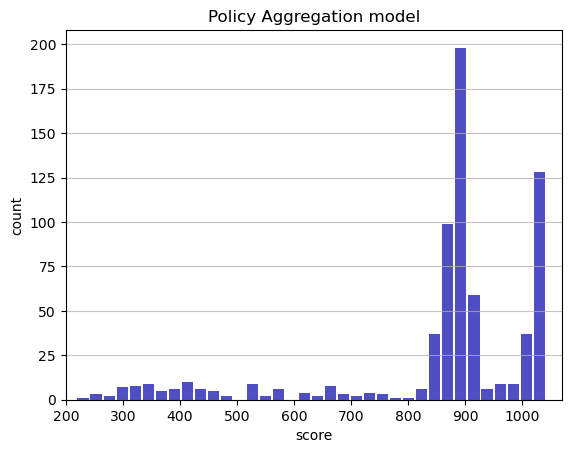

Track generation: 1130..1416 -> 286-tiles track
Epoch: 698
Policy Aggregation	mean: 856.98	variance: 183.51


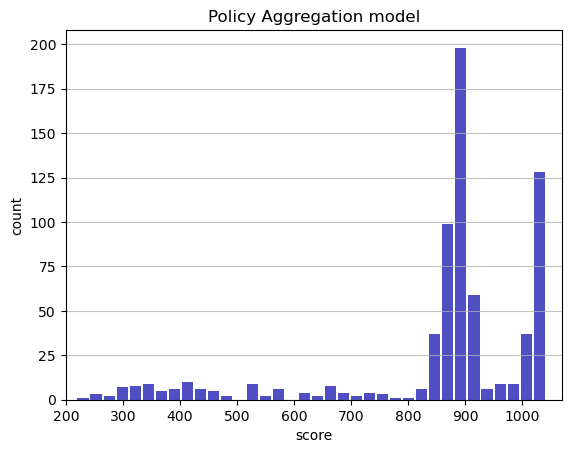

Track generation: 1058..1327 -> 269-tiles track
Epoch: 699
Policy Aggregation	mean: 857.04	variance: 183.39


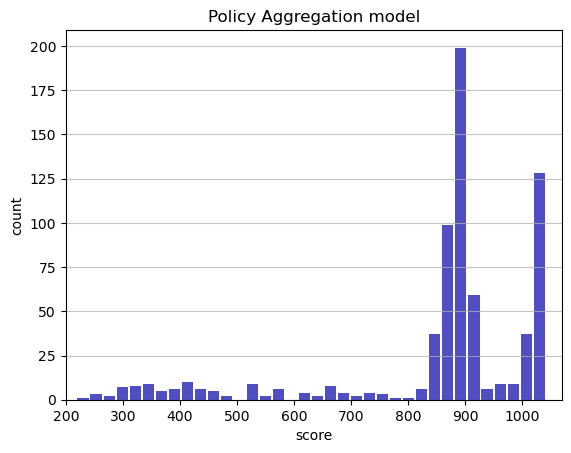

Track generation: 1023..1283 -> 260-tiles track
Epoch: 700
Policy Aggregation	mean: 857.10	variance: 183.26


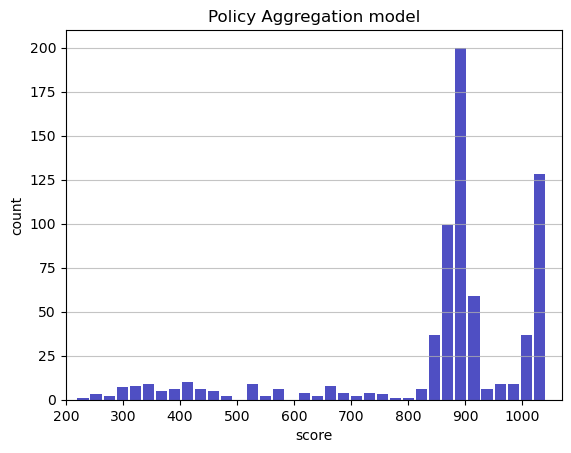

Track generation: 1207..1513 -> 306-tiles track
Epoch: 701
Policy Aggregation	mean: 857.15	variance: 183.14


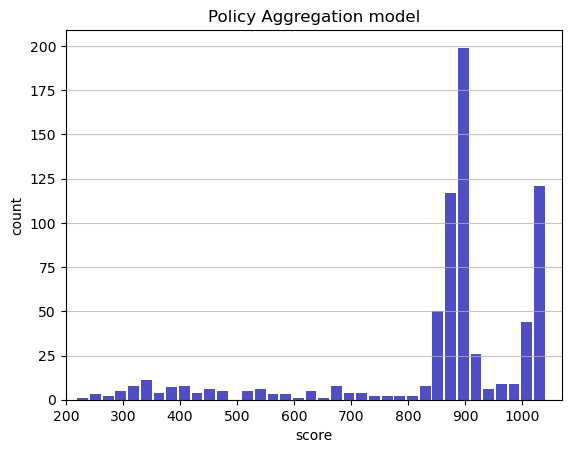

Track generation: 1047..1313 -> 266-tiles track
Epoch: 702
Policy Aggregation	mean: 857.20	variance: 183.01


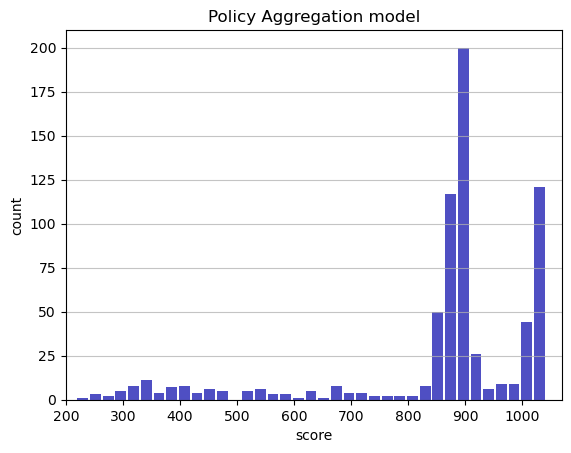

Track generation: 1103..1383 -> 280-tiles track
Epoch: 703
Policy Aggregation	mean: 857.27	variance: 182.89


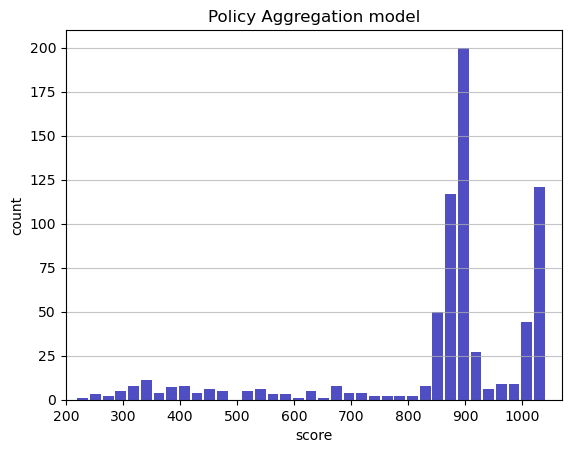

Track generation: 1100..1379 -> 279-tiles track
Epoch: 704
Policy Aggregation	mean: 857.51	variance: 182.87


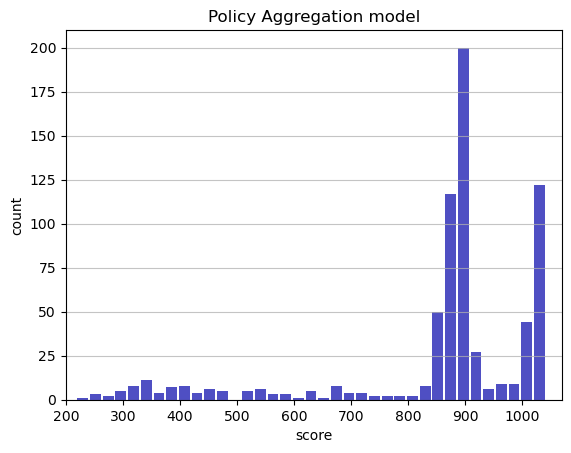

Track generation: 1424..1784 -> 360-tiles track
Epoch: 705
Policy Aggregation	mean: 857.69	variance: 182.81


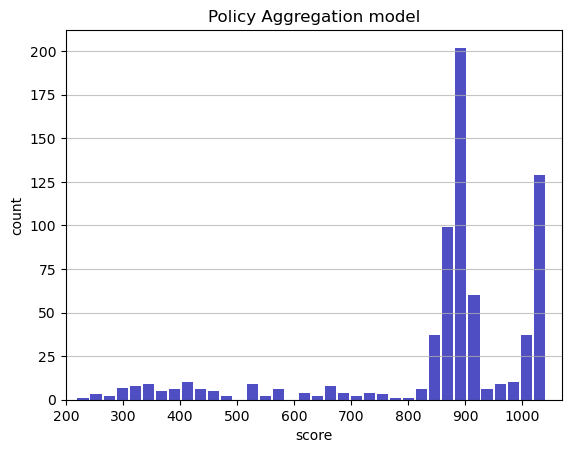

Track generation: 1136..1424 -> 288-tiles track
Epoch: 706
Policy Aggregation	mean: 857.93	variance: 182.78


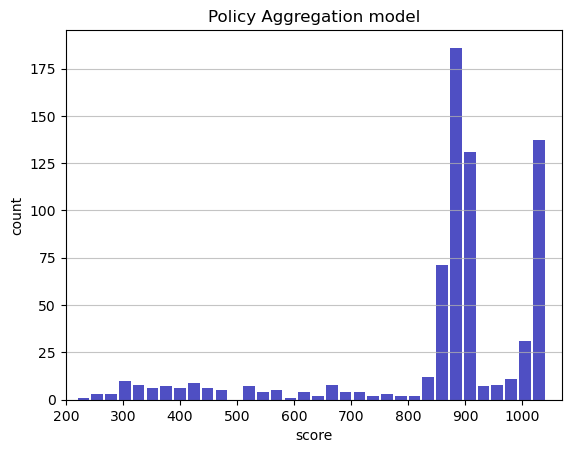

Track generation: 1239..1553 -> 314-tiles track
Epoch: 707
Policy Aggregation	mean: 858.15	variance: 182.75


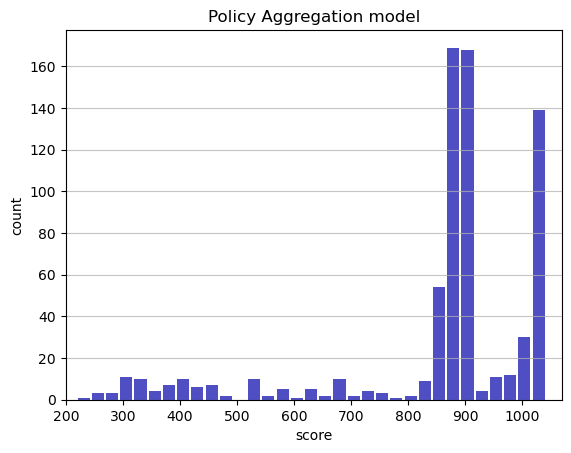

Track generation: 1108..1389 -> 281-tiles track
Epoch: 708
Policy Aggregation	mean: 858.39	variance: 182.73


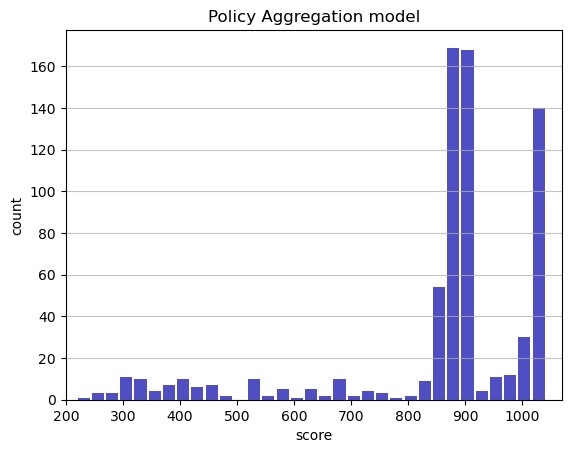

Track generation: 1141..1438 -> 297-tiles track
Epoch: 709
Policy Aggregation	mean: 858.61	variance: 182.69


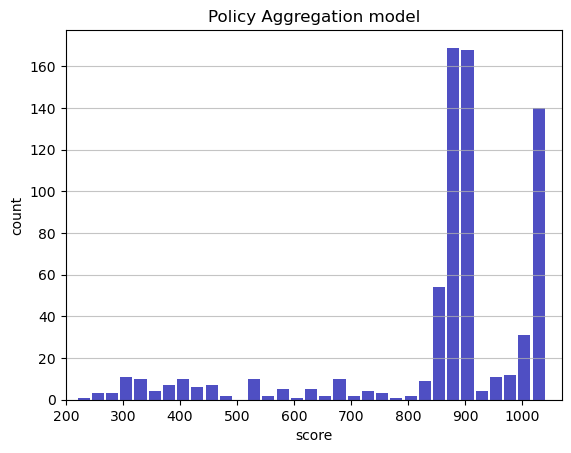

Track generation: 1192..1494 -> 302-tiles track
Epoch: 710
Policy Aggregation	mean: 858.65	variance: 182.57


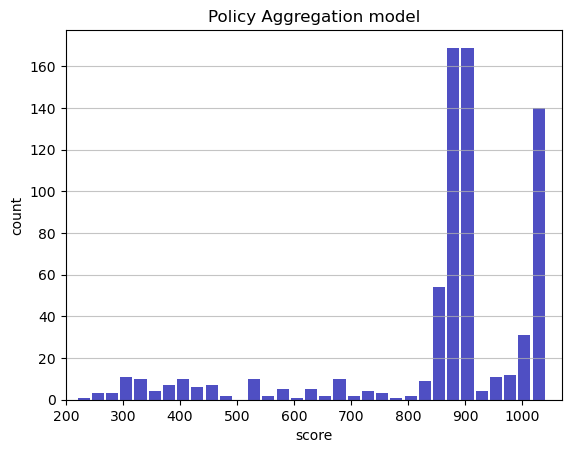

Track generation: 1221..1530 -> 309-tiles track
Epoch: 711
Policy Aggregation	mean: 858.69	variance: 182.44


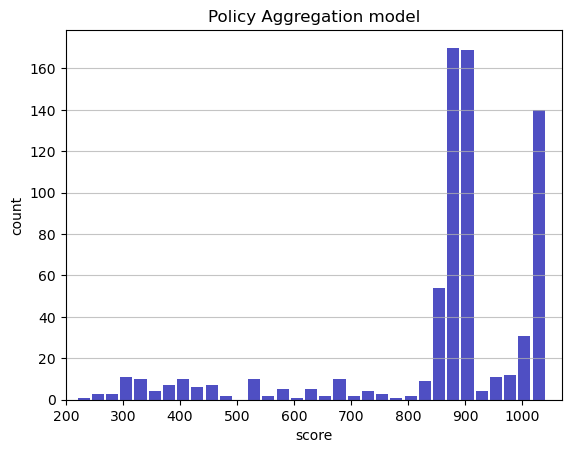

Track generation: 1224..1534 -> 310-tiles track
Epoch: 712
Policy Aggregation	mean: 858.10	variance: 182.98


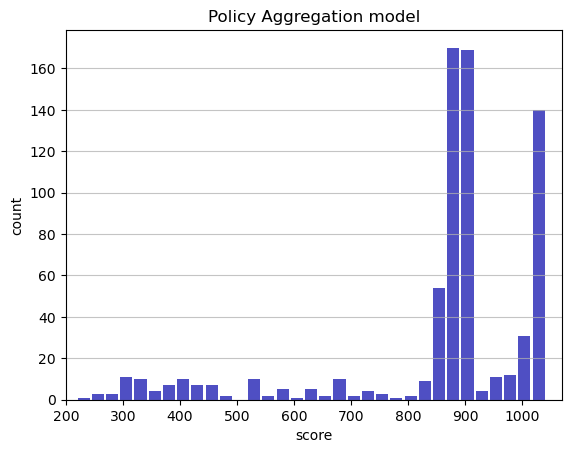

Track generation: 1236..1549 -> 313-tiles track
Epoch: 713
Policy Aggregation	mean: 858.14	variance: 182.85


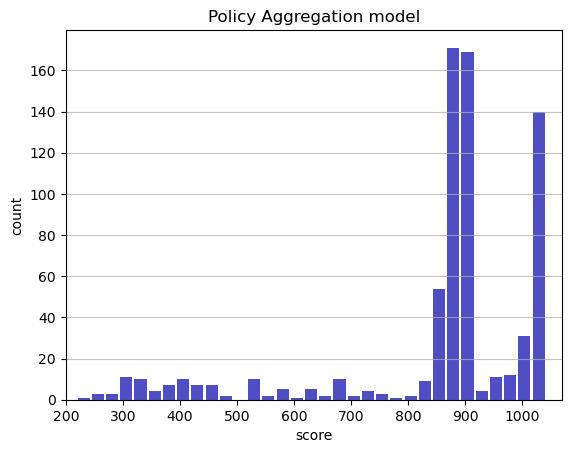

Track generation: 1136..1426 -> 290-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1075..1352 -> 277-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1185..1485 -> 300-tiles track
Epoch: 714
Policy Aggregation	mean: 858.19	variance: 182.73


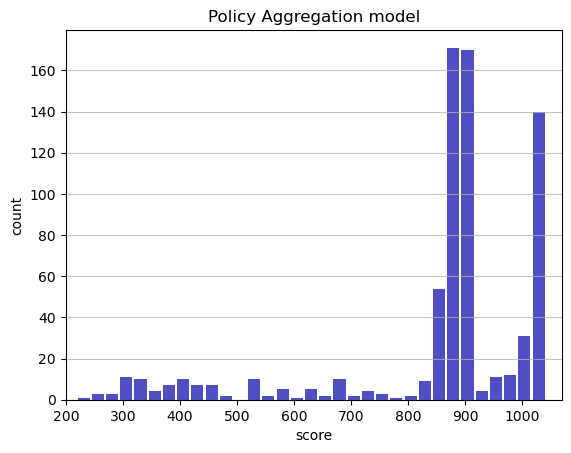

Track generation: 1084..1365 -> 281-tiles track
Epoch: 715
Policy Aggregation	mean: 858.24	variance: 182.61


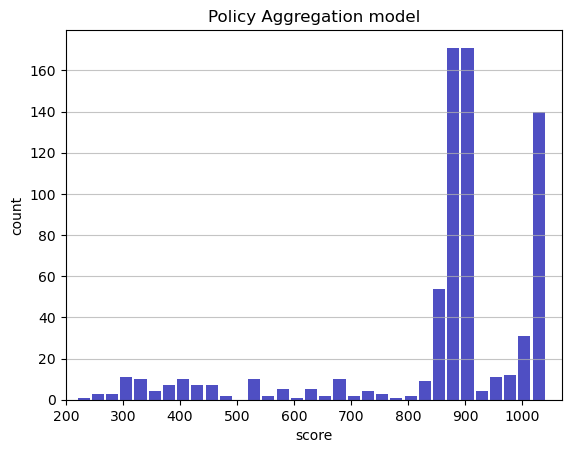

Track generation: 1139..1431 -> 292-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1215..1523 -> 308-tiles track
Epoch: 716
Policy Aggregation	mean: 858.29	variance: 182.48


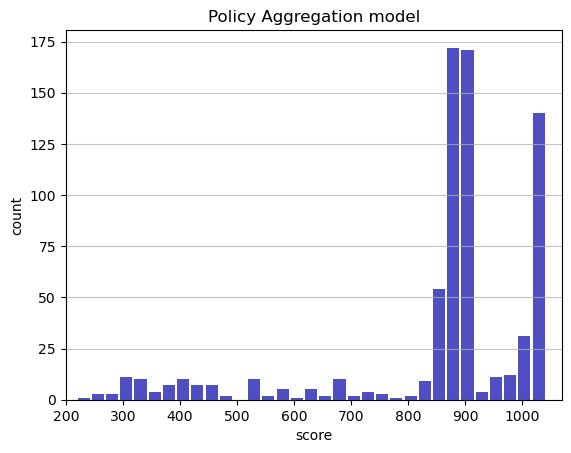

Track generation: 1080..1361 -> 281-tiles track
Epoch: 717
Policy Aggregation	mean: 858.53	variance: 182.47


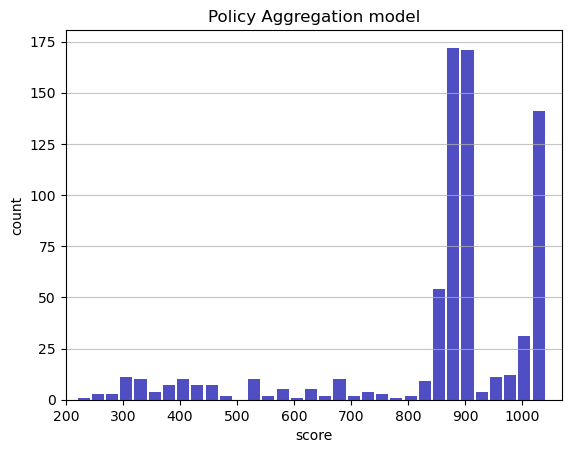

Track generation: 1116..1405 -> 289-tiles track
Epoch: 718
Policy Aggregation	mean: 858.36	variance: 182.41


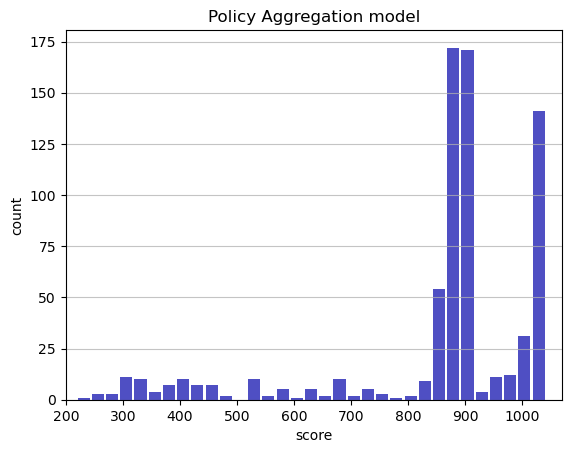

Track generation: 1211..1518 -> 307-tiles track
Epoch: 719
Policy Aggregation	mean: 857.84	variance: 182.81


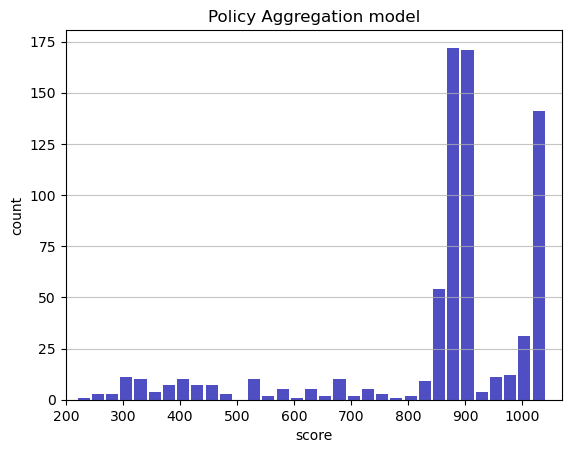

Track generation: 1129..1415 -> 286-tiles track
Epoch: 720
Policy Aggregation	mean: 857.89	variance: 182.69


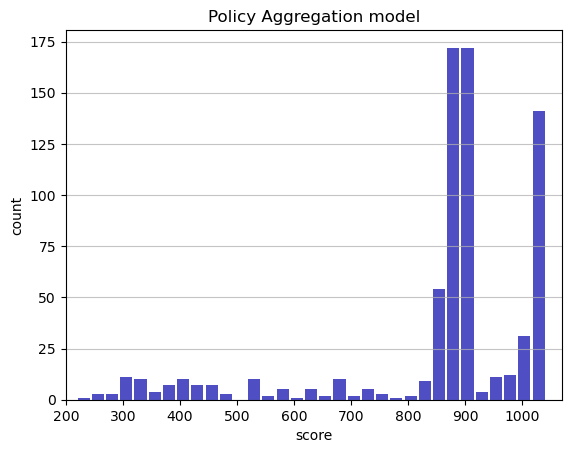

Track generation: 1108..1389 -> 281-tiles track
Epoch: 721
Policy Aggregation	mean: 857.95	variance: 182.57


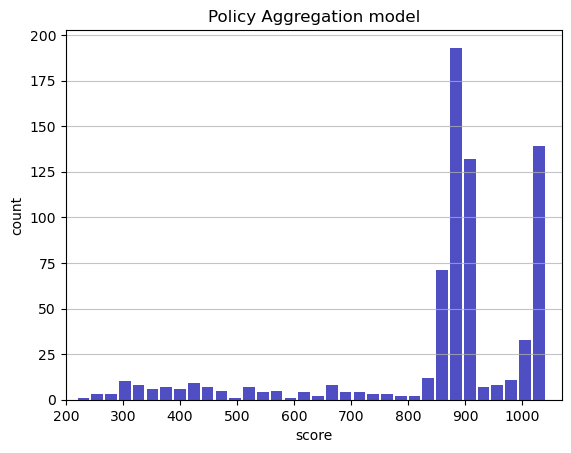

Track generation: 1158..1452 -> 294-tiles track
Epoch: 722
Policy Aggregation	mean: 857.98	variance: 182.44


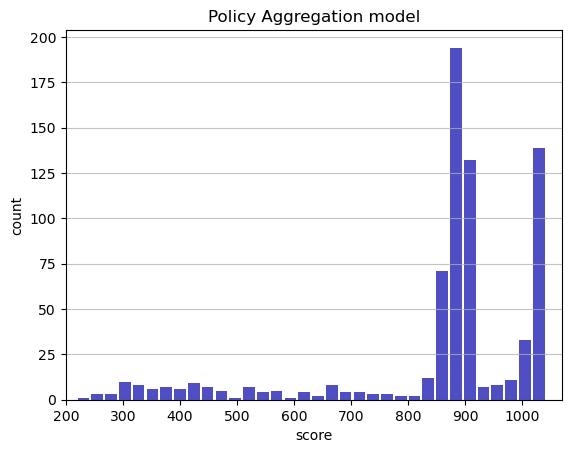

Track generation: 1036..1299 -> 263-tiles track
Epoch: 723
Policy Aggregation	mean: 858.04	variance: 182.32


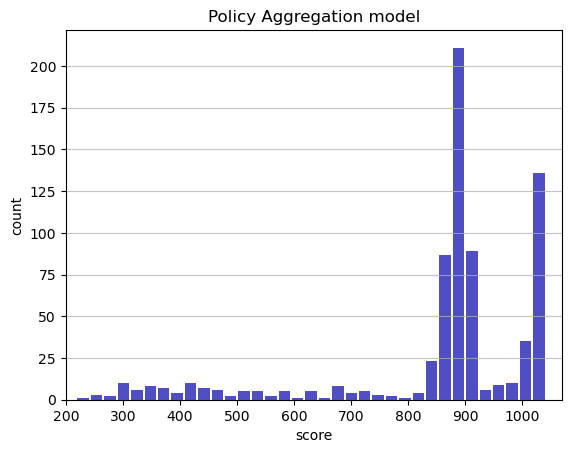

Track generation: 1139..1428 -> 289-tiles track
Epoch: 724
Policy Aggregation	mean: 858.08	variance: 182.20


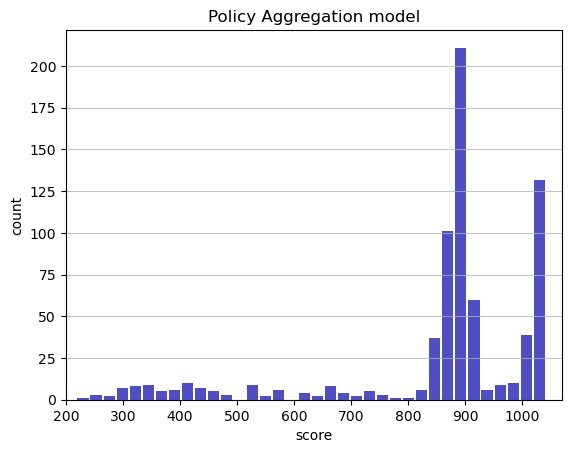

Track generation: 1149..1440 -> 291-tiles track
Epoch: 725
Policy Aggregation	mean: 858.11	variance: 182.07


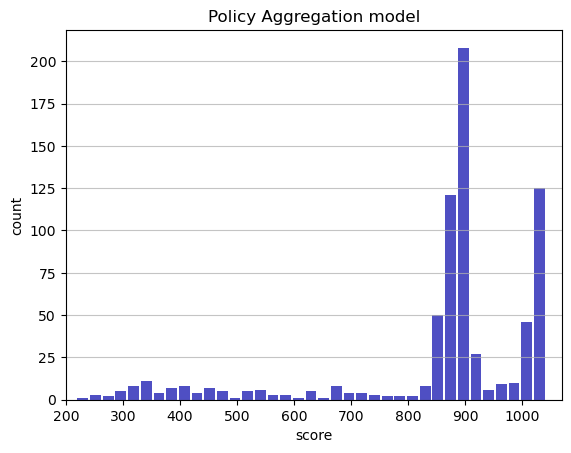

Track generation: 1307..1638 -> 331-tiles track
Epoch: 726
Policy Aggregation	mean: 858.32	variance: 182.04


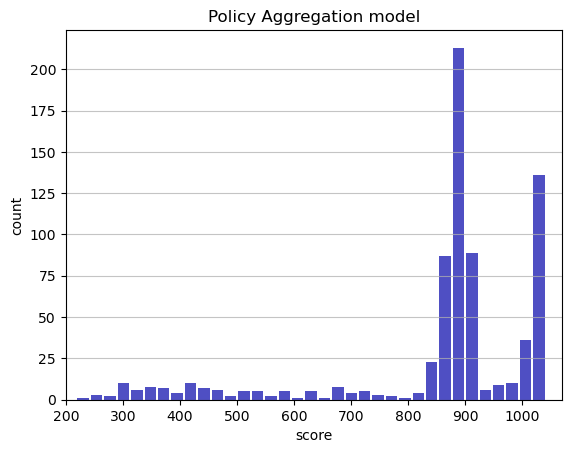

Track generation: 1025..1286 -> 261-tiles track
Epoch: 727
Policy Aggregation	mean: 858.56	variance: 182.03


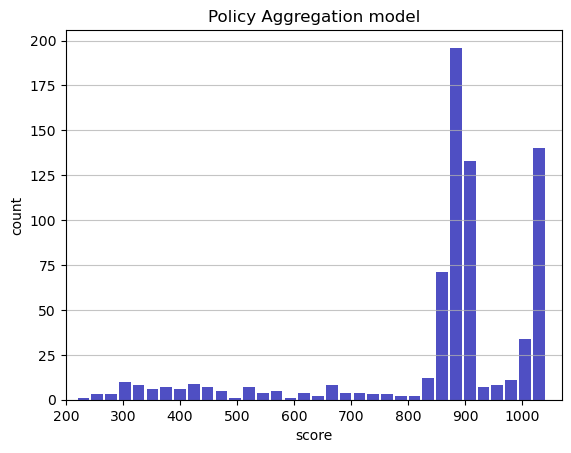

Track generation: 1118..1404 -> 286-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1137..1426 -> 289-tiles track
Epoch: 728
Policy Aggregation	mean: 858.56	variance: 181.91


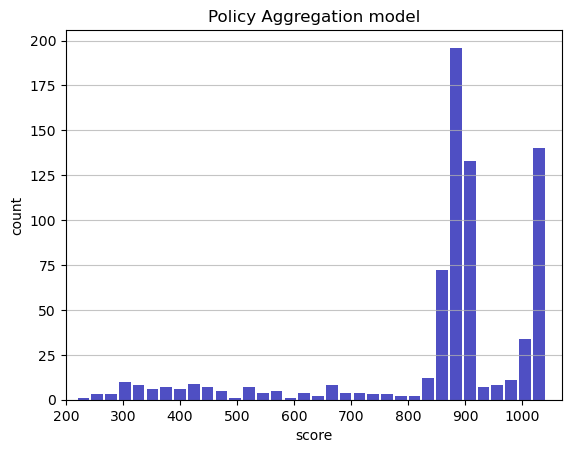

Track generation: 1100..1379 -> 279-tiles track
Epoch: 729
Policy Aggregation	mean: 858.79	variance: 181.89


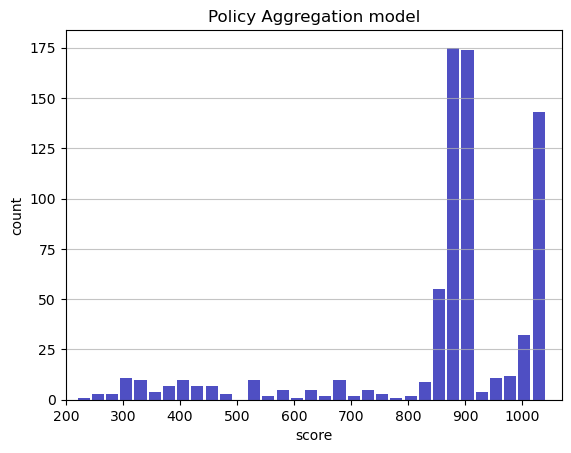

Track generation: 1015..1276 -> 261-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1221..1539 -> 318-tiles track
Epoch: 730
Policy Aggregation	mean: 859.01	variance: 181.86


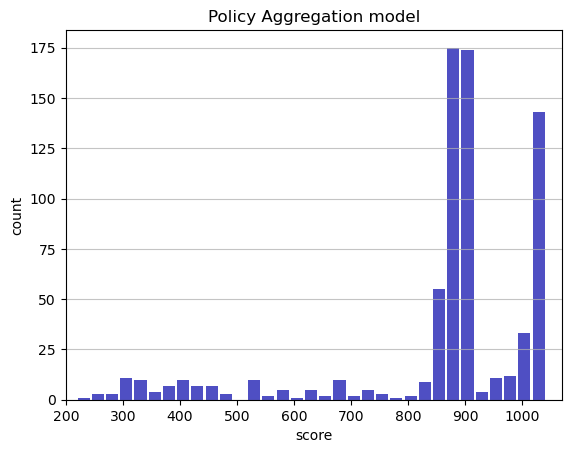

Track generation: 1185..1486 -> 301-tiles track
Epoch: 731
Policy Aggregation	mean: 859.23	variance: 181.83


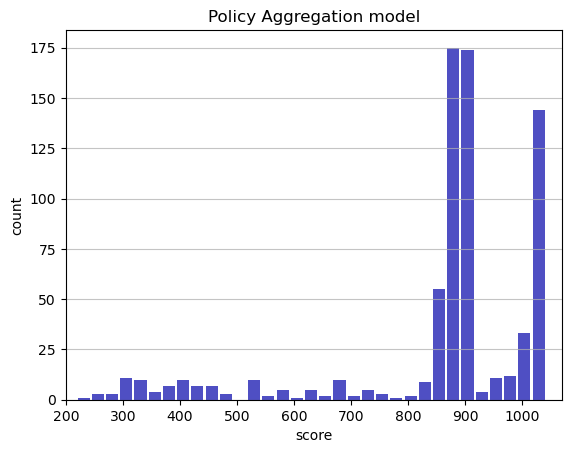

Track generation: 1155..1448 -> 293-tiles track
Epoch: 732
Policy Aggregation	mean: 859.26	variance: 181.71


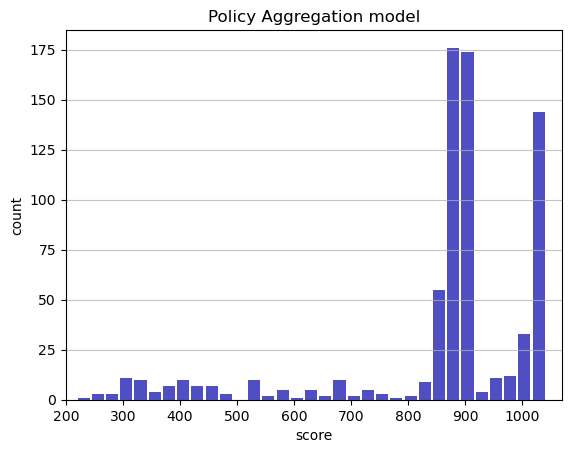

Track generation: 1135..1423 -> 288-tiles track
Epoch: 733
Policy Aggregation	mean: 859.50	variance: 181.69


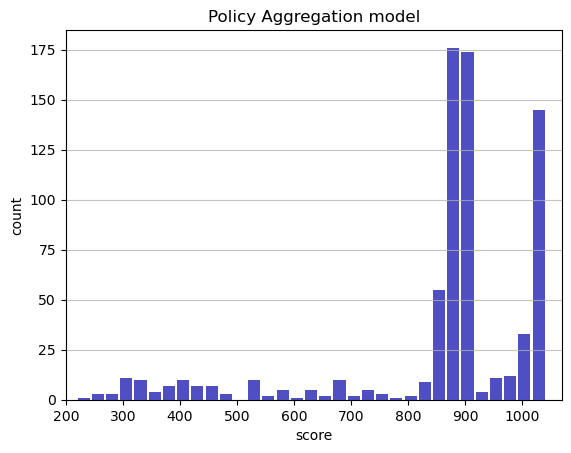

Track generation: 1307..1638 -> 331-tiles track
Epoch: 734
Policy Aggregation	mean: 858.64	variance: 183.05


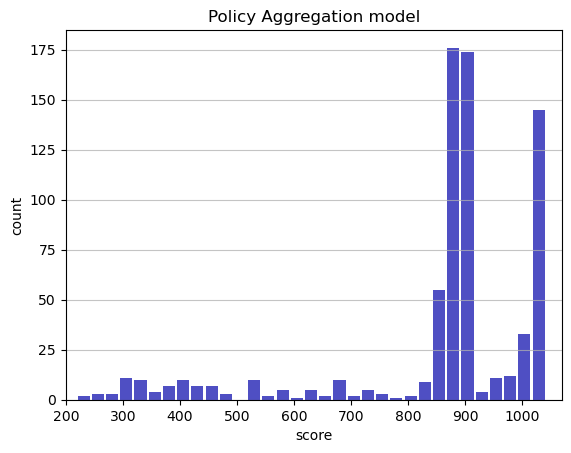

Track generation: 1205..1510 -> 305-tiles track
Epoch: 735
Policy Aggregation	mean: 858.86	variance: 183.03


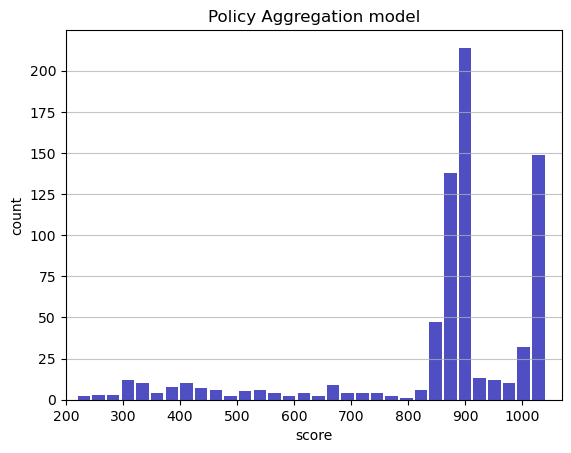

Track generation: 1092..1373 -> 281-tiles track
Epoch: 736
Policy Aggregation	mean: 858.26	variance: 183.62


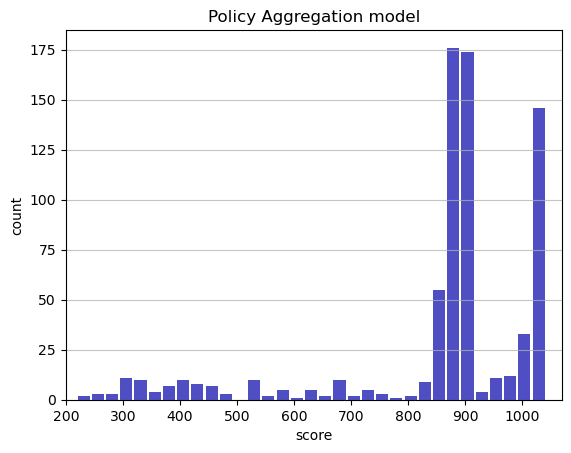

Track generation: 1024..1286 -> 262-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1173..1470 -> 297-tiles track
Epoch: 737
Policy Aggregation	mean: 858.23	variance: 183.50


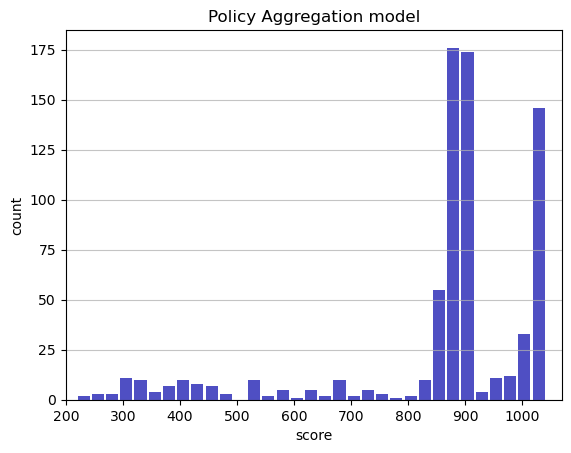

Track generation: 1196..1499 -> 303-tiles track
Epoch: 738
Policy Aggregation	mean: 857.53	variance: 184.36


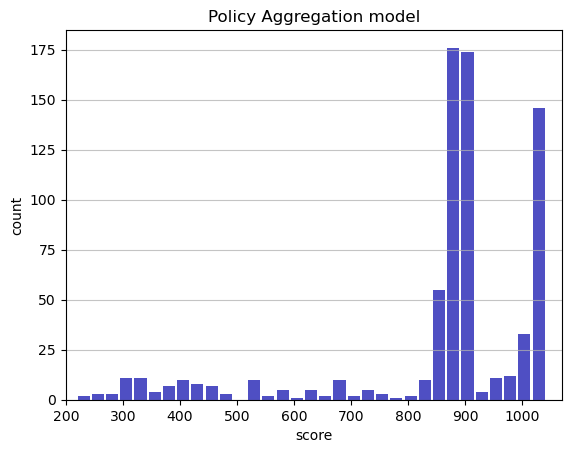

Track generation: 1048..1313 -> 265-tiles track
Epoch: 739
Policy Aggregation	mean: 857.56	variance: 184.23


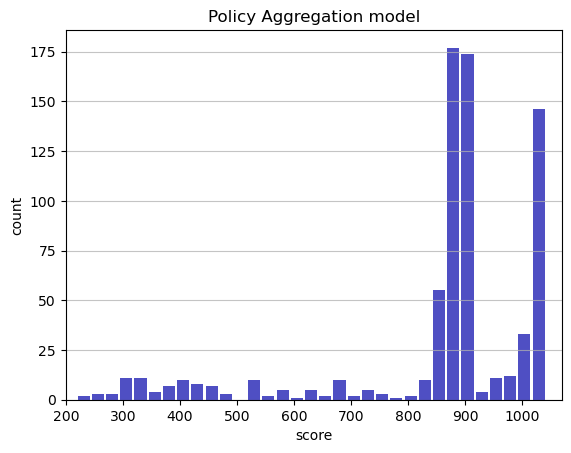

Track generation: 1152..1444 -> 292-tiles track
Epoch: 740
Policy Aggregation	mean: 857.57	variance: 184.11


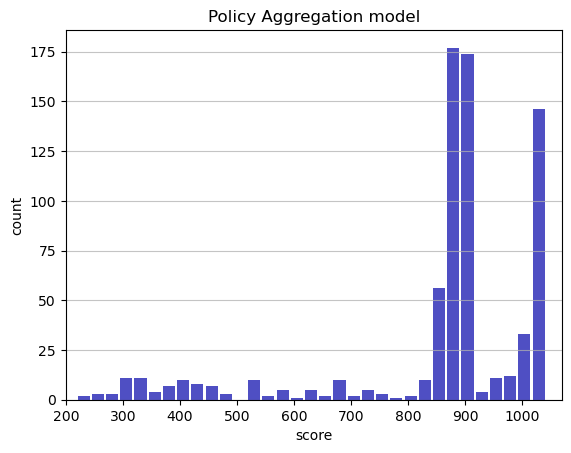

Track generation: 1069..1347 -> 278-tiles track
Epoch: 741
Policy Aggregation	mean: 857.63	variance: 183.99


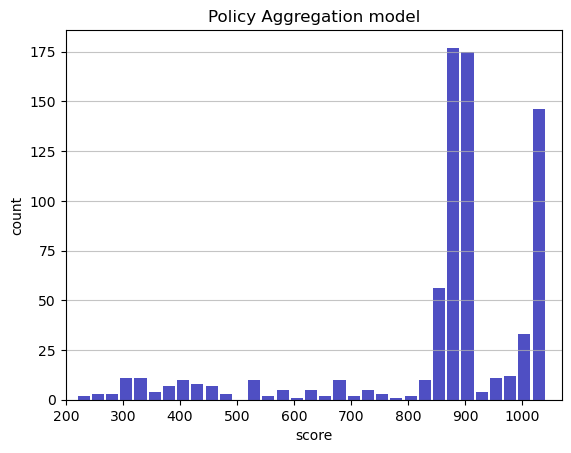

Track generation: 1180..1477 -> 297-tiles track
Epoch: 742
Policy Aggregation	mean: 857.65	variance: 183.87


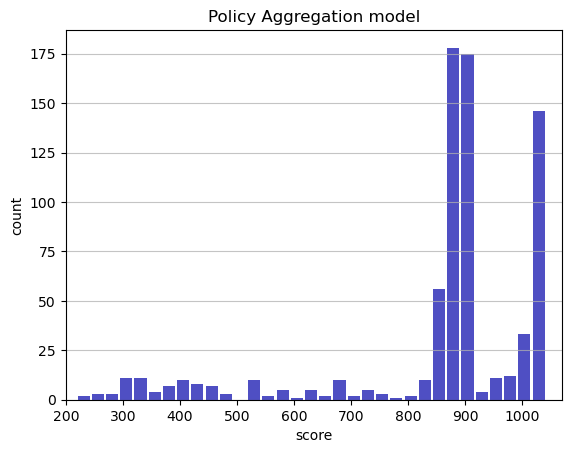

Track generation: 1012..1269 -> 257-tiles track
Epoch: 743
Policy Aggregation	mean: 857.18	variance: 184.18


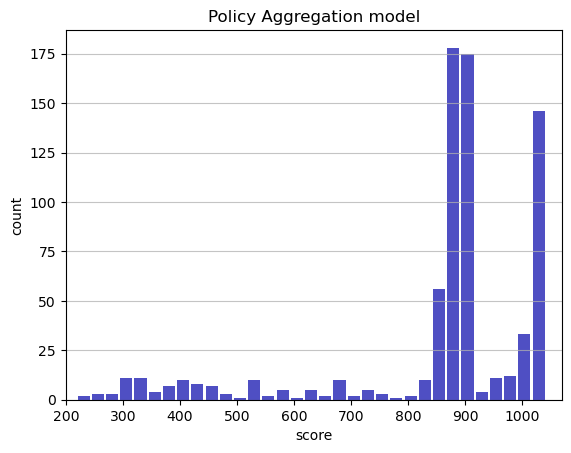

Track generation: 1022..1287 -> 265-tiles track
Epoch: 744
Policy Aggregation	mean: 857.23	variance: 184.06


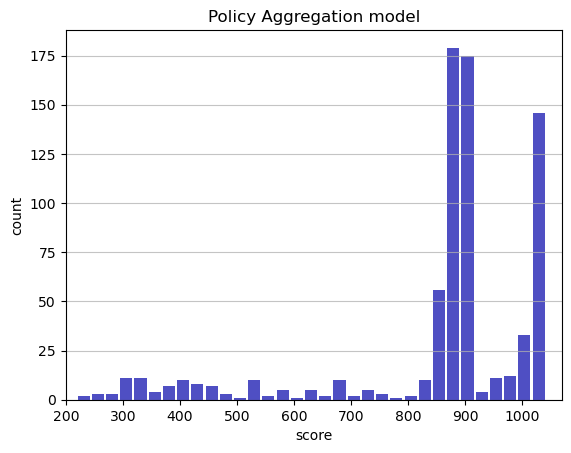

Track generation: 1225..1535 -> 310-tiles track
Epoch: 745
Policy Aggregation	mean: 857.24	variance: 183.93


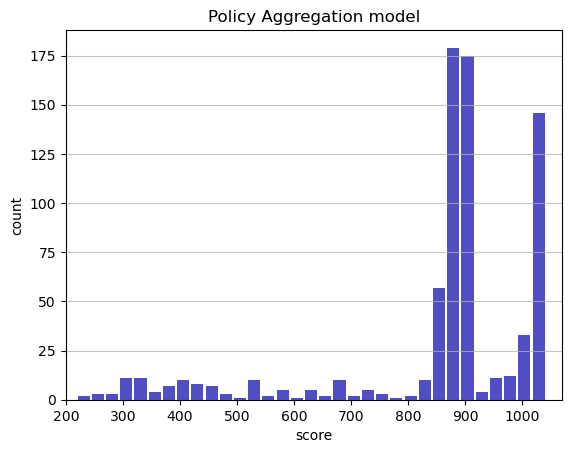

Track generation: 1089..1365 -> 276-tiles track
Epoch: 746
Policy Aggregation	mean: 857.25	variance: 183.81


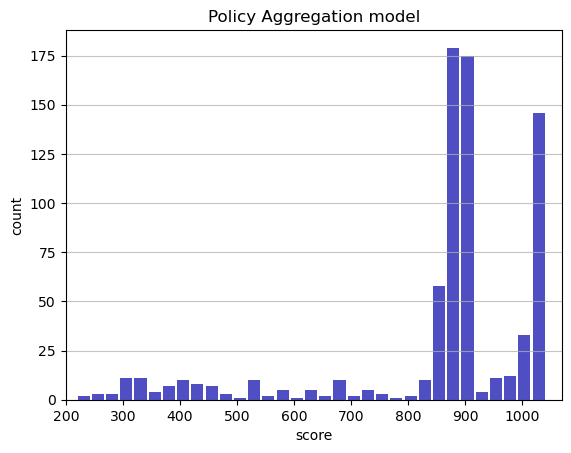

Track generation: 912..1144 -> 232-tiles track
Epoch: 747
Policy Aggregation	mean: 857.29	variance: 183.69


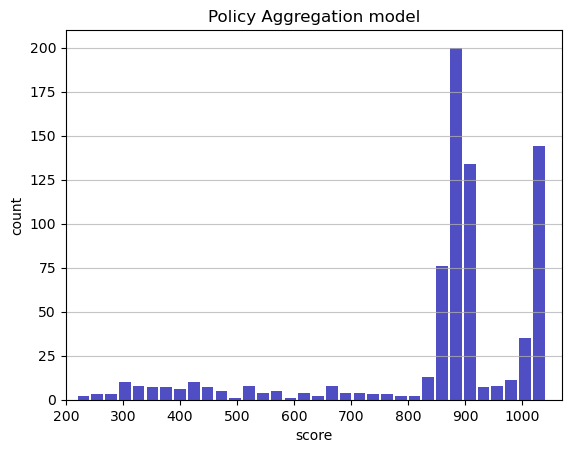

Track generation: 1026..1292 -> 266-tiles track
Epoch: 748
Policy Aggregation	mean: 857.52	variance: 183.68


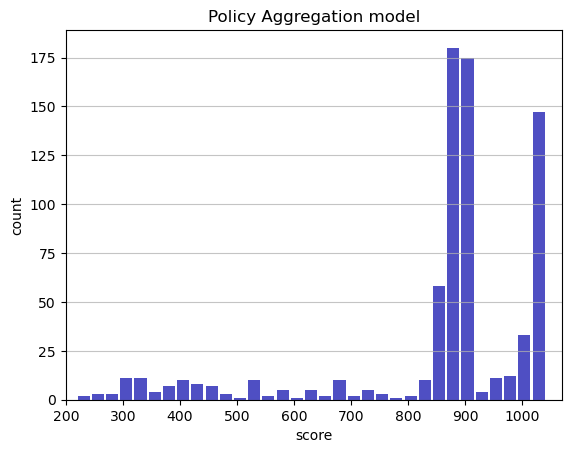

Track generation: 1188..1488 -> 300-tiles track
Epoch: 749
Policy Aggregation	mean: 857.51	variance: 183.55


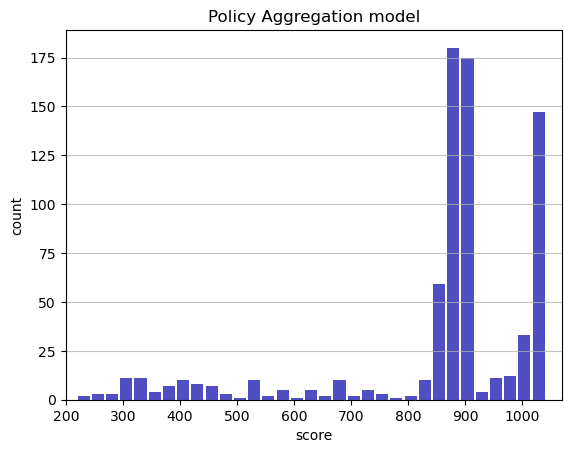

Track generation: 1115..1398 -> 283-tiles track
Epoch: 750
Policy Aggregation	mean: 857.55	variance: 183.44


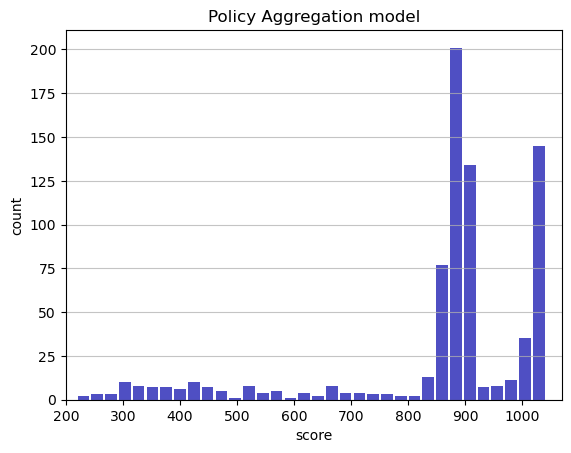

Track generation: 1224..1534 -> 310-tiles track
Epoch: 751
Policy Aggregation	mean: 857.78	variance: 183.41


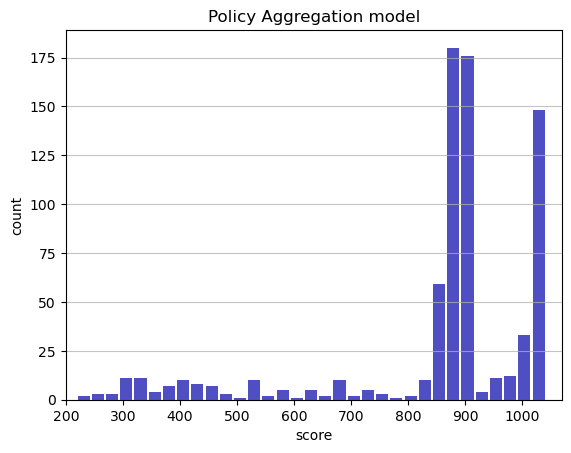

Track generation: 1100..1379 -> 279-tiles track
Epoch: 752
Policy Aggregation	mean: 857.85	variance: 183.30


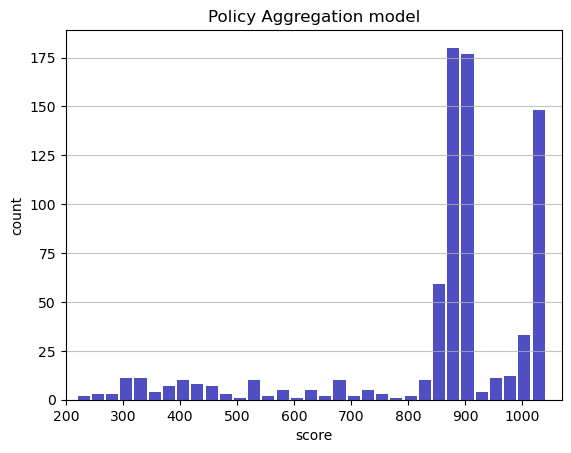

Track generation: 1316..1649 -> 333-tiles track
Epoch: 753
Policy Aggregation	mean: 857.70	variance: 183.23


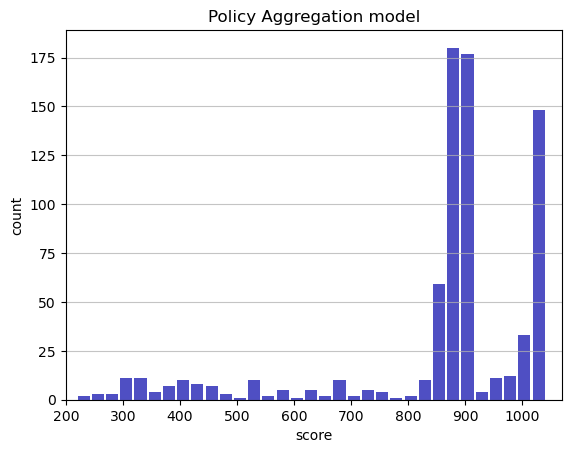

Track generation: 1073..1345 -> 272-tiles track
Epoch: 754
Policy Aggregation	mean: 857.74	variance: 183.11


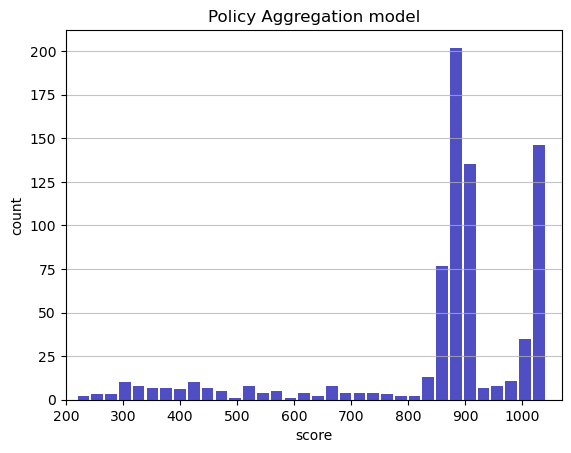

Track generation: 1274..1604 -> 330-tiles track
Epoch: 755
Policy Aggregation	mean: 857.87	variance: 183.02


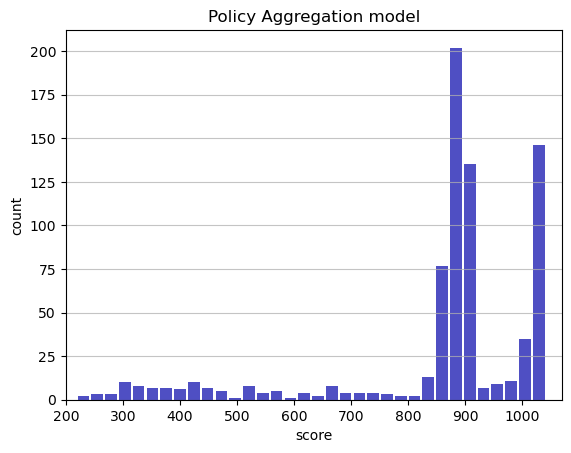

Track generation: 1087..1363 -> 276-tiles track
Epoch: 756
Policy Aggregation	mean: 857.90	variance: 182.90


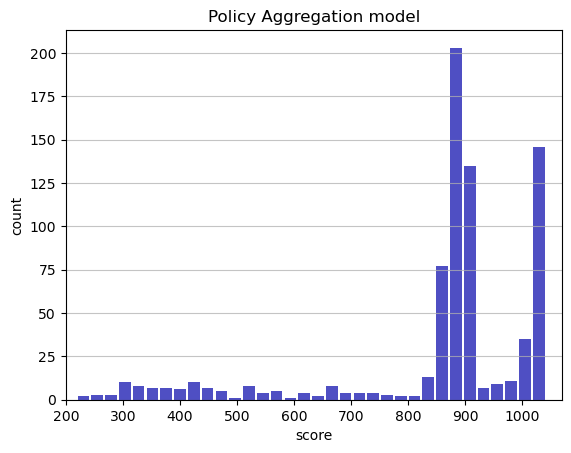

Track generation: 1212..1520 -> 308-tiles track
Epoch: 757
Policy Aggregation	mean: 857.95	variance: 182.79


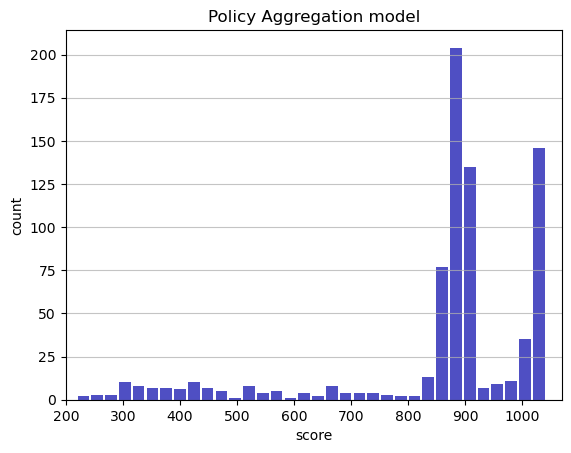

Track generation: 1168..1464 -> 296-tiles track
Epoch: 758
Policy Aggregation	mean: 858.01	variance: 182.67


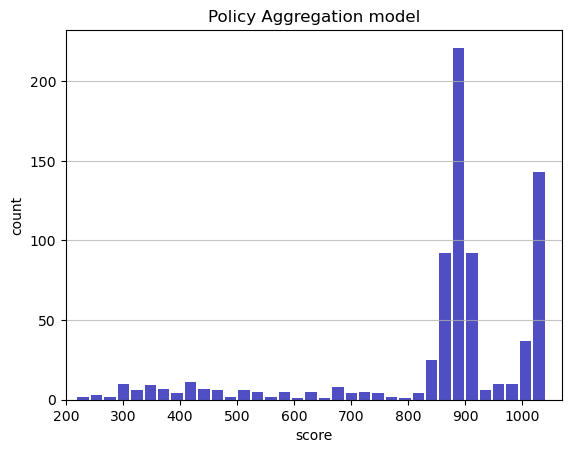

Track generation: 992..1249 -> 257-tiles track
Epoch: 759
Policy Aggregation	mean: 858.07	variance: 182.56


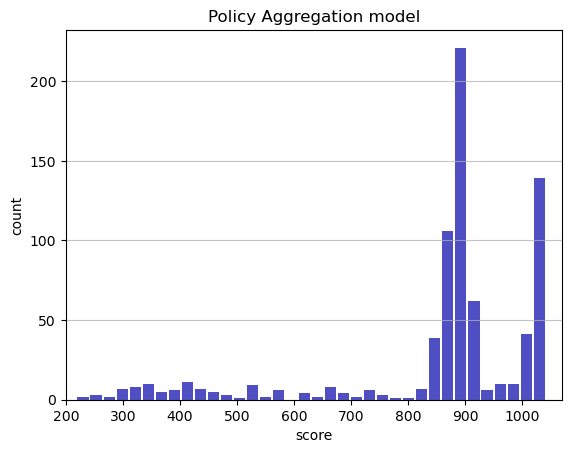

Track generation: 1274..1601 -> 327-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1177..1474 -> 297-tiles track
Epoch: 760
Policy Aggregation	mean: 858.28	variance: 182.53


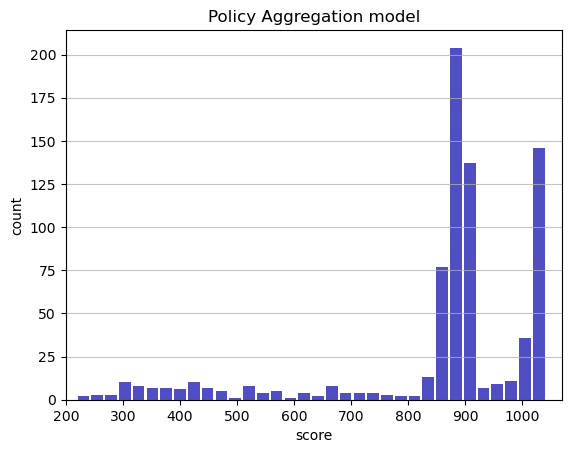

Track generation: 979..1230 -> 251-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1018..1286 -> 268-tiles track
Epoch: 761
Policy Aggregation	mean: 858.30	variance: 182.41


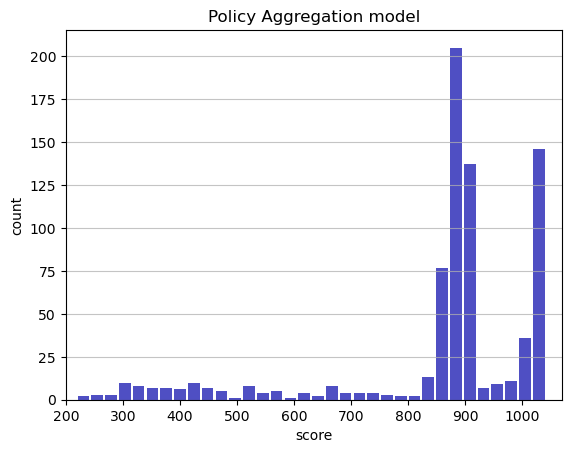

Track generation: 1136..1424 -> 288-tiles track
Epoch: 762
Policy Aggregation	mean: 858.34	variance: 182.29


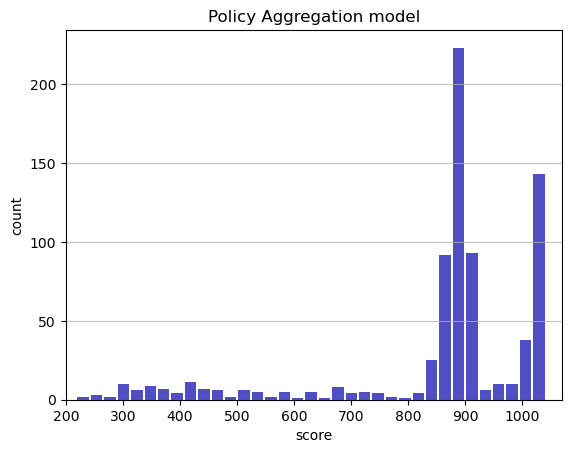

Track generation: 1283..1608 -> 325-tiles track
Epoch: 763
Policy Aggregation	mean: 858.51	variance: 182.23


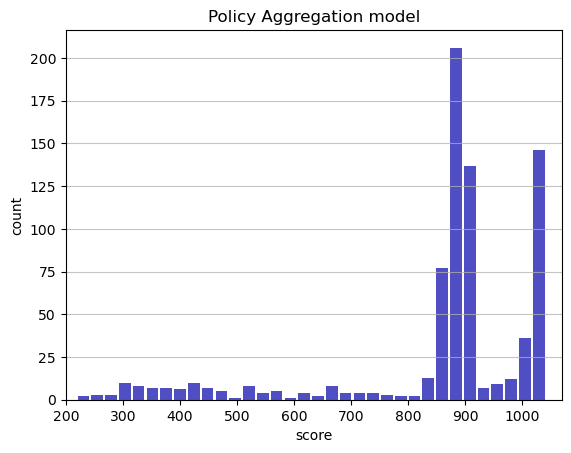

Track generation: 1087..1362 -> 275-tiles track
Epoch: 764
Policy Aggregation	mean: 858.53	variance: 182.11


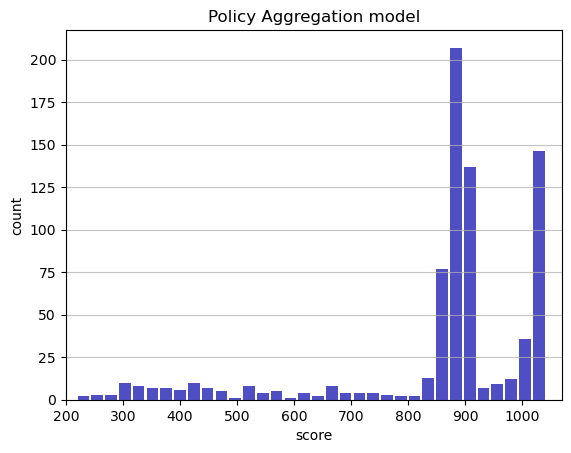

Track generation: 1148..1439 -> 291-tiles track
Epoch: 765
Policy Aggregation	mean: 858.58	variance: 182.00


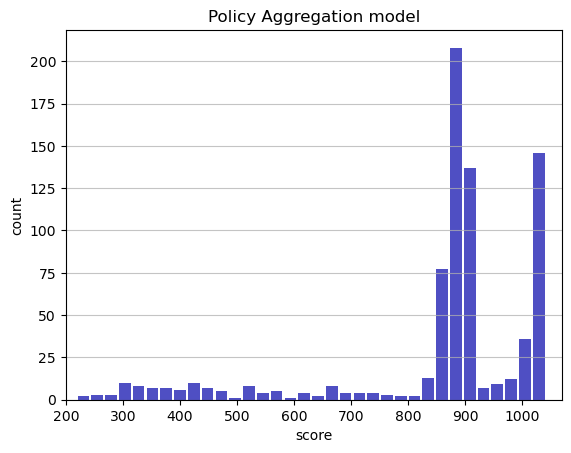

Track generation: 1114..1397 -> 283-tiles track
Epoch: 766
Policy Aggregation	mean: 858.63	variance: 181.89


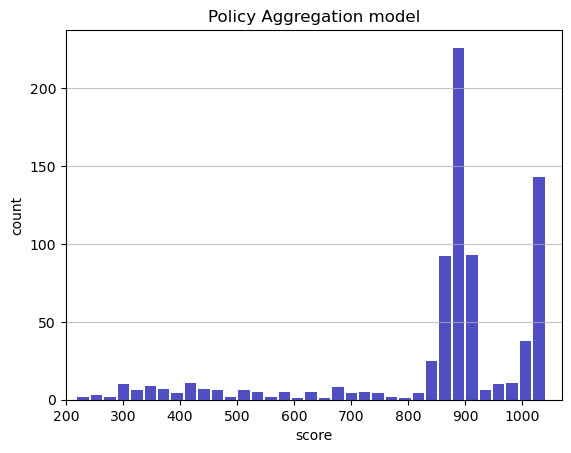

Track generation: 1123..1408 -> 285-tiles track
Epoch: 767
Policy Aggregation	mean: 858.85	variance: 181.86


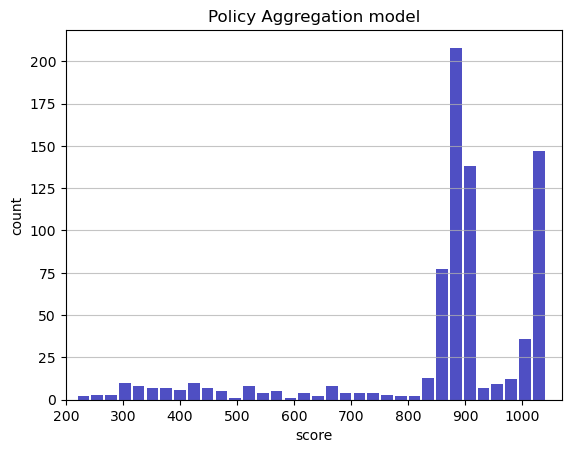

Track generation: 1048..1314 -> 266-tiles track
Epoch: 768
Policy Aggregation	mean: 858.86	variance: 181.74


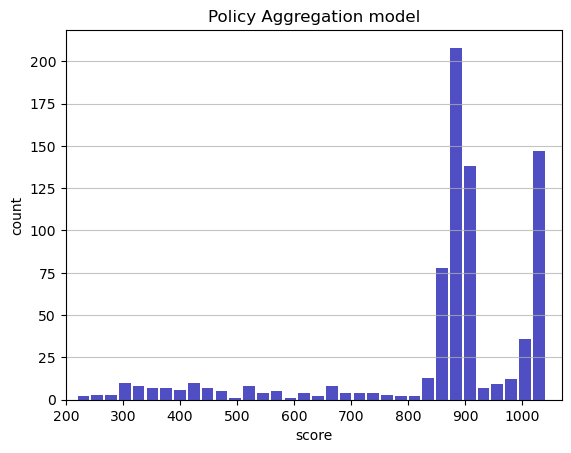

Track generation: 1119..1403 -> 284-tiles track
Epoch: 769
Policy Aggregation	mean: 858.91	variance: 181.63


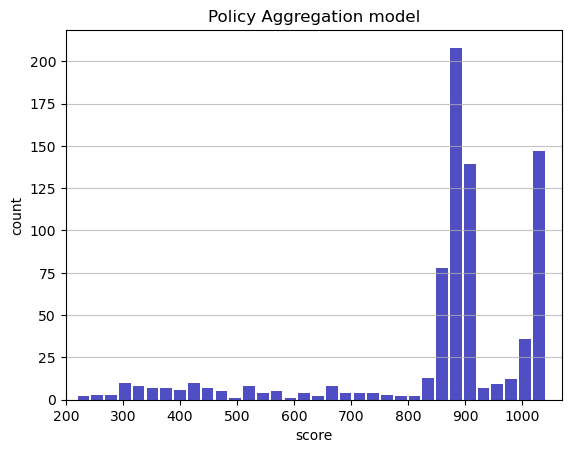

Track generation: 1227..1538 -> 311-tiles track
Epoch: 770
Policy Aggregation	mean: 858.89	variance: 181.51


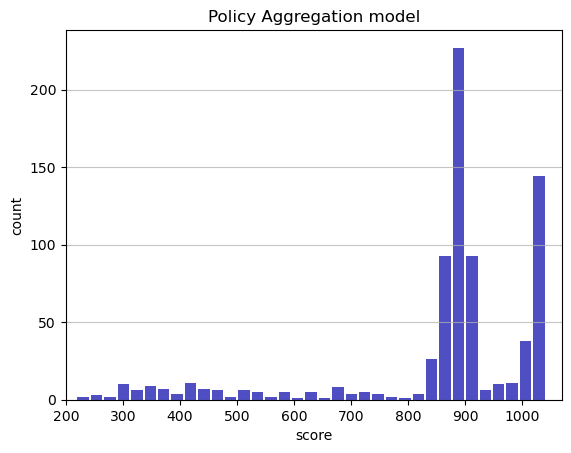

Track generation: 1193..1495 -> 302-tiles track
Epoch: 771
Policy Aggregation	mean: 858.94	variance: 181.40


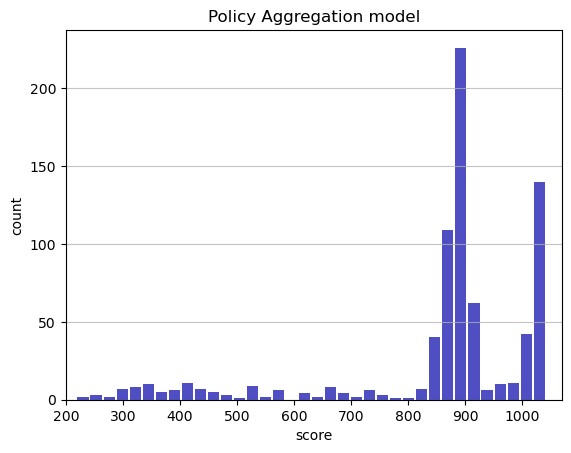

Track generation: 1044..1309 -> 265-tiles track
Epoch: 772
Policy Aggregation	mean: 858.37	variance: 181.98


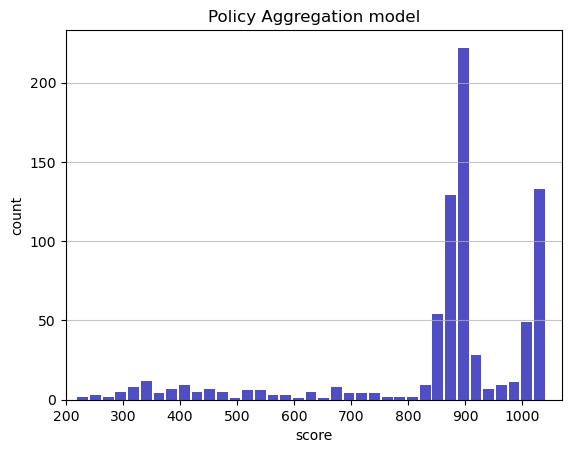

Track generation: 1328..1675 -> 347-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1112..1394 -> 282-tiles track
Epoch: 773
Policy Aggregation	mean: 858.58	variance: 181.96


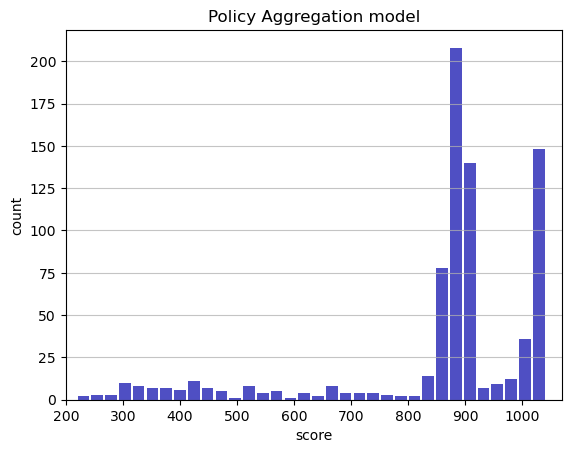

Track generation: 1184..1484 -> 300-tiles track
Epoch: 774
Policy Aggregation	mean: 858.79	variance: 181.93


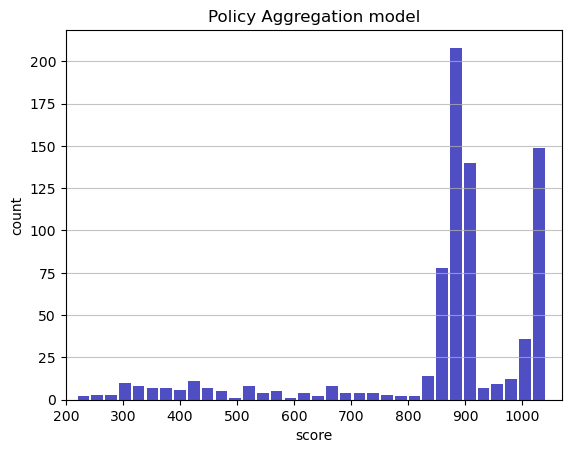

Track generation: 1200..1504 -> 304-tiles track
Epoch: 775
Policy Aggregation	mean: 858.85	variance: 181.82


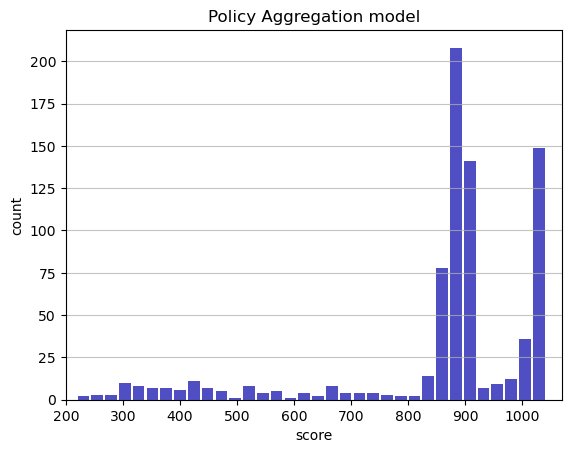

Track generation: 1123..1408 -> 285-tiles track
Epoch: 776
Policy Aggregation	mean: 858.90	variance: 181.71


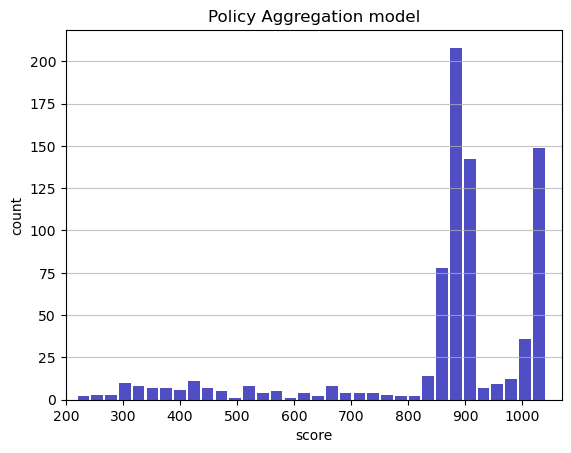

Track generation: 1028..1289 -> 261-tiles track
Epoch: 777
Policy Aggregation	mean: 858.94	variance: 181.60


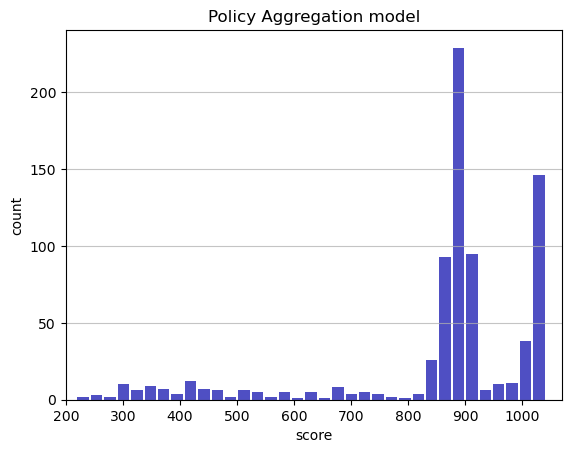

Track generation: 1075..1348 -> 273-tiles track
Epoch: 778
Policy Aggregation	mean: 859.00	variance: 181.49


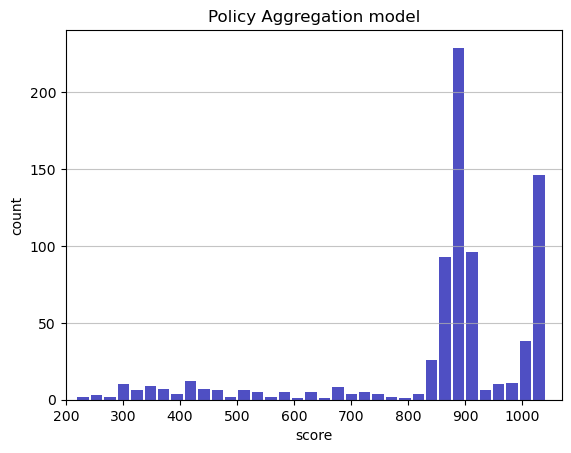

Track generation: 1175..1479 -> 304-tiles track
Epoch: 779
Policy Aggregation	mean: 859.03	variance: 181.37


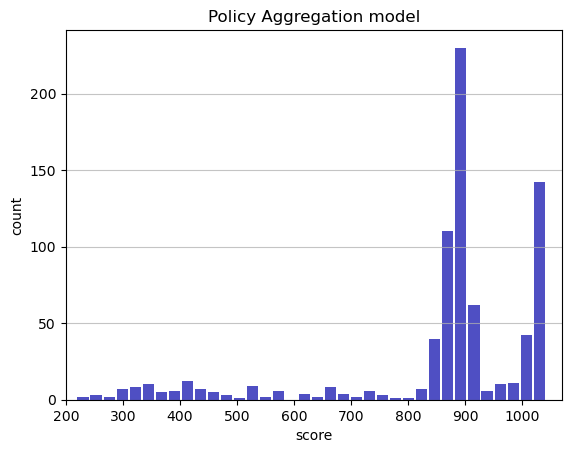

Track generation: 1045..1310 -> 265-tiles track
Epoch: 780
Policy Aggregation	mean: 859.25	variance: 181.36


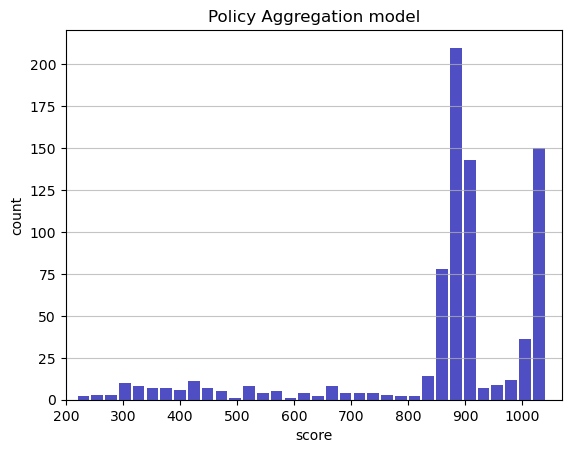

Track generation: 1231..1543 -> 312-tiles track
Epoch: 781
Policy Aggregation	mean: 859.04	variance: 181.34


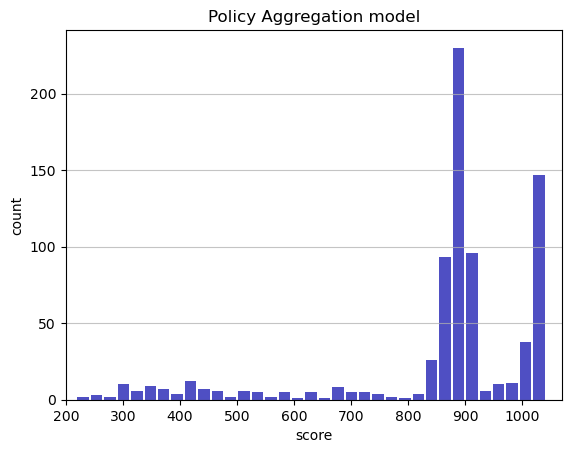

Track generation: 1112..1394 -> 282-tiles track
Epoch: 782
Policy Aggregation	mean: 858.53	variance: 181.78


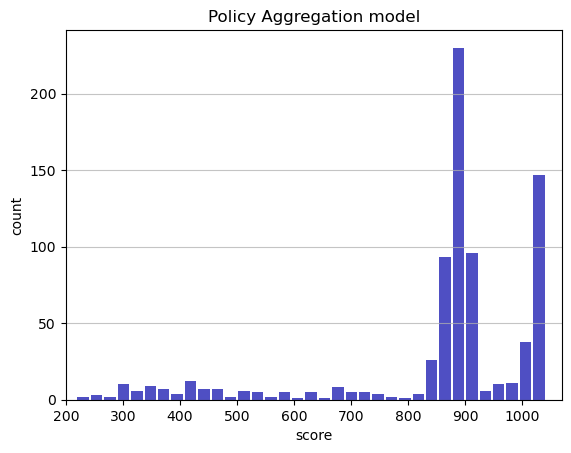

Track generation: 1402..1767 -> 365-tiles track
Epoch: 783
Policy Aggregation	mean: 858.64	variance: 181.69


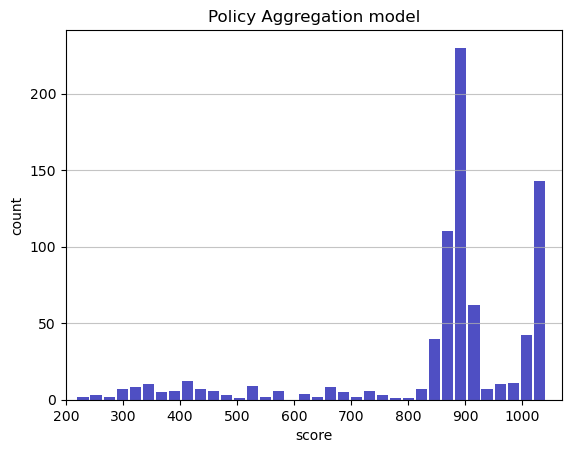

Track generation: 1531..1917 -> 386-tiles track
Epoch: 784
Policy Aggregation	mean: 858.65	variance: 181.57


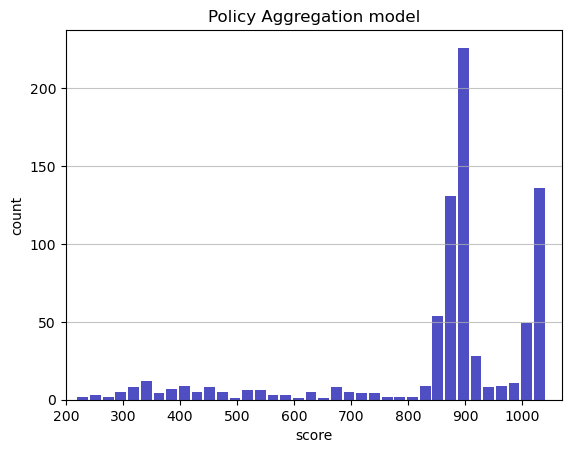

Track generation: 1197..1502 -> 305-tiles track
Epoch: 785
Policy Aggregation	mean: 858.07	variance: 182.18


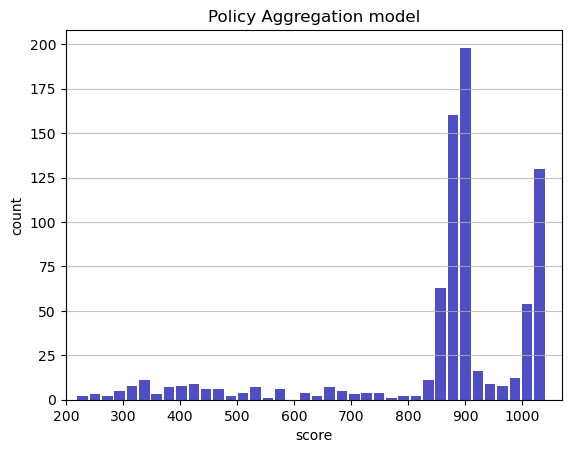

Track generation: 1092..1374 -> 282-tiles track
Epoch: 786
Policy Aggregation	mean: 858.13	variance: 182.08


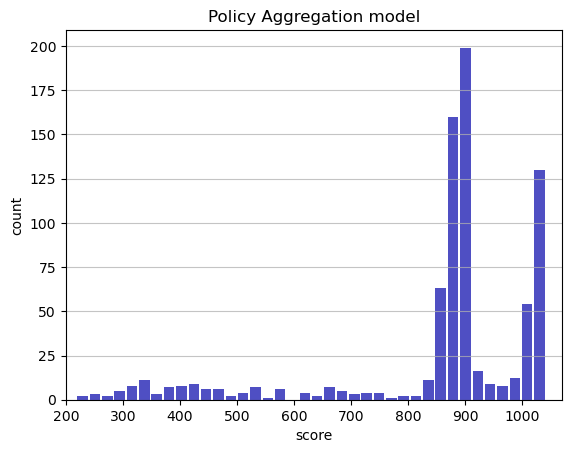

Track generation: 1223..1533 -> 310-tiles track
Epoch: 787
Policy Aggregation	mean: 858.15	variance: 181.96


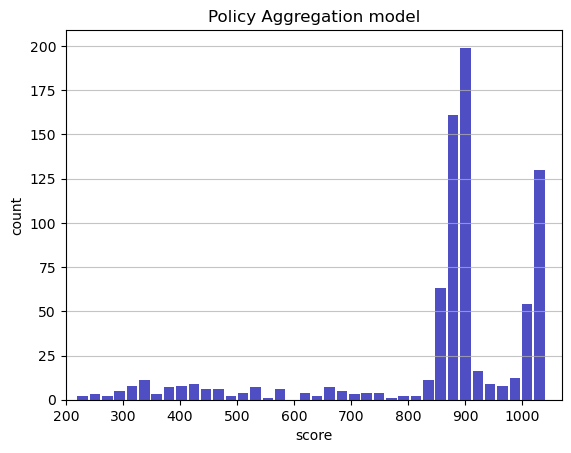

Track generation: 1053..1320 -> 267-tiles track
Epoch: 788
Policy Aggregation	mean: 858.18	variance: 181.85


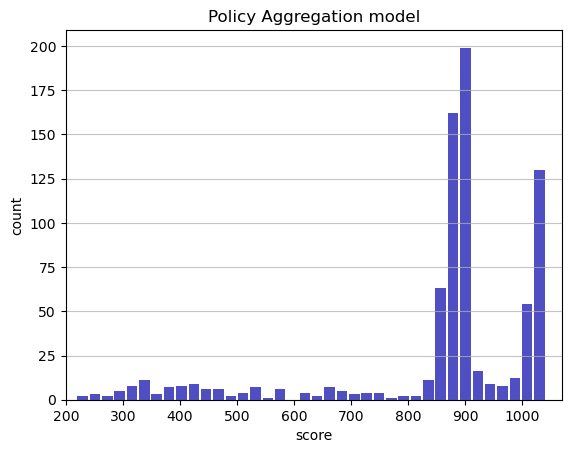

Track generation: 1214..1522 -> 308-tiles track
Epoch: 789
Policy Aggregation	mean: 858.38	variance: 181.83


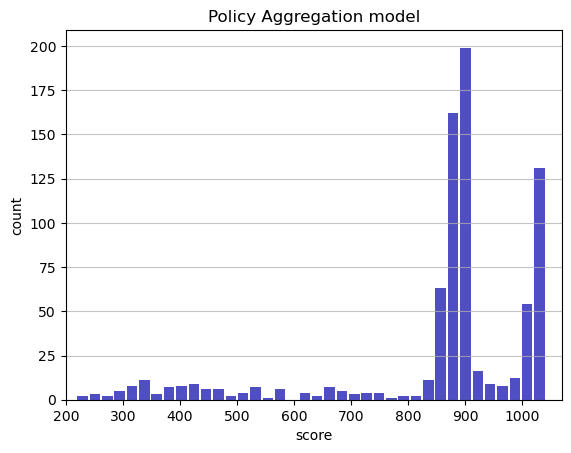

Track generation: 1155..1448 -> 293-tiles track
Epoch: 790
Policy Aggregation	mean: 858.41	variance: 181.71


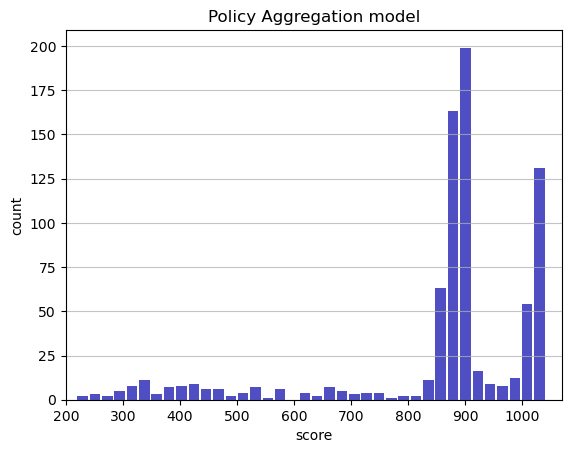

Track generation: 1179..1481 -> 302-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1091..1372 -> 281-tiles track
Epoch: 791
Policy Aggregation	mean: 858.63	variance: 181.70


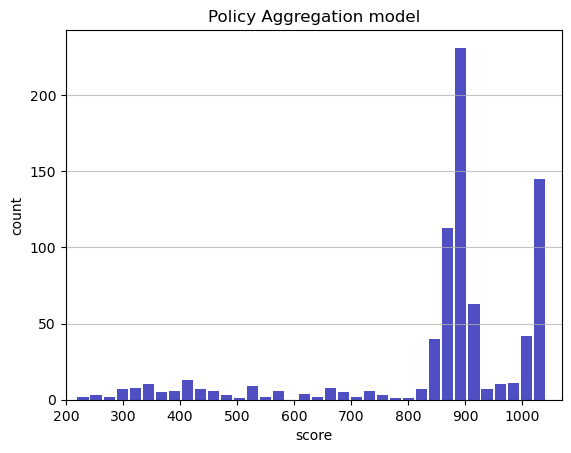

Track generation: 1197..1500 -> 303-tiles track
Epoch: 792
Policy Aggregation	mean: 858.67	variance: 181.59


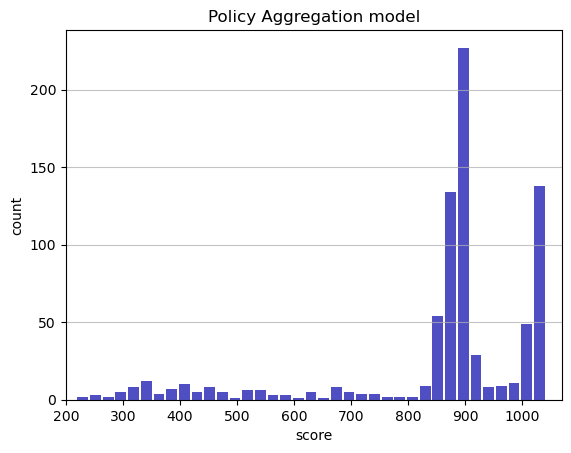

Track generation: 1083..1363 -> 280-tiles track
Epoch: 793
Policy Aggregation	mean: 858.88	variance: 181.57


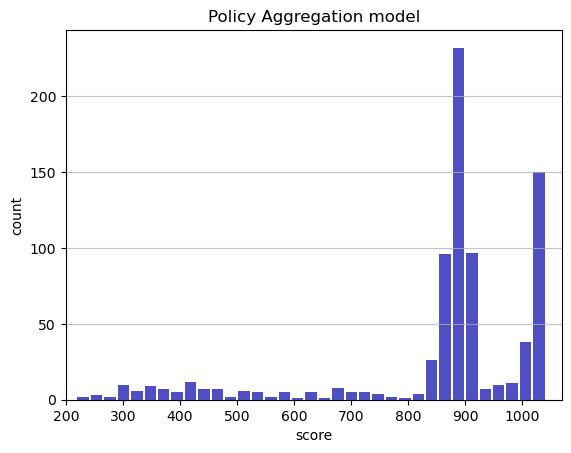

Track generation: 1052..1319 -> 267-tiles track
Epoch: 794
Policy Aggregation	mean: 858.93	variance: 181.46


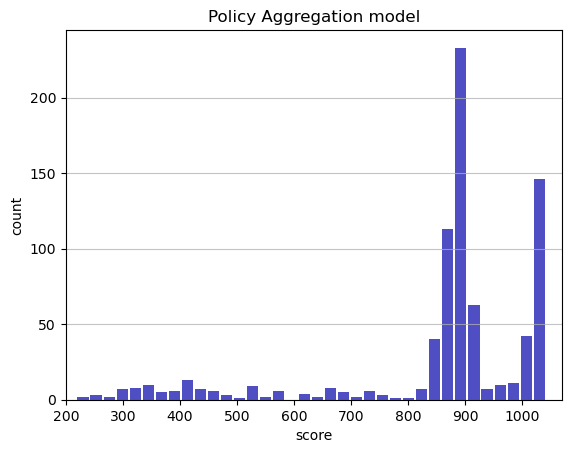

Track generation: 1228..1539 -> 311-tiles track
Epoch: 795
Policy Aggregation	mean: 858.65	variance: 181.52


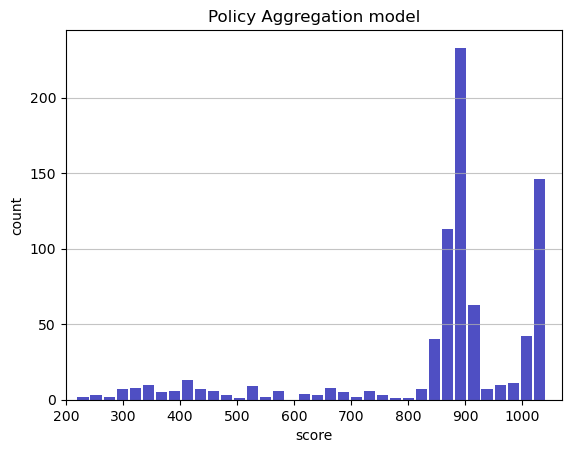

Track generation: 1061..1330 -> 269-tiles track
Epoch: 796
Policy Aggregation	mean: 858.85	variance: 181.50


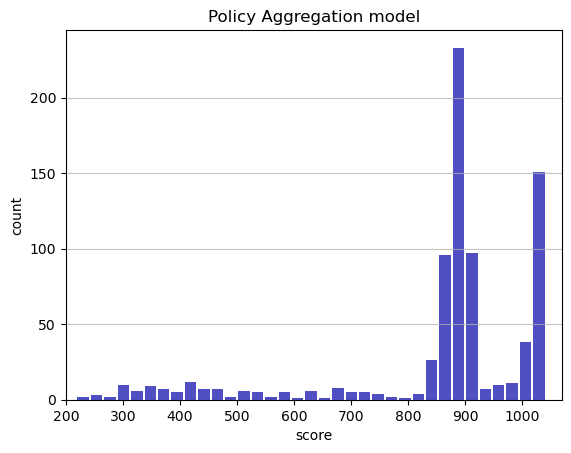

Track generation: 1124..1409 -> 285-tiles track
Epoch: 797
Policy Aggregation	mean: 858.45	variance: 181.74


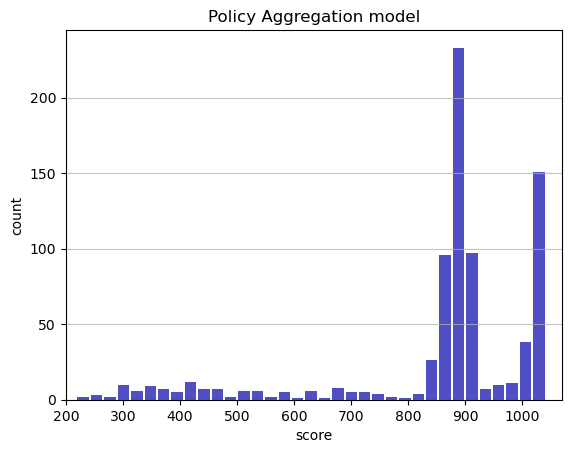

Track generation: 1196..1499 -> 303-tiles track
Epoch: 798
Policy Aggregation	mean: 858.47	variance: 181.63


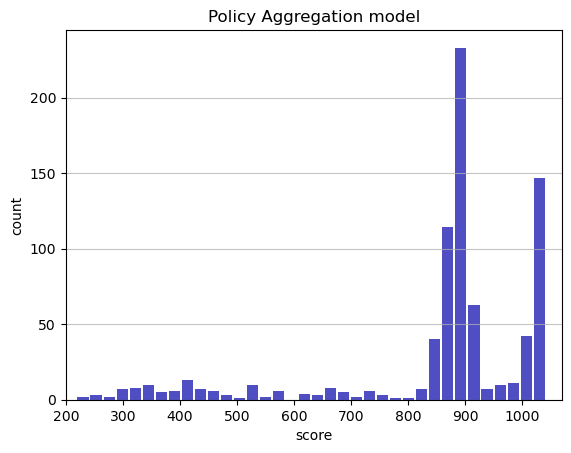

Track generation: 996..1254 -> 258-tiles track
Epoch: 799
Policy Aggregation	mean: 857.99	variance: 182.01


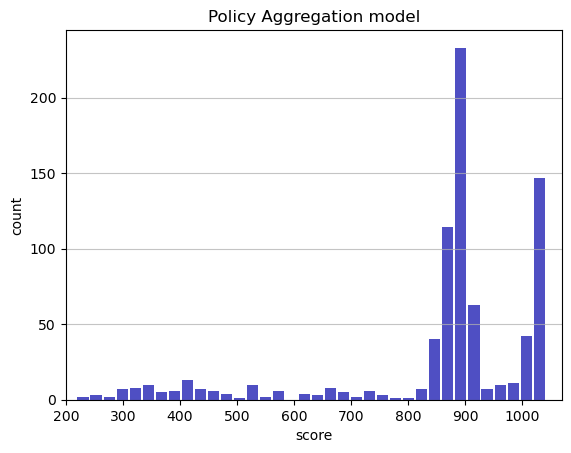

Track generation: 1040..1352 -> 312-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1175..1480 -> 305-tiles track
Epoch: 800
Policy Aggregation	mean: 857.70	variance: 182.09


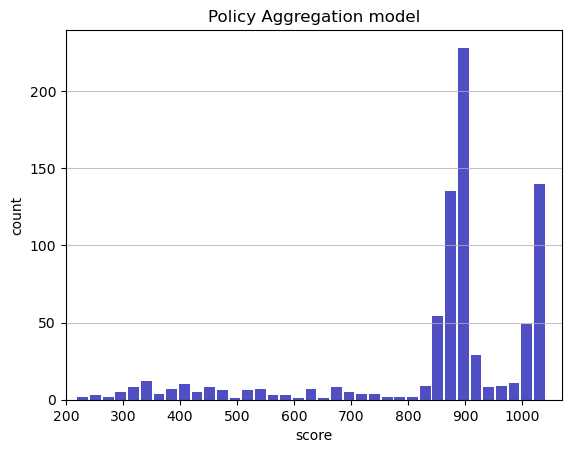

Track generation: 1144..1434 -> 290-tiles track
Epoch: 801
Policy Aggregation	mean: 857.74	variance: 181.97


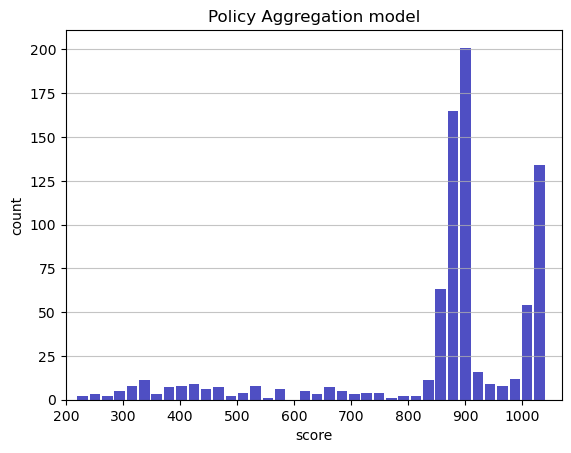

Track generation: 1105..1385 -> 280-tiles track
Epoch: 802
Policy Aggregation	mean: 857.80	variance: 181.87


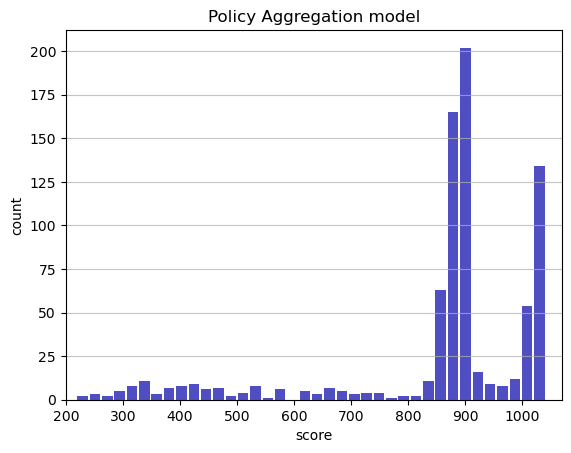

Track generation: 1077..1350 -> 273-tiles track
Epoch: 803
Policy Aggregation	mean: 858.01	variance: 181.86


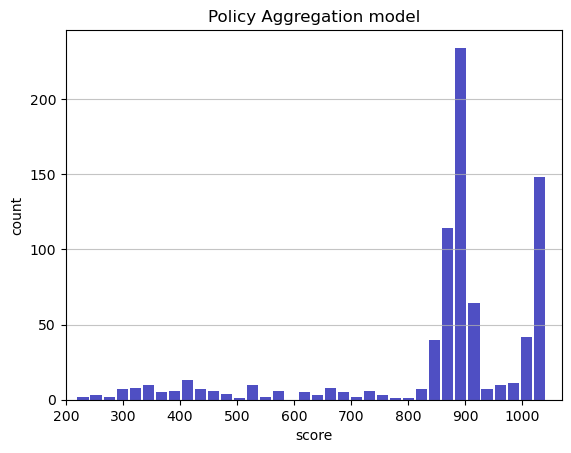

Track generation: 1163..1468 -> 305-tiles track
Epoch: 804
Policy Aggregation	mean: 858.05	variance: 181.75


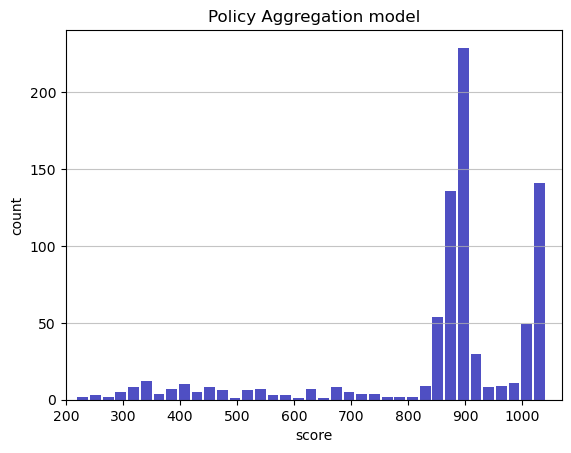

Track generation: 1182..1490 -> 308-tiles track
Epoch: 805
Policy Aggregation	mean: 858.10	variance: 181.64


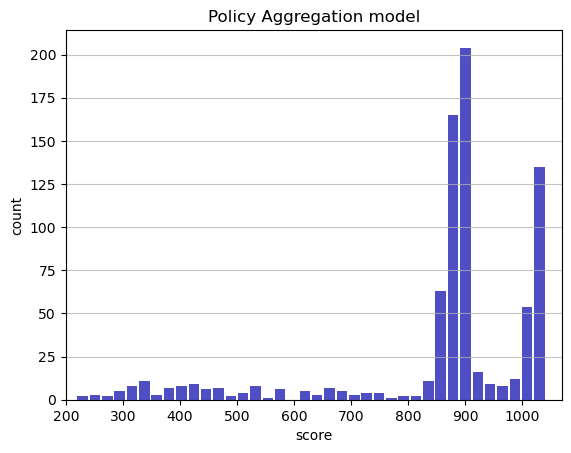

Track generation: 1043..1308 -> 265-tiles track
Epoch: 806
Policy Aggregation	mean: 858.12	variance: 181.53


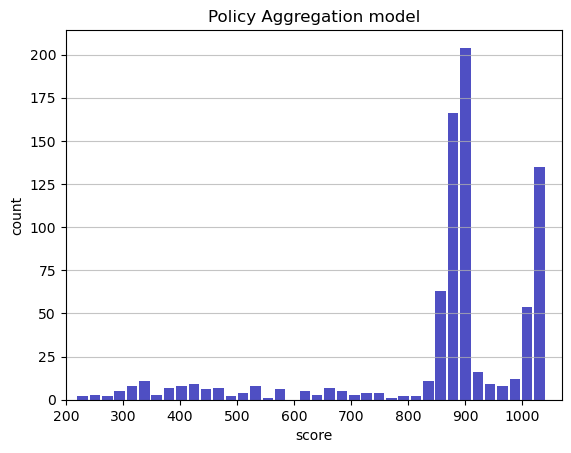

Track generation: 1172..1470 -> 298-tiles track
Epoch: 807
Policy Aggregation	mean: 858.12	variance: 181.41


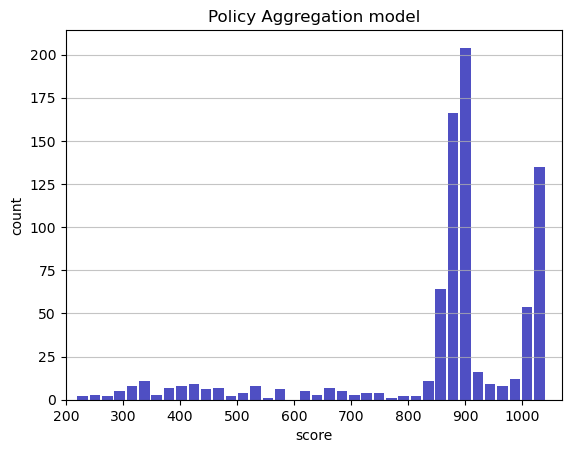

Track generation: 1227..1538 -> 311-tiles track
Epoch: 808
Policy Aggregation	mean: 858.32	variance: 181.39


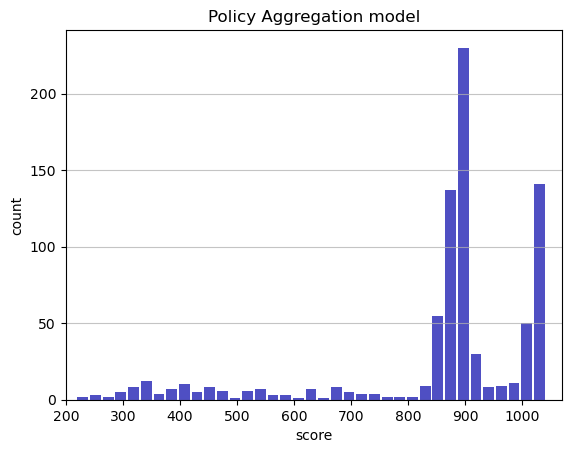

Track generation: 1155..1455 -> 300-tiles track
Epoch: 809
Policy Aggregation	mean: 858.52	variance: 181.36


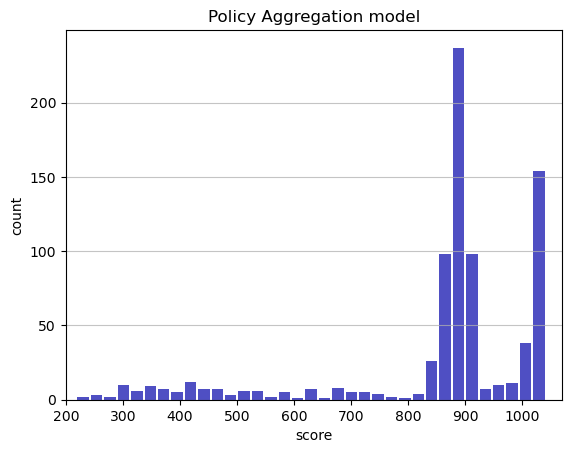

Track generation: 1101..1382 -> 281-tiles track
Epoch: 810
Policy Aggregation	mean: 858.54	variance: 181.25


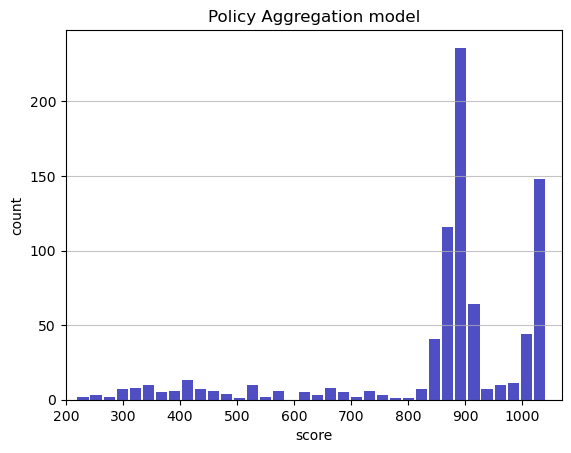

Track generation: 1115..1398 -> 283-tiles track
Epoch: 811
Policy Aggregation	mean: 858.57	variance: 181.14


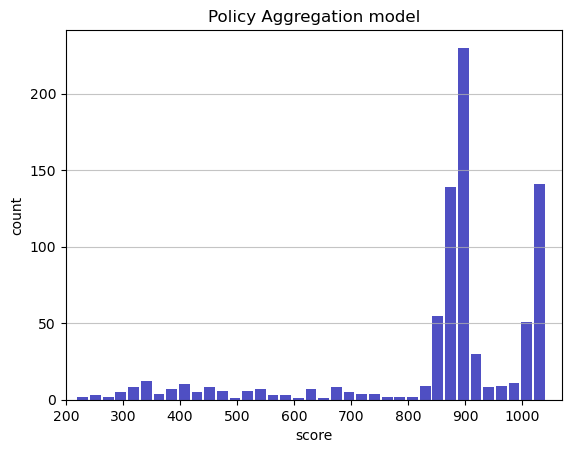

Track generation: 1096..1374 -> 278-tiles track
Epoch: 812
Policy Aggregation	mean: 858.61	variance: 181.04


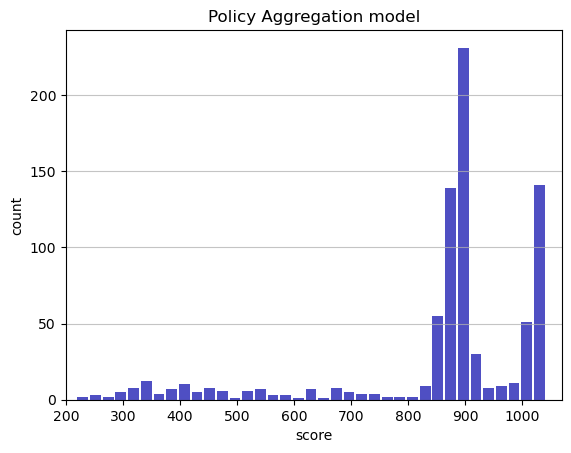

Track generation: 1167..1462 -> 295-tiles track
Epoch: 813
Policy Aggregation	mean: 858.65	variance: 180.93


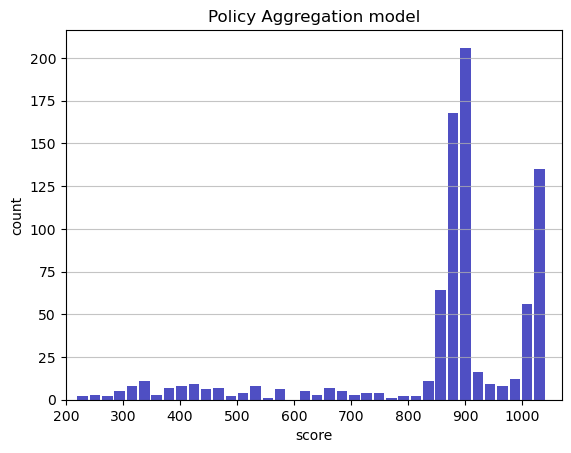

Track generation: 1143..1438 -> 295-tiles track
Epoch: 814
Policy Aggregation	mean: 858.67	variance: 180.82


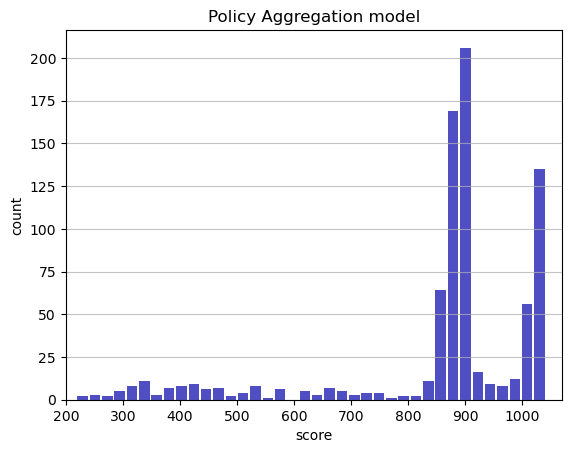

Track generation: 1032..1301 -> 269-tiles track
Epoch: 815
Policy Aggregation	mean: 858.89	variance: 180.81


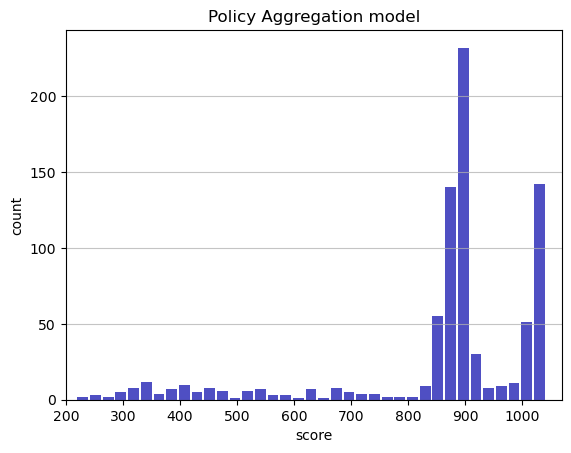

Track generation: 1183..1483 -> 300-tiles track
Epoch: 816
Policy Aggregation	mean: 859.08	variance: 180.79


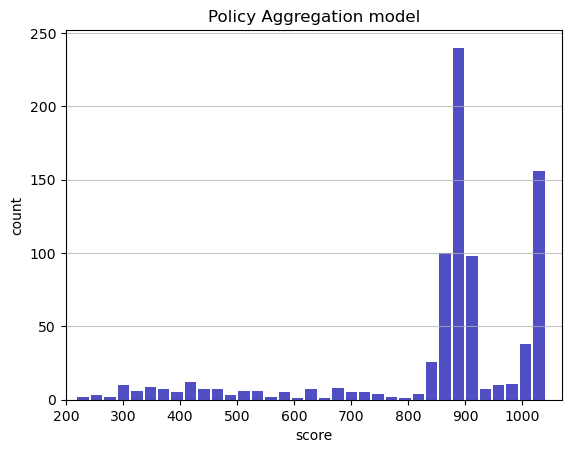

Track generation: 1220..1538 -> 318-tiles track
Epoch: 817
Policy Aggregation	mean: 858.81	variance: 180.85


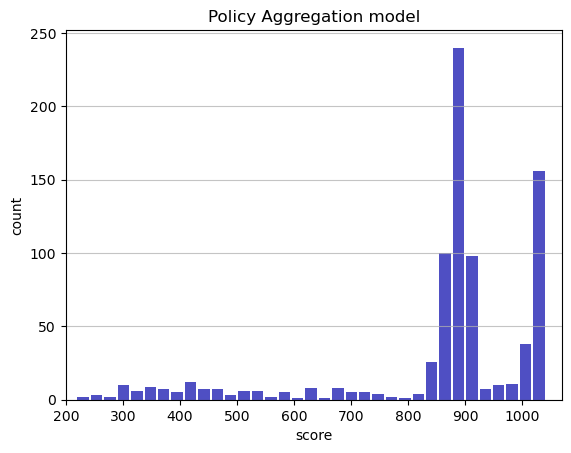

Track generation: 1125..1417 -> 292-tiles track
Epoch: 818
Policy Aggregation	mean: 859.01	variance: 180.83


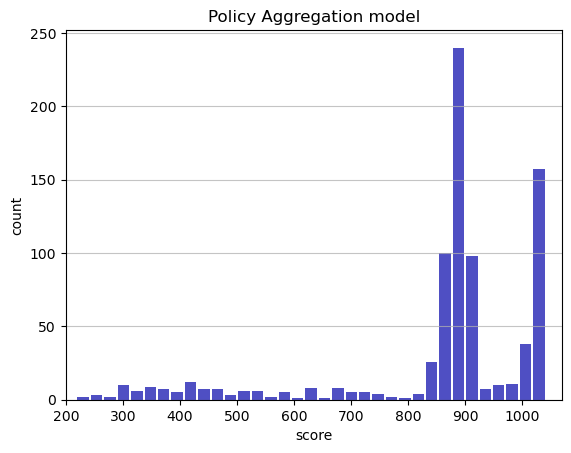

Track generation: 1120..1404 -> 284-tiles track
Epoch: 819
Policy Aggregation	mean: 859.06	variance: 180.73


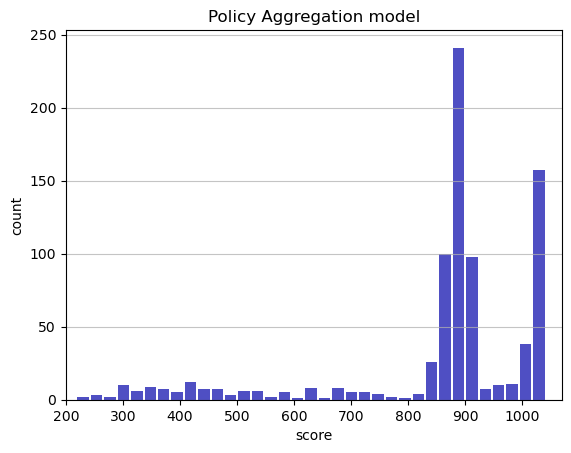

Track generation: 1174..1472 -> 298-tiles track
Epoch: 820
Policy Aggregation	mean: 859.09	variance: 180.62


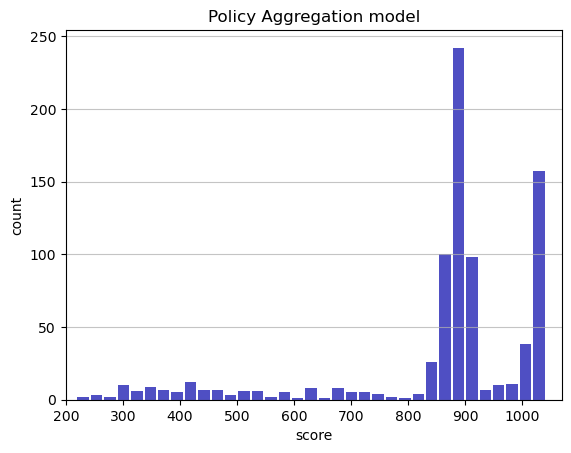

Track generation: 1069..1345 -> 276-tiles track
Epoch: 821
Policy Aggregation	mean: 859.30	variance: 180.61


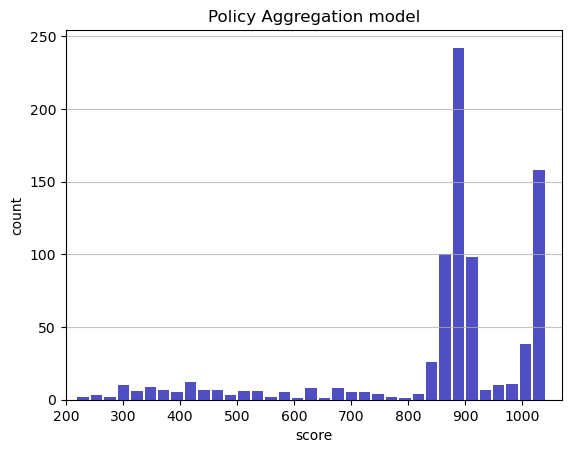

Track generation: 1248..1564 -> 316-tiles track
Epoch: 822
Policy Aggregation	mean: 858.69	variance: 181.34


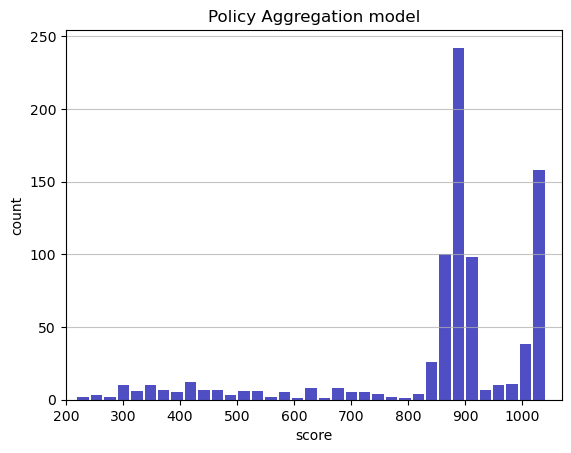

Track generation: 1062..1331 -> 269-tiles track
Epoch: 823
Policy Aggregation	mean: 858.72	variance: 181.23


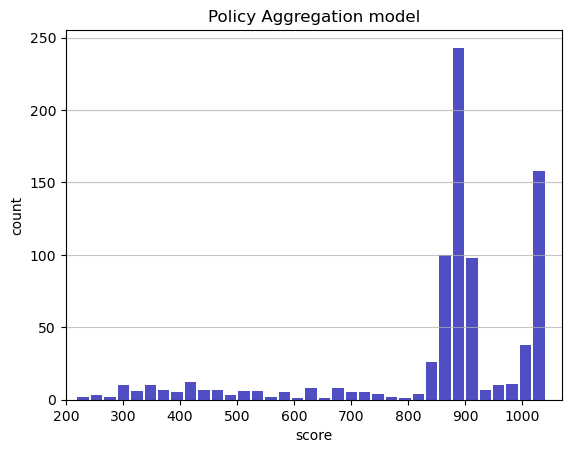

Track generation: 1139..1428 -> 289-tiles track
Epoch: 824
Policy Aggregation	mean: 858.74	variance: 181.13


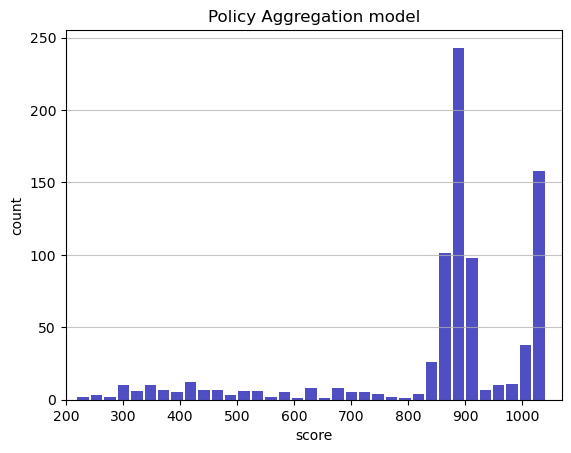

Track generation: 1201..1512 -> 311-tiles track
Epoch: 825
Policy Aggregation	mean: 858.76	variance: 181.02


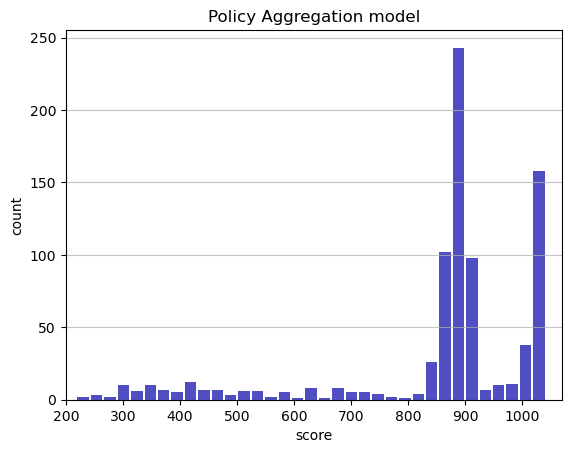

Track generation: 1385..1735 -> 350-tiles track
Epoch: 826
Policy Aggregation	mean: 858.90	variance: 180.95


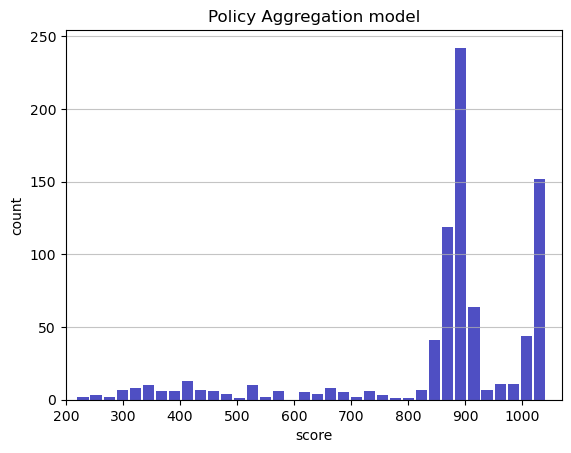

Track generation: 1111..1392 -> 281-tiles track
Epoch: 827
Policy Aggregation	mean: 858.93	variance: 180.84


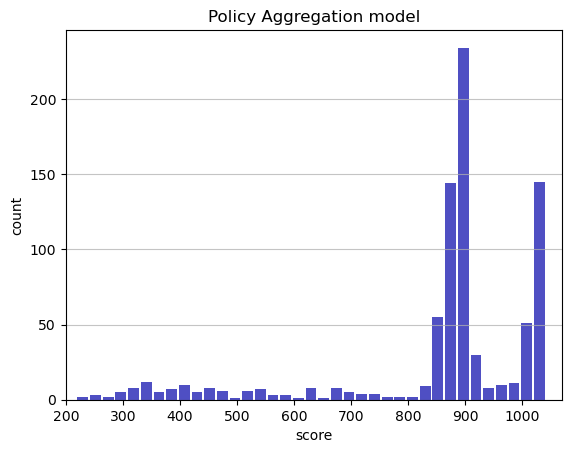

Track generation: 1240..1553 -> 313-tiles track
Epoch: 828
Policy Aggregation	mean: 858.21	variance: 181.91


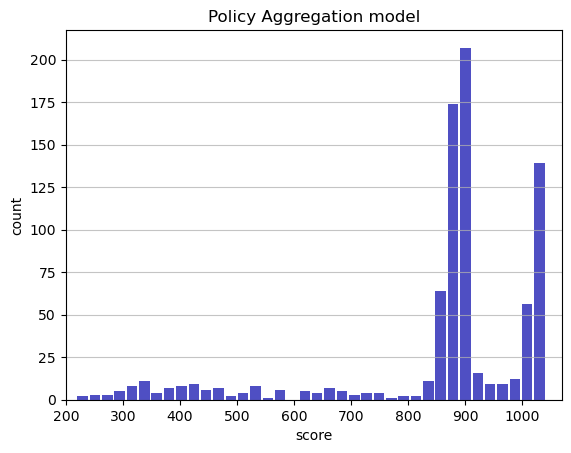

Track generation: 1114..1402 -> 288-tiles track
Epoch: 829
Policy Aggregation	mean: 858.23	variance: 181.80


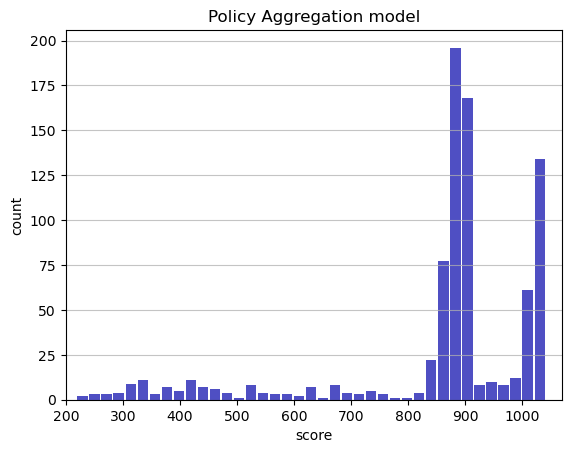

Track generation: 962..1212 -> 250-tiles track
Epoch: 830
Policy Aggregation	mean: 858.29	variance: 181.70


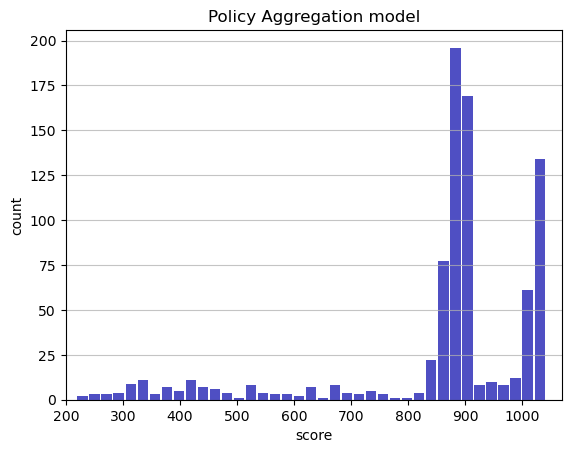

Track generation: 1149..1440 -> 291-tiles track
Epoch: 831
Policy Aggregation	mean: 858.34	variance: 181.60


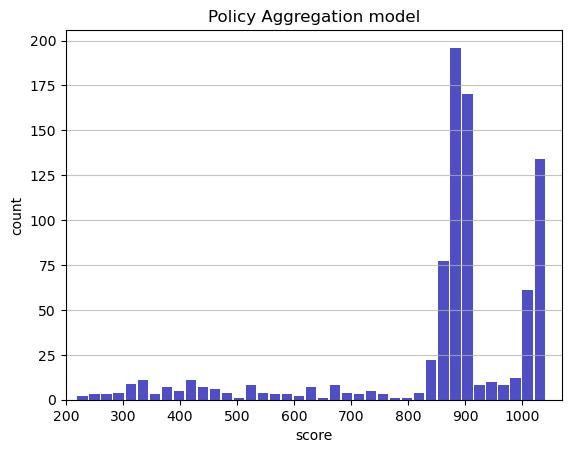

Track generation: 1085..1363 -> 278-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1064..1334 -> 270-tiles track
Epoch: 832
Policy Aggregation	mean: 857.83	variance: 182.07


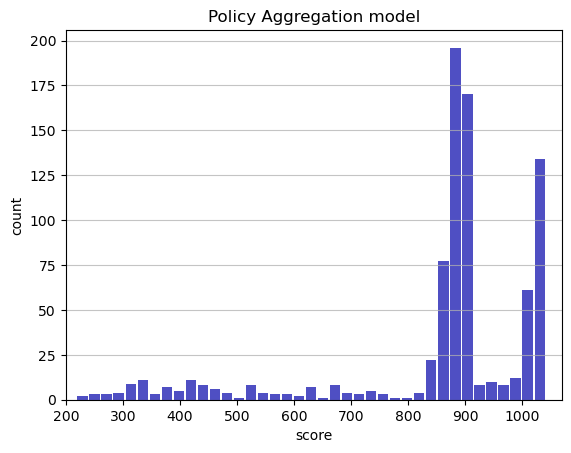

Track generation: 1269..1590 -> 321-tiles track
Epoch: 833
Policy Aggregation	mean: 857.85	variance: 181.96


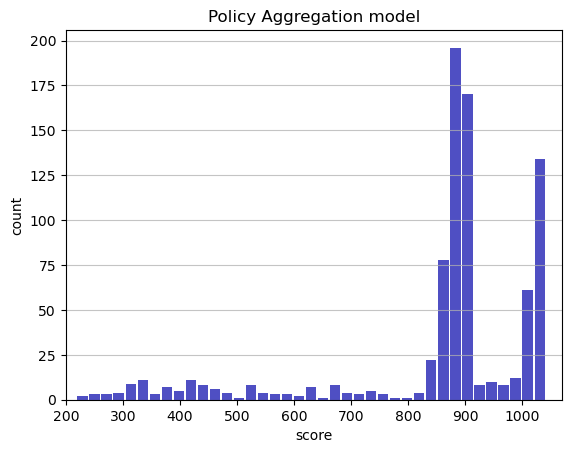

Track generation: 1218..1528 -> 310-tiles track
Epoch: 834
Policy Aggregation	mean: 857.89	variance: 181.86


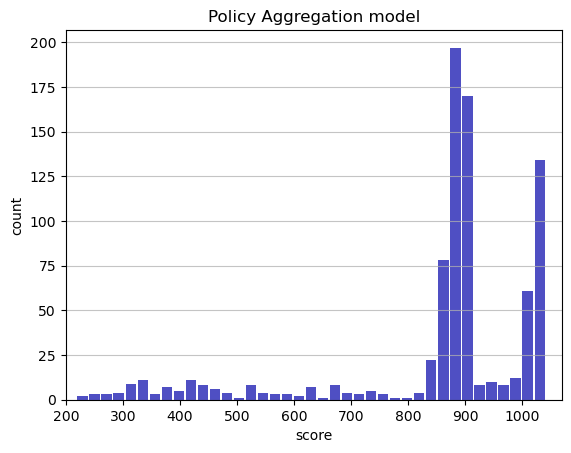

Track generation: 1146..1437 -> 291-tiles track
Epoch: 835
Policy Aggregation	mean: 857.93	variance: 181.75


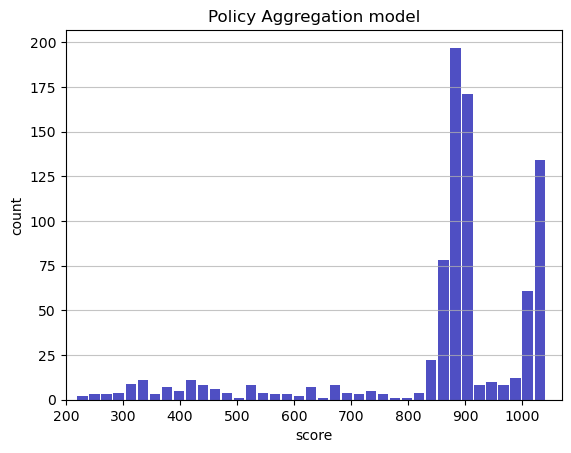

Track generation: 1230..1541 -> 311-tiles track
Epoch: 836
Policy Aggregation	mean: 857.26	variance: 182.67


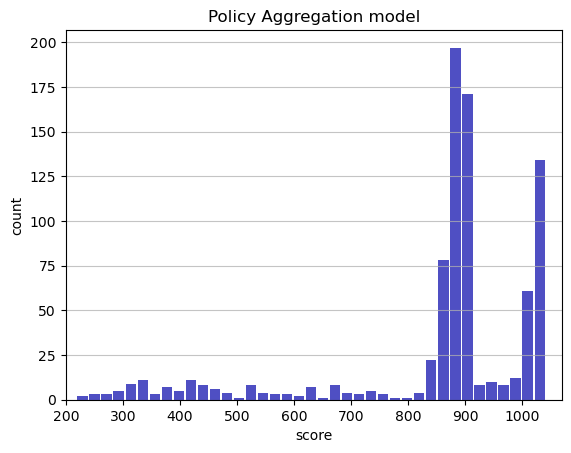

Track generation: 1167..1471 -> 304-tiles track
Epoch: 837
Policy Aggregation	mean: 857.31	variance: 182.56


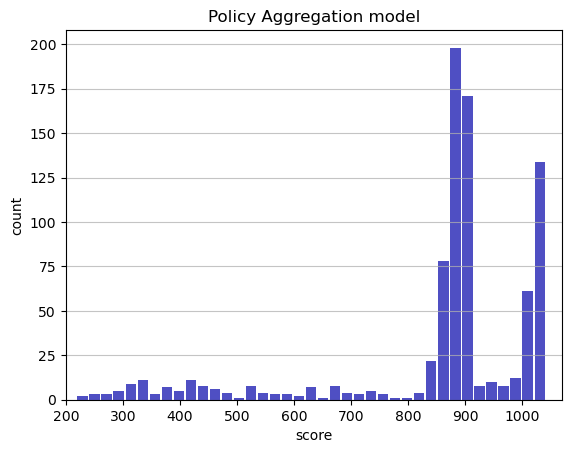

Track generation: 1202..1506 -> 304-tiles track
Epoch: 838
Policy Aggregation	mean: 857.34	variance: 182.46


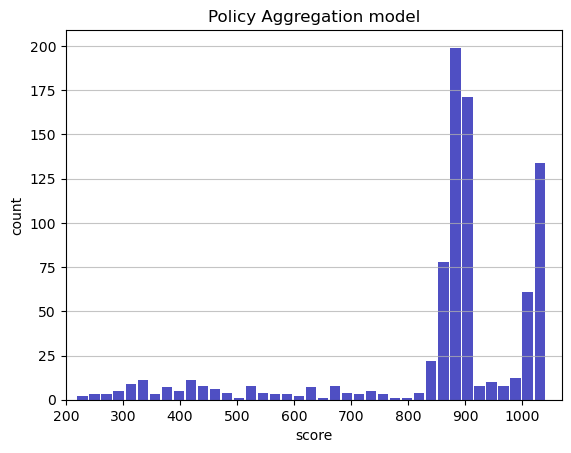

Track generation: 1099..1378 -> 279-tiles track
Epoch: 839
Policy Aggregation	mean: 857.03	variance: 182.56


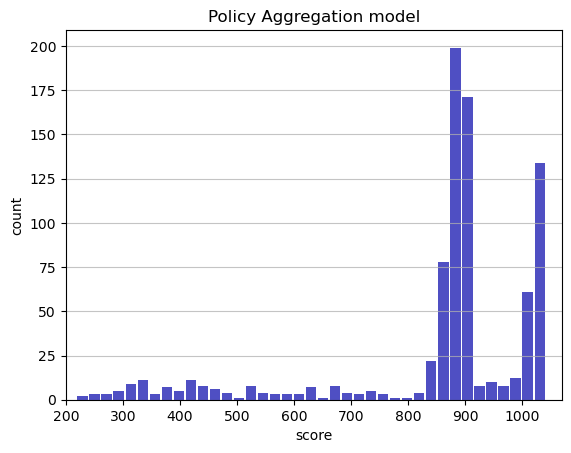

Track generation: 1120..1404 -> 284-tiles track
Epoch: 840
Policy Aggregation	mean: 857.08	variance: 182.45


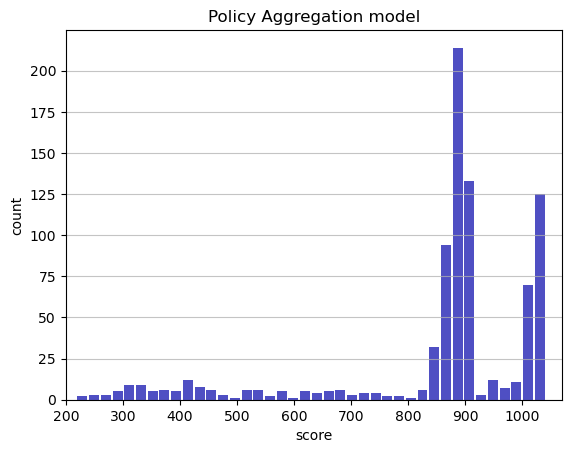

Track generation: 1315..1648 -> 333-tiles track
Epoch: 841
Policy Aggregation	mean: 857.26	variance: 182.42


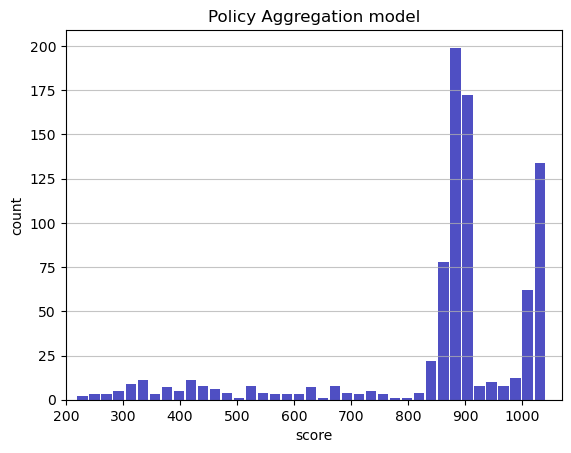

Track generation: 1011..1276 -> 265-tiles track
Epoch: 842
Policy Aggregation	mean: 856.80	variance: 182.79


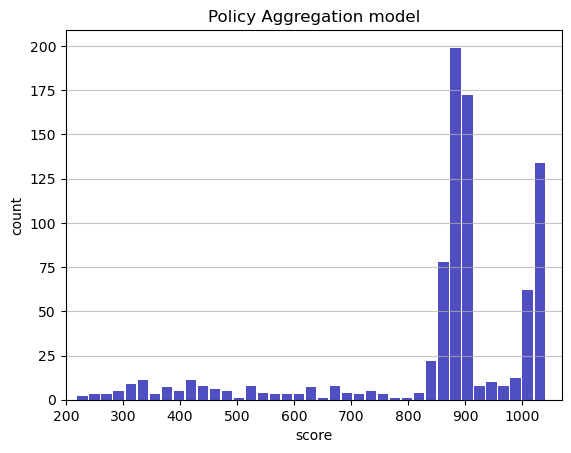

Track generation: 1156..1449 -> 293-tiles track
Epoch: 843
Policy Aggregation	mean: 856.85	variance: 182.69


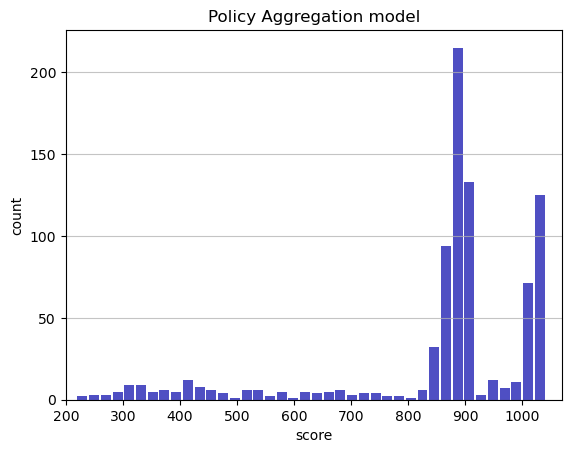

Track generation: 1170..1466 -> 296-tiles track
Epoch: 844
Policy Aggregation	mean: 856.89	variance: 182.59


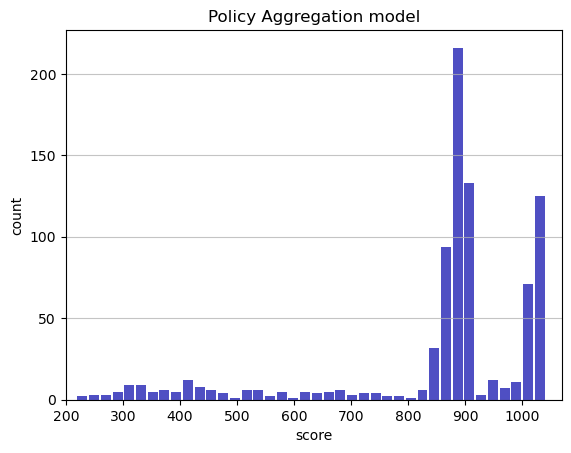

Track generation: 1012..1269 -> 257-tiles track
Epoch: 845
Policy Aggregation	mean: 857.09	variance: 182.57


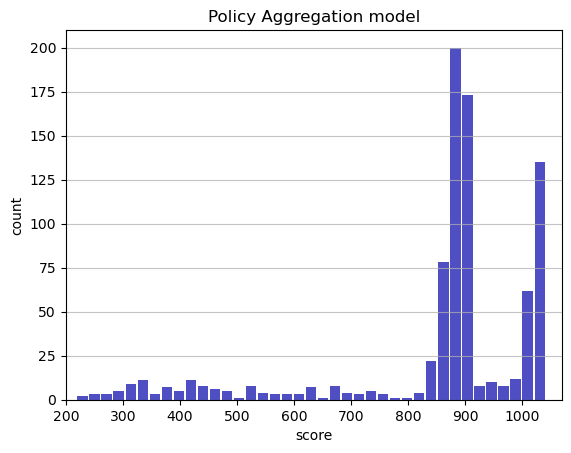

Track generation: 1097..1378 -> 281-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1152..1444 -> 292-tiles track
Epoch: 846
Policy Aggregation	mean: 857.12	variance: 182.47


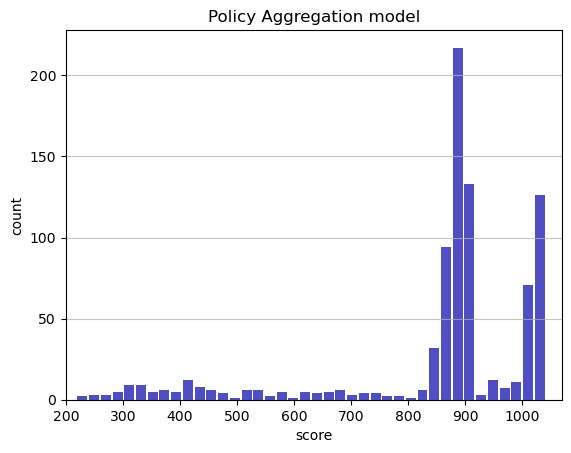

Track generation: 1138..1432 -> 294-tiles track
Epoch: 847
Policy Aggregation	mean: 857.18	variance: 182.37


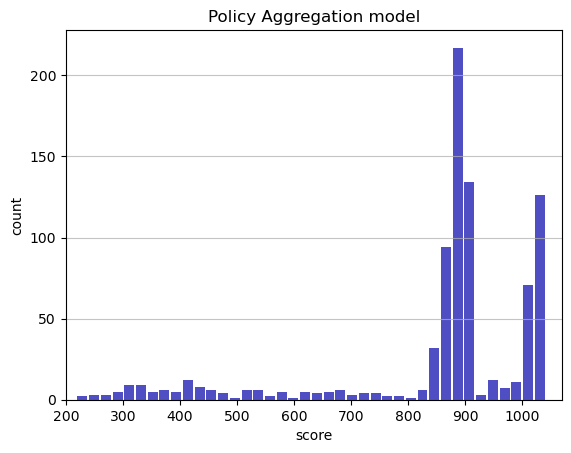

Track generation: 1283..1608 -> 325-tiles track
Epoch: 848
Policy Aggregation	mean: 857.30	variance: 182.30


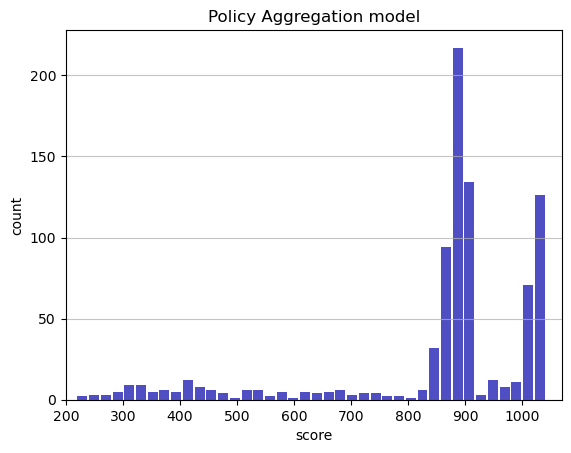

Track generation: 1245..1560 -> 315-tiles track
Epoch: 849
Policy Aggregation	mean: 857.34	variance: 182.19


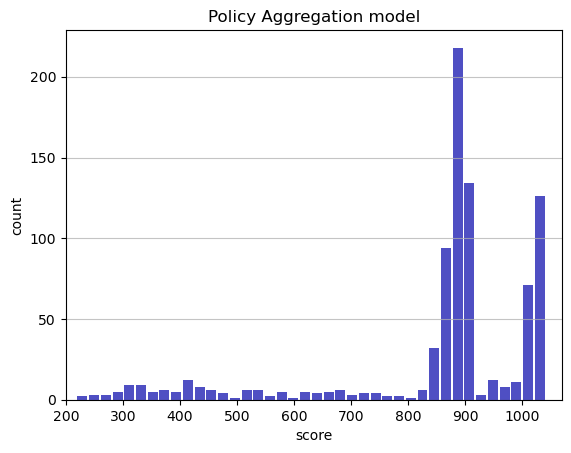

Track generation: 1235..1555 -> 320-tiles track
Epoch: 850
Policy Aggregation	mean: 857.39	variance: 182.09


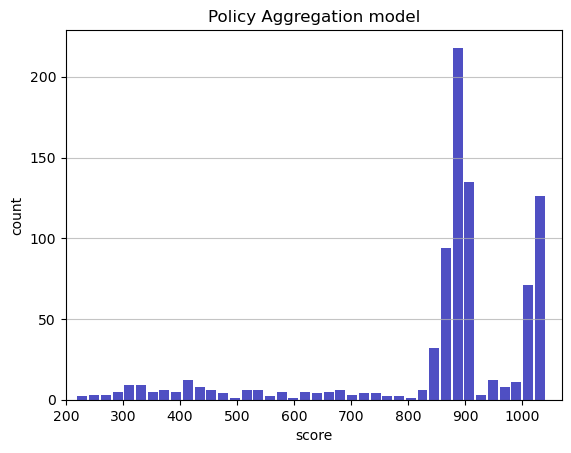

Track generation: 1249..1566 -> 317-tiles track
Epoch: 851
Policy Aggregation	mean: 857.42	variance: 181.99


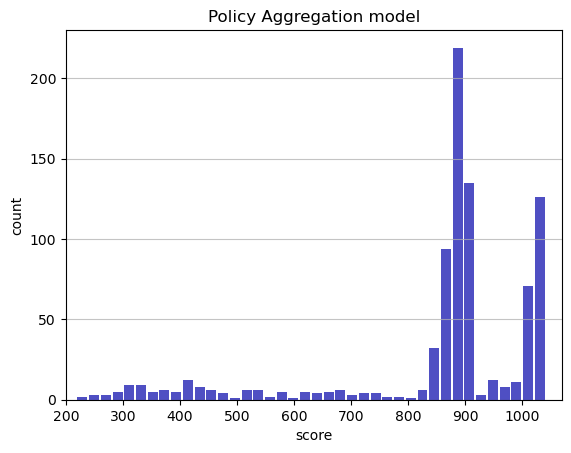

Track generation: 1255..1573 -> 318-tiles track
Epoch: 852
Policy Aggregation	mean: 856.91	variance: 182.48


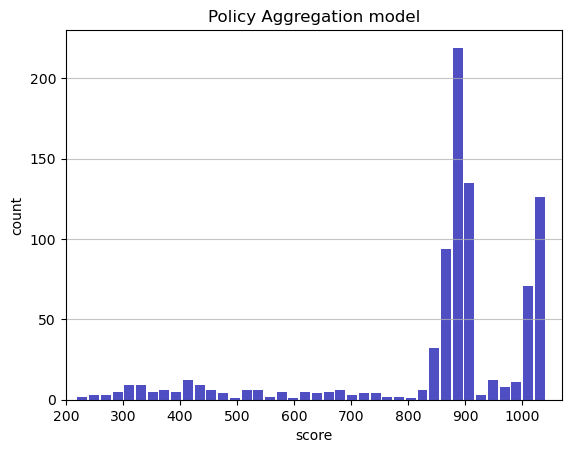

Track generation: 1268..1589 -> 321-tiles track
Epoch: 853
Policy Aggregation	mean: 857.09	variance: 182.45


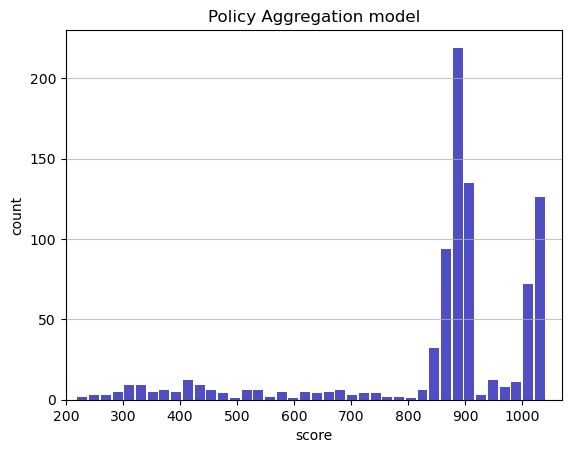

Track generation: 1141..1430 -> 289-tiles track
Epoch: 854
Policy Aggregation	mean: 857.11	variance: 182.35


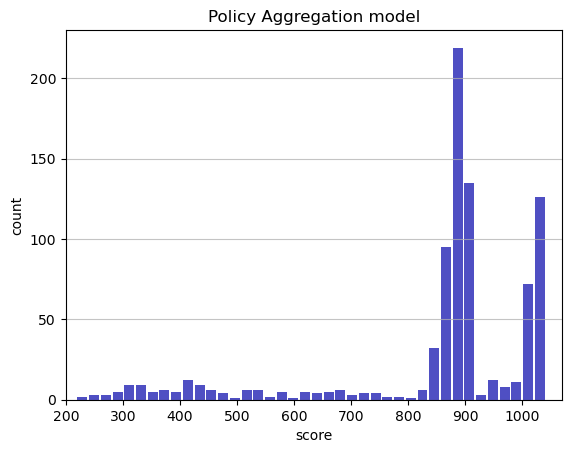

Track generation: 1258..1577 -> 319-tiles track
Epoch: 855
Policy Aggregation	mean: 857.12	variance: 182.24


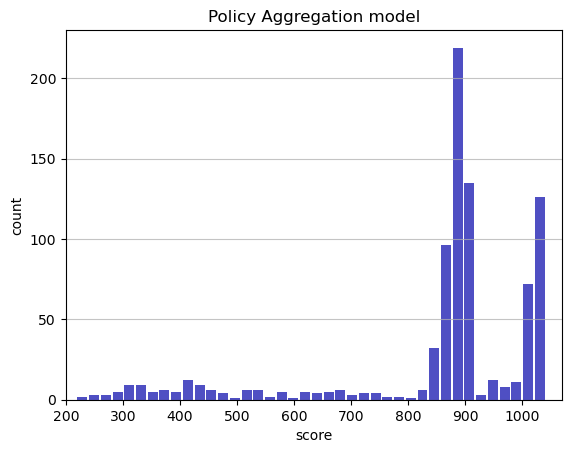

Track generation: 1231..1543 -> 312-tiles track
Epoch: 856
Policy Aggregation	mean: 857.16	variance: 182.14


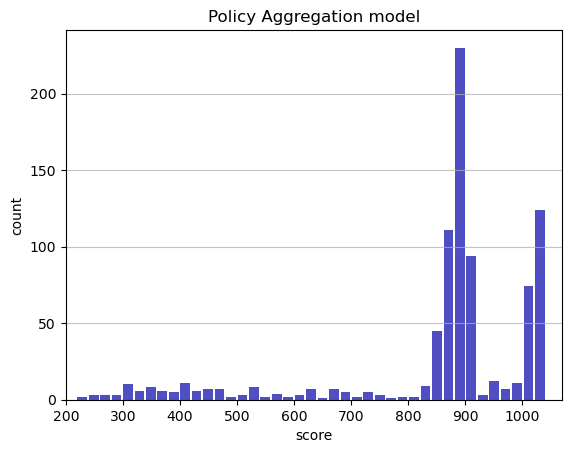

Track generation: 1216..1524 -> 308-tiles track
Epoch: 857
Policy Aggregation	mean: 857.18	variance: 182.03


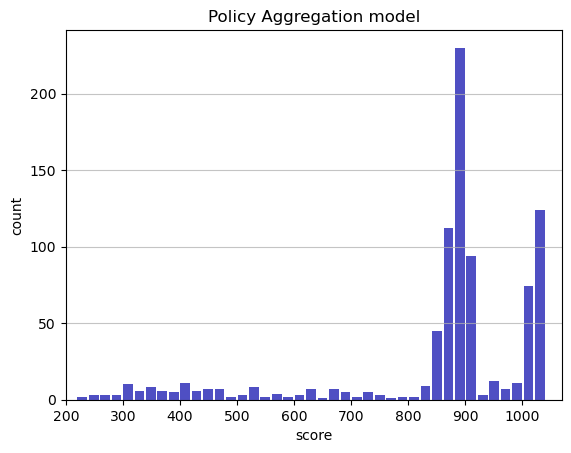

Track generation: 1119..1409 -> 290-tiles track
Epoch: 858
Policy Aggregation	mean: 857.24	variance: 181.93


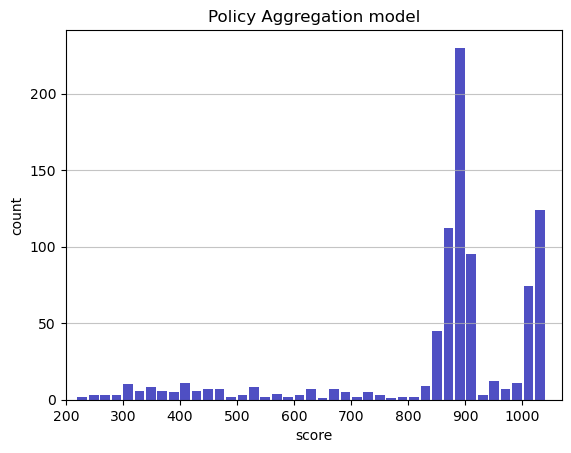

Track generation: 1015..1273 -> 258-tiles track
Epoch: 859
Policy Aggregation	mean: 857.29	variance: 181.83


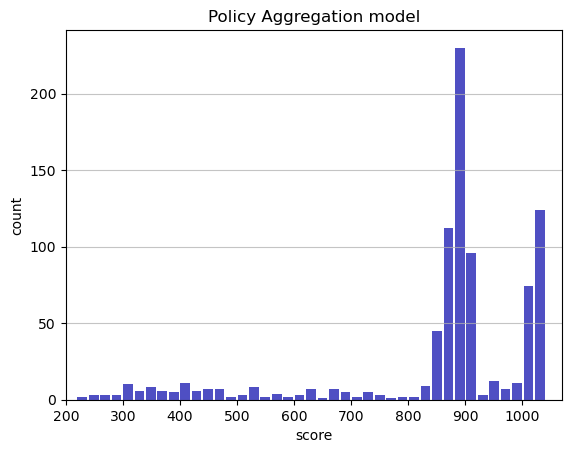

Track generation: 1086..1362 -> 276-tiles track
Epoch: 860
Policy Aggregation	mean: 857.49	variance: 181.83


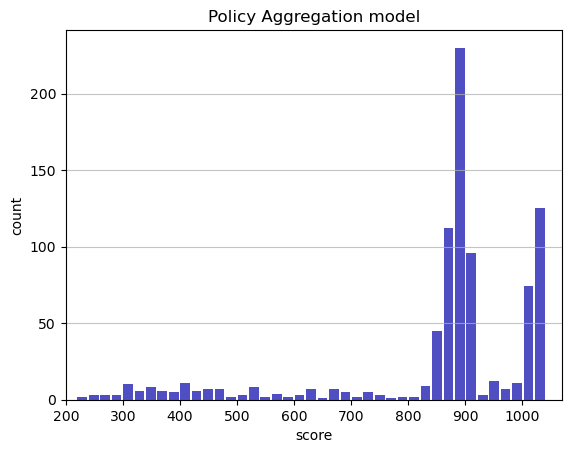

Track generation: 1091..1373 -> 282-tiles track
Epoch: 861
Policy Aggregation	mean: 857.52	variance: 181.72


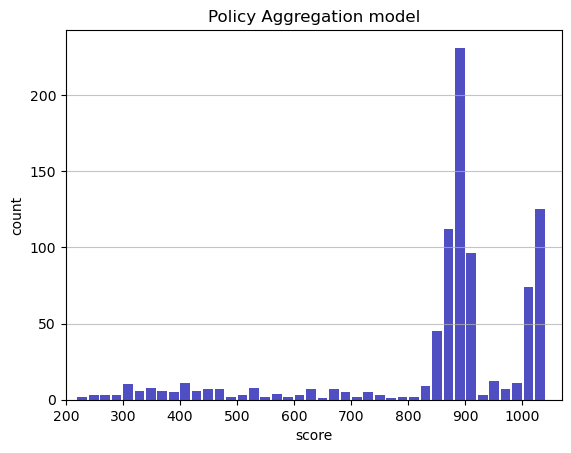

Track generation: 1129..1415 -> 286-tiles track
Epoch: 862
Policy Aggregation	mean: 857.71	variance: 181.70


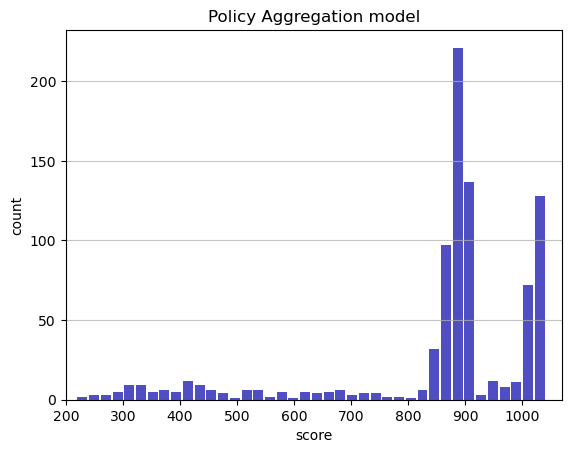

Track generation: 1196..1499 -> 303-tiles track
Epoch: 863
Policy Aggregation	mean: 857.76	variance: 181.60


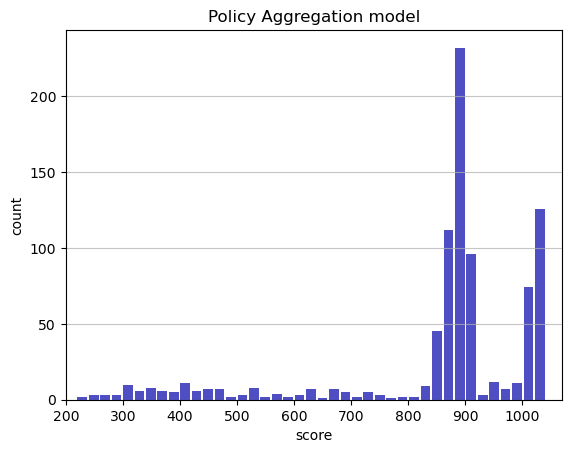

Track generation: 1206..1514 -> 308-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1252..1569 -> 317-tiles track
Epoch: 864
Policy Aggregation	mean: 857.13	variance: 182.42


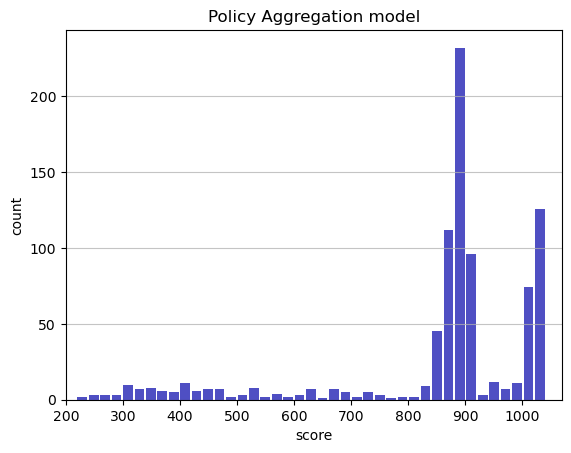

Track generation: 1305..1643 -> 338-tiles track
Epoch: 865
Policy Aggregation	mean: 857.28	variance: 182.36


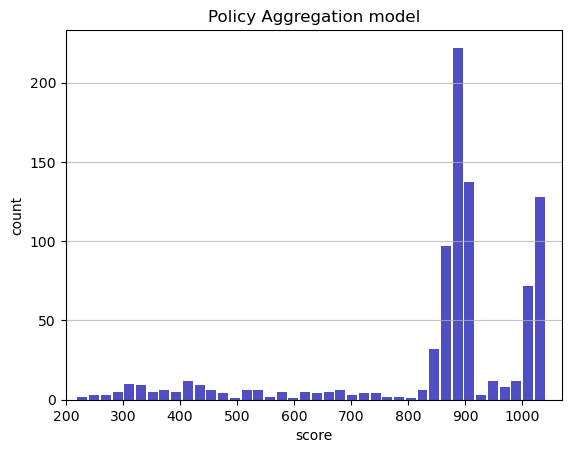

Track generation: 1096..1374 -> 278-tiles track
Epoch: 866
Policy Aggregation	mean: 857.33	variance: 182.26


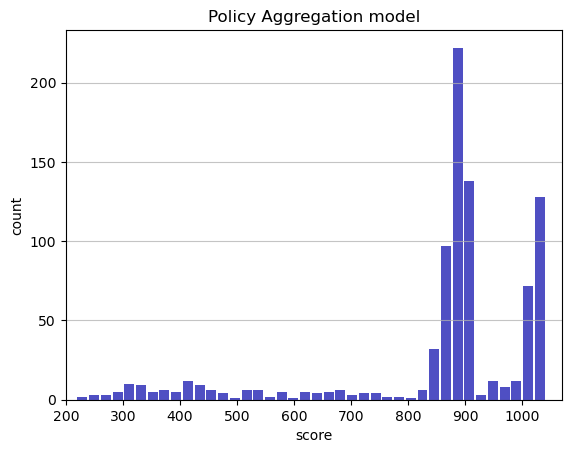

Track generation: 1232..1544 -> 312-tiles track
Epoch: 867
Policy Aggregation	mean: 857.52	variance: 182.24


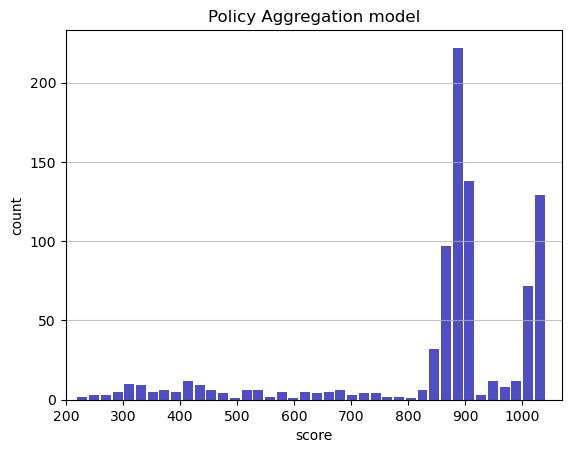

Track generation: 1137..1431 -> 294-tiles track
Epoch: 868
Policy Aggregation	mean: 857.71	variance: 182.22


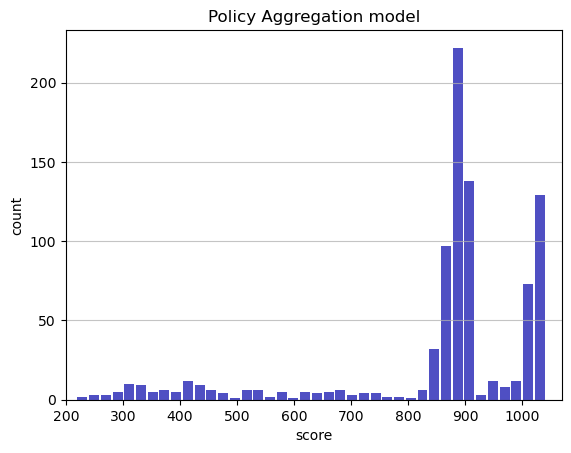

Track generation: 1151..1443 -> 292-tiles track
Epoch: 869
Policy Aggregation	mean: 857.73	variance: 182.12


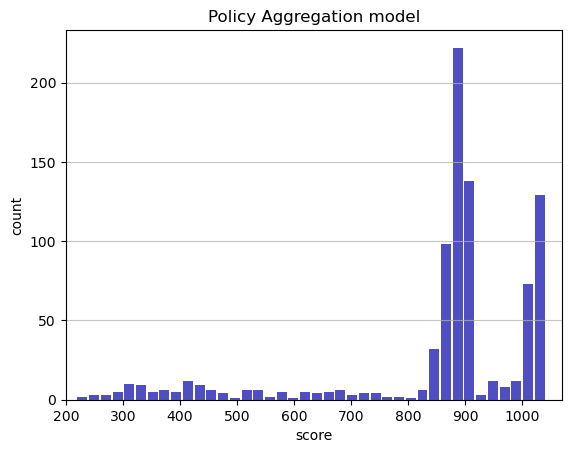

Track generation: 1023..1283 -> 260-tiles track
Epoch: 870
Policy Aggregation	mean: 857.77	variance: 182.02


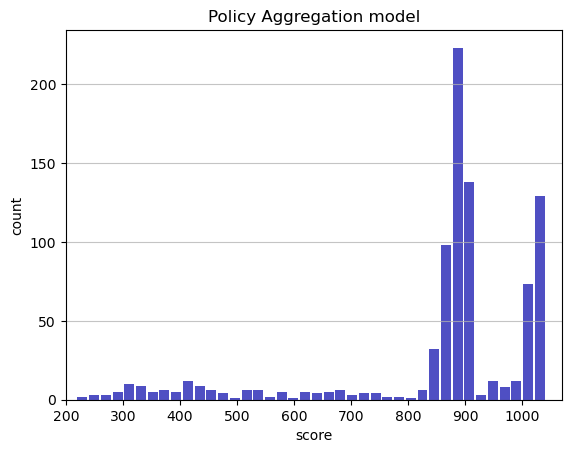

Track generation: 1255..1573 -> 318-tiles track
Epoch: 871
Policy Aggregation	mean: 857.79	variance: 181.91


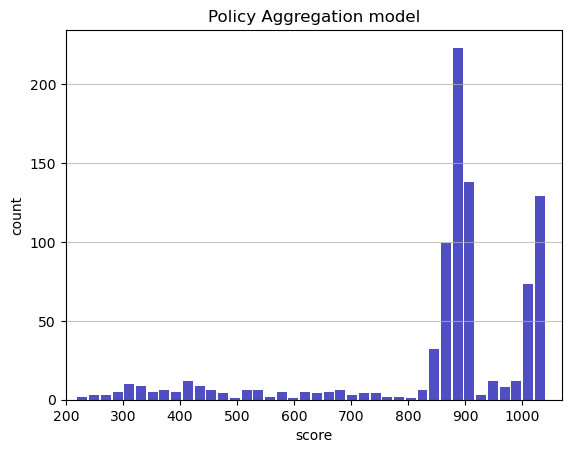

Track generation: 1253..1570 -> 317-tiles track
Epoch: 872
Policy Aggregation	mean: 857.94	variance: 181.86


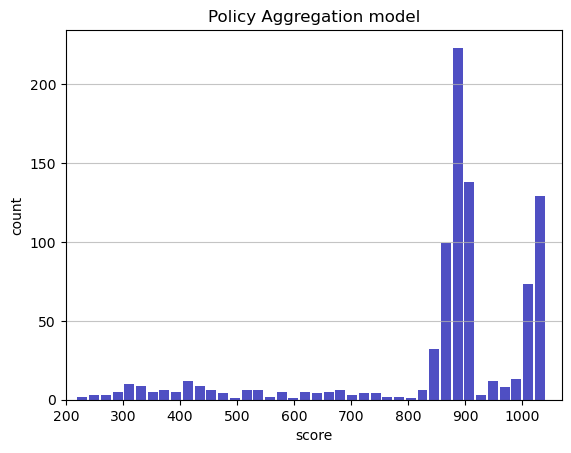

Track generation: 1064..1333 -> 269-tiles track
Epoch: 873
Policy Aggregation	mean: 858.00	variance: 181.77


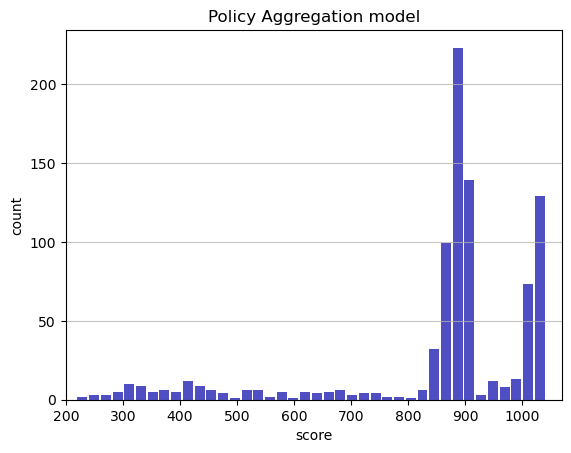

Track generation: 1046..1320 -> 274-tiles track
Epoch: 874
Policy Aggregation	mean: 857.62	variance: 182.01


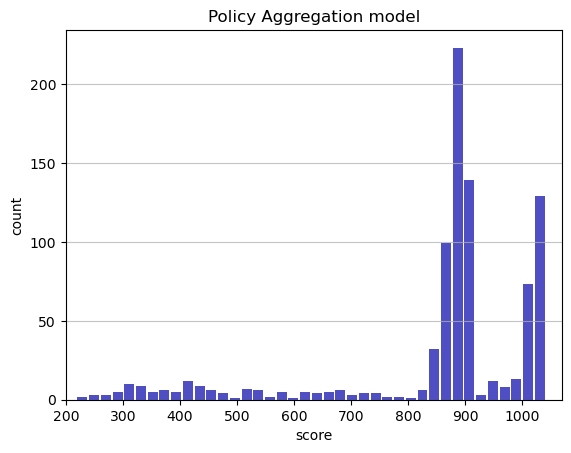

Track generation: 1119..1403 -> 284-tiles track
Epoch: 875
Policy Aggregation	mean: 857.68	variance: 181.91


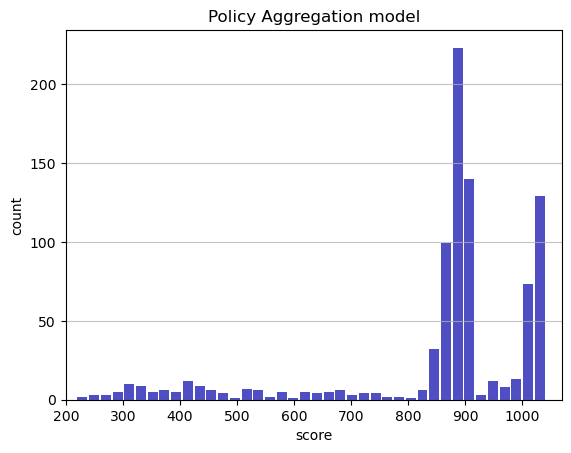

Track generation: 1083..1358 -> 275-tiles track
Epoch: 876
Policy Aggregation	mean: 857.73	variance: 181.81


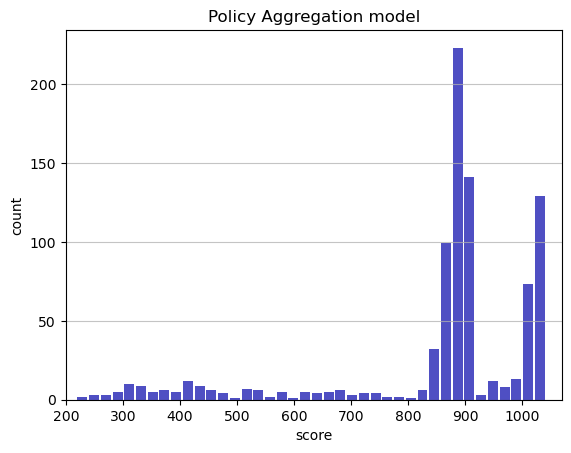

Track generation: 1185..1485 -> 300-tiles track
Epoch: 877
Policy Aggregation	mean: 857.78	variance: 181.71


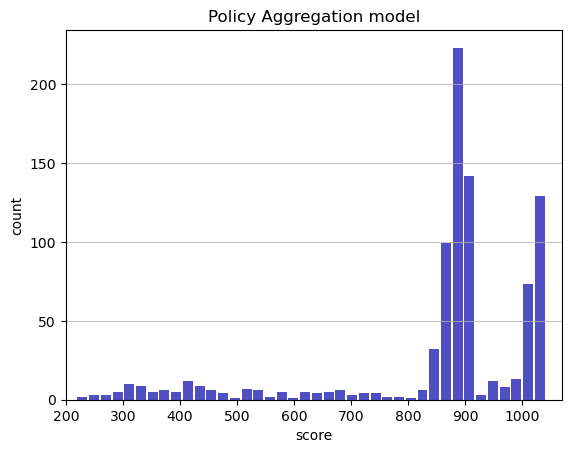

Track generation: 1289..1615 -> 326-tiles track
Epoch: 878
Policy Aggregation	mean: 857.11	variance: 182.70


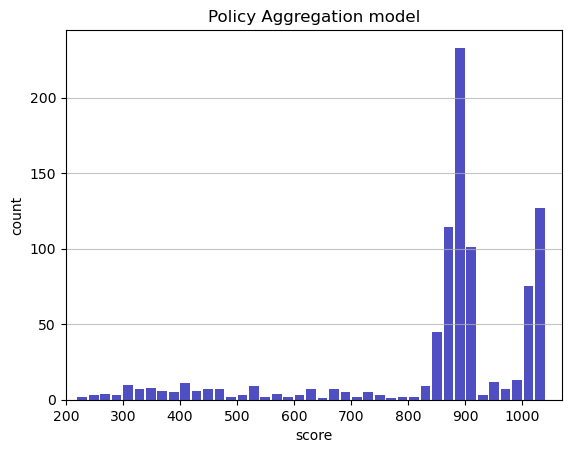

Track generation: 982..1235 -> 253-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1138..1425 -> 287-tiles track
Epoch: 879
Policy Aggregation	mean: 856.86	variance: 182.74


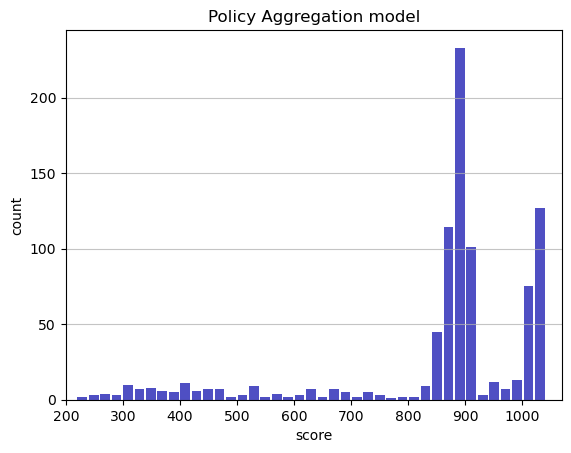

Track generation: 954..1201 -> 247-tiles track
Epoch: 880
Policy Aggregation	mean: 857.07	variance: 182.74


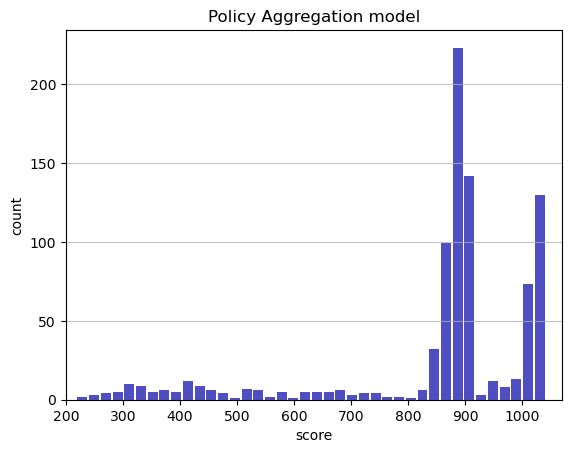

Track generation: 1159..1453 -> 294-tiles track
Epoch: 881
Policy Aggregation	mean: 857.09	variance: 182.64


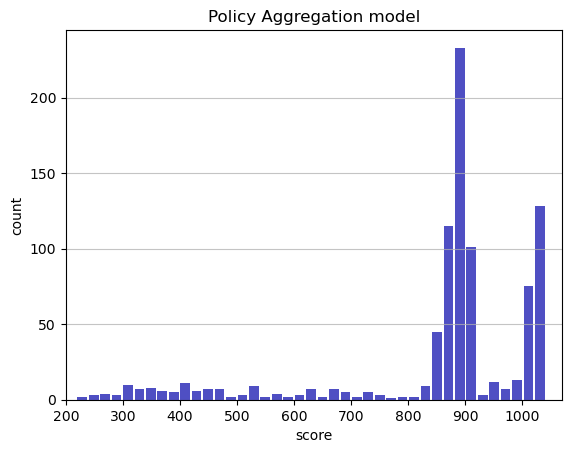

Track generation: 1282..1607 -> 325-tiles track
Epoch: 882
Policy Aggregation	mean: 856.84	variance: 182.69


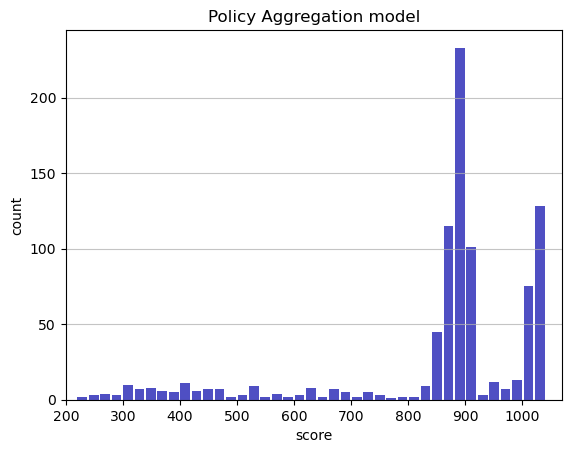

Track generation: 1086..1366 -> 280-tiles track
Epoch: 883
Policy Aggregation	mean: 857.03	variance: 182.68


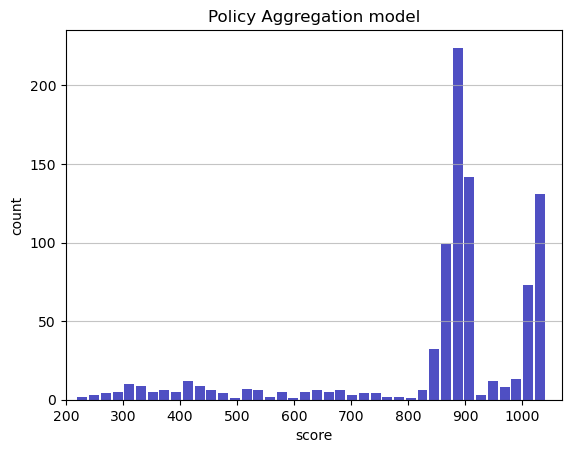

Track generation: 1223..1533 -> 310-tiles track
Epoch: 884
Policy Aggregation	mean: 857.22	variance: 182.66


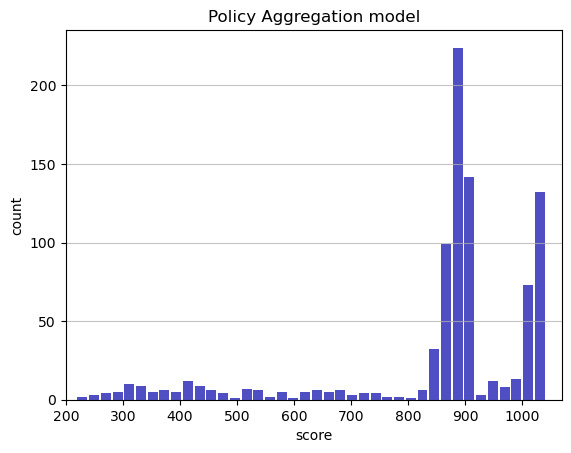

Track generation: 1205..1511 -> 306-tiles track
Epoch: 885
Policy Aggregation	mean: 857.25	variance: 182.56


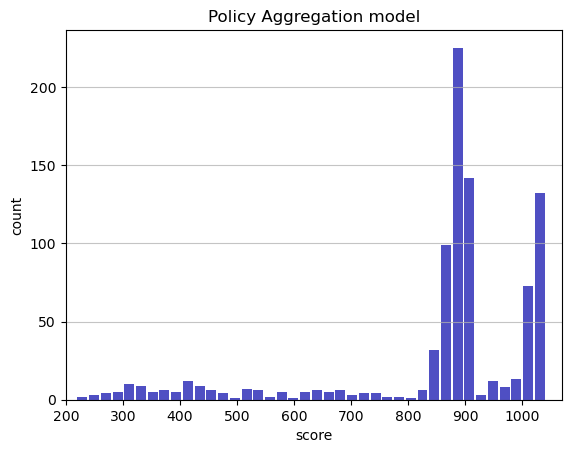

Track generation: 1161..1455 -> 294-tiles track
Epoch: 886
Policy Aggregation	mean: 857.30	variance: 182.46


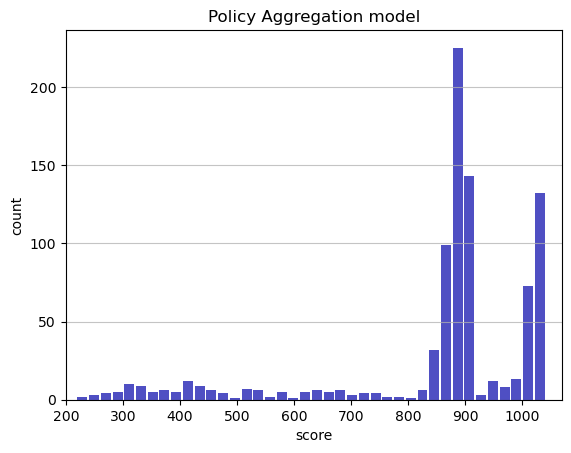

Track generation: 1299..1628 -> 329-tiles track
Epoch: 887
Policy Aggregation	mean: 857.48	variance: 182.43


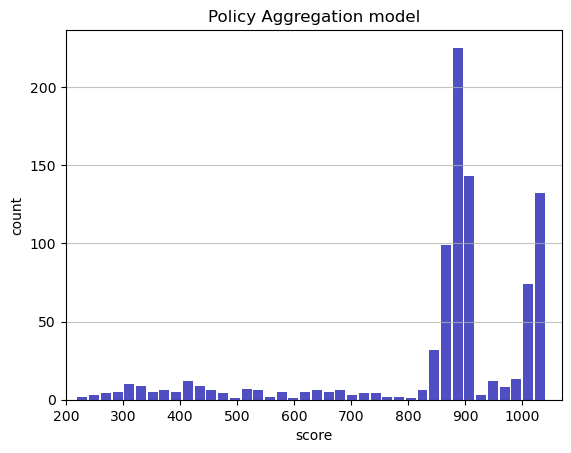

Track generation: 1150..1442 -> 292-tiles track
Epoch: 888
Policy Aggregation	mean: 857.51	variance: 182.33


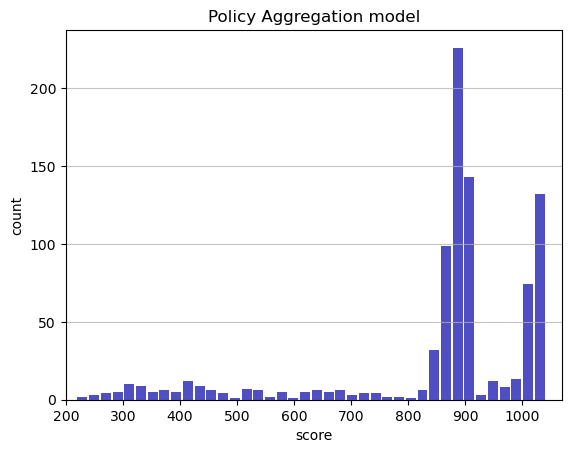

Track generation: 988..1239 -> 251-tiles track
Epoch: 889
Policy Aggregation	mean: 857.58	variance: 182.24


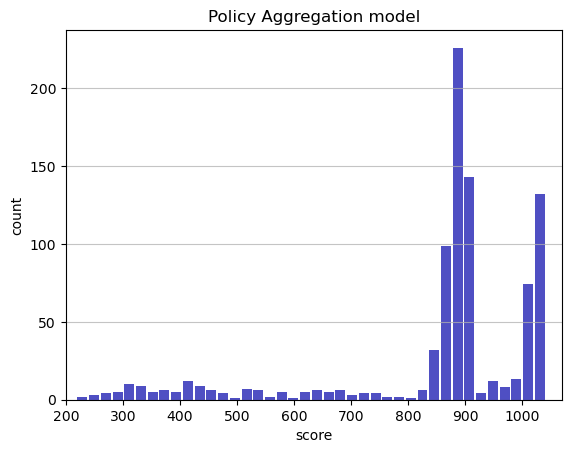

Track generation: 1199..1503 -> 304-tiles track
Epoch: 890
Policy Aggregation	mean: 857.60	variance: 182.14


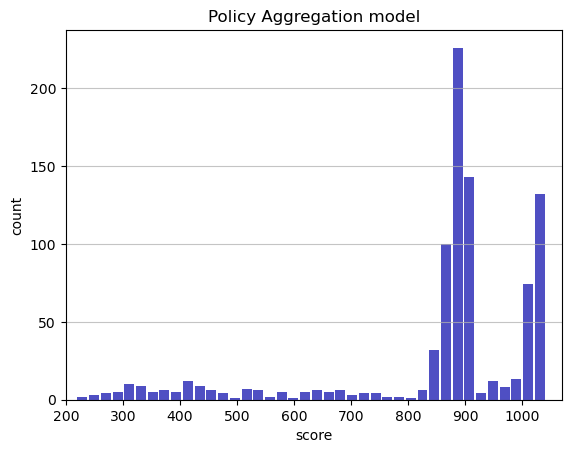

Track generation: 1080..1358 -> 278-tiles track
Epoch: 891
Policy Aggregation	mean: 857.65	variance: 182.04


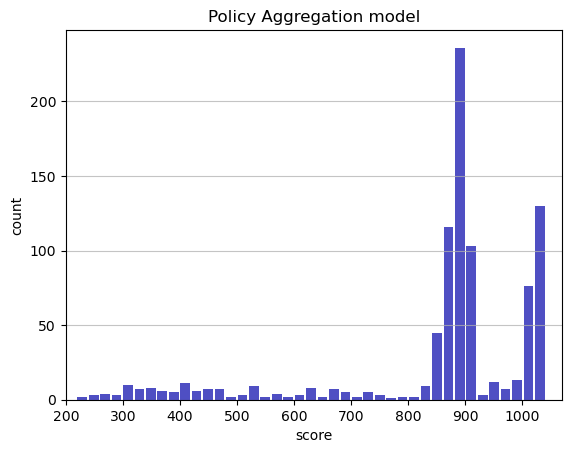

Track generation: 1064..1334 -> 270-tiles track
Epoch: 892
Policy Aggregation	mean: 857.66	variance: 181.94


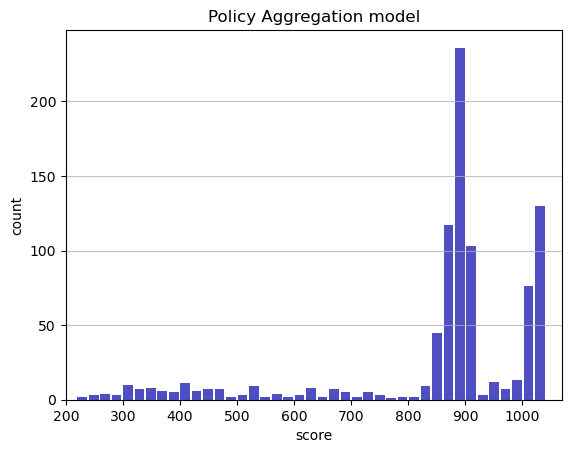

Track generation: 1192..1494 -> 302-tiles track
Epoch: 893
Policy Aggregation	mean: 857.84	variance: 181.91


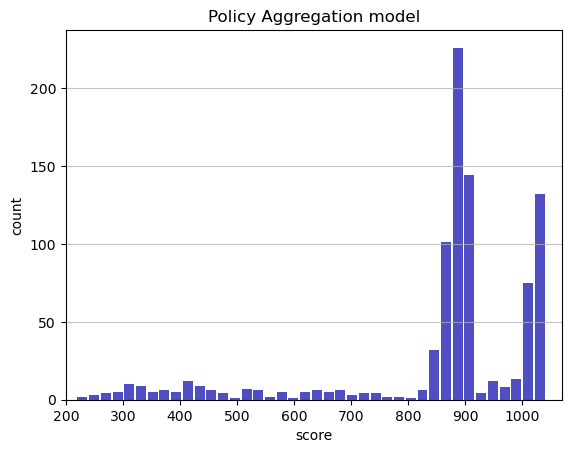

Track generation: 969..1220 -> 251-tiles track
Epoch: 894
Policy Aggregation	mean: 858.04	variance: 181.91


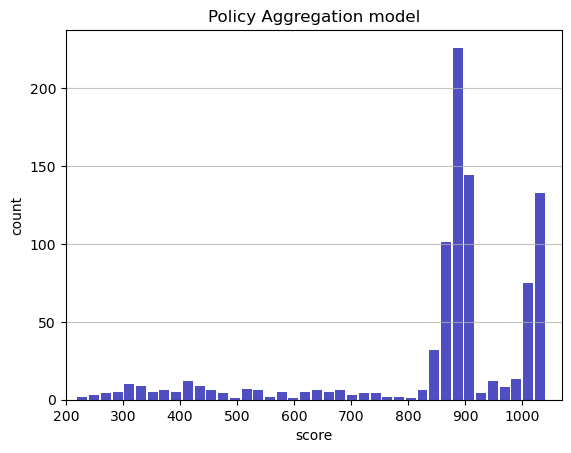

Track generation: 1179..1478 -> 299-tiles track
Epoch: 895
Policy Aggregation	mean: 858.09	variance: 181.82


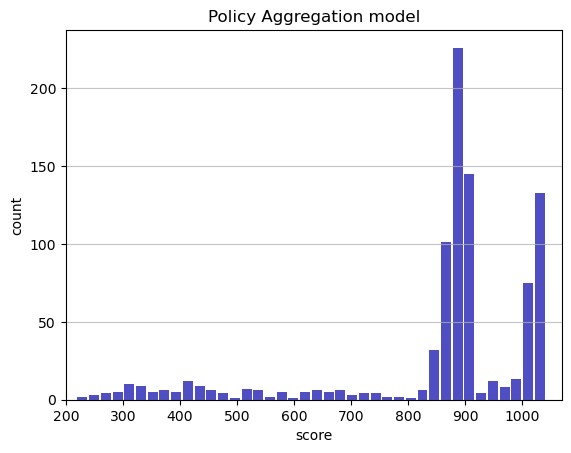

Track generation: 1079..1353 -> 274-tiles track
Epoch: 896
Policy Aggregation	mean: 858.10	variance: 181.71


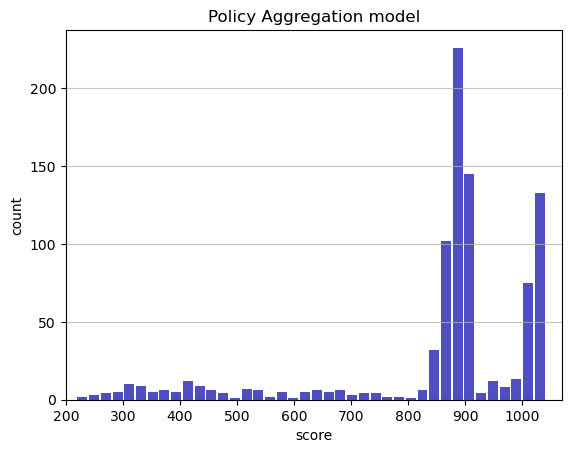

Track generation: 1054..1328 -> 274-tiles track
Epoch: 897
Policy Aggregation	mean: 857.75	variance: 181.93


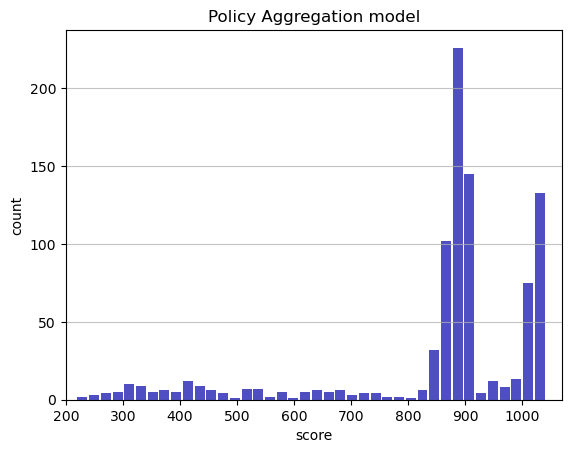

Track generation: 1039..1303 -> 264-tiles track
Epoch: 898
Policy Aggregation	mean: 857.94	variance: 181.92


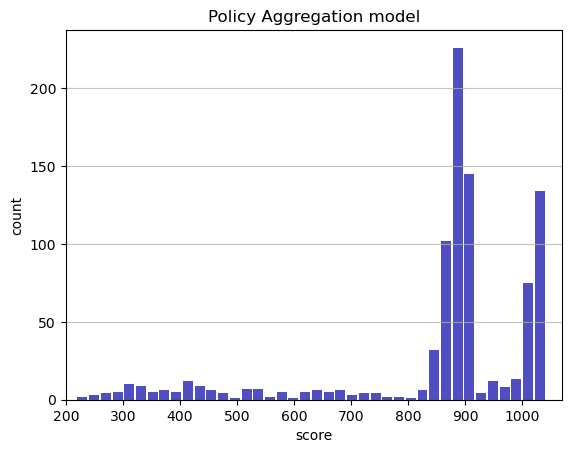

Track generation: 1089..1365 -> 276-tiles track
Epoch: 899
Policy Aggregation	mean: 858.00	variance: 181.83


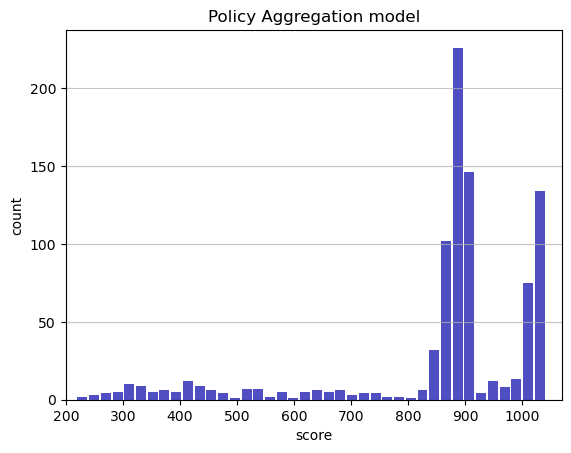

Track generation: 1188..1489 -> 301-tiles track
Epoch: 900
Policy Aggregation	mean: 857.45	variance: 182.47


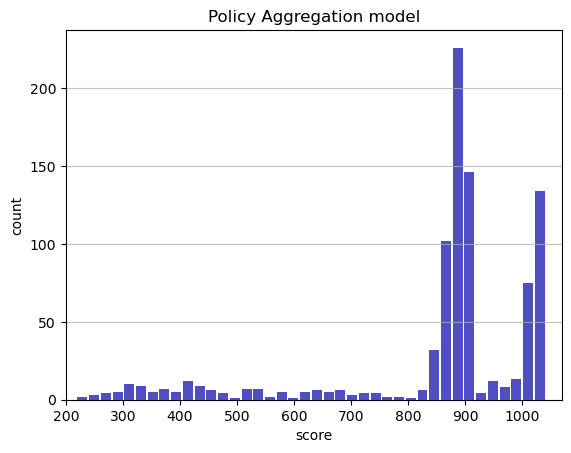

Track generation: 1219..1532 -> 313-tiles track
Epoch: 901
Policy Aggregation	mean: 857.57	variance: 182.40


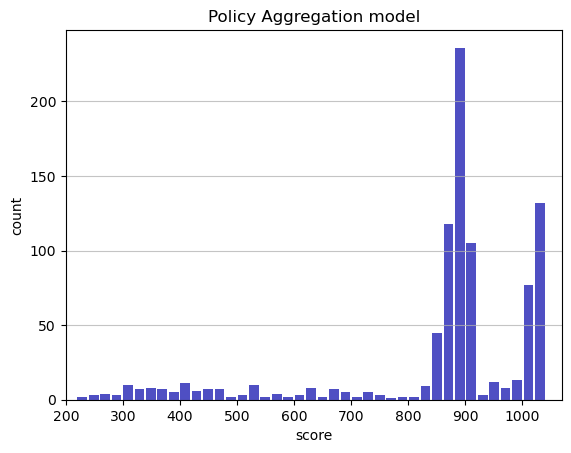

Track generation: 1200..1504 -> 304-tiles track
Epoch: 902
Policy Aggregation	mean: 857.62	variance: 182.31


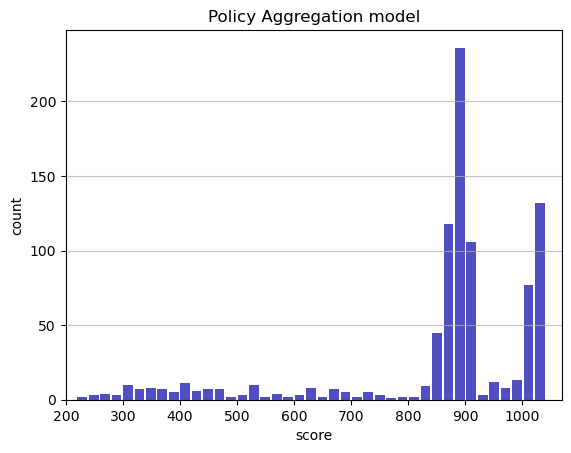

Track generation: 1121..1401 -> 280-tiles track
Epoch: 903
Policy Aggregation	mean: 857.81	variance: 182.29


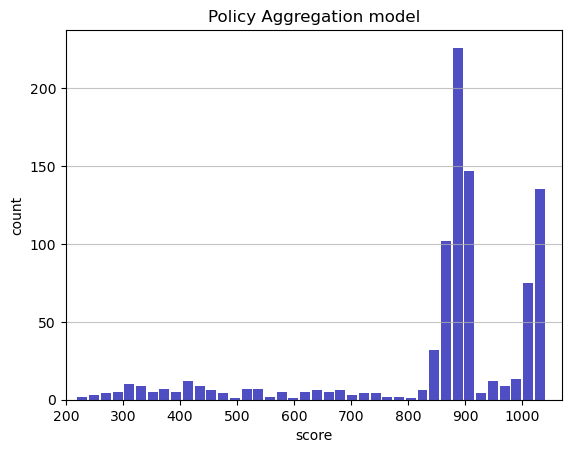

Track generation: 904..1140 -> 236-tiles track
Epoch: 904
Policy Aggregation	mean: 858.01	variance: 182.29


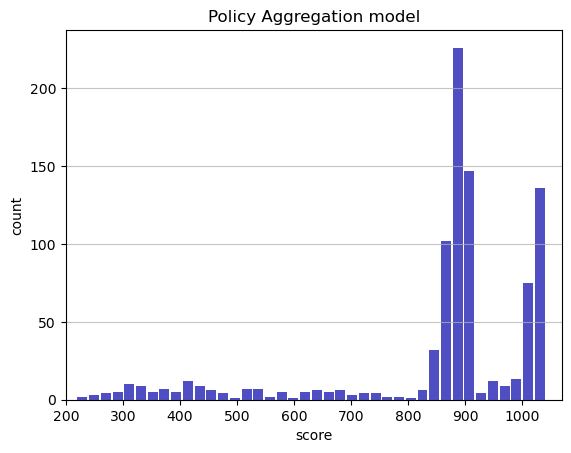

Track generation: 1133..1420 -> 287-tiles track
Epoch: 905
Policy Aggregation	mean: 857.47	variance: 182.91


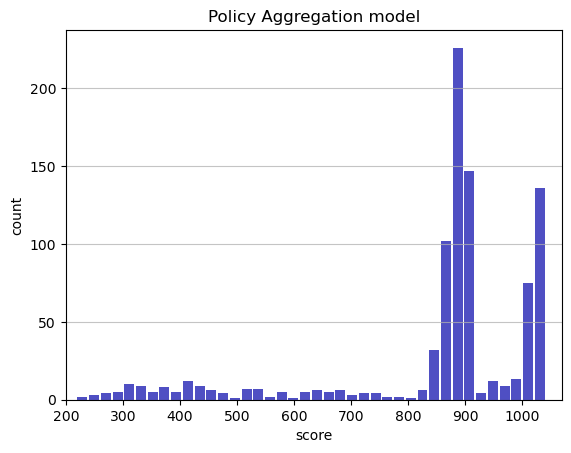

Track generation: 1048..1314 -> 266-tiles track
Epoch: 906
Policy Aggregation	mean: 857.52	variance: 182.82


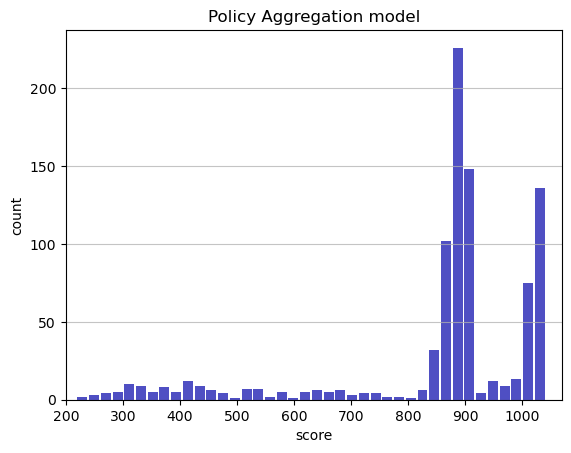

Track generation: 1096..1374 -> 278-tiles track
Epoch: 907
Policy Aggregation	mean: 857.71	variance: 182.80


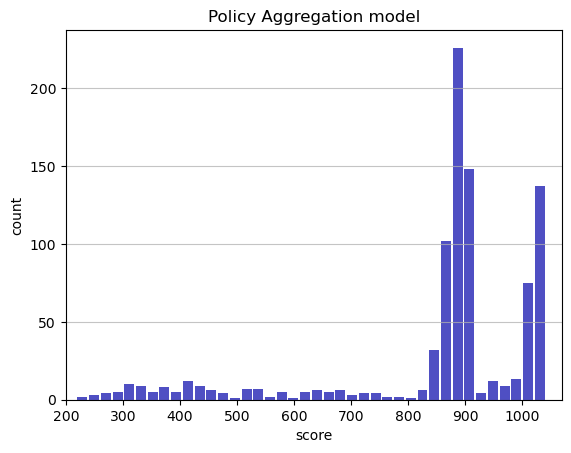

Track generation: 1408..1764 -> 356-tiles track
Epoch: 908
Policy Aggregation	mean: 857.84	variance: 182.75


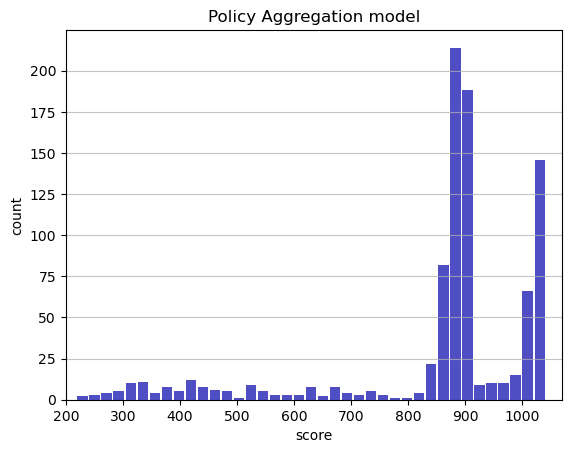

Track generation: 1027..1288 -> 261-tiles track
Epoch: 909
Policy Aggregation	mean: 857.88	variance: 182.65


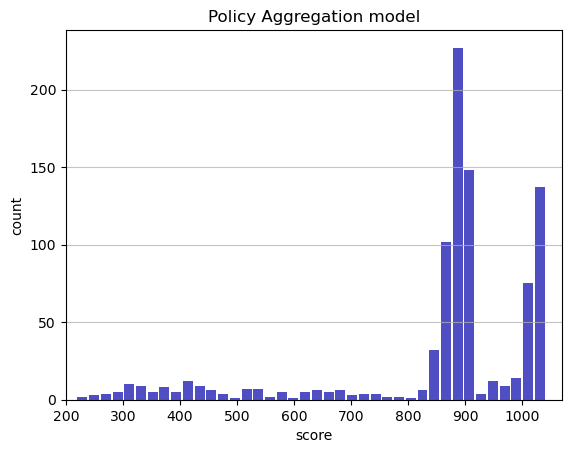

Track generation: 1170..1466 -> 296-tiles track
Epoch: 910
Policy Aggregation	mean: 857.87	variance: 182.56


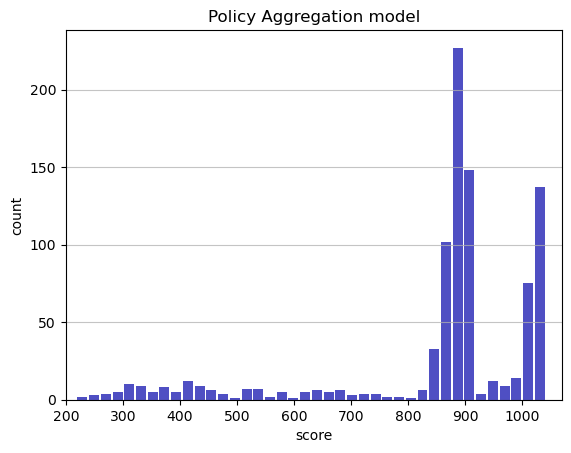

Track generation: 1167..1463 -> 296-tiles track
Epoch: 911
Policy Aggregation	mean: 857.89	variance: 182.46


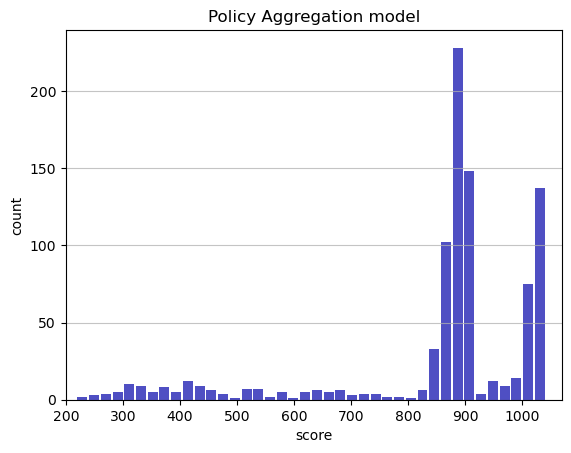

Track generation: 1135..1423 -> 288-tiles track
Epoch: 912
Policy Aggregation	mean: 857.91	variance: 182.36


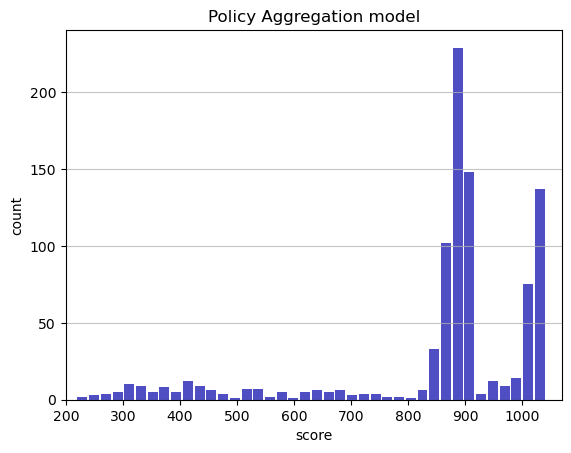

Track generation: 1139..1428 -> 289-tiles track
Epoch: 913
Policy Aggregation	mean: 857.74	variance: 182.33


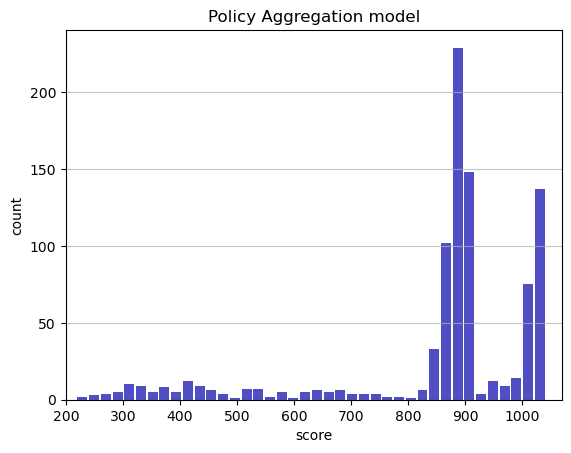

Track generation: 1192..1494 -> 302-tiles track
Epoch: 914
Policy Aggregation	mean: 857.75	variance: 182.23


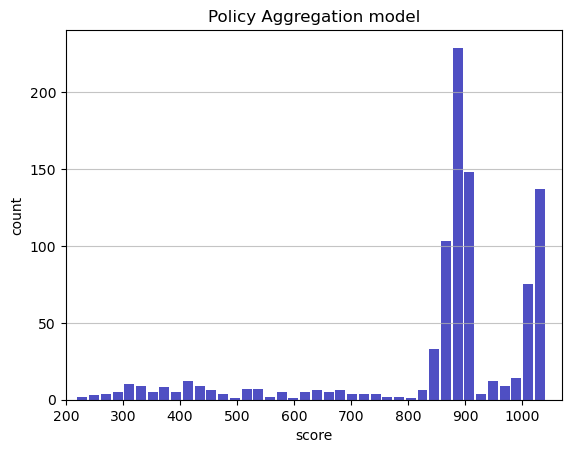

Track generation: 1283..1608 -> 325-tiles track
Epoch: 915
Policy Aggregation	mean: 857.77	variance: 182.13


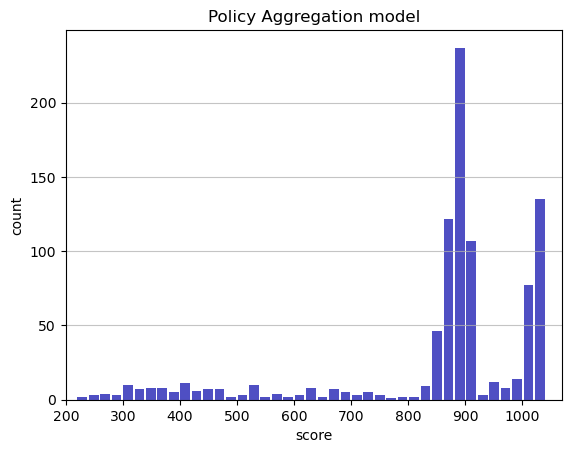

Track generation: 1212..1519 -> 307-tiles track
Epoch: 916
Policy Aggregation	mean: 857.81	variance: 182.04


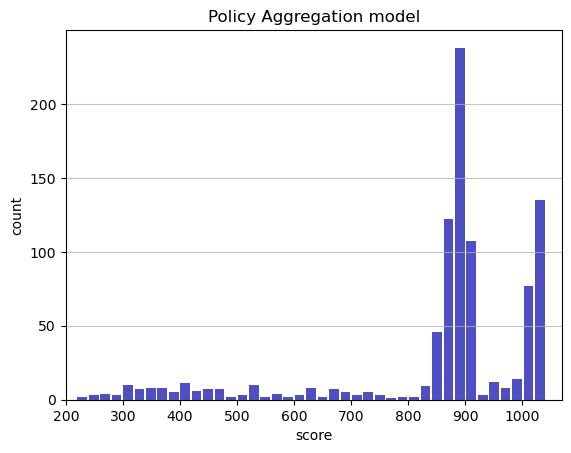

Track generation: 1166..1468 -> 302-tiles track
Epoch: 917
Policy Aggregation	mean: 857.98	variance: 182.01


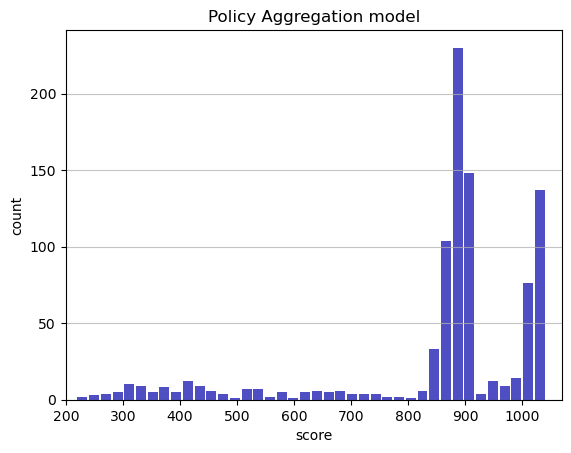

Track generation: 1187..1488 -> 301-tiles track
Epoch: 918
Policy Aggregation	mean: 858.01	variance: 181.92


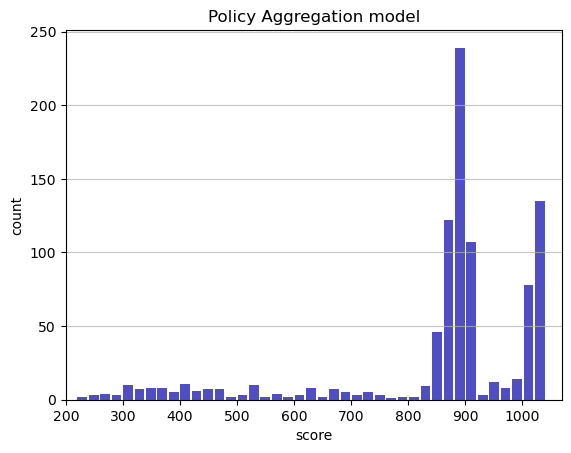

Track generation: 1072..1344 -> 272-tiles track
Epoch: 919
Policy Aggregation	mean: 858.04	variance: 181.82


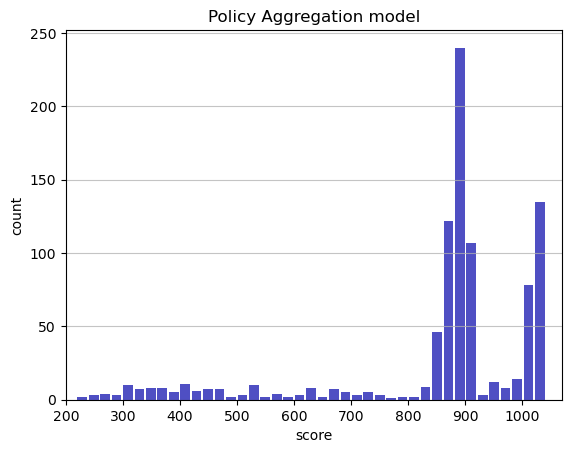

Track generation: 1095..1373 -> 278-tiles track
Epoch: 920
Policy Aggregation	mean: 858.10	variance: 181.73


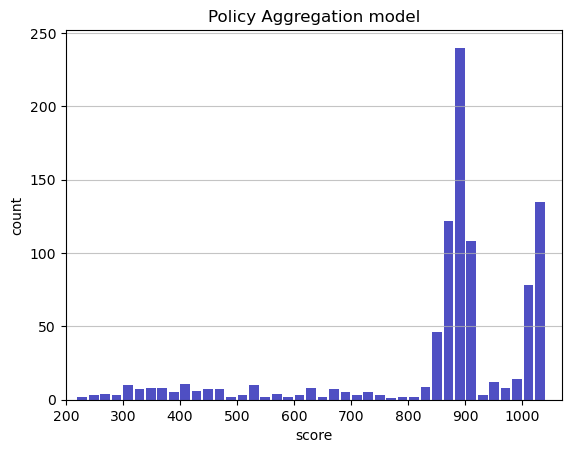

Track generation: 1174..1477 -> 303-tiles track
Epoch: 921
Policy Aggregation	mean: 857.58	variance: 182.29


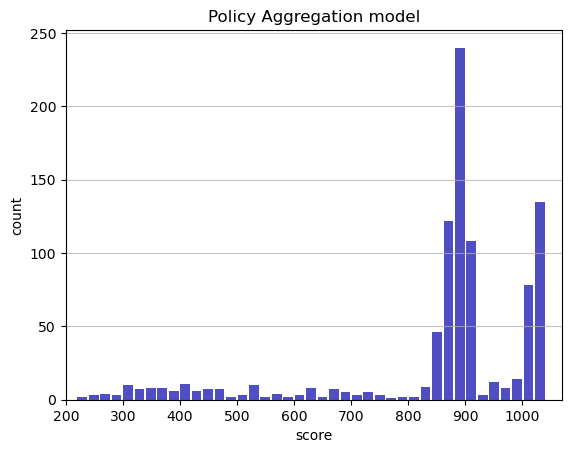

Track generation: 1261..1580 -> 319-tiles track
Epoch: 922
Policy Aggregation	mean: 857.62	variance: 182.19


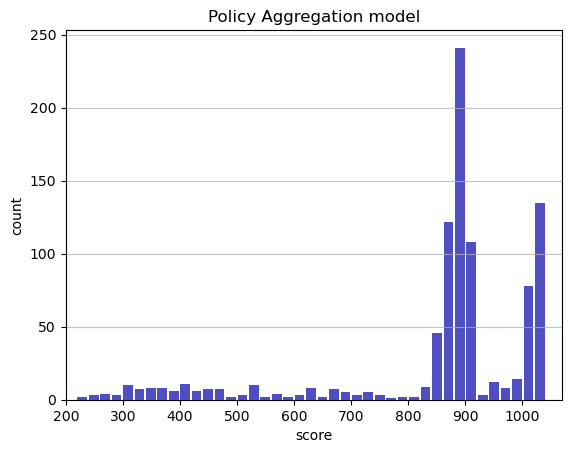

Track generation: 1186..1496 -> 310-tiles track
Epoch: 923
Policy Aggregation	mean: 857.66	variance: 182.10


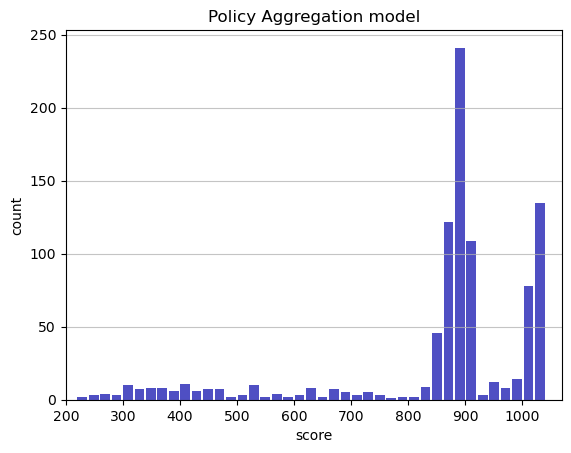

Track generation: 1167..1463 -> 296-tiles track
Epoch: 924
Policy Aggregation	mean: 857.69	variance: 182.00


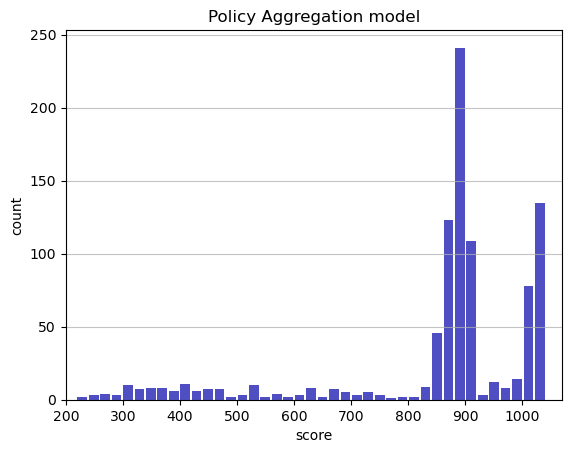

Track generation: 1029..1298 -> 269-tiles track
Epoch: 925
Policy Aggregation	mean: 857.74	variance: 181.91


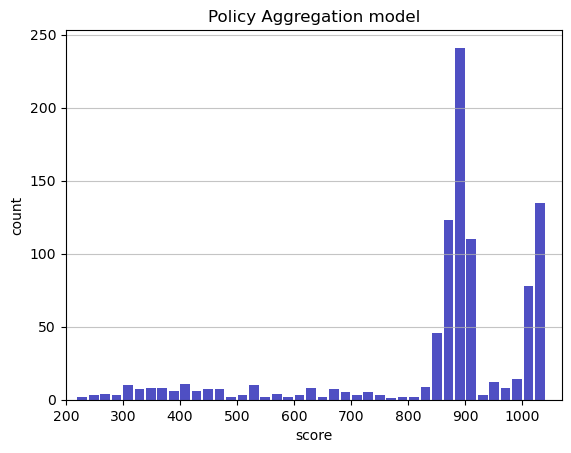

Track generation: 1160..1454 -> 294-tiles track
Epoch: 926
Policy Aggregation	mean: 857.78	variance: 181.82


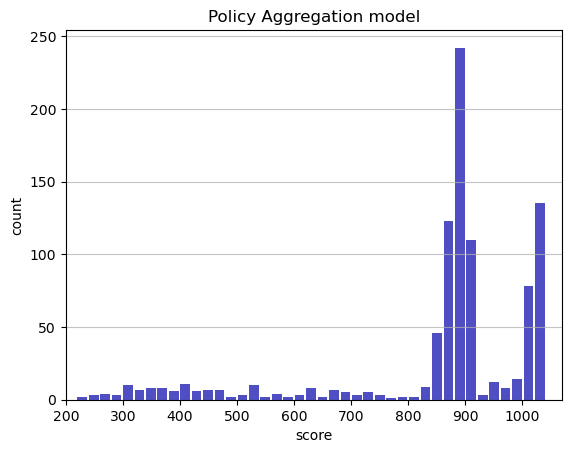

Track generation: 1195..1498 -> 303-tiles track
Epoch: 927
Policy Aggregation	mean: 857.81	variance: 181.72


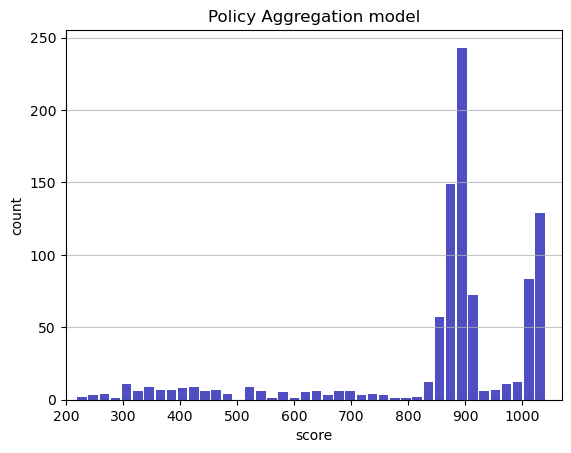

Track generation: 1244..1559 -> 315-tiles track
Epoch: 928
Policy Aggregation	mean: 857.84	variance: 181.63


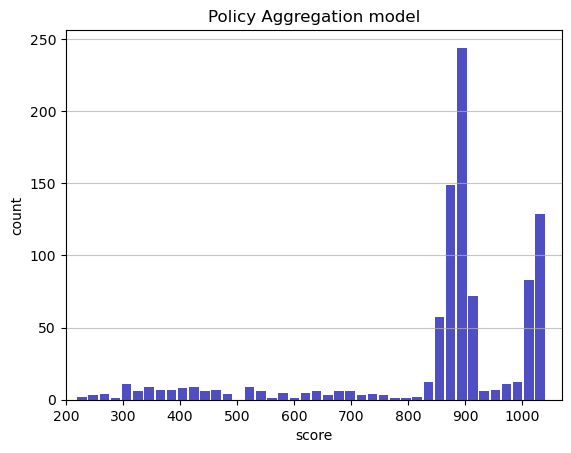

Track generation: 1154..1447 -> 293-tiles track
Epoch: 929
Policy Aggregation	mean: 857.86	variance: 181.53


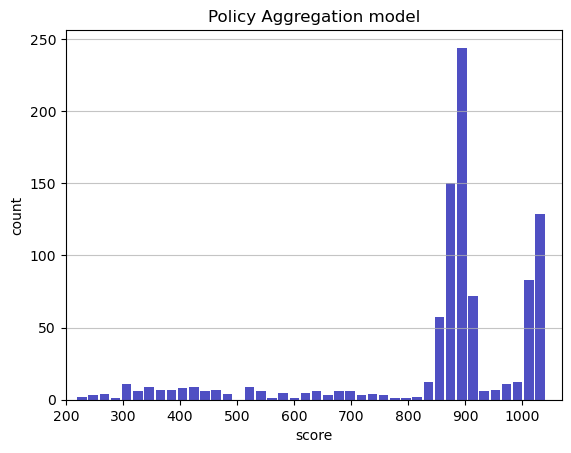

Track generation: 1200..1504 -> 304-tiles track
Epoch: 930
Policy Aggregation	mean: 857.91	variance: 181.44


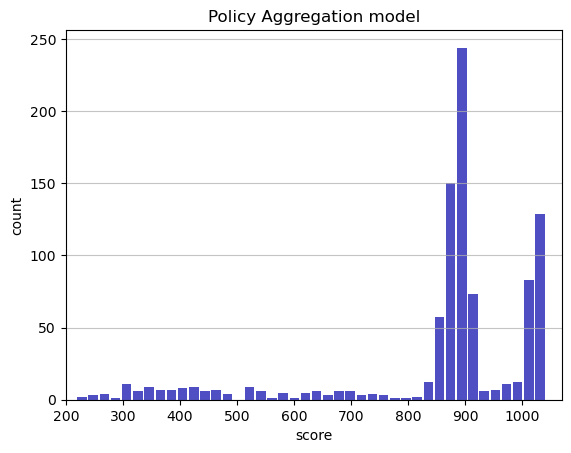

Track generation: 1182..1482 -> 300-tiles track
Epoch: 931
Policy Aggregation	mean: 857.95	variance: 181.35


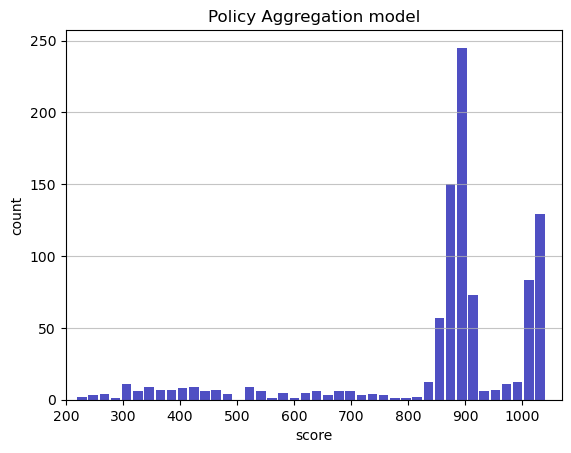

Track generation: 1272..1594 -> 322-tiles track
Epoch: 932
Policy Aggregation	mean: 857.99	variance: 181.25


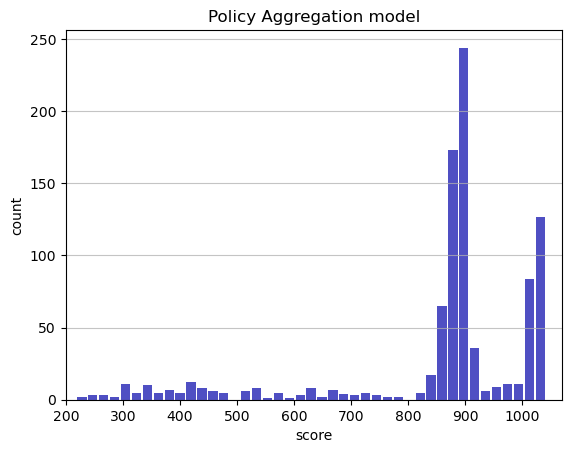

Track generation: 1208..1514 -> 306-tiles track
Epoch: 933
Policy Aggregation	mean: 858.00	variance: 181.15


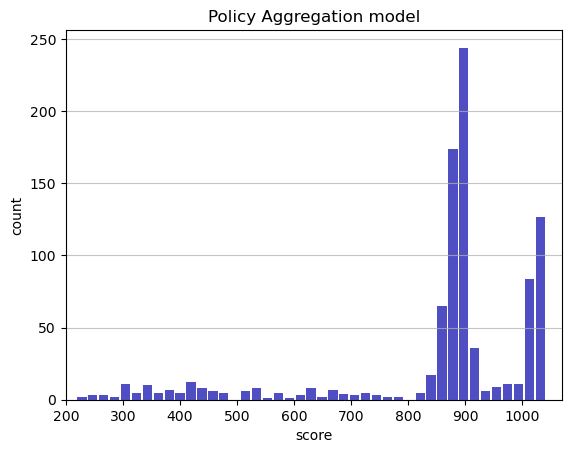

Track generation: 1119..1404 -> 285-tiles track
Epoch: 934
Policy Aggregation	mean: 858.18	variance: 181.14


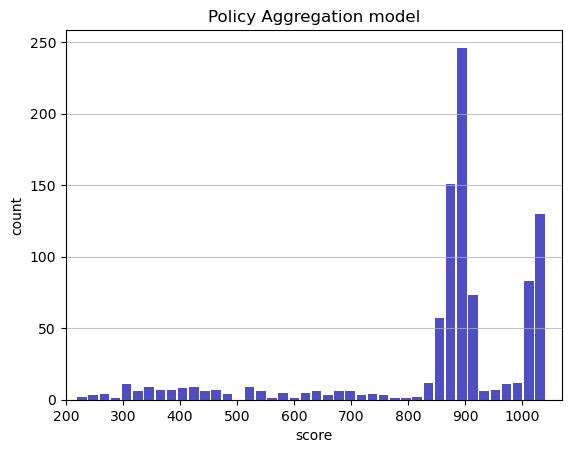

Track generation: 1245..1560 -> 315-tiles track
Epoch: 935
Policy Aggregation	mean: 858.35	variance: 181.12


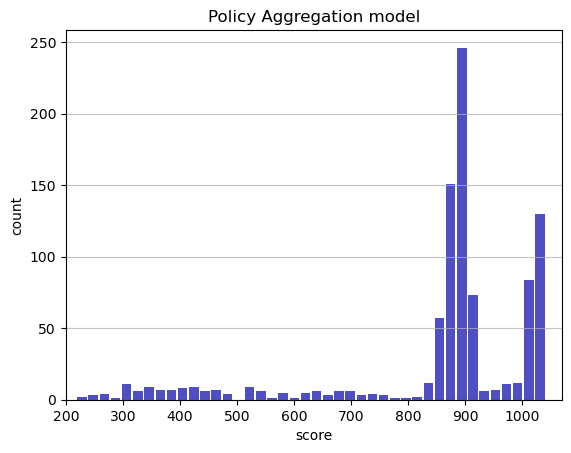

Track generation: 1237..1550 -> 313-tiles track
Epoch: 936
Policy Aggregation	mean: 858.38	variance: 181.02


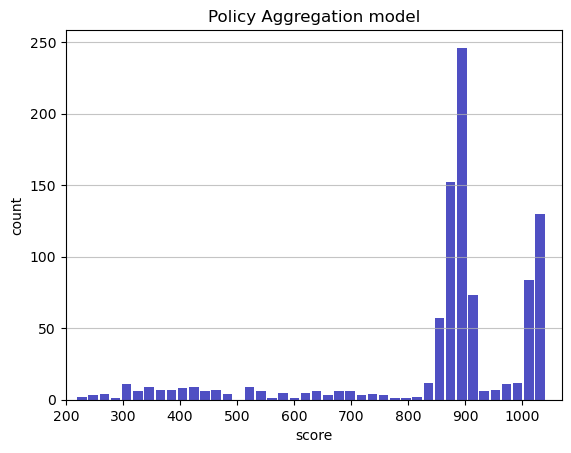

Track generation: 1247..1563 -> 316-tiles track
Epoch: 937
Policy Aggregation	mean: 858.41	variance: 180.93


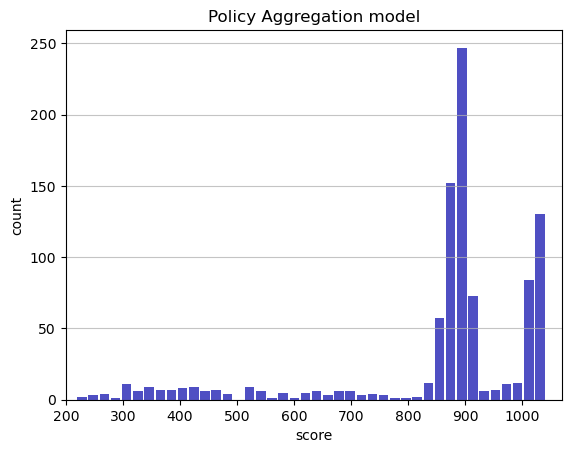

Track generation: 1106..1395 -> 289-tiles track
Epoch: 938
Policy Aggregation	mean: 858.42	variance: 180.83


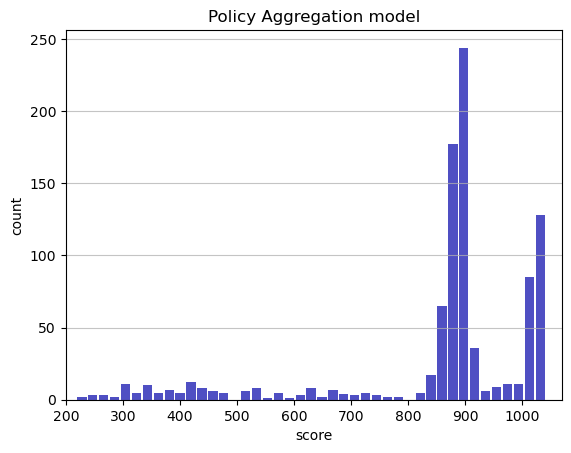

Track generation: 1036..1306 -> 270-tiles track
Epoch: 939
Policy Aggregation	mean: 858.42	variance: 180.74


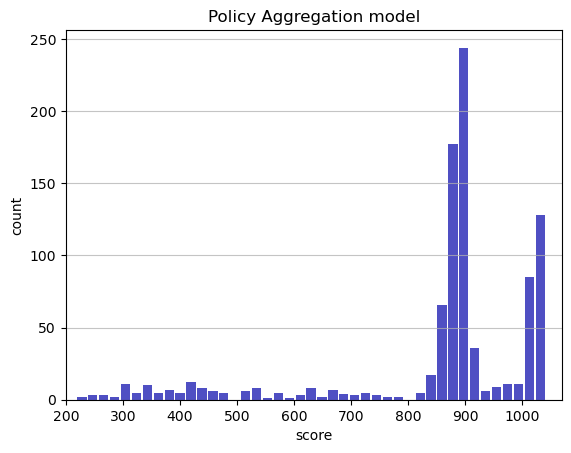

Track generation: 1224..1534 -> 310-tiles track
Epoch: 940
Policy Aggregation	mean: 858.59	variance: 180.71


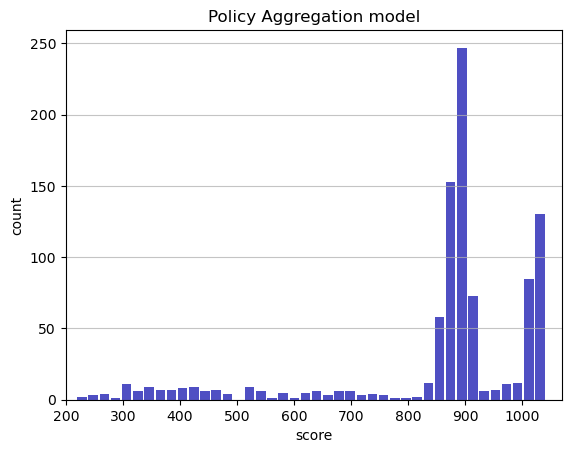

Track generation: 1149..1440 -> 291-tiles track
Epoch: 941
Policy Aggregation	mean: 858.76	variance: 180.70


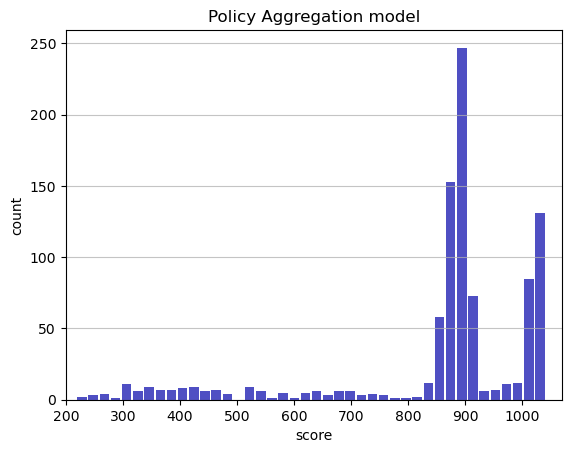

Track generation: 1070..1341 -> 271-tiles track
Epoch: 942
Policy Aggregation	mean: 858.26	variance: 181.26


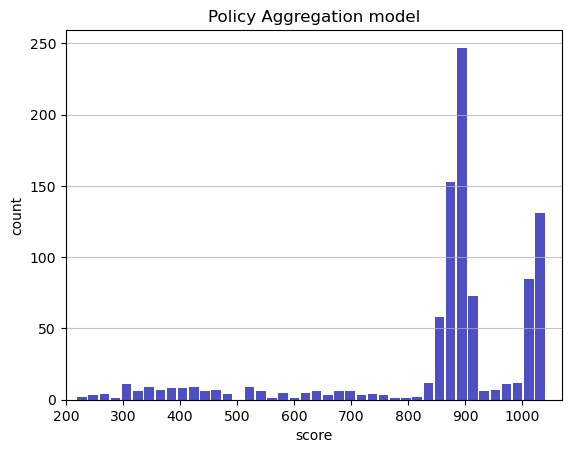

Track generation: 1188..1489 -> 301-tiles track
Epoch: 943
Policy Aggregation	mean: 858.08	variance: 181.24


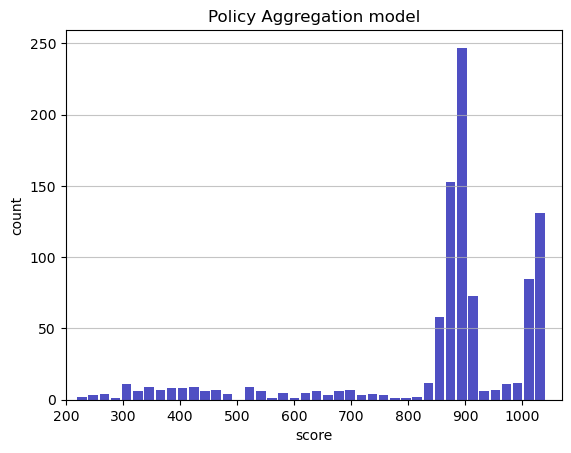

Track generation: 1177..1476 -> 299-tiles track
Epoch: 944
Policy Aggregation	mean: 858.25	variance: 181.23


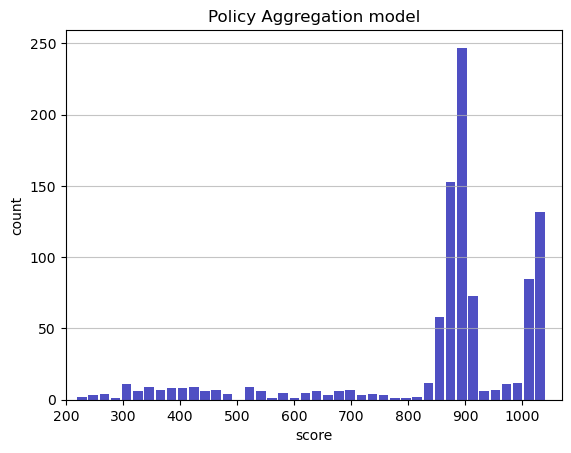

Track generation: 1069..1349 -> 280-tiles track
Epoch: 945
Policy Aggregation	mean: 858.29	variance: 181.13


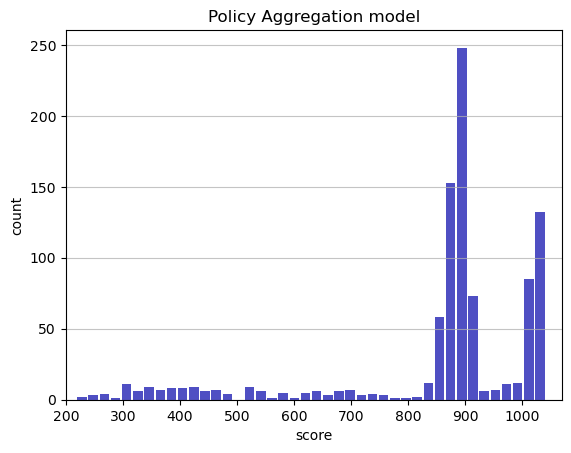

Track generation: 1170..1467 -> 297-tiles track
Epoch: 946
Policy Aggregation	mean: 858.30	variance: 181.04


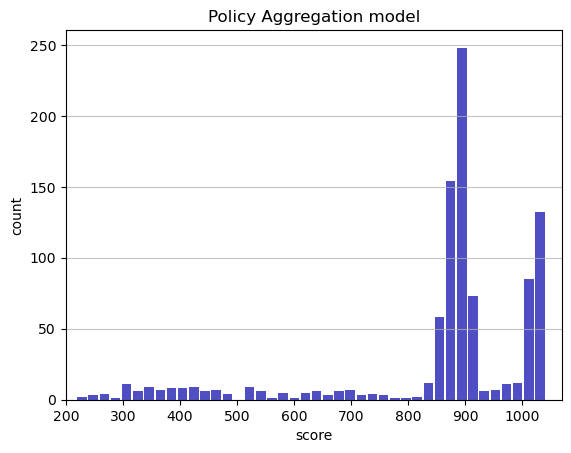

Track generation: 1032..1299 -> 267-tiles track
Epoch: 947
Policy Aggregation	mean: 857.83	variance: 181.52


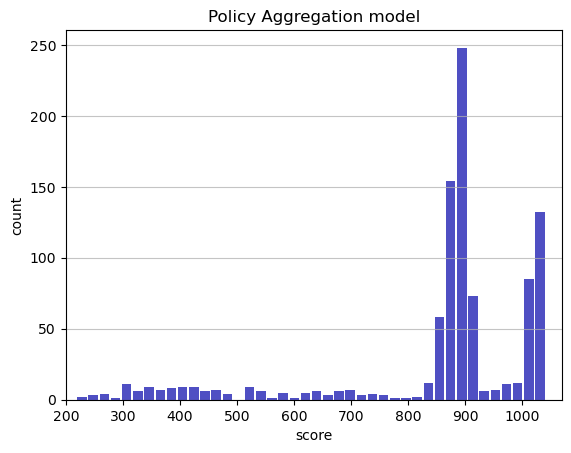

Track generation: 1036..1299 -> 263-tiles track
Epoch: 948
Policy Aggregation	mean: 857.86	variance: 181.43


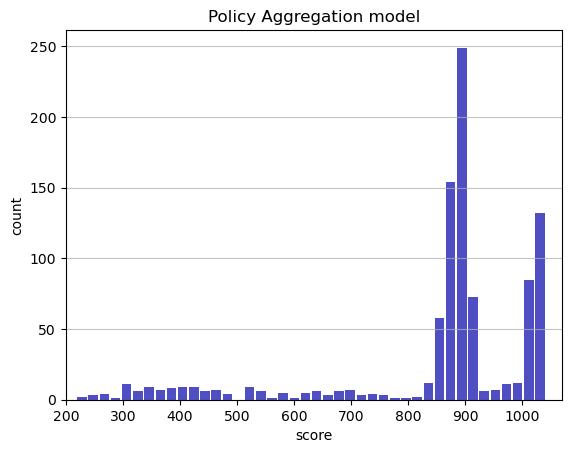

Track generation: 973..1220 -> 247-tiles track
Epoch: 949
Policy Aggregation	mean: 857.93	variance: 181.34


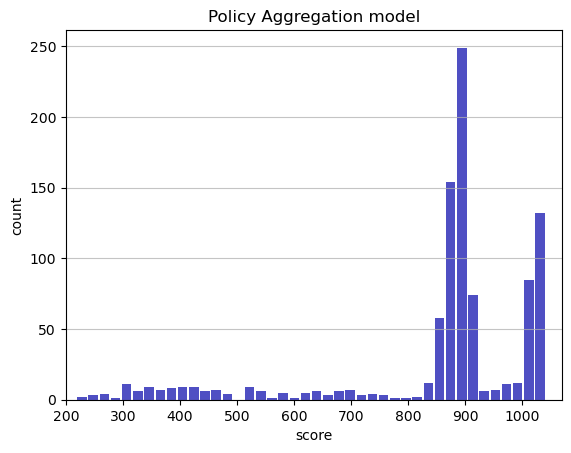

Track generation: 1320..1654 -> 334-tiles track
Epoch: 950
Policy Aggregation	mean: 858.09	variance: 181.32


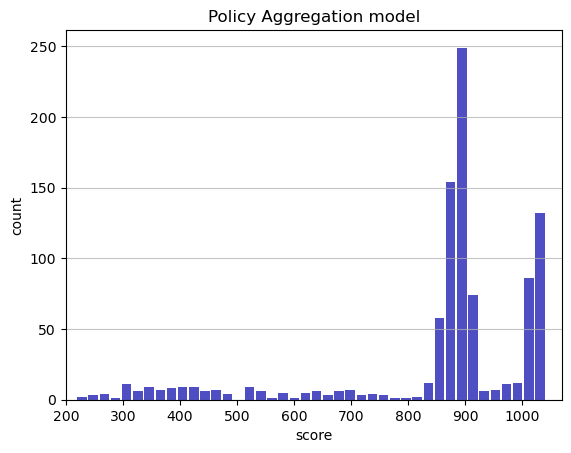

Track generation: 1311..1643 -> 332-tiles track
Epoch: 951
Policy Aggregation	mean: 858.11	variance: 181.22


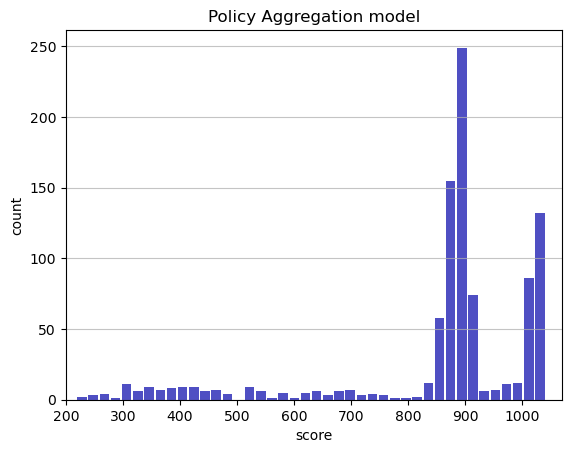

Track generation: 1100..1379 -> 279-tiles track
Epoch: 952
Policy Aggregation	mean: 858.15	variance: 181.13


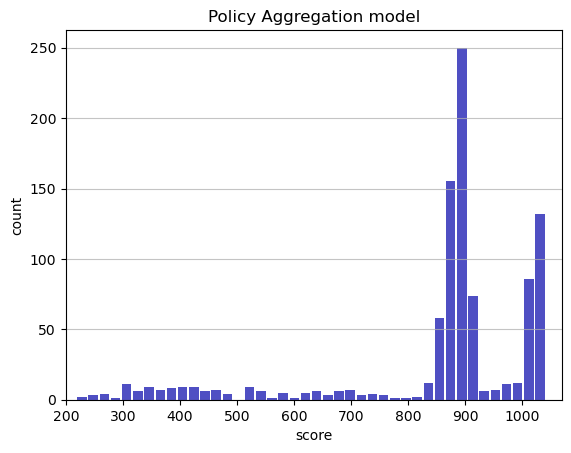

Track generation: 1159..1453 -> 294-tiles track
Epoch: 953
Policy Aggregation	mean: 858.19	variance: 181.04


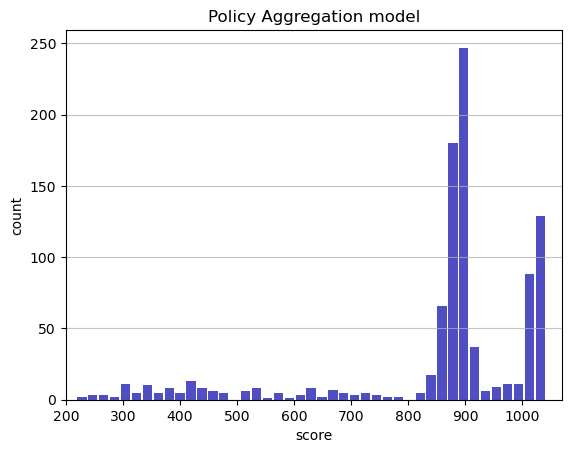

Track generation: 1054..1330 -> 276-tiles track
Epoch: 954
Policy Aggregation	mean: 857.77	variance: 181.41


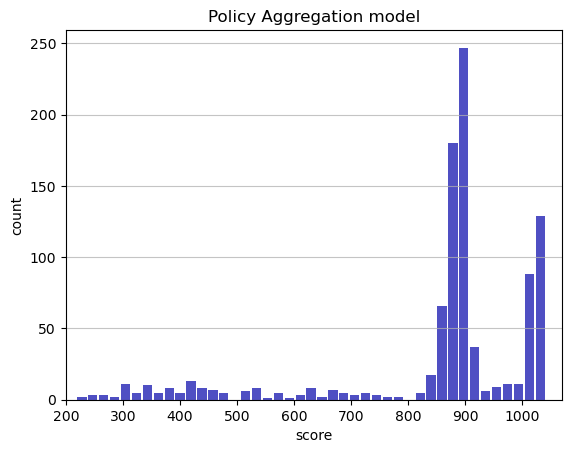

Track generation: 1141..1430 -> 289-tiles track
Epoch: 955
Policy Aggregation	mean: 857.83	variance: 181.32


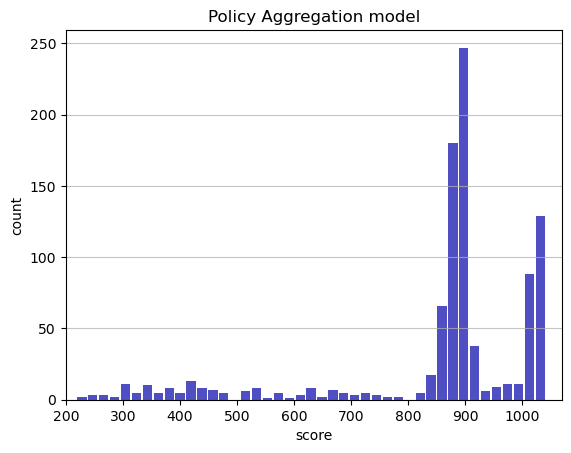

Track generation: 1092..1373 -> 281-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1272..1594 -> 322-tiles track
Epoch: 956
Policy Aggregation	mean: 857.87	variance: 181.24


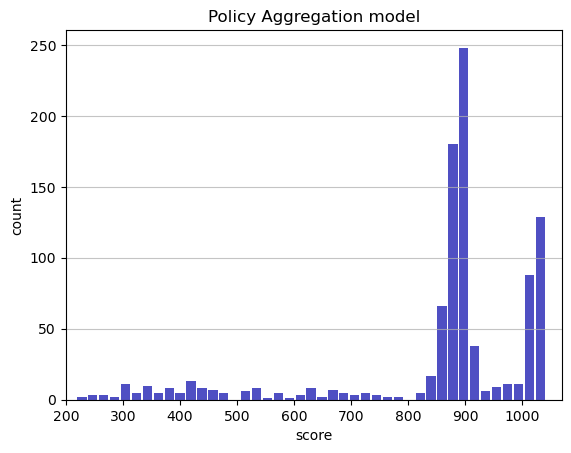

Track generation: 1343..1692 -> 349-tiles track
Epoch: 957
Policy Aggregation	mean: 857.98	variance: 181.17


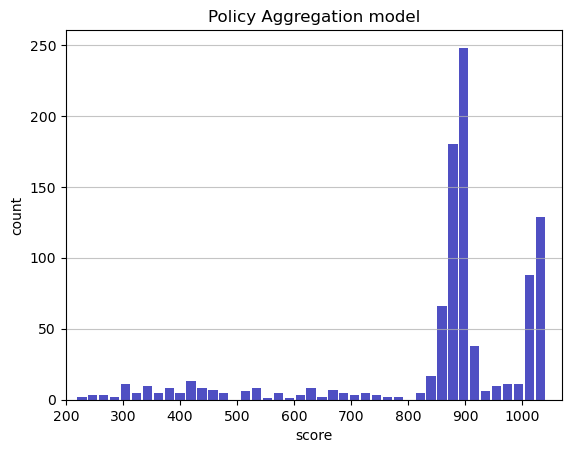

Track generation: 1148..1439 -> 291-tiles track
Epoch: 958
Policy Aggregation	mean: 858.02	variance: 181.08


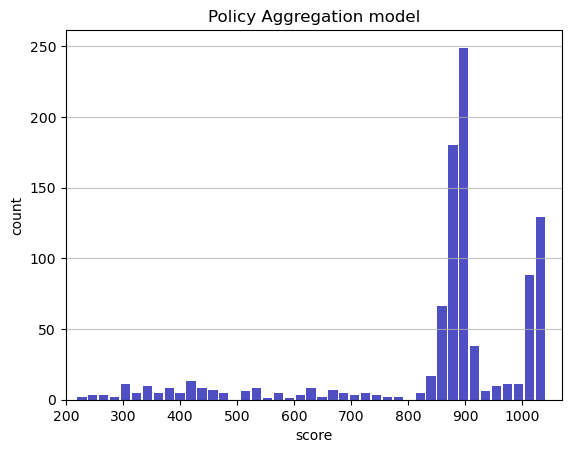

Track generation: 1134..1422 -> 288-tiles track
Epoch: 959
Policy Aggregation	mean: 858.05	variance: 180.99


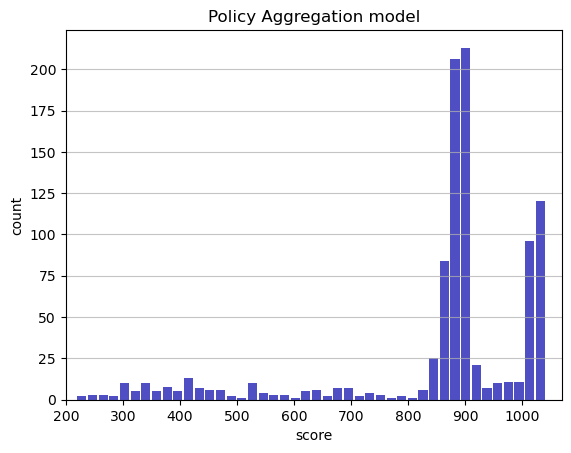

Track generation: 1175..1472 -> 297-tiles track
Epoch: 960
Policy Aggregation	mean: 857.56	variance: 181.53


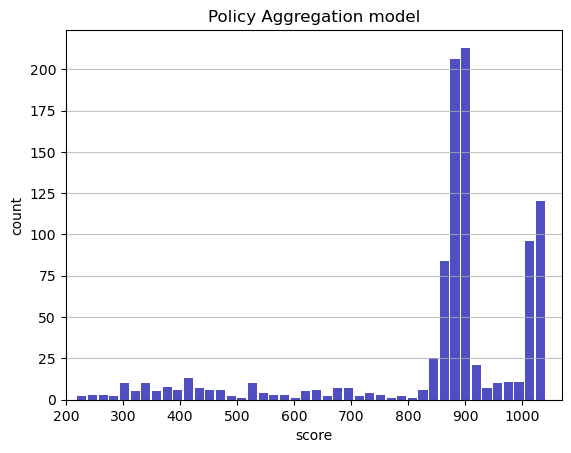

Track generation: 1179..1478 -> 299-tiles track
Epoch: 961
Policy Aggregation	mean: 857.58	variance: 181.43


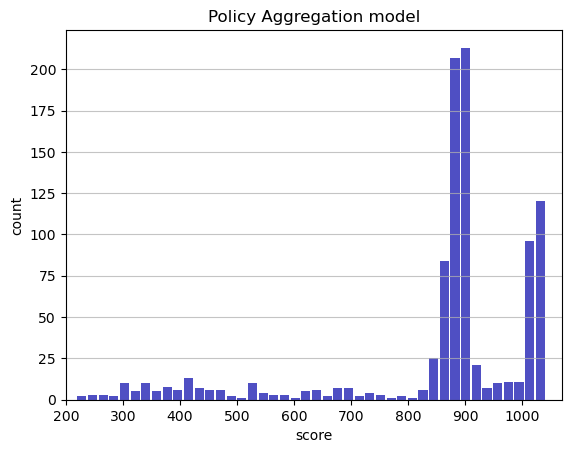

Track generation: 1131..1418 -> 287-tiles track
Epoch: 962
Policy Aggregation	mean: 857.62	variance: 181.34


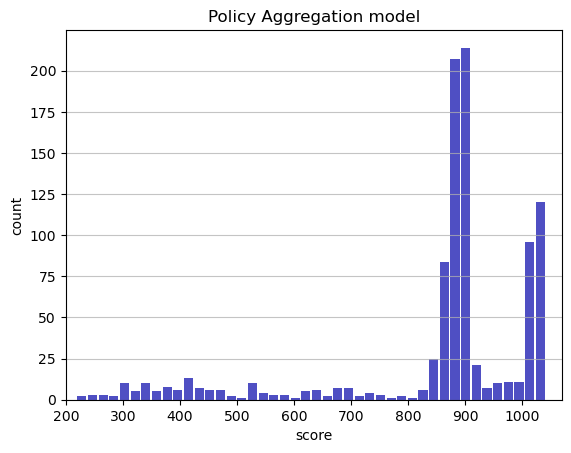

Track generation: 1235..1548 -> 313-tiles track
Epoch: 963
Policy Aggregation	mean: 857.63	variance: 181.25


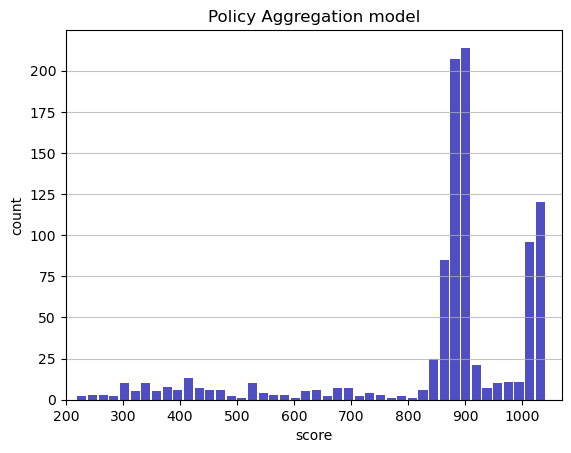

Track generation: 1072..1344 -> 272-tiles track
Epoch: 964
Policy Aggregation	mean: 857.66	variance: 181.16


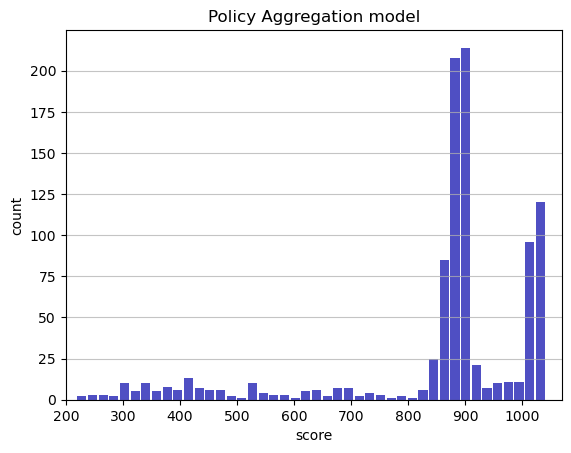

Track generation: 1277..1600 -> 323-tiles track
Epoch: 965
Policy Aggregation	mean: 857.83	variance: 181.14


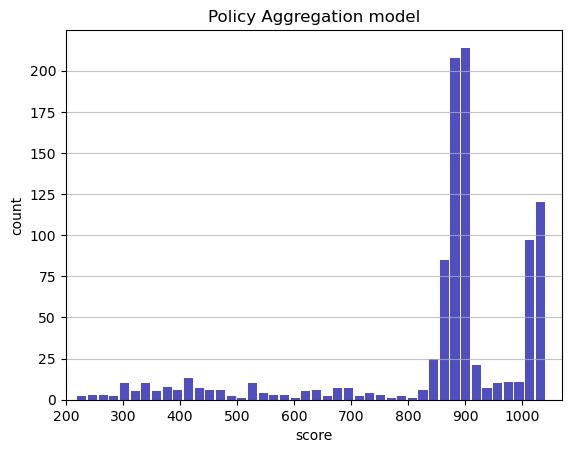

Track generation: 1117..1409 -> 292-tiles track
Epoch: 966
Policy Aggregation	mean: 858.00	variance: 181.13


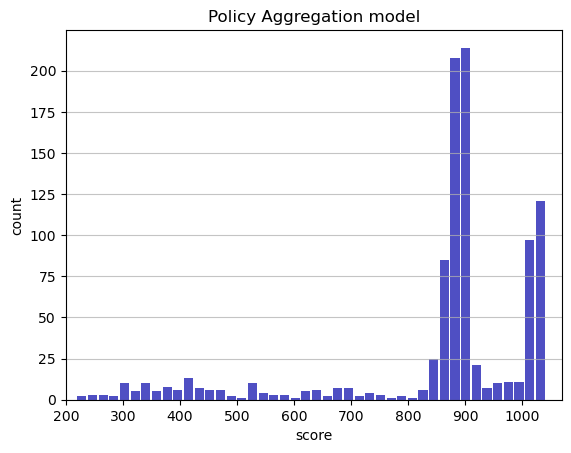

Track generation: 1113..1399 -> 286-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1332..1669 -> 337-tiles track
Epoch: 967
Policy Aggregation	mean: 858.10	variance: 181.06


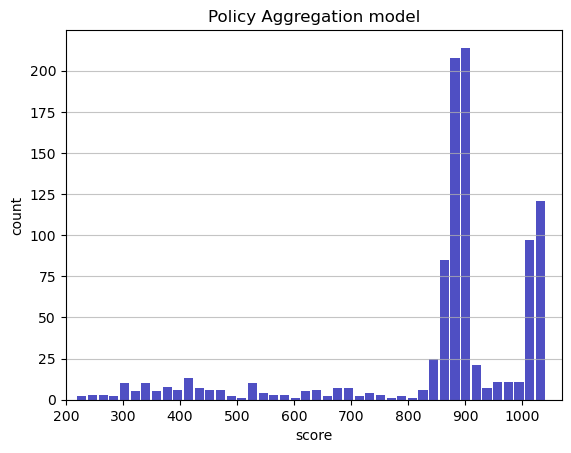

Track generation: 1201..1505 -> 304-tiles track
Epoch: 968
Policy Aggregation	mean: 857.83	variance: 181.16


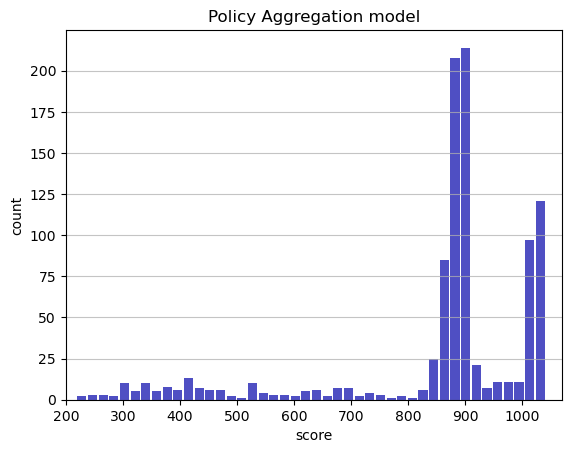

Track generation: 1151..1443 -> 292-tiles track
Epoch: 969
Policy Aggregation	mean: 857.87	variance: 181.07


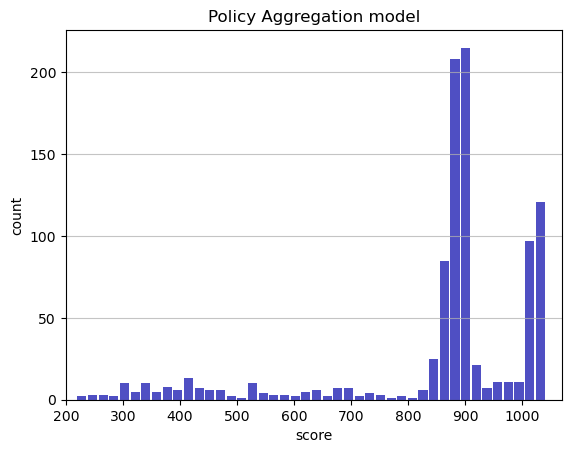

Track generation: 1152..1452 -> 300-tiles track
Epoch: 970
Policy Aggregation	mean: 857.90	variance: 180.98


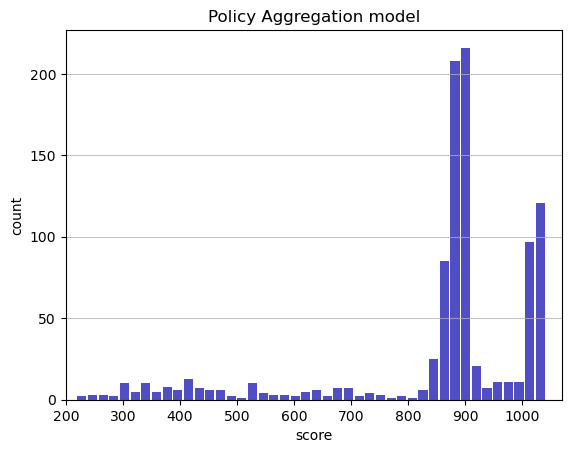

Track generation: 1095..1373 -> 278-tiles track
Epoch: 971
Policy Aggregation	mean: 857.32	variance: 181.81


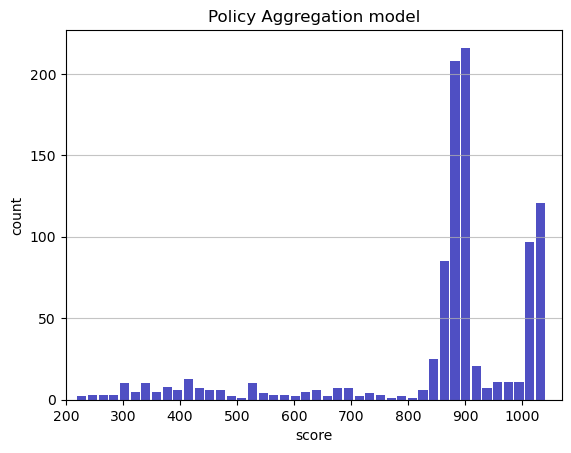

Track generation: 1119..1403 -> 284-tiles track
Epoch: 972
Policy Aggregation	mean: 857.43	variance: 181.75


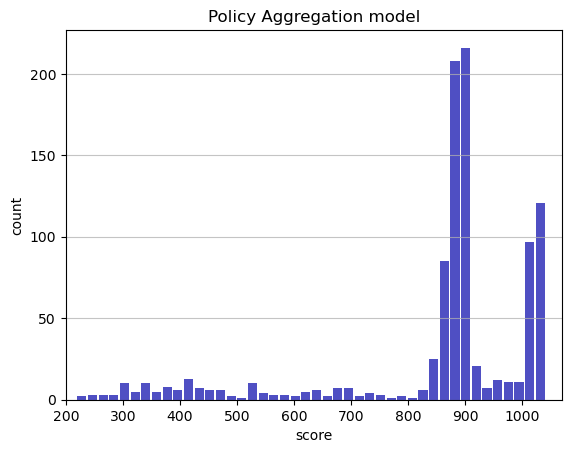

Track generation: 1148..1439 -> 291-tiles track
Epoch: 973
Policy Aggregation	mean: 857.46	variance: 181.66


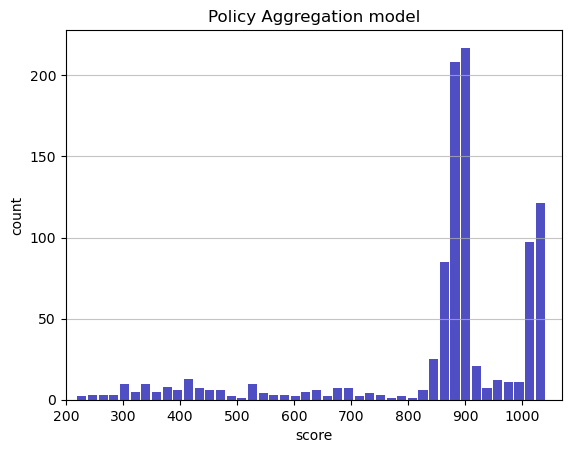

Track generation: 1222..1539 -> 317-tiles track
Epoch: 974
Policy Aggregation	mean: 857.49	variance: 181.57


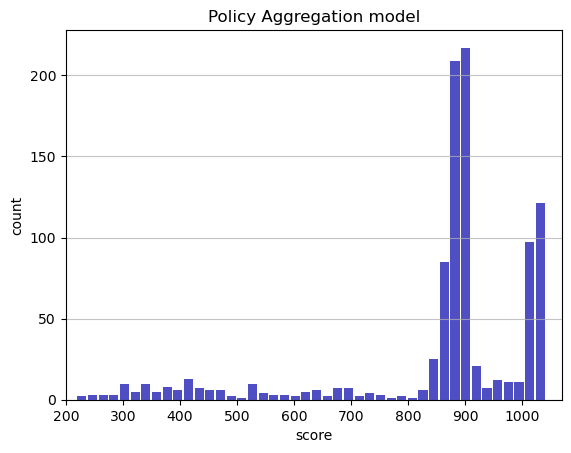

Track generation: 1125..1411 -> 286-tiles track
Epoch: 975
Policy Aggregation	mean: 856.99	variance: 182.16


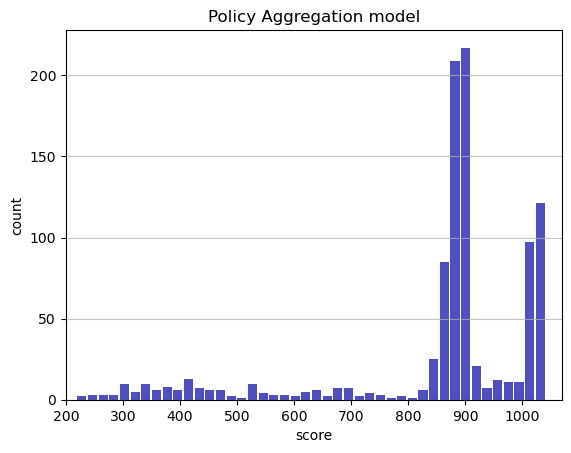

Track generation: 1173..1478 -> 305-tiles track
Epoch: 976
Policy Aggregation	mean: 857.01	variance: 182.06


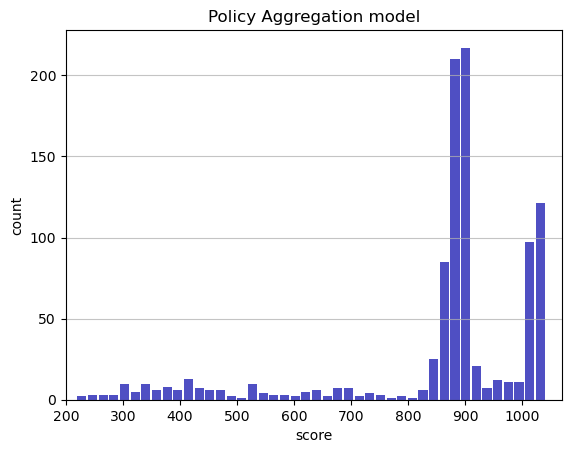

Track generation: 1011..1268 -> 257-tiles track
Epoch: 977
Policy Aggregation	mean: 857.06	variance: 181.98


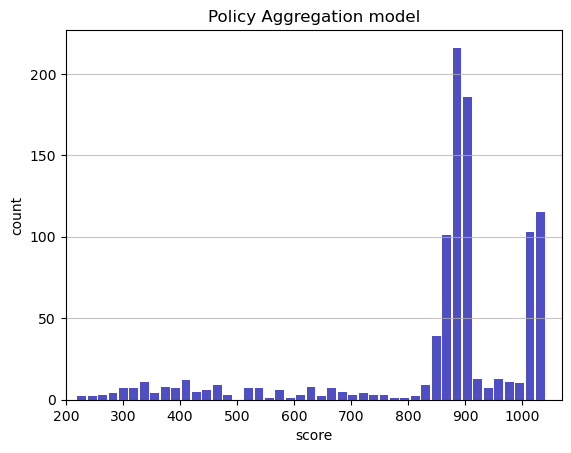

Track generation: 1144..1434 -> 290-tiles track
Epoch: 978
Policy Aggregation	mean: 857.09	variance: 181.89


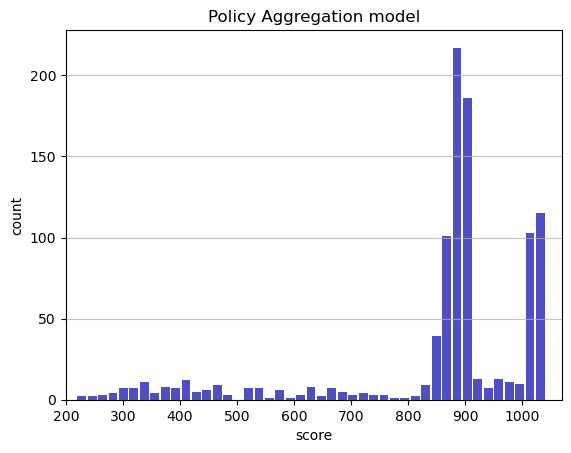

Track generation: 1138..1427 -> 289-tiles track
Epoch: 979
Policy Aggregation	mean: 857.11	variance: 181.79


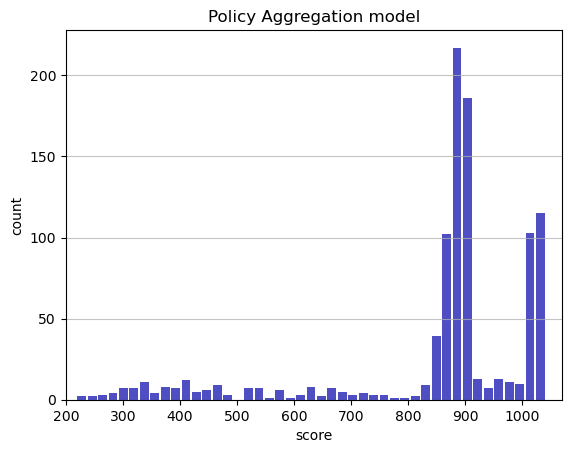

Track generation: 1019..1278 -> 259-tiles track
Epoch: 980
Policy Aggregation	mean: 857.17	variance: 181.71


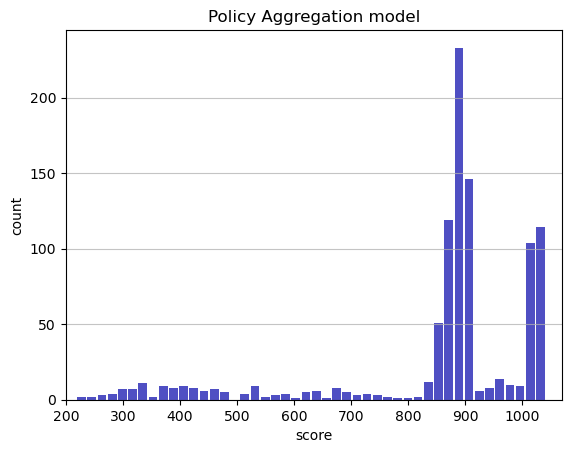

Track generation: 1109..1391 -> 282-tiles track
Epoch: 981
Policy Aggregation	mean: 857.34	variance: 181.70


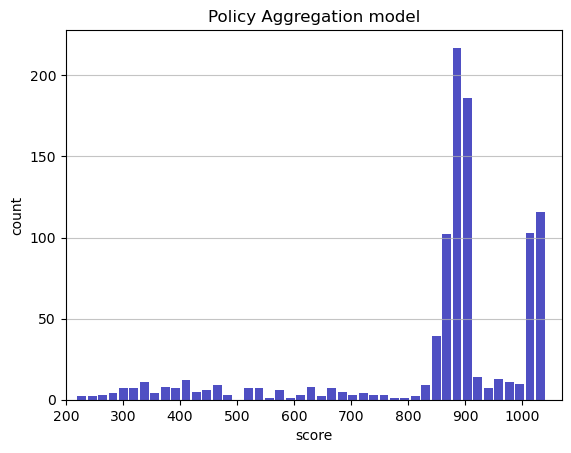

Track generation: 1123..1408 -> 285-tiles track
Epoch: 982
Policy Aggregation	mean: 857.35	variance: 181.61


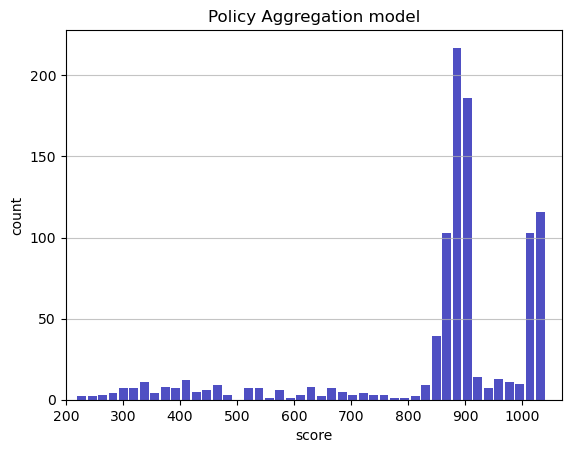

Track generation: 1199..1503 -> 304-tiles track
Epoch: 983
Policy Aggregation	mean: 857.52	variance: 181.59


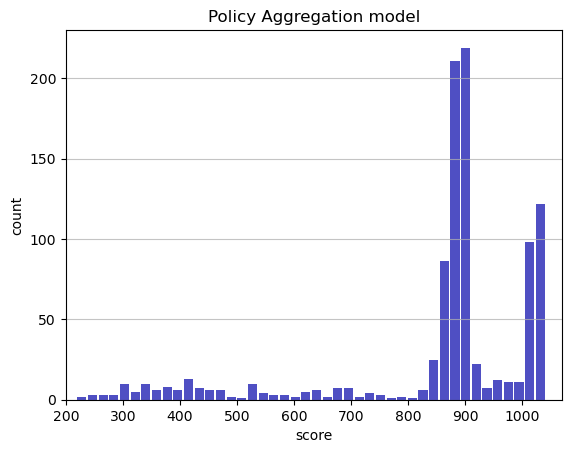

Track generation: 1143..1433 -> 290-tiles track
Epoch: 984
Policy Aggregation	mean: 857.53	variance: 181.50


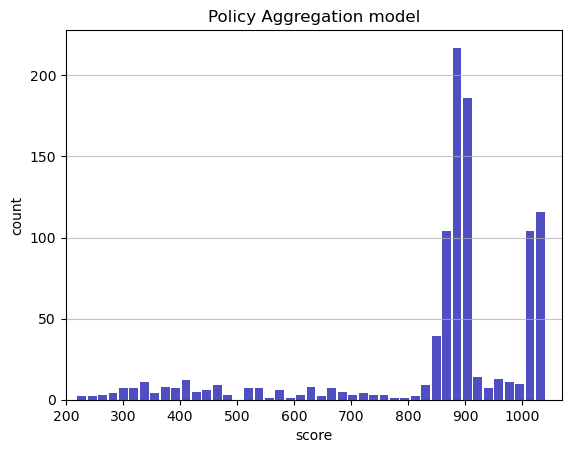

Track generation: 1130..1416 -> 286-tiles track
Epoch: 985
Policy Aggregation	mean: 857.58	variance: 181.41


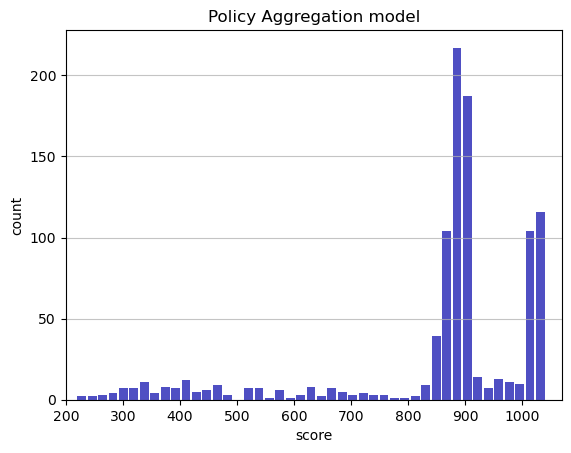

Track generation: 1272..1594 -> 322-tiles track
Epoch: 986
Policy Aggregation	mean: 857.45	variance: 181.36


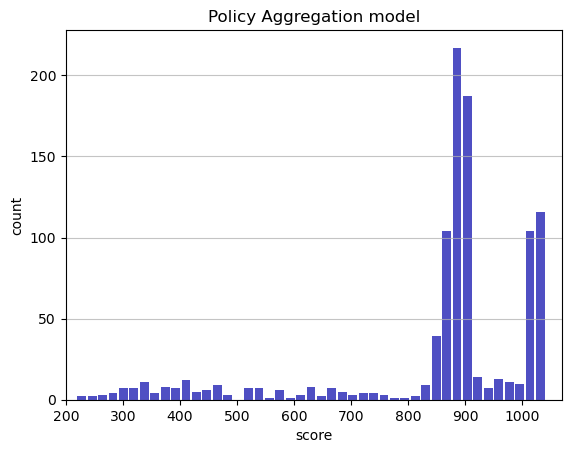

Track generation: 1093..1370 -> 277-tiles track
Epoch: 987
Policy Aggregation	mean: 857.45	variance: 181.27


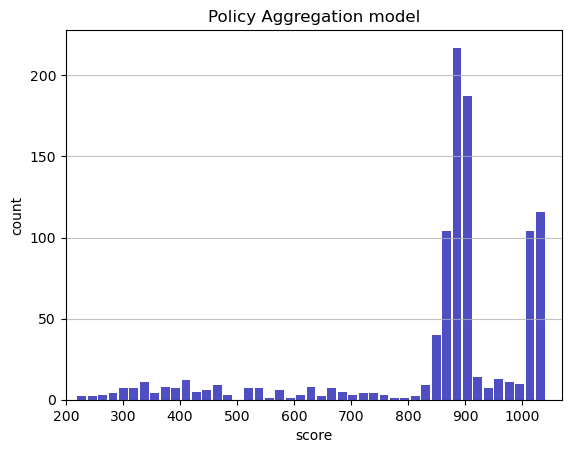

Track generation: 979..1231 -> 252-tiles track
retry to generate track (normal if there are not manyinstances of this message)
Track generation: 1265..1585 -> 320-tiles track
Epoch: 988
Policy Aggregation	mean: 857.48	variance: 181.18


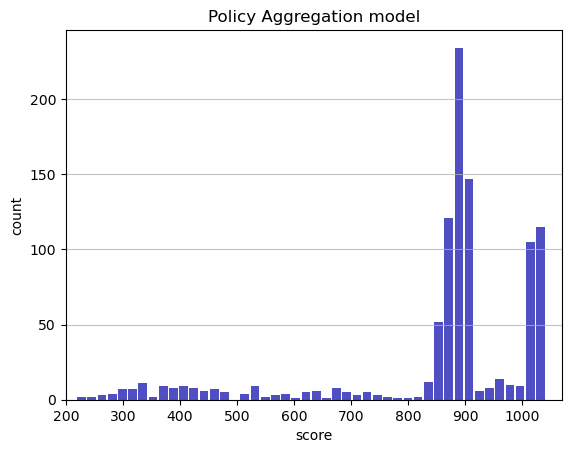

Track generation: 1048..1321 -> 273-tiles track
Epoch: 989
Policy Aggregation	mean: 857.53	variance: 181.09


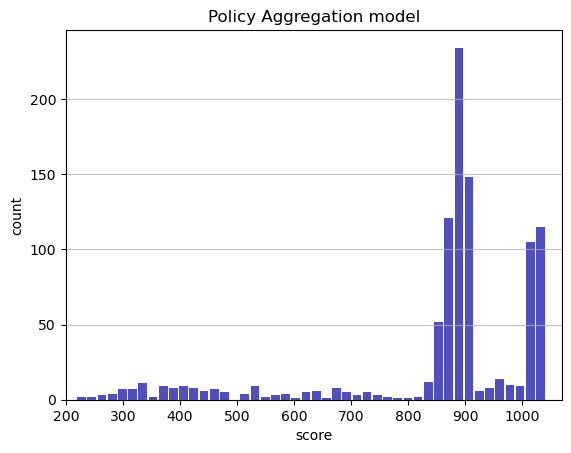

Track generation: 1287..1613 -> 326-tiles track
Epoch: 990
Policy Aggregation	mean: 857.65	variance: 181.04


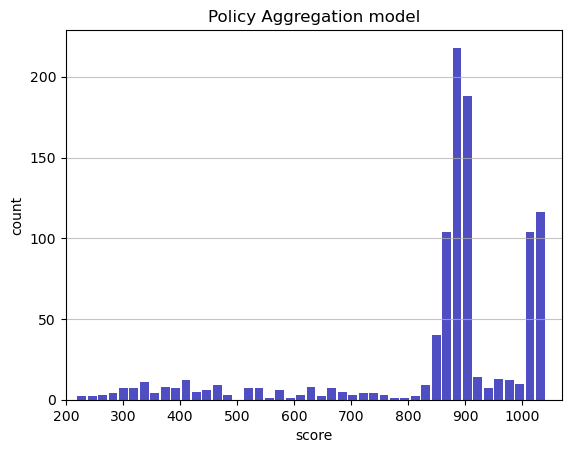

Track generation: 980..1229 -> 249-tiles track
Epoch: 991
Policy Aggregation	mean: 857.36	variance: 181.18


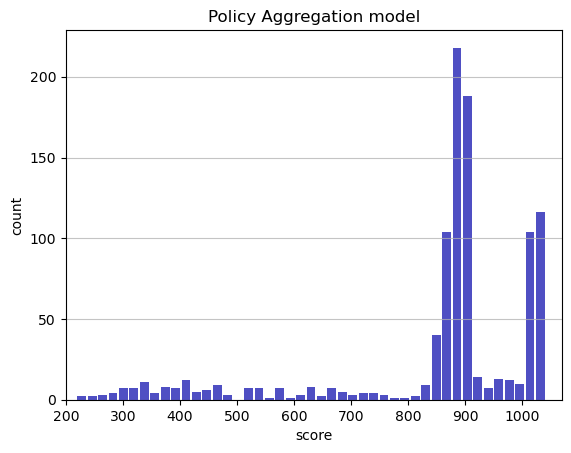

Track generation: 1150..1449 -> 299-tiles track
Epoch: 992
Policy Aggregation	mean: 856.91	variance: 181.62


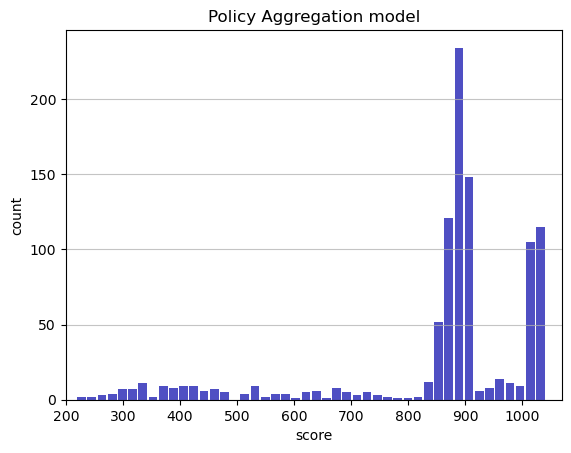

Track generation: 1192..1494 -> 302-tiles track
Epoch: 993
Policy Aggregation	mean: 856.89	variance: 181.53


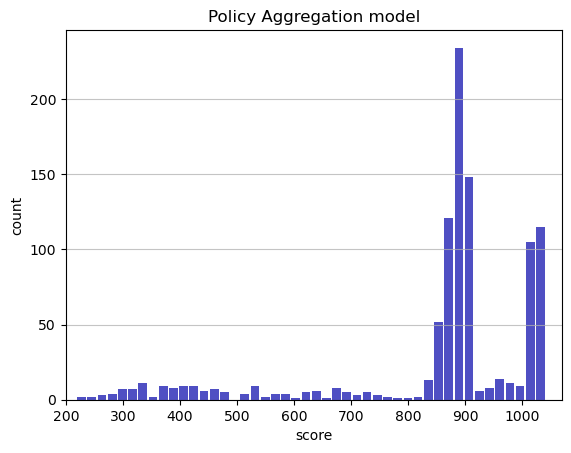

Track generation: 1008..1270 -> 262-tiles track
Epoch: 994
Policy Aggregation	mean: 856.88	variance: 181.44


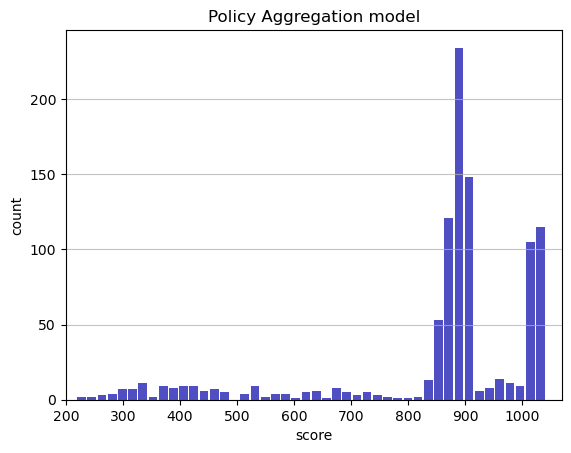

Track generation: 1203..1508 -> 305-tiles track
Epoch: 995
Policy Aggregation	mean: 856.92	variance: 181.35


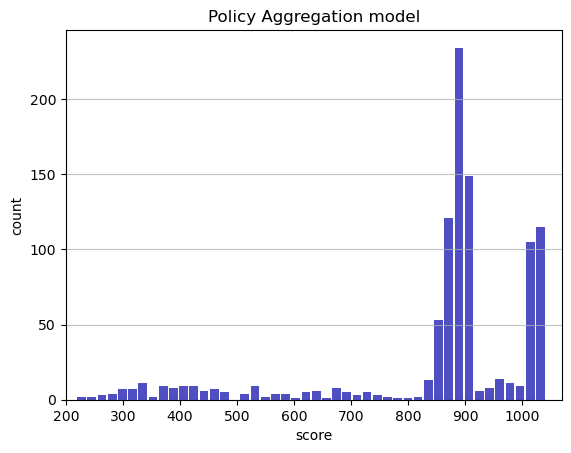

Track generation: 1116..1399 -> 283-tiles track
Epoch: 996
Policy Aggregation	mean: 856.50	variance: 181.76


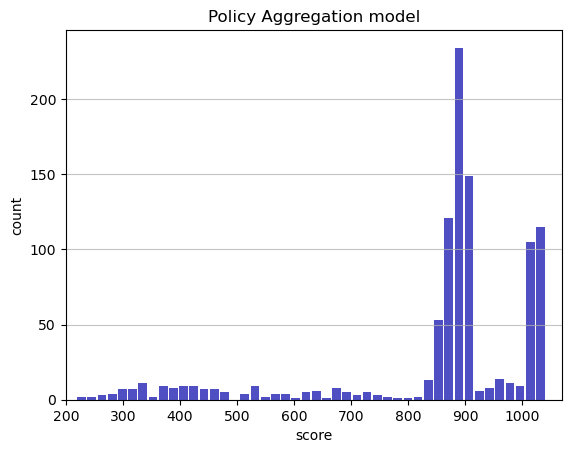

Track generation: 1139..1428 -> 289-tiles track
Epoch: 997
Policy Aggregation	mean: 856.55	variance: 181.67


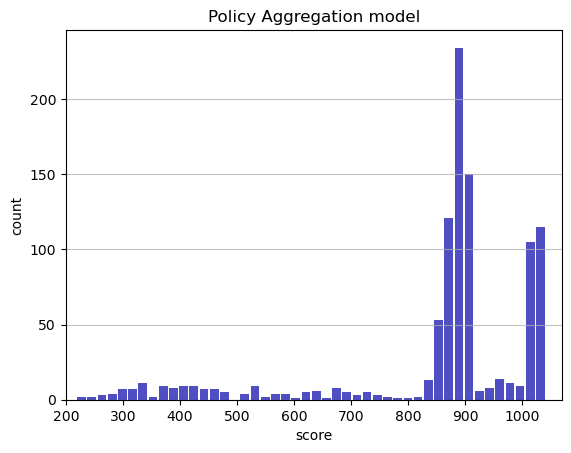

Track generation: 1086..1371 -> 285-tiles track
Epoch: 998
Policy Aggregation	mean: 856.72	variance: 181.66


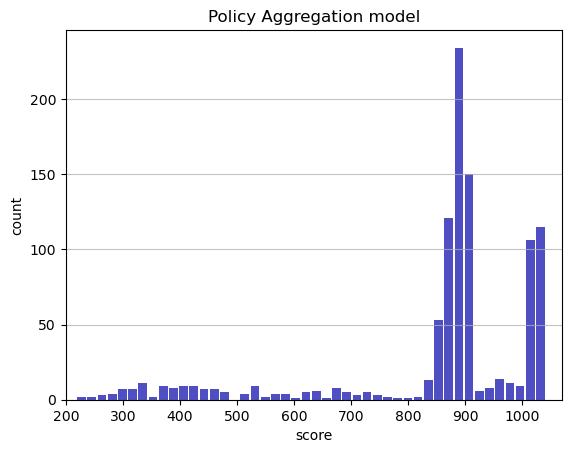

Track generation: 1118..1410 -> 292-tiles track
Epoch: 999
Policy Aggregation	mean: 856.61	variance: 181.59


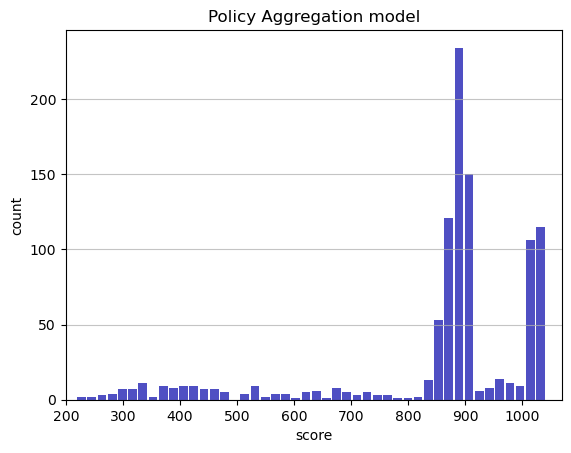

Track generation: 1209..1525 -> 316-tiles track
Epoch: 1000
Policy Aggregation	mean: 856.56	variance: 181.51


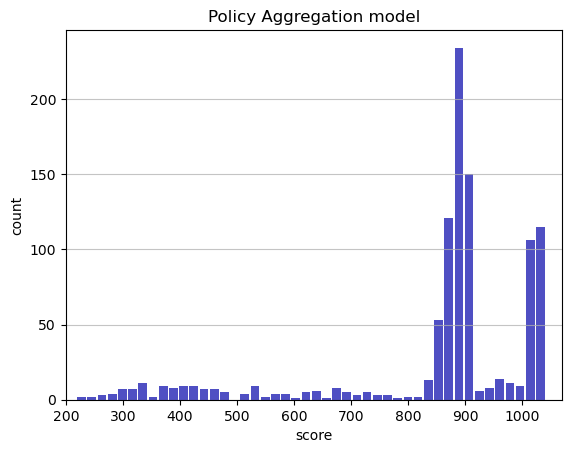

In [11]:
use_cuda = torch.cuda.is_available()
device = torch.device("cuda" if use_cuda else "cpu")

env = Env()
total_score = 0
scores = []
m = 24
beta = 0.1
model_prob = []
for i in range(m):
    model_prob += [m-i]*math.floor(((beta*(1-beta)**i)*1000))

epoch = 1000
for i_ep in range(1,epoch+1):
    score = 0
    state = env.reset()
    
    for t in range(1000):     
        model_idx = random.choice(model_prob)
        model = torch.load('pagger_model/pagger_model{}.pt'.format(model_idx))
        action = model(torch.tensor(state.reshape(1,4,96,96)).cuda().float())[0].cpu().detach().numpy()
        
        state_, reward, done, die = env.step(action * np.array([2., 1., 1.]) + np.array([-1., 0., 0.]))
        
        env.render()
        score += reward
        state = state_
        if done or die:
            break
    
    total_score += score
    scores.append(score)
    
    print("Epoch: {}".format(i_ep))
    print('Policy Aggregation\tmean: {:.2f}\tvariance: {:.2f}'.format(np.array(scores).mean(), np.array(scores).std()))

    plt.figure()
    plt.hist(x=scores, bins='auto', color='#0504aa', alpha=0.7, rwidth=0.85)
    plt.grid(axis='y', alpha=0.75)
    plt.xlim(200,1070)
    plt.xlabel('score')
    plt.ylabel('count')
    plt.title('Policy Aggregation model')
    
    plt.show()
    
env.close()

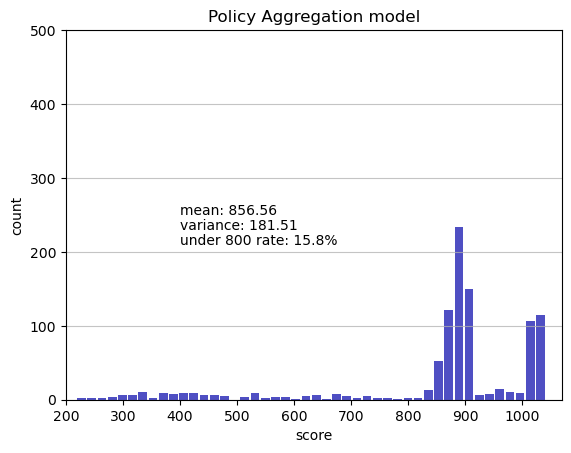

In [13]:
# np.save('./pagger_model/score.npy', scores)

scores = np.load('./pagger_model/score.npy')

plt.figure()
plt.hist(x=scores, bins='auto', color='#0504aa', alpha=0.7, rwidth=0.85)
plt.grid(axis='y', alpha=0.75)
plt.xlim(200,1070)
plt.ylim(0, 500)
plt.xlabel('score')
plt.ylabel('count')
plt.title('Policy Aggregation model')
plt.text(400, 250, 'mean: {:.2f}'.format(np.array(scores).mean()))
plt.text(400, 230, 'variance: {:.2f}'.format(np.array(scores).std()))
plt.text(400, 210, 'under 800 rate: {}%'.format(len(scores[scores < 800])/10))

plt.show()